# Just %time it
_A short story of how to run your data analytics code faster_

Tania Vasilikioti | Python Pizza Berlin

Aug 23, 2019

In [1]:
import pandas as pd
import numpy as np
import datetime as dt

import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
from mpl_toolkits.mplot3d import Axes3D

import time

%matplotlib inline

## Example 1: list comprehension with strings

Here we check how `%time` and `%timeit` IPython line/cell magic works. 

In [3]:
# a very large list of strings
strings = ['foo', 'foobar', 'baz', 'qux', 'python', 'Guido Van Rossum'] * 100000

Let's say we want to find the words in this very long string which start with "foo". We propose two methods and try out how long each takes:

In [4]:
method1 = [x for x in strings if x.startswith('foo')]
method2 = [x for x in strings if x[:3] == 'foo']

`%timeit` is different to `%time` in that it repeats your code multiple times (with some time limit) in order to get a more accurate estimate of the time it takes to run the operation (it returns estimated mean + standard deviation). For longer statements though I would use `%time`. 

[IPython documentation on magic commands](https://ipython.readthedocs.io/en/stable/interactive/magics.html)

In [6]:
%timeit [x for x in strings if x.startswith('foo')]

208 ms ± 50.5 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [7]:
%timeit [x for x in strings if x[:3] == 'foo']

148 ms ± 29.6 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


## Example 2: Linear search

Assume you have a list of `user_id`s and you want to make sure that all elements in this list(/array) exist in another one, for example for data integrity validation. You start with a naive approach, with a for loop going through each element of the first list and checking if it exists in the second list. 

In [12]:
def check_exists1(array1, array2):
    count = 0
    for x in array1:
        if x in array2:
            count +=1
    return count == len(array1)

Let's test on two arrays (randomly shuffled for a more realistic search scenario!)

In [18]:
arr1 = list(range(110000))
arr2 = list(range(20000))
np.random.shuffle(arr1)
np.random.shuffle(arr2)

In [20]:
%timeit check_exists1(arr1, arr2)

34.8 s ± 551 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


What happens if we try out different sample sizes? What happens to execution time?

In [ ]:
times = []
n = list(range(1000, 200000, 5000))

for size in n:
    arr1 = np.array(list(range(size)))
    np.random.shuffle(arr1)
    arr2 = np.array([x+500 for x in list(range(size))])
    start = time.time()
    check_exists1(arr1, arr2)
    end = time.time()
    diff = end - start
    times.append(diff)
    
exec_times = pd.DataFrame({'n': n, 
              'm': [x+500 for x in n],
              'time': times})

And let's plot it!

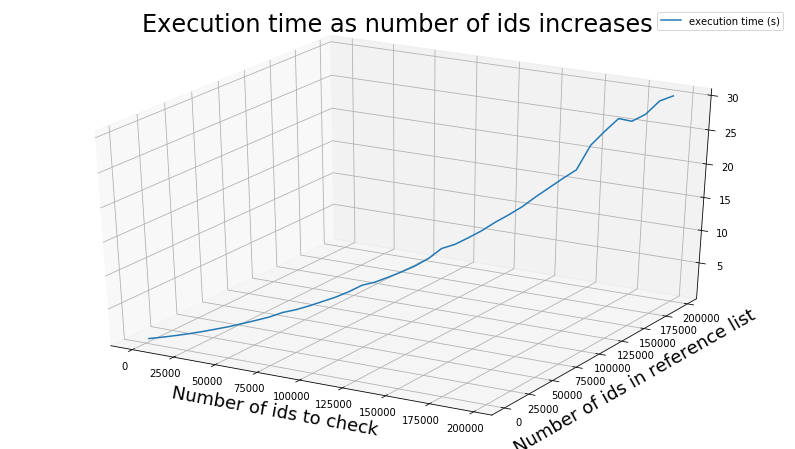

In [24]:
fig = plt.figure(figsize = (14,8))
ax = fig.gca(projection='3d')

x = exec_times.n
y = exec_times.m
z = exec_times.time

ax.plot(x, y, z, label='execution time (s)')
ax.set_xlabel('Number of ids to check', size = 18, labelpad = 10)
ax.set_ylabel('Number of ids in reference list', size = 18, labelpad = 10)
plt.title("Execution time as number of ids increases", size = 24, pad = 10)
ax.legend()

plt.show()

Now we can try using set operations in Python, which we have heard are much faster ([StackOverflow question on why are sets faster](https://stackoverflow.com/questions/8929284/what-makes-sets-faster-than-lists/8929445))

In [ ]:
def check_exists2(array1, array2):
    unique1 = set(array1)
    unique2 = set(array2)
    
    return unique1.intersection(unique2) == len(unique1)

### Time the 2 options

In [25]:
arr1 = list(range(400000))
np.random.shuffle(arr1)
arr2 = list(range(20000))
np.random.shuffle(arr2)

In [26]:
print(len(arr1), len(arr2))

400000 20000


In [27]:
%time check_exists1(arr1, arr2)

CPU times: user 2min 15s, sys: 403 ms, total: 2min 16s
Wall time: 2min 18s


False

In [28]:
%time check_exists2(arr1, arr2)

CPU times: user 77.7 ms, sys: 15.1 ms, total: 92.8 ms
Wall time: 92.4 ms


False

### Cell magic

In [30]:
%%time
total = 0
for i in range(1000):
    for j in range(1000):
        total += i * (-1) ** j

CPU times: user 567 ms, sys: 3.58 ms, total: 571 ms
Wall time: 571 ms


In [31]:
def sum_of_lists(N):
    total = 0
    for i in range(5):
        L = [j ^ (j >> i) for j in range(N)]
        total += sum(L)
    return total

In [32]:
sum_of_lists(5)

43

## Session data example: putting it all together!

In [83]:
df = pd.read_csv('data/learner_item_data.csv', parse_dates = ['created_at'])
df.columns = ['user_id', 'created_at', 'activity_id']

In [ ]:
df.head()

In [ ]:
df.shape

### 1. Think about what you want to accomplish

What is a session?
Same user, events not more than 30 minutes apart from each other

⇒ some kind of sorting of the events, grouping and filtering on the user

⇒ multiple events will be grouped into one session 

### 2. Write some (naive) code

Let's try a naive solution using for loops through every row

In [ ]:
def sessionize1(data):
    data.sort_values(['user_id', 'created_at'], inplace = True)
    data.reset_index(drop = True, inplace = True)
    
    prev_user_id = 0
    prev_created_at = dt.datetime(2000,1,1)
    session_id = 0
    data['session_id'] = 0
    
    for row_n in range(len(data)):
        if data.loc[row_n, 'user_id'] != prev_user_id:
            session_id +=1
            data.loc[row_n, 'session_id'] = session_id
        elif data.loc[row_n, 'created_at'] - prev_created_at <= pd.Timedelta(minutes = 30):
            data.loc[row_n, 'session_id'] = session_id
            prev_created_at = data.loc[row_n, 'created_at']
        elif data.loc[row_n, 'created_at'] - prev_created_at > pd.Timedelta(minutes = 30):
            session_id +=1
            prev_created_at = data.loc[row_n, 'created_at']
            data.loc[row_n, 'session_id'] = session_id
        print("done for row {}".format(row_n))
    return data

### 3. Take a sample!

In [ ]:
# in Pandas
sample = df.sample(2000)

In [ ]:
# in Numpy
np.random.choice(arr1, 2000)

### 4.1 Time your first solution on the sample

In [87]:
%%time

sample = sessionize1(sample)

func:sessionize1 len:2000 took: 1.82 sec
CPU times: user 1.7 s, sys: 19.9 ms, total: 1.72 s
Wall time: 1.82 s


### 4.2 ...and see how the execution time increases as you increase the sample size

You can create a convenient decorator with the Python `time` module, allowing you to wrap any piece of code in another function, which will print out along with the output, how long it took to run your function!

In [ ]:
from functools import wraps

def timing(f):
    @wraps(f)
    def wrap(*args, **kwargs):
        time_start = time.time()
        result = f(*args, **kwargs)
        time_end = time.time()
        print('func:{} len:{} took: {} sec'.format(
        f.__name__, len(args[0]),"%.2f" % (time_end - time_start)))
    return wrap
    

Now all you need to do is wrap the previous functions with the decorator by writing it in front of the function.

In [ ]:
@timing
def sessionize1(data):
    data.sort_values(['user_id', 'created_at'], inplace = True)
    data.reset_index(drop = True, inplace = True)
    
    prev_user_id = 0
    prev_created_at = dt.datetime(2000,1,1)
    session_id = 0
    data['session_id'] = 0
    
    for row_n in range(len(data)):
        if data.loc[row_n, 'user_id'] != prev_user_id:
            session_id +=1
            data.loc[row_n, 'session_id'] = session_id
        elif data.loc[row_n, 'created_at'] - prev_created_at <= pd.Timedelta(minutes = 30):
            data.loc[row_n, 'session_id'] = session_id
            prev_created_at = data.loc[row_n, 'created_at']
        elif data.loc[row_n, 'created_at'] - prev_created_at > pd.Timedelta(minutes = 30):
            session_id +=1
            prev_created_at = data.loc[row_n, 'created_at']
            data.loc[row_n, 'session_id'] = session_id
        print("done for row {}".format(row_n))
    return data

In [89]:
for size in [1000,2000,4000, 8000, 16000, 32000, 64000]:
    sample = df.sample(size)
    sample = sessionize1(sample)

func:sessionize1 len:1000 took: 0.89 sec
func:sessionize1 len:2000 took: 2.57 sec
func:sessionize1 len:4000 took: 4.16 sec
func:sessionize1 len:8000 took: 8.71 sec
func:sessionize1 len:16000 took: 26.37 sec
func:sessionize1 len:32000 took: 75.12 sec
func:sessionize1 len:64000 took: 250.27 sec


### 5. Iterate over your solution!

You can go on StackOverflow, for example, and find this super neat solution using Pandas and Numpy arrays [Timestamps into sessions pandas](https://stackoverflow.com/questions/37504605/timestamps-into-sessions-pandas)


In [90]:
@timing
def sessionize2(data):

    data.sort_values(['user_id', 'created_at'], inplace = True)

    
    delta = data.created_at.diff() > dt.timedelta(minutes=30)
    diff_user = data.user_id.diff() > 0
    session_id = (diff_user | delta).cumsum()
    data['session_id'] = session_id
    
    return data

In [59]:
sample = df.sample(2000)

In [60]:
%time sample = sessionize2(sample)

func:sessionize2 len:2000 took: 0.01 sec
CPU times: user 10.7 ms, sys: 3.49 ms, total: 14.2 ms
Wall time: 13.5 ms


In [91]:
for size in [1000,2000,4000, 8000, 16000, 32000, 64000]:
    sample = df.sample(size)
    sample = sessionize2(sample)

func:sessionize2 len:1000 took: 0.01 sec
func:sessionize2 len:2000 took: 0.01 sec
func:sessionize2 len:4000 took: 0.01 sec
func:sessionize2 len:8000 took: 0.01 sec
func:sessionize2 len:16000 took: 0.02 sec
func:sessionize2 len:32000 took: 0.03 sec
func:sessionize2 len:64000 took: 0.07 sec


In [ ]:
Now this looks a lot more reasonable!

### 6. Run on all your data!

In [92]:
%%time

sessionize2(df)

func:sessionize2 len:1144310 took: 0.83 sec
CPU times: user 699 ms, sys: 128 ms, total: 827 ms
Wall time: 835 ms


In [ ]:
%%time

sessionize1(df)

done for row 0
done for row 1
done for row 2
done for row 3
done for row 4
done for row 5
done for row 6
done for row 7
done for row 8
done for row 9
done for row 10
done for row 11
done for row 12
done for row 13
done for row 14
done for row 15
done for row 16
done for row 17
done for row 18
done for row 19
done for row 20
done for row 21
done for row 22
done for row 23
done for row 24
done for row 25
done for row 26
done for row 27
done for row 28
done for row 29
done for row 30
done for row 31
done for row 32
done for row 33
done for row 34
done for row 35
done for row 36
done for row 37
done for row 38
done for row 39
done for row 40
done for row 41
done for row 42
done for row 43
done for row 44
done for row 45
done for row 46
done for row 47
done for row 48
done for row 49
done for row 50
done for row 51
done for row 52
done for row 53
done for row 54
done for row 55
done for row 56
done for row 57
done for row 58
done for row 59
done for row 60
done for row 61
done for row 62
do

done for row 490
done for row 491
done for row 492
done for row 493
done for row 494
done for row 495
done for row 496
done for row 497
done for row 498
done for row 499
done for row 500
done for row 501
done for row 502
done for row 503
done for row 504
done for row 505
done for row 506
done for row 507
done for row 508
done for row 509
done for row 510
done for row 511
done for row 512
done for row 513
done for row 514
done for row 515
done for row 516
done for row 517
done for row 518
done for row 519
done for row 520
done for row 521
done for row 522
done for row 523
done for row 524
done for row 525
done for row 526
done for row 527
done for row 528
done for row 529
done for row 530
done for row 531
done for row 532
done for row 533
done for row 534
done for row 535
done for row 536
done for row 537
done for row 538
done for row 539
done for row 540
done for row 541
done for row 542
done for row 543
done for row 544
done for row 545
done for row 546
done for row 547
done for row 5

done for row 976
done for row 977
done for row 978
done for row 979
done for row 980
done for row 981
done for row 982
done for row 983
done for row 984
done for row 985
done for row 986
done for row 987
done for row 988
done for row 989
done for row 990
done for row 991
done for row 992
done for row 993
done for row 994
done for row 995
done for row 996
done for row 997
done for row 998
done for row 999
done for row 1000
done for row 1001
done for row 1002
done for row 1003
done for row 1004
done for row 1005
done for row 1006
done for row 1007
done for row 1008
done for row 1009
done for row 1010
done for row 1011
done for row 1012
done for row 1013
done for row 1014
done for row 1015
done for row 1016
done for row 1017
done for row 1018
done for row 1019
done for row 1020
done for row 1021
done for row 1022
done for row 1023
done for row 1024
done for row 1025
done for row 1026
done for row 1027
done for row 1028
done for row 1029
done for row 1030
done for row 1031
done for row 103

done for row 1437
done for row 1438
done for row 1439
done for row 1440
done for row 1441
done for row 1442
done for row 1443
done for row 1444
done for row 1445
done for row 1446
done for row 1447
done for row 1448
done for row 1449
done for row 1450
done for row 1451
done for row 1452
done for row 1453
done for row 1454
done for row 1455
done for row 1456
done for row 1457
done for row 1458
done for row 1459
done for row 1460
done for row 1461
done for row 1462
done for row 1463
done for row 1464
done for row 1465
done for row 1466
done for row 1467
done for row 1468
done for row 1469
done for row 1470
done for row 1471
done for row 1472
done for row 1473
done for row 1474
done for row 1475
done for row 1476
done for row 1477
done for row 1478
done for row 1479
done for row 1480
done for row 1481
done for row 1482
done for row 1483
done for row 1484
done for row 1485
done for row 1486
done for row 1487
done for row 1488
done for row 1489
done for row 1490
done for row 1491
done for r

done for row 1893
done for row 1894
done for row 1895
done for row 1896
done for row 1897
done for row 1898
done for row 1899
done for row 1900
done for row 1901
done for row 1902
done for row 1903
done for row 1904
done for row 1905
done for row 1906
done for row 1907
done for row 1908
done for row 1909
done for row 1910
done for row 1911
done for row 1912
done for row 1913
done for row 1914
done for row 1915
done for row 1916
done for row 1917
done for row 1918
done for row 1919
done for row 1920
done for row 1921
done for row 1922
done for row 1923
done for row 1924
done for row 1925
done for row 1926
done for row 1927
done for row 1928
done for row 1929
done for row 1930
done for row 1931
done for row 1932
done for row 1933
done for row 1934
done for row 1935
done for row 1936
done for row 1937
done for row 1938
done for row 1939
done for row 1940
done for row 1941
done for row 1942
done for row 1943
done for row 1944
done for row 1945
done for row 1946
done for row 1947
done for r

done for row 2349
done for row 2350
done for row 2351
done for row 2352
done for row 2353
done for row 2354
done for row 2355
done for row 2356
done for row 2357
done for row 2358
done for row 2359
done for row 2360
done for row 2361
done for row 2362
done for row 2363
done for row 2364
done for row 2365
done for row 2366
done for row 2367
done for row 2368
done for row 2369
done for row 2370
done for row 2371
done for row 2372
done for row 2373
done for row 2374
done for row 2375
done for row 2376
done for row 2377
done for row 2378
done for row 2379
done for row 2380
done for row 2381
done for row 2382
done for row 2383
done for row 2384
done for row 2385
done for row 2386
done for row 2387
done for row 2388
done for row 2389
done for row 2390
done for row 2391
done for row 2392
done for row 2393
done for row 2394
done for row 2395
done for row 2396
done for row 2397
done for row 2398
done for row 2399
done for row 2400
done for row 2401
done for row 2402
done for row 2403
done for r

done for row 2808
done for row 2809
done for row 2810
done for row 2811
done for row 2812
done for row 2813
done for row 2814
done for row 2815
done for row 2816
done for row 2817
done for row 2818
done for row 2819
done for row 2820
done for row 2821
done for row 2822
done for row 2823
done for row 2824
done for row 2825
done for row 2826
done for row 2827
done for row 2828
done for row 2829
done for row 2830
done for row 2831
done for row 2832
done for row 2833
done for row 2834
done for row 2835
done for row 2836
done for row 2837
done for row 2838
done for row 2839
done for row 2840
done for row 2841
done for row 2842
done for row 2843
done for row 2844
done for row 2845
done for row 2846
done for row 2847
done for row 2848
done for row 2849
done for row 2850
done for row 2851
done for row 2852
done for row 2853
done for row 2854
done for row 2855
done for row 2856
done for row 2857
done for row 2858
done for row 2859
done for row 2860
done for row 2861
done for row 2862
done for r

done for row 3264
done for row 3265
done for row 3266
done for row 3267
done for row 3268
done for row 3269
done for row 3270
done for row 3271
done for row 3272
done for row 3273
done for row 3274
done for row 3275
done for row 3276
done for row 3277
done for row 3278
done for row 3279
done for row 3280
done for row 3281
done for row 3282
done for row 3283
done for row 3284
done for row 3285
done for row 3286
done for row 3287
done for row 3288
done for row 3289
done for row 3290
done for row 3291
done for row 3292
done for row 3293
done for row 3294
done for row 3295
done for row 3296
done for row 3297
done for row 3298
done for row 3299
done for row 3300
done for row 3301
done for row 3302
done for row 3303
done for row 3304
done for row 3305
done for row 3306
done for row 3307
done for row 3308
done for row 3309
done for row 3310
done for row 3311
done for row 3312
done for row 3313
done for row 3314
done for row 3315
done for row 3316
done for row 3317
done for row 3318
done for r

done for row 3724
done for row 3725
done for row 3726
done for row 3727
done for row 3728
done for row 3729
done for row 3730
done for row 3731
done for row 3732
done for row 3733
done for row 3734
done for row 3735
done for row 3736
done for row 3737
done for row 3738
done for row 3739
done for row 3740
done for row 3741
done for row 3742
done for row 3743
done for row 3744
done for row 3745
done for row 3746
done for row 3747
done for row 3748
done for row 3749
done for row 3750
done for row 3751
done for row 3752
done for row 3753
done for row 3754
done for row 3755
done for row 3756
done for row 3757
done for row 3758
done for row 3759
done for row 3760
done for row 3761
done for row 3762
done for row 3763
done for row 3764
done for row 3765
done for row 3766
done for row 3767
done for row 3768
done for row 3769
done for row 3770
done for row 3771
done for row 3772
done for row 3773
done for row 3774
done for row 3775
done for row 3776
done for row 3777
done for row 3778
done for r

done for row 4184
done for row 4185
done for row 4186
done for row 4187
done for row 4188
done for row 4189
done for row 4190
done for row 4191
done for row 4192
done for row 4193
done for row 4194
done for row 4195
done for row 4196
done for row 4197
done for row 4198
done for row 4199
done for row 4200
done for row 4201
done for row 4202
done for row 4203
done for row 4204
done for row 4205
done for row 4206
done for row 4207
done for row 4208
done for row 4209
done for row 4210
done for row 4211
done for row 4212
done for row 4213
done for row 4214
done for row 4215
done for row 4216
done for row 4217
done for row 4218
done for row 4219
done for row 4220
done for row 4221
done for row 4222
done for row 4223
done for row 4224
done for row 4225
done for row 4226
done for row 4227
done for row 4228
done for row 4229
done for row 4230
done for row 4231
done for row 4232
done for row 4233
done for row 4234
done for row 4235
done for row 4236
done for row 4237
done for row 4238
done for r

done for row 4641
done for row 4642
done for row 4643
done for row 4644
done for row 4645
done for row 4646
done for row 4647
done for row 4648
done for row 4649
done for row 4650
done for row 4651
done for row 4652
done for row 4653
done for row 4654
done for row 4655
done for row 4656
done for row 4657
done for row 4658
done for row 4659
done for row 4660
done for row 4661
done for row 4662
done for row 4663
done for row 4664
done for row 4665
done for row 4666
done for row 4667
done for row 4668
done for row 4669
done for row 4670
done for row 4671
done for row 4672
done for row 4673
done for row 4674
done for row 4675
done for row 4676
done for row 4677
done for row 4678
done for row 4679
done for row 4680
done for row 4681
done for row 4682
done for row 4683
done for row 4684
done for row 4685
done for row 4686
done for row 4687
done for row 4688
done for row 4689
done for row 4690
done for row 4691
done for row 4692
done for row 4693
done for row 4694
done for row 4695
done for r

done for row 5099
done for row 5100
done for row 5101
done for row 5102
done for row 5103
done for row 5104
done for row 5105
done for row 5106
done for row 5107
done for row 5108
done for row 5109
done for row 5110
done for row 5111
done for row 5112
done for row 5113
done for row 5114
done for row 5115
done for row 5116
done for row 5117
done for row 5118
done for row 5119
done for row 5120
done for row 5121
done for row 5122
done for row 5123
done for row 5124
done for row 5125
done for row 5126
done for row 5127
done for row 5128
done for row 5129
done for row 5130
done for row 5131
done for row 5132
done for row 5133
done for row 5134
done for row 5135
done for row 5136
done for row 5137
done for row 5138
done for row 5139
done for row 5140
done for row 5141
done for row 5142
done for row 5143
done for row 5144
done for row 5145
done for row 5146
done for row 5147
done for row 5148
done for row 5149
done for row 5150
done for row 5151
done for row 5152
done for row 5153
done for r

done for row 5558
done for row 5559
done for row 5560
done for row 5561
done for row 5562
done for row 5563
done for row 5564
done for row 5565
done for row 5566
done for row 5567
done for row 5568
done for row 5569
done for row 5570
done for row 5571
done for row 5572
done for row 5573
done for row 5574
done for row 5575
done for row 5576
done for row 5577
done for row 5578
done for row 5579
done for row 5580
done for row 5581
done for row 5582
done for row 5583
done for row 5584
done for row 5585
done for row 5586
done for row 5587
done for row 5588
done for row 5589
done for row 5590
done for row 5591
done for row 5592
done for row 5593
done for row 5594
done for row 5595
done for row 5596
done for row 5597
done for row 5598
done for row 5599
done for row 5600
done for row 5601
done for row 5602
done for row 5603
done for row 5604
done for row 5605
done for row 5606
done for row 5607
done for row 5608
done for row 5609
done for row 5610
done for row 5611
done for row 5612
done for r

done for row 6017
done for row 6018
done for row 6019
done for row 6020
done for row 6021
done for row 6022
done for row 6023
done for row 6024
done for row 6025
done for row 6026
done for row 6027
done for row 6028
done for row 6029
done for row 6030
done for row 6031
done for row 6032
done for row 6033
done for row 6034
done for row 6035
done for row 6036
done for row 6037
done for row 6038
done for row 6039
done for row 6040
done for row 6041
done for row 6042
done for row 6043
done for row 6044
done for row 6045
done for row 6046
done for row 6047
done for row 6048
done for row 6049
done for row 6050
done for row 6051
done for row 6052
done for row 6053
done for row 6054
done for row 6055
done for row 6056
done for row 6057
done for row 6058
done for row 6059
done for row 6060
done for row 6061
done for row 6062
done for row 6063
done for row 6064
done for row 6065
done for row 6066
done for row 6067
done for row 6068
done for row 6069
done for row 6070
done for row 6071
done for r

done for row 6473
done for row 6474
done for row 6475
done for row 6476
done for row 6477
done for row 6478
done for row 6479
done for row 6480
done for row 6481
done for row 6482
done for row 6483
done for row 6484
done for row 6485
done for row 6486
done for row 6487
done for row 6488
done for row 6489
done for row 6490
done for row 6491
done for row 6492
done for row 6493
done for row 6494
done for row 6495
done for row 6496
done for row 6497
done for row 6498
done for row 6499
done for row 6500
done for row 6501
done for row 6502
done for row 6503
done for row 6504
done for row 6505
done for row 6506
done for row 6507
done for row 6508
done for row 6509
done for row 6510
done for row 6511
done for row 6512
done for row 6513
done for row 6514
done for row 6515
done for row 6516
done for row 6517
done for row 6518
done for row 6519
done for row 6520
done for row 6521
done for row 6522
done for row 6523
done for row 6524
done for row 6525
done for row 6526
done for row 6527
done for r

done for row 6930
done for row 6931
done for row 6932
done for row 6933
done for row 6934
done for row 6935
done for row 6936
done for row 6937
done for row 6938
done for row 6939
done for row 6940
done for row 6941
done for row 6942
done for row 6943
done for row 6944
done for row 6945
done for row 6946
done for row 6947
done for row 6948
done for row 6949
done for row 6950
done for row 6951
done for row 6952
done for row 6953
done for row 6954
done for row 6955
done for row 6956
done for row 6957
done for row 6958
done for row 6959
done for row 6960
done for row 6961
done for row 6962
done for row 6963
done for row 6964
done for row 6965
done for row 6966
done for row 6967
done for row 6968
done for row 6969
done for row 6970
done for row 6971
done for row 6972
done for row 6973
done for row 6974
done for row 6975
done for row 6976
done for row 6977
done for row 6978
done for row 6979
done for row 6980
done for row 6981
done for row 6982
done for row 6983
done for row 6984
done for r

done for row 7387
done for row 7388
done for row 7389
done for row 7390
done for row 7391
done for row 7392
done for row 7393
done for row 7394
done for row 7395
done for row 7396
done for row 7397
done for row 7398
done for row 7399
done for row 7400
done for row 7401
done for row 7402
done for row 7403
done for row 7404
done for row 7405
done for row 7406
done for row 7407
done for row 7408
done for row 7409
done for row 7410
done for row 7411
done for row 7412
done for row 7413
done for row 7414
done for row 7415
done for row 7416
done for row 7417
done for row 7418
done for row 7419
done for row 7420
done for row 7421
done for row 7422
done for row 7423
done for row 7424
done for row 7425
done for row 7426
done for row 7427
done for row 7428
done for row 7429
done for row 7430
done for row 7431
done for row 7432
done for row 7433
done for row 7434
done for row 7435
done for row 7436
done for row 7437
done for row 7438
done for row 7439
done for row 7440
done for row 7441
done for r

done for row 7845
done for row 7846
done for row 7847
done for row 7848
done for row 7849
done for row 7850
done for row 7851
done for row 7852
done for row 7853
done for row 7854
done for row 7855
done for row 7856
done for row 7857
done for row 7858
done for row 7859
done for row 7860
done for row 7861
done for row 7862
done for row 7863
done for row 7864
done for row 7865
done for row 7866
done for row 7867
done for row 7868
done for row 7869
done for row 7870
done for row 7871
done for row 7872
done for row 7873
done for row 7874
done for row 7875
done for row 7876
done for row 7877
done for row 7878
done for row 7879
done for row 7880
done for row 7881
done for row 7882
done for row 7883
done for row 7884
done for row 7885
done for row 7886
done for row 7887
done for row 7888
done for row 7889
done for row 7890
done for row 7891
done for row 7892
done for row 7893
done for row 7894
done for row 7895
done for row 7896
done for row 7897
done for row 7898
done for row 7899
done for r

done for row 8303
done for row 8304
done for row 8305
done for row 8306
done for row 8307
done for row 8308
done for row 8309
done for row 8310
done for row 8311
done for row 8312
done for row 8313
done for row 8314
done for row 8315
done for row 8316
done for row 8317
done for row 8318
done for row 8319
done for row 8320
done for row 8321
done for row 8322
done for row 8323
done for row 8324
done for row 8325
done for row 8326
done for row 8327
done for row 8328
done for row 8329
done for row 8330
done for row 8331
done for row 8332
done for row 8333
done for row 8334
done for row 8335
done for row 8336
done for row 8337
done for row 8338
done for row 8339
done for row 8340
done for row 8341
done for row 8342
done for row 8343
done for row 8344
done for row 8345
done for row 8346
done for row 8347
done for row 8348
done for row 8349
done for row 8350
done for row 8351
done for row 8352
done for row 8353
done for row 8354
done for row 8355
done for row 8356
done for row 8357
done for r

done for row 8759
done for row 8760
done for row 8761
done for row 8762
done for row 8763
done for row 8764
done for row 8765
done for row 8766
done for row 8767
done for row 8768
done for row 8769
done for row 8770
done for row 8771
done for row 8772
done for row 8773
done for row 8774
done for row 8775
done for row 8776
done for row 8777
done for row 8778
done for row 8779
done for row 8780
done for row 8781
done for row 8782
done for row 8783
done for row 8784
done for row 8785
done for row 8786
done for row 8787
done for row 8788
done for row 8789
done for row 8790
done for row 8791
done for row 8792
done for row 8793
done for row 8794
done for row 8795
done for row 8796
done for row 8797
done for row 8798
done for row 8799
done for row 8800
done for row 8801
done for row 8802
done for row 8803
done for row 8804
done for row 8805
done for row 8806
done for row 8807
done for row 8808
done for row 8809
done for row 8810
done for row 8811
done for row 8812
done for row 8813
done for r

done for row 9218
done for row 9219
done for row 9220
done for row 9221
done for row 9222
done for row 9223
done for row 9224
done for row 9225
done for row 9226
done for row 9227
done for row 9228
done for row 9229
done for row 9230
done for row 9231
done for row 9232
done for row 9233
done for row 9234
done for row 9235
done for row 9236
done for row 9237
done for row 9238
done for row 9239
done for row 9240
done for row 9241
done for row 9242
done for row 9243
done for row 9244
done for row 9245
done for row 9246
done for row 9247
done for row 9248
done for row 9249
done for row 9250
done for row 9251
done for row 9252
done for row 9253
done for row 9254
done for row 9255
done for row 9256
done for row 9257
done for row 9258
done for row 9259
done for row 9260
done for row 9261
done for row 9262
done for row 9263
done for row 9264
done for row 9265
done for row 9266
done for row 9267
done for row 9268
done for row 9269
done for row 9270
done for row 9271
done for row 9272
done for r

done for row 9678
done for row 9679
done for row 9680
done for row 9681
done for row 9682
done for row 9683
done for row 9684
done for row 9685
done for row 9686
done for row 9687
done for row 9688
done for row 9689
done for row 9690
done for row 9691
done for row 9692
done for row 9693
done for row 9694
done for row 9695
done for row 9696
done for row 9697
done for row 9698
done for row 9699
done for row 9700
done for row 9701
done for row 9702
done for row 9703
done for row 9704
done for row 9705
done for row 9706
done for row 9707
done for row 9708
done for row 9709
done for row 9710
done for row 9711
done for row 9712
done for row 9713
done for row 9714
done for row 9715
done for row 9716
done for row 9717
done for row 9718
done for row 9719
done for row 9720
done for row 9721
done for row 9722
done for row 9723
done for row 9724
done for row 9725
done for row 9726
done for row 9727
done for row 9728
done for row 9729
done for row 9730
done for row 9731
done for row 9732
done for r

done for row 10128
done for row 10129
done for row 10130
done for row 10131
done for row 10132
done for row 10133
done for row 10134
done for row 10135
done for row 10136
done for row 10137
done for row 10138
done for row 10139
done for row 10140
done for row 10141
done for row 10142
done for row 10143
done for row 10144
done for row 10145
done for row 10146
done for row 10147
done for row 10148
done for row 10149
done for row 10150
done for row 10151
done for row 10152
done for row 10153
done for row 10154
done for row 10155
done for row 10156
done for row 10157
done for row 10158
done for row 10159
done for row 10160
done for row 10161
done for row 10162
done for row 10163
done for row 10164
done for row 10165
done for row 10166
done for row 10167
done for row 10168
done for row 10169
done for row 10170
done for row 10171
done for row 10172
done for row 10173
done for row 10174
done for row 10175
done for row 10176
done for row 10177
done for row 10178
done for row 10179
done for row

done for row 10564
done for row 10565
done for row 10566
done for row 10567
done for row 10568
done for row 10569
done for row 10570
done for row 10571
done for row 10572
done for row 10573
done for row 10574
done for row 10575
done for row 10576
done for row 10577
done for row 10578
done for row 10579
done for row 10580
done for row 10581
done for row 10582
done for row 10583
done for row 10584
done for row 10585
done for row 10586
done for row 10587
done for row 10588
done for row 10589
done for row 10590
done for row 10591
done for row 10592
done for row 10593
done for row 10594
done for row 10595
done for row 10596
done for row 10597
done for row 10598
done for row 10599
done for row 10600
done for row 10601
done for row 10602
done for row 10603
done for row 10604
done for row 10605
done for row 10606
done for row 10607
done for row 10608
done for row 10609
done for row 10610
done for row 10611
done for row 10612
done for row 10613
done for row 10614
done for row 10615
done for row

done for row 10999
done for row 11000
done for row 11001
done for row 11002
done for row 11003
done for row 11004
done for row 11005
done for row 11006
done for row 11007
done for row 11008
done for row 11009
done for row 11010
done for row 11011
done for row 11012
done for row 11013
done for row 11014
done for row 11015
done for row 11016
done for row 11017
done for row 11018
done for row 11019
done for row 11020
done for row 11021
done for row 11022
done for row 11023
done for row 11024
done for row 11025
done for row 11026
done for row 11027
done for row 11028
done for row 11029
done for row 11030
done for row 11031
done for row 11032
done for row 11033
done for row 11034
done for row 11035
done for row 11036
done for row 11037
done for row 11038
done for row 11039
done for row 11040
done for row 11041
done for row 11042
done for row 11043
done for row 11044
done for row 11045
done for row 11046
done for row 11047
done for row 11048
done for row 11049
done for row 11050
done for row

done for row 11434
done for row 11435
done for row 11436
done for row 11437
done for row 11438
done for row 11439
done for row 11440
done for row 11441
done for row 11442
done for row 11443
done for row 11444
done for row 11445
done for row 11446
done for row 11447
done for row 11448
done for row 11449
done for row 11450
done for row 11451
done for row 11452
done for row 11453
done for row 11454
done for row 11455
done for row 11456
done for row 11457
done for row 11458
done for row 11459
done for row 11460
done for row 11461
done for row 11462
done for row 11463
done for row 11464
done for row 11465
done for row 11466
done for row 11467
done for row 11468
done for row 11469
done for row 11470
done for row 11471
done for row 11472
done for row 11473
done for row 11474
done for row 11475
done for row 11476
done for row 11477
done for row 11478
done for row 11479
done for row 11480
done for row 11481
done for row 11482
done for row 11483
done for row 11484
done for row 11485
done for row

done for row 11869
done for row 11870
done for row 11871
done for row 11872
done for row 11873
done for row 11874
done for row 11875
done for row 11876
done for row 11877
done for row 11878
done for row 11879
done for row 11880
done for row 11881
done for row 11882
done for row 11883
done for row 11884
done for row 11885
done for row 11886
done for row 11887
done for row 11888
done for row 11889
done for row 11890
done for row 11891
done for row 11892
done for row 11893
done for row 11894
done for row 11895
done for row 11896
done for row 11897
done for row 11898
done for row 11899
done for row 11900
done for row 11901
done for row 11902
done for row 11903
done for row 11904
done for row 11905
done for row 11906
done for row 11907
done for row 11908
done for row 11909
done for row 11910
done for row 11911
done for row 11912
done for row 11913
done for row 11914
done for row 11915
done for row 11916
done for row 11917
done for row 11918
done for row 11919
done for row 11920
done for row

done for row 12304
done for row 12305
done for row 12306
done for row 12307
done for row 12308
done for row 12309
done for row 12310
done for row 12311
done for row 12312
done for row 12313
done for row 12314
done for row 12315
done for row 12316
done for row 12317
done for row 12318
done for row 12319
done for row 12320
done for row 12321
done for row 12322
done for row 12323
done for row 12324
done for row 12325
done for row 12326
done for row 12327
done for row 12328
done for row 12329
done for row 12330
done for row 12331
done for row 12332
done for row 12333
done for row 12334
done for row 12335
done for row 12336
done for row 12337
done for row 12338
done for row 12339
done for row 12340
done for row 12341
done for row 12342
done for row 12343
done for row 12344
done for row 12345
done for row 12346
done for row 12347
done for row 12348
done for row 12349
done for row 12350
done for row 12351
done for row 12352
done for row 12353
done for row 12354
done for row 12355
done for row

done for row 12739
done for row 12740
done for row 12741
done for row 12742
done for row 12743
done for row 12744
done for row 12745
done for row 12746
done for row 12747
done for row 12748
done for row 12749
done for row 12750
done for row 12751
done for row 12752
done for row 12753
done for row 12754
done for row 12755
done for row 12756
done for row 12757
done for row 12758
done for row 12759
done for row 12760
done for row 12761
done for row 12762
done for row 12763
done for row 12764
done for row 12765
done for row 12766
done for row 12767
done for row 12768
done for row 12769
done for row 12770
done for row 12771
done for row 12772
done for row 12773
done for row 12774
done for row 12775
done for row 12776
done for row 12777
done for row 12778
done for row 12779
done for row 12780
done for row 12781
done for row 12782
done for row 12783
done for row 12784
done for row 12785
done for row 12786
done for row 12787
done for row 12788
done for row 12789
done for row 12790
done for row

done for row 13175
done for row 13176
done for row 13177
done for row 13178
done for row 13179
done for row 13180
done for row 13181
done for row 13182
done for row 13183
done for row 13184
done for row 13185
done for row 13186
done for row 13187
done for row 13188
done for row 13189
done for row 13190
done for row 13191
done for row 13192
done for row 13193
done for row 13194
done for row 13195
done for row 13196
done for row 13197
done for row 13198
done for row 13199
done for row 13200
done for row 13201
done for row 13202
done for row 13203
done for row 13204
done for row 13205
done for row 13206
done for row 13207
done for row 13208
done for row 13209
done for row 13210
done for row 13211
done for row 13212
done for row 13213
done for row 13214
done for row 13215
done for row 13216
done for row 13217
done for row 13218
done for row 13219
done for row 13220
done for row 13221
done for row 13222
done for row 13223
done for row 13224
done for row 13225
done for row 13226
done for row

done for row 13607
done for row 13608
done for row 13609
done for row 13610
done for row 13611
done for row 13612
done for row 13613
done for row 13614
done for row 13615
done for row 13616
done for row 13617
done for row 13618
done for row 13619
done for row 13620
done for row 13621
done for row 13622
done for row 13623
done for row 13624
done for row 13625
done for row 13626
done for row 13627
done for row 13628
done for row 13629
done for row 13630
done for row 13631
done for row 13632
done for row 13633
done for row 13634
done for row 13635
done for row 13636
done for row 13637
done for row 13638
done for row 13639
done for row 13640
done for row 13641
done for row 13642
done for row 13643
done for row 13644
done for row 13645
done for row 13646
done for row 13647
done for row 13648
done for row 13649
done for row 13650
done for row 13651
done for row 13652
done for row 13653
done for row 13654
done for row 13655
done for row 13656
done for row 13657
done for row 13658
done for row

done for row 14039
done for row 14040
done for row 14041
done for row 14042
done for row 14043
done for row 14044
done for row 14045
done for row 14046
done for row 14047
done for row 14048
done for row 14049
done for row 14050
done for row 14051
done for row 14052
done for row 14053
done for row 14054
done for row 14055
done for row 14056
done for row 14057
done for row 14058
done for row 14059
done for row 14060
done for row 14061
done for row 14062
done for row 14063
done for row 14064
done for row 14065
done for row 14066
done for row 14067
done for row 14068
done for row 14069
done for row 14070
done for row 14071
done for row 14072
done for row 14073
done for row 14074
done for row 14075
done for row 14076
done for row 14077
done for row 14078
done for row 14079
done for row 14080
done for row 14081
done for row 14082
done for row 14083
done for row 14084
done for row 14085
done for row 14086
done for row 14087
done for row 14088
done for row 14089
done for row 14090
done for row

done for row 14476
done for row 14477
done for row 14478
done for row 14479
done for row 14480
done for row 14481
done for row 14482
done for row 14483
done for row 14484
done for row 14485
done for row 14486
done for row 14487
done for row 14488
done for row 14489
done for row 14490
done for row 14491
done for row 14492
done for row 14493
done for row 14494
done for row 14495
done for row 14496
done for row 14497
done for row 14498
done for row 14499
done for row 14500
done for row 14501
done for row 14502
done for row 14503
done for row 14504
done for row 14505
done for row 14506
done for row 14507
done for row 14508
done for row 14509
done for row 14510
done for row 14511
done for row 14512
done for row 14513
done for row 14514
done for row 14515
done for row 14516
done for row 14517
done for row 14518
done for row 14519
done for row 14520
done for row 14521
done for row 14522
done for row 14523
done for row 14524
done for row 14525
done for row 14526
done for row 14527
done for row

done for row 14911
done for row 14912
done for row 14913
done for row 14914
done for row 14915
done for row 14916
done for row 14917
done for row 14918
done for row 14919
done for row 14920
done for row 14921
done for row 14922
done for row 14923
done for row 14924
done for row 14925
done for row 14926
done for row 14927
done for row 14928
done for row 14929
done for row 14930
done for row 14931
done for row 14932
done for row 14933
done for row 14934
done for row 14935
done for row 14936
done for row 14937
done for row 14938
done for row 14939
done for row 14940
done for row 14941
done for row 14942
done for row 14943
done for row 14944
done for row 14945
done for row 14946
done for row 14947
done for row 14948
done for row 14949
done for row 14950
done for row 14951
done for row 14952
done for row 14953
done for row 14954
done for row 14955
done for row 14956
done for row 14957
done for row 14958
done for row 14959
done for row 14960
done for row 14961
done for row 14962
done for row

done for row 15347
done for row 15348
done for row 15349
done for row 15350
done for row 15351
done for row 15352
done for row 15353
done for row 15354
done for row 15355
done for row 15356
done for row 15357
done for row 15358
done for row 15359
done for row 15360
done for row 15361
done for row 15362
done for row 15363
done for row 15364
done for row 15365
done for row 15366
done for row 15367
done for row 15368
done for row 15369
done for row 15370
done for row 15371
done for row 15372
done for row 15373
done for row 15374
done for row 15375
done for row 15376
done for row 15377
done for row 15378
done for row 15379
done for row 15380
done for row 15381
done for row 15382
done for row 15383
done for row 15384
done for row 15385
done for row 15386
done for row 15387
done for row 15388
done for row 15389
done for row 15390
done for row 15391
done for row 15392
done for row 15393
done for row 15394
done for row 15395
done for row 15396
done for row 15397
done for row 15398
done for row

done for row 15783
done for row 15784
done for row 15785
done for row 15786
done for row 15787
done for row 15788
done for row 15789
done for row 15790
done for row 15791
done for row 15792
done for row 15793
done for row 15794
done for row 15795
done for row 15796
done for row 15797
done for row 15798
done for row 15799
done for row 15800
done for row 15801
done for row 15802
done for row 15803
done for row 15804
done for row 15805
done for row 15806
done for row 15807
done for row 15808
done for row 15809
done for row 15810
done for row 15811
done for row 15812
done for row 15813
done for row 15814
done for row 15815
done for row 15816
done for row 15817
done for row 15818
done for row 15819
done for row 15820
done for row 15821
done for row 15822
done for row 15823
done for row 15824
done for row 15825
done for row 15826
done for row 15827
done for row 15828
done for row 15829
done for row 15830
done for row 15831
done for row 15832
done for row 15833
done for row 15834
done for row

done for row 16215
done for row 16216
done for row 16217
done for row 16218
done for row 16219
done for row 16220
done for row 16221
done for row 16222
done for row 16223
done for row 16224
done for row 16225
done for row 16226
done for row 16227
done for row 16228
done for row 16229
done for row 16230
done for row 16231
done for row 16232
done for row 16233
done for row 16234
done for row 16235
done for row 16236
done for row 16237
done for row 16238
done for row 16239
done for row 16240
done for row 16241
done for row 16242
done for row 16243
done for row 16244
done for row 16245
done for row 16246
done for row 16247
done for row 16248
done for row 16249
done for row 16250
done for row 16251
done for row 16252
done for row 16253
done for row 16254
done for row 16255
done for row 16256
done for row 16257
done for row 16258
done for row 16259
done for row 16260
done for row 16261
done for row 16262
done for row 16263
done for row 16264
done for row 16265
done for row 16266
done for row

done for row 16651
done for row 16652
done for row 16653
done for row 16654
done for row 16655
done for row 16656
done for row 16657
done for row 16658
done for row 16659
done for row 16660
done for row 16661
done for row 16662
done for row 16663
done for row 16664
done for row 16665
done for row 16666
done for row 16667
done for row 16668
done for row 16669
done for row 16670
done for row 16671
done for row 16672
done for row 16673
done for row 16674
done for row 16675
done for row 16676
done for row 16677
done for row 16678
done for row 16679
done for row 16680
done for row 16681
done for row 16682
done for row 16683
done for row 16684
done for row 16685
done for row 16686
done for row 16687
done for row 16688
done for row 16689
done for row 16690
done for row 16691
done for row 16692
done for row 16693
done for row 16694
done for row 16695
done for row 16696
done for row 16697
done for row 16698
done for row 16699
done for row 16700
done for row 16701
done for row 16702
done for row

done for row 17083
done for row 17084
done for row 17085
done for row 17086
done for row 17087
done for row 17088
done for row 17089
done for row 17090
done for row 17091
done for row 17092
done for row 17093
done for row 17094
done for row 17095
done for row 17096
done for row 17097
done for row 17098
done for row 17099
done for row 17100
done for row 17101
done for row 17102
done for row 17103
done for row 17104
done for row 17105
done for row 17106
done for row 17107
done for row 17108
done for row 17109
done for row 17110
done for row 17111
done for row 17112
done for row 17113
done for row 17114
done for row 17115
done for row 17116
done for row 17117
done for row 17118
done for row 17119
done for row 17120
done for row 17121
done for row 17122
done for row 17123
done for row 17124
done for row 17125
done for row 17126
done for row 17127
done for row 17128
done for row 17129
done for row 17130
done for row 17131
done for row 17132
done for row 17133
done for row 17134
done for row

done for row 17516
done for row 17517
done for row 17518
done for row 17519
done for row 17520
done for row 17521
done for row 17522
done for row 17523
done for row 17524
done for row 17525
done for row 17526
done for row 17527
done for row 17528
done for row 17529
done for row 17530
done for row 17531
done for row 17532
done for row 17533
done for row 17534
done for row 17535
done for row 17536
done for row 17537
done for row 17538
done for row 17539
done for row 17540
done for row 17541
done for row 17542
done for row 17543
done for row 17544
done for row 17545
done for row 17546
done for row 17547
done for row 17548
done for row 17549
done for row 17550
done for row 17551
done for row 17552
done for row 17553
done for row 17554
done for row 17555
done for row 17556
done for row 17557
done for row 17558
done for row 17559
done for row 17560
done for row 17561
done for row 17562
done for row 17563
done for row 17564
done for row 17565
done for row 17566
done for row 17567
done for row

done for row 17948
done for row 17949
done for row 17950
done for row 17951
done for row 17952
done for row 17953
done for row 17954
done for row 17955
done for row 17956
done for row 17957
done for row 17958
done for row 17959
done for row 17960
done for row 17961
done for row 17962
done for row 17963
done for row 17964
done for row 17965
done for row 17966
done for row 17967
done for row 17968
done for row 17969
done for row 17970
done for row 17971
done for row 17972
done for row 17973
done for row 17974
done for row 17975
done for row 17976
done for row 17977
done for row 17978
done for row 17979
done for row 17980
done for row 17981
done for row 17982
done for row 17983
done for row 17984
done for row 17985
done for row 17986
done for row 17987
done for row 17988
done for row 17989
done for row 17990
done for row 17991
done for row 17992
done for row 17993
done for row 17994
done for row 17995
done for row 17996
done for row 17997
done for row 17998
done for row 17999
done for row

done for row 18382
done for row 18383
done for row 18384
done for row 18385
done for row 18386
done for row 18387
done for row 18388
done for row 18389
done for row 18390
done for row 18391
done for row 18392
done for row 18393
done for row 18394
done for row 18395
done for row 18396
done for row 18397
done for row 18398
done for row 18399
done for row 18400
done for row 18401
done for row 18402
done for row 18403
done for row 18404
done for row 18405
done for row 18406
done for row 18407
done for row 18408
done for row 18409
done for row 18410
done for row 18411
done for row 18412
done for row 18413
done for row 18414
done for row 18415
done for row 18416
done for row 18417
done for row 18418
done for row 18419
done for row 18420
done for row 18421
done for row 18422
done for row 18423
done for row 18424
done for row 18425
done for row 18426
done for row 18427
done for row 18428
done for row 18429
done for row 18430
done for row 18431
done for row 18432
done for row 18433
done for row

done for row 18815
done for row 18816
done for row 18817
done for row 18818
done for row 18819
done for row 18820
done for row 18821
done for row 18822
done for row 18823
done for row 18824
done for row 18825
done for row 18826
done for row 18827
done for row 18828
done for row 18829
done for row 18830
done for row 18831
done for row 18832
done for row 18833
done for row 18834
done for row 18835
done for row 18836
done for row 18837
done for row 18838
done for row 18839
done for row 18840
done for row 18841
done for row 18842
done for row 18843
done for row 18844
done for row 18845
done for row 18846
done for row 18847
done for row 18848
done for row 18849
done for row 18850
done for row 18851
done for row 18852
done for row 18853
done for row 18854
done for row 18855
done for row 18856
done for row 18857
done for row 18858
done for row 18859
done for row 18860
done for row 18861
done for row 18862
done for row 18863
done for row 18864
done for row 18865
done for row 18866
done for row

done for row 19250
done for row 19251
done for row 19252
done for row 19253
done for row 19254
done for row 19255
done for row 19256
done for row 19257
done for row 19258
done for row 19259
done for row 19260
done for row 19261
done for row 19262
done for row 19263
done for row 19264
done for row 19265
done for row 19266
done for row 19267
done for row 19268
done for row 19269
done for row 19270
done for row 19271
done for row 19272
done for row 19273
done for row 19274
done for row 19275
done for row 19276
done for row 19277
done for row 19278
done for row 19279
done for row 19280
done for row 19281
done for row 19282
done for row 19283
done for row 19284
done for row 19285
done for row 19286
done for row 19287
done for row 19288
done for row 19289
done for row 19290
done for row 19291
done for row 19292
done for row 19293
done for row 19294
done for row 19295
done for row 19296
done for row 19297
done for row 19298
done for row 19299
done for row 19300
done for row 19301
done for row

done for row 19685
done for row 19686
done for row 19687
done for row 19688
done for row 19689
done for row 19690
done for row 19691
done for row 19692
done for row 19693
done for row 19694
done for row 19695
done for row 19696
done for row 19697
done for row 19698
done for row 19699
done for row 19700
done for row 19701
done for row 19702
done for row 19703
done for row 19704
done for row 19705
done for row 19706
done for row 19707
done for row 19708
done for row 19709
done for row 19710
done for row 19711
done for row 19712
done for row 19713
done for row 19714
done for row 19715
done for row 19716
done for row 19717
done for row 19718
done for row 19719
done for row 19720
done for row 19721
done for row 19722
done for row 19723
done for row 19724
done for row 19725
done for row 19726
done for row 19727
done for row 19728
done for row 19729
done for row 19730
done for row 19731
done for row 19732
done for row 19733
done for row 19734
done for row 19735
done for row 19736
done for row

done for row 20120
done for row 20121
done for row 20122
done for row 20123
done for row 20124
done for row 20125
done for row 20126
done for row 20127
done for row 20128
done for row 20129
done for row 20130
done for row 20131
done for row 20132
done for row 20133
done for row 20134
done for row 20135
done for row 20136
done for row 20137
done for row 20138
done for row 20139
done for row 20140
done for row 20141
done for row 20142
done for row 20143
done for row 20144
done for row 20145
done for row 20146
done for row 20147
done for row 20148
done for row 20149
done for row 20150
done for row 20151
done for row 20152
done for row 20153
done for row 20154
done for row 20155
done for row 20156
done for row 20157
done for row 20158
done for row 20159
done for row 20160
done for row 20161
done for row 20162
done for row 20163
done for row 20164
done for row 20165
done for row 20166
done for row 20167
done for row 20168
done for row 20169
done for row 20170
done for row 20171
done for row

done for row 20552
done for row 20553
done for row 20554
done for row 20555
done for row 20556
done for row 20557
done for row 20558
done for row 20559
done for row 20560
done for row 20561
done for row 20562
done for row 20563
done for row 20564
done for row 20565
done for row 20566
done for row 20567
done for row 20568
done for row 20569
done for row 20570
done for row 20571
done for row 20572
done for row 20573
done for row 20574
done for row 20575
done for row 20576
done for row 20577
done for row 20578
done for row 20579
done for row 20580
done for row 20581
done for row 20582
done for row 20583
done for row 20584
done for row 20585
done for row 20586
done for row 20587
done for row 20588
done for row 20589
done for row 20590
done for row 20591
done for row 20592
done for row 20593
done for row 20594
done for row 20595
done for row 20596
done for row 20597
done for row 20598
done for row 20599
done for row 20600
done for row 20601
done for row 20602
done for row 20603
done for row

done for row 20986
done for row 20987
done for row 20988
done for row 20989
done for row 20990
done for row 20991
done for row 20992
done for row 20993
done for row 20994
done for row 20995
done for row 20996
done for row 20997
done for row 20998
done for row 20999
done for row 21000
done for row 21001
done for row 21002
done for row 21003
done for row 21004
done for row 21005
done for row 21006
done for row 21007
done for row 21008
done for row 21009
done for row 21010
done for row 21011
done for row 21012
done for row 21013
done for row 21014
done for row 21015
done for row 21016
done for row 21017
done for row 21018
done for row 21019
done for row 21020
done for row 21021
done for row 21022
done for row 21023
done for row 21024
done for row 21025
done for row 21026
done for row 21027
done for row 21028
done for row 21029
done for row 21030
done for row 21031
done for row 21032
done for row 21033
done for row 21034
done for row 21035
done for row 21036
done for row 21037
done for row

done for row 21422
done for row 21423
done for row 21424
done for row 21425
done for row 21426
done for row 21427
done for row 21428
done for row 21429
done for row 21430
done for row 21431
done for row 21432
done for row 21433
done for row 21434
done for row 21435
done for row 21436
done for row 21437
done for row 21438
done for row 21439
done for row 21440
done for row 21441
done for row 21442
done for row 21443
done for row 21444
done for row 21445
done for row 21446
done for row 21447
done for row 21448
done for row 21449
done for row 21450
done for row 21451
done for row 21452
done for row 21453
done for row 21454
done for row 21455
done for row 21456
done for row 21457
done for row 21458
done for row 21459
done for row 21460
done for row 21461
done for row 21462
done for row 21463
done for row 21464
done for row 21465
done for row 21466
done for row 21467
done for row 21468
done for row 21469
done for row 21470
done for row 21471
done for row 21472
done for row 21473
done for row

done for row 21858
done for row 21859
done for row 21860
done for row 21861
done for row 21862
done for row 21863
done for row 21864
done for row 21865
done for row 21866
done for row 21867
done for row 21868
done for row 21869
done for row 21870
done for row 21871
done for row 21872
done for row 21873
done for row 21874
done for row 21875
done for row 21876
done for row 21877
done for row 21878
done for row 21879
done for row 21880
done for row 21881
done for row 21882
done for row 21883
done for row 21884
done for row 21885
done for row 21886
done for row 21887
done for row 21888
done for row 21889
done for row 21890
done for row 21891
done for row 21892
done for row 21893
done for row 21894
done for row 21895
done for row 21896
done for row 21897
done for row 21898
done for row 21899
done for row 21900
done for row 21901
done for row 21902
done for row 21903
done for row 21904
done for row 21905
done for row 21906
done for row 21907
done for row 21908
done for row 21909
done for row

done for row 22290
done for row 22291
done for row 22292
done for row 22293
done for row 22294
done for row 22295
done for row 22296
done for row 22297
done for row 22298
done for row 22299
done for row 22300
done for row 22301
done for row 22302
done for row 22303
done for row 22304
done for row 22305
done for row 22306
done for row 22307
done for row 22308
done for row 22309
done for row 22310
done for row 22311
done for row 22312
done for row 22313
done for row 22314
done for row 22315
done for row 22316
done for row 22317
done for row 22318
done for row 22319
done for row 22320
done for row 22321
done for row 22322
done for row 22323
done for row 22324
done for row 22325
done for row 22326
done for row 22327
done for row 22328
done for row 22329
done for row 22330
done for row 22331
done for row 22332
done for row 22333
done for row 22334
done for row 22335
done for row 22336
done for row 22337
done for row 22338
done for row 22339
done for row 22340
done for row 22341
done for row

done for row 22725
done for row 22726
done for row 22727
done for row 22728
done for row 22729
done for row 22730
done for row 22731
done for row 22732
done for row 22733
done for row 22734
done for row 22735
done for row 22736
done for row 22737
done for row 22738
done for row 22739
done for row 22740
done for row 22741
done for row 22742
done for row 22743
done for row 22744
done for row 22745
done for row 22746
done for row 22747
done for row 22748
done for row 22749
done for row 22750
done for row 22751
done for row 22752
done for row 22753
done for row 22754
done for row 22755
done for row 22756
done for row 22757
done for row 22758
done for row 22759
done for row 22760
done for row 22761
done for row 22762
done for row 22763
done for row 22764
done for row 22765
done for row 22766
done for row 22767
done for row 22768
done for row 22769
done for row 22770
done for row 22771
done for row 22772
done for row 22773
done for row 22774
done for row 22775
done for row 22776
done for row

done for row 23158
done for row 23159
done for row 23160
done for row 23161
done for row 23162
done for row 23163
done for row 23164
done for row 23165
done for row 23166
done for row 23167
done for row 23168
done for row 23169
done for row 23170
done for row 23171
done for row 23172
done for row 23173
done for row 23174
done for row 23175
done for row 23176
done for row 23177
done for row 23178
done for row 23179
done for row 23180
done for row 23181
done for row 23182
done for row 23183
done for row 23184
done for row 23185
done for row 23186
done for row 23187
done for row 23188
done for row 23189
done for row 23190
done for row 23191
done for row 23192
done for row 23193
done for row 23194
done for row 23195
done for row 23196
done for row 23197
done for row 23198
done for row 23199
done for row 23200
done for row 23201
done for row 23202
done for row 23203
done for row 23204
done for row 23205
done for row 23206
done for row 23207
done for row 23208
done for row 23209
done for row

done for row 23593
done for row 23594
done for row 23595
done for row 23596
done for row 23597
done for row 23598
done for row 23599
done for row 23600
done for row 23601
done for row 23602
done for row 23603
done for row 23604
done for row 23605
done for row 23606
done for row 23607
done for row 23608
done for row 23609
done for row 23610
done for row 23611
done for row 23612
done for row 23613
done for row 23614
done for row 23615
done for row 23616
done for row 23617
done for row 23618
done for row 23619
done for row 23620
done for row 23621
done for row 23622
done for row 23623
done for row 23624
done for row 23625
done for row 23626
done for row 23627
done for row 23628
done for row 23629
done for row 23630
done for row 23631
done for row 23632
done for row 23633
done for row 23634
done for row 23635
done for row 23636
done for row 23637
done for row 23638
done for row 23639
done for row 23640
done for row 23641
done for row 23642
done for row 23643
done for row 23644
done for row

done for row 24027
done for row 24028
done for row 24029
done for row 24030
done for row 24031
done for row 24032
done for row 24033
done for row 24034
done for row 24035
done for row 24036
done for row 24037
done for row 24038
done for row 24039
done for row 24040
done for row 24041
done for row 24042
done for row 24043
done for row 24044
done for row 24045
done for row 24046
done for row 24047
done for row 24048
done for row 24049
done for row 24050
done for row 24051
done for row 24052
done for row 24053
done for row 24054
done for row 24055
done for row 24056
done for row 24057
done for row 24058
done for row 24059
done for row 24060
done for row 24061
done for row 24062
done for row 24063
done for row 24064
done for row 24065
done for row 24066
done for row 24067
done for row 24068
done for row 24069
done for row 24070
done for row 24071
done for row 24072
done for row 24073
done for row 24074
done for row 24075
done for row 24076
done for row 24077
done for row 24078
done for row

done for row 24460
done for row 24461
done for row 24462
done for row 24463
done for row 24464
done for row 24465
done for row 24466
done for row 24467
done for row 24468
done for row 24469
done for row 24470
done for row 24471
done for row 24472
done for row 24473
done for row 24474
done for row 24475
done for row 24476
done for row 24477
done for row 24478
done for row 24479
done for row 24480
done for row 24481
done for row 24482
done for row 24483
done for row 24484
done for row 24485
done for row 24486
done for row 24487
done for row 24488
done for row 24489
done for row 24490
done for row 24491
done for row 24492
done for row 24493
done for row 24494
done for row 24495
done for row 24496
done for row 24497
done for row 24498
done for row 24499
done for row 24500
done for row 24501
done for row 24502
done for row 24503
done for row 24504
done for row 24505
done for row 24506
done for row 24507
done for row 24508
done for row 24509
done for row 24510
done for row 24511
done for row

done for row 24895
done for row 24896
done for row 24897
done for row 24898
done for row 24899
done for row 24900
done for row 24901
done for row 24902
done for row 24903
done for row 24904
done for row 24905
done for row 24906
done for row 24907
done for row 24908
done for row 24909
done for row 24910
done for row 24911
done for row 24912
done for row 24913
done for row 24914
done for row 24915
done for row 24916
done for row 24917
done for row 24918
done for row 24919
done for row 24920
done for row 24921
done for row 24922
done for row 24923
done for row 24924
done for row 24925
done for row 24926
done for row 24927
done for row 24928
done for row 24929
done for row 24930
done for row 24931
done for row 24932
done for row 24933
done for row 24934
done for row 24935
done for row 24936
done for row 24937
done for row 24938
done for row 24939
done for row 24940
done for row 24941
done for row 24942
done for row 24943
done for row 24944
done for row 24945
done for row 24946
done for row

done for row 25329
done for row 25330
done for row 25331
done for row 25332
done for row 25333
done for row 25334
done for row 25335
done for row 25336
done for row 25337
done for row 25338
done for row 25339
done for row 25340
done for row 25341
done for row 25342
done for row 25343
done for row 25344
done for row 25345
done for row 25346
done for row 25347
done for row 25348
done for row 25349
done for row 25350
done for row 25351
done for row 25352
done for row 25353
done for row 25354
done for row 25355
done for row 25356
done for row 25357
done for row 25358
done for row 25359
done for row 25360
done for row 25361
done for row 25362
done for row 25363
done for row 25364
done for row 25365
done for row 25366
done for row 25367
done for row 25368
done for row 25369
done for row 25370
done for row 25371
done for row 25372
done for row 25373
done for row 25374
done for row 25375
done for row 25376
done for row 25377
done for row 25378
done for row 25379
done for row 25380
done for row

done for row 25763
done for row 25764
done for row 25765
done for row 25766
done for row 25767
done for row 25768
done for row 25769
done for row 25770
done for row 25771
done for row 25772
done for row 25773
done for row 25774
done for row 25775
done for row 25776
done for row 25777
done for row 25778
done for row 25779
done for row 25780
done for row 25781
done for row 25782
done for row 25783
done for row 25784
done for row 25785
done for row 25786
done for row 25787
done for row 25788
done for row 25789
done for row 25790
done for row 25791
done for row 25792
done for row 25793
done for row 25794
done for row 25795
done for row 25796
done for row 25797
done for row 25798
done for row 25799
done for row 25800
done for row 25801
done for row 25802
done for row 25803
done for row 25804
done for row 25805
done for row 25806
done for row 25807
done for row 25808
done for row 25809
done for row 25810
done for row 25811
done for row 25812
done for row 25813
done for row 25814
done for row

done for row 26197
done for row 26198
done for row 26199
done for row 26200
done for row 26201
done for row 26202
done for row 26203
done for row 26204
done for row 26205
done for row 26206
done for row 26207
done for row 26208
done for row 26209
done for row 26210
done for row 26211
done for row 26212
done for row 26213
done for row 26214
done for row 26215
done for row 26216
done for row 26217
done for row 26218
done for row 26219
done for row 26220
done for row 26221
done for row 26222
done for row 26223
done for row 26224
done for row 26225
done for row 26226
done for row 26227
done for row 26228
done for row 26229
done for row 26230
done for row 26231
done for row 26232
done for row 26233
done for row 26234
done for row 26235
done for row 26236
done for row 26237
done for row 26238
done for row 26239
done for row 26240
done for row 26241
done for row 26242
done for row 26243
done for row 26244
done for row 26245
done for row 26246
done for row 26247
done for row 26248
done for row

done for row 26629
done for row 26630
done for row 26631
done for row 26632
done for row 26633
done for row 26634
done for row 26635
done for row 26636
done for row 26637
done for row 26638
done for row 26639
done for row 26640
done for row 26641
done for row 26642
done for row 26643
done for row 26644
done for row 26645
done for row 26646
done for row 26647
done for row 26648
done for row 26649
done for row 26650
done for row 26651
done for row 26652
done for row 26653
done for row 26654
done for row 26655
done for row 26656
done for row 26657
done for row 26658
done for row 26659
done for row 26660
done for row 26661
done for row 26662
done for row 26663
done for row 26664
done for row 26665
done for row 26666
done for row 26667
done for row 26668
done for row 26669
done for row 26670
done for row 26671
done for row 26672
done for row 26673
done for row 26674
done for row 26675
done for row 26676
done for row 26677
done for row 26678
done for row 26679
done for row 26680
done for row

done for row 27064
done for row 27065
done for row 27066
done for row 27067
done for row 27068
done for row 27069
done for row 27070
done for row 27071
done for row 27072
done for row 27073
done for row 27074
done for row 27075
done for row 27076
done for row 27077
done for row 27078
done for row 27079
done for row 27080
done for row 27081
done for row 27082
done for row 27083
done for row 27084
done for row 27085
done for row 27086
done for row 27087
done for row 27088
done for row 27089
done for row 27090
done for row 27091
done for row 27092
done for row 27093
done for row 27094
done for row 27095
done for row 27096
done for row 27097
done for row 27098
done for row 27099
done for row 27100
done for row 27101
done for row 27102
done for row 27103
done for row 27104
done for row 27105
done for row 27106
done for row 27107
done for row 27108
done for row 27109
done for row 27110
done for row 27111
done for row 27112
done for row 27113
done for row 27114
done for row 27115
done for row

done for row 27497
done for row 27498
done for row 27499
done for row 27500
done for row 27501
done for row 27502
done for row 27503
done for row 27504
done for row 27505
done for row 27506
done for row 27507
done for row 27508
done for row 27509
done for row 27510
done for row 27511
done for row 27512
done for row 27513
done for row 27514
done for row 27515
done for row 27516
done for row 27517
done for row 27518
done for row 27519
done for row 27520
done for row 27521
done for row 27522
done for row 27523
done for row 27524
done for row 27525
done for row 27526
done for row 27527
done for row 27528
done for row 27529
done for row 27530
done for row 27531
done for row 27532
done for row 27533
done for row 27534
done for row 27535
done for row 27536
done for row 27537
done for row 27538
done for row 27539
done for row 27540
done for row 27541
done for row 27542
done for row 27543
done for row 27544
done for row 27545
done for row 27546
done for row 27547
done for row 27548
done for row

done for row 27929
done for row 27930
done for row 27931
done for row 27932
done for row 27933
done for row 27934
done for row 27935
done for row 27936
done for row 27937
done for row 27938
done for row 27939
done for row 27940
done for row 27941
done for row 27942
done for row 27943
done for row 27944
done for row 27945
done for row 27946
done for row 27947
done for row 27948
done for row 27949
done for row 27950
done for row 27951
done for row 27952
done for row 27953
done for row 27954
done for row 27955
done for row 27956
done for row 27957
done for row 27958
done for row 27959
done for row 27960
done for row 27961
done for row 27962
done for row 27963
done for row 27964
done for row 27965
done for row 27966
done for row 27967
done for row 27968
done for row 27969
done for row 27970
done for row 27971
done for row 27972
done for row 27973
done for row 27974
done for row 27975
done for row 27976
done for row 27977
done for row 27978
done for row 27979
done for row 27980
done for row

done for row 28362
done for row 28363
done for row 28364
done for row 28365
done for row 28366
done for row 28367
done for row 28368
done for row 28369
done for row 28370
done for row 28371
done for row 28372
done for row 28373
done for row 28374
done for row 28375
done for row 28376
done for row 28377
done for row 28378
done for row 28379
done for row 28380
done for row 28381
done for row 28382
done for row 28383
done for row 28384
done for row 28385
done for row 28386
done for row 28387
done for row 28388
done for row 28389
done for row 28390
done for row 28391
done for row 28392
done for row 28393
done for row 28394
done for row 28395
done for row 28396
done for row 28397
done for row 28398
done for row 28399
done for row 28400
done for row 28401
done for row 28402
done for row 28403
done for row 28404
done for row 28405
done for row 28406
done for row 28407
done for row 28408
done for row 28409
done for row 28410
done for row 28411
done for row 28412
done for row 28413
done for row

done for row 28797
done for row 28798
done for row 28799
done for row 28800
done for row 28801
done for row 28802
done for row 28803
done for row 28804
done for row 28805
done for row 28806
done for row 28807
done for row 28808
done for row 28809
done for row 28810
done for row 28811
done for row 28812
done for row 28813
done for row 28814
done for row 28815
done for row 28816
done for row 28817
done for row 28818
done for row 28819
done for row 28820
done for row 28821
done for row 28822
done for row 28823
done for row 28824
done for row 28825
done for row 28826
done for row 28827
done for row 28828
done for row 28829
done for row 28830
done for row 28831
done for row 28832
done for row 28833
done for row 28834
done for row 28835
done for row 28836
done for row 28837
done for row 28838
done for row 28839
done for row 28840
done for row 28841
done for row 28842
done for row 28843
done for row 28844
done for row 28845
done for row 28846
done for row 28847
done for row 28848
done for row

done for row 29232
done for row 29233
done for row 29234
done for row 29235
done for row 29236
done for row 29237
done for row 29238
done for row 29239
done for row 29240
done for row 29241
done for row 29242
done for row 29243
done for row 29244
done for row 29245
done for row 29246
done for row 29247
done for row 29248
done for row 29249
done for row 29250
done for row 29251
done for row 29252
done for row 29253
done for row 29254
done for row 29255
done for row 29256
done for row 29257
done for row 29258
done for row 29259
done for row 29260
done for row 29261
done for row 29262
done for row 29263
done for row 29264
done for row 29265
done for row 29266
done for row 29267
done for row 29268
done for row 29269
done for row 29270
done for row 29271
done for row 29272
done for row 29273
done for row 29274
done for row 29275
done for row 29276
done for row 29277
done for row 29278
done for row 29279
done for row 29280
done for row 29281
done for row 29282
done for row 29283
done for row

done for row 29665
done for row 29666
done for row 29667
done for row 29668
done for row 29669
done for row 29670
done for row 29671
done for row 29672
done for row 29673
done for row 29674
done for row 29675
done for row 29676
done for row 29677
done for row 29678
done for row 29679
done for row 29680
done for row 29681
done for row 29682
done for row 29683
done for row 29684
done for row 29685
done for row 29686
done for row 29687
done for row 29688
done for row 29689
done for row 29690
done for row 29691
done for row 29692
done for row 29693
done for row 29694
done for row 29695
done for row 29696
done for row 29697
done for row 29698
done for row 29699
done for row 29700
done for row 29701
done for row 29702
done for row 29703
done for row 29704
done for row 29705
done for row 29706
done for row 29707
done for row 29708
done for row 29709
done for row 29710
done for row 29711
done for row 29712
done for row 29713
done for row 29714
done for row 29715
done for row 29716
done for row

done for row 30100
done for row 30101
done for row 30102
done for row 30103
done for row 30104
done for row 30105
done for row 30106
done for row 30107
done for row 30108
done for row 30109
done for row 30110
done for row 30111
done for row 30112
done for row 30113
done for row 30114
done for row 30115
done for row 30116
done for row 30117
done for row 30118
done for row 30119
done for row 30120
done for row 30121
done for row 30122
done for row 30123
done for row 30124
done for row 30125
done for row 30126
done for row 30127
done for row 30128
done for row 30129
done for row 30130
done for row 30131
done for row 30132
done for row 30133
done for row 30134
done for row 30135
done for row 30136
done for row 30137
done for row 30138
done for row 30139
done for row 30140
done for row 30141
done for row 30142
done for row 30143
done for row 30144
done for row 30145
done for row 30146
done for row 30147
done for row 30148
done for row 30149
done for row 30150
done for row 30151
done for row

done for row 30534
done for row 30535
done for row 30536
done for row 30537
done for row 30538
done for row 30539
done for row 30540
done for row 30541
done for row 30542
done for row 30543
done for row 30544
done for row 30545
done for row 30546
done for row 30547
done for row 30548
done for row 30549
done for row 30550
done for row 30551
done for row 30552
done for row 30553
done for row 30554
done for row 30555
done for row 30556
done for row 30557
done for row 30558
done for row 30559
done for row 30560
done for row 30561
done for row 30562
done for row 30563
done for row 30564
done for row 30565
done for row 30566
done for row 30567
done for row 30568
done for row 30569
done for row 30570
done for row 30571
done for row 30572
done for row 30573
done for row 30574
done for row 30575
done for row 30576
done for row 30577
done for row 30578
done for row 30579
done for row 30580
done for row 30581
done for row 30582
done for row 30583
done for row 30584
done for row 30585
done for row

done for row 30966
done for row 30967
done for row 30968
done for row 30969
done for row 30970
done for row 30971
done for row 30972
done for row 30973
done for row 30974
done for row 30975
done for row 30976
done for row 30977
done for row 30978
done for row 30979
done for row 30980
done for row 30981
done for row 30982
done for row 30983
done for row 30984
done for row 30985
done for row 30986
done for row 30987
done for row 30988
done for row 30989
done for row 30990
done for row 30991
done for row 30992
done for row 30993
done for row 30994
done for row 30995
done for row 30996
done for row 30997
done for row 30998
done for row 30999
done for row 31000
done for row 31001
done for row 31002
done for row 31003
done for row 31004
done for row 31005
done for row 31006
done for row 31007
done for row 31008
done for row 31009
done for row 31010
done for row 31011
done for row 31012
done for row 31013
done for row 31014
done for row 31015
done for row 31016
done for row 31017
done for row

done for row 31398
done for row 31399
done for row 31400
done for row 31401
done for row 31402
done for row 31403
done for row 31404
done for row 31405
done for row 31406
done for row 31407
done for row 31408
done for row 31409
done for row 31410
done for row 31411
done for row 31412
done for row 31413
done for row 31414
done for row 31415
done for row 31416
done for row 31417
done for row 31418
done for row 31419
done for row 31420
done for row 31421
done for row 31422
done for row 31423
done for row 31424
done for row 31425
done for row 31426
done for row 31427
done for row 31428
done for row 31429
done for row 31430
done for row 31431
done for row 31432
done for row 31433
done for row 31434
done for row 31435
done for row 31436
done for row 31437
done for row 31438
done for row 31439
done for row 31440
done for row 31441
done for row 31442
done for row 31443
done for row 31444
done for row 31445
done for row 31446
done for row 31447
done for row 31448
done for row 31449
done for row

done for row 31834
done for row 31835
done for row 31836
done for row 31837
done for row 31838
done for row 31839
done for row 31840
done for row 31841
done for row 31842
done for row 31843
done for row 31844
done for row 31845
done for row 31846
done for row 31847
done for row 31848
done for row 31849
done for row 31850
done for row 31851
done for row 31852
done for row 31853
done for row 31854
done for row 31855
done for row 31856
done for row 31857
done for row 31858
done for row 31859
done for row 31860
done for row 31861
done for row 31862
done for row 31863
done for row 31864
done for row 31865
done for row 31866
done for row 31867
done for row 31868
done for row 31869
done for row 31870
done for row 31871
done for row 31872
done for row 31873
done for row 31874
done for row 31875
done for row 31876
done for row 31877
done for row 31878
done for row 31879
done for row 31880
done for row 31881
done for row 31882
done for row 31883
done for row 31884
done for row 31885
done for row

done for row 32268
done for row 32269
done for row 32270
done for row 32271
done for row 32272
done for row 32273
done for row 32274
done for row 32275
done for row 32276
done for row 32277
done for row 32278
done for row 32279
done for row 32280
done for row 32281
done for row 32282
done for row 32283
done for row 32284
done for row 32285
done for row 32286
done for row 32287
done for row 32288
done for row 32289
done for row 32290
done for row 32291
done for row 32292
done for row 32293
done for row 32294
done for row 32295
done for row 32296
done for row 32297
done for row 32298
done for row 32299
done for row 32300
done for row 32301
done for row 32302
done for row 32303
done for row 32304
done for row 32305
done for row 32306
done for row 32307
done for row 32308
done for row 32309
done for row 32310
done for row 32311
done for row 32312
done for row 32313
done for row 32314
done for row 32315
done for row 32316
done for row 32317
done for row 32318
done for row 32319
done for row

done for row 32704
done for row 32705
done for row 32706
done for row 32707
done for row 32708
done for row 32709
done for row 32710
done for row 32711
done for row 32712
done for row 32713
done for row 32714
done for row 32715
done for row 32716
done for row 32717
done for row 32718
done for row 32719
done for row 32720
done for row 32721
done for row 32722
done for row 32723
done for row 32724
done for row 32725
done for row 32726
done for row 32727
done for row 32728
done for row 32729
done for row 32730
done for row 32731
done for row 32732
done for row 32733
done for row 32734
done for row 32735
done for row 32736
done for row 32737
done for row 32738
done for row 32739
done for row 32740
done for row 32741
done for row 32742
done for row 32743
done for row 32744
done for row 32745
done for row 32746
done for row 32747
done for row 32748
done for row 32749
done for row 32750
done for row 32751
done for row 32752
done for row 32753
done for row 32754
done for row 32755
done for row

done for row 33137
done for row 33138
done for row 33139
done for row 33140
done for row 33141
done for row 33142
done for row 33143
done for row 33144
done for row 33145
done for row 33146
done for row 33147
done for row 33148
done for row 33149
done for row 33150
done for row 33151
done for row 33152
done for row 33153
done for row 33154
done for row 33155
done for row 33156
done for row 33157
done for row 33158
done for row 33159
done for row 33160
done for row 33161
done for row 33162
done for row 33163
done for row 33164
done for row 33165
done for row 33166
done for row 33167
done for row 33168
done for row 33169
done for row 33170
done for row 33171
done for row 33172
done for row 33173
done for row 33174
done for row 33175
done for row 33176
done for row 33177
done for row 33178
done for row 33179
done for row 33180
done for row 33181
done for row 33182
done for row 33183
done for row 33184
done for row 33185
done for row 33186
done for row 33187
done for row 33188
done for row

done for row 33571
done for row 33572
done for row 33573
done for row 33574
done for row 33575
done for row 33576
done for row 33577
done for row 33578
done for row 33579
done for row 33580
done for row 33581
done for row 33582
done for row 33583
done for row 33584
done for row 33585
done for row 33586
done for row 33587
done for row 33588
done for row 33589
done for row 33590
done for row 33591
done for row 33592
done for row 33593
done for row 33594
done for row 33595
done for row 33596
done for row 33597
done for row 33598
done for row 33599
done for row 33600
done for row 33601
done for row 33602
done for row 33603
done for row 33604
done for row 33605
done for row 33606
done for row 33607
done for row 33608
done for row 33609
done for row 33610
done for row 33611
done for row 33612
done for row 33613
done for row 33614
done for row 33615
done for row 33616
done for row 33617
done for row 33618
done for row 33619
done for row 33620
done for row 33621
done for row 33622
done for row

done for row 34005
done for row 34006
done for row 34007
done for row 34008
done for row 34009
done for row 34010
done for row 34011
done for row 34012
done for row 34013
done for row 34014
done for row 34015
done for row 34016
done for row 34017
done for row 34018
done for row 34019
done for row 34020
done for row 34021
done for row 34022
done for row 34023
done for row 34024
done for row 34025
done for row 34026
done for row 34027
done for row 34028
done for row 34029
done for row 34030
done for row 34031
done for row 34032
done for row 34033
done for row 34034
done for row 34035
done for row 34036
done for row 34037
done for row 34038
done for row 34039
done for row 34040
done for row 34041
done for row 34042
done for row 34043
done for row 34044
done for row 34045
done for row 34046
done for row 34047
done for row 34048
done for row 34049
done for row 34050
done for row 34051
done for row 34052
done for row 34053
done for row 34054
done for row 34055
done for row 34056
done for row

done for row 34438
done for row 34439
done for row 34440
done for row 34441
done for row 34442
done for row 34443
done for row 34444
done for row 34445
done for row 34446
done for row 34447
done for row 34448
done for row 34449
done for row 34450
done for row 34451
done for row 34452
done for row 34453
done for row 34454
done for row 34455
done for row 34456
done for row 34457
done for row 34458
done for row 34459
done for row 34460
done for row 34461
done for row 34462
done for row 34463
done for row 34464
done for row 34465
done for row 34466
done for row 34467
done for row 34468
done for row 34469
done for row 34470
done for row 34471
done for row 34472
done for row 34473
done for row 34474
done for row 34475
done for row 34476
done for row 34477
done for row 34478
done for row 34479
done for row 34480
done for row 34481
done for row 34482
done for row 34483
done for row 34484
done for row 34485
done for row 34486
done for row 34487
done for row 34488
done for row 34489
done for row

done for row 34873
done for row 34874
done for row 34875
done for row 34876
done for row 34877
done for row 34878
done for row 34879
done for row 34880
done for row 34881
done for row 34882
done for row 34883
done for row 34884
done for row 34885
done for row 34886
done for row 34887
done for row 34888
done for row 34889
done for row 34890
done for row 34891
done for row 34892
done for row 34893
done for row 34894
done for row 34895
done for row 34896
done for row 34897
done for row 34898
done for row 34899
done for row 34900
done for row 34901
done for row 34902
done for row 34903
done for row 34904
done for row 34905
done for row 34906
done for row 34907
done for row 34908
done for row 34909
done for row 34910
done for row 34911
done for row 34912
done for row 34913
done for row 34914
done for row 34915
done for row 34916
done for row 34917
done for row 34918
done for row 34919
done for row 34920
done for row 34921
done for row 34922
done for row 34923
done for row 34924
done for row

done for row 35309
done for row 35310
done for row 35311
done for row 35312
done for row 35313
done for row 35314
done for row 35315
done for row 35316
done for row 35317
done for row 35318
done for row 35319
done for row 35320
done for row 35321
done for row 35322
done for row 35323
done for row 35324
done for row 35325
done for row 35326
done for row 35327
done for row 35328
done for row 35329
done for row 35330
done for row 35331
done for row 35332
done for row 35333
done for row 35334
done for row 35335
done for row 35336
done for row 35337
done for row 35338
done for row 35339
done for row 35340
done for row 35341
done for row 35342
done for row 35343
done for row 35344
done for row 35345
done for row 35346
done for row 35347
done for row 35348
done for row 35349
done for row 35350
done for row 35351
done for row 35352
done for row 35353
done for row 35354
done for row 35355
done for row 35356
done for row 35357
done for row 35358
done for row 35359
done for row 35360
done for row

done for row 35741
done for row 35742
done for row 35743
done for row 35744
done for row 35745
done for row 35746
done for row 35747
done for row 35748
done for row 35749
done for row 35750
done for row 35751
done for row 35752
done for row 35753
done for row 35754
done for row 35755
done for row 35756
done for row 35757
done for row 35758
done for row 35759
done for row 35760
done for row 35761
done for row 35762
done for row 35763
done for row 35764
done for row 35765
done for row 35766
done for row 35767
done for row 35768
done for row 35769
done for row 35770
done for row 35771
done for row 35772
done for row 35773
done for row 35774
done for row 35775
done for row 35776
done for row 35777
done for row 35778
done for row 35779
done for row 35780
done for row 35781
done for row 35782
done for row 35783
done for row 35784
done for row 35785
done for row 35786
done for row 35787
done for row 35788
done for row 35789
done for row 35790
done for row 35791
done for row 35792
done for row

done for row 36176
done for row 36177
done for row 36178
done for row 36179
done for row 36180
done for row 36181
done for row 36182
done for row 36183
done for row 36184
done for row 36185
done for row 36186
done for row 36187
done for row 36188
done for row 36189
done for row 36190
done for row 36191
done for row 36192
done for row 36193
done for row 36194
done for row 36195
done for row 36196
done for row 36197
done for row 36198
done for row 36199
done for row 36200
done for row 36201
done for row 36202
done for row 36203
done for row 36204
done for row 36205
done for row 36206
done for row 36207
done for row 36208
done for row 36209
done for row 36210
done for row 36211
done for row 36212
done for row 36213
done for row 36214
done for row 36215
done for row 36216
done for row 36217
done for row 36218
done for row 36219
done for row 36220
done for row 36221
done for row 36222
done for row 36223
done for row 36224
done for row 36225
done for row 36226
done for row 36227
done for row

done for row 36608
done for row 36609
done for row 36610
done for row 36611
done for row 36612
done for row 36613
done for row 36614
done for row 36615
done for row 36616
done for row 36617
done for row 36618
done for row 36619
done for row 36620
done for row 36621
done for row 36622
done for row 36623
done for row 36624
done for row 36625
done for row 36626
done for row 36627
done for row 36628
done for row 36629
done for row 36630
done for row 36631
done for row 36632
done for row 36633
done for row 36634
done for row 36635
done for row 36636
done for row 36637
done for row 36638
done for row 36639
done for row 36640
done for row 36641
done for row 36642
done for row 36643
done for row 36644
done for row 36645
done for row 36646
done for row 36647
done for row 36648
done for row 36649
done for row 36650
done for row 36651
done for row 36652
done for row 36653
done for row 36654
done for row 36655
done for row 36656
done for row 36657
done for row 36658
done for row 36659
done for row

done for row 37040
done for row 37041
done for row 37042
done for row 37043
done for row 37044
done for row 37045
done for row 37046
done for row 37047
done for row 37048
done for row 37049
done for row 37050
done for row 37051
done for row 37052
done for row 37053
done for row 37054
done for row 37055
done for row 37056
done for row 37057
done for row 37058
done for row 37059
done for row 37060
done for row 37061
done for row 37062
done for row 37063
done for row 37064
done for row 37065
done for row 37066
done for row 37067
done for row 37068
done for row 37069
done for row 37070
done for row 37071
done for row 37072
done for row 37073
done for row 37074
done for row 37075
done for row 37076
done for row 37077
done for row 37078
done for row 37079
done for row 37080
done for row 37081
done for row 37082
done for row 37083
done for row 37084
done for row 37085
done for row 37086
done for row 37087
done for row 37088
done for row 37089
done for row 37090
done for row 37091
done for row

done for row 37472
done for row 37473
done for row 37474
done for row 37475
done for row 37476
done for row 37477
done for row 37478
done for row 37479
done for row 37480
done for row 37481
done for row 37482
done for row 37483
done for row 37484
done for row 37485
done for row 37486
done for row 37487
done for row 37488
done for row 37489
done for row 37490
done for row 37491
done for row 37492
done for row 37493
done for row 37494
done for row 37495
done for row 37496
done for row 37497
done for row 37498
done for row 37499
done for row 37500
done for row 37501
done for row 37502
done for row 37503
done for row 37504
done for row 37505
done for row 37506
done for row 37507
done for row 37508
done for row 37509
done for row 37510
done for row 37511
done for row 37512
done for row 37513
done for row 37514
done for row 37515
done for row 37516
done for row 37517
done for row 37518
done for row 37519
done for row 37520
done for row 37521
done for row 37522
done for row 37523
done for row

done for row 37905
done for row 37906
done for row 37907
done for row 37908
done for row 37909
done for row 37910
done for row 37911
done for row 37912
done for row 37913
done for row 37914
done for row 37915
done for row 37916
done for row 37917
done for row 37918
done for row 37919
done for row 37920
done for row 37921
done for row 37922
done for row 37923
done for row 37924
done for row 37925
done for row 37926
done for row 37927
done for row 37928
done for row 37929
done for row 37930
done for row 37931
done for row 37932
done for row 37933
done for row 37934
done for row 37935
done for row 37936
done for row 37937
done for row 37938
done for row 37939
done for row 37940
done for row 37941
done for row 37942
done for row 37943
done for row 37944
done for row 37945
done for row 37946
done for row 37947
done for row 37948
done for row 37949
done for row 37950
done for row 37951
done for row 37952
done for row 37953
done for row 37954
done for row 37955
done for row 37956
done for row

done for row 38339
done for row 38340
done for row 38341
done for row 38342
done for row 38343
done for row 38344
done for row 38345
done for row 38346
done for row 38347
done for row 38348
done for row 38349
done for row 38350
done for row 38351
done for row 38352
done for row 38353
done for row 38354
done for row 38355
done for row 38356
done for row 38357
done for row 38358
done for row 38359
done for row 38360
done for row 38361
done for row 38362
done for row 38363
done for row 38364
done for row 38365
done for row 38366
done for row 38367
done for row 38368
done for row 38369
done for row 38370
done for row 38371
done for row 38372
done for row 38373
done for row 38374
done for row 38375
done for row 38376
done for row 38377
done for row 38378
done for row 38379
done for row 38380
done for row 38381
done for row 38382
done for row 38383
done for row 38384
done for row 38385
done for row 38386
done for row 38387
done for row 38388
done for row 38389
done for row 38390
done for row

done for row 38772
done for row 38773
done for row 38774
done for row 38775
done for row 38776
done for row 38777
done for row 38778
done for row 38779
done for row 38780
done for row 38781
done for row 38782
done for row 38783
done for row 38784
done for row 38785
done for row 38786
done for row 38787
done for row 38788
done for row 38789
done for row 38790
done for row 38791
done for row 38792
done for row 38793
done for row 38794
done for row 38795
done for row 38796
done for row 38797
done for row 38798
done for row 38799
done for row 38800
done for row 38801
done for row 38802
done for row 38803
done for row 38804
done for row 38805
done for row 38806
done for row 38807
done for row 38808
done for row 38809
done for row 38810
done for row 38811
done for row 38812
done for row 38813
done for row 38814
done for row 38815
done for row 38816
done for row 38817
done for row 38818
done for row 38819
done for row 38820
done for row 38821
done for row 38822
done for row 38823
done for row

done for row 39205
done for row 39206
done for row 39207
done for row 39208
done for row 39209
done for row 39210
done for row 39211
done for row 39212
done for row 39213
done for row 39214
done for row 39215
done for row 39216
done for row 39217
done for row 39218
done for row 39219
done for row 39220
done for row 39221
done for row 39222
done for row 39223
done for row 39224
done for row 39225
done for row 39226
done for row 39227
done for row 39228
done for row 39229
done for row 39230
done for row 39231
done for row 39232
done for row 39233
done for row 39234
done for row 39235
done for row 39236
done for row 39237
done for row 39238
done for row 39239
done for row 39240
done for row 39241
done for row 39242
done for row 39243
done for row 39244
done for row 39245
done for row 39246
done for row 39247
done for row 39248
done for row 39249
done for row 39250
done for row 39251
done for row 39252
done for row 39253
done for row 39254
done for row 39255
done for row 39256
done for row

done for row 39637
done for row 39638
done for row 39639
done for row 39640
done for row 39641
done for row 39642
done for row 39643
done for row 39644
done for row 39645
done for row 39646
done for row 39647
done for row 39648
done for row 39649
done for row 39650
done for row 39651
done for row 39652
done for row 39653
done for row 39654
done for row 39655
done for row 39656
done for row 39657
done for row 39658
done for row 39659
done for row 39660
done for row 39661
done for row 39662
done for row 39663
done for row 39664
done for row 39665
done for row 39666
done for row 39667
done for row 39668
done for row 39669
done for row 39670
done for row 39671
done for row 39672
done for row 39673
done for row 39674
done for row 39675
done for row 39676
done for row 39677
done for row 39678
done for row 39679
done for row 39680
done for row 39681
done for row 39682
done for row 39683
done for row 39684
done for row 39685
done for row 39686
done for row 39687
done for row 39688
done for row

done for row 40069
done for row 40070
done for row 40071
done for row 40072
done for row 40073
done for row 40074
done for row 40075
done for row 40076
done for row 40077
done for row 40078
done for row 40079
done for row 40080
done for row 40081
done for row 40082
done for row 40083
done for row 40084
done for row 40085
done for row 40086
done for row 40087
done for row 40088
done for row 40089
done for row 40090
done for row 40091
done for row 40092
done for row 40093
done for row 40094
done for row 40095
done for row 40096
done for row 40097
done for row 40098
done for row 40099
done for row 40100
done for row 40101
done for row 40102
done for row 40103
done for row 40104
done for row 40105
done for row 40106
done for row 40107
done for row 40108
done for row 40109
done for row 40110
done for row 40111
done for row 40112
done for row 40113
done for row 40114
done for row 40115
done for row 40116
done for row 40117
done for row 40118
done for row 40119
done for row 40120
done for row

done for row 40502
done for row 40503
done for row 40504
done for row 40505
done for row 40506
done for row 40507
done for row 40508
done for row 40509
done for row 40510
done for row 40511
done for row 40512
done for row 40513
done for row 40514
done for row 40515
done for row 40516
done for row 40517
done for row 40518
done for row 40519
done for row 40520
done for row 40521
done for row 40522
done for row 40523
done for row 40524
done for row 40525
done for row 40526
done for row 40527
done for row 40528
done for row 40529
done for row 40530
done for row 40531
done for row 40532
done for row 40533
done for row 40534
done for row 40535
done for row 40536
done for row 40537
done for row 40538
done for row 40539
done for row 40540
done for row 40541
done for row 40542
done for row 40543
done for row 40544
done for row 40545
done for row 40546
done for row 40547
done for row 40548
done for row 40549
done for row 40550
done for row 40551
done for row 40552
done for row 40553
done for row

done for row 40938
done for row 40939
done for row 40940
done for row 40941
done for row 40942
done for row 40943
done for row 40944
done for row 40945
done for row 40946
done for row 40947
done for row 40948
done for row 40949
done for row 40950
done for row 40951
done for row 40952
done for row 40953
done for row 40954
done for row 40955
done for row 40956
done for row 40957
done for row 40958
done for row 40959
done for row 40960
done for row 40961
done for row 40962
done for row 40963
done for row 40964
done for row 40965
done for row 40966
done for row 40967
done for row 40968
done for row 40969
done for row 40970
done for row 40971
done for row 40972
done for row 40973
done for row 40974
done for row 40975
done for row 40976
done for row 40977
done for row 40978
done for row 40979
done for row 40980
done for row 40981
done for row 40982
done for row 40983
done for row 40984
done for row 40985
done for row 40986
done for row 40987
done for row 40988
done for row 40989
done for row

done for row 41373
done for row 41374
done for row 41375
done for row 41376
done for row 41377
done for row 41378
done for row 41379
done for row 41380
done for row 41381
done for row 41382
done for row 41383
done for row 41384
done for row 41385
done for row 41386
done for row 41387
done for row 41388
done for row 41389
done for row 41390
done for row 41391
done for row 41392
done for row 41393
done for row 41394
done for row 41395
done for row 41396
done for row 41397
done for row 41398
done for row 41399
done for row 41400
done for row 41401
done for row 41402
done for row 41403
done for row 41404
done for row 41405
done for row 41406
done for row 41407
done for row 41408
done for row 41409
done for row 41410
done for row 41411
done for row 41412
done for row 41413
done for row 41414
done for row 41415
done for row 41416
done for row 41417
done for row 41418
done for row 41419
done for row 41420
done for row 41421
done for row 41422
done for row 41423
done for row 41424
done for row

done for row 41809
done for row 41810
done for row 41811
done for row 41812
done for row 41813
done for row 41814
done for row 41815
done for row 41816
done for row 41817
done for row 41818
done for row 41819
done for row 41820
done for row 41821
done for row 41822
done for row 41823
done for row 41824
done for row 41825
done for row 41826
done for row 41827
done for row 41828
done for row 41829
done for row 41830
done for row 41831
done for row 41832
done for row 41833
done for row 41834
done for row 41835
done for row 41836
done for row 41837
done for row 41838
done for row 41839
done for row 41840
done for row 41841
done for row 41842
done for row 41843
done for row 41844
done for row 41845
done for row 41846
done for row 41847
done for row 41848
done for row 41849
done for row 41850
done for row 41851
done for row 41852
done for row 41853
done for row 41854
done for row 41855
done for row 41856
done for row 41857
done for row 41858
done for row 41859
done for row 41860
done for row

done for row 42241
done for row 42242
done for row 42243
done for row 42244
done for row 42245
done for row 42246
done for row 42247
done for row 42248
done for row 42249
done for row 42250
done for row 42251
done for row 42252
done for row 42253
done for row 42254
done for row 42255
done for row 42256
done for row 42257
done for row 42258
done for row 42259
done for row 42260
done for row 42261
done for row 42262
done for row 42263
done for row 42264
done for row 42265
done for row 42266
done for row 42267
done for row 42268
done for row 42269
done for row 42270
done for row 42271
done for row 42272
done for row 42273
done for row 42274
done for row 42275
done for row 42276
done for row 42277
done for row 42278
done for row 42279
done for row 42280
done for row 42281
done for row 42282
done for row 42283
done for row 42284
done for row 42285
done for row 42286
done for row 42287
done for row 42288
done for row 42289
done for row 42290
done for row 42291
done for row 42292
done for row

done for row 42677
done for row 42678
done for row 42679
done for row 42680
done for row 42681
done for row 42682
done for row 42683
done for row 42684
done for row 42685
done for row 42686
done for row 42687
done for row 42688
done for row 42689
done for row 42690
done for row 42691
done for row 42692
done for row 42693
done for row 42694
done for row 42695
done for row 42696
done for row 42697
done for row 42698
done for row 42699
done for row 42700
done for row 42701
done for row 42702
done for row 42703
done for row 42704
done for row 42705
done for row 42706
done for row 42707
done for row 42708
done for row 42709
done for row 42710
done for row 42711
done for row 42712
done for row 42713
done for row 42714
done for row 42715
done for row 42716
done for row 42717
done for row 42718
done for row 42719
done for row 42720
done for row 42721
done for row 42722
done for row 42723
done for row 42724
done for row 42725
done for row 42726
done for row 42727
done for row 42728
done for row

done for row 43109
done for row 43110
done for row 43111
done for row 43112
done for row 43113
done for row 43114
done for row 43115
done for row 43116
done for row 43117
done for row 43118
done for row 43119
done for row 43120
done for row 43121
done for row 43122
done for row 43123
done for row 43124
done for row 43125
done for row 43126
done for row 43127
done for row 43128
done for row 43129
done for row 43130
done for row 43131
done for row 43132
done for row 43133
done for row 43134
done for row 43135
done for row 43136
done for row 43137
done for row 43138
done for row 43139
done for row 43140
done for row 43141
done for row 43142
done for row 43143
done for row 43144
done for row 43145
done for row 43146
done for row 43147
done for row 43148
done for row 43149
done for row 43150
done for row 43151
done for row 43152
done for row 43153
done for row 43154
done for row 43155
done for row 43156
done for row 43157
done for row 43158
done for row 43159
done for row 43160
done for row

done for row 43544
done for row 43545
done for row 43546
done for row 43547
done for row 43548
done for row 43549
done for row 43550
done for row 43551
done for row 43552
done for row 43553
done for row 43554
done for row 43555
done for row 43556
done for row 43557
done for row 43558
done for row 43559
done for row 43560
done for row 43561
done for row 43562
done for row 43563
done for row 43564
done for row 43565
done for row 43566
done for row 43567
done for row 43568
done for row 43569
done for row 43570
done for row 43571
done for row 43572
done for row 43573
done for row 43574
done for row 43575
done for row 43576
done for row 43577
done for row 43578
done for row 43579
done for row 43580
done for row 43581
done for row 43582
done for row 43583
done for row 43584
done for row 43585
done for row 43586
done for row 43587
done for row 43588
done for row 43589
done for row 43590
done for row 43591
done for row 43592
done for row 43593
done for row 43594
done for row 43595
done for row

done for row 43979
done for row 43980
done for row 43981
done for row 43982
done for row 43983
done for row 43984
done for row 43985
done for row 43986
done for row 43987
done for row 43988
done for row 43989
done for row 43990
done for row 43991
done for row 43992
done for row 43993
done for row 43994
done for row 43995
done for row 43996
done for row 43997
done for row 43998
done for row 43999
done for row 44000
done for row 44001
done for row 44002
done for row 44003
done for row 44004
done for row 44005
done for row 44006
done for row 44007
done for row 44008
done for row 44009
done for row 44010
done for row 44011
done for row 44012
done for row 44013
done for row 44014
done for row 44015
done for row 44016
done for row 44017
done for row 44018
done for row 44019
done for row 44020
done for row 44021
done for row 44022
done for row 44023
done for row 44024
done for row 44025
done for row 44026
done for row 44027
done for row 44028
done for row 44029
done for row 44030
done for row

done for row 44412
done for row 44413
done for row 44414
done for row 44415
done for row 44416
done for row 44417
done for row 44418
done for row 44419
done for row 44420
done for row 44421
done for row 44422
done for row 44423
done for row 44424
done for row 44425
done for row 44426
done for row 44427
done for row 44428
done for row 44429
done for row 44430
done for row 44431
done for row 44432
done for row 44433
done for row 44434
done for row 44435
done for row 44436
done for row 44437
done for row 44438
done for row 44439
done for row 44440
done for row 44441
done for row 44442
done for row 44443
done for row 44444
done for row 44445
done for row 44446
done for row 44447
done for row 44448
done for row 44449
done for row 44450
done for row 44451
done for row 44452
done for row 44453
done for row 44454
done for row 44455
done for row 44456
done for row 44457
done for row 44458
done for row 44459
done for row 44460
done for row 44461
done for row 44462
done for row 44463
done for row

done for row 44845
done for row 44846
done for row 44847
done for row 44848
done for row 44849
done for row 44850
done for row 44851
done for row 44852
done for row 44853
done for row 44854
done for row 44855
done for row 44856
done for row 44857
done for row 44858
done for row 44859
done for row 44860
done for row 44861
done for row 44862
done for row 44863
done for row 44864
done for row 44865
done for row 44866
done for row 44867
done for row 44868
done for row 44869
done for row 44870
done for row 44871
done for row 44872
done for row 44873
done for row 44874
done for row 44875
done for row 44876
done for row 44877
done for row 44878
done for row 44879
done for row 44880
done for row 44881
done for row 44882
done for row 44883
done for row 44884
done for row 44885
done for row 44886
done for row 44887
done for row 44888
done for row 44889
done for row 44890
done for row 44891
done for row 44892
done for row 44893
done for row 44894
done for row 44895
done for row 44896
done for row

done for row 45278
done for row 45279
done for row 45280
done for row 45281
done for row 45282
done for row 45283
done for row 45284
done for row 45285
done for row 45286
done for row 45287
done for row 45288
done for row 45289
done for row 45290
done for row 45291
done for row 45292
done for row 45293
done for row 45294
done for row 45295
done for row 45296
done for row 45297
done for row 45298
done for row 45299
done for row 45300
done for row 45301
done for row 45302
done for row 45303
done for row 45304
done for row 45305
done for row 45306
done for row 45307
done for row 45308
done for row 45309
done for row 45310
done for row 45311
done for row 45312
done for row 45313
done for row 45314
done for row 45315
done for row 45316
done for row 45317
done for row 45318
done for row 45319
done for row 45320
done for row 45321
done for row 45322
done for row 45323
done for row 45324
done for row 45325
done for row 45326
done for row 45327
done for row 45328
done for row 45329
done for row

done for row 45713
done for row 45714
done for row 45715
done for row 45716
done for row 45717
done for row 45718
done for row 45719
done for row 45720
done for row 45721
done for row 45722
done for row 45723
done for row 45724
done for row 45725
done for row 45726
done for row 45727
done for row 45728
done for row 45729
done for row 45730
done for row 45731
done for row 45732
done for row 45733
done for row 45734
done for row 45735
done for row 45736
done for row 45737
done for row 45738
done for row 45739
done for row 45740
done for row 45741
done for row 45742
done for row 45743
done for row 45744
done for row 45745
done for row 45746
done for row 45747
done for row 45748
done for row 45749
done for row 45750
done for row 45751
done for row 45752
done for row 45753
done for row 45754
done for row 45755
done for row 45756
done for row 45757
done for row 45758
done for row 45759
done for row 45760
done for row 45761
done for row 45762
done for row 45763
done for row 45764
done for row

done for row 46148
done for row 46149
done for row 46150
done for row 46151
done for row 46152
done for row 46153
done for row 46154
done for row 46155
done for row 46156
done for row 46157
done for row 46158
done for row 46159
done for row 46160
done for row 46161
done for row 46162
done for row 46163
done for row 46164
done for row 46165
done for row 46166
done for row 46167
done for row 46168
done for row 46169
done for row 46170
done for row 46171
done for row 46172
done for row 46173
done for row 46174
done for row 46175
done for row 46176
done for row 46177
done for row 46178
done for row 46179
done for row 46180
done for row 46181
done for row 46182
done for row 46183
done for row 46184
done for row 46185
done for row 46186
done for row 46187
done for row 46188
done for row 46189
done for row 46190
done for row 46191
done for row 46192
done for row 46193
done for row 46194
done for row 46195
done for row 46196
done for row 46197
done for row 46198
done for row 46199
done for row

done for row 46583
done for row 46584
done for row 46585
done for row 46586
done for row 46587
done for row 46588
done for row 46589
done for row 46590
done for row 46591
done for row 46592
done for row 46593
done for row 46594
done for row 46595
done for row 46596
done for row 46597
done for row 46598
done for row 46599
done for row 46600
done for row 46601
done for row 46602
done for row 46603
done for row 46604
done for row 46605
done for row 46606
done for row 46607
done for row 46608
done for row 46609
done for row 46610
done for row 46611
done for row 46612
done for row 46613
done for row 46614
done for row 46615
done for row 46616
done for row 46617
done for row 46618
done for row 46619
done for row 46620
done for row 46621
done for row 46622
done for row 46623
done for row 46624
done for row 46625
done for row 46626
done for row 46627
done for row 46628
done for row 46629
done for row 46630
done for row 46631
done for row 46632
done for row 46633
done for row 46634
done for row

done for row 47016
done for row 47017
done for row 47018
done for row 47019
done for row 47020
done for row 47021
done for row 47022
done for row 47023
done for row 47024
done for row 47025
done for row 47026
done for row 47027
done for row 47028
done for row 47029
done for row 47030
done for row 47031
done for row 47032
done for row 47033
done for row 47034
done for row 47035
done for row 47036
done for row 47037
done for row 47038
done for row 47039
done for row 47040
done for row 47041
done for row 47042
done for row 47043
done for row 47044
done for row 47045
done for row 47046
done for row 47047
done for row 47048
done for row 47049
done for row 47050
done for row 47051
done for row 47052
done for row 47053
done for row 47054
done for row 47055
done for row 47056
done for row 47057
done for row 47058
done for row 47059
done for row 47060
done for row 47061
done for row 47062
done for row 47063
done for row 47064
done for row 47065
done for row 47066
done for row 47067
done for row

done for row 47448
done for row 47449
done for row 47450
done for row 47451
done for row 47452
done for row 47453
done for row 47454
done for row 47455
done for row 47456
done for row 47457
done for row 47458
done for row 47459
done for row 47460
done for row 47461
done for row 47462
done for row 47463
done for row 47464
done for row 47465
done for row 47466
done for row 47467
done for row 47468
done for row 47469
done for row 47470
done for row 47471
done for row 47472
done for row 47473
done for row 47474
done for row 47475
done for row 47476
done for row 47477
done for row 47478
done for row 47479
done for row 47480
done for row 47481
done for row 47482
done for row 47483
done for row 47484
done for row 47485
done for row 47486
done for row 47487
done for row 47488
done for row 47489
done for row 47490
done for row 47491
done for row 47492
done for row 47493
done for row 47494
done for row 47495
done for row 47496
done for row 47497
done for row 47498
done for row 47499
done for row

done for row 47882
done for row 47883
done for row 47884
done for row 47885
done for row 47886
done for row 47887
done for row 47888
done for row 47889
done for row 47890
done for row 47891
done for row 47892
done for row 47893
done for row 47894
done for row 47895
done for row 47896
done for row 47897
done for row 47898
done for row 47899
done for row 47900
done for row 47901
done for row 47902
done for row 47903
done for row 47904
done for row 47905
done for row 47906
done for row 47907
done for row 47908
done for row 47909
done for row 47910
done for row 47911
done for row 47912
done for row 47913
done for row 47914
done for row 47915
done for row 47916
done for row 47917
done for row 47918
done for row 47919
done for row 47920
done for row 47921
done for row 47922
done for row 47923
done for row 47924
done for row 47925
done for row 47926
done for row 47927
done for row 47928
done for row 47929
done for row 47930
done for row 47931
done for row 47932
done for row 47933
done for row

done for row 48318
done for row 48319
done for row 48320
done for row 48321
done for row 48322
done for row 48323
done for row 48324
done for row 48325
done for row 48326
done for row 48327
done for row 48328
done for row 48329
done for row 48330
done for row 48331
done for row 48332
done for row 48333
done for row 48334
done for row 48335
done for row 48336
done for row 48337
done for row 48338
done for row 48339
done for row 48340
done for row 48341
done for row 48342
done for row 48343
done for row 48344
done for row 48345
done for row 48346
done for row 48347
done for row 48348
done for row 48349
done for row 48350
done for row 48351
done for row 48352
done for row 48353
done for row 48354
done for row 48355
done for row 48356
done for row 48357
done for row 48358
done for row 48359
done for row 48360
done for row 48361
done for row 48362
done for row 48363
done for row 48364
done for row 48365
done for row 48366
done for row 48367
done for row 48368
done for row 48369
done for row

done for row 48754
done for row 48755
done for row 48756
done for row 48757
done for row 48758
done for row 48759
done for row 48760
done for row 48761
done for row 48762
done for row 48763
done for row 48764
done for row 48765
done for row 48766
done for row 48767
done for row 48768
done for row 48769
done for row 48770
done for row 48771
done for row 48772
done for row 48773
done for row 48774
done for row 48775
done for row 48776
done for row 48777
done for row 48778
done for row 48779
done for row 48780
done for row 48781
done for row 48782
done for row 48783
done for row 48784
done for row 48785
done for row 48786
done for row 48787
done for row 48788
done for row 48789
done for row 48790
done for row 48791
done for row 48792
done for row 48793
done for row 48794
done for row 48795
done for row 48796
done for row 48797
done for row 48798
done for row 48799
done for row 48800
done for row 48801
done for row 48802
done for row 48803
done for row 48804
done for row 48805
done for row

done for row 49188
done for row 49189
done for row 49190
done for row 49191
done for row 49192
done for row 49193
done for row 49194
done for row 49195
done for row 49196
done for row 49197
done for row 49198
done for row 49199
done for row 49200
done for row 49201
done for row 49202
done for row 49203
done for row 49204
done for row 49205
done for row 49206
done for row 49207
done for row 49208
done for row 49209
done for row 49210
done for row 49211
done for row 49212
done for row 49213
done for row 49214
done for row 49215
done for row 49216
done for row 49217
done for row 49218
done for row 49219
done for row 49220
done for row 49221
done for row 49222
done for row 49223
done for row 49224
done for row 49225
done for row 49226
done for row 49227
done for row 49228
done for row 49229
done for row 49230
done for row 49231
done for row 49232
done for row 49233
done for row 49234
done for row 49235
done for row 49236
done for row 49237
done for row 49238
done for row 49239
done for row

done for row 49624
done for row 49625
done for row 49626
done for row 49627
done for row 49628
done for row 49629
done for row 49630
done for row 49631
done for row 49632
done for row 49633
done for row 49634
done for row 49635
done for row 49636
done for row 49637
done for row 49638
done for row 49639
done for row 49640
done for row 49641
done for row 49642
done for row 49643
done for row 49644
done for row 49645
done for row 49646
done for row 49647
done for row 49648
done for row 49649
done for row 49650
done for row 49651
done for row 49652
done for row 49653
done for row 49654
done for row 49655
done for row 49656
done for row 49657
done for row 49658
done for row 49659
done for row 49660
done for row 49661
done for row 49662
done for row 49663
done for row 49664
done for row 49665
done for row 49666
done for row 49667
done for row 49668
done for row 49669
done for row 49670
done for row 49671
done for row 49672
done for row 49673
done for row 49674
done for row 49675
done for row

done for row 50058
done for row 50059
done for row 50060
done for row 50061
done for row 50062
done for row 50063
done for row 50064
done for row 50065
done for row 50066
done for row 50067
done for row 50068
done for row 50069
done for row 50070
done for row 50071
done for row 50072
done for row 50073
done for row 50074
done for row 50075
done for row 50076
done for row 50077
done for row 50078
done for row 50079
done for row 50080
done for row 50081
done for row 50082
done for row 50083
done for row 50084
done for row 50085
done for row 50086
done for row 50087
done for row 50088
done for row 50089
done for row 50090
done for row 50091
done for row 50092
done for row 50093
done for row 50094
done for row 50095
done for row 50096
done for row 50097
done for row 50098
done for row 50099
done for row 50100
done for row 50101
done for row 50102
done for row 50103
done for row 50104
done for row 50105
done for row 50106
done for row 50107
done for row 50108
done for row 50109
done for row

done for row 50494
done for row 50495
done for row 50496
done for row 50497
done for row 50498
done for row 50499
done for row 50500
done for row 50501
done for row 50502
done for row 50503
done for row 50504
done for row 50505
done for row 50506
done for row 50507
done for row 50508
done for row 50509
done for row 50510
done for row 50511
done for row 50512
done for row 50513
done for row 50514
done for row 50515
done for row 50516
done for row 50517
done for row 50518
done for row 50519
done for row 50520
done for row 50521
done for row 50522
done for row 50523
done for row 50524
done for row 50525
done for row 50526
done for row 50527
done for row 50528
done for row 50529
done for row 50530
done for row 50531
done for row 50532
done for row 50533
done for row 50534
done for row 50535
done for row 50536
done for row 50537
done for row 50538
done for row 50539
done for row 50540
done for row 50541
done for row 50542
done for row 50543
done for row 50544
done for row 50545
done for row

done for row 50928
done for row 50929
done for row 50930
done for row 50931
done for row 50932
done for row 50933
done for row 50934
done for row 50935
done for row 50936
done for row 50937
done for row 50938
done for row 50939
done for row 50940
done for row 50941
done for row 50942
done for row 50943
done for row 50944
done for row 50945
done for row 50946
done for row 50947
done for row 50948
done for row 50949
done for row 50950
done for row 50951
done for row 50952
done for row 50953
done for row 50954
done for row 50955
done for row 50956
done for row 50957
done for row 50958
done for row 50959
done for row 50960
done for row 50961
done for row 50962
done for row 50963
done for row 50964
done for row 50965
done for row 50966
done for row 50967
done for row 50968
done for row 50969
done for row 50970
done for row 50971
done for row 50972
done for row 50973
done for row 50974
done for row 50975
done for row 50976
done for row 50977
done for row 50978
done for row 50979
done for row

done for row 51362
done for row 51363
done for row 51364
done for row 51365
done for row 51366
done for row 51367
done for row 51368
done for row 51369
done for row 51370
done for row 51371
done for row 51372
done for row 51373
done for row 51374
done for row 51375
done for row 51376
done for row 51377
done for row 51378
done for row 51379
done for row 51380
done for row 51381
done for row 51382
done for row 51383
done for row 51384
done for row 51385
done for row 51386
done for row 51387
done for row 51388
done for row 51389
done for row 51390
done for row 51391
done for row 51392
done for row 51393
done for row 51394
done for row 51395
done for row 51396
done for row 51397
done for row 51398
done for row 51399
done for row 51400
done for row 51401
done for row 51402
done for row 51403
done for row 51404
done for row 51405
done for row 51406
done for row 51407
done for row 51408
done for row 51409
done for row 51410
done for row 51411
done for row 51412
done for row 51413
done for row

done for row 51796
done for row 51797
done for row 51798
done for row 51799
done for row 51800
done for row 51801
done for row 51802
done for row 51803
done for row 51804
done for row 51805
done for row 51806
done for row 51807
done for row 51808
done for row 51809
done for row 51810
done for row 51811
done for row 51812
done for row 51813
done for row 51814
done for row 51815
done for row 51816
done for row 51817
done for row 51818
done for row 51819
done for row 51820
done for row 51821
done for row 51822
done for row 51823
done for row 51824
done for row 51825
done for row 51826
done for row 51827
done for row 51828
done for row 51829
done for row 51830
done for row 51831
done for row 51832
done for row 51833
done for row 51834
done for row 51835
done for row 51836
done for row 51837
done for row 51838
done for row 51839
done for row 51840
done for row 51841
done for row 51842
done for row 51843
done for row 51844
done for row 51845
done for row 51846
done for row 51847
done for row

done for row 52230
done for row 52231
done for row 52232
done for row 52233
done for row 52234
done for row 52235
done for row 52236
done for row 52237
done for row 52238
done for row 52239
done for row 52240
done for row 52241
done for row 52242
done for row 52243
done for row 52244
done for row 52245
done for row 52246
done for row 52247
done for row 52248
done for row 52249
done for row 52250
done for row 52251
done for row 52252
done for row 52253
done for row 52254
done for row 52255
done for row 52256
done for row 52257
done for row 52258
done for row 52259
done for row 52260
done for row 52261
done for row 52262
done for row 52263
done for row 52264
done for row 52265
done for row 52266
done for row 52267
done for row 52268
done for row 52269
done for row 52270
done for row 52271
done for row 52272
done for row 52273
done for row 52274
done for row 52275
done for row 52276
done for row 52277
done for row 52278
done for row 52279
done for row 52280
done for row 52281
done for row

done for row 52665
done for row 52666
done for row 52667
done for row 52668
done for row 52669
done for row 52670
done for row 52671
done for row 52672
done for row 52673
done for row 52674
done for row 52675
done for row 52676
done for row 52677
done for row 52678
done for row 52679
done for row 52680
done for row 52681
done for row 52682
done for row 52683
done for row 52684
done for row 52685
done for row 52686
done for row 52687
done for row 52688
done for row 52689
done for row 52690
done for row 52691
done for row 52692
done for row 52693
done for row 52694
done for row 52695
done for row 52696
done for row 52697
done for row 52698
done for row 52699
done for row 52700
done for row 52701
done for row 52702
done for row 52703
done for row 52704
done for row 52705
done for row 52706
done for row 52707
done for row 52708
done for row 52709
done for row 52710
done for row 52711
done for row 52712
done for row 52713
done for row 52714
done for row 52715
done for row 52716
done for row

done for row 53098
done for row 53099
done for row 53100
done for row 53101
done for row 53102
done for row 53103
done for row 53104
done for row 53105
done for row 53106
done for row 53107
done for row 53108
done for row 53109
done for row 53110
done for row 53111
done for row 53112
done for row 53113
done for row 53114
done for row 53115
done for row 53116
done for row 53117
done for row 53118
done for row 53119
done for row 53120
done for row 53121
done for row 53122
done for row 53123
done for row 53124
done for row 53125
done for row 53126
done for row 53127
done for row 53128
done for row 53129
done for row 53130
done for row 53131
done for row 53132
done for row 53133
done for row 53134
done for row 53135
done for row 53136
done for row 53137
done for row 53138
done for row 53139
done for row 53140
done for row 53141
done for row 53142
done for row 53143
done for row 53144
done for row 53145
done for row 53146
done for row 53147
done for row 53148
done for row 53149
done for row

done for row 53530
done for row 53531
done for row 53532
done for row 53533
done for row 53534
done for row 53535
done for row 53536
done for row 53537
done for row 53538
done for row 53539
done for row 53540
done for row 53541
done for row 53542
done for row 53543
done for row 53544
done for row 53545
done for row 53546
done for row 53547
done for row 53548
done for row 53549
done for row 53550
done for row 53551
done for row 53552
done for row 53553
done for row 53554
done for row 53555
done for row 53556
done for row 53557
done for row 53558
done for row 53559
done for row 53560
done for row 53561
done for row 53562
done for row 53563
done for row 53564
done for row 53565
done for row 53566
done for row 53567
done for row 53568
done for row 53569
done for row 53570
done for row 53571
done for row 53572
done for row 53573
done for row 53574
done for row 53575
done for row 53576
done for row 53577
done for row 53578
done for row 53579
done for row 53580
done for row 53581
done for row

done for row 53964
done for row 53965
done for row 53966
done for row 53967
done for row 53968
done for row 53969
done for row 53970
done for row 53971
done for row 53972
done for row 53973
done for row 53974
done for row 53975
done for row 53976
done for row 53977
done for row 53978
done for row 53979
done for row 53980
done for row 53981
done for row 53982
done for row 53983
done for row 53984
done for row 53985
done for row 53986
done for row 53987
done for row 53988
done for row 53989
done for row 53990
done for row 53991
done for row 53992
done for row 53993
done for row 53994
done for row 53995
done for row 53996
done for row 53997
done for row 53998
done for row 53999
done for row 54000
done for row 54001
done for row 54002
done for row 54003
done for row 54004
done for row 54005
done for row 54006
done for row 54007
done for row 54008
done for row 54009
done for row 54010
done for row 54011
done for row 54012
done for row 54013
done for row 54014
done for row 54015
done for row

done for row 54397
done for row 54398
done for row 54399
done for row 54400
done for row 54401
done for row 54402
done for row 54403
done for row 54404
done for row 54405
done for row 54406
done for row 54407
done for row 54408
done for row 54409
done for row 54410
done for row 54411
done for row 54412
done for row 54413
done for row 54414
done for row 54415
done for row 54416
done for row 54417
done for row 54418
done for row 54419
done for row 54420
done for row 54421
done for row 54422
done for row 54423
done for row 54424
done for row 54425
done for row 54426
done for row 54427
done for row 54428
done for row 54429
done for row 54430
done for row 54431
done for row 54432
done for row 54433
done for row 54434
done for row 54435
done for row 54436
done for row 54437
done for row 54438
done for row 54439
done for row 54440
done for row 54441
done for row 54442
done for row 54443
done for row 54444
done for row 54445
done for row 54446
done for row 54447
done for row 54448
done for row

done for row 54831
done for row 54832
done for row 54833
done for row 54834
done for row 54835
done for row 54836
done for row 54837
done for row 54838
done for row 54839
done for row 54840
done for row 54841
done for row 54842
done for row 54843
done for row 54844
done for row 54845
done for row 54846
done for row 54847
done for row 54848
done for row 54849
done for row 54850
done for row 54851
done for row 54852
done for row 54853
done for row 54854
done for row 54855
done for row 54856
done for row 54857
done for row 54858
done for row 54859
done for row 54860
done for row 54861
done for row 54862
done for row 54863
done for row 54864
done for row 54865
done for row 54866
done for row 54867
done for row 54868
done for row 54869
done for row 54870
done for row 54871
done for row 54872
done for row 54873
done for row 54874
done for row 54875
done for row 54876
done for row 54877
done for row 54878
done for row 54879
done for row 54880
done for row 54881
done for row 54882
done for row

done for row 55264
done for row 55265
done for row 55266
done for row 55267
done for row 55268
done for row 55269
done for row 55270
done for row 55271
done for row 55272
done for row 55273
done for row 55274
done for row 55275
done for row 55276
done for row 55277
done for row 55278
done for row 55279
done for row 55280
done for row 55281
done for row 55282
done for row 55283
done for row 55284
done for row 55285
done for row 55286
done for row 55287
done for row 55288
done for row 55289
done for row 55290
done for row 55291
done for row 55292
done for row 55293
done for row 55294
done for row 55295
done for row 55296
done for row 55297
done for row 55298
done for row 55299
done for row 55300
done for row 55301
done for row 55302
done for row 55303
done for row 55304
done for row 55305
done for row 55306
done for row 55307
done for row 55308
done for row 55309
done for row 55310
done for row 55311
done for row 55312
done for row 55313
done for row 55314
done for row 55315
done for row

done for row 55700
done for row 55701
done for row 55702
done for row 55703
done for row 55704
done for row 55705
done for row 55706
done for row 55707
done for row 55708
done for row 55709
done for row 55710
done for row 55711
done for row 55712
done for row 55713
done for row 55714
done for row 55715
done for row 55716
done for row 55717
done for row 55718
done for row 55719
done for row 55720
done for row 55721
done for row 55722
done for row 55723
done for row 55724
done for row 55725
done for row 55726
done for row 55727
done for row 55728
done for row 55729
done for row 55730
done for row 55731
done for row 55732
done for row 55733
done for row 55734
done for row 55735
done for row 55736
done for row 55737
done for row 55738
done for row 55739
done for row 55740
done for row 55741
done for row 55742
done for row 55743
done for row 55744
done for row 55745
done for row 55746
done for row 55747
done for row 55748
done for row 55749
done for row 55750
done for row 55751
done for row

done for row 56132
done for row 56133
done for row 56134
done for row 56135
done for row 56136
done for row 56137
done for row 56138
done for row 56139
done for row 56140
done for row 56141
done for row 56142
done for row 56143
done for row 56144
done for row 56145
done for row 56146
done for row 56147
done for row 56148
done for row 56149
done for row 56150
done for row 56151
done for row 56152
done for row 56153
done for row 56154
done for row 56155
done for row 56156
done for row 56157
done for row 56158
done for row 56159
done for row 56160
done for row 56161
done for row 56162
done for row 56163
done for row 56164
done for row 56165
done for row 56166
done for row 56167
done for row 56168
done for row 56169
done for row 56170
done for row 56171
done for row 56172
done for row 56173
done for row 56174
done for row 56175
done for row 56176
done for row 56177
done for row 56178
done for row 56179
done for row 56180
done for row 56181
done for row 56182
done for row 56183
done for row

done for row 56566
done for row 56567
done for row 56568
done for row 56569
done for row 56570
done for row 56571
done for row 56572
done for row 56573
done for row 56574
done for row 56575
done for row 56576
done for row 56577
done for row 56578
done for row 56579
done for row 56580
done for row 56581
done for row 56582
done for row 56583
done for row 56584
done for row 56585
done for row 56586
done for row 56587
done for row 56588
done for row 56589
done for row 56590
done for row 56591
done for row 56592
done for row 56593
done for row 56594
done for row 56595
done for row 56596
done for row 56597
done for row 56598
done for row 56599
done for row 56600
done for row 56601
done for row 56602
done for row 56603
done for row 56604
done for row 56605
done for row 56606
done for row 56607
done for row 56608
done for row 56609
done for row 56610
done for row 56611
done for row 56612
done for row 56613
done for row 56614
done for row 56615
done for row 56616
done for row 56617
done for row

done for row 57001
done for row 57002
done for row 57003
done for row 57004
done for row 57005
done for row 57006
done for row 57007
done for row 57008
done for row 57009
done for row 57010
done for row 57011
done for row 57012
done for row 57013
done for row 57014
done for row 57015
done for row 57016
done for row 57017
done for row 57018
done for row 57019
done for row 57020
done for row 57021
done for row 57022
done for row 57023
done for row 57024
done for row 57025
done for row 57026
done for row 57027
done for row 57028
done for row 57029
done for row 57030
done for row 57031
done for row 57032
done for row 57033
done for row 57034
done for row 57035
done for row 57036
done for row 57037
done for row 57038
done for row 57039
done for row 57040
done for row 57041
done for row 57042
done for row 57043
done for row 57044
done for row 57045
done for row 57046
done for row 57047
done for row 57048
done for row 57049
done for row 57050
done for row 57051
done for row 57052
done for row

done for row 57437
done for row 57438
done for row 57439
done for row 57440
done for row 57441
done for row 57442
done for row 57443
done for row 57444
done for row 57445
done for row 57446
done for row 57447
done for row 57448
done for row 57449
done for row 57450
done for row 57451
done for row 57452
done for row 57453
done for row 57454
done for row 57455
done for row 57456
done for row 57457
done for row 57458
done for row 57459
done for row 57460
done for row 57461
done for row 57462
done for row 57463
done for row 57464
done for row 57465
done for row 57466
done for row 57467
done for row 57468
done for row 57469
done for row 57470
done for row 57471
done for row 57472
done for row 57473
done for row 57474
done for row 57475
done for row 57476
done for row 57477
done for row 57478
done for row 57479
done for row 57480
done for row 57481
done for row 57482
done for row 57483
done for row 57484
done for row 57485
done for row 57486
done for row 57487
done for row 57488
done for row

done for row 57871
done for row 57872
done for row 57873
done for row 57874
done for row 57875
done for row 57876
done for row 57877
done for row 57878
done for row 57879
done for row 57880
done for row 57881
done for row 57882
done for row 57883
done for row 57884
done for row 57885
done for row 57886
done for row 57887
done for row 57888
done for row 57889
done for row 57890
done for row 57891
done for row 57892
done for row 57893
done for row 57894
done for row 57895
done for row 57896
done for row 57897
done for row 57898
done for row 57899
done for row 57900
done for row 57901
done for row 57902
done for row 57903
done for row 57904
done for row 57905
done for row 57906
done for row 57907
done for row 57908
done for row 57909
done for row 57910
done for row 57911
done for row 57912
done for row 57913
done for row 57914
done for row 57915
done for row 57916
done for row 57917
done for row 57918
done for row 57919
done for row 57920
done for row 57921
done for row 57922
done for row

done for row 58306
done for row 58307
done for row 58308
done for row 58309
done for row 58310
done for row 58311
done for row 58312
done for row 58313
done for row 58314
done for row 58315
done for row 58316
done for row 58317
done for row 58318
done for row 58319
done for row 58320
done for row 58321
done for row 58322
done for row 58323
done for row 58324
done for row 58325
done for row 58326
done for row 58327
done for row 58328
done for row 58329
done for row 58330
done for row 58331
done for row 58332
done for row 58333
done for row 58334
done for row 58335
done for row 58336
done for row 58337
done for row 58338
done for row 58339
done for row 58340
done for row 58341
done for row 58342
done for row 58343
done for row 58344
done for row 58345
done for row 58346
done for row 58347
done for row 58348
done for row 58349
done for row 58350
done for row 58351
done for row 58352
done for row 58353
done for row 58354
done for row 58355
done for row 58356
done for row 58357
done for row

done for row 58740
done for row 58741
done for row 58742
done for row 58743
done for row 58744
done for row 58745
done for row 58746
done for row 58747
done for row 58748
done for row 58749
done for row 58750
done for row 58751
done for row 58752
done for row 58753
done for row 58754
done for row 58755
done for row 58756
done for row 58757
done for row 58758
done for row 58759
done for row 58760
done for row 58761
done for row 58762
done for row 58763
done for row 58764
done for row 58765
done for row 58766
done for row 58767
done for row 58768
done for row 58769
done for row 58770
done for row 58771
done for row 58772
done for row 58773
done for row 58774
done for row 58775
done for row 58776
done for row 58777
done for row 58778
done for row 58779
done for row 58780
done for row 58781
done for row 58782
done for row 58783
done for row 58784
done for row 58785
done for row 58786
done for row 58787
done for row 58788
done for row 58789
done for row 58790
done for row 58791
done for row

done for row 59175
done for row 59176
done for row 59177
done for row 59178
done for row 59179
done for row 59180
done for row 59181
done for row 59182
done for row 59183
done for row 59184
done for row 59185
done for row 59186
done for row 59187
done for row 59188
done for row 59189
done for row 59190
done for row 59191
done for row 59192
done for row 59193
done for row 59194
done for row 59195
done for row 59196
done for row 59197
done for row 59198
done for row 59199
done for row 59200
done for row 59201
done for row 59202
done for row 59203
done for row 59204
done for row 59205
done for row 59206
done for row 59207
done for row 59208
done for row 59209
done for row 59210
done for row 59211
done for row 59212
done for row 59213
done for row 59214
done for row 59215
done for row 59216
done for row 59217
done for row 59218
done for row 59219
done for row 59220
done for row 59221
done for row 59222
done for row 59223
done for row 59224
done for row 59225
done for row 59226
done for row

done for row 59610
done for row 59611
done for row 59612
done for row 59613
done for row 59614
done for row 59615
done for row 59616
done for row 59617
done for row 59618
done for row 59619
done for row 59620
done for row 59621
done for row 59622
done for row 59623
done for row 59624
done for row 59625
done for row 59626
done for row 59627
done for row 59628
done for row 59629
done for row 59630
done for row 59631
done for row 59632
done for row 59633
done for row 59634
done for row 59635
done for row 59636
done for row 59637
done for row 59638
done for row 59639
done for row 59640
done for row 59641
done for row 59642
done for row 59643
done for row 59644
done for row 59645
done for row 59646
done for row 59647
done for row 59648
done for row 59649
done for row 59650
done for row 59651
done for row 59652
done for row 59653
done for row 59654
done for row 59655
done for row 59656
done for row 59657
done for row 59658
done for row 59659
done for row 59660
done for row 59661
done for row

done for row 60045
done for row 60046
done for row 60047
done for row 60048
done for row 60049
done for row 60050
done for row 60051
done for row 60052
done for row 60053
done for row 60054
done for row 60055
done for row 60056
done for row 60057
done for row 60058
done for row 60059
done for row 60060
done for row 60061
done for row 60062
done for row 60063
done for row 60064
done for row 60065
done for row 60066
done for row 60067
done for row 60068
done for row 60069
done for row 60070
done for row 60071
done for row 60072
done for row 60073
done for row 60074
done for row 60075
done for row 60076
done for row 60077
done for row 60078
done for row 60079
done for row 60080
done for row 60081
done for row 60082
done for row 60083
done for row 60084
done for row 60085
done for row 60086
done for row 60087
done for row 60088
done for row 60089
done for row 60090
done for row 60091
done for row 60092
done for row 60093
done for row 60094
done for row 60095
done for row 60096
done for row

done for row 60480
done for row 60481
done for row 60482
done for row 60483
done for row 60484
done for row 60485
done for row 60486
done for row 60487
done for row 60488
done for row 60489
done for row 60490
done for row 60491
done for row 60492
done for row 60493
done for row 60494
done for row 60495
done for row 60496
done for row 60497
done for row 60498
done for row 60499
done for row 60500
done for row 60501
done for row 60502
done for row 60503
done for row 60504
done for row 60505
done for row 60506
done for row 60507
done for row 60508
done for row 60509
done for row 60510
done for row 60511
done for row 60512
done for row 60513
done for row 60514
done for row 60515
done for row 60516
done for row 60517
done for row 60518
done for row 60519
done for row 60520
done for row 60521
done for row 60522
done for row 60523
done for row 60524
done for row 60525
done for row 60526
done for row 60527
done for row 60528
done for row 60529
done for row 60530
done for row 60531
done for row

done for row 60915
done for row 60916
done for row 60917
done for row 60918
done for row 60919
done for row 60920
done for row 60921
done for row 60922
done for row 60923
done for row 60924
done for row 60925
done for row 60926
done for row 60927
done for row 60928
done for row 60929
done for row 60930
done for row 60931
done for row 60932
done for row 60933
done for row 60934
done for row 60935
done for row 60936
done for row 60937
done for row 60938
done for row 60939
done for row 60940
done for row 60941
done for row 60942
done for row 60943
done for row 60944
done for row 60945
done for row 60946
done for row 60947
done for row 60948
done for row 60949
done for row 60950
done for row 60951
done for row 60952
done for row 60953
done for row 60954
done for row 60955
done for row 60956
done for row 60957
done for row 60958
done for row 60959
done for row 60960
done for row 60961
done for row 60962
done for row 60963
done for row 60964
done for row 60965
done for row 60966
done for row

done for row 61348
done for row 61349
done for row 61350
done for row 61351
done for row 61352
done for row 61353
done for row 61354
done for row 61355
done for row 61356
done for row 61357
done for row 61358
done for row 61359
done for row 61360
done for row 61361
done for row 61362
done for row 61363
done for row 61364
done for row 61365
done for row 61366
done for row 61367
done for row 61368
done for row 61369
done for row 61370
done for row 61371
done for row 61372
done for row 61373
done for row 61374
done for row 61375
done for row 61376
done for row 61377
done for row 61378
done for row 61379
done for row 61380
done for row 61381
done for row 61382
done for row 61383
done for row 61384
done for row 61385
done for row 61386
done for row 61387
done for row 61388
done for row 61389
done for row 61390
done for row 61391
done for row 61392
done for row 61393
done for row 61394
done for row 61395
done for row 61396
done for row 61397
done for row 61398
done for row 61399
done for row

done for row 61781
done for row 61782
done for row 61783
done for row 61784
done for row 61785
done for row 61786
done for row 61787
done for row 61788
done for row 61789
done for row 61790
done for row 61791
done for row 61792
done for row 61793
done for row 61794
done for row 61795
done for row 61796
done for row 61797
done for row 61798
done for row 61799
done for row 61800
done for row 61801
done for row 61802
done for row 61803
done for row 61804
done for row 61805
done for row 61806
done for row 61807
done for row 61808
done for row 61809
done for row 61810
done for row 61811
done for row 61812
done for row 61813
done for row 61814
done for row 61815
done for row 61816
done for row 61817
done for row 61818
done for row 61819
done for row 61820
done for row 61821
done for row 61822
done for row 61823
done for row 61824
done for row 61825
done for row 61826
done for row 61827
done for row 61828
done for row 61829
done for row 61830
done for row 61831
done for row 61832
done for row

done for row 62215
done for row 62216
done for row 62217
done for row 62218
done for row 62219
done for row 62220
done for row 62221
done for row 62222
done for row 62223
done for row 62224
done for row 62225
done for row 62226
done for row 62227
done for row 62228
done for row 62229
done for row 62230
done for row 62231
done for row 62232
done for row 62233
done for row 62234
done for row 62235
done for row 62236
done for row 62237
done for row 62238
done for row 62239
done for row 62240
done for row 62241
done for row 62242
done for row 62243
done for row 62244
done for row 62245
done for row 62246
done for row 62247
done for row 62248
done for row 62249
done for row 62250
done for row 62251
done for row 62252
done for row 62253
done for row 62254
done for row 62255
done for row 62256
done for row 62257
done for row 62258
done for row 62259
done for row 62260
done for row 62261
done for row 62262
done for row 62263
done for row 62264
done for row 62265
done for row 62266
done for row

done for row 62650
done for row 62651
done for row 62652
done for row 62653
done for row 62654
done for row 62655
done for row 62656
done for row 62657
done for row 62658
done for row 62659
done for row 62660
done for row 62661
done for row 62662
done for row 62663
done for row 62664
done for row 62665
done for row 62666
done for row 62667
done for row 62668
done for row 62669
done for row 62670
done for row 62671
done for row 62672
done for row 62673
done for row 62674
done for row 62675
done for row 62676
done for row 62677
done for row 62678
done for row 62679
done for row 62680
done for row 62681
done for row 62682
done for row 62683
done for row 62684
done for row 62685
done for row 62686
done for row 62687
done for row 62688
done for row 62689
done for row 62690
done for row 62691
done for row 62692
done for row 62693
done for row 62694
done for row 62695
done for row 62696
done for row 62697
done for row 62698
done for row 62699
done for row 62700
done for row 62701
done for row

done for row 63082
done for row 63083
done for row 63084
done for row 63085
done for row 63086
done for row 63087
done for row 63088
done for row 63089
done for row 63090
done for row 63091
done for row 63092
done for row 63093
done for row 63094
done for row 63095
done for row 63096
done for row 63097
done for row 63098
done for row 63099
done for row 63100
done for row 63101
done for row 63102
done for row 63103
done for row 63104
done for row 63105
done for row 63106
done for row 63107
done for row 63108
done for row 63109
done for row 63110
done for row 63111
done for row 63112
done for row 63113
done for row 63114
done for row 63115
done for row 63116
done for row 63117
done for row 63118
done for row 63119
done for row 63120
done for row 63121
done for row 63122
done for row 63123
done for row 63124
done for row 63125
done for row 63126
done for row 63127
done for row 63128
done for row 63129
done for row 63130
done for row 63131
done for row 63132
done for row 63133
done for row

done for row 63517
done for row 63518
done for row 63519
done for row 63520
done for row 63521
done for row 63522
done for row 63523
done for row 63524
done for row 63525
done for row 63526
done for row 63527
done for row 63528
done for row 63529
done for row 63530
done for row 63531
done for row 63532
done for row 63533
done for row 63534
done for row 63535
done for row 63536
done for row 63537
done for row 63538
done for row 63539
done for row 63540
done for row 63541
done for row 63542
done for row 63543
done for row 63544
done for row 63545
done for row 63546
done for row 63547
done for row 63548
done for row 63549
done for row 63550
done for row 63551
done for row 63552
done for row 63553
done for row 63554
done for row 63555
done for row 63556
done for row 63557
done for row 63558
done for row 63559
done for row 63560
done for row 63561
done for row 63562
done for row 63563
done for row 63564
done for row 63565
done for row 63566
done for row 63567
done for row 63568
done for row

done for row 63949
done for row 63950
done for row 63951
done for row 63952
done for row 63953
done for row 63954
done for row 63955
done for row 63956
done for row 63957
done for row 63958
done for row 63959
done for row 63960
done for row 63961
done for row 63962
done for row 63963
done for row 63964
done for row 63965
done for row 63966
done for row 63967
done for row 63968
done for row 63969
done for row 63970
done for row 63971
done for row 63972
done for row 63973
done for row 63974
done for row 63975
done for row 63976
done for row 63977
done for row 63978
done for row 63979
done for row 63980
done for row 63981
done for row 63982
done for row 63983
done for row 63984
done for row 63985
done for row 63986
done for row 63987
done for row 63988
done for row 63989
done for row 63990
done for row 63991
done for row 63992
done for row 63993
done for row 63994
done for row 63995
done for row 63996
done for row 63997
done for row 63998
done for row 63999
done for row 64000
done for row

done for row 64382
done for row 64383
done for row 64384
done for row 64385
done for row 64386
done for row 64387
done for row 64388
done for row 64389
done for row 64390
done for row 64391
done for row 64392
done for row 64393
done for row 64394
done for row 64395
done for row 64396
done for row 64397
done for row 64398
done for row 64399
done for row 64400
done for row 64401
done for row 64402
done for row 64403
done for row 64404
done for row 64405
done for row 64406
done for row 64407
done for row 64408
done for row 64409
done for row 64410
done for row 64411
done for row 64412
done for row 64413
done for row 64414
done for row 64415
done for row 64416
done for row 64417
done for row 64418
done for row 64419
done for row 64420
done for row 64421
done for row 64422
done for row 64423
done for row 64424
done for row 64425
done for row 64426
done for row 64427
done for row 64428
done for row 64429
done for row 64430
done for row 64431
done for row 64432
done for row 64433
done for row

done for row 64814
done for row 64815
done for row 64816
done for row 64817
done for row 64818
done for row 64819
done for row 64820
done for row 64821
done for row 64822
done for row 64823
done for row 64824
done for row 64825
done for row 64826
done for row 64827
done for row 64828
done for row 64829
done for row 64830
done for row 64831
done for row 64832
done for row 64833
done for row 64834
done for row 64835
done for row 64836
done for row 64837
done for row 64838
done for row 64839
done for row 64840
done for row 64841
done for row 64842
done for row 64843
done for row 64844
done for row 64845
done for row 64846
done for row 64847
done for row 64848
done for row 64849
done for row 64850
done for row 64851
done for row 64852
done for row 64853
done for row 64854
done for row 64855
done for row 64856
done for row 64857
done for row 64858
done for row 64859
done for row 64860
done for row 64861
done for row 64862
done for row 64863
done for row 64864
done for row 64865
done for row

done for row 65248
done for row 65249
done for row 65250
done for row 65251
done for row 65252
done for row 65253
done for row 65254
done for row 65255
done for row 65256
done for row 65257
done for row 65258
done for row 65259
done for row 65260
done for row 65261
done for row 65262
done for row 65263
done for row 65264
done for row 65265
done for row 65266
done for row 65267
done for row 65268
done for row 65269
done for row 65270
done for row 65271
done for row 65272
done for row 65273
done for row 65274
done for row 65275
done for row 65276
done for row 65277
done for row 65278
done for row 65279
done for row 65280
done for row 65281
done for row 65282
done for row 65283
done for row 65284
done for row 65285
done for row 65286
done for row 65287
done for row 65288
done for row 65289
done for row 65290
done for row 65291
done for row 65292
done for row 65293
done for row 65294
done for row 65295
done for row 65296
done for row 65297
done for row 65298
done for row 65299
done for row

done for row 65681
done for row 65682
done for row 65683
done for row 65684
done for row 65685
done for row 65686
done for row 65687
done for row 65688
done for row 65689
done for row 65690
done for row 65691
done for row 65692
done for row 65693
done for row 65694
done for row 65695
done for row 65696
done for row 65697
done for row 65698
done for row 65699
done for row 65700
done for row 65701
done for row 65702
done for row 65703
done for row 65704
done for row 65705
done for row 65706
done for row 65707
done for row 65708
done for row 65709
done for row 65710
done for row 65711
done for row 65712
done for row 65713
done for row 65714
done for row 65715
done for row 65716
done for row 65717
done for row 65718
done for row 65719
done for row 65720
done for row 65721
done for row 65722
done for row 65723
done for row 65724
done for row 65725
done for row 65726
done for row 65727
done for row 65728
done for row 65729
done for row 65730
done for row 65731
done for row 65732
done for row

done for row 66114
done for row 66115
done for row 66116
done for row 66117
done for row 66118
done for row 66119
done for row 66120
done for row 66121
done for row 66122
done for row 66123
done for row 66124
done for row 66125
done for row 66126
done for row 66127
done for row 66128
done for row 66129
done for row 66130
done for row 66131
done for row 66132
done for row 66133
done for row 66134
done for row 66135
done for row 66136
done for row 66137
done for row 66138
done for row 66139
done for row 66140
done for row 66141
done for row 66142
done for row 66143
done for row 66144
done for row 66145
done for row 66146
done for row 66147
done for row 66148
done for row 66149
done for row 66150
done for row 66151
done for row 66152
done for row 66153
done for row 66154
done for row 66155
done for row 66156
done for row 66157
done for row 66158
done for row 66159
done for row 66160
done for row 66161
done for row 66162
done for row 66163
done for row 66164
done for row 66165
done for row

done for row 66550
done for row 66551
done for row 66552
done for row 66553
done for row 66554
done for row 66555
done for row 66556
done for row 66557
done for row 66558
done for row 66559
done for row 66560
done for row 66561
done for row 66562
done for row 66563
done for row 66564
done for row 66565
done for row 66566
done for row 66567
done for row 66568
done for row 66569
done for row 66570
done for row 66571
done for row 66572
done for row 66573
done for row 66574
done for row 66575
done for row 66576
done for row 66577
done for row 66578
done for row 66579
done for row 66580
done for row 66581
done for row 66582
done for row 66583
done for row 66584
done for row 66585
done for row 66586
done for row 66587
done for row 66588
done for row 66589
done for row 66590
done for row 66591
done for row 66592
done for row 66593
done for row 66594
done for row 66595
done for row 66596
done for row 66597
done for row 66598
done for row 66599
done for row 66600
done for row 66601
done for row

done for row 66986
done for row 66987
done for row 66988
done for row 66989
done for row 66990
done for row 66991
done for row 66992
done for row 66993
done for row 66994
done for row 66995
done for row 66996
done for row 66997
done for row 66998
done for row 66999
done for row 67000
done for row 67001
done for row 67002
done for row 67003
done for row 67004
done for row 67005
done for row 67006
done for row 67007
done for row 67008
done for row 67009
done for row 67010
done for row 67011
done for row 67012
done for row 67013
done for row 67014
done for row 67015
done for row 67016
done for row 67017
done for row 67018
done for row 67019
done for row 67020
done for row 67021
done for row 67022
done for row 67023
done for row 67024
done for row 67025
done for row 67026
done for row 67027
done for row 67028
done for row 67029
done for row 67030
done for row 67031
done for row 67032
done for row 67033
done for row 67034
done for row 67035
done for row 67036
done for row 67037
done for row

done for row 67418
done for row 67419
done for row 67420
done for row 67421
done for row 67422
done for row 67423
done for row 67424
done for row 67425
done for row 67426
done for row 67427
done for row 67428
done for row 67429
done for row 67430
done for row 67431
done for row 67432
done for row 67433
done for row 67434
done for row 67435
done for row 67436
done for row 67437
done for row 67438
done for row 67439
done for row 67440
done for row 67441
done for row 67442
done for row 67443
done for row 67444
done for row 67445
done for row 67446
done for row 67447
done for row 67448
done for row 67449
done for row 67450
done for row 67451
done for row 67452
done for row 67453
done for row 67454
done for row 67455
done for row 67456
done for row 67457
done for row 67458
done for row 67459
done for row 67460
done for row 67461
done for row 67462
done for row 67463
done for row 67464
done for row 67465
done for row 67466
done for row 67467
done for row 67468
done for row 67469
done for row

done for row 67853
done for row 67854
done for row 67855
done for row 67856
done for row 67857
done for row 67858
done for row 67859
done for row 67860
done for row 67861
done for row 67862
done for row 67863
done for row 67864
done for row 67865
done for row 67866
done for row 67867
done for row 67868
done for row 67869
done for row 67870
done for row 67871
done for row 67872
done for row 67873
done for row 67874
done for row 67875
done for row 67876
done for row 67877
done for row 67878
done for row 67879
done for row 67880
done for row 67881
done for row 67882
done for row 67883
done for row 67884
done for row 67885
done for row 67886
done for row 67887
done for row 67888
done for row 67889
done for row 67890
done for row 67891
done for row 67892
done for row 67893
done for row 67894
done for row 67895
done for row 67896
done for row 67897
done for row 67898
done for row 67899
done for row 67900
done for row 67901
done for row 67902
done for row 67903
done for row 67904
done for row

done for row 68288
done for row 68289
done for row 68290
done for row 68291
done for row 68292
done for row 68293
done for row 68294
done for row 68295
done for row 68296
done for row 68297
done for row 68298
done for row 68299
done for row 68300
done for row 68301
done for row 68302
done for row 68303
done for row 68304
done for row 68305
done for row 68306
done for row 68307
done for row 68308
done for row 68309
done for row 68310
done for row 68311
done for row 68312
done for row 68313
done for row 68314
done for row 68315
done for row 68316
done for row 68317
done for row 68318
done for row 68319
done for row 68320
done for row 68321
done for row 68322
done for row 68323
done for row 68324
done for row 68325
done for row 68326
done for row 68327
done for row 68328
done for row 68329
done for row 68330
done for row 68331
done for row 68332
done for row 68333
done for row 68334
done for row 68335
done for row 68336
done for row 68337
done for row 68338
done for row 68339
done for row

done for row 68723
done for row 68724
done for row 68725
done for row 68726
done for row 68727
done for row 68728
done for row 68729
done for row 68730
done for row 68731
done for row 68732
done for row 68733
done for row 68734
done for row 68735
done for row 68736
done for row 68737
done for row 68738
done for row 68739
done for row 68740
done for row 68741
done for row 68742
done for row 68743
done for row 68744
done for row 68745
done for row 68746
done for row 68747
done for row 68748
done for row 68749
done for row 68750
done for row 68751
done for row 68752
done for row 68753
done for row 68754
done for row 68755
done for row 68756
done for row 68757
done for row 68758
done for row 68759
done for row 68760
done for row 68761
done for row 68762
done for row 68763
done for row 68764
done for row 68765
done for row 68766
done for row 68767
done for row 68768
done for row 68769
done for row 68770
done for row 68771
done for row 68772
done for row 68773
done for row 68774
done for row

done for row 69158
done for row 69159
done for row 69160
done for row 69161
done for row 69162
done for row 69163
done for row 69164
done for row 69165
done for row 69166
done for row 69167
done for row 69168
done for row 69169
done for row 69170
done for row 69171
done for row 69172
done for row 69173
done for row 69174
done for row 69175
done for row 69176
done for row 69177
done for row 69178
done for row 69179
done for row 69180
done for row 69181
done for row 69182
done for row 69183
done for row 69184
done for row 69185
done for row 69186
done for row 69187
done for row 69188
done for row 69189
done for row 69190
done for row 69191
done for row 69192
done for row 69193
done for row 69194
done for row 69195
done for row 69196
done for row 69197
done for row 69198
done for row 69199
done for row 69200
done for row 69201
done for row 69202
done for row 69203
done for row 69204
done for row 69205
done for row 69206
done for row 69207
done for row 69208
done for row 69209
done for row

done for row 69593
done for row 69594
done for row 69595
done for row 69596
done for row 69597
done for row 69598
done for row 69599
done for row 69600
done for row 69601
done for row 69602
done for row 69603
done for row 69604
done for row 69605
done for row 69606
done for row 69607
done for row 69608
done for row 69609
done for row 69610
done for row 69611
done for row 69612
done for row 69613
done for row 69614
done for row 69615
done for row 69616
done for row 69617
done for row 69618
done for row 69619
done for row 69620
done for row 69621
done for row 69622
done for row 69623
done for row 69624
done for row 69625
done for row 69626
done for row 69627
done for row 69628
done for row 69629
done for row 69630
done for row 69631
done for row 69632
done for row 69633
done for row 69634
done for row 69635
done for row 69636
done for row 69637
done for row 69638
done for row 69639
done for row 69640
done for row 69641
done for row 69642
done for row 69643
done for row 69644
done for row

done for row 70028
done for row 70029
done for row 70030
done for row 70031
done for row 70032
done for row 70033
done for row 70034
done for row 70035
done for row 70036
done for row 70037
done for row 70038
done for row 70039
done for row 70040
done for row 70041
done for row 70042
done for row 70043
done for row 70044
done for row 70045
done for row 70046
done for row 70047
done for row 70048
done for row 70049
done for row 70050
done for row 70051
done for row 70052
done for row 70053
done for row 70054
done for row 70055
done for row 70056
done for row 70057
done for row 70058
done for row 70059
done for row 70060
done for row 70061
done for row 70062
done for row 70063
done for row 70064
done for row 70065
done for row 70066
done for row 70067
done for row 70068
done for row 70069
done for row 70070
done for row 70071
done for row 70072
done for row 70073
done for row 70074
done for row 70075
done for row 70076
done for row 70077
done for row 70078
done for row 70079
done for row

done for row 70460
done for row 70461
done for row 70462
done for row 70463
done for row 70464
done for row 70465
done for row 70466
done for row 70467
done for row 70468
done for row 70469
done for row 70470
done for row 70471
done for row 70472
done for row 70473
done for row 70474
done for row 70475
done for row 70476
done for row 70477
done for row 70478
done for row 70479
done for row 70480
done for row 70481
done for row 70482
done for row 70483
done for row 70484
done for row 70485
done for row 70486
done for row 70487
done for row 70488
done for row 70489
done for row 70490
done for row 70491
done for row 70492
done for row 70493
done for row 70494
done for row 70495
done for row 70496
done for row 70497
done for row 70498
done for row 70499
done for row 70500
done for row 70501
done for row 70502
done for row 70503
done for row 70504
done for row 70505
done for row 70506
done for row 70507
done for row 70508
done for row 70509
done for row 70510
done for row 70511
done for row

done for row 70895
done for row 70896
done for row 70897
done for row 70898
done for row 70899
done for row 70900
done for row 70901
done for row 70902
done for row 70903
done for row 70904
done for row 70905
done for row 70906
done for row 70907
done for row 70908
done for row 70909
done for row 70910
done for row 70911
done for row 70912
done for row 70913
done for row 70914
done for row 70915
done for row 70916
done for row 70917
done for row 70918
done for row 70919
done for row 70920
done for row 70921
done for row 70922
done for row 70923
done for row 70924
done for row 70925
done for row 70926
done for row 70927
done for row 70928
done for row 70929
done for row 70930
done for row 70931
done for row 70932
done for row 70933
done for row 70934
done for row 70935
done for row 70936
done for row 70937
done for row 70938
done for row 70939
done for row 70940
done for row 70941
done for row 70942
done for row 70943
done for row 70944
done for row 70945
done for row 70946
done for row

done for row 71330
done for row 71331
done for row 71332
done for row 71333
done for row 71334
done for row 71335
done for row 71336
done for row 71337
done for row 71338
done for row 71339
done for row 71340
done for row 71341
done for row 71342
done for row 71343
done for row 71344
done for row 71345
done for row 71346
done for row 71347
done for row 71348
done for row 71349
done for row 71350
done for row 71351
done for row 71352
done for row 71353
done for row 71354
done for row 71355
done for row 71356
done for row 71357
done for row 71358
done for row 71359
done for row 71360
done for row 71361
done for row 71362
done for row 71363
done for row 71364
done for row 71365
done for row 71366
done for row 71367
done for row 71368
done for row 71369
done for row 71370
done for row 71371
done for row 71372
done for row 71373
done for row 71374
done for row 71375
done for row 71376
done for row 71377
done for row 71378
done for row 71379
done for row 71380
done for row 71381
done for row

done for row 71765
done for row 71766
done for row 71767
done for row 71768
done for row 71769
done for row 71770
done for row 71771
done for row 71772
done for row 71773
done for row 71774
done for row 71775
done for row 71776
done for row 71777
done for row 71778
done for row 71779
done for row 71780
done for row 71781
done for row 71782
done for row 71783
done for row 71784
done for row 71785
done for row 71786
done for row 71787
done for row 71788
done for row 71789
done for row 71790
done for row 71791
done for row 71792
done for row 71793
done for row 71794
done for row 71795
done for row 71796
done for row 71797
done for row 71798
done for row 71799
done for row 71800
done for row 71801
done for row 71802
done for row 71803
done for row 71804
done for row 71805
done for row 71806
done for row 71807
done for row 71808
done for row 71809
done for row 71810
done for row 71811
done for row 71812
done for row 71813
done for row 71814
done for row 71815
done for row 71816
done for row

done for row 72200
done for row 72201
done for row 72202
done for row 72203
done for row 72204
done for row 72205
done for row 72206
done for row 72207
done for row 72208
done for row 72209
done for row 72210
done for row 72211
done for row 72212
done for row 72213
done for row 72214
done for row 72215
done for row 72216
done for row 72217
done for row 72218
done for row 72219
done for row 72220
done for row 72221
done for row 72222
done for row 72223
done for row 72224
done for row 72225
done for row 72226
done for row 72227
done for row 72228
done for row 72229
done for row 72230
done for row 72231
done for row 72232
done for row 72233
done for row 72234
done for row 72235
done for row 72236
done for row 72237
done for row 72238
done for row 72239
done for row 72240
done for row 72241
done for row 72242
done for row 72243
done for row 72244
done for row 72245
done for row 72246
done for row 72247
done for row 72248
done for row 72249
done for row 72250
done for row 72251
done for row

done for row 72633
done for row 72634
done for row 72635
done for row 72636
done for row 72637
done for row 72638
done for row 72639
done for row 72640
done for row 72641
done for row 72642
done for row 72643
done for row 72644
done for row 72645
done for row 72646
done for row 72647
done for row 72648
done for row 72649
done for row 72650
done for row 72651
done for row 72652
done for row 72653
done for row 72654
done for row 72655
done for row 72656
done for row 72657
done for row 72658
done for row 72659
done for row 72660
done for row 72661
done for row 72662
done for row 72663
done for row 72664
done for row 72665
done for row 72666
done for row 72667
done for row 72668
done for row 72669
done for row 72670
done for row 72671
done for row 72672
done for row 72673
done for row 72674
done for row 72675
done for row 72676
done for row 72677
done for row 72678
done for row 72679
done for row 72680
done for row 72681
done for row 72682
done for row 72683
done for row 72684
done for row

done for row 73065
done for row 73066
done for row 73067
done for row 73068
done for row 73069
done for row 73070
done for row 73071
done for row 73072
done for row 73073
done for row 73074
done for row 73075
done for row 73076
done for row 73077
done for row 73078
done for row 73079
done for row 73080
done for row 73081
done for row 73082
done for row 73083
done for row 73084
done for row 73085
done for row 73086
done for row 73087
done for row 73088
done for row 73089
done for row 73090
done for row 73091
done for row 73092
done for row 73093
done for row 73094
done for row 73095
done for row 73096
done for row 73097
done for row 73098
done for row 73099
done for row 73100
done for row 73101
done for row 73102
done for row 73103
done for row 73104
done for row 73105
done for row 73106
done for row 73107
done for row 73108
done for row 73109
done for row 73110
done for row 73111
done for row 73112
done for row 73113
done for row 73114
done for row 73115
done for row 73116
done for row

done for row 73499
done for row 73500
done for row 73501
done for row 73502
done for row 73503
done for row 73504
done for row 73505
done for row 73506
done for row 73507
done for row 73508
done for row 73509
done for row 73510
done for row 73511
done for row 73512
done for row 73513
done for row 73514
done for row 73515
done for row 73516
done for row 73517
done for row 73518
done for row 73519
done for row 73520
done for row 73521
done for row 73522
done for row 73523
done for row 73524
done for row 73525
done for row 73526
done for row 73527
done for row 73528
done for row 73529
done for row 73530
done for row 73531
done for row 73532
done for row 73533
done for row 73534
done for row 73535
done for row 73536
done for row 73537
done for row 73538
done for row 73539
done for row 73540
done for row 73541
done for row 73542
done for row 73543
done for row 73544
done for row 73545
done for row 73546
done for row 73547
done for row 73548
done for row 73549
done for row 73550
done for row

done for row 73934
done for row 73935
done for row 73936
done for row 73937
done for row 73938
done for row 73939
done for row 73940
done for row 73941
done for row 73942
done for row 73943
done for row 73944
done for row 73945
done for row 73946
done for row 73947
done for row 73948
done for row 73949
done for row 73950
done for row 73951
done for row 73952
done for row 73953
done for row 73954
done for row 73955
done for row 73956
done for row 73957
done for row 73958
done for row 73959
done for row 73960
done for row 73961
done for row 73962
done for row 73963
done for row 73964
done for row 73965
done for row 73966
done for row 73967
done for row 73968
done for row 73969
done for row 73970
done for row 73971
done for row 73972
done for row 73973
done for row 73974
done for row 73975
done for row 73976
done for row 73977
done for row 73978
done for row 73979
done for row 73980
done for row 73981
done for row 73982
done for row 73983
done for row 73984
done for row 73985
done for row

done for row 74369
done for row 74370
done for row 74371
done for row 74372
done for row 74373
done for row 74374
done for row 74375
done for row 74376
done for row 74377
done for row 74378
done for row 74379
done for row 74380
done for row 74381
done for row 74382
done for row 74383
done for row 74384
done for row 74385
done for row 74386
done for row 74387
done for row 74388
done for row 74389
done for row 74390
done for row 74391
done for row 74392
done for row 74393
done for row 74394
done for row 74395
done for row 74396
done for row 74397
done for row 74398
done for row 74399
done for row 74400
done for row 74401
done for row 74402
done for row 74403
done for row 74404
done for row 74405
done for row 74406
done for row 74407
done for row 74408
done for row 74409
done for row 74410
done for row 74411
done for row 74412
done for row 74413
done for row 74414
done for row 74415
done for row 74416
done for row 74417
done for row 74418
done for row 74419
done for row 74420
done for row

done for row 74804
done for row 74805
done for row 74806
done for row 74807
done for row 74808
done for row 74809
done for row 74810
done for row 74811
done for row 74812
done for row 74813
done for row 74814
done for row 74815
done for row 74816
done for row 74817
done for row 74818
done for row 74819
done for row 74820
done for row 74821
done for row 74822
done for row 74823
done for row 74824
done for row 74825
done for row 74826
done for row 74827
done for row 74828
done for row 74829
done for row 74830
done for row 74831
done for row 74832
done for row 74833
done for row 74834
done for row 74835
done for row 74836
done for row 74837
done for row 74838
done for row 74839
done for row 74840
done for row 74841
done for row 74842
done for row 74843
done for row 74844
done for row 74845
done for row 74846
done for row 74847
done for row 74848
done for row 74849
done for row 74850
done for row 74851
done for row 74852
done for row 74853
done for row 74854
done for row 74855
done for row

done for row 75238
done for row 75239
done for row 75240
done for row 75241
done for row 75242
done for row 75243
done for row 75244
done for row 75245
done for row 75246
done for row 75247
done for row 75248
done for row 75249
done for row 75250
done for row 75251
done for row 75252
done for row 75253
done for row 75254
done for row 75255
done for row 75256
done for row 75257
done for row 75258
done for row 75259
done for row 75260
done for row 75261
done for row 75262
done for row 75263
done for row 75264
done for row 75265
done for row 75266
done for row 75267
done for row 75268
done for row 75269
done for row 75270
done for row 75271
done for row 75272
done for row 75273
done for row 75274
done for row 75275
done for row 75276
done for row 75277
done for row 75278
done for row 75279
done for row 75280
done for row 75281
done for row 75282
done for row 75283
done for row 75284
done for row 75285
done for row 75286
done for row 75287
done for row 75288
done for row 75289
done for row

done for row 75671
done for row 75672
done for row 75673
done for row 75674
done for row 75675
done for row 75676
done for row 75677
done for row 75678
done for row 75679
done for row 75680
done for row 75681
done for row 75682
done for row 75683
done for row 75684
done for row 75685
done for row 75686
done for row 75687
done for row 75688
done for row 75689
done for row 75690
done for row 75691
done for row 75692
done for row 75693
done for row 75694
done for row 75695
done for row 75696
done for row 75697
done for row 75698
done for row 75699
done for row 75700
done for row 75701
done for row 75702
done for row 75703
done for row 75704
done for row 75705
done for row 75706
done for row 75707
done for row 75708
done for row 75709
done for row 75710
done for row 75711
done for row 75712
done for row 75713
done for row 75714
done for row 75715
done for row 75716
done for row 75717
done for row 75718
done for row 75719
done for row 75720
done for row 75721
done for row 75722
done for row

done for row 76104
done for row 76105
done for row 76106
done for row 76107
done for row 76108
done for row 76109
done for row 76110
done for row 76111
done for row 76112
done for row 76113
done for row 76114
done for row 76115
done for row 76116
done for row 76117
done for row 76118
done for row 76119
done for row 76120
done for row 76121
done for row 76122
done for row 76123
done for row 76124
done for row 76125
done for row 76126
done for row 76127
done for row 76128
done for row 76129
done for row 76130
done for row 76131
done for row 76132
done for row 76133
done for row 76134
done for row 76135
done for row 76136
done for row 76137
done for row 76138
done for row 76139
done for row 76140
done for row 76141
done for row 76142
done for row 76143
done for row 76144
done for row 76145
done for row 76146
done for row 76147
done for row 76148
done for row 76149
done for row 76150
done for row 76151
done for row 76152
done for row 76153
done for row 76154
done for row 76155
done for row

done for row 76538
done for row 76539
done for row 76540
done for row 76541
done for row 76542
done for row 76543
done for row 76544
done for row 76545
done for row 76546
done for row 76547
done for row 76548
done for row 76549
done for row 76550
done for row 76551
done for row 76552
done for row 76553
done for row 76554
done for row 76555
done for row 76556
done for row 76557
done for row 76558
done for row 76559
done for row 76560
done for row 76561
done for row 76562
done for row 76563
done for row 76564
done for row 76565
done for row 76566
done for row 76567
done for row 76568
done for row 76569
done for row 76570
done for row 76571
done for row 76572
done for row 76573
done for row 76574
done for row 76575
done for row 76576
done for row 76577
done for row 76578
done for row 76579
done for row 76580
done for row 76581
done for row 76582
done for row 76583
done for row 76584
done for row 76585
done for row 76586
done for row 76587
done for row 76588
done for row 76589
done for row

done for row 76973
done for row 76974
done for row 76975
done for row 76976
done for row 76977
done for row 76978
done for row 76979
done for row 76980
done for row 76981
done for row 76982
done for row 76983
done for row 76984
done for row 76985
done for row 76986
done for row 76987
done for row 76988
done for row 76989
done for row 76990
done for row 76991
done for row 76992
done for row 76993
done for row 76994
done for row 76995
done for row 76996
done for row 76997
done for row 76998
done for row 76999
done for row 77000
done for row 77001
done for row 77002
done for row 77003
done for row 77004
done for row 77005
done for row 77006
done for row 77007
done for row 77008
done for row 77009
done for row 77010
done for row 77011
done for row 77012
done for row 77013
done for row 77014
done for row 77015
done for row 77016
done for row 77017
done for row 77018
done for row 77019
done for row 77020
done for row 77021
done for row 77022
done for row 77023
done for row 77024
done for row

done for row 77408
done for row 77409
done for row 77410
done for row 77411
done for row 77412
done for row 77413
done for row 77414
done for row 77415
done for row 77416
done for row 77417
done for row 77418
done for row 77419
done for row 77420
done for row 77421
done for row 77422
done for row 77423
done for row 77424
done for row 77425
done for row 77426
done for row 77427
done for row 77428
done for row 77429
done for row 77430
done for row 77431
done for row 77432
done for row 77433
done for row 77434
done for row 77435
done for row 77436
done for row 77437
done for row 77438
done for row 77439
done for row 77440
done for row 77441
done for row 77442
done for row 77443
done for row 77444
done for row 77445
done for row 77446
done for row 77447
done for row 77448
done for row 77449
done for row 77450
done for row 77451
done for row 77452
done for row 77453
done for row 77454
done for row 77455
done for row 77456
done for row 77457
done for row 77458
done for row 77459
done for row

done for row 77843
done for row 77844
done for row 77845
done for row 77846
done for row 77847
done for row 77848
done for row 77849
done for row 77850
done for row 77851
done for row 77852
done for row 77853
done for row 77854
done for row 77855
done for row 77856
done for row 77857
done for row 77858
done for row 77859
done for row 77860
done for row 77861
done for row 77862
done for row 77863
done for row 77864
done for row 77865
done for row 77866
done for row 77867
done for row 77868
done for row 77869
done for row 77870
done for row 77871
done for row 77872
done for row 77873
done for row 77874
done for row 77875
done for row 77876
done for row 77877
done for row 77878
done for row 77879
done for row 77880
done for row 77881
done for row 77882
done for row 77883
done for row 77884
done for row 77885
done for row 77886
done for row 77887
done for row 77888
done for row 77889
done for row 77890
done for row 77891
done for row 77892
done for row 77893
done for row 77894
done for row

done for row 78276
done for row 78277
done for row 78278
done for row 78279
done for row 78280
done for row 78281
done for row 78282
done for row 78283
done for row 78284
done for row 78285
done for row 78286
done for row 78287
done for row 78288
done for row 78289
done for row 78290
done for row 78291
done for row 78292
done for row 78293
done for row 78294
done for row 78295
done for row 78296
done for row 78297
done for row 78298
done for row 78299
done for row 78300
done for row 78301
done for row 78302
done for row 78303
done for row 78304
done for row 78305
done for row 78306
done for row 78307
done for row 78308
done for row 78309
done for row 78310
done for row 78311
done for row 78312
done for row 78313
done for row 78314
done for row 78315
done for row 78316
done for row 78317
done for row 78318
done for row 78319
done for row 78320
done for row 78321
done for row 78322
done for row 78323
done for row 78324
done for row 78325
done for row 78326
done for row 78327
done for row

done for row 78711
done for row 78712
done for row 78713
done for row 78714
done for row 78715
done for row 78716
done for row 78717
done for row 78718
done for row 78719
done for row 78720
done for row 78721
done for row 78722
done for row 78723
done for row 78724
done for row 78725
done for row 78726
done for row 78727
done for row 78728
done for row 78729
done for row 78730
done for row 78731
done for row 78732
done for row 78733
done for row 78734
done for row 78735
done for row 78736
done for row 78737
done for row 78738
done for row 78739
done for row 78740
done for row 78741
done for row 78742
done for row 78743
done for row 78744
done for row 78745
done for row 78746
done for row 78747
done for row 78748
done for row 78749
done for row 78750
done for row 78751
done for row 78752
done for row 78753
done for row 78754
done for row 78755
done for row 78756
done for row 78757
done for row 78758
done for row 78759
done for row 78760
done for row 78761
done for row 78762
done for row

done for row 79146
done for row 79147
done for row 79148
done for row 79149
done for row 79150
done for row 79151
done for row 79152
done for row 79153
done for row 79154
done for row 79155
done for row 79156
done for row 79157
done for row 79158
done for row 79159
done for row 79160
done for row 79161
done for row 79162
done for row 79163
done for row 79164
done for row 79165
done for row 79166
done for row 79167
done for row 79168
done for row 79169
done for row 79170
done for row 79171
done for row 79172
done for row 79173
done for row 79174
done for row 79175
done for row 79176
done for row 79177
done for row 79178
done for row 79179
done for row 79180
done for row 79181
done for row 79182
done for row 79183
done for row 79184
done for row 79185
done for row 79186
done for row 79187
done for row 79188
done for row 79189
done for row 79190
done for row 79191
done for row 79192
done for row 79193
done for row 79194
done for row 79195
done for row 79196
done for row 79197
done for row

done for row 79581
done for row 79582
done for row 79583
done for row 79584
done for row 79585
done for row 79586
done for row 79587
done for row 79588
done for row 79589
done for row 79590
done for row 79591
done for row 79592
done for row 79593
done for row 79594
done for row 79595
done for row 79596
done for row 79597
done for row 79598
done for row 79599
done for row 79600
done for row 79601
done for row 79602
done for row 79603
done for row 79604
done for row 79605
done for row 79606
done for row 79607
done for row 79608
done for row 79609
done for row 79610
done for row 79611
done for row 79612
done for row 79613
done for row 79614
done for row 79615
done for row 79616
done for row 79617
done for row 79618
done for row 79619
done for row 79620
done for row 79621
done for row 79622
done for row 79623
done for row 79624
done for row 79625
done for row 79626
done for row 79627
done for row 79628
done for row 79629
done for row 79630
done for row 79631
done for row 79632
done for row

done for row 80014
done for row 80015
done for row 80016
done for row 80017
done for row 80018
done for row 80019
done for row 80020
done for row 80021
done for row 80022
done for row 80023
done for row 80024
done for row 80025
done for row 80026
done for row 80027
done for row 80028
done for row 80029
done for row 80030
done for row 80031
done for row 80032
done for row 80033
done for row 80034
done for row 80035
done for row 80036
done for row 80037
done for row 80038
done for row 80039
done for row 80040
done for row 80041
done for row 80042
done for row 80043
done for row 80044
done for row 80045
done for row 80046
done for row 80047
done for row 80048
done for row 80049
done for row 80050
done for row 80051
done for row 80052
done for row 80053
done for row 80054
done for row 80055
done for row 80056
done for row 80057
done for row 80058
done for row 80059
done for row 80060
done for row 80061
done for row 80062
done for row 80063
done for row 80064
done for row 80065
done for row

done for row 80449
done for row 80450
done for row 80451
done for row 80452
done for row 80453
done for row 80454
done for row 80455
done for row 80456
done for row 80457
done for row 80458
done for row 80459
done for row 80460
done for row 80461
done for row 80462
done for row 80463
done for row 80464
done for row 80465
done for row 80466
done for row 80467
done for row 80468
done for row 80469
done for row 80470
done for row 80471
done for row 80472
done for row 80473
done for row 80474
done for row 80475
done for row 80476
done for row 80477
done for row 80478
done for row 80479
done for row 80480
done for row 80481
done for row 80482
done for row 80483
done for row 80484
done for row 80485
done for row 80486
done for row 80487
done for row 80488
done for row 80489
done for row 80490
done for row 80491
done for row 80492
done for row 80493
done for row 80494
done for row 80495
done for row 80496
done for row 80497
done for row 80498
done for row 80499
done for row 80500
done for row

done for row 80881
done for row 80882
done for row 80883
done for row 80884
done for row 80885
done for row 80886
done for row 80887
done for row 80888
done for row 80889
done for row 80890
done for row 80891
done for row 80892
done for row 80893
done for row 80894
done for row 80895
done for row 80896
done for row 80897
done for row 80898
done for row 80899
done for row 80900
done for row 80901
done for row 80902
done for row 80903
done for row 80904
done for row 80905
done for row 80906
done for row 80907
done for row 80908
done for row 80909
done for row 80910
done for row 80911
done for row 80912
done for row 80913
done for row 80914
done for row 80915
done for row 80916
done for row 80917
done for row 80918
done for row 80919
done for row 80920
done for row 80921
done for row 80922
done for row 80923
done for row 80924
done for row 80925
done for row 80926
done for row 80927
done for row 80928
done for row 80929
done for row 80930
done for row 80931
done for row 80932
done for row

done for row 81316
done for row 81317
done for row 81318
done for row 81319
done for row 81320
done for row 81321
done for row 81322
done for row 81323
done for row 81324
done for row 81325
done for row 81326
done for row 81327
done for row 81328
done for row 81329
done for row 81330
done for row 81331
done for row 81332
done for row 81333
done for row 81334
done for row 81335
done for row 81336
done for row 81337
done for row 81338
done for row 81339
done for row 81340
done for row 81341
done for row 81342
done for row 81343
done for row 81344
done for row 81345
done for row 81346
done for row 81347
done for row 81348
done for row 81349
done for row 81350
done for row 81351
done for row 81352
done for row 81353
done for row 81354
done for row 81355
done for row 81356
done for row 81357
done for row 81358
done for row 81359
done for row 81360
done for row 81361
done for row 81362
done for row 81363
done for row 81364
done for row 81365
done for row 81366
done for row 81367
done for row

done for row 81751
done for row 81752
done for row 81753
done for row 81754
done for row 81755
done for row 81756
done for row 81757
done for row 81758
done for row 81759
done for row 81760
done for row 81761
done for row 81762
done for row 81763
done for row 81764
done for row 81765
done for row 81766
done for row 81767
done for row 81768
done for row 81769
done for row 81770
done for row 81771
done for row 81772
done for row 81773
done for row 81774
done for row 81775
done for row 81776
done for row 81777
done for row 81778
done for row 81779
done for row 81780
done for row 81781
done for row 81782
done for row 81783
done for row 81784
done for row 81785
done for row 81786
done for row 81787
done for row 81788
done for row 81789
done for row 81790
done for row 81791
done for row 81792
done for row 81793
done for row 81794
done for row 81795
done for row 81796
done for row 81797
done for row 81798
done for row 81799
done for row 81800
done for row 81801
done for row 81802
done for row

done for row 82184
done for row 82185
done for row 82186
done for row 82187
done for row 82188
done for row 82189
done for row 82190
done for row 82191
done for row 82192
done for row 82193
done for row 82194
done for row 82195
done for row 82196
done for row 82197
done for row 82198
done for row 82199
done for row 82200
done for row 82201
done for row 82202
done for row 82203
done for row 82204
done for row 82205
done for row 82206
done for row 82207
done for row 82208
done for row 82209
done for row 82210
done for row 82211
done for row 82212
done for row 82213
done for row 82214
done for row 82215
done for row 82216
done for row 82217
done for row 82218
done for row 82219
done for row 82220
done for row 82221
done for row 82222
done for row 82223
done for row 82224
done for row 82225
done for row 82226
done for row 82227
done for row 82228
done for row 82229
done for row 82230
done for row 82231
done for row 82232
done for row 82233
done for row 82234
done for row 82235
done for row

done for row 82619
done for row 82620
done for row 82621
done for row 82622
done for row 82623
done for row 82624
done for row 82625
done for row 82626
done for row 82627
done for row 82628
done for row 82629
done for row 82630
done for row 82631
done for row 82632
done for row 82633
done for row 82634
done for row 82635
done for row 82636
done for row 82637
done for row 82638
done for row 82639
done for row 82640
done for row 82641
done for row 82642
done for row 82643
done for row 82644
done for row 82645
done for row 82646
done for row 82647
done for row 82648
done for row 82649
done for row 82650
done for row 82651
done for row 82652
done for row 82653
done for row 82654
done for row 82655
done for row 82656
done for row 82657
done for row 82658
done for row 82659
done for row 82660
done for row 82661
done for row 82662
done for row 82663
done for row 82664
done for row 82665
done for row 82666
done for row 82667
done for row 82668
done for row 82669
done for row 82670
done for row

done for row 83053
done for row 83054
done for row 83055
done for row 83056
done for row 83057
done for row 83058
done for row 83059
done for row 83060
done for row 83061
done for row 83062
done for row 83063
done for row 83064
done for row 83065
done for row 83066
done for row 83067
done for row 83068
done for row 83069
done for row 83070
done for row 83071
done for row 83072
done for row 83073
done for row 83074
done for row 83075
done for row 83076
done for row 83077
done for row 83078
done for row 83079
done for row 83080
done for row 83081
done for row 83082
done for row 83083
done for row 83084
done for row 83085
done for row 83086
done for row 83087
done for row 83088
done for row 83089
done for row 83090
done for row 83091
done for row 83092
done for row 83093
done for row 83094
done for row 83095
done for row 83096
done for row 83097
done for row 83098
done for row 83099
done for row 83100
done for row 83101
done for row 83102
done for row 83103
done for row 83104
done for row

done for row 83486
done for row 83487
done for row 83488
done for row 83489
done for row 83490
done for row 83491
done for row 83492
done for row 83493
done for row 83494
done for row 83495
done for row 83496
done for row 83497
done for row 83498
done for row 83499
done for row 83500
done for row 83501
done for row 83502
done for row 83503
done for row 83504
done for row 83505
done for row 83506
done for row 83507
done for row 83508
done for row 83509
done for row 83510
done for row 83511
done for row 83512
done for row 83513
done for row 83514
done for row 83515
done for row 83516
done for row 83517
done for row 83518
done for row 83519
done for row 83520
done for row 83521
done for row 83522
done for row 83523
done for row 83524
done for row 83525
done for row 83526
done for row 83527
done for row 83528
done for row 83529
done for row 83530
done for row 83531
done for row 83532
done for row 83533
done for row 83534
done for row 83535
done for row 83536
done for row 83537
done for row

done for row 83921
done for row 83922
done for row 83923
done for row 83924
done for row 83925
done for row 83926
done for row 83927
done for row 83928
done for row 83929
done for row 83930
done for row 83931
done for row 83932
done for row 83933
done for row 83934
done for row 83935
done for row 83936
done for row 83937
done for row 83938
done for row 83939
done for row 83940
done for row 83941
done for row 83942
done for row 83943
done for row 83944
done for row 83945
done for row 83946
done for row 83947
done for row 83948
done for row 83949
done for row 83950
done for row 83951
done for row 83952
done for row 83953
done for row 83954
done for row 83955
done for row 83956
done for row 83957
done for row 83958
done for row 83959
done for row 83960
done for row 83961
done for row 83962
done for row 83963
done for row 83964
done for row 83965
done for row 83966
done for row 83967
done for row 83968
done for row 83969
done for row 83970
done for row 83971
done for row 83972
done for row

done for row 84356
done for row 84357
done for row 84358
done for row 84359
done for row 84360
done for row 84361
done for row 84362
done for row 84363
done for row 84364
done for row 84365
done for row 84366
done for row 84367
done for row 84368
done for row 84369
done for row 84370
done for row 84371
done for row 84372
done for row 84373
done for row 84374
done for row 84375
done for row 84376
done for row 84377
done for row 84378
done for row 84379
done for row 84380
done for row 84381
done for row 84382
done for row 84383
done for row 84384
done for row 84385
done for row 84386
done for row 84387
done for row 84388
done for row 84389
done for row 84390
done for row 84391
done for row 84392
done for row 84393
done for row 84394
done for row 84395
done for row 84396
done for row 84397
done for row 84398
done for row 84399
done for row 84400
done for row 84401
done for row 84402
done for row 84403
done for row 84404
done for row 84405
done for row 84406
done for row 84407
done for row

done for row 84791
done for row 84792
done for row 84793
done for row 84794
done for row 84795
done for row 84796
done for row 84797
done for row 84798
done for row 84799
done for row 84800
done for row 84801
done for row 84802
done for row 84803
done for row 84804
done for row 84805
done for row 84806
done for row 84807
done for row 84808
done for row 84809
done for row 84810
done for row 84811
done for row 84812
done for row 84813
done for row 84814
done for row 84815
done for row 84816
done for row 84817
done for row 84818
done for row 84819
done for row 84820
done for row 84821
done for row 84822
done for row 84823
done for row 84824
done for row 84825
done for row 84826
done for row 84827
done for row 84828
done for row 84829
done for row 84830
done for row 84831
done for row 84832
done for row 84833
done for row 84834
done for row 84835
done for row 84836
done for row 84837
done for row 84838
done for row 84839
done for row 84840
done for row 84841
done for row 84842
done for row

done for row 85225
done for row 85226
done for row 85227
done for row 85228
done for row 85229
done for row 85230
done for row 85231
done for row 85232
done for row 85233
done for row 85234
done for row 85235
done for row 85236
done for row 85237
done for row 85238
done for row 85239
done for row 85240
done for row 85241
done for row 85242
done for row 85243
done for row 85244
done for row 85245
done for row 85246
done for row 85247
done for row 85248
done for row 85249
done for row 85250
done for row 85251
done for row 85252
done for row 85253
done for row 85254
done for row 85255
done for row 85256
done for row 85257
done for row 85258
done for row 85259
done for row 85260
done for row 85261
done for row 85262
done for row 85263
done for row 85264
done for row 85265
done for row 85266
done for row 85267
done for row 85268
done for row 85269
done for row 85270
done for row 85271
done for row 85272
done for row 85273
done for row 85274
done for row 85275
done for row 85276
done for row

done for row 85661
done for row 85662
done for row 85663
done for row 85664
done for row 85665
done for row 85666
done for row 85667
done for row 85668
done for row 85669
done for row 85670
done for row 85671
done for row 85672
done for row 85673
done for row 85674
done for row 85675
done for row 85676
done for row 85677
done for row 85678
done for row 85679
done for row 85680
done for row 85681
done for row 85682
done for row 85683
done for row 85684
done for row 85685
done for row 85686
done for row 85687
done for row 85688
done for row 85689
done for row 85690
done for row 85691
done for row 85692
done for row 85693
done for row 85694
done for row 85695
done for row 85696
done for row 85697
done for row 85698
done for row 85699
done for row 85700
done for row 85701
done for row 85702
done for row 85703
done for row 85704
done for row 85705
done for row 85706
done for row 85707
done for row 85708
done for row 85709
done for row 85710
done for row 85711
done for row 85712
done for row

done for row 86094
done for row 86095
done for row 86096
done for row 86097
done for row 86098
done for row 86099
done for row 86100
done for row 86101
done for row 86102
done for row 86103
done for row 86104
done for row 86105
done for row 86106
done for row 86107
done for row 86108
done for row 86109
done for row 86110
done for row 86111
done for row 86112
done for row 86113
done for row 86114
done for row 86115
done for row 86116
done for row 86117
done for row 86118
done for row 86119
done for row 86120
done for row 86121
done for row 86122
done for row 86123
done for row 86124
done for row 86125
done for row 86126
done for row 86127
done for row 86128
done for row 86129
done for row 86130
done for row 86131
done for row 86132
done for row 86133
done for row 86134
done for row 86135
done for row 86136
done for row 86137
done for row 86138
done for row 86139
done for row 86140
done for row 86141
done for row 86142
done for row 86143
done for row 86144
done for row 86145
done for row

done for row 86530
done for row 86531
done for row 86532
done for row 86533
done for row 86534
done for row 86535
done for row 86536
done for row 86537
done for row 86538
done for row 86539
done for row 86540
done for row 86541
done for row 86542
done for row 86543
done for row 86544
done for row 86545
done for row 86546
done for row 86547
done for row 86548
done for row 86549
done for row 86550
done for row 86551
done for row 86552
done for row 86553
done for row 86554
done for row 86555
done for row 86556
done for row 86557
done for row 86558
done for row 86559
done for row 86560
done for row 86561
done for row 86562
done for row 86563
done for row 86564
done for row 86565
done for row 86566
done for row 86567
done for row 86568
done for row 86569
done for row 86570
done for row 86571
done for row 86572
done for row 86573
done for row 86574
done for row 86575
done for row 86576
done for row 86577
done for row 86578
done for row 86579
done for row 86580
done for row 86581
done for row

done for row 86965
done for row 86966
done for row 86967
done for row 86968
done for row 86969
done for row 86970
done for row 86971
done for row 86972
done for row 86973
done for row 86974
done for row 86975
done for row 86976
done for row 86977
done for row 86978
done for row 86979
done for row 86980
done for row 86981
done for row 86982
done for row 86983
done for row 86984
done for row 86985
done for row 86986
done for row 86987
done for row 86988
done for row 86989
done for row 86990
done for row 86991
done for row 86992
done for row 86993
done for row 86994
done for row 86995
done for row 86996
done for row 86997
done for row 86998
done for row 86999
done for row 87000
done for row 87001
done for row 87002
done for row 87003
done for row 87004
done for row 87005
done for row 87006
done for row 87007
done for row 87008
done for row 87009
done for row 87010
done for row 87011
done for row 87012
done for row 87013
done for row 87014
done for row 87015
done for row 87016
done for row

done for row 87400
done for row 87401
done for row 87402
done for row 87403
done for row 87404
done for row 87405
done for row 87406
done for row 87407
done for row 87408
done for row 87409
done for row 87410
done for row 87411
done for row 87412
done for row 87413
done for row 87414
done for row 87415
done for row 87416
done for row 87417
done for row 87418
done for row 87419
done for row 87420
done for row 87421
done for row 87422
done for row 87423
done for row 87424
done for row 87425
done for row 87426
done for row 87427
done for row 87428
done for row 87429
done for row 87430
done for row 87431
done for row 87432
done for row 87433
done for row 87434
done for row 87435
done for row 87436
done for row 87437
done for row 87438
done for row 87439
done for row 87440
done for row 87441
done for row 87442
done for row 87443
done for row 87444
done for row 87445
done for row 87446
done for row 87447
done for row 87448
done for row 87449
done for row 87450
done for row 87451
done for row

done for row 87835
done for row 87836
done for row 87837
done for row 87838
done for row 87839
done for row 87840
done for row 87841
done for row 87842
done for row 87843
done for row 87844
done for row 87845
done for row 87846
done for row 87847
done for row 87848
done for row 87849
done for row 87850
done for row 87851
done for row 87852
done for row 87853
done for row 87854
done for row 87855
done for row 87856
done for row 87857
done for row 87858
done for row 87859
done for row 87860
done for row 87861
done for row 87862
done for row 87863
done for row 87864
done for row 87865
done for row 87866
done for row 87867
done for row 87868
done for row 87869
done for row 87870
done for row 87871
done for row 87872
done for row 87873
done for row 87874
done for row 87875
done for row 87876
done for row 87877
done for row 87878
done for row 87879
done for row 87880
done for row 87881
done for row 87882
done for row 87883
done for row 87884
done for row 87885
done for row 87886
done for row

done for row 88270
done for row 88271
done for row 88272
done for row 88273
done for row 88274
done for row 88275
done for row 88276
done for row 88277
done for row 88278
done for row 88279
done for row 88280
done for row 88281
done for row 88282
done for row 88283
done for row 88284
done for row 88285
done for row 88286
done for row 88287
done for row 88288
done for row 88289
done for row 88290
done for row 88291
done for row 88292
done for row 88293
done for row 88294
done for row 88295
done for row 88296
done for row 88297
done for row 88298
done for row 88299
done for row 88300
done for row 88301
done for row 88302
done for row 88303
done for row 88304
done for row 88305
done for row 88306
done for row 88307
done for row 88308
done for row 88309
done for row 88310
done for row 88311
done for row 88312
done for row 88313
done for row 88314
done for row 88315
done for row 88316
done for row 88317
done for row 88318
done for row 88319
done for row 88320
done for row 88321
done for row

done for row 88703
done for row 88704
done for row 88705
done for row 88706
done for row 88707
done for row 88708
done for row 88709
done for row 88710
done for row 88711
done for row 88712
done for row 88713
done for row 88714
done for row 88715
done for row 88716
done for row 88717
done for row 88718
done for row 88719
done for row 88720
done for row 88721
done for row 88722
done for row 88723
done for row 88724
done for row 88725
done for row 88726
done for row 88727
done for row 88728
done for row 88729
done for row 88730
done for row 88731
done for row 88732
done for row 88733
done for row 88734
done for row 88735
done for row 88736
done for row 88737
done for row 88738
done for row 88739
done for row 88740
done for row 88741
done for row 88742
done for row 88743
done for row 88744
done for row 88745
done for row 88746
done for row 88747
done for row 88748
done for row 88749
done for row 88750
done for row 88751
done for row 88752
done for row 88753
done for row 88754
done for row

done for row 89137
done for row 89138
done for row 89139
done for row 89140
done for row 89141
done for row 89142
done for row 89143
done for row 89144
done for row 89145
done for row 89146
done for row 89147
done for row 89148
done for row 89149
done for row 89150
done for row 89151
done for row 89152
done for row 89153
done for row 89154
done for row 89155
done for row 89156
done for row 89157
done for row 89158
done for row 89159
done for row 89160
done for row 89161
done for row 89162
done for row 89163
done for row 89164
done for row 89165
done for row 89166
done for row 89167
done for row 89168
done for row 89169
done for row 89170
done for row 89171
done for row 89172
done for row 89173
done for row 89174
done for row 89175
done for row 89176
done for row 89177
done for row 89178
done for row 89179
done for row 89180
done for row 89181
done for row 89182
done for row 89183
done for row 89184
done for row 89185
done for row 89186
done for row 89187
done for row 89188
done for row

done for row 89572
done for row 89573
done for row 89574
done for row 89575
done for row 89576
done for row 89577
done for row 89578
done for row 89579
done for row 89580
done for row 89581
done for row 89582
done for row 89583
done for row 89584
done for row 89585
done for row 89586
done for row 89587
done for row 89588
done for row 89589
done for row 89590
done for row 89591
done for row 89592
done for row 89593
done for row 89594
done for row 89595
done for row 89596
done for row 89597
done for row 89598
done for row 89599
done for row 89600
done for row 89601
done for row 89602
done for row 89603
done for row 89604
done for row 89605
done for row 89606
done for row 89607
done for row 89608
done for row 89609
done for row 89610
done for row 89611
done for row 89612
done for row 89613
done for row 89614
done for row 89615
done for row 89616
done for row 89617
done for row 89618
done for row 89619
done for row 89620
done for row 89621
done for row 89622
done for row 89623
done for row

done for row 90007
done for row 90008
done for row 90009
done for row 90010
done for row 90011
done for row 90012
done for row 90013
done for row 90014
done for row 90015
done for row 90016
done for row 90017
done for row 90018
done for row 90019
done for row 90020
done for row 90021
done for row 90022
done for row 90023
done for row 90024
done for row 90025
done for row 90026
done for row 90027
done for row 90028
done for row 90029
done for row 90030
done for row 90031
done for row 90032
done for row 90033
done for row 90034
done for row 90035
done for row 90036
done for row 90037
done for row 90038
done for row 90039
done for row 90040
done for row 90041
done for row 90042
done for row 90043
done for row 90044
done for row 90045
done for row 90046
done for row 90047
done for row 90048
done for row 90049
done for row 90050
done for row 90051
done for row 90052
done for row 90053
done for row 90054
done for row 90055
done for row 90056
done for row 90057
done for row 90058
done for row

done for row 90441
done for row 90442
done for row 90443
done for row 90444
done for row 90445
done for row 90446
done for row 90447
done for row 90448
done for row 90449
done for row 90450
done for row 90451
done for row 90452
done for row 90453
done for row 90454
done for row 90455
done for row 90456
done for row 90457
done for row 90458
done for row 90459
done for row 90460
done for row 90461
done for row 90462
done for row 90463
done for row 90464
done for row 90465
done for row 90466
done for row 90467
done for row 90468
done for row 90469
done for row 90470
done for row 90471
done for row 90472
done for row 90473
done for row 90474
done for row 90475
done for row 90476
done for row 90477
done for row 90478
done for row 90479
done for row 90480
done for row 90481
done for row 90482
done for row 90483
done for row 90484
done for row 90485
done for row 90486
done for row 90487
done for row 90488
done for row 90489
done for row 90490
done for row 90491
done for row 90492
done for row

done for row 90876
done for row 90877
done for row 90878
done for row 90879
done for row 90880
done for row 90881
done for row 90882
done for row 90883
done for row 90884
done for row 90885
done for row 90886
done for row 90887
done for row 90888
done for row 90889
done for row 90890
done for row 90891
done for row 90892
done for row 90893
done for row 90894
done for row 90895
done for row 90896
done for row 90897
done for row 90898
done for row 90899
done for row 90900
done for row 90901
done for row 90902
done for row 90903
done for row 90904
done for row 90905
done for row 90906
done for row 90907
done for row 90908
done for row 90909
done for row 90910
done for row 90911
done for row 90912
done for row 90913
done for row 90914
done for row 90915
done for row 90916
done for row 90917
done for row 90918
done for row 90919
done for row 90920
done for row 90921
done for row 90922
done for row 90923
done for row 90924
done for row 90925
done for row 90926
done for row 90927
done for row

done for row 91309
done for row 91310
done for row 91311
done for row 91312
done for row 91313
done for row 91314
done for row 91315
done for row 91316
done for row 91317
done for row 91318
done for row 91319
done for row 91320
done for row 91321
done for row 91322
done for row 91323
done for row 91324
done for row 91325
done for row 91326
done for row 91327
done for row 91328
done for row 91329
done for row 91330
done for row 91331
done for row 91332
done for row 91333
done for row 91334
done for row 91335
done for row 91336
done for row 91337
done for row 91338
done for row 91339
done for row 91340
done for row 91341
done for row 91342
done for row 91343
done for row 91344
done for row 91345
done for row 91346
done for row 91347
done for row 91348
done for row 91349
done for row 91350
done for row 91351
done for row 91352
done for row 91353
done for row 91354
done for row 91355
done for row 91356
done for row 91357
done for row 91358
done for row 91359
done for row 91360
done for row

done for row 91743
done for row 91744
done for row 91745
done for row 91746
done for row 91747
done for row 91748
done for row 91749
done for row 91750
done for row 91751
done for row 91752
done for row 91753
done for row 91754
done for row 91755
done for row 91756
done for row 91757
done for row 91758
done for row 91759
done for row 91760
done for row 91761
done for row 91762
done for row 91763
done for row 91764
done for row 91765
done for row 91766
done for row 91767
done for row 91768
done for row 91769
done for row 91770
done for row 91771
done for row 91772
done for row 91773
done for row 91774
done for row 91775
done for row 91776
done for row 91777
done for row 91778
done for row 91779
done for row 91780
done for row 91781
done for row 91782
done for row 91783
done for row 91784
done for row 91785
done for row 91786
done for row 91787
done for row 91788
done for row 91789
done for row 91790
done for row 91791
done for row 91792
done for row 91793
done for row 91794
done for row

done for row 92178
done for row 92179
done for row 92180
done for row 92181
done for row 92182
done for row 92183
done for row 92184
done for row 92185
done for row 92186
done for row 92187
done for row 92188
done for row 92189
done for row 92190
done for row 92191
done for row 92192
done for row 92193
done for row 92194
done for row 92195
done for row 92196
done for row 92197
done for row 92198
done for row 92199
done for row 92200
done for row 92201
done for row 92202
done for row 92203
done for row 92204
done for row 92205
done for row 92206
done for row 92207
done for row 92208
done for row 92209
done for row 92210
done for row 92211
done for row 92212
done for row 92213
done for row 92214
done for row 92215
done for row 92216
done for row 92217
done for row 92218
done for row 92219
done for row 92220
done for row 92221
done for row 92222
done for row 92223
done for row 92224
done for row 92225
done for row 92226
done for row 92227
done for row 92228
done for row 92229
done for row

done for row 92613
done for row 92614
done for row 92615
done for row 92616
done for row 92617
done for row 92618
done for row 92619
done for row 92620
done for row 92621
done for row 92622
done for row 92623
done for row 92624
done for row 92625
done for row 92626
done for row 92627
done for row 92628
done for row 92629
done for row 92630
done for row 92631
done for row 92632
done for row 92633
done for row 92634
done for row 92635
done for row 92636
done for row 92637
done for row 92638
done for row 92639
done for row 92640
done for row 92641
done for row 92642
done for row 92643
done for row 92644
done for row 92645
done for row 92646
done for row 92647
done for row 92648
done for row 92649
done for row 92650
done for row 92651
done for row 92652
done for row 92653
done for row 92654
done for row 92655
done for row 92656
done for row 92657
done for row 92658
done for row 92659
done for row 92660
done for row 92661
done for row 92662
done for row 92663
done for row 92664
done for row

done for row 93045
done for row 93046
done for row 93047
done for row 93048
done for row 93049
done for row 93050
done for row 93051
done for row 93052
done for row 93053
done for row 93054
done for row 93055
done for row 93056
done for row 93057
done for row 93058
done for row 93059
done for row 93060
done for row 93061
done for row 93062
done for row 93063
done for row 93064
done for row 93065
done for row 93066
done for row 93067
done for row 93068
done for row 93069
done for row 93070
done for row 93071
done for row 93072
done for row 93073
done for row 93074
done for row 93075
done for row 93076
done for row 93077
done for row 93078
done for row 93079
done for row 93080
done for row 93081
done for row 93082
done for row 93083
done for row 93084
done for row 93085
done for row 93086
done for row 93087
done for row 93088
done for row 93089
done for row 93090
done for row 93091
done for row 93092
done for row 93093
done for row 93094
done for row 93095
done for row 93096
done for row

done for row 93480
done for row 93481
done for row 93482
done for row 93483
done for row 93484
done for row 93485
done for row 93486
done for row 93487
done for row 93488
done for row 93489
done for row 93490
done for row 93491
done for row 93492
done for row 93493
done for row 93494
done for row 93495
done for row 93496
done for row 93497
done for row 93498
done for row 93499
done for row 93500
done for row 93501
done for row 93502
done for row 93503
done for row 93504
done for row 93505
done for row 93506
done for row 93507
done for row 93508
done for row 93509
done for row 93510
done for row 93511
done for row 93512
done for row 93513
done for row 93514
done for row 93515
done for row 93516
done for row 93517
done for row 93518
done for row 93519
done for row 93520
done for row 93521
done for row 93522
done for row 93523
done for row 93524
done for row 93525
done for row 93526
done for row 93527
done for row 93528
done for row 93529
done for row 93530
done for row 93531
done for row

done for row 93914
done for row 93915
done for row 93916
done for row 93917
done for row 93918
done for row 93919
done for row 93920
done for row 93921
done for row 93922
done for row 93923
done for row 93924
done for row 93925
done for row 93926
done for row 93927
done for row 93928
done for row 93929
done for row 93930
done for row 93931
done for row 93932
done for row 93933
done for row 93934
done for row 93935
done for row 93936
done for row 93937
done for row 93938
done for row 93939
done for row 93940
done for row 93941
done for row 93942
done for row 93943
done for row 93944
done for row 93945
done for row 93946
done for row 93947
done for row 93948
done for row 93949
done for row 93950
done for row 93951
done for row 93952
done for row 93953
done for row 93954
done for row 93955
done for row 93956
done for row 93957
done for row 93958
done for row 93959
done for row 93960
done for row 93961
done for row 93962
done for row 93963
done for row 93964
done for row 93965
done for row

done for row 94347
done for row 94348
done for row 94349
done for row 94350
done for row 94351
done for row 94352
done for row 94353
done for row 94354
done for row 94355
done for row 94356
done for row 94357
done for row 94358
done for row 94359
done for row 94360
done for row 94361
done for row 94362
done for row 94363
done for row 94364
done for row 94365
done for row 94366
done for row 94367
done for row 94368
done for row 94369
done for row 94370
done for row 94371
done for row 94372
done for row 94373
done for row 94374
done for row 94375
done for row 94376
done for row 94377
done for row 94378
done for row 94379
done for row 94380
done for row 94381
done for row 94382
done for row 94383
done for row 94384
done for row 94385
done for row 94386
done for row 94387
done for row 94388
done for row 94389
done for row 94390
done for row 94391
done for row 94392
done for row 94393
done for row 94394
done for row 94395
done for row 94396
done for row 94397
done for row 94398
done for row

done for row 94782
done for row 94783
done for row 94784
done for row 94785
done for row 94786
done for row 94787
done for row 94788
done for row 94789
done for row 94790
done for row 94791
done for row 94792
done for row 94793
done for row 94794
done for row 94795
done for row 94796
done for row 94797
done for row 94798
done for row 94799
done for row 94800
done for row 94801
done for row 94802
done for row 94803
done for row 94804
done for row 94805
done for row 94806
done for row 94807
done for row 94808
done for row 94809
done for row 94810
done for row 94811
done for row 94812
done for row 94813
done for row 94814
done for row 94815
done for row 94816
done for row 94817
done for row 94818
done for row 94819
done for row 94820
done for row 94821
done for row 94822
done for row 94823
done for row 94824
done for row 94825
done for row 94826
done for row 94827
done for row 94828
done for row 94829
done for row 94830
done for row 94831
done for row 94832
done for row 94833
done for row

done for row 95217
done for row 95218
done for row 95219
done for row 95220
done for row 95221
done for row 95222
done for row 95223
done for row 95224
done for row 95225
done for row 95226
done for row 95227
done for row 95228
done for row 95229
done for row 95230
done for row 95231
done for row 95232
done for row 95233
done for row 95234
done for row 95235
done for row 95236
done for row 95237
done for row 95238
done for row 95239
done for row 95240
done for row 95241
done for row 95242
done for row 95243
done for row 95244
done for row 95245
done for row 95246
done for row 95247
done for row 95248
done for row 95249
done for row 95250
done for row 95251
done for row 95252
done for row 95253
done for row 95254
done for row 95255
done for row 95256
done for row 95257
done for row 95258
done for row 95259
done for row 95260
done for row 95261
done for row 95262
done for row 95263
done for row 95264
done for row 95265
done for row 95266
done for row 95267
done for row 95268
done for row

done for row 95652
done for row 95653
done for row 95654
done for row 95655
done for row 95656
done for row 95657
done for row 95658
done for row 95659
done for row 95660
done for row 95661
done for row 95662
done for row 95663
done for row 95664
done for row 95665
done for row 95666
done for row 95667
done for row 95668
done for row 95669
done for row 95670
done for row 95671
done for row 95672
done for row 95673
done for row 95674
done for row 95675
done for row 95676
done for row 95677
done for row 95678
done for row 95679
done for row 95680
done for row 95681
done for row 95682
done for row 95683
done for row 95684
done for row 95685
done for row 95686
done for row 95687
done for row 95688
done for row 95689
done for row 95690
done for row 95691
done for row 95692
done for row 95693
done for row 95694
done for row 95695
done for row 95696
done for row 95697
done for row 95698
done for row 95699
done for row 95700
done for row 95701
done for row 95702
done for row 95703
done for row

done for row 96087
done for row 96088
done for row 96089
done for row 96090
done for row 96091
done for row 96092
done for row 96093
done for row 96094
done for row 96095
done for row 96096
done for row 96097
done for row 96098
done for row 96099
done for row 96100
done for row 96101
done for row 96102
done for row 96103
done for row 96104
done for row 96105
done for row 96106
done for row 96107
done for row 96108
done for row 96109
done for row 96110
done for row 96111
done for row 96112
done for row 96113
done for row 96114
done for row 96115
done for row 96116
done for row 96117
done for row 96118
done for row 96119
done for row 96120
done for row 96121
done for row 96122
done for row 96123
done for row 96124
done for row 96125
done for row 96126
done for row 96127
done for row 96128
done for row 96129
done for row 96130
done for row 96131
done for row 96132
done for row 96133
done for row 96134
done for row 96135
done for row 96136
done for row 96137
done for row 96138
done for row

done for row 96519
done for row 96520
done for row 96521
done for row 96522
done for row 96523
done for row 96524
done for row 96525
done for row 96526
done for row 96527
done for row 96528
done for row 96529
done for row 96530
done for row 96531
done for row 96532
done for row 96533
done for row 96534
done for row 96535
done for row 96536
done for row 96537
done for row 96538
done for row 96539
done for row 96540
done for row 96541
done for row 96542
done for row 96543
done for row 96544
done for row 96545
done for row 96546
done for row 96547
done for row 96548
done for row 96549
done for row 96550
done for row 96551
done for row 96552
done for row 96553
done for row 96554
done for row 96555
done for row 96556
done for row 96557
done for row 96558
done for row 96559
done for row 96560
done for row 96561
done for row 96562
done for row 96563
done for row 96564
done for row 96565
done for row 96566
done for row 96567
done for row 96568
done for row 96569
done for row 96570
done for row

done for row 96954
done for row 96955
done for row 96956
done for row 96957
done for row 96958
done for row 96959
done for row 96960
done for row 96961
done for row 96962
done for row 96963
done for row 96964
done for row 96965
done for row 96966
done for row 96967
done for row 96968
done for row 96969
done for row 96970
done for row 96971
done for row 96972
done for row 96973
done for row 96974
done for row 96975
done for row 96976
done for row 96977
done for row 96978
done for row 96979
done for row 96980
done for row 96981
done for row 96982
done for row 96983
done for row 96984
done for row 96985
done for row 96986
done for row 96987
done for row 96988
done for row 96989
done for row 96990
done for row 96991
done for row 96992
done for row 96993
done for row 96994
done for row 96995
done for row 96996
done for row 96997
done for row 96998
done for row 96999
done for row 97000
done for row 97001
done for row 97002
done for row 97003
done for row 97004
done for row 97005
done for row

done for row 97389
done for row 97390
done for row 97391
done for row 97392
done for row 97393
done for row 97394
done for row 97395
done for row 97396
done for row 97397
done for row 97398
done for row 97399
done for row 97400
done for row 97401
done for row 97402
done for row 97403
done for row 97404
done for row 97405
done for row 97406
done for row 97407
done for row 97408
done for row 97409
done for row 97410
done for row 97411
done for row 97412
done for row 97413
done for row 97414
done for row 97415
done for row 97416
done for row 97417
done for row 97418
done for row 97419
done for row 97420
done for row 97421
done for row 97422
done for row 97423
done for row 97424
done for row 97425
done for row 97426
done for row 97427
done for row 97428
done for row 97429
done for row 97430
done for row 97431
done for row 97432
done for row 97433
done for row 97434
done for row 97435
done for row 97436
done for row 97437
done for row 97438
done for row 97439
done for row 97440
done for row

done for row 97822
done for row 97823
done for row 97824
done for row 97825
done for row 97826
done for row 97827
done for row 97828
done for row 97829
done for row 97830
done for row 97831
done for row 97832
done for row 97833
done for row 97834
done for row 97835
done for row 97836
done for row 97837
done for row 97838
done for row 97839
done for row 97840
done for row 97841
done for row 97842
done for row 97843
done for row 97844
done for row 97845
done for row 97846
done for row 97847
done for row 97848
done for row 97849
done for row 97850
done for row 97851
done for row 97852
done for row 97853
done for row 97854
done for row 97855
done for row 97856
done for row 97857
done for row 97858
done for row 97859
done for row 97860
done for row 97861
done for row 97862
done for row 97863
done for row 97864
done for row 97865
done for row 97866
done for row 97867
done for row 97868
done for row 97869
done for row 97870
done for row 97871
done for row 97872
done for row 97873
done for row

done for row 98257
done for row 98258
done for row 98259
done for row 98260
done for row 98261
done for row 98262
done for row 98263
done for row 98264
done for row 98265
done for row 98266
done for row 98267
done for row 98268
done for row 98269
done for row 98270
done for row 98271
done for row 98272
done for row 98273
done for row 98274
done for row 98275
done for row 98276
done for row 98277
done for row 98278
done for row 98279
done for row 98280
done for row 98281
done for row 98282
done for row 98283
done for row 98284
done for row 98285
done for row 98286
done for row 98287
done for row 98288
done for row 98289
done for row 98290
done for row 98291
done for row 98292
done for row 98293
done for row 98294
done for row 98295
done for row 98296
done for row 98297
done for row 98298
done for row 98299
done for row 98300
done for row 98301
done for row 98302
done for row 98303
done for row 98304
done for row 98305
done for row 98306
done for row 98307
done for row 98308
done for row

done for row 98692
done for row 98693
done for row 98694
done for row 98695
done for row 98696
done for row 98697
done for row 98698
done for row 98699
done for row 98700
done for row 98701
done for row 98702
done for row 98703
done for row 98704
done for row 98705
done for row 98706
done for row 98707
done for row 98708
done for row 98709
done for row 98710
done for row 98711
done for row 98712
done for row 98713
done for row 98714
done for row 98715
done for row 98716
done for row 98717
done for row 98718
done for row 98719
done for row 98720
done for row 98721
done for row 98722
done for row 98723
done for row 98724
done for row 98725
done for row 98726
done for row 98727
done for row 98728
done for row 98729
done for row 98730
done for row 98731
done for row 98732
done for row 98733
done for row 98734
done for row 98735
done for row 98736
done for row 98737
done for row 98738
done for row 98739
done for row 98740
done for row 98741
done for row 98742
done for row 98743
done for row

done for row 99128
done for row 99129
done for row 99130
done for row 99131
done for row 99132
done for row 99133
done for row 99134
done for row 99135
done for row 99136
done for row 99137
done for row 99138
done for row 99139
done for row 99140
done for row 99141
done for row 99142
done for row 99143
done for row 99144
done for row 99145
done for row 99146
done for row 99147
done for row 99148
done for row 99149
done for row 99150
done for row 99151
done for row 99152
done for row 99153
done for row 99154
done for row 99155
done for row 99156
done for row 99157
done for row 99158
done for row 99159
done for row 99160
done for row 99161
done for row 99162
done for row 99163
done for row 99164
done for row 99165
done for row 99166
done for row 99167
done for row 99168
done for row 99169
done for row 99170
done for row 99171
done for row 99172
done for row 99173
done for row 99174
done for row 99175
done for row 99176
done for row 99177
done for row 99178
done for row 99179
done for row

done for row 99561
done for row 99562
done for row 99563
done for row 99564
done for row 99565
done for row 99566
done for row 99567
done for row 99568
done for row 99569
done for row 99570
done for row 99571
done for row 99572
done for row 99573
done for row 99574
done for row 99575
done for row 99576
done for row 99577
done for row 99578
done for row 99579
done for row 99580
done for row 99581
done for row 99582
done for row 99583
done for row 99584
done for row 99585
done for row 99586
done for row 99587
done for row 99588
done for row 99589
done for row 99590
done for row 99591
done for row 99592
done for row 99593
done for row 99594
done for row 99595
done for row 99596
done for row 99597
done for row 99598
done for row 99599
done for row 99600
done for row 99601
done for row 99602
done for row 99603
done for row 99604
done for row 99605
done for row 99606
done for row 99607
done for row 99608
done for row 99609
done for row 99610
done for row 99611
done for row 99612
done for row

done for row 99997
done for row 99998
done for row 99999
done for row 100000
done for row 100001
done for row 100002
done for row 100003
done for row 100004
done for row 100005
done for row 100006
done for row 100007
done for row 100008
done for row 100009
done for row 100010
done for row 100011
done for row 100012
done for row 100013
done for row 100014
done for row 100015
done for row 100016
done for row 100017
done for row 100018
done for row 100019
done for row 100020
done for row 100021
done for row 100022
done for row 100023
done for row 100024
done for row 100025
done for row 100026
done for row 100027
done for row 100028
done for row 100029
done for row 100030
done for row 100031
done for row 100032
done for row 100033
done for row 100034
done for row 100035
done for row 100036
done for row 100037
done for row 100038
done for row 100039
done for row 100040
done for row 100041
done for row 100042
done for row 100043
done for row 100044
done for row 100045
done for row 100046
don

done for row 100407
done for row 100408
done for row 100409
done for row 100410
done for row 100411
done for row 100412
done for row 100413
done for row 100414
done for row 100415
done for row 100416
done for row 100417
done for row 100418
done for row 100419
done for row 100420
done for row 100421
done for row 100422
done for row 100423
done for row 100424
done for row 100425
done for row 100426
done for row 100427
done for row 100428
done for row 100429
done for row 100430
done for row 100431
done for row 100432
done for row 100433
done for row 100434
done for row 100435
done for row 100436
done for row 100437
done for row 100438
done for row 100439
done for row 100440
done for row 100441
done for row 100442
done for row 100443
done for row 100444
done for row 100445
done for row 100446
done for row 100447
done for row 100448
done for row 100449
done for row 100450
done for row 100451
done for row 100452
done for row 100453
done for row 100454
done for row 100455
done for row 100456


done for row 100821
done for row 100822
done for row 100823
done for row 100824
done for row 100825
done for row 100826
done for row 100827
done for row 100828
done for row 100829
done for row 100830
done for row 100831
done for row 100832
done for row 100833
done for row 100834
done for row 100835
done for row 100836
done for row 100837
done for row 100838
done for row 100839
done for row 100840
done for row 100841
done for row 100842
done for row 100843
done for row 100844
done for row 100845
done for row 100846
done for row 100847
done for row 100848
done for row 100849
done for row 100850
done for row 100851
done for row 100852
done for row 100853
done for row 100854
done for row 100855
done for row 100856
done for row 100857
done for row 100858
done for row 100859
done for row 100860
done for row 100861
done for row 100862
done for row 100863
done for row 100864
done for row 100865
done for row 100866
done for row 100867
done for row 100868
done for row 100869
done for row 100870


done for row 101231
done for row 101232
done for row 101233
done for row 101234
done for row 101235
done for row 101236
done for row 101237
done for row 101238
done for row 101239
done for row 101240
done for row 101241
done for row 101242
done for row 101243
done for row 101244
done for row 101245
done for row 101246
done for row 101247
done for row 101248
done for row 101249
done for row 101250
done for row 101251
done for row 101252
done for row 101253
done for row 101254
done for row 101255
done for row 101256
done for row 101257
done for row 101258
done for row 101259
done for row 101260
done for row 101261
done for row 101262
done for row 101263
done for row 101264
done for row 101265
done for row 101266
done for row 101267
done for row 101268
done for row 101269
done for row 101270
done for row 101271
done for row 101272
done for row 101273
done for row 101274
done for row 101275
done for row 101276
done for row 101277
done for row 101278
done for row 101279
done for row 101280


done for row 101645
done for row 101646
done for row 101647
done for row 101648
done for row 101649
done for row 101650
done for row 101651
done for row 101652
done for row 101653
done for row 101654
done for row 101655
done for row 101656
done for row 101657
done for row 101658
done for row 101659
done for row 101660
done for row 101661
done for row 101662
done for row 101663
done for row 101664
done for row 101665
done for row 101666
done for row 101667
done for row 101668
done for row 101669
done for row 101670
done for row 101671
done for row 101672
done for row 101673
done for row 101674
done for row 101675
done for row 101676
done for row 101677
done for row 101678
done for row 101679
done for row 101680
done for row 101681
done for row 101682
done for row 101683
done for row 101684
done for row 101685
done for row 101686
done for row 101687
done for row 101688
done for row 101689
done for row 101690
done for row 101691
done for row 101692
done for row 101693
done for row 101694


done for row 102055
done for row 102056
done for row 102057
done for row 102058
done for row 102059
done for row 102060
done for row 102061
done for row 102062
done for row 102063
done for row 102064
done for row 102065
done for row 102066
done for row 102067
done for row 102068
done for row 102069
done for row 102070
done for row 102071
done for row 102072
done for row 102073
done for row 102074
done for row 102075
done for row 102076
done for row 102077
done for row 102078
done for row 102079
done for row 102080
done for row 102081
done for row 102082
done for row 102083
done for row 102084
done for row 102085
done for row 102086
done for row 102087
done for row 102088
done for row 102089
done for row 102090
done for row 102091
done for row 102092
done for row 102093
done for row 102094
done for row 102095
done for row 102096
done for row 102097
done for row 102098
done for row 102099
done for row 102100
done for row 102101
done for row 102102
done for row 102103
done for row 102104


done for row 102465
done for row 102466
done for row 102467
done for row 102468
done for row 102469
done for row 102470
done for row 102471
done for row 102472
done for row 102473
done for row 102474
done for row 102475
done for row 102476
done for row 102477
done for row 102478
done for row 102479
done for row 102480
done for row 102481
done for row 102482
done for row 102483
done for row 102484
done for row 102485
done for row 102486
done for row 102487
done for row 102488
done for row 102489
done for row 102490
done for row 102491
done for row 102492
done for row 102493
done for row 102494
done for row 102495
done for row 102496
done for row 102497
done for row 102498
done for row 102499
done for row 102500
done for row 102501
done for row 102502
done for row 102503
done for row 102504
done for row 102505
done for row 102506
done for row 102507
done for row 102508
done for row 102509
done for row 102510
done for row 102511
done for row 102512
done for row 102513
done for row 102514


done for row 102878
done for row 102879
done for row 102880
done for row 102881
done for row 102882
done for row 102883
done for row 102884
done for row 102885
done for row 102886
done for row 102887
done for row 102888
done for row 102889
done for row 102890
done for row 102891
done for row 102892
done for row 102893
done for row 102894
done for row 102895
done for row 102896
done for row 102897
done for row 102898
done for row 102899
done for row 102900
done for row 102901
done for row 102902
done for row 102903
done for row 102904
done for row 102905
done for row 102906
done for row 102907
done for row 102908
done for row 102909
done for row 102910
done for row 102911
done for row 102912
done for row 102913
done for row 102914
done for row 102915
done for row 102916
done for row 102917
done for row 102918
done for row 102919
done for row 102920
done for row 102921
done for row 102922
done for row 102923
done for row 102924
done for row 102925
done for row 102926
done for row 102927


done for row 103288
done for row 103289
done for row 103290
done for row 103291
done for row 103292
done for row 103293
done for row 103294
done for row 103295
done for row 103296
done for row 103297
done for row 103298
done for row 103299
done for row 103300
done for row 103301
done for row 103302
done for row 103303
done for row 103304
done for row 103305
done for row 103306
done for row 103307
done for row 103308
done for row 103309
done for row 103310
done for row 103311
done for row 103312
done for row 103313
done for row 103314
done for row 103315
done for row 103316
done for row 103317
done for row 103318
done for row 103319
done for row 103320
done for row 103321
done for row 103322
done for row 103323
done for row 103324
done for row 103325
done for row 103326
done for row 103327
done for row 103328
done for row 103329
done for row 103330
done for row 103331
done for row 103332
done for row 103333
done for row 103334
done for row 103335
done for row 103336
done for row 103337


done for row 103698
done for row 103699
done for row 103700
done for row 103701
done for row 103702
done for row 103703
done for row 103704
done for row 103705
done for row 103706
done for row 103707
done for row 103708
done for row 103709
done for row 103710
done for row 103711
done for row 103712
done for row 103713
done for row 103714
done for row 103715
done for row 103716
done for row 103717
done for row 103718
done for row 103719
done for row 103720
done for row 103721
done for row 103722
done for row 103723
done for row 103724
done for row 103725
done for row 103726
done for row 103727
done for row 103728
done for row 103729
done for row 103730
done for row 103731
done for row 103732
done for row 103733
done for row 103734
done for row 103735
done for row 103736
done for row 103737
done for row 103738
done for row 103739
done for row 103740
done for row 103741
done for row 103742
done for row 103743
done for row 103744
done for row 103745
done for row 103746
done for row 103747


done for row 104108
done for row 104109
done for row 104110
done for row 104111
done for row 104112
done for row 104113
done for row 104114
done for row 104115
done for row 104116
done for row 104117
done for row 104118
done for row 104119
done for row 104120
done for row 104121
done for row 104122
done for row 104123
done for row 104124
done for row 104125
done for row 104126
done for row 104127
done for row 104128
done for row 104129
done for row 104130
done for row 104131
done for row 104132
done for row 104133
done for row 104134
done for row 104135
done for row 104136
done for row 104137
done for row 104138
done for row 104139
done for row 104140
done for row 104141
done for row 104142
done for row 104143
done for row 104144
done for row 104145
done for row 104146
done for row 104147
done for row 104148
done for row 104149
done for row 104150
done for row 104151
done for row 104152
done for row 104153
done for row 104154
done for row 104155
done for row 104156
done for row 104157


done for row 104521
done for row 104522
done for row 104523
done for row 104524
done for row 104525
done for row 104526
done for row 104527
done for row 104528
done for row 104529
done for row 104530
done for row 104531
done for row 104532
done for row 104533
done for row 104534
done for row 104535
done for row 104536
done for row 104537
done for row 104538
done for row 104539
done for row 104540
done for row 104541
done for row 104542
done for row 104543
done for row 104544
done for row 104545
done for row 104546
done for row 104547
done for row 104548
done for row 104549
done for row 104550
done for row 104551
done for row 104552
done for row 104553
done for row 104554
done for row 104555
done for row 104556
done for row 104557
done for row 104558
done for row 104559
done for row 104560
done for row 104561
done for row 104562
done for row 104563
done for row 104564
done for row 104565
done for row 104566
done for row 104567
done for row 104568
done for row 104569
done for row 104570


done for row 104931
done for row 104932
done for row 104933
done for row 104934
done for row 104935
done for row 104936
done for row 104937
done for row 104938
done for row 104939
done for row 104940
done for row 104941
done for row 104942
done for row 104943
done for row 104944
done for row 104945
done for row 104946
done for row 104947
done for row 104948
done for row 104949
done for row 104950
done for row 104951
done for row 104952
done for row 104953
done for row 104954
done for row 104955
done for row 104956
done for row 104957
done for row 104958
done for row 104959
done for row 104960
done for row 104961
done for row 104962
done for row 104963
done for row 104964
done for row 104965
done for row 104966
done for row 104967
done for row 104968
done for row 104969
done for row 104970
done for row 104971
done for row 104972
done for row 104973
done for row 104974
done for row 104975
done for row 104976
done for row 104977
done for row 104978
done for row 104979
done for row 104980


done for row 105345
done for row 105346
done for row 105347
done for row 105348
done for row 105349
done for row 105350
done for row 105351
done for row 105352
done for row 105353
done for row 105354
done for row 105355
done for row 105356
done for row 105357
done for row 105358
done for row 105359
done for row 105360
done for row 105361
done for row 105362
done for row 105363
done for row 105364
done for row 105365
done for row 105366
done for row 105367
done for row 105368
done for row 105369
done for row 105370
done for row 105371
done for row 105372
done for row 105373
done for row 105374
done for row 105375
done for row 105376
done for row 105377
done for row 105378
done for row 105379
done for row 105380
done for row 105381
done for row 105382
done for row 105383
done for row 105384
done for row 105385
done for row 105386
done for row 105387
done for row 105388
done for row 105389
done for row 105390
done for row 105391
done for row 105392
done for row 105393
done for row 105394


done for row 105755
done for row 105756
done for row 105757
done for row 105758
done for row 105759
done for row 105760
done for row 105761
done for row 105762
done for row 105763
done for row 105764
done for row 105765
done for row 105766
done for row 105767
done for row 105768
done for row 105769
done for row 105770
done for row 105771
done for row 105772
done for row 105773
done for row 105774
done for row 105775
done for row 105776
done for row 105777
done for row 105778
done for row 105779
done for row 105780
done for row 105781
done for row 105782
done for row 105783
done for row 105784
done for row 105785
done for row 105786
done for row 105787
done for row 105788
done for row 105789
done for row 105790
done for row 105791
done for row 105792
done for row 105793
done for row 105794
done for row 105795
done for row 105796
done for row 105797
done for row 105798
done for row 105799
done for row 105800
done for row 105801
done for row 105802
done for row 105803
done for row 105804


done for row 106166
done for row 106167
done for row 106168
done for row 106169
done for row 106170
done for row 106171
done for row 106172
done for row 106173
done for row 106174
done for row 106175
done for row 106176
done for row 106177
done for row 106178
done for row 106179
done for row 106180
done for row 106181
done for row 106182
done for row 106183
done for row 106184
done for row 106185
done for row 106186
done for row 106187
done for row 106188
done for row 106189
done for row 106190
done for row 106191
done for row 106192
done for row 106193
done for row 106194
done for row 106195
done for row 106196
done for row 106197
done for row 106198
done for row 106199
done for row 106200
done for row 106201
done for row 106202
done for row 106203
done for row 106204
done for row 106205
done for row 106206
done for row 106207
done for row 106208
done for row 106209
done for row 106210
done for row 106211
done for row 106212
done for row 106213
done for row 106214
done for row 106215


done for row 106579
done for row 106580
done for row 106581
done for row 106582
done for row 106583
done for row 106584
done for row 106585
done for row 106586
done for row 106587
done for row 106588
done for row 106589
done for row 106590
done for row 106591
done for row 106592
done for row 106593
done for row 106594
done for row 106595
done for row 106596
done for row 106597
done for row 106598
done for row 106599
done for row 106600
done for row 106601
done for row 106602
done for row 106603
done for row 106604
done for row 106605
done for row 106606
done for row 106607
done for row 106608
done for row 106609
done for row 106610
done for row 106611
done for row 106612
done for row 106613
done for row 106614
done for row 106615
done for row 106616
done for row 106617
done for row 106618
done for row 106619
done for row 106620
done for row 106621
done for row 106622
done for row 106623
done for row 106624
done for row 106625
done for row 106626
done for row 106627
done for row 106628


done for row 106991
done for row 106992
done for row 106993
done for row 106994
done for row 106995
done for row 106996
done for row 106997
done for row 106998
done for row 106999
done for row 107000
done for row 107001
done for row 107002
done for row 107003
done for row 107004
done for row 107005
done for row 107006
done for row 107007
done for row 107008
done for row 107009
done for row 107010
done for row 107011
done for row 107012
done for row 107013
done for row 107014
done for row 107015
done for row 107016
done for row 107017
done for row 107018
done for row 107019
done for row 107020
done for row 107021
done for row 107022
done for row 107023
done for row 107024
done for row 107025
done for row 107026
done for row 107027
done for row 107028
done for row 107029
done for row 107030
done for row 107031
done for row 107032
done for row 107033
done for row 107034
done for row 107035
done for row 107036
done for row 107037
done for row 107038
done for row 107039
done for row 107040


done for row 107401
done for row 107402
done for row 107403
done for row 107404
done for row 107405
done for row 107406
done for row 107407
done for row 107408
done for row 107409
done for row 107410
done for row 107411
done for row 107412
done for row 107413
done for row 107414
done for row 107415
done for row 107416
done for row 107417
done for row 107418
done for row 107419
done for row 107420
done for row 107421
done for row 107422
done for row 107423
done for row 107424
done for row 107425
done for row 107426
done for row 107427
done for row 107428
done for row 107429
done for row 107430
done for row 107431
done for row 107432
done for row 107433
done for row 107434
done for row 107435
done for row 107436
done for row 107437
done for row 107438
done for row 107439
done for row 107440
done for row 107441
done for row 107442
done for row 107443
done for row 107444
done for row 107445
done for row 107446
done for row 107447
done for row 107448
done for row 107449
done for row 107450


done for row 107811
done for row 107812
done for row 107813
done for row 107814
done for row 107815
done for row 107816
done for row 107817
done for row 107818
done for row 107819
done for row 107820
done for row 107821
done for row 107822
done for row 107823
done for row 107824
done for row 107825
done for row 107826
done for row 107827
done for row 107828
done for row 107829
done for row 107830
done for row 107831
done for row 107832
done for row 107833
done for row 107834
done for row 107835
done for row 107836
done for row 107837
done for row 107838
done for row 107839
done for row 107840
done for row 107841
done for row 107842
done for row 107843
done for row 107844
done for row 107845
done for row 107846
done for row 107847
done for row 107848
done for row 107849
done for row 107850
done for row 107851
done for row 107852
done for row 107853
done for row 107854
done for row 107855
done for row 107856
done for row 107857
done for row 107858
done for row 107859
done for row 107860


done for row 108222
done for row 108223
done for row 108224
done for row 108225
done for row 108226
done for row 108227
done for row 108228
done for row 108229
done for row 108230
done for row 108231
done for row 108232
done for row 108233
done for row 108234
done for row 108235
done for row 108236
done for row 108237
done for row 108238
done for row 108239
done for row 108240
done for row 108241
done for row 108242
done for row 108243
done for row 108244
done for row 108245
done for row 108246
done for row 108247
done for row 108248
done for row 108249
done for row 108250
done for row 108251
done for row 108252
done for row 108253
done for row 108254
done for row 108255
done for row 108256
done for row 108257
done for row 108258
done for row 108259
done for row 108260
done for row 108261
done for row 108262
done for row 108263
done for row 108264
done for row 108265
done for row 108266
done for row 108267
done for row 108268
done for row 108269
done for row 108270
done for row 108271


done for row 108632
done for row 108633
done for row 108634
done for row 108635
done for row 108636
done for row 108637
done for row 108638
done for row 108639
done for row 108640
done for row 108641
done for row 108642
done for row 108643
done for row 108644
done for row 108645
done for row 108646
done for row 108647
done for row 108648
done for row 108649
done for row 108650
done for row 108651
done for row 108652
done for row 108653
done for row 108654
done for row 108655
done for row 108656
done for row 108657
done for row 108658
done for row 108659
done for row 108660
done for row 108661
done for row 108662
done for row 108663
done for row 108664
done for row 108665
done for row 108666
done for row 108667
done for row 108668
done for row 108669
done for row 108670
done for row 108671
done for row 108672
done for row 108673
done for row 108674
done for row 108675
done for row 108676
done for row 108677
done for row 108678
done for row 108679
done for row 108680
done for row 108681


done for row 109046
done for row 109047
done for row 109048
done for row 109049
done for row 109050
done for row 109051
done for row 109052
done for row 109053
done for row 109054
done for row 109055
done for row 109056
done for row 109057
done for row 109058
done for row 109059
done for row 109060
done for row 109061
done for row 109062
done for row 109063
done for row 109064
done for row 109065
done for row 109066
done for row 109067
done for row 109068
done for row 109069
done for row 109070
done for row 109071
done for row 109072
done for row 109073
done for row 109074
done for row 109075
done for row 109076
done for row 109077
done for row 109078
done for row 109079
done for row 109080
done for row 109081
done for row 109082
done for row 109083
done for row 109084
done for row 109085
done for row 109086
done for row 109087
done for row 109088
done for row 109089
done for row 109090
done for row 109091
done for row 109092
done for row 109093
done for row 109094
done for row 109095


done for row 109456
done for row 109457
done for row 109458
done for row 109459
done for row 109460
done for row 109461
done for row 109462
done for row 109463
done for row 109464
done for row 109465
done for row 109466
done for row 109467
done for row 109468
done for row 109469
done for row 109470
done for row 109471
done for row 109472
done for row 109473
done for row 109474
done for row 109475
done for row 109476
done for row 109477
done for row 109478
done for row 109479
done for row 109480
done for row 109481
done for row 109482
done for row 109483
done for row 109484
done for row 109485
done for row 109486
done for row 109487
done for row 109488
done for row 109489
done for row 109490
done for row 109491
done for row 109492
done for row 109493
done for row 109494
done for row 109495
done for row 109496
done for row 109497
done for row 109498
done for row 109499
done for row 109500
done for row 109501
done for row 109502
done for row 109503
done for row 109504
done for row 109505


done for row 109870
done for row 109871
done for row 109872
done for row 109873
done for row 109874
done for row 109875
done for row 109876
done for row 109877
done for row 109878
done for row 109879
done for row 109880
done for row 109881
done for row 109882
done for row 109883
done for row 109884
done for row 109885
done for row 109886
done for row 109887
done for row 109888
done for row 109889
done for row 109890
done for row 109891
done for row 109892
done for row 109893
done for row 109894
done for row 109895
done for row 109896
done for row 109897
done for row 109898
done for row 109899
done for row 109900
done for row 109901
done for row 109902
done for row 109903
done for row 109904
done for row 109905
done for row 109906
done for row 109907
done for row 109908
done for row 109909
done for row 109910
done for row 109911
done for row 109912
done for row 109913
done for row 109914
done for row 109915
done for row 109916
done for row 109917
done for row 109918
done for row 109919


done for row 110284
done for row 110285
done for row 110286
done for row 110287
done for row 110288
done for row 110289
done for row 110290
done for row 110291
done for row 110292
done for row 110293
done for row 110294
done for row 110295
done for row 110296
done for row 110297
done for row 110298
done for row 110299
done for row 110300
done for row 110301
done for row 110302
done for row 110303
done for row 110304
done for row 110305
done for row 110306
done for row 110307
done for row 110308
done for row 110309
done for row 110310
done for row 110311
done for row 110312
done for row 110313
done for row 110314
done for row 110315
done for row 110316
done for row 110317
done for row 110318
done for row 110319
done for row 110320
done for row 110321
done for row 110322
done for row 110323
done for row 110324
done for row 110325
done for row 110326
done for row 110327
done for row 110328
done for row 110329
done for row 110330
done for row 110331
done for row 110332
done for row 110333


done for row 110698
done for row 110699
done for row 110700
done for row 110701
done for row 110702
done for row 110703
done for row 110704
done for row 110705
done for row 110706
done for row 110707
done for row 110708
done for row 110709
done for row 110710
done for row 110711
done for row 110712
done for row 110713
done for row 110714
done for row 110715
done for row 110716
done for row 110717
done for row 110718
done for row 110719
done for row 110720
done for row 110721
done for row 110722
done for row 110723
done for row 110724
done for row 110725
done for row 110726
done for row 110727
done for row 110728
done for row 110729
done for row 110730
done for row 110731
done for row 110732
done for row 110733
done for row 110734
done for row 110735
done for row 110736
done for row 110737
done for row 110738
done for row 110739
done for row 110740
done for row 110741
done for row 110742
done for row 110743
done for row 110744
done for row 110745
done for row 110746
done for row 110747


done for row 111108
done for row 111109
done for row 111110
done for row 111111
done for row 111112
done for row 111113
done for row 111114
done for row 111115
done for row 111116
done for row 111117
done for row 111118
done for row 111119
done for row 111120
done for row 111121
done for row 111122
done for row 111123
done for row 111124
done for row 111125
done for row 111126
done for row 111127
done for row 111128
done for row 111129
done for row 111130
done for row 111131
done for row 111132
done for row 111133
done for row 111134
done for row 111135
done for row 111136
done for row 111137
done for row 111138
done for row 111139
done for row 111140
done for row 111141
done for row 111142
done for row 111143
done for row 111144
done for row 111145
done for row 111146
done for row 111147
done for row 111148
done for row 111149
done for row 111150
done for row 111151
done for row 111152
done for row 111153
done for row 111154
done for row 111155
done for row 111156
done for row 111157


done for row 111518
done for row 111519
done for row 111520
done for row 111521
done for row 111522
done for row 111523
done for row 111524
done for row 111525
done for row 111526
done for row 111527
done for row 111528
done for row 111529
done for row 111530
done for row 111531
done for row 111532
done for row 111533
done for row 111534
done for row 111535
done for row 111536
done for row 111537
done for row 111538
done for row 111539
done for row 111540
done for row 111541
done for row 111542
done for row 111543
done for row 111544
done for row 111545
done for row 111546
done for row 111547
done for row 111548
done for row 111549
done for row 111550
done for row 111551
done for row 111552
done for row 111553
done for row 111554
done for row 111555
done for row 111556
done for row 111557
done for row 111558
done for row 111559
done for row 111560
done for row 111561
done for row 111562
done for row 111563
done for row 111564
done for row 111565
done for row 111566
done for row 111567


done for row 111928
done for row 111929
done for row 111930
done for row 111931
done for row 111932
done for row 111933
done for row 111934
done for row 111935
done for row 111936
done for row 111937
done for row 111938
done for row 111939
done for row 111940
done for row 111941
done for row 111942
done for row 111943
done for row 111944
done for row 111945
done for row 111946
done for row 111947
done for row 111948
done for row 111949
done for row 111950
done for row 111951
done for row 111952
done for row 111953
done for row 111954
done for row 111955
done for row 111956
done for row 111957
done for row 111958
done for row 111959
done for row 111960
done for row 111961
done for row 111962
done for row 111963
done for row 111964
done for row 111965
done for row 111966
done for row 111967
done for row 111968
done for row 111969
done for row 111970
done for row 111971
done for row 111972
done for row 111973
done for row 111974
done for row 111975
done for row 111976
done for row 111977


done for row 112339
done for row 112340
done for row 112341
done for row 112342
done for row 112343
done for row 112344
done for row 112345
done for row 112346
done for row 112347
done for row 112348
done for row 112349
done for row 112350
done for row 112351
done for row 112352
done for row 112353
done for row 112354
done for row 112355
done for row 112356
done for row 112357
done for row 112358
done for row 112359
done for row 112360
done for row 112361
done for row 112362
done for row 112363
done for row 112364
done for row 112365
done for row 112366
done for row 112367
done for row 112368
done for row 112369
done for row 112370
done for row 112371
done for row 112372
done for row 112373
done for row 112374
done for row 112375
done for row 112376
done for row 112377
done for row 112378
done for row 112379
done for row 112380
done for row 112381
done for row 112382
done for row 112383
done for row 112384
done for row 112385
done for row 112386
done for row 112387
done for row 112388


done for row 112752
done for row 112753
done for row 112754
done for row 112755
done for row 112756
done for row 112757
done for row 112758
done for row 112759
done for row 112760
done for row 112761
done for row 112762
done for row 112763
done for row 112764
done for row 112765
done for row 112766
done for row 112767
done for row 112768
done for row 112769
done for row 112770
done for row 112771
done for row 112772
done for row 112773
done for row 112774
done for row 112775
done for row 112776
done for row 112777
done for row 112778
done for row 112779
done for row 112780
done for row 112781
done for row 112782
done for row 112783
done for row 112784
done for row 112785
done for row 112786
done for row 112787
done for row 112788
done for row 112789
done for row 112790
done for row 112791
done for row 112792
done for row 112793
done for row 112794
done for row 112795
done for row 112796
done for row 112797
done for row 112798
done for row 112799
done for row 112800
done for row 112801


done for row 113162
done for row 113163
done for row 113164
done for row 113165
done for row 113166
done for row 113167
done for row 113168
done for row 113169
done for row 113170
done for row 113171
done for row 113172
done for row 113173
done for row 113174
done for row 113175
done for row 113176
done for row 113177
done for row 113178
done for row 113179
done for row 113180
done for row 113181
done for row 113182
done for row 113183
done for row 113184
done for row 113185
done for row 113186
done for row 113187
done for row 113188
done for row 113189
done for row 113190
done for row 113191
done for row 113192
done for row 113193
done for row 113194
done for row 113195
done for row 113196
done for row 113197
done for row 113198
done for row 113199
done for row 113200
done for row 113201
done for row 113202
done for row 113203
done for row 113204
done for row 113205
done for row 113206
done for row 113207
done for row 113208
done for row 113209
done for row 113210
done for row 113211


done for row 113576
done for row 113577
done for row 113578
done for row 113579
done for row 113580
done for row 113581
done for row 113582
done for row 113583
done for row 113584
done for row 113585
done for row 113586
done for row 113587
done for row 113588
done for row 113589
done for row 113590
done for row 113591
done for row 113592
done for row 113593
done for row 113594
done for row 113595
done for row 113596
done for row 113597
done for row 113598
done for row 113599
done for row 113600
done for row 113601
done for row 113602
done for row 113603
done for row 113604
done for row 113605
done for row 113606
done for row 113607
done for row 113608
done for row 113609
done for row 113610
done for row 113611
done for row 113612
done for row 113613
done for row 113614
done for row 113615
done for row 113616
done for row 113617
done for row 113618
done for row 113619
done for row 113620
done for row 113621
done for row 113622
done for row 113623
done for row 113624
done for row 113625


done for row 113986
done for row 113987
done for row 113988
done for row 113989
done for row 113990
done for row 113991
done for row 113992
done for row 113993
done for row 113994
done for row 113995
done for row 113996
done for row 113997
done for row 113998
done for row 113999
done for row 114000
done for row 114001
done for row 114002
done for row 114003
done for row 114004
done for row 114005
done for row 114006
done for row 114007
done for row 114008
done for row 114009
done for row 114010
done for row 114011
done for row 114012
done for row 114013
done for row 114014
done for row 114015
done for row 114016
done for row 114017
done for row 114018
done for row 114019
done for row 114020
done for row 114021
done for row 114022
done for row 114023
done for row 114024
done for row 114025
done for row 114026
done for row 114027
done for row 114028
done for row 114029
done for row 114030
done for row 114031
done for row 114032
done for row 114033
done for row 114034
done for row 114035


done for row 114397
done for row 114398
done for row 114399
done for row 114400
done for row 114401
done for row 114402
done for row 114403
done for row 114404
done for row 114405
done for row 114406
done for row 114407
done for row 114408
done for row 114409
done for row 114410
done for row 114411
done for row 114412
done for row 114413
done for row 114414
done for row 114415
done for row 114416
done for row 114417
done for row 114418
done for row 114419
done for row 114420
done for row 114421
done for row 114422
done for row 114423
done for row 114424
done for row 114425
done for row 114426
done for row 114427
done for row 114428
done for row 114429
done for row 114430
done for row 114431
done for row 114432
done for row 114433
done for row 114434
done for row 114435
done for row 114436
done for row 114437
done for row 114438
done for row 114439
done for row 114440
done for row 114441
done for row 114442
done for row 114443
done for row 114444
done for row 114445
done for row 114446


done for row 114808
done for row 114809
done for row 114810
done for row 114811
done for row 114812
done for row 114813
done for row 114814
done for row 114815
done for row 114816
done for row 114817
done for row 114818
done for row 114819
done for row 114820
done for row 114821
done for row 114822
done for row 114823
done for row 114824
done for row 114825
done for row 114826
done for row 114827
done for row 114828
done for row 114829
done for row 114830
done for row 114831
done for row 114832
done for row 114833
done for row 114834
done for row 114835
done for row 114836
done for row 114837
done for row 114838
done for row 114839
done for row 114840
done for row 114841
done for row 114842
done for row 114843
done for row 114844
done for row 114845
done for row 114846
done for row 114847
done for row 114848
done for row 114849
done for row 114850
done for row 114851
done for row 114852
done for row 114853
done for row 114854
done for row 114855
done for row 114856
done for row 114857


done for row 115218
done for row 115219
done for row 115220
done for row 115221
done for row 115222
done for row 115223
done for row 115224
done for row 115225
done for row 115226
done for row 115227
done for row 115228
done for row 115229
done for row 115230
done for row 115231
done for row 115232
done for row 115233
done for row 115234
done for row 115235
done for row 115236
done for row 115237
done for row 115238
done for row 115239
done for row 115240
done for row 115241
done for row 115242
done for row 115243
done for row 115244
done for row 115245
done for row 115246
done for row 115247
done for row 115248
done for row 115249
done for row 115250
done for row 115251
done for row 115252
done for row 115253
done for row 115254
done for row 115255
done for row 115256
done for row 115257
done for row 115258
done for row 115259
done for row 115260
done for row 115261
done for row 115262
done for row 115263
done for row 115264
done for row 115265
done for row 115266
done for row 115267


done for row 115630
done for row 115631
done for row 115632
done for row 115633
done for row 115634
done for row 115635
done for row 115636
done for row 115637
done for row 115638
done for row 115639
done for row 115640
done for row 115641
done for row 115642
done for row 115643
done for row 115644
done for row 115645
done for row 115646
done for row 115647
done for row 115648
done for row 115649
done for row 115650
done for row 115651
done for row 115652
done for row 115653
done for row 115654
done for row 115655
done for row 115656
done for row 115657
done for row 115658
done for row 115659
done for row 115660
done for row 115661
done for row 115662
done for row 115663
done for row 115664
done for row 115665
done for row 115666
done for row 115667
done for row 115668
done for row 115669
done for row 115670
done for row 115671
done for row 115672
done for row 115673
done for row 115674
done for row 115675
done for row 115676
done for row 115677
done for row 115678
done for row 115679


done for row 116041
done for row 116042
done for row 116043
done for row 116044
done for row 116045
done for row 116046
done for row 116047
done for row 116048
done for row 116049
done for row 116050
done for row 116051
done for row 116052
done for row 116053
done for row 116054
done for row 116055
done for row 116056
done for row 116057
done for row 116058
done for row 116059
done for row 116060
done for row 116061
done for row 116062
done for row 116063
done for row 116064
done for row 116065
done for row 116066
done for row 116067
done for row 116068
done for row 116069
done for row 116070
done for row 116071
done for row 116072
done for row 116073
done for row 116074
done for row 116075
done for row 116076
done for row 116077
done for row 116078
done for row 116079
done for row 116080
done for row 116081
done for row 116082
done for row 116083
done for row 116084
done for row 116085
done for row 116086
done for row 116087
done for row 116088
done for row 116089
done for row 116090


done for row 116451
done for row 116452
done for row 116453
done for row 116454
done for row 116455
done for row 116456
done for row 116457
done for row 116458
done for row 116459
done for row 116460
done for row 116461
done for row 116462
done for row 116463
done for row 116464
done for row 116465
done for row 116466
done for row 116467
done for row 116468
done for row 116469
done for row 116470
done for row 116471
done for row 116472
done for row 116473
done for row 116474
done for row 116475
done for row 116476
done for row 116477
done for row 116478
done for row 116479
done for row 116480
done for row 116481
done for row 116482
done for row 116483
done for row 116484
done for row 116485
done for row 116486
done for row 116487
done for row 116488
done for row 116489
done for row 116490
done for row 116491
done for row 116492
done for row 116493
done for row 116494
done for row 116495
done for row 116496
done for row 116497
done for row 116498
done for row 116499
done for row 116500


done for row 116861
done for row 116862
done for row 116863
done for row 116864
done for row 116865
done for row 116866
done for row 116867
done for row 116868
done for row 116869
done for row 116870
done for row 116871
done for row 116872
done for row 116873
done for row 116874
done for row 116875
done for row 116876
done for row 116877
done for row 116878
done for row 116879
done for row 116880
done for row 116881
done for row 116882
done for row 116883
done for row 116884
done for row 116885
done for row 116886
done for row 116887
done for row 116888
done for row 116889
done for row 116890
done for row 116891
done for row 116892
done for row 116893
done for row 116894
done for row 116895
done for row 116896
done for row 116897
done for row 116898
done for row 116899
done for row 116900
done for row 116901
done for row 116902
done for row 116903
done for row 116904
done for row 116905
done for row 116906
done for row 116907
done for row 116908
done for row 116909
done for row 116910


done for row 117271
done for row 117272
done for row 117273
done for row 117274
done for row 117275
done for row 117276
done for row 117277
done for row 117278
done for row 117279
done for row 117280
done for row 117281
done for row 117282
done for row 117283
done for row 117284
done for row 117285
done for row 117286
done for row 117287
done for row 117288
done for row 117289
done for row 117290
done for row 117291
done for row 117292
done for row 117293
done for row 117294
done for row 117295
done for row 117296
done for row 117297
done for row 117298
done for row 117299
done for row 117300
done for row 117301
done for row 117302
done for row 117303
done for row 117304
done for row 117305
done for row 117306
done for row 117307
done for row 117308
done for row 117309
done for row 117310
done for row 117311
done for row 117312
done for row 117313
done for row 117314
done for row 117315
done for row 117316
done for row 117317
done for row 117318
done for row 117319
done for row 117320


done for row 117684
done for row 117685
done for row 117686
done for row 117687
done for row 117688
done for row 117689
done for row 117690
done for row 117691
done for row 117692
done for row 117693
done for row 117694
done for row 117695
done for row 117696
done for row 117697
done for row 117698
done for row 117699
done for row 117700
done for row 117701
done for row 117702
done for row 117703
done for row 117704
done for row 117705
done for row 117706
done for row 117707
done for row 117708
done for row 117709
done for row 117710
done for row 117711
done for row 117712
done for row 117713
done for row 117714
done for row 117715
done for row 117716
done for row 117717
done for row 117718
done for row 117719
done for row 117720
done for row 117721
done for row 117722
done for row 117723
done for row 117724
done for row 117725
done for row 117726
done for row 117727
done for row 117728
done for row 117729
done for row 117730
done for row 117731
done for row 117732
done for row 117733


done for row 118094
done for row 118095
done for row 118096
done for row 118097
done for row 118098
done for row 118099
done for row 118100
done for row 118101
done for row 118102
done for row 118103
done for row 118104
done for row 118105
done for row 118106
done for row 118107
done for row 118108
done for row 118109
done for row 118110
done for row 118111
done for row 118112
done for row 118113
done for row 118114
done for row 118115
done for row 118116
done for row 118117
done for row 118118
done for row 118119
done for row 118120
done for row 118121
done for row 118122
done for row 118123
done for row 118124
done for row 118125
done for row 118126
done for row 118127
done for row 118128
done for row 118129
done for row 118130
done for row 118131
done for row 118132
done for row 118133
done for row 118134
done for row 118135
done for row 118136
done for row 118137
done for row 118138
done for row 118139
done for row 118140
done for row 118141
done for row 118142
done for row 118143


done for row 118504
done for row 118505
done for row 118506
done for row 118507
done for row 118508
done for row 118509
done for row 118510
done for row 118511
done for row 118512
done for row 118513
done for row 118514
done for row 118515
done for row 118516
done for row 118517
done for row 118518
done for row 118519
done for row 118520
done for row 118521
done for row 118522
done for row 118523
done for row 118524
done for row 118525
done for row 118526
done for row 118527
done for row 118528
done for row 118529
done for row 118530
done for row 118531
done for row 118532
done for row 118533
done for row 118534
done for row 118535
done for row 118536
done for row 118537
done for row 118538
done for row 118539
done for row 118540
done for row 118541
done for row 118542
done for row 118543
done for row 118544
done for row 118545
done for row 118546
done for row 118547
done for row 118548
done for row 118549
done for row 118550
done for row 118551
done for row 118552
done for row 118553


done for row 118914
done for row 118915
done for row 118916
done for row 118917
done for row 118918
done for row 118919
done for row 118920
done for row 118921
done for row 118922
done for row 118923
done for row 118924
done for row 118925
done for row 118926
done for row 118927
done for row 118928
done for row 118929
done for row 118930
done for row 118931
done for row 118932
done for row 118933
done for row 118934
done for row 118935
done for row 118936
done for row 118937
done for row 118938
done for row 118939
done for row 118940
done for row 118941
done for row 118942
done for row 118943
done for row 118944
done for row 118945
done for row 118946
done for row 118947
done for row 118948
done for row 118949
done for row 118950
done for row 118951
done for row 118952
done for row 118953
done for row 118954
done for row 118955
done for row 118956
done for row 118957
done for row 118958
done for row 118959
done for row 118960
done for row 118961
done for row 118962
done for row 118963


done for row 119326
done for row 119327
done for row 119328
done for row 119329
done for row 119330
done for row 119331
done for row 119332
done for row 119333
done for row 119334
done for row 119335
done for row 119336
done for row 119337
done for row 119338
done for row 119339
done for row 119340
done for row 119341
done for row 119342
done for row 119343
done for row 119344
done for row 119345
done for row 119346
done for row 119347
done for row 119348
done for row 119349
done for row 119350
done for row 119351
done for row 119352
done for row 119353
done for row 119354
done for row 119355
done for row 119356
done for row 119357
done for row 119358
done for row 119359
done for row 119360
done for row 119361
done for row 119362
done for row 119363
done for row 119364
done for row 119365
done for row 119366
done for row 119367
done for row 119368
done for row 119369
done for row 119370
done for row 119371
done for row 119372
done for row 119373
done for row 119374
done for row 119375


done for row 119739
done for row 119740
done for row 119741
done for row 119742
done for row 119743
done for row 119744
done for row 119745
done for row 119746
done for row 119747
done for row 119748
done for row 119749
done for row 119750
done for row 119751
done for row 119752
done for row 119753
done for row 119754
done for row 119755
done for row 119756
done for row 119757
done for row 119758
done for row 119759
done for row 119760
done for row 119761
done for row 119762
done for row 119763
done for row 119764
done for row 119765
done for row 119766
done for row 119767
done for row 119768
done for row 119769
done for row 119770
done for row 119771
done for row 119772
done for row 119773
done for row 119774
done for row 119775
done for row 119776
done for row 119777
done for row 119778
done for row 119779
done for row 119780
done for row 119781
done for row 119782
done for row 119783
done for row 119784
done for row 119785
done for row 119786
done for row 119787
done for row 119788


done for row 120150
done for row 120151
done for row 120152
done for row 120153
done for row 120154
done for row 120155
done for row 120156
done for row 120157
done for row 120158
done for row 120159
done for row 120160
done for row 120161
done for row 120162
done for row 120163
done for row 120164
done for row 120165
done for row 120166
done for row 120167
done for row 120168
done for row 120169
done for row 120170
done for row 120171
done for row 120172
done for row 120173
done for row 120174
done for row 120175
done for row 120176
done for row 120177
done for row 120178
done for row 120179
done for row 120180
done for row 120181
done for row 120182
done for row 120183
done for row 120184
done for row 120185
done for row 120186
done for row 120187
done for row 120188
done for row 120189
done for row 120190
done for row 120191
done for row 120192
done for row 120193
done for row 120194
done for row 120195
done for row 120196
done for row 120197
done for row 120198
done for row 120199


done for row 120560
done for row 120561
done for row 120562
done for row 120563
done for row 120564
done for row 120565
done for row 120566
done for row 120567
done for row 120568
done for row 120569
done for row 120570
done for row 120571
done for row 120572
done for row 120573
done for row 120574
done for row 120575
done for row 120576
done for row 120577
done for row 120578
done for row 120579
done for row 120580
done for row 120581
done for row 120582
done for row 120583
done for row 120584
done for row 120585
done for row 120586
done for row 120587
done for row 120588
done for row 120589
done for row 120590
done for row 120591
done for row 120592
done for row 120593
done for row 120594
done for row 120595
done for row 120596
done for row 120597
done for row 120598
done for row 120599
done for row 120600
done for row 120601
done for row 120602
done for row 120603
done for row 120604
done for row 120605
done for row 120606
done for row 120607
done for row 120608
done for row 120609


done for row 120970
done for row 120971
done for row 120972
done for row 120973
done for row 120974
done for row 120975
done for row 120976
done for row 120977
done for row 120978
done for row 120979
done for row 120980
done for row 120981
done for row 120982
done for row 120983
done for row 120984
done for row 120985
done for row 120986
done for row 120987
done for row 120988
done for row 120989
done for row 120990
done for row 120991
done for row 120992
done for row 120993
done for row 120994
done for row 120995
done for row 120996
done for row 120997
done for row 120998
done for row 120999
done for row 121000
done for row 121001
done for row 121002
done for row 121003
done for row 121004
done for row 121005
done for row 121006
done for row 121007
done for row 121008
done for row 121009
done for row 121010
done for row 121011
done for row 121012
done for row 121013
done for row 121014
done for row 121015
done for row 121016
done for row 121017
done for row 121018
done for row 121019


done for row 121380
done for row 121381
done for row 121382
done for row 121383
done for row 121384
done for row 121385
done for row 121386
done for row 121387
done for row 121388
done for row 121389
done for row 121390
done for row 121391
done for row 121392
done for row 121393
done for row 121394
done for row 121395
done for row 121396
done for row 121397
done for row 121398
done for row 121399
done for row 121400
done for row 121401
done for row 121402
done for row 121403
done for row 121404
done for row 121405
done for row 121406
done for row 121407
done for row 121408
done for row 121409
done for row 121410
done for row 121411
done for row 121412
done for row 121413
done for row 121414
done for row 121415
done for row 121416
done for row 121417
done for row 121418
done for row 121419
done for row 121420
done for row 121421
done for row 121422
done for row 121423
done for row 121424
done for row 121425
done for row 121426
done for row 121427
done for row 121428
done for row 121429


done for row 121790
done for row 121791
done for row 121792
done for row 121793
done for row 121794
done for row 121795
done for row 121796
done for row 121797
done for row 121798
done for row 121799
done for row 121800
done for row 121801
done for row 121802
done for row 121803
done for row 121804
done for row 121805
done for row 121806
done for row 121807
done for row 121808
done for row 121809
done for row 121810
done for row 121811
done for row 121812
done for row 121813
done for row 121814
done for row 121815
done for row 121816
done for row 121817
done for row 121818
done for row 121819
done for row 121820
done for row 121821
done for row 121822
done for row 121823
done for row 121824
done for row 121825
done for row 121826
done for row 121827
done for row 121828
done for row 121829
done for row 121830
done for row 121831
done for row 121832
done for row 121833
done for row 121834
done for row 121835
done for row 121836
done for row 121837
done for row 121838
done for row 121839


done for row 122200
done for row 122201
done for row 122202
done for row 122203
done for row 122204
done for row 122205
done for row 122206
done for row 122207
done for row 122208
done for row 122209
done for row 122210
done for row 122211
done for row 122212
done for row 122213
done for row 122214
done for row 122215
done for row 122216
done for row 122217
done for row 122218
done for row 122219
done for row 122220
done for row 122221
done for row 122222
done for row 122223
done for row 122224
done for row 122225
done for row 122226
done for row 122227
done for row 122228
done for row 122229
done for row 122230
done for row 122231
done for row 122232
done for row 122233
done for row 122234
done for row 122235
done for row 122236
done for row 122237
done for row 122238
done for row 122239
done for row 122240
done for row 122241
done for row 122242
done for row 122243
done for row 122244
done for row 122245
done for row 122246
done for row 122247
done for row 122248
done for row 122249


done for row 122614
done for row 122615
done for row 122616
done for row 122617
done for row 122618
done for row 122619
done for row 122620
done for row 122621
done for row 122622
done for row 122623
done for row 122624
done for row 122625
done for row 122626
done for row 122627
done for row 122628
done for row 122629
done for row 122630
done for row 122631
done for row 122632
done for row 122633
done for row 122634
done for row 122635
done for row 122636
done for row 122637
done for row 122638
done for row 122639
done for row 122640
done for row 122641
done for row 122642
done for row 122643
done for row 122644
done for row 122645
done for row 122646
done for row 122647
done for row 122648
done for row 122649
done for row 122650
done for row 122651
done for row 122652
done for row 122653
done for row 122654
done for row 122655
done for row 122656
done for row 122657
done for row 122658
done for row 122659
done for row 122660
done for row 122661
done for row 122662
done for row 122663


done for row 123028
done for row 123029
done for row 123030
done for row 123031
done for row 123032
done for row 123033
done for row 123034
done for row 123035
done for row 123036
done for row 123037
done for row 123038
done for row 123039
done for row 123040
done for row 123041
done for row 123042
done for row 123043
done for row 123044
done for row 123045
done for row 123046
done for row 123047
done for row 123048
done for row 123049
done for row 123050
done for row 123051
done for row 123052
done for row 123053
done for row 123054
done for row 123055
done for row 123056
done for row 123057
done for row 123058
done for row 123059
done for row 123060
done for row 123061
done for row 123062
done for row 123063
done for row 123064
done for row 123065
done for row 123066
done for row 123067
done for row 123068
done for row 123069
done for row 123070
done for row 123071
done for row 123072
done for row 123073
done for row 123074
done for row 123075
done for row 123076
done for row 123077


done for row 123438
done for row 123439
done for row 123440
done for row 123441
done for row 123442
done for row 123443
done for row 123444
done for row 123445
done for row 123446
done for row 123447
done for row 123448
done for row 123449
done for row 123450
done for row 123451
done for row 123452
done for row 123453
done for row 123454
done for row 123455
done for row 123456
done for row 123457
done for row 123458
done for row 123459
done for row 123460
done for row 123461
done for row 123462
done for row 123463
done for row 123464
done for row 123465
done for row 123466
done for row 123467
done for row 123468
done for row 123469
done for row 123470
done for row 123471
done for row 123472
done for row 123473
done for row 123474
done for row 123475
done for row 123476
done for row 123477
done for row 123478
done for row 123479
done for row 123480
done for row 123481
done for row 123482
done for row 123483
done for row 123484
done for row 123485
done for row 123486
done for row 123487


done for row 123848
done for row 123849
done for row 123850
done for row 123851
done for row 123852
done for row 123853
done for row 123854
done for row 123855
done for row 123856
done for row 123857
done for row 123858
done for row 123859
done for row 123860
done for row 123861
done for row 123862
done for row 123863
done for row 123864
done for row 123865
done for row 123866
done for row 123867
done for row 123868
done for row 123869
done for row 123870
done for row 123871
done for row 123872
done for row 123873
done for row 123874
done for row 123875
done for row 123876
done for row 123877
done for row 123878
done for row 123879
done for row 123880
done for row 123881
done for row 123882
done for row 123883
done for row 123884
done for row 123885
done for row 123886
done for row 123887
done for row 123888
done for row 123889
done for row 123890
done for row 123891
done for row 123892
done for row 123893
done for row 123894
done for row 123895
done for row 123896
done for row 123897


done for row 124258
done for row 124259
done for row 124260
done for row 124261
done for row 124262
done for row 124263
done for row 124264
done for row 124265
done for row 124266
done for row 124267
done for row 124268
done for row 124269
done for row 124270
done for row 124271
done for row 124272
done for row 124273
done for row 124274
done for row 124275
done for row 124276
done for row 124277
done for row 124278
done for row 124279
done for row 124280
done for row 124281
done for row 124282
done for row 124283
done for row 124284
done for row 124285
done for row 124286
done for row 124287
done for row 124288
done for row 124289
done for row 124290
done for row 124291
done for row 124292
done for row 124293
done for row 124294
done for row 124295
done for row 124296
done for row 124297
done for row 124298
done for row 124299
done for row 124300
done for row 124301
done for row 124302
done for row 124303
done for row 124304
done for row 124305
done for row 124306
done for row 124307


done for row 124668
done for row 124669
done for row 124670
done for row 124671
done for row 124672
done for row 124673
done for row 124674
done for row 124675
done for row 124676
done for row 124677
done for row 124678
done for row 124679
done for row 124680
done for row 124681
done for row 124682
done for row 124683
done for row 124684
done for row 124685
done for row 124686
done for row 124687
done for row 124688
done for row 124689
done for row 124690
done for row 124691
done for row 124692
done for row 124693
done for row 124694
done for row 124695
done for row 124696
done for row 124697
done for row 124698
done for row 124699
done for row 124700
done for row 124701
done for row 124702
done for row 124703
done for row 124704
done for row 124705
done for row 124706
done for row 124707
done for row 124708
done for row 124709
done for row 124710
done for row 124711
done for row 124712
done for row 124713
done for row 124714
done for row 124715
done for row 124716
done for row 124717


done for row 125078
done for row 125079
done for row 125080
done for row 125081
done for row 125082
done for row 125083
done for row 125084
done for row 125085
done for row 125086
done for row 125087
done for row 125088
done for row 125089
done for row 125090
done for row 125091
done for row 125092
done for row 125093
done for row 125094
done for row 125095
done for row 125096
done for row 125097
done for row 125098
done for row 125099
done for row 125100
done for row 125101
done for row 125102
done for row 125103
done for row 125104
done for row 125105
done for row 125106
done for row 125107
done for row 125108
done for row 125109
done for row 125110
done for row 125111
done for row 125112
done for row 125113
done for row 125114
done for row 125115
done for row 125116
done for row 125117
done for row 125118
done for row 125119
done for row 125120
done for row 125121
done for row 125122
done for row 125123
done for row 125124
done for row 125125
done for row 125126
done for row 125127


done for row 125488
done for row 125489
done for row 125490
done for row 125491
done for row 125492
done for row 125493
done for row 125494
done for row 125495
done for row 125496
done for row 125497
done for row 125498
done for row 125499
done for row 125500
done for row 125501
done for row 125502
done for row 125503
done for row 125504
done for row 125505
done for row 125506
done for row 125507
done for row 125508
done for row 125509
done for row 125510
done for row 125511
done for row 125512
done for row 125513
done for row 125514
done for row 125515
done for row 125516
done for row 125517
done for row 125518
done for row 125519
done for row 125520
done for row 125521
done for row 125522
done for row 125523
done for row 125524
done for row 125525
done for row 125526
done for row 125527
done for row 125528
done for row 125529
done for row 125530
done for row 125531
done for row 125532
done for row 125533
done for row 125534
done for row 125535
done for row 125536
done for row 125537


done for row 125898
done for row 125899
done for row 125900
done for row 125901
done for row 125902
done for row 125903
done for row 125904
done for row 125905
done for row 125906
done for row 125907
done for row 125908
done for row 125909
done for row 125910
done for row 125911
done for row 125912
done for row 125913
done for row 125914
done for row 125915
done for row 125916
done for row 125917
done for row 125918
done for row 125919
done for row 125920
done for row 125921
done for row 125922
done for row 125923
done for row 125924
done for row 125925
done for row 125926
done for row 125927
done for row 125928
done for row 125929
done for row 125930
done for row 125931
done for row 125932
done for row 125933
done for row 125934
done for row 125935
done for row 125936
done for row 125937
done for row 125938
done for row 125939
done for row 125940
done for row 125941
done for row 125942
done for row 125943
done for row 125944
done for row 125945
done for row 125946
done for row 125947


done for row 126309
done for row 126310
done for row 126311
done for row 126312
done for row 126313
done for row 126314
done for row 126315
done for row 126316
done for row 126317
done for row 126318
done for row 126319
done for row 126320
done for row 126321
done for row 126322
done for row 126323
done for row 126324
done for row 126325
done for row 126326
done for row 126327
done for row 126328
done for row 126329
done for row 126330
done for row 126331
done for row 126332
done for row 126333
done for row 126334
done for row 126335
done for row 126336
done for row 126337
done for row 126338
done for row 126339
done for row 126340
done for row 126341
done for row 126342
done for row 126343
done for row 126344
done for row 126345
done for row 126346
done for row 126347
done for row 126348
done for row 126349
done for row 126350
done for row 126351
done for row 126352
done for row 126353
done for row 126354
done for row 126355
done for row 126356
done for row 126357
done for row 126358


done for row 126719
done for row 126720
done for row 126721
done for row 126722
done for row 126723
done for row 126724
done for row 126725
done for row 126726
done for row 126727
done for row 126728
done for row 126729
done for row 126730
done for row 126731
done for row 126732
done for row 126733
done for row 126734
done for row 126735
done for row 126736
done for row 126737
done for row 126738
done for row 126739
done for row 126740
done for row 126741
done for row 126742
done for row 126743
done for row 126744
done for row 126745
done for row 126746
done for row 126747
done for row 126748
done for row 126749
done for row 126750
done for row 126751
done for row 126752
done for row 126753
done for row 126754
done for row 126755
done for row 126756
done for row 126757
done for row 126758
done for row 126759
done for row 126760
done for row 126761
done for row 126762
done for row 126763
done for row 126764
done for row 126765
done for row 126766
done for row 126767
done for row 126768


done for row 127133
done for row 127134
done for row 127135
done for row 127136
done for row 127137
done for row 127138
done for row 127139
done for row 127140
done for row 127141
done for row 127142
done for row 127143
done for row 127144
done for row 127145
done for row 127146
done for row 127147
done for row 127148
done for row 127149
done for row 127150
done for row 127151
done for row 127152
done for row 127153
done for row 127154
done for row 127155
done for row 127156
done for row 127157
done for row 127158
done for row 127159
done for row 127160
done for row 127161
done for row 127162
done for row 127163
done for row 127164
done for row 127165
done for row 127166
done for row 127167
done for row 127168
done for row 127169
done for row 127170
done for row 127171
done for row 127172
done for row 127173
done for row 127174
done for row 127175
done for row 127176
done for row 127177
done for row 127178
done for row 127179
done for row 127180
done for row 127181
done for row 127182


done for row 127543
done for row 127544
done for row 127545
done for row 127546
done for row 127547
done for row 127548
done for row 127549
done for row 127550
done for row 127551
done for row 127552
done for row 127553
done for row 127554
done for row 127555
done for row 127556
done for row 127557
done for row 127558
done for row 127559
done for row 127560
done for row 127561
done for row 127562
done for row 127563
done for row 127564
done for row 127565
done for row 127566
done for row 127567
done for row 127568
done for row 127569
done for row 127570
done for row 127571
done for row 127572
done for row 127573
done for row 127574
done for row 127575
done for row 127576
done for row 127577
done for row 127578
done for row 127579
done for row 127580
done for row 127581
done for row 127582
done for row 127583
done for row 127584
done for row 127585
done for row 127586
done for row 127587
done for row 127588
done for row 127589
done for row 127590
done for row 127591
done for row 127592


done for row 127953
done for row 127954
done for row 127955
done for row 127956
done for row 127957
done for row 127958
done for row 127959
done for row 127960
done for row 127961
done for row 127962
done for row 127963
done for row 127964
done for row 127965
done for row 127966
done for row 127967
done for row 127968
done for row 127969
done for row 127970
done for row 127971
done for row 127972
done for row 127973
done for row 127974
done for row 127975
done for row 127976
done for row 127977
done for row 127978
done for row 127979
done for row 127980
done for row 127981
done for row 127982
done for row 127983
done for row 127984
done for row 127985
done for row 127986
done for row 127987
done for row 127988
done for row 127989
done for row 127990
done for row 127991
done for row 127992
done for row 127993
done for row 127994
done for row 127995
done for row 127996
done for row 127997
done for row 127998
done for row 127999
done for row 128000
done for row 128001
done for row 128002


done for row 128367
done for row 128368
done for row 128369
done for row 128370
done for row 128371
done for row 128372
done for row 128373
done for row 128374
done for row 128375
done for row 128376
done for row 128377
done for row 128378
done for row 128379
done for row 128380
done for row 128381
done for row 128382
done for row 128383
done for row 128384
done for row 128385
done for row 128386
done for row 128387
done for row 128388
done for row 128389
done for row 128390
done for row 128391
done for row 128392
done for row 128393
done for row 128394
done for row 128395
done for row 128396
done for row 128397
done for row 128398
done for row 128399
done for row 128400
done for row 128401
done for row 128402
done for row 128403
done for row 128404
done for row 128405
done for row 128406
done for row 128407
done for row 128408
done for row 128409
done for row 128410
done for row 128411
done for row 128412
done for row 128413
done for row 128414
done for row 128415
done for row 128416


done for row 128781
done for row 128782
done for row 128783
done for row 128784
done for row 128785
done for row 128786
done for row 128787
done for row 128788
done for row 128789
done for row 128790
done for row 128791
done for row 128792
done for row 128793
done for row 128794
done for row 128795
done for row 128796
done for row 128797
done for row 128798
done for row 128799
done for row 128800
done for row 128801
done for row 128802
done for row 128803
done for row 128804
done for row 128805
done for row 128806
done for row 128807
done for row 128808
done for row 128809
done for row 128810
done for row 128811
done for row 128812
done for row 128813
done for row 128814
done for row 128815
done for row 128816
done for row 128817
done for row 128818
done for row 128819
done for row 128820
done for row 128821
done for row 128822
done for row 128823
done for row 128824
done for row 128825
done for row 128826
done for row 128827
done for row 128828
done for row 128829
done for row 128830


done for row 129191
done for row 129192
done for row 129193
done for row 129194
done for row 129195
done for row 129196
done for row 129197
done for row 129198
done for row 129199
done for row 129200
done for row 129201
done for row 129202
done for row 129203
done for row 129204
done for row 129205
done for row 129206
done for row 129207
done for row 129208
done for row 129209
done for row 129210
done for row 129211
done for row 129212
done for row 129213
done for row 129214
done for row 129215
done for row 129216
done for row 129217
done for row 129218
done for row 129219
done for row 129220
done for row 129221
done for row 129222
done for row 129223
done for row 129224
done for row 129225
done for row 129226
done for row 129227
done for row 129228
done for row 129229
done for row 129230
done for row 129231
done for row 129232
done for row 129233
done for row 129234
done for row 129235
done for row 129236
done for row 129237
done for row 129238
done for row 129239
done for row 129240


done for row 129601
done for row 129602
done for row 129603
done for row 129604
done for row 129605
done for row 129606
done for row 129607
done for row 129608
done for row 129609
done for row 129610
done for row 129611
done for row 129612
done for row 129613
done for row 129614
done for row 129615
done for row 129616
done for row 129617
done for row 129618
done for row 129619
done for row 129620
done for row 129621
done for row 129622
done for row 129623
done for row 129624
done for row 129625
done for row 129626
done for row 129627
done for row 129628
done for row 129629
done for row 129630
done for row 129631
done for row 129632
done for row 129633
done for row 129634
done for row 129635
done for row 129636
done for row 129637
done for row 129638
done for row 129639
done for row 129640
done for row 129641
done for row 129642
done for row 129643
done for row 129644
done for row 129645
done for row 129646
done for row 129647
done for row 129648
done for row 129649
done for row 129650


done for row 130011
done for row 130012
done for row 130013
done for row 130014
done for row 130015
done for row 130016
done for row 130017
done for row 130018
done for row 130019
done for row 130020
done for row 130021
done for row 130022
done for row 130023
done for row 130024
done for row 130025
done for row 130026
done for row 130027
done for row 130028
done for row 130029
done for row 130030
done for row 130031
done for row 130032
done for row 130033
done for row 130034
done for row 130035
done for row 130036
done for row 130037
done for row 130038
done for row 130039
done for row 130040
done for row 130041
done for row 130042
done for row 130043
done for row 130044
done for row 130045
done for row 130046
done for row 130047
done for row 130048
done for row 130049
done for row 130050
done for row 130051
done for row 130052
done for row 130053
done for row 130054
done for row 130055
done for row 130056
done for row 130057
done for row 130058
done for row 130059
done for row 130060


done for row 130421
done for row 130422
done for row 130423
done for row 130424
done for row 130425
done for row 130426
done for row 130427
done for row 130428
done for row 130429
done for row 130430
done for row 130431
done for row 130432
done for row 130433
done for row 130434
done for row 130435
done for row 130436
done for row 130437
done for row 130438
done for row 130439
done for row 130440
done for row 130441
done for row 130442
done for row 130443
done for row 130444
done for row 130445
done for row 130446
done for row 130447
done for row 130448
done for row 130449
done for row 130450
done for row 130451
done for row 130452
done for row 130453
done for row 130454
done for row 130455
done for row 130456
done for row 130457
done for row 130458
done for row 130459
done for row 130460
done for row 130461
done for row 130462
done for row 130463
done for row 130464
done for row 130465
done for row 130466
done for row 130467
done for row 130468
done for row 130469
done for row 130470


done for row 130835
done for row 130836
done for row 130837
done for row 130838
done for row 130839
done for row 130840
done for row 130841
done for row 130842
done for row 130843
done for row 130844
done for row 130845
done for row 130846
done for row 130847
done for row 130848
done for row 130849
done for row 130850
done for row 130851
done for row 130852
done for row 130853
done for row 130854
done for row 130855
done for row 130856
done for row 130857
done for row 130858
done for row 130859
done for row 130860
done for row 130861
done for row 130862
done for row 130863
done for row 130864
done for row 130865
done for row 130866
done for row 130867
done for row 130868
done for row 130869
done for row 130870
done for row 130871
done for row 130872
done for row 130873
done for row 130874
done for row 130875
done for row 130876
done for row 130877
done for row 130878
done for row 130879
done for row 130880
done for row 130881
done for row 130882
done for row 130883
done for row 130884


done for row 131249
done for row 131250
done for row 131251
done for row 131252
done for row 131253
done for row 131254
done for row 131255
done for row 131256
done for row 131257
done for row 131258
done for row 131259
done for row 131260
done for row 131261
done for row 131262
done for row 131263
done for row 131264
done for row 131265
done for row 131266
done for row 131267
done for row 131268
done for row 131269
done for row 131270
done for row 131271
done for row 131272
done for row 131273
done for row 131274
done for row 131275
done for row 131276
done for row 131277
done for row 131278
done for row 131279
done for row 131280
done for row 131281
done for row 131282
done for row 131283
done for row 131284
done for row 131285
done for row 131286
done for row 131287
done for row 131288
done for row 131289
done for row 131290
done for row 131291
done for row 131292
done for row 131293
done for row 131294
done for row 131295
done for row 131296
done for row 131297
done for row 131298


done for row 131659
done for row 131660
done for row 131661
done for row 131662
done for row 131663
done for row 131664
done for row 131665
done for row 131666
done for row 131667
done for row 131668
done for row 131669
done for row 131670
done for row 131671
done for row 131672
done for row 131673
done for row 131674
done for row 131675
done for row 131676
done for row 131677
done for row 131678
done for row 131679
done for row 131680
done for row 131681
done for row 131682
done for row 131683
done for row 131684
done for row 131685
done for row 131686
done for row 131687
done for row 131688
done for row 131689
done for row 131690
done for row 131691
done for row 131692
done for row 131693
done for row 131694
done for row 131695
done for row 131696
done for row 131697
done for row 131698
done for row 131699
done for row 131700
done for row 131701
done for row 131702
done for row 131703
done for row 131704
done for row 131705
done for row 131706
done for row 131707
done for row 131708


done for row 132069
done for row 132070
done for row 132071
done for row 132072
done for row 132073
done for row 132074
done for row 132075
done for row 132076
done for row 132077
done for row 132078
done for row 132079
done for row 132080
done for row 132081
done for row 132082
done for row 132083
done for row 132084
done for row 132085
done for row 132086
done for row 132087
done for row 132088
done for row 132089
done for row 132090
done for row 132091
done for row 132092
done for row 132093
done for row 132094
done for row 132095
done for row 132096
done for row 132097
done for row 132098
done for row 132099
done for row 132100
done for row 132101
done for row 132102
done for row 132103
done for row 132104
done for row 132105
done for row 132106
done for row 132107
done for row 132108
done for row 132109
done for row 132110
done for row 132111
done for row 132112
done for row 132113
done for row 132114
done for row 132115
done for row 132116
done for row 132117
done for row 132118


done for row 132479
done for row 132480
done for row 132481
done for row 132482
done for row 132483
done for row 132484
done for row 132485
done for row 132486
done for row 132487
done for row 132488
done for row 132489
done for row 132490
done for row 132491
done for row 132492
done for row 132493
done for row 132494
done for row 132495
done for row 132496
done for row 132497
done for row 132498
done for row 132499
done for row 132500
done for row 132501
done for row 132502
done for row 132503
done for row 132504
done for row 132505
done for row 132506
done for row 132507
done for row 132508
done for row 132509
done for row 132510
done for row 132511
done for row 132512
done for row 132513
done for row 132514
done for row 132515
done for row 132516
done for row 132517
done for row 132518
done for row 132519
done for row 132520
done for row 132521
done for row 132522
done for row 132523
done for row 132524
done for row 132525
done for row 132526
done for row 132527
done for row 132528


done for row 132892
done for row 132893
done for row 132894
done for row 132895
done for row 132896
done for row 132897
done for row 132898
done for row 132899
done for row 132900
done for row 132901
done for row 132902
done for row 132903
done for row 132904
done for row 132905
done for row 132906
done for row 132907
done for row 132908
done for row 132909
done for row 132910
done for row 132911
done for row 132912
done for row 132913
done for row 132914
done for row 132915
done for row 132916
done for row 132917
done for row 132918
done for row 132919
done for row 132920
done for row 132921
done for row 132922
done for row 132923
done for row 132924
done for row 132925
done for row 132926
done for row 132927
done for row 132928
done for row 132929
done for row 132930
done for row 132931
done for row 132932
done for row 132933
done for row 132934
done for row 132935
done for row 132936
done for row 132937
done for row 132938
done for row 132939
done for row 132940
done for row 132941


done for row 133302
done for row 133303
done for row 133304
done for row 133305
done for row 133306
done for row 133307
done for row 133308
done for row 133309
done for row 133310
done for row 133311
done for row 133312
done for row 133313
done for row 133314
done for row 133315
done for row 133316
done for row 133317
done for row 133318
done for row 133319
done for row 133320
done for row 133321
done for row 133322
done for row 133323
done for row 133324
done for row 133325
done for row 133326
done for row 133327
done for row 133328
done for row 133329
done for row 133330
done for row 133331
done for row 133332
done for row 133333
done for row 133334
done for row 133335
done for row 133336
done for row 133337
done for row 133338
done for row 133339
done for row 133340
done for row 133341
done for row 133342
done for row 133343
done for row 133344
done for row 133345
done for row 133346
done for row 133347
done for row 133348
done for row 133349
done for row 133350
done for row 133351


done for row 133714
done for row 133715
done for row 133716
done for row 133717
done for row 133718
done for row 133719
done for row 133720
done for row 133721
done for row 133722
done for row 133723
done for row 133724
done for row 133725
done for row 133726
done for row 133727
done for row 133728
done for row 133729
done for row 133730
done for row 133731
done for row 133732
done for row 133733
done for row 133734
done for row 133735
done for row 133736
done for row 133737
done for row 133738
done for row 133739
done for row 133740
done for row 133741
done for row 133742
done for row 133743
done for row 133744
done for row 133745
done for row 133746
done for row 133747
done for row 133748
done for row 133749
done for row 133750
done for row 133751
done for row 133752
done for row 133753
done for row 133754
done for row 133755
done for row 133756
done for row 133757
done for row 133758
done for row 133759
done for row 133760
done for row 133761
done for row 133762
done for row 133763


done for row 134128
done for row 134129
done for row 134130
done for row 134131
done for row 134132
done for row 134133
done for row 134134
done for row 134135
done for row 134136
done for row 134137
done for row 134138
done for row 134139
done for row 134140
done for row 134141
done for row 134142
done for row 134143
done for row 134144
done for row 134145
done for row 134146
done for row 134147
done for row 134148
done for row 134149
done for row 134150
done for row 134151
done for row 134152
done for row 134153
done for row 134154
done for row 134155
done for row 134156
done for row 134157
done for row 134158
done for row 134159
done for row 134160
done for row 134161
done for row 134162
done for row 134163
done for row 134164
done for row 134165
done for row 134166
done for row 134167
done for row 134168
done for row 134169
done for row 134170
done for row 134171
done for row 134172
done for row 134173
done for row 134174
done for row 134175
done for row 134176
done for row 134177


done for row 134538
done for row 134539
done for row 134540
done for row 134541
done for row 134542
done for row 134543
done for row 134544
done for row 134545
done for row 134546
done for row 134547
done for row 134548
done for row 134549
done for row 134550
done for row 134551
done for row 134552
done for row 134553
done for row 134554
done for row 134555
done for row 134556
done for row 134557
done for row 134558
done for row 134559
done for row 134560
done for row 134561
done for row 134562
done for row 134563
done for row 134564
done for row 134565
done for row 134566
done for row 134567
done for row 134568
done for row 134569
done for row 134570
done for row 134571
done for row 134572
done for row 134573
done for row 134574
done for row 134575
done for row 134576
done for row 134577
done for row 134578
done for row 134579
done for row 134580
done for row 134581
done for row 134582
done for row 134583
done for row 134584
done for row 134585
done for row 134586
done for row 134587


done for row 134948
done for row 134949
done for row 134950
done for row 134951
done for row 134952
done for row 134953
done for row 134954
done for row 134955
done for row 134956
done for row 134957
done for row 134958
done for row 134959
done for row 134960
done for row 134961
done for row 134962
done for row 134963
done for row 134964
done for row 134965
done for row 134966
done for row 134967
done for row 134968
done for row 134969
done for row 134970
done for row 134971
done for row 134972
done for row 134973
done for row 134974
done for row 134975
done for row 134976
done for row 134977
done for row 134978
done for row 134979
done for row 134980
done for row 134981
done for row 134982
done for row 134983
done for row 134984
done for row 134985
done for row 134986
done for row 134987
done for row 134988
done for row 134989
done for row 134990
done for row 134991
done for row 134992
done for row 134993
done for row 134994
done for row 134995
done for row 134996
done for row 134997


done for row 135358
done for row 135359
done for row 135360
done for row 135361
done for row 135362
done for row 135363
done for row 135364
done for row 135365
done for row 135366
done for row 135367
done for row 135368
done for row 135369
done for row 135370
done for row 135371
done for row 135372
done for row 135373
done for row 135374
done for row 135375
done for row 135376
done for row 135377
done for row 135378
done for row 135379
done for row 135380
done for row 135381
done for row 135382
done for row 135383
done for row 135384
done for row 135385
done for row 135386
done for row 135387
done for row 135388
done for row 135389
done for row 135390
done for row 135391
done for row 135392
done for row 135393
done for row 135394
done for row 135395
done for row 135396
done for row 135397
done for row 135398
done for row 135399
done for row 135400
done for row 135401
done for row 135402
done for row 135403
done for row 135404
done for row 135405
done for row 135406
done for row 135407


done for row 135768
done for row 135769
done for row 135770
done for row 135771
done for row 135772
done for row 135773
done for row 135774
done for row 135775
done for row 135776
done for row 135777
done for row 135778
done for row 135779
done for row 135780
done for row 135781
done for row 135782
done for row 135783
done for row 135784
done for row 135785
done for row 135786
done for row 135787
done for row 135788
done for row 135789
done for row 135790
done for row 135791
done for row 135792
done for row 135793
done for row 135794
done for row 135795
done for row 135796
done for row 135797
done for row 135798
done for row 135799
done for row 135800
done for row 135801
done for row 135802
done for row 135803
done for row 135804
done for row 135805
done for row 135806
done for row 135807
done for row 135808
done for row 135809
done for row 135810
done for row 135811
done for row 135812
done for row 135813
done for row 135814
done for row 135815
done for row 135816
done for row 135817


done for row 136179
done for row 136180
done for row 136181
done for row 136182
done for row 136183
done for row 136184
done for row 136185
done for row 136186
done for row 136187
done for row 136188
done for row 136189
done for row 136190
done for row 136191
done for row 136192
done for row 136193
done for row 136194
done for row 136195
done for row 136196
done for row 136197
done for row 136198
done for row 136199
done for row 136200
done for row 136201
done for row 136202
done for row 136203
done for row 136204
done for row 136205
done for row 136206
done for row 136207
done for row 136208
done for row 136209
done for row 136210
done for row 136211
done for row 136212
done for row 136213
done for row 136214
done for row 136215
done for row 136216
done for row 136217
done for row 136218
done for row 136219
done for row 136220
done for row 136221
done for row 136222
done for row 136223
done for row 136224
done for row 136225
done for row 136226
done for row 136227
done for row 136228


done for row 136592
done for row 136593
done for row 136594
done for row 136595
done for row 136596
done for row 136597
done for row 136598
done for row 136599
done for row 136600
done for row 136601
done for row 136602
done for row 136603
done for row 136604
done for row 136605
done for row 136606
done for row 136607
done for row 136608
done for row 136609
done for row 136610
done for row 136611
done for row 136612
done for row 136613
done for row 136614
done for row 136615
done for row 136616
done for row 136617
done for row 136618
done for row 136619
done for row 136620
done for row 136621
done for row 136622
done for row 136623
done for row 136624
done for row 136625
done for row 136626
done for row 136627
done for row 136628
done for row 136629
done for row 136630
done for row 136631
done for row 136632
done for row 136633
done for row 136634
done for row 136635
done for row 136636
done for row 136637
done for row 136638
done for row 136639
done for row 136640
done for row 136641


done for row 137002
done for row 137003
done for row 137004
done for row 137005
done for row 137006
done for row 137007
done for row 137008
done for row 137009
done for row 137010
done for row 137011
done for row 137012
done for row 137013
done for row 137014
done for row 137015
done for row 137016
done for row 137017
done for row 137018
done for row 137019
done for row 137020
done for row 137021
done for row 137022
done for row 137023
done for row 137024
done for row 137025
done for row 137026
done for row 137027
done for row 137028
done for row 137029
done for row 137030
done for row 137031
done for row 137032
done for row 137033
done for row 137034
done for row 137035
done for row 137036
done for row 137037
done for row 137038
done for row 137039
done for row 137040
done for row 137041
done for row 137042
done for row 137043
done for row 137044
done for row 137045
done for row 137046
done for row 137047
done for row 137048
done for row 137049
done for row 137050
done for row 137051


done for row 137412
done for row 137413
done for row 137414
done for row 137415
done for row 137416
done for row 137417
done for row 137418
done for row 137419
done for row 137420
done for row 137421
done for row 137422
done for row 137423
done for row 137424
done for row 137425
done for row 137426
done for row 137427
done for row 137428
done for row 137429
done for row 137430
done for row 137431
done for row 137432
done for row 137433
done for row 137434
done for row 137435
done for row 137436
done for row 137437
done for row 137438
done for row 137439
done for row 137440
done for row 137441
done for row 137442
done for row 137443
done for row 137444
done for row 137445
done for row 137446
done for row 137447
done for row 137448
done for row 137449
done for row 137450
done for row 137451
done for row 137452
done for row 137453
done for row 137454
done for row 137455
done for row 137456
done for row 137457
done for row 137458
done for row 137459
done for row 137460
done for row 137461


done for row 137823
done for row 137824
done for row 137825
done for row 137826
done for row 137827
done for row 137828
done for row 137829
done for row 137830
done for row 137831
done for row 137832
done for row 137833
done for row 137834
done for row 137835
done for row 137836
done for row 137837
done for row 137838
done for row 137839
done for row 137840
done for row 137841
done for row 137842
done for row 137843
done for row 137844
done for row 137845
done for row 137846
done for row 137847
done for row 137848
done for row 137849
done for row 137850
done for row 137851
done for row 137852
done for row 137853
done for row 137854
done for row 137855
done for row 137856
done for row 137857
done for row 137858
done for row 137859
done for row 137860
done for row 137861
done for row 137862
done for row 137863
done for row 137864
done for row 137865
done for row 137866
done for row 137867
done for row 137868
done for row 137869
done for row 137870
done for row 137871
done for row 137872


done for row 138233
done for row 138234
done for row 138235
done for row 138236
done for row 138237
done for row 138238
done for row 138239
done for row 138240
done for row 138241
done for row 138242
done for row 138243
done for row 138244
done for row 138245
done for row 138246
done for row 138247
done for row 138248
done for row 138249
done for row 138250
done for row 138251
done for row 138252
done for row 138253
done for row 138254
done for row 138255
done for row 138256
done for row 138257
done for row 138258
done for row 138259
done for row 138260
done for row 138261
done for row 138262
done for row 138263
done for row 138264
done for row 138265
done for row 138266
done for row 138267
done for row 138268
done for row 138269
done for row 138270
done for row 138271
done for row 138272
done for row 138273
done for row 138274
done for row 138275
done for row 138276
done for row 138277
done for row 138278
done for row 138279
done for row 138280
done for row 138281
done for row 138282


done for row 138643
done for row 138644
done for row 138645
done for row 138646
done for row 138647
done for row 138648
done for row 138649
done for row 138650
done for row 138651
done for row 138652
done for row 138653
done for row 138654
done for row 138655
done for row 138656
done for row 138657
done for row 138658
done for row 138659
done for row 138660
done for row 138661
done for row 138662
done for row 138663
done for row 138664
done for row 138665
done for row 138666
done for row 138667
done for row 138668
done for row 138669
done for row 138670
done for row 138671
done for row 138672
done for row 138673
done for row 138674
done for row 138675
done for row 138676
done for row 138677
done for row 138678
done for row 138679
done for row 138680
done for row 138681
done for row 138682
done for row 138683
done for row 138684
done for row 138685
done for row 138686
done for row 138687
done for row 138688
done for row 138689
done for row 138690
done for row 138691
done for row 138692


done for row 139057
done for row 139058
done for row 139059
done for row 139060
done for row 139061
done for row 139062
done for row 139063
done for row 139064
done for row 139065
done for row 139066
done for row 139067
done for row 139068
done for row 139069
done for row 139070
done for row 139071
done for row 139072
done for row 139073
done for row 139074
done for row 139075
done for row 139076
done for row 139077
done for row 139078
done for row 139079
done for row 139080
done for row 139081
done for row 139082
done for row 139083
done for row 139084
done for row 139085
done for row 139086
done for row 139087
done for row 139088
done for row 139089
done for row 139090
done for row 139091
done for row 139092
done for row 139093
done for row 139094
done for row 139095
done for row 139096
done for row 139097
done for row 139098
done for row 139099
done for row 139100
done for row 139101
done for row 139102
done for row 139103
done for row 139104
done for row 139105
done for row 139106


done for row 139468
done for row 139469
done for row 139470
done for row 139471
done for row 139472
done for row 139473
done for row 139474
done for row 139475
done for row 139476
done for row 139477
done for row 139478
done for row 139479
done for row 139480
done for row 139481
done for row 139482
done for row 139483
done for row 139484
done for row 139485
done for row 139486
done for row 139487
done for row 139488
done for row 139489
done for row 139490
done for row 139491
done for row 139492
done for row 139493
done for row 139494
done for row 139495
done for row 139496
done for row 139497
done for row 139498
done for row 139499
done for row 139500
done for row 139501
done for row 139502
done for row 139503
done for row 139504
done for row 139505
done for row 139506
done for row 139507
done for row 139508
done for row 139509
done for row 139510
done for row 139511
done for row 139512
done for row 139513
done for row 139514
done for row 139515
done for row 139516
done for row 139517


done for row 139882
done for row 139883
done for row 139884
done for row 139885
done for row 139886
done for row 139887
done for row 139888
done for row 139889
done for row 139890
done for row 139891
done for row 139892
done for row 139893
done for row 139894
done for row 139895
done for row 139896
done for row 139897
done for row 139898
done for row 139899
done for row 139900
done for row 139901
done for row 139902
done for row 139903
done for row 139904
done for row 139905
done for row 139906
done for row 139907
done for row 139908
done for row 139909
done for row 139910
done for row 139911
done for row 139912
done for row 139913
done for row 139914
done for row 139915
done for row 139916
done for row 139917
done for row 139918
done for row 139919
done for row 139920
done for row 139921
done for row 139922
done for row 139923
done for row 139924
done for row 139925
done for row 139926
done for row 139927
done for row 139928
done for row 139929
done for row 139930
done for row 139931


done for row 140292
done for row 140293
done for row 140294
done for row 140295
done for row 140296
done for row 140297
done for row 140298
done for row 140299
done for row 140300
done for row 140301
done for row 140302
done for row 140303
done for row 140304
done for row 140305
done for row 140306
done for row 140307
done for row 140308
done for row 140309
done for row 140310
done for row 140311
done for row 140312
done for row 140313
done for row 140314
done for row 140315
done for row 140316
done for row 140317
done for row 140318
done for row 140319
done for row 140320
done for row 140321
done for row 140322
done for row 140323
done for row 140324
done for row 140325
done for row 140326
done for row 140327
done for row 140328
done for row 140329
done for row 140330
done for row 140331
done for row 140332
done for row 140333
done for row 140334
done for row 140335
done for row 140336
done for row 140337
done for row 140338
done for row 140339
done for row 140340
done for row 140341


done for row 140702
done for row 140703
done for row 140704
done for row 140705
done for row 140706
done for row 140707
done for row 140708
done for row 140709
done for row 140710
done for row 140711
done for row 140712
done for row 140713
done for row 140714
done for row 140715
done for row 140716
done for row 140717
done for row 140718
done for row 140719
done for row 140720
done for row 140721
done for row 140722
done for row 140723
done for row 140724
done for row 140725
done for row 140726
done for row 140727
done for row 140728
done for row 140729
done for row 140730
done for row 140731
done for row 140732
done for row 140733
done for row 140734
done for row 140735
done for row 140736
done for row 140737
done for row 140738
done for row 140739
done for row 140740
done for row 140741
done for row 140742
done for row 140743
done for row 140744
done for row 140745
done for row 140746
done for row 140747
done for row 140748
done for row 140749
done for row 140750
done for row 140751


done for row 141112
done for row 141113
done for row 141114
done for row 141115
done for row 141116
done for row 141117
done for row 141118
done for row 141119
done for row 141120
done for row 141121
done for row 141122
done for row 141123
done for row 141124
done for row 141125
done for row 141126
done for row 141127
done for row 141128
done for row 141129
done for row 141130
done for row 141131
done for row 141132
done for row 141133
done for row 141134
done for row 141135
done for row 141136
done for row 141137
done for row 141138
done for row 141139
done for row 141140
done for row 141141
done for row 141142
done for row 141143
done for row 141144
done for row 141145
done for row 141146
done for row 141147
done for row 141148
done for row 141149
done for row 141150
done for row 141151
done for row 141152
done for row 141153
done for row 141154
done for row 141155
done for row 141156
done for row 141157
done for row 141158
done for row 141159
done for row 141160
done for row 141161


done for row 141522
done for row 141523
done for row 141524
done for row 141525
done for row 141526
done for row 141527
done for row 141528
done for row 141529
done for row 141530
done for row 141531
done for row 141532
done for row 141533
done for row 141534
done for row 141535
done for row 141536
done for row 141537
done for row 141538
done for row 141539
done for row 141540
done for row 141541
done for row 141542
done for row 141543
done for row 141544
done for row 141545
done for row 141546
done for row 141547
done for row 141548
done for row 141549
done for row 141550
done for row 141551
done for row 141552
done for row 141553
done for row 141554
done for row 141555
done for row 141556
done for row 141557
done for row 141558
done for row 141559
done for row 141560
done for row 141561
done for row 141562
done for row 141563
done for row 141564
done for row 141565
done for row 141566
done for row 141567
done for row 141568
done for row 141569
done for row 141570
done for row 141571


done for row 141935
done for row 141936
done for row 141937
done for row 141938
done for row 141939
done for row 141940
done for row 141941
done for row 141942
done for row 141943
done for row 141944
done for row 141945
done for row 141946
done for row 141947
done for row 141948
done for row 141949
done for row 141950
done for row 141951
done for row 141952
done for row 141953
done for row 141954
done for row 141955
done for row 141956
done for row 141957
done for row 141958
done for row 141959
done for row 141960
done for row 141961
done for row 141962
done for row 141963
done for row 141964
done for row 141965
done for row 141966
done for row 141967
done for row 141968
done for row 141969
done for row 141970
done for row 141971
done for row 141972
done for row 141973
done for row 141974
done for row 141975
done for row 141976
done for row 141977
done for row 141978
done for row 141979
done for row 141980
done for row 141981
done for row 141982
done for row 141983
done for row 141984


done for row 142345
done for row 142346
done for row 142347
done for row 142348
done for row 142349
done for row 142350
done for row 142351
done for row 142352
done for row 142353
done for row 142354
done for row 142355
done for row 142356
done for row 142357
done for row 142358
done for row 142359
done for row 142360
done for row 142361
done for row 142362
done for row 142363
done for row 142364
done for row 142365
done for row 142366
done for row 142367
done for row 142368
done for row 142369
done for row 142370
done for row 142371
done for row 142372
done for row 142373
done for row 142374
done for row 142375
done for row 142376
done for row 142377
done for row 142378
done for row 142379
done for row 142380
done for row 142381
done for row 142382
done for row 142383
done for row 142384
done for row 142385
done for row 142386
done for row 142387
done for row 142388
done for row 142389
done for row 142390
done for row 142391
done for row 142392
done for row 142393
done for row 142394


done for row 142755
done for row 142756
done for row 142757
done for row 142758
done for row 142759
done for row 142760
done for row 142761
done for row 142762
done for row 142763
done for row 142764
done for row 142765
done for row 142766
done for row 142767
done for row 142768
done for row 142769
done for row 142770
done for row 142771
done for row 142772
done for row 142773
done for row 142774
done for row 142775
done for row 142776
done for row 142777
done for row 142778
done for row 142779
done for row 142780
done for row 142781
done for row 142782
done for row 142783
done for row 142784
done for row 142785
done for row 142786
done for row 142787
done for row 142788
done for row 142789
done for row 142790
done for row 142791
done for row 142792
done for row 142793
done for row 142794
done for row 142795
done for row 142796
done for row 142797
done for row 142798
done for row 142799
done for row 142800
done for row 142801
done for row 142802
done for row 142803
done for row 142804


done for row 143165
done for row 143166
done for row 143167
done for row 143168
done for row 143169
done for row 143170
done for row 143171
done for row 143172
done for row 143173
done for row 143174
done for row 143175
done for row 143176
done for row 143177
done for row 143178
done for row 143179
done for row 143180
done for row 143181
done for row 143182
done for row 143183
done for row 143184
done for row 143185
done for row 143186
done for row 143187
done for row 143188
done for row 143189
done for row 143190
done for row 143191
done for row 143192
done for row 143193
done for row 143194
done for row 143195
done for row 143196
done for row 143197
done for row 143198
done for row 143199
done for row 143200
done for row 143201
done for row 143202
done for row 143203
done for row 143204
done for row 143205
done for row 143206
done for row 143207
done for row 143208
done for row 143209
done for row 143210
done for row 143211
done for row 143212
done for row 143213
done for row 143214


done for row 143575
done for row 143576
done for row 143577
done for row 143578
done for row 143579
done for row 143580
done for row 143581
done for row 143582
done for row 143583
done for row 143584
done for row 143585
done for row 143586
done for row 143587
done for row 143588
done for row 143589
done for row 143590
done for row 143591
done for row 143592
done for row 143593
done for row 143594
done for row 143595
done for row 143596
done for row 143597
done for row 143598
done for row 143599
done for row 143600
done for row 143601
done for row 143602
done for row 143603
done for row 143604
done for row 143605
done for row 143606
done for row 143607
done for row 143608
done for row 143609
done for row 143610
done for row 143611
done for row 143612
done for row 143613
done for row 143614
done for row 143615
done for row 143616
done for row 143617
done for row 143618
done for row 143619
done for row 143620
done for row 143621
done for row 143622
done for row 143623
done for row 143624


done for row 143985
done for row 143986
done for row 143987
done for row 143988
done for row 143989
done for row 143990
done for row 143991
done for row 143992
done for row 143993
done for row 143994
done for row 143995
done for row 143996
done for row 143997
done for row 143998
done for row 143999
done for row 144000
done for row 144001
done for row 144002
done for row 144003
done for row 144004
done for row 144005
done for row 144006
done for row 144007
done for row 144008
done for row 144009
done for row 144010
done for row 144011
done for row 144012
done for row 144013
done for row 144014
done for row 144015
done for row 144016
done for row 144017
done for row 144018
done for row 144019
done for row 144020
done for row 144021
done for row 144022
done for row 144023
done for row 144024
done for row 144025
done for row 144026
done for row 144027
done for row 144028
done for row 144029
done for row 144030
done for row 144031
done for row 144032
done for row 144033
done for row 144034


done for row 144398
done for row 144399
done for row 144400
done for row 144401
done for row 144402
done for row 144403
done for row 144404
done for row 144405
done for row 144406
done for row 144407
done for row 144408
done for row 144409
done for row 144410
done for row 144411
done for row 144412
done for row 144413
done for row 144414
done for row 144415
done for row 144416
done for row 144417
done for row 144418
done for row 144419
done for row 144420
done for row 144421
done for row 144422
done for row 144423
done for row 144424
done for row 144425
done for row 144426
done for row 144427
done for row 144428
done for row 144429
done for row 144430
done for row 144431
done for row 144432
done for row 144433
done for row 144434
done for row 144435
done for row 144436
done for row 144437
done for row 144438
done for row 144439
done for row 144440
done for row 144441
done for row 144442
done for row 144443
done for row 144444
done for row 144445
done for row 144446
done for row 144447


done for row 144808
done for row 144809
done for row 144810
done for row 144811
done for row 144812
done for row 144813
done for row 144814
done for row 144815
done for row 144816
done for row 144817
done for row 144818
done for row 144819
done for row 144820
done for row 144821
done for row 144822
done for row 144823
done for row 144824
done for row 144825
done for row 144826
done for row 144827
done for row 144828
done for row 144829
done for row 144830
done for row 144831
done for row 144832
done for row 144833
done for row 144834
done for row 144835
done for row 144836
done for row 144837
done for row 144838
done for row 144839
done for row 144840
done for row 144841
done for row 144842
done for row 144843
done for row 144844
done for row 144845
done for row 144846
done for row 144847
done for row 144848
done for row 144849
done for row 144850
done for row 144851
done for row 144852
done for row 144853
done for row 144854
done for row 144855
done for row 144856
done for row 144857


done for row 145218
done for row 145219
done for row 145220
done for row 145221
done for row 145222
done for row 145223
done for row 145224
done for row 145225
done for row 145226
done for row 145227
done for row 145228
done for row 145229
done for row 145230
done for row 145231
done for row 145232
done for row 145233
done for row 145234
done for row 145235
done for row 145236
done for row 145237
done for row 145238
done for row 145239
done for row 145240
done for row 145241
done for row 145242
done for row 145243
done for row 145244
done for row 145245
done for row 145246
done for row 145247
done for row 145248
done for row 145249
done for row 145250
done for row 145251
done for row 145252
done for row 145253
done for row 145254
done for row 145255
done for row 145256
done for row 145257
done for row 145258
done for row 145259
done for row 145260
done for row 145261
done for row 145262
done for row 145263
done for row 145264
done for row 145265
done for row 145266
done for row 145267


done for row 145628
done for row 145629
done for row 145630
done for row 145631
done for row 145632
done for row 145633
done for row 145634
done for row 145635
done for row 145636
done for row 145637
done for row 145638
done for row 145639
done for row 145640
done for row 145641
done for row 145642
done for row 145643
done for row 145644
done for row 145645
done for row 145646
done for row 145647
done for row 145648
done for row 145649
done for row 145650
done for row 145651
done for row 145652
done for row 145653
done for row 145654
done for row 145655
done for row 145656
done for row 145657
done for row 145658
done for row 145659
done for row 145660
done for row 145661
done for row 145662
done for row 145663
done for row 145664
done for row 145665
done for row 145666
done for row 145667
done for row 145668
done for row 145669
done for row 145670
done for row 145671
done for row 145672
done for row 145673
done for row 145674
done for row 145675
done for row 145676
done for row 145677


done for row 146042
done for row 146043
done for row 146044
done for row 146045
done for row 146046
done for row 146047
done for row 146048
done for row 146049
done for row 146050
done for row 146051
done for row 146052
done for row 146053
done for row 146054
done for row 146055
done for row 146056
done for row 146057
done for row 146058
done for row 146059
done for row 146060
done for row 146061
done for row 146062
done for row 146063
done for row 146064
done for row 146065
done for row 146066
done for row 146067
done for row 146068
done for row 146069
done for row 146070
done for row 146071
done for row 146072
done for row 146073
done for row 146074
done for row 146075
done for row 146076
done for row 146077
done for row 146078
done for row 146079
done for row 146080
done for row 146081
done for row 146082
done for row 146083
done for row 146084
done for row 146085
done for row 146086
done for row 146087
done for row 146088
done for row 146089
done for row 146090
done for row 146091


done for row 146452
done for row 146453
done for row 146454
done for row 146455
done for row 146456
done for row 146457
done for row 146458
done for row 146459
done for row 146460
done for row 146461
done for row 146462
done for row 146463
done for row 146464
done for row 146465
done for row 146466
done for row 146467
done for row 146468
done for row 146469
done for row 146470
done for row 146471
done for row 146472
done for row 146473
done for row 146474
done for row 146475
done for row 146476
done for row 146477
done for row 146478
done for row 146479
done for row 146480
done for row 146481
done for row 146482
done for row 146483
done for row 146484
done for row 146485
done for row 146486
done for row 146487
done for row 146488
done for row 146489
done for row 146490
done for row 146491
done for row 146492
done for row 146493
done for row 146494
done for row 146495
done for row 146496
done for row 146497
done for row 146498
done for row 146499
done for row 146500
done for row 146501


done for row 146862
done for row 146863
done for row 146864
done for row 146865
done for row 146866
done for row 146867
done for row 146868
done for row 146869
done for row 146870
done for row 146871
done for row 146872
done for row 146873
done for row 146874
done for row 146875
done for row 146876
done for row 146877
done for row 146878
done for row 146879
done for row 146880
done for row 146881
done for row 146882
done for row 146883
done for row 146884
done for row 146885
done for row 146886
done for row 146887
done for row 146888
done for row 146889
done for row 146890
done for row 146891
done for row 146892
done for row 146893
done for row 146894
done for row 146895
done for row 146896
done for row 146897
done for row 146898
done for row 146899
done for row 146900
done for row 146901
done for row 146902
done for row 146903
done for row 146904
done for row 146905
done for row 146906
done for row 146907
done for row 146908
done for row 146909
done for row 146910
done for row 146911


done for row 147274
done for row 147275
done for row 147276
done for row 147277
done for row 147278
done for row 147279
done for row 147280
done for row 147281
done for row 147282
done for row 147283
done for row 147284
done for row 147285
done for row 147286
done for row 147287
done for row 147288
done for row 147289
done for row 147290
done for row 147291
done for row 147292
done for row 147293
done for row 147294
done for row 147295
done for row 147296
done for row 147297
done for row 147298
done for row 147299
done for row 147300
done for row 147301
done for row 147302
done for row 147303
done for row 147304
done for row 147305
done for row 147306
done for row 147307
done for row 147308
done for row 147309
done for row 147310
done for row 147311
done for row 147312
done for row 147313
done for row 147314
done for row 147315
done for row 147316
done for row 147317
done for row 147318
done for row 147319
done for row 147320
done for row 147321
done for row 147322
done for row 147323


done for row 147684
done for row 147685
done for row 147686
done for row 147687
done for row 147688
done for row 147689
done for row 147690
done for row 147691
done for row 147692
done for row 147693
done for row 147694
done for row 147695
done for row 147696
done for row 147697
done for row 147698
done for row 147699
done for row 147700
done for row 147701
done for row 147702
done for row 147703
done for row 147704
done for row 147705
done for row 147706
done for row 147707
done for row 147708
done for row 147709
done for row 147710
done for row 147711
done for row 147712
done for row 147713
done for row 147714
done for row 147715
done for row 147716
done for row 147717
done for row 147718
done for row 147719
done for row 147720
done for row 147721
done for row 147722
done for row 147723
done for row 147724
done for row 147725
done for row 147726
done for row 147727
done for row 147728
done for row 147729
done for row 147730
done for row 147731
done for row 147732
done for row 147733


done for row 148094
done for row 148095
done for row 148096
done for row 148097
done for row 148098
done for row 148099
done for row 148100
done for row 148101
done for row 148102
done for row 148103
done for row 148104
done for row 148105
done for row 148106
done for row 148107
done for row 148108
done for row 148109
done for row 148110
done for row 148111
done for row 148112
done for row 148113
done for row 148114
done for row 148115
done for row 148116
done for row 148117
done for row 148118
done for row 148119
done for row 148120
done for row 148121
done for row 148122
done for row 148123
done for row 148124
done for row 148125
done for row 148126
done for row 148127
done for row 148128
done for row 148129
done for row 148130
done for row 148131
done for row 148132
done for row 148133
done for row 148134
done for row 148135
done for row 148136
done for row 148137
done for row 148138
done for row 148139
done for row 148140
done for row 148141
done for row 148142
done for row 148143


done for row 148504
done for row 148505
done for row 148506
done for row 148507
done for row 148508
done for row 148509
done for row 148510
done for row 148511
done for row 148512
done for row 148513
done for row 148514
done for row 148515
done for row 148516
done for row 148517
done for row 148518
done for row 148519
done for row 148520
done for row 148521
done for row 148522
done for row 148523
done for row 148524
done for row 148525
done for row 148526
done for row 148527
done for row 148528
done for row 148529
done for row 148530
done for row 148531
done for row 148532
done for row 148533
done for row 148534
done for row 148535
done for row 148536
done for row 148537
done for row 148538
done for row 148539
done for row 148540
done for row 148541
done for row 148542
done for row 148543
done for row 148544
done for row 148545
done for row 148546
done for row 148547
done for row 148548
done for row 148549
done for row 148550
done for row 148551
done for row 148552
done for row 148553


done for row 148914
done for row 148915
done for row 148916
done for row 148917
done for row 148918
done for row 148919
done for row 148920
done for row 148921
done for row 148922
done for row 148923
done for row 148924
done for row 148925
done for row 148926
done for row 148927
done for row 148928
done for row 148929
done for row 148930
done for row 148931
done for row 148932
done for row 148933
done for row 148934
done for row 148935
done for row 148936
done for row 148937
done for row 148938
done for row 148939
done for row 148940
done for row 148941
done for row 148942
done for row 148943
done for row 148944
done for row 148945
done for row 148946
done for row 148947
done for row 148948
done for row 148949
done for row 148950
done for row 148951
done for row 148952
done for row 148953
done for row 148954
done for row 148955
done for row 148956
done for row 148957
done for row 148958
done for row 148959
done for row 148960
done for row 148961
done for row 148962
done for row 148963


done for row 149328
done for row 149329
done for row 149330
done for row 149331
done for row 149332
done for row 149333
done for row 149334
done for row 149335
done for row 149336
done for row 149337
done for row 149338
done for row 149339
done for row 149340
done for row 149341
done for row 149342
done for row 149343
done for row 149344
done for row 149345
done for row 149346
done for row 149347
done for row 149348
done for row 149349
done for row 149350
done for row 149351
done for row 149352
done for row 149353
done for row 149354
done for row 149355
done for row 149356
done for row 149357
done for row 149358
done for row 149359
done for row 149360
done for row 149361
done for row 149362
done for row 149363
done for row 149364
done for row 149365
done for row 149366
done for row 149367
done for row 149368
done for row 149369
done for row 149370
done for row 149371
done for row 149372
done for row 149373
done for row 149374
done for row 149375
done for row 149376
done for row 149377


done for row 149741
done for row 149742
done for row 149743
done for row 149744
done for row 149745
done for row 149746
done for row 149747
done for row 149748
done for row 149749
done for row 149750
done for row 149751
done for row 149752
done for row 149753
done for row 149754
done for row 149755
done for row 149756
done for row 149757
done for row 149758
done for row 149759
done for row 149760
done for row 149761
done for row 149762
done for row 149763
done for row 149764
done for row 149765
done for row 149766
done for row 149767
done for row 149768
done for row 149769
done for row 149770
done for row 149771
done for row 149772
done for row 149773
done for row 149774
done for row 149775
done for row 149776
done for row 149777
done for row 149778
done for row 149779
done for row 149780
done for row 149781
done for row 149782
done for row 149783
done for row 149784
done for row 149785
done for row 149786
done for row 149787
done for row 149788
done for row 149789
done for row 149790


done for row 150151
done for row 150152
done for row 150153
done for row 150154
done for row 150155
done for row 150156
done for row 150157
done for row 150158
done for row 150159
done for row 150160
done for row 150161
done for row 150162
done for row 150163
done for row 150164
done for row 150165
done for row 150166
done for row 150167
done for row 150168
done for row 150169
done for row 150170
done for row 150171
done for row 150172
done for row 150173
done for row 150174
done for row 150175
done for row 150176
done for row 150177
done for row 150178
done for row 150179
done for row 150180
done for row 150181
done for row 150182
done for row 150183
done for row 150184
done for row 150185
done for row 150186
done for row 150187
done for row 150188
done for row 150189
done for row 150190
done for row 150191
done for row 150192
done for row 150193
done for row 150194
done for row 150195
done for row 150196
done for row 150197
done for row 150198
done for row 150199
done for row 150200


done for row 150561
done for row 150562
done for row 150563
done for row 150564
done for row 150565
done for row 150566
done for row 150567
done for row 150568
done for row 150569
done for row 150570
done for row 150571
done for row 150572
done for row 150573
done for row 150574
done for row 150575
done for row 150576
done for row 150577
done for row 150578
done for row 150579
done for row 150580
done for row 150581
done for row 150582
done for row 150583
done for row 150584
done for row 150585
done for row 150586
done for row 150587
done for row 150588
done for row 150589
done for row 150590
done for row 150591
done for row 150592
done for row 150593
done for row 150594
done for row 150595
done for row 150596
done for row 150597
done for row 150598
done for row 150599
done for row 150600
done for row 150601
done for row 150602
done for row 150603
done for row 150604
done for row 150605
done for row 150606
done for row 150607
done for row 150608
done for row 150609
done for row 150610


done for row 150971
done for row 150972
done for row 150973
done for row 150974
done for row 150975
done for row 150976
done for row 150977
done for row 150978
done for row 150979
done for row 150980
done for row 150981
done for row 150982
done for row 150983
done for row 150984
done for row 150985
done for row 150986
done for row 150987
done for row 150988
done for row 150989
done for row 150990
done for row 150991
done for row 150992
done for row 150993
done for row 150994
done for row 150995
done for row 150996
done for row 150997
done for row 150998
done for row 150999
done for row 151000
done for row 151001
done for row 151002
done for row 151003
done for row 151004
done for row 151005
done for row 151006
done for row 151007
done for row 151008
done for row 151009
done for row 151010
done for row 151011
done for row 151012
done for row 151013
done for row 151014
done for row 151015
done for row 151016
done for row 151017
done for row 151018
done for row 151019
done for row 151020


done for row 151381
done for row 151382
done for row 151383
done for row 151384
done for row 151385
done for row 151386
done for row 151387
done for row 151388
done for row 151389
done for row 151390
done for row 151391
done for row 151392
done for row 151393
done for row 151394
done for row 151395
done for row 151396
done for row 151397
done for row 151398
done for row 151399
done for row 151400
done for row 151401
done for row 151402
done for row 151403
done for row 151404
done for row 151405
done for row 151406
done for row 151407
done for row 151408
done for row 151409
done for row 151410
done for row 151411
done for row 151412
done for row 151413
done for row 151414
done for row 151415
done for row 151416
done for row 151417
done for row 151418
done for row 151419
done for row 151420
done for row 151421
done for row 151422
done for row 151423
done for row 151424
done for row 151425
done for row 151426
done for row 151427
done for row 151428
done for row 151429
done for row 151430


done for row 151791
done for row 151792
done for row 151793
done for row 151794
done for row 151795
done for row 151796
done for row 151797
done for row 151798
done for row 151799
done for row 151800
done for row 151801
done for row 151802
done for row 151803
done for row 151804
done for row 151805
done for row 151806
done for row 151807
done for row 151808
done for row 151809
done for row 151810
done for row 151811
done for row 151812
done for row 151813
done for row 151814
done for row 151815
done for row 151816
done for row 151817
done for row 151818
done for row 151819
done for row 151820
done for row 151821
done for row 151822
done for row 151823
done for row 151824
done for row 151825
done for row 151826
done for row 151827
done for row 151828
done for row 151829
done for row 151830
done for row 151831
done for row 151832
done for row 151833
done for row 151834
done for row 151835
done for row 151836
done for row 151837
done for row 151838
done for row 151839
done for row 151840


done for row 152201
done for row 152202
done for row 152203
done for row 152204
done for row 152205
done for row 152206
done for row 152207
done for row 152208
done for row 152209
done for row 152210
done for row 152211
done for row 152212
done for row 152213
done for row 152214
done for row 152215
done for row 152216
done for row 152217
done for row 152218
done for row 152219
done for row 152220
done for row 152221
done for row 152222
done for row 152223
done for row 152224
done for row 152225
done for row 152226
done for row 152227
done for row 152228
done for row 152229
done for row 152230
done for row 152231
done for row 152232
done for row 152233
done for row 152234
done for row 152235
done for row 152236
done for row 152237
done for row 152238
done for row 152239
done for row 152240
done for row 152241
done for row 152242
done for row 152243
done for row 152244
done for row 152245
done for row 152246
done for row 152247
done for row 152248
done for row 152249
done for row 152250


done for row 152614
done for row 152615
done for row 152616
done for row 152617
done for row 152618
done for row 152619
done for row 152620
done for row 152621
done for row 152622
done for row 152623
done for row 152624
done for row 152625
done for row 152626
done for row 152627
done for row 152628
done for row 152629
done for row 152630
done for row 152631
done for row 152632
done for row 152633
done for row 152634
done for row 152635
done for row 152636
done for row 152637
done for row 152638
done for row 152639
done for row 152640
done for row 152641
done for row 152642
done for row 152643
done for row 152644
done for row 152645
done for row 152646
done for row 152647
done for row 152648
done for row 152649
done for row 152650
done for row 152651
done for row 152652
done for row 152653
done for row 152654
done for row 152655
done for row 152656
done for row 152657
done for row 152658
done for row 152659
done for row 152660
done for row 152661
done for row 152662
done for row 152663


done for row 153027
done for row 153028
done for row 153029
done for row 153030
done for row 153031
done for row 153032
done for row 153033
done for row 153034
done for row 153035
done for row 153036
done for row 153037
done for row 153038
done for row 153039
done for row 153040
done for row 153041
done for row 153042
done for row 153043
done for row 153044
done for row 153045
done for row 153046
done for row 153047
done for row 153048
done for row 153049
done for row 153050
done for row 153051
done for row 153052
done for row 153053
done for row 153054
done for row 153055
done for row 153056
done for row 153057
done for row 153058
done for row 153059
done for row 153060
done for row 153061
done for row 153062
done for row 153063
done for row 153064
done for row 153065
done for row 153066
done for row 153067
done for row 153068
done for row 153069
done for row 153070
done for row 153071
done for row 153072
done for row 153073
done for row 153074
done for row 153075
done for row 153076


done for row 153437
done for row 153438
done for row 153439
done for row 153440
done for row 153441
done for row 153442
done for row 153443
done for row 153444
done for row 153445
done for row 153446
done for row 153447
done for row 153448
done for row 153449
done for row 153450
done for row 153451
done for row 153452
done for row 153453
done for row 153454
done for row 153455
done for row 153456
done for row 153457
done for row 153458
done for row 153459
done for row 153460
done for row 153461
done for row 153462
done for row 153463
done for row 153464
done for row 153465
done for row 153466
done for row 153467
done for row 153468
done for row 153469
done for row 153470
done for row 153471
done for row 153472
done for row 153473
done for row 153474
done for row 153475
done for row 153476
done for row 153477
done for row 153478
done for row 153479
done for row 153480
done for row 153481
done for row 153482
done for row 153483
done for row 153484
done for row 153485
done for row 153486


done for row 153847
done for row 153848
done for row 153849
done for row 153850
done for row 153851
done for row 153852
done for row 153853
done for row 153854
done for row 153855
done for row 153856
done for row 153857
done for row 153858
done for row 153859
done for row 153860
done for row 153861
done for row 153862
done for row 153863
done for row 153864
done for row 153865
done for row 153866
done for row 153867
done for row 153868
done for row 153869
done for row 153870
done for row 153871
done for row 153872
done for row 153873
done for row 153874
done for row 153875
done for row 153876
done for row 153877
done for row 153878
done for row 153879
done for row 153880
done for row 153881
done for row 153882
done for row 153883
done for row 153884
done for row 153885
done for row 153886
done for row 153887
done for row 153888
done for row 153889
done for row 153890
done for row 153891
done for row 153892
done for row 153893
done for row 153894
done for row 153895
done for row 153896


done for row 154261
done for row 154262
done for row 154263
done for row 154264
done for row 154265
done for row 154266
done for row 154267
done for row 154268
done for row 154269
done for row 154270
done for row 154271
done for row 154272
done for row 154273
done for row 154274
done for row 154275
done for row 154276
done for row 154277
done for row 154278
done for row 154279
done for row 154280
done for row 154281
done for row 154282
done for row 154283
done for row 154284
done for row 154285
done for row 154286
done for row 154287
done for row 154288
done for row 154289
done for row 154290
done for row 154291
done for row 154292
done for row 154293
done for row 154294
done for row 154295
done for row 154296
done for row 154297
done for row 154298
done for row 154299
done for row 154300
done for row 154301
done for row 154302
done for row 154303
done for row 154304
done for row 154305
done for row 154306
done for row 154307
done for row 154308
done for row 154309
done for row 154310


done for row 154671
done for row 154672
done for row 154673
done for row 154674
done for row 154675
done for row 154676
done for row 154677
done for row 154678
done for row 154679
done for row 154680
done for row 154681
done for row 154682
done for row 154683
done for row 154684
done for row 154685
done for row 154686
done for row 154687
done for row 154688
done for row 154689
done for row 154690
done for row 154691
done for row 154692
done for row 154693
done for row 154694
done for row 154695
done for row 154696
done for row 154697
done for row 154698
done for row 154699
done for row 154700
done for row 154701
done for row 154702
done for row 154703
done for row 154704
done for row 154705
done for row 154706
done for row 154707
done for row 154708
done for row 154709
done for row 154710
done for row 154711
done for row 154712
done for row 154713
done for row 154714
done for row 154715
done for row 154716
done for row 154717
done for row 154718
done for row 154719
done for row 154720


done for row 155082
done for row 155083
done for row 155084
done for row 155085
done for row 155086
done for row 155087
done for row 155088
done for row 155089
done for row 155090
done for row 155091
done for row 155092
done for row 155093
done for row 155094
done for row 155095
done for row 155096
done for row 155097
done for row 155098
done for row 155099
done for row 155100
done for row 155101
done for row 155102
done for row 155103
done for row 155104
done for row 155105
done for row 155106
done for row 155107
done for row 155108
done for row 155109
done for row 155110
done for row 155111
done for row 155112
done for row 155113
done for row 155114
done for row 155115
done for row 155116
done for row 155117
done for row 155118
done for row 155119
done for row 155120
done for row 155121
done for row 155122
done for row 155123
done for row 155124
done for row 155125
done for row 155126
done for row 155127
done for row 155128
done for row 155129
done for row 155130
done for row 155131


done for row 155496
done for row 155497
done for row 155498
done for row 155499
done for row 155500
done for row 155501
done for row 155502
done for row 155503
done for row 155504
done for row 155505
done for row 155506
done for row 155507
done for row 155508
done for row 155509
done for row 155510
done for row 155511
done for row 155512
done for row 155513
done for row 155514
done for row 155515
done for row 155516
done for row 155517
done for row 155518
done for row 155519
done for row 155520
done for row 155521
done for row 155522
done for row 155523
done for row 155524
done for row 155525
done for row 155526
done for row 155527
done for row 155528
done for row 155529
done for row 155530
done for row 155531
done for row 155532
done for row 155533
done for row 155534
done for row 155535
done for row 155536
done for row 155537
done for row 155538
done for row 155539
done for row 155540
done for row 155541
done for row 155542
done for row 155543
done for row 155544
done for row 155545


done for row 155910
done for row 155911
done for row 155912
done for row 155913
done for row 155914
done for row 155915
done for row 155916
done for row 155917
done for row 155918
done for row 155919
done for row 155920
done for row 155921
done for row 155922
done for row 155923
done for row 155924
done for row 155925
done for row 155926
done for row 155927
done for row 155928
done for row 155929
done for row 155930
done for row 155931
done for row 155932
done for row 155933
done for row 155934
done for row 155935
done for row 155936
done for row 155937
done for row 155938
done for row 155939
done for row 155940
done for row 155941
done for row 155942
done for row 155943
done for row 155944
done for row 155945
done for row 155946
done for row 155947
done for row 155948
done for row 155949
done for row 155950
done for row 155951
done for row 155952
done for row 155953
done for row 155954
done for row 155955
done for row 155956
done for row 155957
done for row 155958
done for row 155959


done for row 156320
done for row 156321
done for row 156322
done for row 156323
done for row 156324
done for row 156325
done for row 156326
done for row 156327
done for row 156328
done for row 156329
done for row 156330
done for row 156331
done for row 156332
done for row 156333
done for row 156334
done for row 156335
done for row 156336
done for row 156337
done for row 156338
done for row 156339
done for row 156340
done for row 156341
done for row 156342
done for row 156343
done for row 156344
done for row 156345
done for row 156346
done for row 156347
done for row 156348
done for row 156349
done for row 156350
done for row 156351
done for row 156352
done for row 156353
done for row 156354
done for row 156355
done for row 156356
done for row 156357
done for row 156358
done for row 156359
done for row 156360
done for row 156361
done for row 156362
done for row 156363
done for row 156364
done for row 156365
done for row 156366
done for row 156367
done for row 156368
done for row 156369


done for row 156730
done for row 156731
done for row 156732
done for row 156733
done for row 156734
done for row 156735
done for row 156736
done for row 156737
done for row 156738
done for row 156739
done for row 156740
done for row 156741
done for row 156742
done for row 156743
done for row 156744
done for row 156745
done for row 156746
done for row 156747
done for row 156748
done for row 156749
done for row 156750
done for row 156751
done for row 156752
done for row 156753
done for row 156754
done for row 156755
done for row 156756
done for row 156757
done for row 156758
done for row 156759
done for row 156760
done for row 156761
done for row 156762
done for row 156763
done for row 156764
done for row 156765
done for row 156766
done for row 156767
done for row 156768
done for row 156769
done for row 156770
done for row 156771
done for row 156772
done for row 156773
done for row 156774
done for row 156775
done for row 156776
done for row 156777
done for row 156778
done for row 156779


done for row 157140
done for row 157141
done for row 157142
done for row 157143
done for row 157144
done for row 157145
done for row 157146
done for row 157147
done for row 157148
done for row 157149
done for row 157150
done for row 157151
done for row 157152
done for row 157153
done for row 157154
done for row 157155
done for row 157156
done for row 157157
done for row 157158
done for row 157159
done for row 157160
done for row 157161
done for row 157162
done for row 157163
done for row 157164
done for row 157165
done for row 157166
done for row 157167
done for row 157168
done for row 157169
done for row 157170
done for row 157171
done for row 157172
done for row 157173
done for row 157174
done for row 157175
done for row 157176
done for row 157177
done for row 157178
done for row 157179
done for row 157180
done for row 157181
done for row 157182
done for row 157183
done for row 157184
done for row 157185
done for row 157186
done for row 157187
done for row 157188
done for row 157189


done for row 157552
done for row 157553
done for row 157554
done for row 157555
done for row 157556
done for row 157557
done for row 157558
done for row 157559
done for row 157560
done for row 157561
done for row 157562
done for row 157563
done for row 157564
done for row 157565
done for row 157566
done for row 157567
done for row 157568
done for row 157569
done for row 157570
done for row 157571
done for row 157572
done for row 157573
done for row 157574
done for row 157575
done for row 157576
done for row 157577
done for row 157578
done for row 157579
done for row 157580
done for row 157581
done for row 157582
done for row 157583
done for row 157584
done for row 157585
done for row 157586
done for row 157587
done for row 157588
done for row 157589
done for row 157590
done for row 157591
done for row 157592
done for row 157593
done for row 157594
done for row 157595
done for row 157596
done for row 157597
done for row 157598
done for row 157599
done for row 157600
done for row 157601


done for row 157965
done for row 157966
done for row 157967
done for row 157968
done for row 157969
done for row 157970
done for row 157971
done for row 157972
done for row 157973
done for row 157974
done for row 157975
done for row 157976
done for row 157977
done for row 157978
done for row 157979
done for row 157980
done for row 157981
done for row 157982
done for row 157983
done for row 157984
done for row 157985
done for row 157986
done for row 157987
done for row 157988
done for row 157989
done for row 157990
done for row 157991
done for row 157992
done for row 157993
done for row 157994
done for row 157995
done for row 157996
done for row 157997
done for row 157998
done for row 157999
done for row 158000
done for row 158001
done for row 158002
done for row 158003
done for row 158004
done for row 158005
done for row 158006
done for row 158007
done for row 158008
done for row 158009
done for row 158010
done for row 158011
done for row 158012
done for row 158013
done for row 158014


done for row 158375
done for row 158376
done for row 158377
done for row 158378
done for row 158379
done for row 158380
done for row 158381
done for row 158382
done for row 158383
done for row 158384
done for row 158385
done for row 158386
done for row 158387
done for row 158388
done for row 158389
done for row 158390
done for row 158391
done for row 158392
done for row 158393
done for row 158394
done for row 158395
done for row 158396
done for row 158397
done for row 158398
done for row 158399
done for row 158400
done for row 158401
done for row 158402
done for row 158403
done for row 158404
done for row 158405
done for row 158406
done for row 158407
done for row 158408
done for row 158409
done for row 158410
done for row 158411
done for row 158412
done for row 158413
done for row 158414
done for row 158415
done for row 158416
done for row 158417
done for row 158418
done for row 158419
done for row 158420
done for row 158421
done for row 158422
done for row 158423
done for row 158424


done for row 158785
done for row 158786
done for row 158787
done for row 158788
done for row 158789
done for row 158790
done for row 158791
done for row 158792
done for row 158793
done for row 158794
done for row 158795
done for row 158796
done for row 158797
done for row 158798
done for row 158799
done for row 158800
done for row 158801
done for row 158802
done for row 158803
done for row 158804
done for row 158805
done for row 158806
done for row 158807
done for row 158808
done for row 158809
done for row 158810
done for row 158811
done for row 158812
done for row 158813
done for row 158814
done for row 158815
done for row 158816
done for row 158817
done for row 158818
done for row 158819
done for row 158820
done for row 158821
done for row 158822
done for row 158823
done for row 158824
done for row 158825
done for row 158826
done for row 158827
done for row 158828
done for row 158829
done for row 158830
done for row 158831
done for row 158832
done for row 158833
done for row 158834


done for row 159195
done for row 159196
done for row 159197
done for row 159198
done for row 159199
done for row 159200
done for row 159201
done for row 159202
done for row 159203
done for row 159204
done for row 159205
done for row 159206
done for row 159207
done for row 159208
done for row 159209
done for row 159210
done for row 159211
done for row 159212
done for row 159213
done for row 159214
done for row 159215
done for row 159216
done for row 159217
done for row 159218
done for row 159219
done for row 159220
done for row 159221
done for row 159222
done for row 159223
done for row 159224
done for row 159225
done for row 159226
done for row 159227
done for row 159228
done for row 159229
done for row 159230
done for row 159231
done for row 159232
done for row 159233
done for row 159234
done for row 159235
done for row 159236
done for row 159237
done for row 159238
done for row 159239
done for row 159240
done for row 159241
done for row 159242
done for row 159243
done for row 159244


done for row 159608
done for row 159609
done for row 159610
done for row 159611
done for row 159612
done for row 159613
done for row 159614
done for row 159615
done for row 159616
done for row 159617
done for row 159618
done for row 159619
done for row 159620
done for row 159621
done for row 159622
done for row 159623
done for row 159624
done for row 159625
done for row 159626
done for row 159627
done for row 159628
done for row 159629
done for row 159630
done for row 159631
done for row 159632
done for row 159633
done for row 159634
done for row 159635
done for row 159636
done for row 159637
done for row 159638
done for row 159639
done for row 159640
done for row 159641
done for row 159642
done for row 159643
done for row 159644
done for row 159645
done for row 159646
done for row 159647
done for row 159648
done for row 159649
done for row 159650
done for row 159651
done for row 159652
done for row 159653
done for row 159654
done for row 159655
done for row 159656
done for row 159657


done for row 160018
done for row 160019
done for row 160020
done for row 160021
done for row 160022
done for row 160023
done for row 160024
done for row 160025
done for row 160026
done for row 160027
done for row 160028
done for row 160029
done for row 160030
done for row 160031
done for row 160032
done for row 160033
done for row 160034
done for row 160035
done for row 160036
done for row 160037
done for row 160038
done for row 160039
done for row 160040
done for row 160041
done for row 160042
done for row 160043
done for row 160044
done for row 160045
done for row 160046
done for row 160047
done for row 160048
done for row 160049
done for row 160050
done for row 160051
done for row 160052
done for row 160053
done for row 160054
done for row 160055
done for row 160056
done for row 160057
done for row 160058
done for row 160059
done for row 160060
done for row 160061
done for row 160062
done for row 160063
done for row 160064
done for row 160065
done for row 160066
done for row 160067


done for row 160430
done for row 160431
done for row 160432
done for row 160433
done for row 160434
done for row 160435
done for row 160436
done for row 160437
done for row 160438
done for row 160439
done for row 160440
done for row 160441
done for row 160442
done for row 160443
done for row 160444
done for row 160445
done for row 160446
done for row 160447
done for row 160448
done for row 160449
done for row 160450
done for row 160451
done for row 160452
done for row 160453
done for row 160454
done for row 160455
done for row 160456
done for row 160457
done for row 160458
done for row 160459
done for row 160460
done for row 160461
done for row 160462
done for row 160463
done for row 160464
done for row 160465
done for row 160466
done for row 160467
done for row 160468
done for row 160469
done for row 160470
done for row 160471
done for row 160472
done for row 160473
done for row 160474
done for row 160475
done for row 160476
done for row 160477
done for row 160478
done for row 160479


done for row 160840
done for row 160841
done for row 160842
done for row 160843
done for row 160844
done for row 160845
done for row 160846
done for row 160847
done for row 160848
done for row 160849
done for row 160850
done for row 160851
done for row 160852
done for row 160853
done for row 160854
done for row 160855
done for row 160856
done for row 160857
done for row 160858
done for row 160859
done for row 160860
done for row 160861
done for row 160862
done for row 160863
done for row 160864
done for row 160865
done for row 160866
done for row 160867
done for row 160868
done for row 160869
done for row 160870
done for row 160871
done for row 160872
done for row 160873
done for row 160874
done for row 160875
done for row 160876
done for row 160877
done for row 160878
done for row 160879
done for row 160880
done for row 160881
done for row 160882
done for row 160883
done for row 160884
done for row 160885
done for row 160886
done for row 160887
done for row 160888
done for row 160889


done for row 161250
done for row 161251
done for row 161252
done for row 161253
done for row 161254
done for row 161255
done for row 161256
done for row 161257
done for row 161258
done for row 161259
done for row 161260
done for row 161261
done for row 161262
done for row 161263
done for row 161264
done for row 161265
done for row 161266
done for row 161267
done for row 161268
done for row 161269
done for row 161270
done for row 161271
done for row 161272
done for row 161273
done for row 161274
done for row 161275
done for row 161276
done for row 161277
done for row 161278
done for row 161279
done for row 161280
done for row 161281
done for row 161282
done for row 161283
done for row 161284
done for row 161285
done for row 161286
done for row 161287
done for row 161288
done for row 161289
done for row 161290
done for row 161291
done for row 161292
done for row 161293
done for row 161294
done for row 161295
done for row 161296
done for row 161297
done for row 161298
done for row 161299


done for row 161661
done for row 161662
done for row 161663
done for row 161664
done for row 161665
done for row 161666
done for row 161667
done for row 161668
done for row 161669
done for row 161670
done for row 161671
done for row 161672
done for row 161673
done for row 161674
done for row 161675
done for row 161676
done for row 161677
done for row 161678
done for row 161679
done for row 161680
done for row 161681
done for row 161682
done for row 161683
done for row 161684
done for row 161685
done for row 161686
done for row 161687
done for row 161688
done for row 161689
done for row 161690
done for row 161691
done for row 161692
done for row 161693
done for row 161694
done for row 161695
done for row 161696
done for row 161697
done for row 161698
done for row 161699
done for row 161700
done for row 161701
done for row 161702
done for row 161703
done for row 161704
done for row 161705
done for row 161706
done for row 161707
done for row 161708
done for row 161709
done for row 161710


done for row 162074
done for row 162075
done for row 162076
done for row 162077
done for row 162078
done for row 162079
done for row 162080
done for row 162081
done for row 162082
done for row 162083
done for row 162084
done for row 162085
done for row 162086
done for row 162087
done for row 162088
done for row 162089
done for row 162090
done for row 162091
done for row 162092
done for row 162093
done for row 162094
done for row 162095
done for row 162096
done for row 162097
done for row 162098
done for row 162099
done for row 162100
done for row 162101
done for row 162102
done for row 162103
done for row 162104
done for row 162105
done for row 162106
done for row 162107
done for row 162108
done for row 162109
done for row 162110
done for row 162111
done for row 162112
done for row 162113
done for row 162114
done for row 162115
done for row 162116
done for row 162117
done for row 162118
done for row 162119
done for row 162120
done for row 162121
done for row 162122
done for row 162123


done for row 162484
done for row 162485
done for row 162486
done for row 162487
done for row 162488
done for row 162489
done for row 162490
done for row 162491
done for row 162492
done for row 162493
done for row 162494
done for row 162495
done for row 162496
done for row 162497
done for row 162498
done for row 162499
done for row 162500
done for row 162501
done for row 162502
done for row 162503
done for row 162504
done for row 162505
done for row 162506
done for row 162507
done for row 162508
done for row 162509
done for row 162510
done for row 162511
done for row 162512
done for row 162513
done for row 162514
done for row 162515
done for row 162516
done for row 162517
done for row 162518
done for row 162519
done for row 162520
done for row 162521
done for row 162522
done for row 162523
done for row 162524
done for row 162525
done for row 162526
done for row 162527
done for row 162528
done for row 162529
done for row 162530
done for row 162531
done for row 162532
done for row 162533


done for row 162897
done for row 162898
done for row 162899
done for row 162900
done for row 162901
done for row 162902
done for row 162903
done for row 162904
done for row 162905
done for row 162906
done for row 162907
done for row 162908
done for row 162909
done for row 162910
done for row 162911
done for row 162912
done for row 162913
done for row 162914
done for row 162915
done for row 162916
done for row 162917
done for row 162918
done for row 162919
done for row 162920
done for row 162921
done for row 162922
done for row 162923
done for row 162924
done for row 162925
done for row 162926
done for row 162927
done for row 162928
done for row 162929
done for row 162930
done for row 162931
done for row 162932
done for row 162933
done for row 162934
done for row 162935
done for row 162936
done for row 162937
done for row 162938
done for row 162939
done for row 162940
done for row 162941
done for row 162942
done for row 162943
done for row 162944
done for row 162945
done for row 162946


done for row 163311
done for row 163312
done for row 163313
done for row 163314
done for row 163315
done for row 163316
done for row 163317
done for row 163318
done for row 163319
done for row 163320
done for row 163321
done for row 163322
done for row 163323
done for row 163324
done for row 163325
done for row 163326
done for row 163327
done for row 163328
done for row 163329
done for row 163330
done for row 163331
done for row 163332
done for row 163333
done for row 163334
done for row 163335
done for row 163336
done for row 163337
done for row 163338
done for row 163339
done for row 163340
done for row 163341
done for row 163342
done for row 163343
done for row 163344
done for row 163345
done for row 163346
done for row 163347
done for row 163348
done for row 163349
done for row 163350
done for row 163351
done for row 163352
done for row 163353
done for row 163354
done for row 163355
done for row 163356
done for row 163357
done for row 163358
done for row 163359
done for row 163360


done for row 163721
done for row 163722
done for row 163723
done for row 163724
done for row 163725
done for row 163726
done for row 163727
done for row 163728
done for row 163729
done for row 163730
done for row 163731
done for row 163732
done for row 163733
done for row 163734
done for row 163735
done for row 163736
done for row 163737
done for row 163738
done for row 163739
done for row 163740
done for row 163741
done for row 163742
done for row 163743
done for row 163744
done for row 163745
done for row 163746
done for row 163747
done for row 163748
done for row 163749
done for row 163750
done for row 163751
done for row 163752
done for row 163753
done for row 163754
done for row 163755
done for row 163756
done for row 163757
done for row 163758
done for row 163759
done for row 163760
done for row 163761
done for row 163762
done for row 163763
done for row 163764
done for row 163765
done for row 163766
done for row 163767
done for row 163768
done for row 163769
done for row 163770


done for row 164131
done for row 164132
done for row 164133
done for row 164134
done for row 164135
done for row 164136
done for row 164137
done for row 164138
done for row 164139
done for row 164140
done for row 164141
done for row 164142
done for row 164143
done for row 164144
done for row 164145
done for row 164146
done for row 164147
done for row 164148
done for row 164149
done for row 164150
done for row 164151
done for row 164152
done for row 164153
done for row 164154
done for row 164155
done for row 164156
done for row 164157
done for row 164158
done for row 164159
done for row 164160
done for row 164161
done for row 164162
done for row 164163
done for row 164164
done for row 164165
done for row 164166
done for row 164167
done for row 164168
done for row 164169
done for row 164170
done for row 164171
done for row 164172
done for row 164173
done for row 164174
done for row 164175
done for row 164176
done for row 164177
done for row 164178
done for row 164179
done for row 164180


done for row 164541
done for row 164542
done for row 164543
done for row 164544
done for row 164545
done for row 164546
done for row 164547
done for row 164548
done for row 164549
done for row 164550
done for row 164551
done for row 164552
done for row 164553
done for row 164554
done for row 164555
done for row 164556
done for row 164557
done for row 164558
done for row 164559
done for row 164560
done for row 164561
done for row 164562
done for row 164563
done for row 164564
done for row 164565
done for row 164566
done for row 164567
done for row 164568
done for row 164569
done for row 164570
done for row 164571
done for row 164572
done for row 164573
done for row 164574
done for row 164575
done for row 164576
done for row 164577
done for row 164578
done for row 164579
done for row 164580
done for row 164581
done for row 164582
done for row 164583
done for row 164584
done for row 164585
done for row 164586
done for row 164587
done for row 164588
done for row 164589
done for row 164590


done for row 164951
done for row 164952
done for row 164953
done for row 164954
done for row 164955
done for row 164956
done for row 164957
done for row 164958
done for row 164959
done for row 164960
done for row 164961
done for row 164962
done for row 164963
done for row 164964
done for row 164965
done for row 164966
done for row 164967
done for row 164968
done for row 164969
done for row 164970
done for row 164971
done for row 164972
done for row 164973
done for row 164974
done for row 164975
done for row 164976
done for row 164977
done for row 164978
done for row 164979
done for row 164980
done for row 164981
done for row 164982
done for row 164983
done for row 164984
done for row 164985
done for row 164986
done for row 164987
done for row 164988
done for row 164989
done for row 164990
done for row 164991
done for row 164992
done for row 164993
done for row 164994
done for row 164995
done for row 164996
done for row 164997
done for row 164998
done for row 164999
done for row 165000


done for row 165361
done for row 165362
done for row 165363
done for row 165364
done for row 165365
done for row 165366
done for row 165367
done for row 165368
done for row 165369
done for row 165370
done for row 165371
done for row 165372
done for row 165373
done for row 165374
done for row 165375
done for row 165376
done for row 165377
done for row 165378
done for row 165379
done for row 165380
done for row 165381
done for row 165382
done for row 165383
done for row 165384
done for row 165385
done for row 165386
done for row 165387
done for row 165388
done for row 165389
done for row 165390
done for row 165391
done for row 165392
done for row 165393
done for row 165394
done for row 165395
done for row 165396
done for row 165397
done for row 165398
done for row 165399
done for row 165400
done for row 165401
done for row 165402
done for row 165403
done for row 165404
done for row 165405
done for row 165406
done for row 165407
done for row 165408
done for row 165409
done for row 165410


done for row 165774
done for row 165775
done for row 165776
done for row 165777
done for row 165778
done for row 165779
done for row 165780
done for row 165781
done for row 165782
done for row 165783
done for row 165784
done for row 165785
done for row 165786
done for row 165787
done for row 165788
done for row 165789
done for row 165790
done for row 165791
done for row 165792
done for row 165793
done for row 165794
done for row 165795
done for row 165796
done for row 165797
done for row 165798
done for row 165799
done for row 165800
done for row 165801
done for row 165802
done for row 165803
done for row 165804
done for row 165805
done for row 165806
done for row 165807
done for row 165808
done for row 165809
done for row 165810
done for row 165811
done for row 165812
done for row 165813
done for row 165814
done for row 165815
done for row 165816
done for row 165817
done for row 165818
done for row 165819
done for row 165820
done for row 165821
done for row 165822
done for row 165823


done for row 166187
done for row 166188
done for row 166189
done for row 166190
done for row 166191
done for row 166192
done for row 166193
done for row 166194
done for row 166195
done for row 166196
done for row 166197
done for row 166198
done for row 166199
done for row 166200
done for row 166201
done for row 166202
done for row 166203
done for row 166204
done for row 166205
done for row 166206
done for row 166207
done for row 166208
done for row 166209
done for row 166210
done for row 166211
done for row 166212
done for row 166213
done for row 166214
done for row 166215
done for row 166216
done for row 166217
done for row 166218
done for row 166219
done for row 166220
done for row 166221
done for row 166222
done for row 166223
done for row 166224
done for row 166225
done for row 166226
done for row 166227
done for row 166228
done for row 166229
done for row 166230
done for row 166231
done for row 166232
done for row 166233
done for row 166234
done for row 166235
done for row 166236


done for row 166597
done for row 166598
done for row 166599
done for row 166600
done for row 166601
done for row 166602
done for row 166603
done for row 166604
done for row 166605
done for row 166606
done for row 166607
done for row 166608
done for row 166609
done for row 166610
done for row 166611
done for row 166612
done for row 166613
done for row 166614
done for row 166615
done for row 166616
done for row 166617
done for row 166618
done for row 166619
done for row 166620
done for row 166621
done for row 166622
done for row 166623
done for row 166624
done for row 166625
done for row 166626
done for row 166627
done for row 166628
done for row 166629
done for row 166630
done for row 166631
done for row 166632
done for row 166633
done for row 166634
done for row 166635
done for row 166636
done for row 166637
done for row 166638
done for row 166639
done for row 166640
done for row 166641
done for row 166642
done for row 166643
done for row 166644
done for row 166645
done for row 166646


done for row 167007
done for row 167008
done for row 167009
done for row 167010
done for row 167011
done for row 167012
done for row 167013
done for row 167014
done for row 167015
done for row 167016
done for row 167017
done for row 167018
done for row 167019
done for row 167020
done for row 167021
done for row 167022
done for row 167023
done for row 167024
done for row 167025
done for row 167026
done for row 167027
done for row 167028
done for row 167029
done for row 167030
done for row 167031
done for row 167032
done for row 167033
done for row 167034
done for row 167035
done for row 167036
done for row 167037
done for row 167038
done for row 167039
done for row 167040
done for row 167041
done for row 167042
done for row 167043
done for row 167044
done for row 167045
done for row 167046
done for row 167047
done for row 167048
done for row 167049
done for row 167050
done for row 167051
done for row 167052
done for row 167053
done for row 167054
done for row 167055
done for row 167056


done for row 167417
done for row 167418
done for row 167419
done for row 167420
done for row 167421
done for row 167422
done for row 167423
done for row 167424
done for row 167425
done for row 167426
done for row 167427
done for row 167428
done for row 167429
done for row 167430
done for row 167431
done for row 167432
done for row 167433
done for row 167434
done for row 167435
done for row 167436
done for row 167437
done for row 167438
done for row 167439
done for row 167440
done for row 167441
done for row 167442
done for row 167443
done for row 167444
done for row 167445
done for row 167446
done for row 167447
done for row 167448
done for row 167449
done for row 167450
done for row 167451
done for row 167452
done for row 167453
done for row 167454
done for row 167455
done for row 167456
done for row 167457
done for row 167458
done for row 167459
done for row 167460
done for row 167461
done for row 167462
done for row 167463
done for row 167464
done for row 167465
done for row 167466


done for row 167827
done for row 167828
done for row 167829
done for row 167830
done for row 167831
done for row 167832
done for row 167833
done for row 167834
done for row 167835
done for row 167836
done for row 167837
done for row 167838
done for row 167839
done for row 167840
done for row 167841
done for row 167842
done for row 167843
done for row 167844
done for row 167845
done for row 167846
done for row 167847
done for row 167848
done for row 167849
done for row 167850
done for row 167851
done for row 167852
done for row 167853
done for row 167854
done for row 167855
done for row 167856
done for row 167857
done for row 167858
done for row 167859
done for row 167860
done for row 167861
done for row 167862
done for row 167863
done for row 167864
done for row 167865
done for row 167866
done for row 167867
done for row 167868
done for row 167869
done for row 167870
done for row 167871
done for row 167872
done for row 167873
done for row 167874
done for row 167875
done for row 167876


done for row 168237
done for row 168238
done for row 168239
done for row 168240
done for row 168241
done for row 168242
done for row 168243
done for row 168244
done for row 168245
done for row 168246
done for row 168247
done for row 168248
done for row 168249
done for row 168250
done for row 168251
done for row 168252
done for row 168253
done for row 168254
done for row 168255
done for row 168256
done for row 168257
done for row 168258
done for row 168259
done for row 168260
done for row 168261
done for row 168262
done for row 168263
done for row 168264
done for row 168265
done for row 168266
done for row 168267
done for row 168268
done for row 168269
done for row 168270
done for row 168271
done for row 168272
done for row 168273
done for row 168274
done for row 168275
done for row 168276
done for row 168277
done for row 168278
done for row 168279
done for row 168280
done for row 168281
done for row 168282
done for row 168283
done for row 168284
done for row 168285
done for row 168286


done for row 168647
done for row 168648
done for row 168649
done for row 168650
done for row 168651
done for row 168652
done for row 168653
done for row 168654
done for row 168655
done for row 168656
done for row 168657
done for row 168658
done for row 168659
done for row 168660
done for row 168661
done for row 168662
done for row 168663
done for row 168664
done for row 168665
done for row 168666
done for row 168667
done for row 168668
done for row 168669
done for row 168670
done for row 168671
done for row 168672
done for row 168673
done for row 168674
done for row 168675
done for row 168676
done for row 168677
done for row 168678
done for row 168679
done for row 168680
done for row 168681
done for row 168682
done for row 168683
done for row 168684
done for row 168685
done for row 168686
done for row 168687
done for row 168688
done for row 168689
done for row 168690
done for row 168691
done for row 168692
done for row 168693
done for row 168694
done for row 168695
done for row 168696


done for row 169057
done for row 169058
done for row 169059
done for row 169060
done for row 169061
done for row 169062
done for row 169063
done for row 169064
done for row 169065
done for row 169066
done for row 169067
done for row 169068
done for row 169069
done for row 169070
done for row 169071
done for row 169072
done for row 169073
done for row 169074
done for row 169075
done for row 169076
done for row 169077
done for row 169078
done for row 169079
done for row 169080
done for row 169081
done for row 169082
done for row 169083
done for row 169084
done for row 169085
done for row 169086
done for row 169087
done for row 169088
done for row 169089
done for row 169090
done for row 169091
done for row 169092
done for row 169093
done for row 169094
done for row 169095
done for row 169096
done for row 169097
done for row 169098
done for row 169099
done for row 169100
done for row 169101
done for row 169102
done for row 169103
done for row 169104
done for row 169105
done for row 169106


done for row 169467
done for row 169468
done for row 169469
done for row 169470
done for row 169471
done for row 169472
done for row 169473
done for row 169474
done for row 169475
done for row 169476
done for row 169477
done for row 169478
done for row 169479
done for row 169480
done for row 169481
done for row 169482
done for row 169483
done for row 169484
done for row 169485
done for row 169486
done for row 169487
done for row 169488
done for row 169489
done for row 169490
done for row 169491
done for row 169492
done for row 169493
done for row 169494
done for row 169495
done for row 169496
done for row 169497
done for row 169498
done for row 169499
done for row 169500
done for row 169501
done for row 169502
done for row 169503
done for row 169504
done for row 169505
done for row 169506
done for row 169507
done for row 169508
done for row 169509
done for row 169510
done for row 169511
done for row 169512
done for row 169513
done for row 169514
done for row 169515
done for row 169516


done for row 169880
done for row 169881
done for row 169882
done for row 169883
done for row 169884
done for row 169885
done for row 169886
done for row 169887
done for row 169888
done for row 169889
done for row 169890
done for row 169891
done for row 169892
done for row 169893
done for row 169894
done for row 169895
done for row 169896
done for row 169897
done for row 169898
done for row 169899
done for row 169900
done for row 169901
done for row 169902
done for row 169903
done for row 169904
done for row 169905
done for row 169906
done for row 169907
done for row 169908
done for row 169909
done for row 169910
done for row 169911
done for row 169912
done for row 169913
done for row 169914
done for row 169915
done for row 169916
done for row 169917
done for row 169918
done for row 169919
done for row 169920
done for row 169921
done for row 169922
done for row 169923
done for row 169924
done for row 169925
done for row 169926
done for row 169927
done for row 169928
done for row 169929


done for row 170290
done for row 170291
done for row 170292
done for row 170293
done for row 170294
done for row 170295
done for row 170296
done for row 170297
done for row 170298
done for row 170299
done for row 170300
done for row 170301
done for row 170302
done for row 170303
done for row 170304
done for row 170305
done for row 170306
done for row 170307
done for row 170308
done for row 170309
done for row 170310
done for row 170311
done for row 170312
done for row 170313
done for row 170314
done for row 170315
done for row 170316
done for row 170317
done for row 170318
done for row 170319
done for row 170320
done for row 170321
done for row 170322
done for row 170323
done for row 170324
done for row 170325
done for row 170326
done for row 170327
done for row 170328
done for row 170329
done for row 170330
done for row 170331
done for row 170332
done for row 170333
done for row 170334
done for row 170335
done for row 170336
done for row 170337
done for row 170338
done for row 170339


done for row 170704
done for row 170705
done for row 170706
done for row 170707
done for row 170708
done for row 170709
done for row 170710
done for row 170711
done for row 170712
done for row 170713
done for row 170714
done for row 170715
done for row 170716
done for row 170717
done for row 170718
done for row 170719
done for row 170720
done for row 170721
done for row 170722
done for row 170723
done for row 170724
done for row 170725
done for row 170726
done for row 170727
done for row 170728
done for row 170729
done for row 170730
done for row 170731
done for row 170732
done for row 170733
done for row 170734
done for row 170735
done for row 170736
done for row 170737
done for row 170738
done for row 170739
done for row 170740
done for row 170741
done for row 170742
done for row 170743
done for row 170744
done for row 170745
done for row 170746
done for row 170747
done for row 170748
done for row 170749
done for row 170750
done for row 170751
done for row 170752
done for row 170753


done for row 171114
done for row 171115
done for row 171116
done for row 171117
done for row 171118
done for row 171119
done for row 171120
done for row 171121
done for row 171122
done for row 171123
done for row 171124
done for row 171125
done for row 171126
done for row 171127
done for row 171128
done for row 171129
done for row 171130
done for row 171131
done for row 171132
done for row 171133
done for row 171134
done for row 171135
done for row 171136
done for row 171137
done for row 171138
done for row 171139
done for row 171140
done for row 171141
done for row 171142
done for row 171143
done for row 171144
done for row 171145
done for row 171146
done for row 171147
done for row 171148
done for row 171149
done for row 171150
done for row 171151
done for row 171152
done for row 171153
done for row 171154
done for row 171155
done for row 171156
done for row 171157
done for row 171158
done for row 171159
done for row 171160
done for row 171161
done for row 171162
done for row 171163


done for row 171524
done for row 171525
done for row 171526
done for row 171527
done for row 171528
done for row 171529
done for row 171530
done for row 171531
done for row 171532
done for row 171533
done for row 171534
done for row 171535
done for row 171536
done for row 171537
done for row 171538
done for row 171539
done for row 171540
done for row 171541
done for row 171542
done for row 171543
done for row 171544
done for row 171545
done for row 171546
done for row 171547
done for row 171548
done for row 171549
done for row 171550
done for row 171551
done for row 171552
done for row 171553
done for row 171554
done for row 171555
done for row 171556
done for row 171557
done for row 171558
done for row 171559
done for row 171560
done for row 171561
done for row 171562
done for row 171563
done for row 171564
done for row 171565
done for row 171566
done for row 171567
done for row 171568
done for row 171569
done for row 171570
done for row 171571
done for row 171572
done for row 171573


done for row 171934
done for row 171935
done for row 171936
done for row 171937
done for row 171938
done for row 171939
done for row 171940
done for row 171941
done for row 171942
done for row 171943
done for row 171944
done for row 171945
done for row 171946
done for row 171947
done for row 171948
done for row 171949
done for row 171950
done for row 171951
done for row 171952
done for row 171953
done for row 171954
done for row 171955
done for row 171956
done for row 171957
done for row 171958
done for row 171959
done for row 171960
done for row 171961
done for row 171962
done for row 171963
done for row 171964
done for row 171965
done for row 171966
done for row 171967
done for row 171968
done for row 171969
done for row 171970
done for row 171971
done for row 171972
done for row 171973
done for row 171974
done for row 171975
done for row 171976
done for row 171977
done for row 171978
done for row 171979
done for row 171980
done for row 171981
done for row 171982
done for row 171983


done for row 172344
done for row 172345
done for row 172346
done for row 172347
done for row 172348
done for row 172349
done for row 172350
done for row 172351
done for row 172352
done for row 172353
done for row 172354
done for row 172355
done for row 172356
done for row 172357
done for row 172358
done for row 172359
done for row 172360
done for row 172361
done for row 172362
done for row 172363
done for row 172364
done for row 172365
done for row 172366
done for row 172367
done for row 172368
done for row 172369
done for row 172370
done for row 172371
done for row 172372
done for row 172373
done for row 172374
done for row 172375
done for row 172376
done for row 172377
done for row 172378
done for row 172379
done for row 172380
done for row 172381
done for row 172382
done for row 172383
done for row 172384
done for row 172385
done for row 172386
done for row 172387
done for row 172388
done for row 172389
done for row 172390
done for row 172391
done for row 172392
done for row 172393


done for row 172755
done for row 172756
done for row 172757
done for row 172758
done for row 172759
done for row 172760
done for row 172761
done for row 172762
done for row 172763
done for row 172764
done for row 172765
done for row 172766
done for row 172767
done for row 172768
done for row 172769
done for row 172770
done for row 172771
done for row 172772
done for row 172773
done for row 172774
done for row 172775
done for row 172776
done for row 172777
done for row 172778
done for row 172779
done for row 172780
done for row 172781
done for row 172782
done for row 172783
done for row 172784
done for row 172785
done for row 172786
done for row 172787
done for row 172788
done for row 172789
done for row 172790
done for row 172791
done for row 172792
done for row 172793
done for row 172794
done for row 172795
done for row 172796
done for row 172797
done for row 172798
done for row 172799
done for row 172800
done for row 172801
done for row 172802
done for row 172803
done for row 172804


done for row 173165
done for row 173166
done for row 173167
done for row 173168
done for row 173169
done for row 173170
done for row 173171
done for row 173172
done for row 173173
done for row 173174
done for row 173175
done for row 173176
done for row 173177
done for row 173178
done for row 173179
done for row 173180
done for row 173181
done for row 173182
done for row 173183
done for row 173184
done for row 173185
done for row 173186
done for row 173187
done for row 173188
done for row 173189
done for row 173190
done for row 173191
done for row 173192
done for row 173193
done for row 173194
done for row 173195
done for row 173196
done for row 173197
done for row 173198
done for row 173199
done for row 173200
done for row 173201
done for row 173202
done for row 173203
done for row 173204
done for row 173205
done for row 173206
done for row 173207
done for row 173208
done for row 173209
done for row 173210
done for row 173211
done for row 173212
done for row 173213
done for row 173214


done for row 173576
done for row 173577
done for row 173578
done for row 173579
done for row 173580
done for row 173581
done for row 173582
done for row 173583
done for row 173584
done for row 173585
done for row 173586
done for row 173587
done for row 173588
done for row 173589
done for row 173590
done for row 173591
done for row 173592
done for row 173593
done for row 173594
done for row 173595
done for row 173596
done for row 173597
done for row 173598
done for row 173599
done for row 173600
done for row 173601
done for row 173602
done for row 173603
done for row 173604
done for row 173605
done for row 173606
done for row 173607
done for row 173608
done for row 173609
done for row 173610
done for row 173611
done for row 173612
done for row 173613
done for row 173614
done for row 173615
done for row 173616
done for row 173617
done for row 173618
done for row 173619
done for row 173620
done for row 173621
done for row 173622
done for row 173623
done for row 173624
done for row 173625


done for row 173986
done for row 173987
done for row 173988
done for row 173989
done for row 173990
done for row 173991
done for row 173992
done for row 173993
done for row 173994
done for row 173995
done for row 173996
done for row 173997
done for row 173998
done for row 173999
done for row 174000
done for row 174001
done for row 174002
done for row 174003
done for row 174004
done for row 174005
done for row 174006
done for row 174007
done for row 174008
done for row 174009
done for row 174010
done for row 174011
done for row 174012
done for row 174013
done for row 174014
done for row 174015
done for row 174016
done for row 174017
done for row 174018
done for row 174019
done for row 174020
done for row 174021
done for row 174022
done for row 174023
done for row 174024
done for row 174025
done for row 174026
done for row 174027
done for row 174028
done for row 174029
done for row 174030
done for row 174031
done for row 174032
done for row 174033
done for row 174034
done for row 174035


done for row 174396
done for row 174397
done for row 174398
done for row 174399
done for row 174400
done for row 174401
done for row 174402
done for row 174403
done for row 174404
done for row 174405
done for row 174406
done for row 174407
done for row 174408
done for row 174409
done for row 174410
done for row 174411
done for row 174412
done for row 174413
done for row 174414
done for row 174415
done for row 174416
done for row 174417
done for row 174418
done for row 174419
done for row 174420
done for row 174421
done for row 174422
done for row 174423
done for row 174424
done for row 174425
done for row 174426
done for row 174427
done for row 174428
done for row 174429
done for row 174430
done for row 174431
done for row 174432
done for row 174433
done for row 174434
done for row 174435
done for row 174436
done for row 174437
done for row 174438
done for row 174439
done for row 174440
done for row 174441
done for row 174442
done for row 174443
done for row 174444
done for row 174445


done for row 174806
done for row 174807
done for row 174808
done for row 174809
done for row 174810
done for row 174811
done for row 174812
done for row 174813
done for row 174814
done for row 174815
done for row 174816
done for row 174817
done for row 174818
done for row 174819
done for row 174820
done for row 174821
done for row 174822
done for row 174823
done for row 174824
done for row 174825
done for row 174826
done for row 174827
done for row 174828
done for row 174829
done for row 174830
done for row 174831
done for row 174832
done for row 174833
done for row 174834
done for row 174835
done for row 174836
done for row 174837
done for row 174838
done for row 174839
done for row 174840
done for row 174841
done for row 174842
done for row 174843
done for row 174844
done for row 174845
done for row 174846
done for row 174847
done for row 174848
done for row 174849
done for row 174850
done for row 174851
done for row 174852
done for row 174853
done for row 174854
done for row 174855


done for row 175216
done for row 175217
done for row 175218
done for row 175219
done for row 175220
done for row 175221
done for row 175222
done for row 175223
done for row 175224
done for row 175225
done for row 175226
done for row 175227
done for row 175228
done for row 175229
done for row 175230
done for row 175231
done for row 175232
done for row 175233
done for row 175234
done for row 175235
done for row 175236
done for row 175237
done for row 175238
done for row 175239
done for row 175240
done for row 175241
done for row 175242
done for row 175243
done for row 175244
done for row 175245
done for row 175246
done for row 175247
done for row 175248
done for row 175249
done for row 175250
done for row 175251
done for row 175252
done for row 175253
done for row 175254
done for row 175255
done for row 175256
done for row 175257
done for row 175258
done for row 175259
done for row 175260
done for row 175261
done for row 175262
done for row 175263
done for row 175264
done for row 175265


done for row 175626
done for row 175627
done for row 175628
done for row 175629
done for row 175630
done for row 175631
done for row 175632
done for row 175633
done for row 175634
done for row 175635
done for row 175636
done for row 175637
done for row 175638
done for row 175639
done for row 175640
done for row 175641
done for row 175642
done for row 175643
done for row 175644
done for row 175645
done for row 175646
done for row 175647
done for row 175648
done for row 175649
done for row 175650
done for row 175651
done for row 175652
done for row 175653
done for row 175654
done for row 175655
done for row 175656
done for row 175657
done for row 175658
done for row 175659
done for row 175660
done for row 175661
done for row 175662
done for row 175663
done for row 175664
done for row 175665
done for row 175666
done for row 175667
done for row 175668
done for row 175669
done for row 175670
done for row 175671
done for row 175672
done for row 175673
done for row 175674
done for row 175675


done for row 176038
done for row 176039
done for row 176040
done for row 176041
done for row 176042
done for row 176043
done for row 176044
done for row 176045
done for row 176046
done for row 176047
done for row 176048
done for row 176049
done for row 176050
done for row 176051
done for row 176052
done for row 176053
done for row 176054
done for row 176055
done for row 176056
done for row 176057
done for row 176058
done for row 176059
done for row 176060
done for row 176061
done for row 176062
done for row 176063
done for row 176064
done for row 176065
done for row 176066
done for row 176067
done for row 176068
done for row 176069
done for row 176070
done for row 176071
done for row 176072
done for row 176073
done for row 176074
done for row 176075
done for row 176076
done for row 176077
done for row 176078
done for row 176079
done for row 176080
done for row 176081
done for row 176082
done for row 176083
done for row 176084
done for row 176085
done for row 176086
done for row 176087


done for row 176452
done for row 176453
done for row 176454
done for row 176455
done for row 176456
done for row 176457
done for row 176458
done for row 176459
done for row 176460
done for row 176461
done for row 176462
done for row 176463
done for row 176464
done for row 176465
done for row 176466
done for row 176467
done for row 176468
done for row 176469
done for row 176470
done for row 176471
done for row 176472
done for row 176473
done for row 176474
done for row 176475
done for row 176476
done for row 176477
done for row 176478
done for row 176479
done for row 176480
done for row 176481
done for row 176482
done for row 176483
done for row 176484
done for row 176485
done for row 176486
done for row 176487
done for row 176488
done for row 176489
done for row 176490
done for row 176491
done for row 176492
done for row 176493
done for row 176494
done for row 176495
done for row 176496
done for row 176497
done for row 176498
done for row 176499
done for row 176500
done for row 176501


done for row 176862
done for row 176863
done for row 176864
done for row 176865
done for row 176866
done for row 176867
done for row 176868
done for row 176869
done for row 176870
done for row 176871
done for row 176872
done for row 176873
done for row 176874
done for row 176875
done for row 176876
done for row 176877
done for row 176878
done for row 176879
done for row 176880
done for row 176881
done for row 176882
done for row 176883
done for row 176884
done for row 176885
done for row 176886
done for row 176887
done for row 176888
done for row 176889
done for row 176890
done for row 176891
done for row 176892
done for row 176893
done for row 176894
done for row 176895
done for row 176896
done for row 176897
done for row 176898
done for row 176899
done for row 176900
done for row 176901
done for row 176902
done for row 176903
done for row 176904
done for row 176905
done for row 176906
done for row 176907
done for row 176908
done for row 176909
done for row 176910
done for row 176911


done for row 177272
done for row 177273
done for row 177274
done for row 177275
done for row 177276
done for row 177277
done for row 177278
done for row 177279
done for row 177280
done for row 177281
done for row 177282
done for row 177283
done for row 177284
done for row 177285
done for row 177286
done for row 177287
done for row 177288
done for row 177289
done for row 177290
done for row 177291
done for row 177292
done for row 177293
done for row 177294
done for row 177295
done for row 177296
done for row 177297
done for row 177298
done for row 177299
done for row 177300
done for row 177301
done for row 177302
done for row 177303
done for row 177304
done for row 177305
done for row 177306
done for row 177307
done for row 177308
done for row 177309
done for row 177310
done for row 177311
done for row 177312
done for row 177313
done for row 177314
done for row 177315
done for row 177316
done for row 177317
done for row 177318
done for row 177319
done for row 177320
done for row 177321


done for row 177682
done for row 177683
done for row 177684
done for row 177685
done for row 177686
done for row 177687
done for row 177688
done for row 177689
done for row 177690
done for row 177691
done for row 177692
done for row 177693
done for row 177694
done for row 177695
done for row 177696
done for row 177697
done for row 177698
done for row 177699
done for row 177700
done for row 177701
done for row 177702
done for row 177703
done for row 177704
done for row 177705
done for row 177706
done for row 177707
done for row 177708
done for row 177709
done for row 177710
done for row 177711
done for row 177712
done for row 177713
done for row 177714
done for row 177715
done for row 177716
done for row 177717
done for row 177718
done for row 177719
done for row 177720
done for row 177721
done for row 177722
done for row 177723
done for row 177724
done for row 177725
done for row 177726
done for row 177727
done for row 177728
done for row 177729
done for row 177730
done for row 177731


done for row 178092
done for row 178093
done for row 178094
done for row 178095
done for row 178096
done for row 178097
done for row 178098
done for row 178099
done for row 178100
done for row 178101
done for row 178102
done for row 178103
done for row 178104
done for row 178105
done for row 178106
done for row 178107
done for row 178108
done for row 178109
done for row 178110
done for row 178111
done for row 178112
done for row 178113
done for row 178114
done for row 178115
done for row 178116
done for row 178117
done for row 178118
done for row 178119
done for row 178120
done for row 178121
done for row 178122
done for row 178123
done for row 178124
done for row 178125
done for row 178126
done for row 178127
done for row 178128
done for row 178129
done for row 178130
done for row 178131
done for row 178132
done for row 178133
done for row 178134
done for row 178135
done for row 178136
done for row 178137
done for row 178138
done for row 178139
done for row 178140
done for row 178141


done for row 178502
done for row 178503
done for row 178504
done for row 178505
done for row 178506
done for row 178507
done for row 178508
done for row 178509
done for row 178510
done for row 178511
done for row 178512
done for row 178513
done for row 178514
done for row 178515
done for row 178516
done for row 178517
done for row 178518
done for row 178519
done for row 178520
done for row 178521
done for row 178522
done for row 178523
done for row 178524
done for row 178525
done for row 178526
done for row 178527
done for row 178528
done for row 178529
done for row 178530
done for row 178531
done for row 178532
done for row 178533
done for row 178534
done for row 178535
done for row 178536
done for row 178537
done for row 178538
done for row 178539
done for row 178540
done for row 178541
done for row 178542
done for row 178543
done for row 178544
done for row 178545
done for row 178546
done for row 178547
done for row 178548
done for row 178549
done for row 178550
done for row 178551


done for row 178916
done for row 178917
done for row 178918
done for row 178919
done for row 178920
done for row 178921
done for row 178922
done for row 178923
done for row 178924
done for row 178925
done for row 178926
done for row 178927
done for row 178928
done for row 178929
done for row 178930
done for row 178931
done for row 178932
done for row 178933
done for row 178934
done for row 178935
done for row 178936
done for row 178937
done for row 178938
done for row 178939
done for row 178940
done for row 178941
done for row 178942
done for row 178943
done for row 178944
done for row 178945
done for row 178946
done for row 178947
done for row 178948
done for row 178949
done for row 178950
done for row 178951
done for row 178952
done for row 178953
done for row 178954
done for row 178955
done for row 178956
done for row 178957
done for row 178958
done for row 178959
done for row 178960
done for row 178961
done for row 178962
done for row 178963
done for row 178964
done for row 178965


done for row 179330
done for row 179331
done for row 179332
done for row 179333
done for row 179334
done for row 179335
done for row 179336
done for row 179337
done for row 179338
done for row 179339
done for row 179340
done for row 179341
done for row 179342
done for row 179343
done for row 179344
done for row 179345
done for row 179346
done for row 179347
done for row 179348
done for row 179349
done for row 179350
done for row 179351
done for row 179352
done for row 179353
done for row 179354
done for row 179355
done for row 179356
done for row 179357
done for row 179358
done for row 179359
done for row 179360
done for row 179361
done for row 179362
done for row 179363
done for row 179364
done for row 179365
done for row 179366
done for row 179367
done for row 179368
done for row 179369
done for row 179370
done for row 179371
done for row 179372
done for row 179373
done for row 179374
done for row 179375
done for row 179376
done for row 179377
done for row 179378
done for row 179379


done for row 179744
done for row 179745
done for row 179746
done for row 179747
done for row 179748
done for row 179749
done for row 179750
done for row 179751
done for row 179752
done for row 179753
done for row 179754
done for row 179755
done for row 179756
done for row 179757
done for row 179758
done for row 179759
done for row 179760
done for row 179761
done for row 179762
done for row 179763
done for row 179764
done for row 179765
done for row 179766
done for row 179767
done for row 179768
done for row 179769
done for row 179770
done for row 179771
done for row 179772
done for row 179773
done for row 179774
done for row 179775
done for row 179776
done for row 179777
done for row 179778
done for row 179779
done for row 179780
done for row 179781
done for row 179782
done for row 179783
done for row 179784
done for row 179785
done for row 179786
done for row 179787
done for row 179788
done for row 179789
done for row 179790
done for row 179791
done for row 179792
done for row 179793


done for row 180154
done for row 180155
done for row 180156
done for row 180157
done for row 180158
done for row 180159
done for row 180160
done for row 180161
done for row 180162
done for row 180163
done for row 180164
done for row 180165
done for row 180166
done for row 180167
done for row 180168
done for row 180169
done for row 180170
done for row 180171
done for row 180172
done for row 180173
done for row 180174
done for row 180175
done for row 180176
done for row 180177
done for row 180178
done for row 180179
done for row 180180
done for row 180181
done for row 180182
done for row 180183
done for row 180184
done for row 180185
done for row 180186
done for row 180187
done for row 180188
done for row 180189
done for row 180190
done for row 180191
done for row 180192
done for row 180193
done for row 180194
done for row 180195
done for row 180196
done for row 180197
done for row 180198
done for row 180199
done for row 180200
done for row 180201
done for row 180202
done for row 180203


done for row 180564
done for row 180565
done for row 180566
done for row 180567
done for row 180568
done for row 180569
done for row 180570
done for row 180571
done for row 180572
done for row 180573
done for row 180574
done for row 180575
done for row 180576
done for row 180577
done for row 180578
done for row 180579
done for row 180580
done for row 180581
done for row 180582
done for row 180583
done for row 180584
done for row 180585
done for row 180586
done for row 180587
done for row 180588
done for row 180589
done for row 180590
done for row 180591
done for row 180592
done for row 180593
done for row 180594
done for row 180595
done for row 180596
done for row 180597
done for row 180598
done for row 180599
done for row 180600
done for row 180601
done for row 180602
done for row 180603
done for row 180604
done for row 180605
done for row 180606
done for row 180607
done for row 180608
done for row 180609
done for row 180610
done for row 180611
done for row 180612
done for row 180613


done for row 180974
done for row 180975
done for row 180976
done for row 180977
done for row 180978
done for row 180979
done for row 180980
done for row 180981
done for row 180982
done for row 180983
done for row 180984
done for row 180985
done for row 180986
done for row 180987
done for row 180988
done for row 180989
done for row 180990
done for row 180991
done for row 180992
done for row 180993
done for row 180994
done for row 180995
done for row 180996
done for row 180997
done for row 180998
done for row 180999
done for row 181000
done for row 181001
done for row 181002
done for row 181003
done for row 181004
done for row 181005
done for row 181006
done for row 181007
done for row 181008
done for row 181009
done for row 181010
done for row 181011
done for row 181012
done for row 181013
done for row 181014
done for row 181015
done for row 181016
done for row 181017
done for row 181018
done for row 181019
done for row 181020
done for row 181021
done for row 181022
done for row 181023


done for row 181384
done for row 181385
done for row 181386
done for row 181387
done for row 181388
done for row 181389
done for row 181390
done for row 181391
done for row 181392
done for row 181393
done for row 181394
done for row 181395
done for row 181396
done for row 181397
done for row 181398
done for row 181399
done for row 181400
done for row 181401
done for row 181402
done for row 181403
done for row 181404
done for row 181405
done for row 181406
done for row 181407
done for row 181408
done for row 181409
done for row 181410
done for row 181411
done for row 181412
done for row 181413
done for row 181414
done for row 181415
done for row 181416
done for row 181417
done for row 181418
done for row 181419
done for row 181420
done for row 181421
done for row 181422
done for row 181423
done for row 181424
done for row 181425
done for row 181426
done for row 181427
done for row 181428
done for row 181429
done for row 181430
done for row 181431
done for row 181432
done for row 181433


done for row 181794
done for row 181795
done for row 181796
done for row 181797
done for row 181798
done for row 181799
done for row 181800
done for row 181801
done for row 181802
done for row 181803
done for row 181804
done for row 181805
done for row 181806
done for row 181807
done for row 181808
done for row 181809
done for row 181810
done for row 181811
done for row 181812
done for row 181813
done for row 181814
done for row 181815
done for row 181816
done for row 181817
done for row 181818
done for row 181819
done for row 181820
done for row 181821
done for row 181822
done for row 181823
done for row 181824
done for row 181825
done for row 181826
done for row 181827
done for row 181828
done for row 181829
done for row 181830
done for row 181831
done for row 181832
done for row 181833
done for row 181834
done for row 181835
done for row 181836
done for row 181837
done for row 181838
done for row 181839
done for row 181840
done for row 181841
done for row 181842
done for row 181843


done for row 182204
done for row 182205
done for row 182206
done for row 182207
done for row 182208
done for row 182209
done for row 182210
done for row 182211
done for row 182212
done for row 182213
done for row 182214
done for row 182215
done for row 182216
done for row 182217
done for row 182218
done for row 182219
done for row 182220
done for row 182221
done for row 182222
done for row 182223
done for row 182224
done for row 182225
done for row 182226
done for row 182227
done for row 182228
done for row 182229
done for row 182230
done for row 182231
done for row 182232
done for row 182233
done for row 182234
done for row 182235
done for row 182236
done for row 182237
done for row 182238
done for row 182239
done for row 182240
done for row 182241
done for row 182242
done for row 182243
done for row 182244
done for row 182245
done for row 182246
done for row 182247
done for row 182248
done for row 182249
done for row 182250
done for row 182251
done for row 182252
done for row 182253


done for row 182614
done for row 182615
done for row 182616
done for row 182617
done for row 182618
done for row 182619
done for row 182620
done for row 182621
done for row 182622
done for row 182623
done for row 182624
done for row 182625
done for row 182626
done for row 182627
done for row 182628
done for row 182629
done for row 182630
done for row 182631
done for row 182632
done for row 182633
done for row 182634
done for row 182635
done for row 182636
done for row 182637
done for row 182638
done for row 182639
done for row 182640
done for row 182641
done for row 182642
done for row 182643
done for row 182644
done for row 182645
done for row 182646
done for row 182647
done for row 182648
done for row 182649
done for row 182650
done for row 182651
done for row 182652
done for row 182653
done for row 182654
done for row 182655
done for row 182656
done for row 182657
done for row 182658
done for row 182659
done for row 182660
done for row 182661
done for row 182662
done for row 182663


done for row 183024
done for row 183025
done for row 183026
done for row 183027
done for row 183028
done for row 183029
done for row 183030
done for row 183031
done for row 183032
done for row 183033
done for row 183034
done for row 183035
done for row 183036
done for row 183037
done for row 183038
done for row 183039
done for row 183040
done for row 183041
done for row 183042
done for row 183043
done for row 183044
done for row 183045
done for row 183046
done for row 183047
done for row 183048
done for row 183049
done for row 183050
done for row 183051
done for row 183052
done for row 183053
done for row 183054
done for row 183055
done for row 183056
done for row 183057
done for row 183058
done for row 183059
done for row 183060
done for row 183061
done for row 183062
done for row 183063
done for row 183064
done for row 183065
done for row 183066
done for row 183067
done for row 183068
done for row 183069
done for row 183070
done for row 183071
done for row 183072
done for row 183073


done for row 183434
done for row 183435
done for row 183436
done for row 183437
done for row 183438
done for row 183439
done for row 183440
done for row 183441
done for row 183442
done for row 183443
done for row 183444
done for row 183445
done for row 183446
done for row 183447
done for row 183448
done for row 183449
done for row 183450
done for row 183451
done for row 183452
done for row 183453
done for row 183454
done for row 183455
done for row 183456
done for row 183457
done for row 183458
done for row 183459
done for row 183460
done for row 183461
done for row 183462
done for row 183463
done for row 183464
done for row 183465
done for row 183466
done for row 183467
done for row 183468
done for row 183469
done for row 183470
done for row 183471
done for row 183472
done for row 183473
done for row 183474
done for row 183475
done for row 183476
done for row 183477
done for row 183478
done for row 183479
done for row 183480
done for row 183481
done for row 183482
done for row 183483


done for row 183845
done for row 183846
done for row 183847
done for row 183848
done for row 183849
done for row 183850
done for row 183851
done for row 183852
done for row 183853
done for row 183854
done for row 183855
done for row 183856
done for row 183857
done for row 183858
done for row 183859
done for row 183860
done for row 183861
done for row 183862
done for row 183863
done for row 183864
done for row 183865
done for row 183866
done for row 183867
done for row 183868
done for row 183869
done for row 183870
done for row 183871
done for row 183872
done for row 183873
done for row 183874
done for row 183875
done for row 183876
done for row 183877
done for row 183878
done for row 183879
done for row 183880
done for row 183881
done for row 183882
done for row 183883
done for row 183884
done for row 183885
done for row 183886
done for row 183887
done for row 183888
done for row 183889
done for row 183890
done for row 183891
done for row 183892
done for row 183893
done for row 183894


done for row 184255
done for row 184256
done for row 184257
done for row 184258
done for row 184259
done for row 184260
done for row 184261
done for row 184262
done for row 184263
done for row 184264
done for row 184265
done for row 184266
done for row 184267
done for row 184268
done for row 184269
done for row 184270
done for row 184271
done for row 184272
done for row 184273
done for row 184274
done for row 184275
done for row 184276
done for row 184277
done for row 184278
done for row 184279
done for row 184280
done for row 184281
done for row 184282
done for row 184283
done for row 184284
done for row 184285
done for row 184286
done for row 184287
done for row 184288
done for row 184289
done for row 184290
done for row 184291
done for row 184292
done for row 184293
done for row 184294
done for row 184295
done for row 184296
done for row 184297
done for row 184298
done for row 184299
done for row 184300
done for row 184301
done for row 184302
done for row 184303
done for row 184304


done for row 184665
done for row 184666
done for row 184667
done for row 184668
done for row 184669
done for row 184670
done for row 184671
done for row 184672
done for row 184673
done for row 184674
done for row 184675
done for row 184676
done for row 184677
done for row 184678
done for row 184679
done for row 184680
done for row 184681
done for row 184682
done for row 184683
done for row 184684
done for row 184685
done for row 184686
done for row 184687
done for row 184688
done for row 184689
done for row 184690
done for row 184691
done for row 184692
done for row 184693
done for row 184694
done for row 184695
done for row 184696
done for row 184697
done for row 184698
done for row 184699
done for row 184700
done for row 184701
done for row 184702
done for row 184703
done for row 184704
done for row 184705
done for row 184706
done for row 184707
done for row 184708
done for row 184709
done for row 184710
done for row 184711
done for row 184712
done for row 184713
done for row 184714


done for row 185075
done for row 185076
done for row 185077
done for row 185078
done for row 185079
done for row 185080
done for row 185081
done for row 185082
done for row 185083
done for row 185084
done for row 185085
done for row 185086
done for row 185087
done for row 185088
done for row 185089
done for row 185090
done for row 185091
done for row 185092
done for row 185093
done for row 185094
done for row 185095
done for row 185096
done for row 185097
done for row 185098
done for row 185099
done for row 185100
done for row 185101
done for row 185102
done for row 185103
done for row 185104
done for row 185105
done for row 185106
done for row 185107
done for row 185108
done for row 185109
done for row 185110
done for row 185111
done for row 185112
done for row 185113
done for row 185114
done for row 185115
done for row 185116
done for row 185117
done for row 185118
done for row 185119
done for row 185120
done for row 185121
done for row 185122
done for row 185123
done for row 185124


done for row 185485
done for row 185486
done for row 185487
done for row 185488
done for row 185489
done for row 185490
done for row 185491
done for row 185492
done for row 185493
done for row 185494
done for row 185495
done for row 185496
done for row 185497
done for row 185498
done for row 185499
done for row 185500
done for row 185501
done for row 185502
done for row 185503
done for row 185504
done for row 185505
done for row 185506
done for row 185507
done for row 185508
done for row 185509
done for row 185510
done for row 185511
done for row 185512
done for row 185513
done for row 185514
done for row 185515
done for row 185516
done for row 185517
done for row 185518
done for row 185519
done for row 185520
done for row 185521
done for row 185522
done for row 185523
done for row 185524
done for row 185525
done for row 185526
done for row 185527
done for row 185528
done for row 185529
done for row 185530
done for row 185531
done for row 185532
done for row 185533
done for row 185534


done for row 185899
done for row 185900
done for row 185901
done for row 185902
done for row 185903
done for row 185904
done for row 185905
done for row 185906
done for row 185907
done for row 185908
done for row 185909
done for row 185910
done for row 185911
done for row 185912
done for row 185913
done for row 185914
done for row 185915
done for row 185916
done for row 185917
done for row 185918
done for row 185919
done for row 185920
done for row 185921
done for row 185922
done for row 185923
done for row 185924
done for row 185925
done for row 185926
done for row 185927
done for row 185928
done for row 185929
done for row 185930
done for row 185931
done for row 185932
done for row 185933
done for row 185934
done for row 185935
done for row 185936
done for row 185937
done for row 185938
done for row 185939
done for row 185940
done for row 185941
done for row 185942
done for row 185943
done for row 185944
done for row 185945
done for row 185946
done for row 185947
done for row 185948


done for row 186309
done for row 186310
done for row 186311
done for row 186312
done for row 186313
done for row 186314
done for row 186315
done for row 186316
done for row 186317
done for row 186318
done for row 186319
done for row 186320
done for row 186321
done for row 186322
done for row 186323
done for row 186324
done for row 186325
done for row 186326
done for row 186327
done for row 186328
done for row 186329
done for row 186330
done for row 186331
done for row 186332
done for row 186333
done for row 186334
done for row 186335
done for row 186336
done for row 186337
done for row 186338
done for row 186339
done for row 186340
done for row 186341
done for row 186342
done for row 186343
done for row 186344
done for row 186345
done for row 186346
done for row 186347
done for row 186348
done for row 186349
done for row 186350
done for row 186351
done for row 186352
done for row 186353
done for row 186354
done for row 186355
done for row 186356
done for row 186357
done for row 186358


done for row 186720
done for row 186721
done for row 186722
done for row 186723
done for row 186724
done for row 186725
done for row 186726
done for row 186727
done for row 186728
done for row 186729
done for row 186730
done for row 186731
done for row 186732
done for row 186733
done for row 186734
done for row 186735
done for row 186736
done for row 186737
done for row 186738
done for row 186739
done for row 186740
done for row 186741
done for row 186742
done for row 186743
done for row 186744
done for row 186745
done for row 186746
done for row 186747
done for row 186748
done for row 186749
done for row 186750
done for row 186751
done for row 186752
done for row 186753
done for row 186754
done for row 186755
done for row 186756
done for row 186757
done for row 186758
done for row 186759
done for row 186760
done for row 186761
done for row 186762
done for row 186763
done for row 186764
done for row 186765
done for row 186766
done for row 186767
done for row 186768
done for row 186769


done for row 187130
done for row 187131
done for row 187132
done for row 187133
done for row 187134
done for row 187135
done for row 187136
done for row 187137
done for row 187138
done for row 187139
done for row 187140
done for row 187141
done for row 187142
done for row 187143
done for row 187144
done for row 187145
done for row 187146
done for row 187147
done for row 187148
done for row 187149
done for row 187150
done for row 187151
done for row 187152
done for row 187153
done for row 187154
done for row 187155
done for row 187156
done for row 187157
done for row 187158
done for row 187159
done for row 187160
done for row 187161
done for row 187162
done for row 187163
done for row 187164
done for row 187165
done for row 187166
done for row 187167
done for row 187168
done for row 187169
done for row 187170
done for row 187171
done for row 187172
done for row 187173
done for row 187174
done for row 187175
done for row 187176
done for row 187177
done for row 187178
done for row 187179


done for row 187540
done for row 187541
done for row 187542
done for row 187543
done for row 187544
done for row 187545
done for row 187546
done for row 187547
done for row 187548
done for row 187549
done for row 187550
done for row 187551
done for row 187552
done for row 187553
done for row 187554
done for row 187555
done for row 187556
done for row 187557
done for row 187558
done for row 187559
done for row 187560
done for row 187561
done for row 187562
done for row 187563
done for row 187564
done for row 187565
done for row 187566
done for row 187567
done for row 187568
done for row 187569
done for row 187570
done for row 187571
done for row 187572
done for row 187573
done for row 187574
done for row 187575
done for row 187576
done for row 187577
done for row 187578
done for row 187579
done for row 187580
done for row 187581
done for row 187582
done for row 187583
done for row 187584
done for row 187585
done for row 187586
done for row 187587
done for row 187588
done for row 187589


done for row 187950
done for row 187951
done for row 187952
done for row 187953
done for row 187954
done for row 187955
done for row 187956
done for row 187957
done for row 187958
done for row 187959
done for row 187960
done for row 187961
done for row 187962
done for row 187963
done for row 187964
done for row 187965
done for row 187966
done for row 187967
done for row 187968
done for row 187969
done for row 187970
done for row 187971
done for row 187972
done for row 187973
done for row 187974
done for row 187975
done for row 187976
done for row 187977
done for row 187978
done for row 187979
done for row 187980
done for row 187981
done for row 187982
done for row 187983
done for row 187984
done for row 187985
done for row 187986
done for row 187987
done for row 187988
done for row 187989
done for row 187990
done for row 187991
done for row 187992
done for row 187993
done for row 187994
done for row 187995
done for row 187996
done for row 187997
done for row 187998
done for row 187999


done for row 188364
done for row 188365
done for row 188366
done for row 188367
done for row 188368
done for row 188369
done for row 188370
done for row 188371
done for row 188372
done for row 188373
done for row 188374
done for row 188375
done for row 188376
done for row 188377
done for row 188378
done for row 188379
done for row 188380
done for row 188381
done for row 188382
done for row 188383
done for row 188384
done for row 188385
done for row 188386
done for row 188387
done for row 188388
done for row 188389
done for row 188390
done for row 188391
done for row 188392
done for row 188393
done for row 188394
done for row 188395
done for row 188396
done for row 188397
done for row 188398
done for row 188399
done for row 188400
done for row 188401
done for row 188402
done for row 188403
done for row 188404
done for row 188405
done for row 188406
done for row 188407
done for row 188408
done for row 188409
done for row 188410
done for row 188411
done for row 188412
done for row 188413


done for row 188778
done for row 188779
done for row 188780
done for row 188781
done for row 188782
done for row 188783
done for row 188784
done for row 188785
done for row 188786
done for row 188787
done for row 188788
done for row 188789
done for row 188790
done for row 188791
done for row 188792
done for row 188793
done for row 188794
done for row 188795
done for row 188796
done for row 188797
done for row 188798
done for row 188799
done for row 188800
done for row 188801
done for row 188802
done for row 188803
done for row 188804
done for row 188805
done for row 188806
done for row 188807
done for row 188808
done for row 188809
done for row 188810
done for row 188811
done for row 188812
done for row 188813
done for row 188814
done for row 188815
done for row 188816
done for row 188817
done for row 188818
done for row 188819
done for row 188820
done for row 188821
done for row 188822
done for row 188823
done for row 188824
done for row 188825
done for row 188826
done for row 188827


done for row 189192
done for row 189193
done for row 189194
done for row 189195
done for row 189196
done for row 189197
done for row 189198
done for row 189199
done for row 189200
done for row 189201
done for row 189202
done for row 189203
done for row 189204
done for row 189205
done for row 189206
done for row 189207
done for row 189208
done for row 189209
done for row 189210
done for row 189211
done for row 189212
done for row 189213
done for row 189214
done for row 189215
done for row 189216
done for row 189217
done for row 189218
done for row 189219
done for row 189220
done for row 189221
done for row 189222
done for row 189223
done for row 189224
done for row 189225
done for row 189226
done for row 189227
done for row 189228
done for row 189229
done for row 189230
done for row 189231
done for row 189232
done for row 189233
done for row 189234
done for row 189235
done for row 189236
done for row 189237
done for row 189238
done for row 189239
done for row 189240
done for row 189241


done for row 189605
done for row 189606
done for row 189607
done for row 189608
done for row 189609
done for row 189610
done for row 189611
done for row 189612
done for row 189613
done for row 189614
done for row 189615
done for row 189616
done for row 189617
done for row 189618
done for row 189619
done for row 189620
done for row 189621
done for row 189622
done for row 189623
done for row 189624
done for row 189625
done for row 189626
done for row 189627
done for row 189628
done for row 189629
done for row 189630
done for row 189631
done for row 189632
done for row 189633
done for row 189634
done for row 189635
done for row 189636
done for row 189637
done for row 189638
done for row 189639
done for row 189640
done for row 189641
done for row 189642
done for row 189643
done for row 189644
done for row 189645
done for row 189646
done for row 189647
done for row 189648
done for row 189649
done for row 189650
done for row 189651
done for row 189652
done for row 189653
done for row 189654


done for row 190015
done for row 190016
done for row 190017
done for row 190018
done for row 190019
done for row 190020
done for row 190021
done for row 190022
done for row 190023
done for row 190024
done for row 190025
done for row 190026
done for row 190027
done for row 190028
done for row 190029
done for row 190030
done for row 190031
done for row 190032
done for row 190033
done for row 190034
done for row 190035
done for row 190036
done for row 190037
done for row 190038
done for row 190039
done for row 190040
done for row 190041
done for row 190042
done for row 190043
done for row 190044
done for row 190045
done for row 190046
done for row 190047
done for row 190048
done for row 190049
done for row 190050
done for row 190051
done for row 190052
done for row 190053
done for row 190054
done for row 190055
done for row 190056
done for row 190057
done for row 190058
done for row 190059
done for row 190060
done for row 190061
done for row 190062
done for row 190063
done for row 190064


done for row 190425
done for row 190426
done for row 190427
done for row 190428
done for row 190429
done for row 190430
done for row 190431
done for row 190432
done for row 190433
done for row 190434
done for row 190435
done for row 190436
done for row 190437
done for row 190438
done for row 190439
done for row 190440
done for row 190441
done for row 190442
done for row 190443
done for row 190444
done for row 190445
done for row 190446
done for row 190447
done for row 190448
done for row 190449
done for row 190450
done for row 190451
done for row 190452
done for row 190453
done for row 190454
done for row 190455
done for row 190456
done for row 190457
done for row 190458
done for row 190459
done for row 190460
done for row 190461
done for row 190462
done for row 190463
done for row 190464
done for row 190465
done for row 190466
done for row 190467
done for row 190468
done for row 190469
done for row 190470
done for row 190471
done for row 190472
done for row 190473
done for row 190474


done for row 190835
done for row 190836
done for row 190837
done for row 190838
done for row 190839
done for row 190840
done for row 190841
done for row 190842
done for row 190843
done for row 190844
done for row 190845
done for row 190846
done for row 190847
done for row 190848
done for row 190849
done for row 190850
done for row 190851
done for row 190852
done for row 190853
done for row 190854
done for row 190855
done for row 190856
done for row 190857
done for row 190858
done for row 190859
done for row 190860
done for row 190861
done for row 190862
done for row 190863
done for row 190864
done for row 190865
done for row 190866
done for row 190867
done for row 190868
done for row 190869
done for row 190870
done for row 190871
done for row 190872
done for row 190873
done for row 190874
done for row 190875
done for row 190876
done for row 190877
done for row 190878
done for row 190879
done for row 190880
done for row 190881
done for row 190882
done for row 190883
done for row 190884


done for row 191245
done for row 191246
done for row 191247
done for row 191248
done for row 191249
done for row 191250
done for row 191251
done for row 191252
done for row 191253
done for row 191254
done for row 191255
done for row 191256
done for row 191257
done for row 191258
done for row 191259
done for row 191260
done for row 191261
done for row 191262
done for row 191263
done for row 191264
done for row 191265
done for row 191266
done for row 191267
done for row 191268
done for row 191269
done for row 191270
done for row 191271
done for row 191272
done for row 191273
done for row 191274
done for row 191275
done for row 191276
done for row 191277
done for row 191278
done for row 191279
done for row 191280
done for row 191281
done for row 191282
done for row 191283
done for row 191284
done for row 191285
done for row 191286
done for row 191287
done for row 191288
done for row 191289
done for row 191290
done for row 191291
done for row 191292
done for row 191293
done for row 191294


done for row 191655
done for row 191656
done for row 191657
done for row 191658
done for row 191659
done for row 191660
done for row 191661
done for row 191662
done for row 191663
done for row 191664
done for row 191665
done for row 191666
done for row 191667
done for row 191668
done for row 191669
done for row 191670
done for row 191671
done for row 191672
done for row 191673
done for row 191674
done for row 191675
done for row 191676
done for row 191677
done for row 191678
done for row 191679
done for row 191680
done for row 191681
done for row 191682
done for row 191683
done for row 191684
done for row 191685
done for row 191686
done for row 191687
done for row 191688
done for row 191689
done for row 191690
done for row 191691
done for row 191692
done for row 191693
done for row 191694
done for row 191695
done for row 191696
done for row 191697
done for row 191698
done for row 191699
done for row 191700
done for row 191701
done for row 191702
done for row 191703
done for row 191704


done for row 192066
done for row 192067
done for row 192068
done for row 192069
done for row 192070
done for row 192071
done for row 192072
done for row 192073
done for row 192074
done for row 192075
done for row 192076
done for row 192077
done for row 192078
done for row 192079
done for row 192080
done for row 192081
done for row 192082
done for row 192083
done for row 192084
done for row 192085
done for row 192086
done for row 192087
done for row 192088
done for row 192089
done for row 192090
done for row 192091
done for row 192092
done for row 192093
done for row 192094
done for row 192095
done for row 192096
done for row 192097
done for row 192098
done for row 192099
done for row 192100
done for row 192101
done for row 192102
done for row 192103
done for row 192104
done for row 192105
done for row 192106
done for row 192107
done for row 192108
done for row 192109
done for row 192110
done for row 192111
done for row 192112
done for row 192113
done for row 192114
done for row 192115


done for row 192477
done for row 192478
done for row 192479
done for row 192480
done for row 192481
done for row 192482
done for row 192483
done for row 192484
done for row 192485
done for row 192486
done for row 192487
done for row 192488
done for row 192489
done for row 192490
done for row 192491
done for row 192492
done for row 192493
done for row 192494
done for row 192495
done for row 192496
done for row 192497
done for row 192498
done for row 192499
done for row 192500
done for row 192501
done for row 192502
done for row 192503
done for row 192504
done for row 192505
done for row 192506
done for row 192507
done for row 192508
done for row 192509
done for row 192510
done for row 192511
done for row 192512
done for row 192513
done for row 192514
done for row 192515
done for row 192516
done for row 192517
done for row 192518
done for row 192519
done for row 192520
done for row 192521
done for row 192522
done for row 192523
done for row 192524
done for row 192525
done for row 192526


done for row 192887
done for row 192888
done for row 192889
done for row 192890
done for row 192891
done for row 192892
done for row 192893
done for row 192894
done for row 192895
done for row 192896
done for row 192897
done for row 192898
done for row 192899
done for row 192900
done for row 192901
done for row 192902
done for row 192903
done for row 192904
done for row 192905
done for row 192906
done for row 192907
done for row 192908
done for row 192909
done for row 192910
done for row 192911
done for row 192912
done for row 192913
done for row 192914
done for row 192915
done for row 192916
done for row 192917
done for row 192918
done for row 192919
done for row 192920
done for row 192921
done for row 192922
done for row 192923
done for row 192924
done for row 192925
done for row 192926
done for row 192927
done for row 192928
done for row 192929
done for row 192930
done for row 192931
done for row 192932
done for row 192933
done for row 192934
done for row 192935
done for row 192936


done for row 193297
done for row 193298
done for row 193299
done for row 193300
done for row 193301
done for row 193302
done for row 193303
done for row 193304
done for row 193305
done for row 193306
done for row 193307
done for row 193308
done for row 193309
done for row 193310
done for row 193311
done for row 193312
done for row 193313
done for row 193314
done for row 193315
done for row 193316
done for row 193317
done for row 193318
done for row 193319
done for row 193320
done for row 193321
done for row 193322
done for row 193323
done for row 193324
done for row 193325
done for row 193326
done for row 193327
done for row 193328
done for row 193329
done for row 193330
done for row 193331
done for row 193332
done for row 193333
done for row 193334
done for row 193335
done for row 193336
done for row 193337
done for row 193338
done for row 193339
done for row 193340
done for row 193341
done for row 193342
done for row 193343
done for row 193344
done for row 193345
done for row 193346


done for row 193707
done for row 193708
done for row 193709
done for row 193710
done for row 193711
done for row 193712
done for row 193713
done for row 193714
done for row 193715
done for row 193716
done for row 193717
done for row 193718
done for row 193719
done for row 193720
done for row 193721
done for row 193722
done for row 193723
done for row 193724
done for row 193725
done for row 193726
done for row 193727
done for row 193728
done for row 193729
done for row 193730
done for row 193731
done for row 193732
done for row 193733
done for row 193734
done for row 193735
done for row 193736
done for row 193737
done for row 193738
done for row 193739
done for row 193740
done for row 193741
done for row 193742
done for row 193743
done for row 193744
done for row 193745
done for row 193746
done for row 193747
done for row 193748
done for row 193749
done for row 193750
done for row 193751
done for row 193752
done for row 193753
done for row 193754
done for row 193755
done for row 193756


done for row 194117
done for row 194118
done for row 194119
done for row 194120
done for row 194121
done for row 194122
done for row 194123
done for row 194124
done for row 194125
done for row 194126
done for row 194127
done for row 194128
done for row 194129
done for row 194130
done for row 194131
done for row 194132
done for row 194133
done for row 194134
done for row 194135
done for row 194136
done for row 194137
done for row 194138
done for row 194139
done for row 194140
done for row 194141
done for row 194142
done for row 194143
done for row 194144
done for row 194145
done for row 194146
done for row 194147
done for row 194148
done for row 194149
done for row 194150
done for row 194151
done for row 194152
done for row 194153
done for row 194154
done for row 194155
done for row 194156
done for row 194157
done for row 194158
done for row 194159
done for row 194160
done for row 194161
done for row 194162
done for row 194163
done for row 194164
done for row 194165
done for row 194166


done for row 194530
done for row 194531
done for row 194532
done for row 194533
done for row 194534
done for row 194535
done for row 194536
done for row 194537
done for row 194538
done for row 194539
done for row 194540
done for row 194541
done for row 194542
done for row 194543
done for row 194544
done for row 194545
done for row 194546
done for row 194547
done for row 194548
done for row 194549
done for row 194550
done for row 194551
done for row 194552
done for row 194553
done for row 194554
done for row 194555
done for row 194556
done for row 194557
done for row 194558
done for row 194559
done for row 194560
done for row 194561
done for row 194562
done for row 194563
done for row 194564
done for row 194565
done for row 194566
done for row 194567
done for row 194568
done for row 194569
done for row 194570
done for row 194571
done for row 194572
done for row 194573
done for row 194574
done for row 194575
done for row 194576
done for row 194577
done for row 194578
done for row 194579


done for row 194940
done for row 194941
done for row 194942
done for row 194943
done for row 194944
done for row 194945
done for row 194946
done for row 194947
done for row 194948
done for row 194949
done for row 194950
done for row 194951
done for row 194952
done for row 194953
done for row 194954
done for row 194955
done for row 194956
done for row 194957
done for row 194958
done for row 194959
done for row 194960
done for row 194961
done for row 194962
done for row 194963
done for row 194964
done for row 194965
done for row 194966
done for row 194967
done for row 194968
done for row 194969
done for row 194970
done for row 194971
done for row 194972
done for row 194973
done for row 194974
done for row 194975
done for row 194976
done for row 194977
done for row 194978
done for row 194979
done for row 194980
done for row 194981
done for row 194982
done for row 194983
done for row 194984
done for row 194985
done for row 194986
done for row 194987
done for row 194988
done for row 194989


done for row 195350
done for row 195351
done for row 195352
done for row 195353
done for row 195354
done for row 195355
done for row 195356
done for row 195357
done for row 195358
done for row 195359
done for row 195360
done for row 195361
done for row 195362
done for row 195363
done for row 195364
done for row 195365
done for row 195366
done for row 195367
done for row 195368
done for row 195369
done for row 195370
done for row 195371
done for row 195372
done for row 195373
done for row 195374
done for row 195375
done for row 195376
done for row 195377
done for row 195378
done for row 195379
done for row 195380
done for row 195381
done for row 195382
done for row 195383
done for row 195384
done for row 195385
done for row 195386
done for row 195387
done for row 195388
done for row 195389
done for row 195390
done for row 195391
done for row 195392
done for row 195393
done for row 195394
done for row 195395
done for row 195396
done for row 195397
done for row 195398
done for row 195399


done for row 195760
done for row 195761
done for row 195762
done for row 195763
done for row 195764
done for row 195765
done for row 195766
done for row 195767
done for row 195768
done for row 195769
done for row 195770
done for row 195771
done for row 195772
done for row 195773
done for row 195774
done for row 195775
done for row 195776
done for row 195777
done for row 195778
done for row 195779
done for row 195780
done for row 195781
done for row 195782
done for row 195783
done for row 195784
done for row 195785
done for row 195786
done for row 195787
done for row 195788
done for row 195789
done for row 195790
done for row 195791
done for row 195792
done for row 195793
done for row 195794
done for row 195795
done for row 195796
done for row 195797
done for row 195798
done for row 195799
done for row 195800
done for row 195801
done for row 195802
done for row 195803
done for row 195804
done for row 195805
done for row 195806
done for row 195807
done for row 195808
done for row 195809


done for row 196170
done for row 196171
done for row 196172
done for row 196173
done for row 196174
done for row 196175
done for row 196176
done for row 196177
done for row 196178
done for row 196179
done for row 196180
done for row 196181
done for row 196182
done for row 196183
done for row 196184
done for row 196185
done for row 196186
done for row 196187
done for row 196188
done for row 196189
done for row 196190
done for row 196191
done for row 196192
done for row 196193
done for row 196194
done for row 196195
done for row 196196
done for row 196197
done for row 196198
done for row 196199
done for row 196200
done for row 196201
done for row 196202
done for row 196203
done for row 196204
done for row 196205
done for row 196206
done for row 196207
done for row 196208
done for row 196209
done for row 196210
done for row 196211
done for row 196212
done for row 196213
done for row 196214
done for row 196215
done for row 196216
done for row 196217
done for row 196218
done for row 196219


done for row 196580
done for row 196581
done for row 196582
done for row 196583
done for row 196584
done for row 196585
done for row 196586
done for row 196587
done for row 196588
done for row 196589
done for row 196590
done for row 196591
done for row 196592
done for row 196593
done for row 196594
done for row 196595
done for row 196596
done for row 196597
done for row 196598
done for row 196599
done for row 196600
done for row 196601
done for row 196602
done for row 196603
done for row 196604
done for row 196605
done for row 196606
done for row 196607
done for row 196608
done for row 196609
done for row 196610
done for row 196611
done for row 196612
done for row 196613
done for row 196614
done for row 196615
done for row 196616
done for row 196617
done for row 196618
done for row 196619
done for row 196620
done for row 196621
done for row 196622
done for row 196623
done for row 196624
done for row 196625
done for row 196626
done for row 196627
done for row 196628
done for row 196629


done for row 196992
done for row 196993
done for row 196994
done for row 196995
done for row 196996
done for row 196997
done for row 196998
done for row 196999
done for row 197000
done for row 197001
done for row 197002
done for row 197003
done for row 197004
done for row 197005
done for row 197006
done for row 197007
done for row 197008
done for row 197009
done for row 197010
done for row 197011
done for row 197012
done for row 197013
done for row 197014
done for row 197015
done for row 197016
done for row 197017
done for row 197018
done for row 197019
done for row 197020
done for row 197021
done for row 197022
done for row 197023
done for row 197024
done for row 197025
done for row 197026
done for row 197027
done for row 197028
done for row 197029
done for row 197030
done for row 197031
done for row 197032
done for row 197033
done for row 197034
done for row 197035
done for row 197036
done for row 197037
done for row 197038
done for row 197039
done for row 197040
done for row 197041


done for row 197405
done for row 197406
done for row 197407
done for row 197408
done for row 197409
done for row 197410
done for row 197411
done for row 197412
done for row 197413
done for row 197414
done for row 197415
done for row 197416
done for row 197417
done for row 197418
done for row 197419
done for row 197420
done for row 197421
done for row 197422
done for row 197423
done for row 197424
done for row 197425
done for row 197426
done for row 197427
done for row 197428
done for row 197429
done for row 197430
done for row 197431
done for row 197432
done for row 197433
done for row 197434
done for row 197435
done for row 197436
done for row 197437
done for row 197438
done for row 197439
done for row 197440
done for row 197441
done for row 197442
done for row 197443
done for row 197444
done for row 197445
done for row 197446
done for row 197447
done for row 197448
done for row 197449
done for row 197450
done for row 197451
done for row 197452
done for row 197453
done for row 197454


done for row 197815
done for row 197816
done for row 197817
done for row 197818
done for row 197819
done for row 197820
done for row 197821
done for row 197822
done for row 197823
done for row 197824
done for row 197825
done for row 197826
done for row 197827
done for row 197828
done for row 197829
done for row 197830
done for row 197831
done for row 197832
done for row 197833
done for row 197834
done for row 197835
done for row 197836
done for row 197837
done for row 197838
done for row 197839
done for row 197840
done for row 197841
done for row 197842
done for row 197843
done for row 197844
done for row 197845
done for row 197846
done for row 197847
done for row 197848
done for row 197849
done for row 197850
done for row 197851
done for row 197852
done for row 197853
done for row 197854
done for row 197855
done for row 197856
done for row 197857
done for row 197858
done for row 197859
done for row 197860
done for row 197861
done for row 197862
done for row 197863
done for row 197864


done for row 198225
done for row 198226
done for row 198227
done for row 198228
done for row 198229
done for row 198230
done for row 198231
done for row 198232
done for row 198233
done for row 198234
done for row 198235
done for row 198236
done for row 198237
done for row 198238
done for row 198239
done for row 198240
done for row 198241
done for row 198242
done for row 198243
done for row 198244
done for row 198245
done for row 198246
done for row 198247
done for row 198248
done for row 198249
done for row 198250
done for row 198251
done for row 198252
done for row 198253
done for row 198254
done for row 198255
done for row 198256
done for row 198257
done for row 198258
done for row 198259
done for row 198260
done for row 198261
done for row 198262
done for row 198263
done for row 198264
done for row 198265
done for row 198266
done for row 198267
done for row 198268
done for row 198269
done for row 198270
done for row 198271
done for row 198272
done for row 198273
done for row 198274


done for row 198638
done for row 198639
done for row 198640
done for row 198641
done for row 198642
done for row 198643
done for row 198644
done for row 198645
done for row 198646
done for row 198647
done for row 198648
done for row 198649
done for row 198650
done for row 198651
done for row 198652
done for row 198653
done for row 198654
done for row 198655
done for row 198656
done for row 198657
done for row 198658
done for row 198659
done for row 198660
done for row 198661
done for row 198662
done for row 198663
done for row 198664
done for row 198665
done for row 198666
done for row 198667
done for row 198668
done for row 198669
done for row 198670
done for row 198671
done for row 198672
done for row 198673
done for row 198674
done for row 198675
done for row 198676
done for row 198677
done for row 198678
done for row 198679
done for row 198680
done for row 198681
done for row 198682
done for row 198683
done for row 198684
done for row 198685
done for row 198686
done for row 198687


done for row 199048
done for row 199049
done for row 199050
done for row 199051
done for row 199052
done for row 199053
done for row 199054
done for row 199055
done for row 199056
done for row 199057
done for row 199058
done for row 199059
done for row 199060
done for row 199061
done for row 199062
done for row 199063
done for row 199064
done for row 199065
done for row 199066
done for row 199067
done for row 199068
done for row 199069
done for row 199070
done for row 199071
done for row 199072
done for row 199073
done for row 199074
done for row 199075
done for row 199076
done for row 199077
done for row 199078
done for row 199079
done for row 199080
done for row 199081
done for row 199082
done for row 199083
done for row 199084
done for row 199085
done for row 199086
done for row 199087
done for row 199088
done for row 199089
done for row 199090
done for row 199091
done for row 199092
done for row 199093
done for row 199094
done for row 199095
done for row 199096
done for row 199097


done for row 199458
done for row 199459
done for row 199460
done for row 199461
done for row 199462
done for row 199463
done for row 199464
done for row 199465
done for row 199466
done for row 199467
done for row 199468
done for row 199469
done for row 199470
done for row 199471
done for row 199472
done for row 199473
done for row 199474
done for row 199475
done for row 199476
done for row 199477
done for row 199478
done for row 199479
done for row 199480
done for row 199481
done for row 199482
done for row 199483
done for row 199484
done for row 199485
done for row 199486
done for row 199487
done for row 199488
done for row 199489
done for row 199490
done for row 199491
done for row 199492
done for row 199493
done for row 199494
done for row 199495
done for row 199496
done for row 199497
done for row 199498
done for row 199499
done for row 199500
done for row 199501
done for row 199502
done for row 199503
done for row 199504
done for row 199505
done for row 199506
done for row 199507


done for row 199869
done for row 199870
done for row 199871
done for row 199872
done for row 199873
done for row 199874
done for row 199875
done for row 199876
done for row 199877
done for row 199878
done for row 199879
done for row 199880
done for row 199881
done for row 199882
done for row 199883
done for row 199884
done for row 199885
done for row 199886
done for row 199887
done for row 199888
done for row 199889
done for row 199890
done for row 199891
done for row 199892
done for row 199893
done for row 199894
done for row 199895
done for row 199896
done for row 199897
done for row 199898
done for row 199899
done for row 199900
done for row 199901
done for row 199902
done for row 199903
done for row 199904
done for row 199905
done for row 199906
done for row 199907
done for row 199908
done for row 199909
done for row 199910
done for row 199911
done for row 199912
done for row 199913
done for row 199914
done for row 199915
done for row 199916
done for row 199917
done for row 199918


done for row 200279
done for row 200280
done for row 200281
done for row 200282
done for row 200283
done for row 200284
done for row 200285
done for row 200286
done for row 200287
done for row 200288
done for row 200289
done for row 200290
done for row 200291
done for row 200292
done for row 200293
done for row 200294
done for row 200295
done for row 200296
done for row 200297
done for row 200298
done for row 200299
done for row 200300
done for row 200301
done for row 200302
done for row 200303
done for row 200304
done for row 200305
done for row 200306
done for row 200307
done for row 200308
done for row 200309
done for row 200310
done for row 200311
done for row 200312
done for row 200313
done for row 200314
done for row 200315
done for row 200316
done for row 200317
done for row 200318
done for row 200319
done for row 200320
done for row 200321
done for row 200322
done for row 200323
done for row 200324
done for row 200325
done for row 200326
done for row 200327
done for row 200328


done for row 200689
done for row 200690
done for row 200691
done for row 200692
done for row 200693
done for row 200694
done for row 200695
done for row 200696
done for row 200697
done for row 200698
done for row 200699
done for row 200700
done for row 200701
done for row 200702
done for row 200703
done for row 200704
done for row 200705
done for row 200706
done for row 200707
done for row 200708
done for row 200709
done for row 200710
done for row 200711
done for row 200712
done for row 200713
done for row 200714
done for row 200715
done for row 200716
done for row 200717
done for row 200718
done for row 200719
done for row 200720
done for row 200721
done for row 200722
done for row 200723
done for row 200724
done for row 200725
done for row 200726
done for row 200727
done for row 200728
done for row 200729
done for row 200730
done for row 200731
done for row 200732
done for row 200733
done for row 200734
done for row 200735
done for row 200736
done for row 200737
done for row 200738


done for row 201099
done for row 201100
done for row 201101
done for row 201102
done for row 201103
done for row 201104
done for row 201105
done for row 201106
done for row 201107
done for row 201108
done for row 201109
done for row 201110
done for row 201111
done for row 201112
done for row 201113
done for row 201114
done for row 201115
done for row 201116
done for row 201117
done for row 201118
done for row 201119
done for row 201120
done for row 201121
done for row 201122
done for row 201123
done for row 201124
done for row 201125
done for row 201126
done for row 201127
done for row 201128
done for row 201129
done for row 201130
done for row 201131
done for row 201132
done for row 201133
done for row 201134
done for row 201135
done for row 201136
done for row 201137
done for row 201138
done for row 201139
done for row 201140
done for row 201141
done for row 201142
done for row 201143
done for row 201144
done for row 201145
done for row 201146
done for row 201147
done for row 201148


done for row 201509
done for row 201510
done for row 201511
done for row 201512
done for row 201513
done for row 201514
done for row 201515
done for row 201516
done for row 201517
done for row 201518
done for row 201519
done for row 201520
done for row 201521
done for row 201522
done for row 201523
done for row 201524
done for row 201525
done for row 201526
done for row 201527
done for row 201528
done for row 201529
done for row 201530
done for row 201531
done for row 201532
done for row 201533
done for row 201534
done for row 201535
done for row 201536
done for row 201537
done for row 201538
done for row 201539
done for row 201540
done for row 201541
done for row 201542
done for row 201543
done for row 201544
done for row 201545
done for row 201546
done for row 201547
done for row 201548
done for row 201549
done for row 201550
done for row 201551
done for row 201552
done for row 201553
done for row 201554
done for row 201555
done for row 201556
done for row 201557
done for row 201558


done for row 201919
done for row 201920
done for row 201921
done for row 201922
done for row 201923
done for row 201924
done for row 201925
done for row 201926
done for row 201927
done for row 201928
done for row 201929
done for row 201930
done for row 201931
done for row 201932
done for row 201933
done for row 201934
done for row 201935
done for row 201936
done for row 201937
done for row 201938
done for row 201939
done for row 201940
done for row 201941
done for row 201942
done for row 201943
done for row 201944
done for row 201945
done for row 201946
done for row 201947
done for row 201948
done for row 201949
done for row 201950
done for row 201951
done for row 201952
done for row 201953
done for row 201954
done for row 201955
done for row 201956
done for row 201957
done for row 201958
done for row 201959
done for row 201960
done for row 201961
done for row 201962
done for row 201963
done for row 201964
done for row 201965
done for row 201966
done for row 201967
done for row 201968


done for row 202332
done for row 202333
done for row 202334
done for row 202335
done for row 202336
done for row 202337
done for row 202338
done for row 202339
done for row 202340
done for row 202341
done for row 202342
done for row 202343
done for row 202344
done for row 202345
done for row 202346
done for row 202347
done for row 202348
done for row 202349
done for row 202350
done for row 202351
done for row 202352
done for row 202353
done for row 202354
done for row 202355
done for row 202356
done for row 202357
done for row 202358
done for row 202359
done for row 202360
done for row 202361
done for row 202362
done for row 202363
done for row 202364
done for row 202365
done for row 202366
done for row 202367
done for row 202368
done for row 202369
done for row 202370
done for row 202371
done for row 202372
done for row 202373
done for row 202374
done for row 202375
done for row 202376
done for row 202377
done for row 202378
done for row 202379
done for row 202380
done for row 202381


done for row 202742
done for row 202743
done for row 202744
done for row 202745
done for row 202746
done for row 202747
done for row 202748
done for row 202749
done for row 202750
done for row 202751
done for row 202752
done for row 202753
done for row 202754
done for row 202755
done for row 202756
done for row 202757
done for row 202758
done for row 202759
done for row 202760
done for row 202761
done for row 202762
done for row 202763
done for row 202764
done for row 202765
done for row 202766
done for row 202767
done for row 202768
done for row 202769
done for row 202770
done for row 202771
done for row 202772
done for row 202773
done for row 202774
done for row 202775
done for row 202776
done for row 202777
done for row 202778
done for row 202779
done for row 202780
done for row 202781
done for row 202782
done for row 202783
done for row 202784
done for row 202785
done for row 202786
done for row 202787
done for row 202788
done for row 202789
done for row 202790
done for row 202791


done for row 203152
done for row 203153
done for row 203154
done for row 203155
done for row 203156
done for row 203157
done for row 203158
done for row 203159
done for row 203160
done for row 203161
done for row 203162
done for row 203163
done for row 203164
done for row 203165
done for row 203166
done for row 203167
done for row 203168
done for row 203169
done for row 203170
done for row 203171
done for row 203172
done for row 203173
done for row 203174
done for row 203175
done for row 203176
done for row 203177
done for row 203178
done for row 203179
done for row 203180
done for row 203181
done for row 203182
done for row 203183
done for row 203184
done for row 203185
done for row 203186
done for row 203187
done for row 203188
done for row 203189
done for row 203190
done for row 203191
done for row 203192
done for row 203193
done for row 203194
done for row 203195
done for row 203196
done for row 203197
done for row 203198
done for row 203199
done for row 203200
done for row 203201


done for row 203562
done for row 203563
done for row 203564
done for row 203565
done for row 203566
done for row 203567
done for row 203568
done for row 203569
done for row 203570
done for row 203571
done for row 203572
done for row 203573
done for row 203574
done for row 203575
done for row 203576
done for row 203577
done for row 203578
done for row 203579
done for row 203580
done for row 203581
done for row 203582
done for row 203583
done for row 203584
done for row 203585
done for row 203586
done for row 203587
done for row 203588
done for row 203589
done for row 203590
done for row 203591
done for row 203592
done for row 203593
done for row 203594
done for row 203595
done for row 203596
done for row 203597
done for row 203598
done for row 203599
done for row 203600
done for row 203601
done for row 203602
done for row 203603
done for row 203604
done for row 203605
done for row 203606
done for row 203607
done for row 203608
done for row 203609
done for row 203610
done for row 203611


done for row 203972
done for row 203973
done for row 203974
done for row 203975
done for row 203976
done for row 203977
done for row 203978
done for row 203979
done for row 203980
done for row 203981
done for row 203982
done for row 203983
done for row 203984
done for row 203985
done for row 203986
done for row 203987
done for row 203988
done for row 203989
done for row 203990
done for row 203991
done for row 203992
done for row 203993
done for row 203994
done for row 203995
done for row 203996
done for row 203997
done for row 203998
done for row 203999
done for row 204000
done for row 204001
done for row 204002
done for row 204003
done for row 204004
done for row 204005
done for row 204006
done for row 204007
done for row 204008
done for row 204009
done for row 204010
done for row 204011
done for row 204012
done for row 204013
done for row 204014
done for row 204015
done for row 204016
done for row 204017
done for row 204018
done for row 204019
done for row 204020
done for row 204021


done for row 204382
done for row 204383
done for row 204384
done for row 204385
done for row 204386
done for row 204387
done for row 204388
done for row 204389
done for row 204390
done for row 204391
done for row 204392
done for row 204393
done for row 204394
done for row 204395
done for row 204396
done for row 204397
done for row 204398
done for row 204399
done for row 204400
done for row 204401
done for row 204402
done for row 204403
done for row 204404
done for row 204405
done for row 204406
done for row 204407
done for row 204408
done for row 204409
done for row 204410
done for row 204411
done for row 204412
done for row 204413
done for row 204414
done for row 204415
done for row 204416
done for row 204417
done for row 204418
done for row 204419
done for row 204420
done for row 204421
done for row 204422
done for row 204423
done for row 204424
done for row 204425
done for row 204426
done for row 204427
done for row 204428
done for row 204429
done for row 204430
done for row 204431


done for row 204796
done for row 204797
done for row 204798
done for row 204799
done for row 204800
done for row 204801
done for row 204802
done for row 204803
done for row 204804
done for row 204805
done for row 204806
done for row 204807
done for row 204808
done for row 204809
done for row 204810
done for row 204811
done for row 204812
done for row 204813
done for row 204814
done for row 204815
done for row 204816
done for row 204817
done for row 204818
done for row 204819
done for row 204820
done for row 204821
done for row 204822
done for row 204823
done for row 204824
done for row 204825
done for row 204826
done for row 204827
done for row 204828
done for row 204829
done for row 204830
done for row 204831
done for row 204832
done for row 204833
done for row 204834
done for row 204835
done for row 204836
done for row 204837
done for row 204838
done for row 204839
done for row 204840
done for row 204841
done for row 204842
done for row 204843
done for row 204844
done for row 204845


done for row 205208
done for row 205209
done for row 205210
done for row 205211
done for row 205212
done for row 205213
done for row 205214
done for row 205215
done for row 205216
done for row 205217
done for row 205218
done for row 205219
done for row 205220
done for row 205221
done for row 205222
done for row 205223
done for row 205224
done for row 205225
done for row 205226
done for row 205227
done for row 205228
done for row 205229
done for row 205230
done for row 205231
done for row 205232
done for row 205233
done for row 205234
done for row 205235
done for row 205236
done for row 205237
done for row 205238
done for row 205239
done for row 205240
done for row 205241
done for row 205242
done for row 205243
done for row 205244
done for row 205245
done for row 205246
done for row 205247
done for row 205248
done for row 205249
done for row 205250
done for row 205251
done for row 205252
done for row 205253
done for row 205254
done for row 205255
done for row 205256
done for row 205257


done for row 205618
done for row 205619
done for row 205620
done for row 205621
done for row 205622
done for row 205623
done for row 205624
done for row 205625
done for row 205626
done for row 205627
done for row 205628
done for row 205629
done for row 205630
done for row 205631
done for row 205632
done for row 205633
done for row 205634
done for row 205635
done for row 205636
done for row 205637
done for row 205638
done for row 205639
done for row 205640
done for row 205641
done for row 205642
done for row 205643
done for row 205644
done for row 205645
done for row 205646
done for row 205647
done for row 205648
done for row 205649
done for row 205650
done for row 205651
done for row 205652
done for row 205653
done for row 205654
done for row 205655
done for row 205656
done for row 205657
done for row 205658
done for row 205659
done for row 205660
done for row 205661
done for row 205662
done for row 205663
done for row 205664
done for row 205665
done for row 205666
done for row 205667


done for row 206028
done for row 206029
done for row 206030
done for row 206031
done for row 206032
done for row 206033
done for row 206034
done for row 206035
done for row 206036
done for row 206037
done for row 206038
done for row 206039
done for row 206040
done for row 206041
done for row 206042
done for row 206043
done for row 206044
done for row 206045
done for row 206046
done for row 206047
done for row 206048
done for row 206049
done for row 206050
done for row 206051
done for row 206052
done for row 206053
done for row 206054
done for row 206055
done for row 206056
done for row 206057
done for row 206058
done for row 206059
done for row 206060
done for row 206061
done for row 206062
done for row 206063
done for row 206064
done for row 206065
done for row 206066
done for row 206067
done for row 206068
done for row 206069
done for row 206070
done for row 206071
done for row 206072
done for row 206073
done for row 206074
done for row 206075
done for row 206076
done for row 206077


done for row 206438
done for row 206439
done for row 206440
done for row 206441
done for row 206442
done for row 206443
done for row 206444
done for row 206445
done for row 206446
done for row 206447
done for row 206448
done for row 206449
done for row 206450
done for row 206451
done for row 206452
done for row 206453
done for row 206454
done for row 206455
done for row 206456
done for row 206457
done for row 206458
done for row 206459
done for row 206460
done for row 206461
done for row 206462
done for row 206463
done for row 206464
done for row 206465
done for row 206466
done for row 206467
done for row 206468
done for row 206469
done for row 206470
done for row 206471
done for row 206472
done for row 206473
done for row 206474
done for row 206475
done for row 206476
done for row 206477
done for row 206478
done for row 206479
done for row 206480
done for row 206481
done for row 206482
done for row 206483
done for row 206484
done for row 206485
done for row 206486
done for row 206487


done for row 206848
done for row 206849
done for row 206850
done for row 206851
done for row 206852
done for row 206853
done for row 206854
done for row 206855
done for row 206856
done for row 206857
done for row 206858
done for row 206859
done for row 206860
done for row 206861
done for row 206862
done for row 206863
done for row 206864
done for row 206865
done for row 206866
done for row 206867
done for row 206868
done for row 206869
done for row 206870
done for row 206871
done for row 206872
done for row 206873
done for row 206874
done for row 206875
done for row 206876
done for row 206877
done for row 206878
done for row 206879
done for row 206880
done for row 206881
done for row 206882
done for row 206883
done for row 206884
done for row 206885
done for row 206886
done for row 206887
done for row 206888
done for row 206889
done for row 206890
done for row 206891
done for row 206892
done for row 206893
done for row 206894
done for row 206895
done for row 206896
done for row 206897


done for row 207258
done for row 207259
done for row 207260
done for row 207261
done for row 207262
done for row 207263
done for row 207264
done for row 207265
done for row 207266
done for row 207267
done for row 207268
done for row 207269
done for row 207270
done for row 207271
done for row 207272
done for row 207273
done for row 207274
done for row 207275
done for row 207276
done for row 207277
done for row 207278
done for row 207279
done for row 207280
done for row 207281
done for row 207282
done for row 207283
done for row 207284
done for row 207285
done for row 207286
done for row 207287
done for row 207288
done for row 207289
done for row 207290
done for row 207291
done for row 207292
done for row 207293
done for row 207294
done for row 207295
done for row 207296
done for row 207297
done for row 207298
done for row 207299
done for row 207300
done for row 207301
done for row 207302
done for row 207303
done for row 207304
done for row 207305
done for row 207306
done for row 207307


done for row 207668
done for row 207669
done for row 207670
done for row 207671
done for row 207672
done for row 207673
done for row 207674
done for row 207675
done for row 207676
done for row 207677
done for row 207678
done for row 207679
done for row 207680
done for row 207681
done for row 207682
done for row 207683
done for row 207684
done for row 207685
done for row 207686
done for row 207687
done for row 207688
done for row 207689
done for row 207690
done for row 207691
done for row 207692
done for row 207693
done for row 207694
done for row 207695
done for row 207696
done for row 207697
done for row 207698
done for row 207699
done for row 207700
done for row 207701
done for row 207702
done for row 207703
done for row 207704
done for row 207705
done for row 207706
done for row 207707
done for row 207708
done for row 207709
done for row 207710
done for row 207711
done for row 207712
done for row 207713
done for row 207714
done for row 207715
done for row 207716
done for row 207717


done for row 208082
done for row 208083
done for row 208084
done for row 208085
done for row 208086
done for row 208087
done for row 208088
done for row 208089
done for row 208090
done for row 208091
done for row 208092
done for row 208093
done for row 208094
done for row 208095
done for row 208096
done for row 208097
done for row 208098
done for row 208099
done for row 208100
done for row 208101
done for row 208102
done for row 208103
done for row 208104
done for row 208105
done for row 208106
done for row 208107
done for row 208108
done for row 208109
done for row 208110
done for row 208111
done for row 208112
done for row 208113
done for row 208114
done for row 208115
done for row 208116
done for row 208117
done for row 208118
done for row 208119
done for row 208120
done for row 208121
done for row 208122
done for row 208123
done for row 208124
done for row 208125
done for row 208126
done for row 208127
done for row 208128
done for row 208129
done for row 208130
done for row 208131


done for row 208492
done for row 208493
done for row 208494
done for row 208495
done for row 208496
done for row 208497
done for row 208498
done for row 208499
done for row 208500
done for row 208501
done for row 208502
done for row 208503
done for row 208504
done for row 208505
done for row 208506
done for row 208507
done for row 208508
done for row 208509
done for row 208510
done for row 208511
done for row 208512
done for row 208513
done for row 208514
done for row 208515
done for row 208516
done for row 208517
done for row 208518
done for row 208519
done for row 208520
done for row 208521
done for row 208522
done for row 208523
done for row 208524
done for row 208525
done for row 208526
done for row 208527
done for row 208528
done for row 208529
done for row 208530
done for row 208531
done for row 208532
done for row 208533
done for row 208534
done for row 208535
done for row 208536
done for row 208537
done for row 208538
done for row 208539
done for row 208540
done for row 208541


done for row 208902
done for row 208903
done for row 208904
done for row 208905
done for row 208906
done for row 208907
done for row 208908
done for row 208909
done for row 208910
done for row 208911
done for row 208912
done for row 208913
done for row 208914
done for row 208915
done for row 208916
done for row 208917
done for row 208918
done for row 208919
done for row 208920
done for row 208921
done for row 208922
done for row 208923
done for row 208924
done for row 208925
done for row 208926
done for row 208927
done for row 208928
done for row 208929
done for row 208930
done for row 208931
done for row 208932
done for row 208933
done for row 208934
done for row 208935
done for row 208936
done for row 208937
done for row 208938
done for row 208939
done for row 208940
done for row 208941
done for row 208942
done for row 208943
done for row 208944
done for row 208945
done for row 208946
done for row 208947
done for row 208948
done for row 208949
done for row 208950
done for row 208951


done for row 209312
done for row 209313
done for row 209314
done for row 209315
done for row 209316
done for row 209317
done for row 209318
done for row 209319
done for row 209320
done for row 209321
done for row 209322
done for row 209323
done for row 209324
done for row 209325
done for row 209326
done for row 209327
done for row 209328
done for row 209329
done for row 209330
done for row 209331
done for row 209332
done for row 209333
done for row 209334
done for row 209335
done for row 209336
done for row 209337
done for row 209338
done for row 209339
done for row 209340
done for row 209341
done for row 209342
done for row 209343
done for row 209344
done for row 209345
done for row 209346
done for row 209347
done for row 209348
done for row 209349
done for row 209350
done for row 209351
done for row 209352
done for row 209353
done for row 209354
done for row 209355
done for row 209356
done for row 209357
done for row 209358
done for row 209359
done for row 209360
done for row 209361


done for row 209722
done for row 209723
done for row 209724
done for row 209725
done for row 209726
done for row 209727
done for row 209728
done for row 209729
done for row 209730
done for row 209731
done for row 209732
done for row 209733
done for row 209734
done for row 209735
done for row 209736
done for row 209737
done for row 209738
done for row 209739
done for row 209740
done for row 209741
done for row 209742
done for row 209743
done for row 209744
done for row 209745
done for row 209746
done for row 209747
done for row 209748
done for row 209749
done for row 209750
done for row 209751
done for row 209752
done for row 209753
done for row 209754
done for row 209755
done for row 209756
done for row 209757
done for row 209758
done for row 209759
done for row 209760
done for row 209761
done for row 209762
done for row 209763
done for row 209764
done for row 209765
done for row 209766
done for row 209767
done for row 209768
done for row 209769
done for row 209770
done for row 209771


done for row 210134
done for row 210135
done for row 210136
done for row 210137
done for row 210138
done for row 210139
done for row 210140
done for row 210141
done for row 210142
done for row 210143
done for row 210144
done for row 210145
done for row 210146
done for row 210147
done for row 210148
done for row 210149
done for row 210150
done for row 210151
done for row 210152
done for row 210153
done for row 210154
done for row 210155
done for row 210156
done for row 210157
done for row 210158
done for row 210159
done for row 210160
done for row 210161
done for row 210162
done for row 210163
done for row 210164
done for row 210165
done for row 210166
done for row 210167
done for row 210168
done for row 210169
done for row 210170
done for row 210171
done for row 210172
done for row 210173
done for row 210174
done for row 210175
done for row 210176
done for row 210177
done for row 210178
done for row 210179
done for row 210180
done for row 210181
done for row 210182
done for row 210183


done for row 210544
done for row 210545
done for row 210546
done for row 210547
done for row 210548
done for row 210549
done for row 210550
done for row 210551
done for row 210552
done for row 210553
done for row 210554
done for row 210555
done for row 210556
done for row 210557
done for row 210558
done for row 210559
done for row 210560
done for row 210561
done for row 210562
done for row 210563
done for row 210564
done for row 210565
done for row 210566
done for row 210567
done for row 210568
done for row 210569
done for row 210570
done for row 210571
done for row 210572
done for row 210573
done for row 210574
done for row 210575
done for row 210576
done for row 210577
done for row 210578
done for row 210579
done for row 210580
done for row 210581
done for row 210582
done for row 210583
done for row 210584
done for row 210585
done for row 210586
done for row 210587
done for row 210588
done for row 210589
done for row 210590
done for row 210591
done for row 210592
done for row 210593


done for row 210954
done for row 210955
done for row 210956
done for row 210957
done for row 210958
done for row 210959
done for row 210960
done for row 210961
done for row 210962
done for row 210963
done for row 210964
done for row 210965
done for row 210966
done for row 210967
done for row 210968
done for row 210969
done for row 210970
done for row 210971
done for row 210972
done for row 210973
done for row 210974
done for row 210975
done for row 210976
done for row 210977
done for row 210978
done for row 210979
done for row 210980
done for row 210981
done for row 210982
done for row 210983
done for row 210984
done for row 210985
done for row 210986
done for row 210987
done for row 210988
done for row 210989
done for row 210990
done for row 210991
done for row 210992
done for row 210993
done for row 210994
done for row 210995
done for row 210996
done for row 210997
done for row 210998
done for row 210999
done for row 211000
done for row 211001
done for row 211002
done for row 211003


done for row 211364
done for row 211365
done for row 211366
done for row 211367
done for row 211368
done for row 211369
done for row 211370
done for row 211371
done for row 211372
done for row 211373
done for row 211374
done for row 211375
done for row 211376
done for row 211377
done for row 211378
done for row 211379
done for row 211380
done for row 211381
done for row 211382
done for row 211383
done for row 211384
done for row 211385
done for row 211386
done for row 211387
done for row 211388
done for row 211389
done for row 211390
done for row 211391
done for row 211392
done for row 211393
done for row 211394
done for row 211395
done for row 211396
done for row 211397
done for row 211398
done for row 211399
done for row 211400
done for row 211401
done for row 211402
done for row 211403
done for row 211404
done for row 211405
done for row 211406
done for row 211407
done for row 211408
done for row 211409
done for row 211410
done for row 211411
done for row 211412
done for row 211413


done for row 211776
done for row 211777
done for row 211778
done for row 211779
done for row 211780
done for row 211781
done for row 211782
done for row 211783
done for row 211784
done for row 211785
done for row 211786
done for row 211787
done for row 211788
done for row 211789
done for row 211790
done for row 211791
done for row 211792
done for row 211793
done for row 211794
done for row 211795
done for row 211796
done for row 211797
done for row 211798
done for row 211799
done for row 211800
done for row 211801
done for row 211802
done for row 211803
done for row 211804
done for row 211805
done for row 211806
done for row 211807
done for row 211808
done for row 211809
done for row 211810
done for row 211811
done for row 211812
done for row 211813
done for row 211814
done for row 211815
done for row 211816
done for row 211817
done for row 211818
done for row 211819
done for row 211820
done for row 211821
done for row 211822
done for row 211823
done for row 211824
done for row 211825


done for row 212186
done for row 212187
done for row 212188
done for row 212189
done for row 212190
done for row 212191
done for row 212192
done for row 212193
done for row 212194
done for row 212195
done for row 212196
done for row 212197
done for row 212198
done for row 212199
done for row 212200
done for row 212201
done for row 212202
done for row 212203
done for row 212204
done for row 212205
done for row 212206
done for row 212207
done for row 212208
done for row 212209
done for row 212210
done for row 212211
done for row 212212
done for row 212213
done for row 212214
done for row 212215
done for row 212216
done for row 212217
done for row 212218
done for row 212219
done for row 212220
done for row 212221
done for row 212222
done for row 212223
done for row 212224
done for row 212225
done for row 212226
done for row 212227
done for row 212228
done for row 212229
done for row 212230
done for row 212231
done for row 212232
done for row 212233
done for row 212234
done for row 212235


done for row 212597
done for row 212598
done for row 212599
done for row 212600
done for row 212601
done for row 212602
done for row 212603
done for row 212604
done for row 212605
done for row 212606
done for row 212607
done for row 212608
done for row 212609
done for row 212610
done for row 212611
done for row 212612
done for row 212613
done for row 212614
done for row 212615
done for row 212616
done for row 212617
done for row 212618
done for row 212619
done for row 212620
done for row 212621
done for row 212622
done for row 212623
done for row 212624
done for row 212625
done for row 212626
done for row 212627
done for row 212628
done for row 212629
done for row 212630
done for row 212631
done for row 212632
done for row 212633
done for row 212634
done for row 212635
done for row 212636
done for row 212637
done for row 212638
done for row 212639
done for row 212640
done for row 212641
done for row 212642
done for row 212643
done for row 212644
done for row 212645
done for row 212646


done for row 213009
done for row 213010
done for row 213011
done for row 213012
done for row 213013
done for row 213014
done for row 213015
done for row 213016
done for row 213017
done for row 213018
done for row 213019
done for row 213020
done for row 213021
done for row 213022
done for row 213023
done for row 213024
done for row 213025
done for row 213026
done for row 213027
done for row 213028
done for row 213029
done for row 213030
done for row 213031
done for row 213032
done for row 213033
done for row 213034
done for row 213035
done for row 213036
done for row 213037
done for row 213038
done for row 213039
done for row 213040
done for row 213041
done for row 213042
done for row 213043
done for row 213044
done for row 213045
done for row 213046
done for row 213047
done for row 213048
done for row 213049
done for row 213050
done for row 213051
done for row 213052
done for row 213053
done for row 213054
done for row 213055
done for row 213056
done for row 213057
done for row 213058


done for row 213419
done for row 213420
done for row 213421
done for row 213422
done for row 213423
done for row 213424
done for row 213425
done for row 213426
done for row 213427
done for row 213428
done for row 213429
done for row 213430
done for row 213431
done for row 213432
done for row 213433
done for row 213434
done for row 213435
done for row 213436
done for row 213437
done for row 213438
done for row 213439
done for row 213440
done for row 213441
done for row 213442
done for row 213443
done for row 213444
done for row 213445
done for row 213446
done for row 213447
done for row 213448
done for row 213449
done for row 213450
done for row 213451
done for row 213452
done for row 213453
done for row 213454
done for row 213455
done for row 213456
done for row 213457
done for row 213458
done for row 213459
done for row 213460
done for row 213461
done for row 213462
done for row 213463
done for row 213464
done for row 213465
done for row 213466
done for row 213467
done for row 213468


done for row 213829
done for row 213830
done for row 213831
done for row 213832
done for row 213833
done for row 213834
done for row 213835
done for row 213836
done for row 213837
done for row 213838
done for row 213839
done for row 213840
done for row 213841
done for row 213842
done for row 213843
done for row 213844
done for row 213845
done for row 213846
done for row 213847
done for row 213848
done for row 213849
done for row 213850
done for row 213851
done for row 213852
done for row 213853
done for row 213854
done for row 213855
done for row 213856
done for row 213857
done for row 213858
done for row 213859
done for row 213860
done for row 213861
done for row 213862
done for row 213863
done for row 213864
done for row 213865
done for row 213866
done for row 213867
done for row 213868
done for row 213869
done for row 213870
done for row 213871
done for row 213872
done for row 213873
done for row 213874
done for row 213875
done for row 213876
done for row 213877
done for row 213878


done for row 214239
done for row 214240
done for row 214241
done for row 214242
done for row 214243
done for row 214244
done for row 214245
done for row 214246
done for row 214247
done for row 214248
done for row 214249
done for row 214250
done for row 214251
done for row 214252
done for row 214253
done for row 214254
done for row 214255
done for row 214256
done for row 214257
done for row 214258
done for row 214259
done for row 214260
done for row 214261
done for row 214262
done for row 214263
done for row 214264
done for row 214265
done for row 214266
done for row 214267
done for row 214268
done for row 214269
done for row 214270
done for row 214271
done for row 214272
done for row 214273
done for row 214274
done for row 214275
done for row 214276
done for row 214277
done for row 214278
done for row 214279
done for row 214280
done for row 214281
done for row 214282
done for row 214283
done for row 214284
done for row 214285
done for row 214286
done for row 214287
done for row 214288


done for row 214649
done for row 214650
done for row 214651
done for row 214652
done for row 214653
done for row 214654
done for row 214655
done for row 214656
done for row 214657
done for row 214658
done for row 214659
done for row 214660
done for row 214661
done for row 214662
done for row 214663
done for row 214664
done for row 214665
done for row 214666
done for row 214667
done for row 214668
done for row 214669
done for row 214670
done for row 214671
done for row 214672
done for row 214673
done for row 214674
done for row 214675
done for row 214676
done for row 214677
done for row 214678
done for row 214679
done for row 214680
done for row 214681
done for row 214682
done for row 214683
done for row 214684
done for row 214685
done for row 214686
done for row 214687
done for row 214688
done for row 214689
done for row 214690
done for row 214691
done for row 214692
done for row 214693
done for row 214694
done for row 214695
done for row 214696
done for row 214697
done for row 214698


done for row 215059
done for row 215060
done for row 215061
done for row 215062
done for row 215063
done for row 215064
done for row 215065
done for row 215066
done for row 215067
done for row 215068
done for row 215069
done for row 215070
done for row 215071
done for row 215072
done for row 215073
done for row 215074
done for row 215075
done for row 215076
done for row 215077
done for row 215078
done for row 215079
done for row 215080
done for row 215081
done for row 215082
done for row 215083
done for row 215084
done for row 215085
done for row 215086
done for row 215087
done for row 215088
done for row 215089
done for row 215090
done for row 215091
done for row 215092
done for row 215093
done for row 215094
done for row 215095
done for row 215096
done for row 215097
done for row 215098
done for row 215099
done for row 215100
done for row 215101
done for row 215102
done for row 215103
done for row 215104
done for row 215105
done for row 215106
done for row 215107
done for row 215108


done for row 215471
done for row 215472
done for row 215473
done for row 215474
done for row 215475
done for row 215476
done for row 215477
done for row 215478
done for row 215479
done for row 215480
done for row 215481
done for row 215482
done for row 215483
done for row 215484
done for row 215485
done for row 215486
done for row 215487
done for row 215488
done for row 215489
done for row 215490
done for row 215491
done for row 215492
done for row 215493
done for row 215494
done for row 215495
done for row 215496
done for row 215497
done for row 215498
done for row 215499
done for row 215500
done for row 215501
done for row 215502
done for row 215503
done for row 215504
done for row 215505
done for row 215506
done for row 215507
done for row 215508
done for row 215509
done for row 215510
done for row 215511
done for row 215512
done for row 215513
done for row 215514
done for row 215515
done for row 215516
done for row 215517
done for row 215518
done for row 215519
done for row 215520


done for row 215881
done for row 215882
done for row 215883
done for row 215884
done for row 215885
done for row 215886
done for row 215887
done for row 215888
done for row 215889
done for row 215890
done for row 215891
done for row 215892
done for row 215893
done for row 215894
done for row 215895
done for row 215896
done for row 215897
done for row 215898
done for row 215899
done for row 215900
done for row 215901
done for row 215902
done for row 215903
done for row 215904
done for row 215905
done for row 215906
done for row 215907
done for row 215908
done for row 215909
done for row 215910
done for row 215911
done for row 215912
done for row 215913
done for row 215914
done for row 215915
done for row 215916
done for row 215917
done for row 215918
done for row 215919
done for row 215920
done for row 215921
done for row 215922
done for row 215923
done for row 215924
done for row 215925
done for row 215926
done for row 215927
done for row 215928
done for row 215929
done for row 215930


done for row 216291
done for row 216292
done for row 216293
done for row 216294
done for row 216295
done for row 216296
done for row 216297
done for row 216298
done for row 216299
done for row 216300
done for row 216301
done for row 216302
done for row 216303
done for row 216304
done for row 216305
done for row 216306
done for row 216307
done for row 216308
done for row 216309
done for row 216310
done for row 216311
done for row 216312
done for row 216313
done for row 216314
done for row 216315
done for row 216316
done for row 216317
done for row 216318
done for row 216319
done for row 216320
done for row 216321
done for row 216322
done for row 216323
done for row 216324
done for row 216325
done for row 216326
done for row 216327
done for row 216328
done for row 216329
done for row 216330
done for row 216331
done for row 216332
done for row 216333
done for row 216334
done for row 216335
done for row 216336
done for row 216337
done for row 216338
done for row 216339
done for row 216340


done for row 216701
done for row 216702
done for row 216703
done for row 216704
done for row 216705
done for row 216706
done for row 216707
done for row 216708
done for row 216709
done for row 216710
done for row 216711
done for row 216712
done for row 216713
done for row 216714
done for row 216715
done for row 216716
done for row 216717
done for row 216718
done for row 216719
done for row 216720
done for row 216721
done for row 216722
done for row 216723
done for row 216724
done for row 216725
done for row 216726
done for row 216727
done for row 216728
done for row 216729
done for row 216730
done for row 216731
done for row 216732
done for row 216733
done for row 216734
done for row 216735
done for row 216736
done for row 216737
done for row 216738
done for row 216739
done for row 216740
done for row 216741
done for row 216742
done for row 216743
done for row 216744
done for row 216745
done for row 216746
done for row 216747
done for row 216748
done for row 216749
done for row 216750


done for row 217111
done for row 217112
done for row 217113
done for row 217114
done for row 217115
done for row 217116
done for row 217117
done for row 217118
done for row 217119
done for row 217120
done for row 217121
done for row 217122
done for row 217123
done for row 217124
done for row 217125
done for row 217126
done for row 217127
done for row 217128
done for row 217129
done for row 217130
done for row 217131
done for row 217132
done for row 217133
done for row 217134
done for row 217135
done for row 217136
done for row 217137
done for row 217138
done for row 217139
done for row 217140
done for row 217141
done for row 217142
done for row 217143
done for row 217144
done for row 217145
done for row 217146
done for row 217147
done for row 217148
done for row 217149
done for row 217150
done for row 217151
done for row 217152
done for row 217153
done for row 217154
done for row 217155
done for row 217156
done for row 217157
done for row 217158
done for row 217159
done for row 217160


done for row 217525
done for row 217526
done for row 217527
done for row 217528
done for row 217529
done for row 217530
done for row 217531
done for row 217532
done for row 217533
done for row 217534
done for row 217535
done for row 217536
done for row 217537
done for row 217538
done for row 217539
done for row 217540
done for row 217541
done for row 217542
done for row 217543
done for row 217544
done for row 217545
done for row 217546
done for row 217547
done for row 217548
done for row 217549
done for row 217550
done for row 217551
done for row 217552
done for row 217553
done for row 217554
done for row 217555
done for row 217556
done for row 217557
done for row 217558
done for row 217559
done for row 217560
done for row 217561
done for row 217562
done for row 217563
done for row 217564
done for row 217565
done for row 217566
done for row 217567
done for row 217568
done for row 217569
done for row 217570
done for row 217571
done for row 217572
done for row 217573
done for row 217574


done for row 217939
done for row 217940
done for row 217941
done for row 217942
done for row 217943
done for row 217944
done for row 217945
done for row 217946
done for row 217947
done for row 217948
done for row 217949
done for row 217950
done for row 217951
done for row 217952
done for row 217953
done for row 217954
done for row 217955
done for row 217956
done for row 217957
done for row 217958
done for row 217959
done for row 217960
done for row 217961
done for row 217962
done for row 217963
done for row 217964
done for row 217965
done for row 217966
done for row 217967
done for row 217968
done for row 217969
done for row 217970
done for row 217971
done for row 217972
done for row 217973
done for row 217974
done for row 217975
done for row 217976
done for row 217977
done for row 217978
done for row 217979
done for row 217980
done for row 217981
done for row 217982
done for row 217983
done for row 217984
done for row 217985
done for row 217986
done for row 217987
done for row 217988


done for row 218350
done for row 218351
done for row 218352
done for row 218353
done for row 218354
done for row 218355
done for row 218356
done for row 218357
done for row 218358
done for row 218359
done for row 218360
done for row 218361
done for row 218362
done for row 218363
done for row 218364
done for row 218365
done for row 218366
done for row 218367
done for row 218368
done for row 218369
done for row 218370
done for row 218371
done for row 218372
done for row 218373
done for row 218374
done for row 218375
done for row 218376
done for row 218377
done for row 218378
done for row 218379
done for row 218380
done for row 218381
done for row 218382
done for row 218383
done for row 218384
done for row 218385
done for row 218386
done for row 218387
done for row 218388
done for row 218389
done for row 218390
done for row 218391
done for row 218392
done for row 218393
done for row 218394
done for row 218395
done for row 218396
done for row 218397
done for row 218398
done for row 218399


done for row 218760
done for row 218761
done for row 218762
done for row 218763
done for row 218764
done for row 218765
done for row 218766
done for row 218767
done for row 218768
done for row 218769
done for row 218770
done for row 218771
done for row 218772
done for row 218773
done for row 218774
done for row 218775
done for row 218776
done for row 218777
done for row 218778
done for row 218779
done for row 218780
done for row 218781
done for row 218782
done for row 218783
done for row 218784
done for row 218785
done for row 218786
done for row 218787
done for row 218788
done for row 218789
done for row 218790
done for row 218791
done for row 218792
done for row 218793
done for row 218794
done for row 218795
done for row 218796
done for row 218797
done for row 218798
done for row 218799
done for row 218800
done for row 218801
done for row 218802
done for row 218803
done for row 218804
done for row 218805
done for row 218806
done for row 218807
done for row 218808
done for row 218809


done for row 219170
done for row 219171
done for row 219172
done for row 219173
done for row 219174
done for row 219175
done for row 219176
done for row 219177
done for row 219178
done for row 219179
done for row 219180
done for row 219181
done for row 219182
done for row 219183
done for row 219184
done for row 219185
done for row 219186
done for row 219187
done for row 219188
done for row 219189
done for row 219190
done for row 219191
done for row 219192
done for row 219193
done for row 219194
done for row 219195
done for row 219196
done for row 219197
done for row 219198
done for row 219199
done for row 219200
done for row 219201
done for row 219202
done for row 219203
done for row 219204
done for row 219205
done for row 219206
done for row 219207
done for row 219208
done for row 219209
done for row 219210
done for row 219211
done for row 219212
done for row 219213
done for row 219214
done for row 219215
done for row 219216
done for row 219217
done for row 219218
done for row 219219


done for row 219580
done for row 219581
done for row 219582
done for row 219583
done for row 219584
done for row 219585
done for row 219586
done for row 219587
done for row 219588
done for row 219589
done for row 219590
done for row 219591
done for row 219592
done for row 219593
done for row 219594
done for row 219595
done for row 219596
done for row 219597
done for row 219598
done for row 219599
done for row 219600
done for row 219601
done for row 219602
done for row 219603
done for row 219604
done for row 219605
done for row 219606
done for row 219607
done for row 219608
done for row 219609
done for row 219610
done for row 219611
done for row 219612
done for row 219613
done for row 219614
done for row 219615
done for row 219616
done for row 219617
done for row 219618
done for row 219619
done for row 219620
done for row 219621
done for row 219622
done for row 219623
done for row 219624
done for row 219625
done for row 219626
done for row 219627
done for row 219628
done for row 219629


done for row 219990
done for row 219991
done for row 219992
done for row 219993
done for row 219994
done for row 219995
done for row 219996
done for row 219997
done for row 219998
done for row 219999
done for row 220000
done for row 220001
done for row 220002
done for row 220003
done for row 220004
done for row 220005
done for row 220006
done for row 220007
done for row 220008
done for row 220009
done for row 220010
done for row 220011
done for row 220012
done for row 220013
done for row 220014
done for row 220015
done for row 220016
done for row 220017
done for row 220018
done for row 220019
done for row 220020
done for row 220021
done for row 220022
done for row 220023
done for row 220024
done for row 220025
done for row 220026
done for row 220027
done for row 220028
done for row 220029
done for row 220030
done for row 220031
done for row 220032
done for row 220033
done for row 220034
done for row 220035
done for row 220036
done for row 220037
done for row 220038
done for row 220039


done for row 220401
done for row 220402
done for row 220403
done for row 220404
done for row 220405
done for row 220406
done for row 220407
done for row 220408
done for row 220409
done for row 220410
done for row 220411
done for row 220412
done for row 220413
done for row 220414
done for row 220415
done for row 220416
done for row 220417
done for row 220418
done for row 220419
done for row 220420
done for row 220421
done for row 220422
done for row 220423
done for row 220424
done for row 220425
done for row 220426
done for row 220427
done for row 220428
done for row 220429
done for row 220430
done for row 220431
done for row 220432
done for row 220433
done for row 220434
done for row 220435
done for row 220436
done for row 220437
done for row 220438
done for row 220439
done for row 220440
done for row 220441
done for row 220442
done for row 220443
done for row 220444
done for row 220445
done for row 220446
done for row 220447
done for row 220448
done for row 220449
done for row 220450


done for row 220811
done for row 220812
done for row 220813
done for row 220814
done for row 220815
done for row 220816
done for row 220817
done for row 220818
done for row 220819
done for row 220820
done for row 220821
done for row 220822
done for row 220823
done for row 220824
done for row 220825
done for row 220826
done for row 220827
done for row 220828
done for row 220829
done for row 220830
done for row 220831
done for row 220832
done for row 220833
done for row 220834
done for row 220835
done for row 220836
done for row 220837
done for row 220838
done for row 220839
done for row 220840
done for row 220841
done for row 220842
done for row 220843
done for row 220844
done for row 220845
done for row 220846
done for row 220847
done for row 220848
done for row 220849
done for row 220850
done for row 220851
done for row 220852
done for row 220853
done for row 220854
done for row 220855
done for row 220856
done for row 220857
done for row 220858
done for row 220859
done for row 220860


done for row 221221
done for row 221222
done for row 221223
done for row 221224
done for row 221225
done for row 221226
done for row 221227
done for row 221228
done for row 221229
done for row 221230
done for row 221231
done for row 221232
done for row 221233
done for row 221234
done for row 221235
done for row 221236
done for row 221237
done for row 221238
done for row 221239
done for row 221240
done for row 221241
done for row 221242
done for row 221243
done for row 221244
done for row 221245
done for row 221246
done for row 221247
done for row 221248
done for row 221249
done for row 221250
done for row 221251
done for row 221252
done for row 221253
done for row 221254
done for row 221255
done for row 221256
done for row 221257
done for row 221258
done for row 221259
done for row 221260
done for row 221261
done for row 221262
done for row 221263
done for row 221264
done for row 221265
done for row 221266
done for row 221267
done for row 221268
done for row 221269
done for row 221270


done for row 221631
done for row 221632
done for row 221633
done for row 221634
done for row 221635
done for row 221636
done for row 221637
done for row 221638
done for row 221639
done for row 221640
done for row 221641
done for row 221642
done for row 221643
done for row 221644
done for row 221645
done for row 221646
done for row 221647
done for row 221648
done for row 221649
done for row 221650
done for row 221651
done for row 221652
done for row 221653
done for row 221654
done for row 221655
done for row 221656
done for row 221657
done for row 221658
done for row 221659
done for row 221660
done for row 221661
done for row 221662
done for row 221663
done for row 221664
done for row 221665
done for row 221666
done for row 221667
done for row 221668
done for row 221669
done for row 221670
done for row 221671
done for row 221672
done for row 221673
done for row 221674
done for row 221675
done for row 221676
done for row 221677
done for row 221678
done for row 221679
done for row 221680


done for row 222041
done for row 222042
done for row 222043
done for row 222044
done for row 222045
done for row 222046
done for row 222047
done for row 222048
done for row 222049
done for row 222050
done for row 222051
done for row 222052
done for row 222053
done for row 222054
done for row 222055
done for row 222056
done for row 222057
done for row 222058
done for row 222059
done for row 222060
done for row 222061
done for row 222062
done for row 222063
done for row 222064
done for row 222065
done for row 222066
done for row 222067
done for row 222068
done for row 222069
done for row 222070
done for row 222071
done for row 222072
done for row 222073
done for row 222074
done for row 222075
done for row 222076
done for row 222077
done for row 222078
done for row 222079
done for row 222080
done for row 222081
done for row 222082
done for row 222083
done for row 222084
done for row 222085
done for row 222086
done for row 222087
done for row 222088
done for row 222089
done for row 222090


done for row 222451
done for row 222452
done for row 222453
done for row 222454
done for row 222455
done for row 222456
done for row 222457
done for row 222458
done for row 222459
done for row 222460
done for row 222461
done for row 222462
done for row 222463
done for row 222464
done for row 222465
done for row 222466
done for row 222467
done for row 222468
done for row 222469
done for row 222470
done for row 222471
done for row 222472
done for row 222473
done for row 222474
done for row 222475
done for row 222476
done for row 222477
done for row 222478
done for row 222479
done for row 222480
done for row 222481
done for row 222482
done for row 222483
done for row 222484
done for row 222485
done for row 222486
done for row 222487
done for row 222488
done for row 222489
done for row 222490
done for row 222491
done for row 222492
done for row 222493
done for row 222494
done for row 222495
done for row 222496
done for row 222497
done for row 222498
done for row 222499
done for row 222500


done for row 222864
done for row 222865
done for row 222866
done for row 222867
done for row 222868
done for row 222869
done for row 222870
done for row 222871
done for row 222872
done for row 222873
done for row 222874
done for row 222875
done for row 222876
done for row 222877
done for row 222878
done for row 222879
done for row 222880
done for row 222881
done for row 222882
done for row 222883
done for row 222884
done for row 222885
done for row 222886
done for row 222887
done for row 222888
done for row 222889
done for row 222890
done for row 222891
done for row 222892
done for row 222893
done for row 222894
done for row 222895
done for row 222896
done for row 222897
done for row 222898
done for row 222899
done for row 222900
done for row 222901
done for row 222902
done for row 222903
done for row 222904
done for row 222905
done for row 222906
done for row 222907
done for row 222908
done for row 222909
done for row 222910
done for row 222911
done for row 222912
done for row 222913


done for row 223276
done for row 223277
done for row 223278
done for row 223279
done for row 223280
done for row 223281
done for row 223282
done for row 223283
done for row 223284
done for row 223285
done for row 223286
done for row 223287
done for row 223288
done for row 223289
done for row 223290
done for row 223291
done for row 223292
done for row 223293
done for row 223294
done for row 223295
done for row 223296
done for row 223297
done for row 223298
done for row 223299
done for row 223300
done for row 223301
done for row 223302
done for row 223303
done for row 223304
done for row 223305
done for row 223306
done for row 223307
done for row 223308
done for row 223309
done for row 223310
done for row 223311
done for row 223312
done for row 223313
done for row 223314
done for row 223315
done for row 223316
done for row 223317
done for row 223318
done for row 223319
done for row 223320
done for row 223321
done for row 223322
done for row 223323
done for row 223324
done for row 223325


done for row 223686
done for row 223687
done for row 223688
done for row 223689
done for row 223690
done for row 223691
done for row 223692
done for row 223693
done for row 223694
done for row 223695
done for row 223696
done for row 223697
done for row 223698
done for row 223699
done for row 223700
done for row 223701
done for row 223702
done for row 223703
done for row 223704
done for row 223705
done for row 223706
done for row 223707
done for row 223708
done for row 223709
done for row 223710
done for row 223711
done for row 223712
done for row 223713
done for row 223714
done for row 223715
done for row 223716
done for row 223717
done for row 223718
done for row 223719
done for row 223720
done for row 223721
done for row 223722
done for row 223723
done for row 223724
done for row 223725
done for row 223726
done for row 223727
done for row 223728
done for row 223729
done for row 223730
done for row 223731
done for row 223732
done for row 223733
done for row 223734
done for row 223735


done for row 224096
done for row 224097
done for row 224098
done for row 224099
done for row 224100
done for row 224101
done for row 224102
done for row 224103
done for row 224104
done for row 224105
done for row 224106
done for row 224107
done for row 224108
done for row 224109
done for row 224110
done for row 224111
done for row 224112
done for row 224113
done for row 224114
done for row 224115
done for row 224116
done for row 224117
done for row 224118
done for row 224119
done for row 224120
done for row 224121
done for row 224122
done for row 224123
done for row 224124
done for row 224125
done for row 224126
done for row 224127
done for row 224128
done for row 224129
done for row 224130
done for row 224131
done for row 224132
done for row 224133
done for row 224134
done for row 224135
done for row 224136
done for row 224137
done for row 224138
done for row 224139
done for row 224140
done for row 224141
done for row 224142
done for row 224143
done for row 224144
done for row 224145


done for row 224507
done for row 224508
done for row 224509
done for row 224510
done for row 224511
done for row 224512
done for row 224513
done for row 224514
done for row 224515
done for row 224516
done for row 224517
done for row 224518
done for row 224519
done for row 224520
done for row 224521
done for row 224522
done for row 224523
done for row 224524
done for row 224525
done for row 224526
done for row 224527
done for row 224528
done for row 224529
done for row 224530
done for row 224531
done for row 224532
done for row 224533
done for row 224534
done for row 224535
done for row 224536
done for row 224537
done for row 224538
done for row 224539
done for row 224540
done for row 224541
done for row 224542
done for row 224543
done for row 224544
done for row 224545
done for row 224546
done for row 224547
done for row 224548
done for row 224549
done for row 224550
done for row 224551
done for row 224552
done for row 224553
done for row 224554
done for row 224555
done for row 224556


done for row 224917
done for row 224918
done for row 224919
done for row 224920
done for row 224921
done for row 224922
done for row 224923
done for row 224924
done for row 224925
done for row 224926
done for row 224927
done for row 224928
done for row 224929
done for row 224930
done for row 224931
done for row 224932
done for row 224933
done for row 224934
done for row 224935
done for row 224936
done for row 224937
done for row 224938
done for row 224939
done for row 224940
done for row 224941
done for row 224942
done for row 224943
done for row 224944
done for row 224945
done for row 224946
done for row 224947
done for row 224948
done for row 224949
done for row 224950
done for row 224951
done for row 224952
done for row 224953
done for row 224954
done for row 224955
done for row 224956
done for row 224957
done for row 224958
done for row 224959
done for row 224960
done for row 224961
done for row 224962
done for row 224963
done for row 224964
done for row 224965
done for row 224966


done for row 225330
done for row 225331
done for row 225332
done for row 225333
done for row 225334
done for row 225335
done for row 225336
done for row 225337
done for row 225338
done for row 225339
done for row 225340
done for row 225341
done for row 225342
done for row 225343
done for row 225344
done for row 225345
done for row 225346
done for row 225347
done for row 225348
done for row 225349
done for row 225350
done for row 225351
done for row 225352
done for row 225353
done for row 225354
done for row 225355
done for row 225356
done for row 225357
done for row 225358
done for row 225359
done for row 225360
done for row 225361
done for row 225362
done for row 225363
done for row 225364
done for row 225365
done for row 225366
done for row 225367
done for row 225368
done for row 225369
done for row 225370
done for row 225371
done for row 225372
done for row 225373
done for row 225374
done for row 225375
done for row 225376
done for row 225377
done for row 225378
done for row 225379


done for row 225742
done for row 225743
done for row 225744
done for row 225745
done for row 225746
done for row 225747
done for row 225748
done for row 225749
done for row 225750
done for row 225751
done for row 225752
done for row 225753
done for row 225754
done for row 225755
done for row 225756
done for row 225757
done for row 225758
done for row 225759
done for row 225760
done for row 225761
done for row 225762
done for row 225763
done for row 225764
done for row 225765
done for row 225766
done for row 225767
done for row 225768
done for row 225769
done for row 225770
done for row 225771
done for row 225772
done for row 225773
done for row 225774
done for row 225775
done for row 225776
done for row 225777
done for row 225778
done for row 225779
done for row 225780
done for row 225781
done for row 225782
done for row 225783
done for row 225784
done for row 225785
done for row 225786
done for row 225787
done for row 225788
done for row 225789
done for row 225790
done for row 225791


done for row 226152
done for row 226153
done for row 226154
done for row 226155
done for row 226156
done for row 226157
done for row 226158
done for row 226159
done for row 226160
done for row 226161
done for row 226162
done for row 226163
done for row 226164
done for row 226165
done for row 226166
done for row 226167
done for row 226168
done for row 226169
done for row 226170
done for row 226171
done for row 226172
done for row 226173
done for row 226174
done for row 226175
done for row 226176
done for row 226177
done for row 226178
done for row 226179
done for row 226180
done for row 226181
done for row 226182
done for row 226183
done for row 226184
done for row 226185
done for row 226186
done for row 226187
done for row 226188
done for row 226189
done for row 226190
done for row 226191
done for row 226192
done for row 226193
done for row 226194
done for row 226195
done for row 226196
done for row 226197
done for row 226198
done for row 226199
done for row 226200
done for row 226201


done for row 226562
done for row 226563
done for row 226564
done for row 226565
done for row 226566
done for row 226567
done for row 226568
done for row 226569
done for row 226570
done for row 226571
done for row 226572
done for row 226573
done for row 226574
done for row 226575
done for row 226576
done for row 226577
done for row 226578
done for row 226579
done for row 226580
done for row 226581
done for row 226582
done for row 226583
done for row 226584
done for row 226585
done for row 226586
done for row 226587
done for row 226588
done for row 226589
done for row 226590
done for row 226591
done for row 226592
done for row 226593
done for row 226594
done for row 226595
done for row 226596
done for row 226597
done for row 226598
done for row 226599
done for row 226600
done for row 226601
done for row 226602
done for row 226603
done for row 226604
done for row 226605
done for row 226606
done for row 226607
done for row 226608
done for row 226609
done for row 226610
done for row 226611


done for row 226972
done for row 226973
done for row 226974
done for row 226975
done for row 226976
done for row 226977
done for row 226978
done for row 226979
done for row 226980
done for row 226981
done for row 226982
done for row 226983
done for row 226984
done for row 226985
done for row 226986
done for row 226987
done for row 226988
done for row 226989
done for row 226990
done for row 226991
done for row 226992
done for row 226993
done for row 226994
done for row 226995
done for row 226996
done for row 226997
done for row 226998
done for row 226999
done for row 227000
done for row 227001
done for row 227002
done for row 227003
done for row 227004
done for row 227005
done for row 227006
done for row 227007
done for row 227008
done for row 227009
done for row 227010
done for row 227011
done for row 227012
done for row 227013
done for row 227014
done for row 227015
done for row 227016
done for row 227017
done for row 227018
done for row 227019
done for row 227020
done for row 227021


done for row 227385
done for row 227386
done for row 227387
done for row 227388
done for row 227389
done for row 227390
done for row 227391
done for row 227392
done for row 227393
done for row 227394
done for row 227395
done for row 227396
done for row 227397
done for row 227398
done for row 227399
done for row 227400
done for row 227401
done for row 227402
done for row 227403
done for row 227404
done for row 227405
done for row 227406
done for row 227407
done for row 227408
done for row 227409
done for row 227410
done for row 227411
done for row 227412
done for row 227413
done for row 227414
done for row 227415
done for row 227416
done for row 227417
done for row 227418
done for row 227419
done for row 227420
done for row 227421
done for row 227422
done for row 227423
done for row 227424
done for row 227425
done for row 227426
done for row 227427
done for row 227428
done for row 227429
done for row 227430
done for row 227431
done for row 227432
done for row 227433
done for row 227434


done for row 227795
done for row 227796
done for row 227797
done for row 227798
done for row 227799
done for row 227800
done for row 227801
done for row 227802
done for row 227803
done for row 227804
done for row 227805
done for row 227806
done for row 227807
done for row 227808
done for row 227809
done for row 227810
done for row 227811
done for row 227812
done for row 227813
done for row 227814
done for row 227815
done for row 227816
done for row 227817
done for row 227818
done for row 227819
done for row 227820
done for row 227821
done for row 227822
done for row 227823
done for row 227824
done for row 227825
done for row 227826
done for row 227827
done for row 227828
done for row 227829
done for row 227830
done for row 227831
done for row 227832
done for row 227833
done for row 227834
done for row 227835
done for row 227836
done for row 227837
done for row 227838
done for row 227839
done for row 227840
done for row 227841
done for row 227842
done for row 227843
done for row 227844


done for row 228209
done for row 228210
done for row 228211
done for row 228212
done for row 228213
done for row 228214
done for row 228215
done for row 228216
done for row 228217
done for row 228218
done for row 228219
done for row 228220
done for row 228221
done for row 228222
done for row 228223
done for row 228224
done for row 228225
done for row 228226
done for row 228227
done for row 228228
done for row 228229
done for row 228230
done for row 228231
done for row 228232
done for row 228233
done for row 228234
done for row 228235
done for row 228236
done for row 228237
done for row 228238
done for row 228239
done for row 228240
done for row 228241
done for row 228242
done for row 228243
done for row 228244
done for row 228245
done for row 228246
done for row 228247
done for row 228248
done for row 228249
done for row 228250
done for row 228251
done for row 228252
done for row 228253
done for row 228254
done for row 228255
done for row 228256
done for row 228257
done for row 228258


done for row 228619
done for row 228620
done for row 228621
done for row 228622
done for row 228623
done for row 228624
done for row 228625
done for row 228626
done for row 228627
done for row 228628
done for row 228629
done for row 228630
done for row 228631
done for row 228632
done for row 228633
done for row 228634
done for row 228635
done for row 228636
done for row 228637
done for row 228638
done for row 228639
done for row 228640
done for row 228641
done for row 228642
done for row 228643
done for row 228644
done for row 228645
done for row 228646
done for row 228647
done for row 228648
done for row 228649
done for row 228650
done for row 228651
done for row 228652
done for row 228653
done for row 228654
done for row 228655
done for row 228656
done for row 228657
done for row 228658
done for row 228659
done for row 228660
done for row 228661
done for row 228662
done for row 228663
done for row 228664
done for row 228665
done for row 228666
done for row 228667
done for row 228668


done for row 229029
done for row 229030
done for row 229031
done for row 229032
done for row 229033
done for row 229034
done for row 229035
done for row 229036
done for row 229037
done for row 229038
done for row 229039
done for row 229040
done for row 229041
done for row 229042
done for row 229043
done for row 229044
done for row 229045
done for row 229046
done for row 229047
done for row 229048
done for row 229049
done for row 229050
done for row 229051
done for row 229052
done for row 229053
done for row 229054
done for row 229055
done for row 229056
done for row 229057
done for row 229058
done for row 229059
done for row 229060
done for row 229061
done for row 229062
done for row 229063
done for row 229064
done for row 229065
done for row 229066
done for row 229067
done for row 229068
done for row 229069
done for row 229070
done for row 229071
done for row 229072
done for row 229073
done for row 229074
done for row 229075
done for row 229076
done for row 229077
done for row 229078


done for row 229439
done for row 229440
done for row 229441
done for row 229442
done for row 229443
done for row 229444
done for row 229445
done for row 229446
done for row 229447
done for row 229448
done for row 229449
done for row 229450
done for row 229451
done for row 229452
done for row 229453
done for row 229454
done for row 229455
done for row 229456
done for row 229457
done for row 229458
done for row 229459
done for row 229460
done for row 229461
done for row 229462
done for row 229463
done for row 229464
done for row 229465
done for row 229466
done for row 229467
done for row 229468
done for row 229469
done for row 229470
done for row 229471
done for row 229472
done for row 229473
done for row 229474
done for row 229475
done for row 229476
done for row 229477
done for row 229478
done for row 229479
done for row 229480
done for row 229481
done for row 229482
done for row 229483
done for row 229484
done for row 229485
done for row 229486
done for row 229487
done for row 229488


done for row 229849
done for row 229850
done for row 229851
done for row 229852
done for row 229853
done for row 229854
done for row 229855
done for row 229856
done for row 229857
done for row 229858
done for row 229859
done for row 229860
done for row 229861
done for row 229862
done for row 229863
done for row 229864
done for row 229865
done for row 229866
done for row 229867
done for row 229868
done for row 229869
done for row 229870
done for row 229871
done for row 229872
done for row 229873
done for row 229874
done for row 229875
done for row 229876
done for row 229877
done for row 229878
done for row 229879
done for row 229880
done for row 229881
done for row 229882
done for row 229883
done for row 229884
done for row 229885
done for row 229886
done for row 229887
done for row 229888
done for row 229889
done for row 229890
done for row 229891
done for row 229892
done for row 229893
done for row 229894
done for row 229895
done for row 229896
done for row 229897
done for row 229898


done for row 230259
done for row 230260
done for row 230261
done for row 230262
done for row 230263
done for row 230264
done for row 230265
done for row 230266
done for row 230267
done for row 230268
done for row 230269
done for row 230270
done for row 230271
done for row 230272
done for row 230273
done for row 230274
done for row 230275
done for row 230276
done for row 230277
done for row 230278
done for row 230279
done for row 230280
done for row 230281
done for row 230282
done for row 230283
done for row 230284
done for row 230285
done for row 230286
done for row 230287
done for row 230288
done for row 230289
done for row 230290
done for row 230291
done for row 230292
done for row 230293
done for row 230294
done for row 230295
done for row 230296
done for row 230297
done for row 230298
done for row 230299
done for row 230300
done for row 230301
done for row 230302
done for row 230303
done for row 230304
done for row 230305
done for row 230306
done for row 230307
done for row 230308


done for row 230672
done for row 230673
done for row 230674
done for row 230675
done for row 230676
done for row 230677
done for row 230678
done for row 230679
done for row 230680
done for row 230681
done for row 230682
done for row 230683
done for row 230684
done for row 230685
done for row 230686
done for row 230687
done for row 230688
done for row 230689
done for row 230690
done for row 230691
done for row 230692
done for row 230693
done for row 230694
done for row 230695
done for row 230696
done for row 230697
done for row 230698
done for row 230699
done for row 230700
done for row 230701
done for row 230702
done for row 230703
done for row 230704
done for row 230705
done for row 230706
done for row 230707
done for row 230708
done for row 230709
done for row 230710
done for row 230711
done for row 230712
done for row 230713
done for row 230714
done for row 230715
done for row 230716
done for row 230717
done for row 230718
done for row 230719
done for row 230720
done for row 230721


done for row 231083
done for row 231084
done for row 231085
done for row 231086
done for row 231087
done for row 231088
done for row 231089
done for row 231090
done for row 231091
done for row 231092
done for row 231093
done for row 231094
done for row 231095
done for row 231096
done for row 231097
done for row 231098
done for row 231099
done for row 231100
done for row 231101
done for row 231102
done for row 231103
done for row 231104
done for row 231105
done for row 231106
done for row 231107
done for row 231108
done for row 231109
done for row 231110
done for row 231111
done for row 231112
done for row 231113
done for row 231114
done for row 231115
done for row 231116
done for row 231117
done for row 231118
done for row 231119
done for row 231120
done for row 231121
done for row 231122
done for row 231123
done for row 231124
done for row 231125
done for row 231126
done for row 231127
done for row 231128
done for row 231129
done for row 231130
done for row 231131
done for row 231132


done for row 231493
done for row 231494
done for row 231495
done for row 231496
done for row 231497
done for row 231498
done for row 231499
done for row 231500
done for row 231501
done for row 231502
done for row 231503
done for row 231504
done for row 231505
done for row 231506
done for row 231507
done for row 231508
done for row 231509
done for row 231510
done for row 231511
done for row 231512
done for row 231513
done for row 231514
done for row 231515
done for row 231516
done for row 231517
done for row 231518
done for row 231519
done for row 231520
done for row 231521
done for row 231522
done for row 231523
done for row 231524
done for row 231525
done for row 231526
done for row 231527
done for row 231528
done for row 231529
done for row 231530
done for row 231531
done for row 231532
done for row 231533
done for row 231534
done for row 231535
done for row 231536
done for row 231537
done for row 231538
done for row 231539
done for row 231540
done for row 231541
done for row 231542


done for row 231903
done for row 231904
done for row 231905
done for row 231906
done for row 231907
done for row 231908
done for row 231909
done for row 231910
done for row 231911
done for row 231912
done for row 231913
done for row 231914
done for row 231915
done for row 231916
done for row 231917
done for row 231918
done for row 231919
done for row 231920
done for row 231921
done for row 231922
done for row 231923
done for row 231924
done for row 231925
done for row 231926
done for row 231927
done for row 231928
done for row 231929
done for row 231930
done for row 231931
done for row 231932
done for row 231933
done for row 231934
done for row 231935
done for row 231936
done for row 231937
done for row 231938
done for row 231939
done for row 231940
done for row 231941
done for row 231942
done for row 231943
done for row 231944
done for row 231945
done for row 231946
done for row 231947
done for row 231948
done for row 231949
done for row 231950
done for row 231951
done for row 231952


done for row 232313
done for row 232314
done for row 232315
done for row 232316
done for row 232317
done for row 232318
done for row 232319
done for row 232320
done for row 232321
done for row 232322
done for row 232323
done for row 232324
done for row 232325
done for row 232326
done for row 232327
done for row 232328
done for row 232329
done for row 232330
done for row 232331
done for row 232332
done for row 232333
done for row 232334
done for row 232335
done for row 232336
done for row 232337
done for row 232338
done for row 232339
done for row 232340
done for row 232341
done for row 232342
done for row 232343
done for row 232344
done for row 232345
done for row 232346
done for row 232347
done for row 232348
done for row 232349
done for row 232350
done for row 232351
done for row 232352
done for row 232353
done for row 232354
done for row 232355
done for row 232356
done for row 232357
done for row 232358
done for row 232359
done for row 232360
done for row 232361
done for row 232362


done for row 232723
done for row 232724
done for row 232725
done for row 232726
done for row 232727
done for row 232728
done for row 232729
done for row 232730
done for row 232731
done for row 232732
done for row 232733
done for row 232734
done for row 232735
done for row 232736
done for row 232737
done for row 232738
done for row 232739
done for row 232740
done for row 232741
done for row 232742
done for row 232743
done for row 232744
done for row 232745
done for row 232746
done for row 232747
done for row 232748
done for row 232749
done for row 232750
done for row 232751
done for row 232752
done for row 232753
done for row 232754
done for row 232755
done for row 232756
done for row 232757
done for row 232758
done for row 232759
done for row 232760
done for row 232761
done for row 232762
done for row 232763
done for row 232764
done for row 232765
done for row 232766
done for row 232767
done for row 232768
done for row 232769
done for row 232770
done for row 232771
done for row 232772


done for row 233134
done for row 233135
done for row 233136
done for row 233137
done for row 233138
done for row 233139
done for row 233140
done for row 233141
done for row 233142
done for row 233143
done for row 233144
done for row 233145
done for row 233146
done for row 233147
done for row 233148
done for row 233149
done for row 233150
done for row 233151
done for row 233152
done for row 233153
done for row 233154
done for row 233155
done for row 233156
done for row 233157
done for row 233158
done for row 233159
done for row 233160
done for row 233161
done for row 233162
done for row 233163
done for row 233164
done for row 233165
done for row 233166
done for row 233167
done for row 233168
done for row 233169
done for row 233170
done for row 233171
done for row 233172
done for row 233173
done for row 233174
done for row 233175
done for row 233176
done for row 233177
done for row 233178
done for row 233179
done for row 233180
done for row 233181
done for row 233182
done for row 233183


done for row 233548
done for row 233549
done for row 233550
done for row 233551
done for row 233552
done for row 233553
done for row 233554
done for row 233555
done for row 233556
done for row 233557
done for row 233558
done for row 233559
done for row 233560
done for row 233561
done for row 233562
done for row 233563
done for row 233564
done for row 233565
done for row 233566
done for row 233567
done for row 233568
done for row 233569
done for row 233570
done for row 233571
done for row 233572
done for row 233573
done for row 233574
done for row 233575
done for row 233576
done for row 233577
done for row 233578
done for row 233579
done for row 233580
done for row 233581
done for row 233582
done for row 233583
done for row 233584
done for row 233585
done for row 233586
done for row 233587
done for row 233588
done for row 233589
done for row 233590
done for row 233591
done for row 233592
done for row 233593
done for row 233594
done for row 233595
done for row 233596
done for row 233597


done for row 233958
done for row 233959
done for row 233960
done for row 233961
done for row 233962
done for row 233963
done for row 233964
done for row 233965
done for row 233966
done for row 233967
done for row 233968
done for row 233969
done for row 233970
done for row 233971
done for row 233972
done for row 233973
done for row 233974
done for row 233975
done for row 233976
done for row 233977
done for row 233978
done for row 233979
done for row 233980
done for row 233981
done for row 233982
done for row 233983
done for row 233984
done for row 233985
done for row 233986
done for row 233987
done for row 233988
done for row 233989
done for row 233990
done for row 233991
done for row 233992
done for row 233993
done for row 233994
done for row 233995
done for row 233996
done for row 233997
done for row 233998
done for row 233999
done for row 234000
done for row 234001
done for row 234002
done for row 234003
done for row 234004
done for row 234005
done for row 234006
done for row 234007


done for row 234371
done for row 234372
done for row 234373
done for row 234374
done for row 234375
done for row 234376
done for row 234377
done for row 234378
done for row 234379
done for row 234380
done for row 234381
done for row 234382
done for row 234383
done for row 234384
done for row 234385
done for row 234386
done for row 234387
done for row 234388
done for row 234389
done for row 234390
done for row 234391
done for row 234392
done for row 234393
done for row 234394
done for row 234395
done for row 234396
done for row 234397
done for row 234398
done for row 234399
done for row 234400
done for row 234401
done for row 234402
done for row 234403
done for row 234404
done for row 234405
done for row 234406
done for row 234407
done for row 234408
done for row 234409
done for row 234410
done for row 234411
done for row 234412
done for row 234413
done for row 234414
done for row 234415
done for row 234416
done for row 234417
done for row 234418
done for row 234419
done for row 234420


done for row 234781
done for row 234782
done for row 234783
done for row 234784
done for row 234785
done for row 234786
done for row 234787
done for row 234788
done for row 234789
done for row 234790
done for row 234791
done for row 234792
done for row 234793
done for row 234794
done for row 234795
done for row 234796
done for row 234797
done for row 234798
done for row 234799
done for row 234800
done for row 234801
done for row 234802
done for row 234803
done for row 234804
done for row 234805
done for row 234806
done for row 234807
done for row 234808
done for row 234809
done for row 234810
done for row 234811
done for row 234812
done for row 234813
done for row 234814
done for row 234815
done for row 234816
done for row 234817
done for row 234818
done for row 234819
done for row 234820
done for row 234821
done for row 234822
done for row 234823
done for row 234824
done for row 234825
done for row 234826
done for row 234827
done for row 234828
done for row 234829
done for row 234830


done for row 235191
done for row 235192
done for row 235193
done for row 235194
done for row 235195
done for row 235196
done for row 235197
done for row 235198
done for row 235199
done for row 235200
done for row 235201
done for row 235202
done for row 235203
done for row 235204
done for row 235205
done for row 235206
done for row 235207
done for row 235208
done for row 235209
done for row 235210
done for row 235211
done for row 235212
done for row 235213
done for row 235214
done for row 235215
done for row 235216
done for row 235217
done for row 235218
done for row 235219
done for row 235220
done for row 235221
done for row 235222
done for row 235223
done for row 235224
done for row 235225
done for row 235226
done for row 235227
done for row 235228
done for row 235229
done for row 235230
done for row 235231
done for row 235232
done for row 235233
done for row 235234
done for row 235235
done for row 235236
done for row 235237
done for row 235238
done for row 235239
done for row 235240


done for row 235602
done for row 235603
done for row 235604
done for row 235605
done for row 235606
done for row 235607
done for row 235608
done for row 235609
done for row 235610
done for row 235611
done for row 235612
done for row 235613
done for row 235614
done for row 235615
done for row 235616
done for row 235617
done for row 235618
done for row 235619
done for row 235620
done for row 235621
done for row 235622
done for row 235623
done for row 235624
done for row 235625
done for row 235626
done for row 235627
done for row 235628
done for row 235629
done for row 235630
done for row 235631
done for row 235632
done for row 235633
done for row 235634
done for row 235635
done for row 235636
done for row 235637
done for row 235638
done for row 235639
done for row 235640
done for row 235641
done for row 235642
done for row 235643
done for row 235644
done for row 235645
done for row 235646
done for row 235647
done for row 235648
done for row 235649
done for row 235650
done for row 235651


done for row 236012
done for row 236013
done for row 236014
done for row 236015
done for row 236016
done for row 236017
done for row 236018
done for row 236019
done for row 236020
done for row 236021
done for row 236022
done for row 236023
done for row 236024
done for row 236025
done for row 236026
done for row 236027
done for row 236028
done for row 236029
done for row 236030
done for row 236031
done for row 236032
done for row 236033
done for row 236034
done for row 236035
done for row 236036
done for row 236037
done for row 236038
done for row 236039
done for row 236040
done for row 236041
done for row 236042
done for row 236043
done for row 236044
done for row 236045
done for row 236046
done for row 236047
done for row 236048
done for row 236049
done for row 236050
done for row 236051
done for row 236052
done for row 236053
done for row 236054
done for row 236055
done for row 236056
done for row 236057
done for row 236058
done for row 236059
done for row 236060
done for row 236061


done for row 236422
done for row 236423
done for row 236424
done for row 236425
done for row 236426
done for row 236427
done for row 236428
done for row 236429
done for row 236430
done for row 236431
done for row 236432
done for row 236433
done for row 236434
done for row 236435
done for row 236436
done for row 236437
done for row 236438
done for row 236439
done for row 236440
done for row 236441
done for row 236442
done for row 236443
done for row 236444
done for row 236445
done for row 236446
done for row 236447
done for row 236448
done for row 236449
done for row 236450
done for row 236451
done for row 236452
done for row 236453
done for row 236454
done for row 236455
done for row 236456
done for row 236457
done for row 236458
done for row 236459
done for row 236460
done for row 236461
done for row 236462
done for row 236463
done for row 236464
done for row 236465
done for row 236466
done for row 236467
done for row 236468
done for row 236469
done for row 236470
done for row 236471


done for row 236832
done for row 236833
done for row 236834
done for row 236835
done for row 236836
done for row 236837
done for row 236838
done for row 236839
done for row 236840
done for row 236841
done for row 236842
done for row 236843
done for row 236844
done for row 236845
done for row 236846
done for row 236847
done for row 236848
done for row 236849
done for row 236850
done for row 236851
done for row 236852
done for row 236853
done for row 236854
done for row 236855
done for row 236856
done for row 236857
done for row 236858
done for row 236859
done for row 236860
done for row 236861
done for row 236862
done for row 236863
done for row 236864
done for row 236865
done for row 236866
done for row 236867
done for row 236868
done for row 236869
done for row 236870
done for row 236871
done for row 236872
done for row 236873
done for row 236874
done for row 236875
done for row 236876
done for row 236877
done for row 236878
done for row 236879
done for row 236880
done for row 236881


done for row 237245
done for row 237246
done for row 237247
done for row 237248
done for row 237249
done for row 237250
done for row 237251
done for row 237252
done for row 237253
done for row 237254
done for row 237255
done for row 237256
done for row 237257
done for row 237258
done for row 237259
done for row 237260
done for row 237261
done for row 237262
done for row 237263
done for row 237264
done for row 237265
done for row 237266
done for row 237267
done for row 237268
done for row 237269
done for row 237270
done for row 237271
done for row 237272
done for row 237273
done for row 237274
done for row 237275
done for row 237276
done for row 237277
done for row 237278
done for row 237279
done for row 237280
done for row 237281
done for row 237282
done for row 237283
done for row 237284
done for row 237285
done for row 237286
done for row 237287
done for row 237288
done for row 237289
done for row 237290
done for row 237291
done for row 237292
done for row 237293
done for row 237294


done for row 237659
done for row 237660
done for row 237661
done for row 237662
done for row 237663
done for row 237664
done for row 237665
done for row 237666
done for row 237667
done for row 237668
done for row 237669
done for row 237670
done for row 237671
done for row 237672
done for row 237673
done for row 237674
done for row 237675
done for row 237676
done for row 237677
done for row 237678
done for row 237679
done for row 237680
done for row 237681
done for row 237682
done for row 237683
done for row 237684
done for row 237685
done for row 237686
done for row 237687
done for row 237688
done for row 237689
done for row 237690
done for row 237691
done for row 237692
done for row 237693
done for row 237694
done for row 237695
done for row 237696
done for row 237697
done for row 237698
done for row 237699
done for row 237700
done for row 237701
done for row 237702
done for row 237703
done for row 237704
done for row 237705
done for row 237706
done for row 237707
done for row 237708


done for row 238073
done for row 238074
done for row 238075
done for row 238076
done for row 238077
done for row 238078
done for row 238079
done for row 238080
done for row 238081
done for row 238082
done for row 238083
done for row 238084
done for row 238085
done for row 238086
done for row 238087
done for row 238088
done for row 238089
done for row 238090
done for row 238091
done for row 238092
done for row 238093
done for row 238094
done for row 238095
done for row 238096
done for row 238097
done for row 238098
done for row 238099
done for row 238100
done for row 238101
done for row 238102
done for row 238103
done for row 238104
done for row 238105
done for row 238106
done for row 238107
done for row 238108
done for row 238109
done for row 238110
done for row 238111
done for row 238112
done for row 238113
done for row 238114
done for row 238115
done for row 238116
done for row 238117
done for row 238118
done for row 238119
done for row 238120
done for row 238121
done for row 238122


done for row 238485
done for row 238486
done for row 238487
done for row 238488
done for row 238489
done for row 238490
done for row 238491
done for row 238492
done for row 238493
done for row 238494
done for row 238495
done for row 238496
done for row 238497
done for row 238498
done for row 238499
done for row 238500
done for row 238501
done for row 238502
done for row 238503
done for row 238504
done for row 238505
done for row 238506
done for row 238507
done for row 238508
done for row 238509
done for row 238510
done for row 238511
done for row 238512
done for row 238513
done for row 238514
done for row 238515
done for row 238516
done for row 238517
done for row 238518
done for row 238519
done for row 238520
done for row 238521
done for row 238522
done for row 238523
done for row 238524
done for row 238525
done for row 238526
done for row 238527
done for row 238528
done for row 238529
done for row 238530
done for row 238531
done for row 238532
done for row 238533
done for row 238534


done for row 238897
done for row 238898
done for row 238899
done for row 238900
done for row 238901
done for row 238902
done for row 238903
done for row 238904
done for row 238905
done for row 238906
done for row 238907
done for row 238908
done for row 238909
done for row 238910
done for row 238911
done for row 238912
done for row 238913
done for row 238914
done for row 238915
done for row 238916
done for row 238917
done for row 238918
done for row 238919
done for row 238920
done for row 238921
done for row 238922
done for row 238923
done for row 238924
done for row 238925
done for row 238926
done for row 238927
done for row 238928
done for row 238929
done for row 238930
done for row 238931
done for row 238932
done for row 238933
done for row 238934
done for row 238935
done for row 238936
done for row 238937
done for row 238938
done for row 238939
done for row 238940
done for row 238941
done for row 238942
done for row 238943
done for row 238944
done for row 238945
done for row 238946


done for row 239307
done for row 239308
done for row 239309
done for row 239310
done for row 239311
done for row 239312
done for row 239313
done for row 239314
done for row 239315
done for row 239316
done for row 239317
done for row 239318
done for row 239319
done for row 239320
done for row 239321
done for row 239322
done for row 239323
done for row 239324
done for row 239325
done for row 239326
done for row 239327
done for row 239328
done for row 239329
done for row 239330
done for row 239331
done for row 239332
done for row 239333
done for row 239334
done for row 239335
done for row 239336
done for row 239337
done for row 239338
done for row 239339
done for row 239340
done for row 239341
done for row 239342
done for row 239343
done for row 239344
done for row 239345
done for row 239346
done for row 239347
done for row 239348
done for row 239349
done for row 239350
done for row 239351
done for row 239352
done for row 239353
done for row 239354
done for row 239355
done for row 239356


done for row 239721
done for row 239722
done for row 239723
done for row 239724
done for row 239725
done for row 239726
done for row 239727
done for row 239728
done for row 239729
done for row 239730
done for row 239731
done for row 239732
done for row 239733
done for row 239734
done for row 239735
done for row 239736
done for row 239737
done for row 239738
done for row 239739
done for row 239740
done for row 239741
done for row 239742
done for row 239743
done for row 239744
done for row 239745
done for row 239746
done for row 239747
done for row 239748
done for row 239749
done for row 239750
done for row 239751
done for row 239752
done for row 239753
done for row 239754
done for row 239755
done for row 239756
done for row 239757
done for row 239758
done for row 239759
done for row 239760
done for row 239761
done for row 239762
done for row 239763
done for row 239764
done for row 239765
done for row 239766
done for row 239767
done for row 239768
done for row 239769
done for row 239770


done for row 240131
done for row 240132
done for row 240133
done for row 240134
done for row 240135
done for row 240136
done for row 240137
done for row 240138
done for row 240139
done for row 240140
done for row 240141
done for row 240142
done for row 240143
done for row 240144
done for row 240145
done for row 240146
done for row 240147
done for row 240148
done for row 240149
done for row 240150
done for row 240151
done for row 240152
done for row 240153
done for row 240154
done for row 240155
done for row 240156
done for row 240157
done for row 240158
done for row 240159
done for row 240160
done for row 240161
done for row 240162
done for row 240163
done for row 240164
done for row 240165
done for row 240166
done for row 240167
done for row 240168
done for row 240169
done for row 240170
done for row 240171
done for row 240172
done for row 240173
done for row 240174
done for row 240175
done for row 240176
done for row 240177
done for row 240178
done for row 240179
done for row 240180


done for row 240545
done for row 240546
done for row 240547
done for row 240548
done for row 240549
done for row 240550
done for row 240551
done for row 240552
done for row 240553
done for row 240554
done for row 240555
done for row 240556
done for row 240557
done for row 240558
done for row 240559
done for row 240560
done for row 240561
done for row 240562
done for row 240563
done for row 240564
done for row 240565
done for row 240566
done for row 240567
done for row 240568
done for row 240569
done for row 240570
done for row 240571
done for row 240572
done for row 240573
done for row 240574
done for row 240575
done for row 240576
done for row 240577
done for row 240578
done for row 240579
done for row 240580
done for row 240581
done for row 240582
done for row 240583
done for row 240584
done for row 240585
done for row 240586
done for row 240587
done for row 240588
done for row 240589
done for row 240590
done for row 240591
done for row 240592
done for row 240593
done for row 240594


done for row 240959
done for row 240960
done for row 240961
done for row 240962
done for row 240963
done for row 240964
done for row 240965
done for row 240966
done for row 240967
done for row 240968
done for row 240969
done for row 240970
done for row 240971
done for row 240972
done for row 240973
done for row 240974
done for row 240975
done for row 240976
done for row 240977
done for row 240978
done for row 240979
done for row 240980
done for row 240981
done for row 240982
done for row 240983
done for row 240984
done for row 240985
done for row 240986
done for row 240987
done for row 240988
done for row 240989
done for row 240990
done for row 240991
done for row 240992
done for row 240993
done for row 240994
done for row 240995
done for row 240996
done for row 240997
done for row 240998
done for row 240999
done for row 241000
done for row 241001
done for row 241002
done for row 241003
done for row 241004
done for row 241005
done for row 241006
done for row 241007
done for row 241008


done for row 241373
done for row 241374
done for row 241375
done for row 241376
done for row 241377
done for row 241378
done for row 241379
done for row 241380
done for row 241381
done for row 241382
done for row 241383
done for row 241384
done for row 241385
done for row 241386
done for row 241387
done for row 241388
done for row 241389
done for row 241390
done for row 241391
done for row 241392
done for row 241393
done for row 241394
done for row 241395
done for row 241396
done for row 241397
done for row 241398
done for row 241399
done for row 241400
done for row 241401
done for row 241402
done for row 241403
done for row 241404
done for row 241405
done for row 241406
done for row 241407
done for row 241408
done for row 241409
done for row 241410
done for row 241411
done for row 241412
done for row 241413
done for row 241414
done for row 241415
done for row 241416
done for row 241417
done for row 241418
done for row 241419
done for row 241420
done for row 241421
done for row 241422


done for row 241783
done for row 241784
done for row 241785
done for row 241786
done for row 241787
done for row 241788
done for row 241789
done for row 241790
done for row 241791
done for row 241792
done for row 241793
done for row 241794
done for row 241795
done for row 241796
done for row 241797
done for row 241798
done for row 241799
done for row 241800
done for row 241801
done for row 241802
done for row 241803
done for row 241804
done for row 241805
done for row 241806
done for row 241807
done for row 241808
done for row 241809
done for row 241810
done for row 241811
done for row 241812
done for row 241813
done for row 241814
done for row 241815
done for row 241816
done for row 241817
done for row 241818
done for row 241819
done for row 241820
done for row 241821
done for row 241822
done for row 241823
done for row 241824
done for row 241825
done for row 241826
done for row 241827
done for row 241828
done for row 241829
done for row 241830
done for row 241831
done for row 241832


done for row 242193
done for row 242194
done for row 242195
done for row 242196
done for row 242197
done for row 242198
done for row 242199
done for row 242200
done for row 242201
done for row 242202
done for row 242203
done for row 242204
done for row 242205
done for row 242206
done for row 242207
done for row 242208
done for row 242209
done for row 242210
done for row 242211
done for row 242212
done for row 242213
done for row 242214
done for row 242215
done for row 242216
done for row 242217
done for row 242218
done for row 242219
done for row 242220
done for row 242221
done for row 242222
done for row 242223
done for row 242224
done for row 242225
done for row 242226
done for row 242227
done for row 242228
done for row 242229
done for row 242230
done for row 242231
done for row 242232
done for row 242233
done for row 242234
done for row 242235
done for row 242236
done for row 242237
done for row 242238
done for row 242239
done for row 242240
done for row 242241
done for row 242242


done for row 242603
done for row 242604
done for row 242605
done for row 242606
done for row 242607
done for row 242608
done for row 242609
done for row 242610
done for row 242611
done for row 242612
done for row 242613
done for row 242614
done for row 242615
done for row 242616
done for row 242617
done for row 242618
done for row 242619
done for row 242620
done for row 242621
done for row 242622
done for row 242623
done for row 242624
done for row 242625
done for row 242626
done for row 242627
done for row 242628
done for row 242629
done for row 242630
done for row 242631
done for row 242632
done for row 242633
done for row 242634
done for row 242635
done for row 242636
done for row 242637
done for row 242638
done for row 242639
done for row 242640
done for row 242641
done for row 242642
done for row 242643
done for row 242644
done for row 242645
done for row 242646
done for row 242647
done for row 242648
done for row 242649
done for row 242650
done for row 242651
done for row 242652


done for row 243014
done for row 243015
done for row 243016
done for row 243017
done for row 243018
done for row 243019
done for row 243020
done for row 243021
done for row 243022
done for row 243023
done for row 243024
done for row 243025
done for row 243026
done for row 243027
done for row 243028
done for row 243029
done for row 243030
done for row 243031
done for row 243032
done for row 243033
done for row 243034
done for row 243035
done for row 243036
done for row 243037
done for row 243038
done for row 243039
done for row 243040
done for row 243041
done for row 243042
done for row 243043
done for row 243044
done for row 243045
done for row 243046
done for row 243047
done for row 243048
done for row 243049
done for row 243050
done for row 243051
done for row 243052
done for row 243053
done for row 243054
done for row 243055
done for row 243056
done for row 243057
done for row 243058
done for row 243059
done for row 243060
done for row 243061
done for row 243062
done for row 243063


done for row 243428
done for row 243429
done for row 243430
done for row 243431
done for row 243432
done for row 243433
done for row 243434
done for row 243435
done for row 243436
done for row 243437
done for row 243438
done for row 243439
done for row 243440
done for row 243441
done for row 243442
done for row 243443
done for row 243444
done for row 243445
done for row 243446
done for row 243447
done for row 243448
done for row 243449
done for row 243450
done for row 243451
done for row 243452
done for row 243453
done for row 243454
done for row 243455
done for row 243456
done for row 243457
done for row 243458
done for row 243459
done for row 243460
done for row 243461
done for row 243462
done for row 243463
done for row 243464
done for row 243465
done for row 243466
done for row 243467
done for row 243468
done for row 243469
done for row 243470
done for row 243471
done for row 243472
done for row 243473
done for row 243474
done for row 243475
done for row 243476
done for row 243477


done for row 243842
done for row 243843
done for row 243844
done for row 243845
done for row 243846
done for row 243847
done for row 243848
done for row 243849
done for row 243850
done for row 243851
done for row 243852
done for row 243853
done for row 243854
done for row 243855
done for row 243856
done for row 243857
done for row 243858
done for row 243859
done for row 243860
done for row 243861
done for row 243862
done for row 243863
done for row 243864
done for row 243865
done for row 243866
done for row 243867
done for row 243868
done for row 243869
done for row 243870
done for row 243871
done for row 243872
done for row 243873
done for row 243874
done for row 243875
done for row 243876
done for row 243877
done for row 243878
done for row 243879
done for row 243880
done for row 243881
done for row 243882
done for row 243883
done for row 243884
done for row 243885
done for row 243886
done for row 243887
done for row 243888
done for row 243889
done for row 243890
done for row 243891


done for row 244252
done for row 244253
done for row 244254
done for row 244255
done for row 244256
done for row 244257
done for row 244258
done for row 244259
done for row 244260
done for row 244261
done for row 244262
done for row 244263
done for row 244264
done for row 244265
done for row 244266
done for row 244267
done for row 244268
done for row 244269
done for row 244270
done for row 244271
done for row 244272
done for row 244273
done for row 244274
done for row 244275
done for row 244276
done for row 244277
done for row 244278
done for row 244279
done for row 244280
done for row 244281
done for row 244282
done for row 244283
done for row 244284
done for row 244285
done for row 244286
done for row 244287
done for row 244288
done for row 244289
done for row 244290
done for row 244291
done for row 244292
done for row 244293
done for row 244294
done for row 244295
done for row 244296
done for row 244297
done for row 244298
done for row 244299
done for row 244300
done for row 244301


done for row 244662
done for row 244663
done for row 244664
done for row 244665
done for row 244666
done for row 244667
done for row 244668
done for row 244669
done for row 244670
done for row 244671
done for row 244672
done for row 244673
done for row 244674
done for row 244675
done for row 244676
done for row 244677
done for row 244678
done for row 244679
done for row 244680
done for row 244681
done for row 244682
done for row 244683
done for row 244684
done for row 244685
done for row 244686
done for row 244687
done for row 244688
done for row 244689
done for row 244690
done for row 244691
done for row 244692
done for row 244693
done for row 244694
done for row 244695
done for row 244696
done for row 244697
done for row 244698
done for row 244699
done for row 244700
done for row 244701
done for row 244702
done for row 244703
done for row 244704
done for row 244705
done for row 244706
done for row 244707
done for row 244708
done for row 244709
done for row 244710
done for row 244711


done for row 245072
done for row 245073
done for row 245074
done for row 245075
done for row 245076
done for row 245077
done for row 245078
done for row 245079
done for row 245080
done for row 245081
done for row 245082
done for row 245083
done for row 245084
done for row 245085
done for row 245086
done for row 245087
done for row 245088
done for row 245089
done for row 245090
done for row 245091
done for row 245092
done for row 245093
done for row 245094
done for row 245095
done for row 245096
done for row 245097
done for row 245098
done for row 245099
done for row 245100
done for row 245101
done for row 245102
done for row 245103
done for row 245104
done for row 245105
done for row 245106
done for row 245107
done for row 245108
done for row 245109
done for row 245110
done for row 245111
done for row 245112
done for row 245113
done for row 245114
done for row 245115
done for row 245116
done for row 245117
done for row 245118
done for row 245119
done for row 245120
done for row 245121


done for row 245485
done for row 245486
done for row 245487
done for row 245488
done for row 245489
done for row 245490
done for row 245491
done for row 245492
done for row 245493
done for row 245494
done for row 245495
done for row 245496
done for row 245497
done for row 245498
done for row 245499
done for row 245500
done for row 245501
done for row 245502
done for row 245503
done for row 245504
done for row 245505
done for row 245506
done for row 245507
done for row 245508
done for row 245509
done for row 245510
done for row 245511
done for row 245512
done for row 245513
done for row 245514
done for row 245515
done for row 245516
done for row 245517
done for row 245518
done for row 245519
done for row 245520
done for row 245521
done for row 245522
done for row 245523
done for row 245524
done for row 245525
done for row 245526
done for row 245527
done for row 245528
done for row 245529
done for row 245530
done for row 245531
done for row 245532
done for row 245533
done for row 245534


done for row 245896
done for row 245897
done for row 245898
done for row 245899
done for row 245900
done for row 245901
done for row 245902
done for row 245903
done for row 245904
done for row 245905
done for row 245906
done for row 245907
done for row 245908
done for row 245909
done for row 245910
done for row 245911
done for row 245912
done for row 245913
done for row 245914
done for row 245915
done for row 245916
done for row 245917
done for row 245918
done for row 245919
done for row 245920
done for row 245921
done for row 245922
done for row 245923
done for row 245924
done for row 245925
done for row 245926
done for row 245927
done for row 245928
done for row 245929
done for row 245930
done for row 245931
done for row 245932
done for row 245933
done for row 245934
done for row 245935
done for row 245936
done for row 245937
done for row 245938
done for row 245939
done for row 245940
done for row 245941
done for row 245942
done for row 245943
done for row 245944
done for row 245945


done for row 246310
done for row 246311
done for row 246312
done for row 246313
done for row 246314
done for row 246315
done for row 246316
done for row 246317
done for row 246318
done for row 246319
done for row 246320
done for row 246321
done for row 246322
done for row 246323
done for row 246324
done for row 246325
done for row 246326
done for row 246327
done for row 246328
done for row 246329
done for row 246330
done for row 246331
done for row 246332
done for row 246333
done for row 246334
done for row 246335
done for row 246336
done for row 246337
done for row 246338
done for row 246339
done for row 246340
done for row 246341
done for row 246342
done for row 246343
done for row 246344
done for row 246345
done for row 246346
done for row 246347
done for row 246348
done for row 246349
done for row 246350
done for row 246351
done for row 246352
done for row 246353
done for row 246354
done for row 246355
done for row 246356
done for row 246357
done for row 246358
done for row 246359


done for row 246720
done for row 246721
done for row 246722
done for row 246723
done for row 246724
done for row 246725
done for row 246726
done for row 246727
done for row 246728
done for row 246729
done for row 246730
done for row 246731
done for row 246732
done for row 246733
done for row 246734
done for row 246735
done for row 246736
done for row 246737
done for row 246738
done for row 246739
done for row 246740
done for row 246741
done for row 246742
done for row 246743
done for row 246744
done for row 246745
done for row 246746
done for row 246747
done for row 246748
done for row 246749
done for row 246750
done for row 246751
done for row 246752
done for row 246753
done for row 246754
done for row 246755
done for row 246756
done for row 246757
done for row 246758
done for row 246759
done for row 246760
done for row 246761
done for row 246762
done for row 246763
done for row 246764
done for row 246765
done for row 246766
done for row 246767
done for row 246768
done for row 246769


done for row 247134
done for row 247135
done for row 247136
done for row 247137
done for row 247138
done for row 247139
done for row 247140
done for row 247141
done for row 247142
done for row 247143
done for row 247144
done for row 247145
done for row 247146
done for row 247147
done for row 247148
done for row 247149
done for row 247150
done for row 247151
done for row 247152
done for row 247153
done for row 247154
done for row 247155
done for row 247156
done for row 247157
done for row 247158
done for row 247159
done for row 247160
done for row 247161
done for row 247162
done for row 247163
done for row 247164
done for row 247165
done for row 247166
done for row 247167
done for row 247168
done for row 247169
done for row 247170
done for row 247171
done for row 247172
done for row 247173
done for row 247174
done for row 247175
done for row 247176
done for row 247177
done for row 247178
done for row 247179
done for row 247180
done for row 247181
done for row 247182
done for row 247183


done for row 247547
done for row 247548
done for row 247549
done for row 247550
done for row 247551
done for row 247552
done for row 247553
done for row 247554
done for row 247555
done for row 247556
done for row 247557
done for row 247558
done for row 247559
done for row 247560
done for row 247561
done for row 247562
done for row 247563
done for row 247564
done for row 247565
done for row 247566
done for row 247567
done for row 247568
done for row 247569
done for row 247570
done for row 247571
done for row 247572
done for row 247573
done for row 247574
done for row 247575
done for row 247576
done for row 247577
done for row 247578
done for row 247579
done for row 247580
done for row 247581
done for row 247582
done for row 247583
done for row 247584
done for row 247585
done for row 247586
done for row 247587
done for row 247588
done for row 247589
done for row 247590
done for row 247591
done for row 247592
done for row 247593
done for row 247594
done for row 247595
done for row 247596


done for row 247958
done for row 247959
done for row 247960
done for row 247961
done for row 247962
done for row 247963
done for row 247964
done for row 247965
done for row 247966
done for row 247967
done for row 247968
done for row 247969
done for row 247970
done for row 247971
done for row 247972
done for row 247973
done for row 247974
done for row 247975
done for row 247976
done for row 247977
done for row 247978
done for row 247979
done for row 247980
done for row 247981
done for row 247982
done for row 247983
done for row 247984
done for row 247985
done for row 247986
done for row 247987
done for row 247988
done for row 247989
done for row 247990
done for row 247991
done for row 247992
done for row 247993
done for row 247994
done for row 247995
done for row 247996
done for row 247997
done for row 247998
done for row 247999
done for row 248000
done for row 248001
done for row 248002
done for row 248003
done for row 248004
done for row 248005
done for row 248006
done for row 248007


done for row 248368
done for row 248369
done for row 248370
done for row 248371
done for row 248372
done for row 248373
done for row 248374
done for row 248375
done for row 248376
done for row 248377
done for row 248378
done for row 248379
done for row 248380
done for row 248381
done for row 248382
done for row 248383
done for row 248384
done for row 248385
done for row 248386
done for row 248387
done for row 248388
done for row 248389
done for row 248390
done for row 248391
done for row 248392
done for row 248393
done for row 248394
done for row 248395
done for row 248396
done for row 248397
done for row 248398
done for row 248399
done for row 248400
done for row 248401
done for row 248402
done for row 248403
done for row 248404
done for row 248405
done for row 248406
done for row 248407
done for row 248408
done for row 248409
done for row 248410
done for row 248411
done for row 248412
done for row 248413
done for row 248414
done for row 248415
done for row 248416
done for row 248417


done for row 248778
done for row 248779
done for row 248780
done for row 248781
done for row 248782
done for row 248783
done for row 248784
done for row 248785
done for row 248786
done for row 248787
done for row 248788
done for row 248789
done for row 248790
done for row 248791
done for row 248792
done for row 248793
done for row 248794
done for row 248795
done for row 248796
done for row 248797
done for row 248798
done for row 248799
done for row 248800
done for row 248801
done for row 248802
done for row 248803
done for row 248804
done for row 248805
done for row 248806
done for row 248807
done for row 248808
done for row 248809
done for row 248810
done for row 248811
done for row 248812
done for row 248813
done for row 248814
done for row 248815
done for row 248816
done for row 248817
done for row 248818
done for row 248819
done for row 248820
done for row 248821
done for row 248822
done for row 248823
done for row 248824
done for row 248825
done for row 248826
done for row 248827


done for row 249188
done for row 249189
done for row 249190
done for row 249191
done for row 249192
done for row 249193
done for row 249194
done for row 249195
done for row 249196
done for row 249197
done for row 249198
done for row 249199
done for row 249200
done for row 249201
done for row 249202
done for row 249203
done for row 249204
done for row 249205
done for row 249206
done for row 249207
done for row 249208
done for row 249209
done for row 249210
done for row 249211
done for row 249212
done for row 249213
done for row 249214
done for row 249215
done for row 249216
done for row 249217
done for row 249218
done for row 249219
done for row 249220
done for row 249221
done for row 249222
done for row 249223
done for row 249224
done for row 249225
done for row 249226
done for row 249227
done for row 249228
done for row 249229
done for row 249230
done for row 249231
done for row 249232
done for row 249233
done for row 249234
done for row 249235
done for row 249236
done for row 249237


done for row 249601
done for row 249602
done for row 249603
done for row 249604
done for row 249605
done for row 249606
done for row 249607
done for row 249608
done for row 249609
done for row 249610
done for row 249611
done for row 249612
done for row 249613
done for row 249614
done for row 249615
done for row 249616
done for row 249617
done for row 249618
done for row 249619
done for row 249620
done for row 249621
done for row 249622
done for row 249623
done for row 249624
done for row 249625
done for row 249626
done for row 249627
done for row 249628
done for row 249629
done for row 249630
done for row 249631
done for row 249632
done for row 249633
done for row 249634
done for row 249635
done for row 249636
done for row 249637
done for row 249638
done for row 249639
done for row 249640
done for row 249641
done for row 249642
done for row 249643
done for row 249644
done for row 249645
done for row 249646
done for row 249647
done for row 249648
done for row 249649
done for row 249650


done for row 250014
done for row 250015
done for row 250016
done for row 250017
done for row 250018
done for row 250019
done for row 250020
done for row 250021
done for row 250022
done for row 250023
done for row 250024
done for row 250025
done for row 250026
done for row 250027
done for row 250028
done for row 250029
done for row 250030
done for row 250031
done for row 250032
done for row 250033
done for row 250034
done for row 250035
done for row 250036
done for row 250037
done for row 250038
done for row 250039
done for row 250040
done for row 250041
done for row 250042
done for row 250043
done for row 250044
done for row 250045
done for row 250046
done for row 250047
done for row 250048
done for row 250049
done for row 250050
done for row 250051
done for row 250052
done for row 250053
done for row 250054
done for row 250055
done for row 250056
done for row 250057
done for row 250058
done for row 250059
done for row 250060
done for row 250061
done for row 250062
done for row 250063


done for row 250428
done for row 250429
done for row 250430
done for row 250431
done for row 250432
done for row 250433
done for row 250434
done for row 250435
done for row 250436
done for row 250437
done for row 250438
done for row 250439
done for row 250440
done for row 250441
done for row 250442
done for row 250443
done for row 250444
done for row 250445
done for row 250446
done for row 250447
done for row 250448
done for row 250449
done for row 250450
done for row 250451
done for row 250452
done for row 250453
done for row 250454
done for row 250455
done for row 250456
done for row 250457
done for row 250458
done for row 250459
done for row 250460
done for row 250461
done for row 250462
done for row 250463
done for row 250464
done for row 250465
done for row 250466
done for row 250467
done for row 250468
done for row 250469
done for row 250470
done for row 250471
done for row 250472
done for row 250473
done for row 250474
done for row 250475
done for row 250476
done for row 250477


done for row 250838
done for row 250839
done for row 250840
done for row 250841
done for row 250842
done for row 250843
done for row 250844
done for row 250845
done for row 250846
done for row 250847
done for row 250848
done for row 250849
done for row 250850
done for row 250851
done for row 250852
done for row 250853
done for row 250854
done for row 250855
done for row 250856
done for row 250857
done for row 250858
done for row 250859
done for row 250860
done for row 250861
done for row 250862
done for row 250863
done for row 250864
done for row 250865
done for row 250866
done for row 250867
done for row 250868
done for row 250869
done for row 250870
done for row 250871
done for row 250872
done for row 250873
done for row 250874
done for row 250875
done for row 250876
done for row 250877
done for row 250878
done for row 250879
done for row 250880
done for row 250881
done for row 250882
done for row 250883
done for row 250884
done for row 250885
done for row 250886
done for row 250887


done for row 251252
done for row 251253
done for row 251254
done for row 251255
done for row 251256
done for row 251257
done for row 251258
done for row 251259
done for row 251260
done for row 251261
done for row 251262
done for row 251263
done for row 251264
done for row 251265
done for row 251266
done for row 251267
done for row 251268
done for row 251269
done for row 251270
done for row 251271
done for row 251272
done for row 251273
done for row 251274
done for row 251275
done for row 251276
done for row 251277
done for row 251278
done for row 251279
done for row 251280
done for row 251281
done for row 251282
done for row 251283
done for row 251284
done for row 251285
done for row 251286
done for row 251287
done for row 251288
done for row 251289
done for row 251290
done for row 251291
done for row 251292
done for row 251293
done for row 251294
done for row 251295
done for row 251296
done for row 251297
done for row 251298
done for row 251299
done for row 251300
done for row 251301


done for row 251662
done for row 251663
done for row 251664
done for row 251665
done for row 251666
done for row 251667
done for row 251668
done for row 251669
done for row 251670
done for row 251671
done for row 251672
done for row 251673
done for row 251674
done for row 251675
done for row 251676
done for row 251677
done for row 251678
done for row 251679
done for row 251680
done for row 251681
done for row 251682
done for row 251683
done for row 251684
done for row 251685
done for row 251686
done for row 251687
done for row 251688
done for row 251689
done for row 251690
done for row 251691
done for row 251692
done for row 251693
done for row 251694
done for row 251695
done for row 251696
done for row 251697
done for row 251698
done for row 251699
done for row 251700
done for row 251701
done for row 251702
done for row 251703
done for row 251704
done for row 251705
done for row 251706
done for row 251707
done for row 251708
done for row 251709
done for row 251710
done for row 251711


done for row 252072
done for row 252073
done for row 252074
done for row 252075
done for row 252076
done for row 252077
done for row 252078
done for row 252079
done for row 252080
done for row 252081
done for row 252082
done for row 252083
done for row 252084
done for row 252085
done for row 252086
done for row 252087
done for row 252088
done for row 252089
done for row 252090
done for row 252091
done for row 252092
done for row 252093
done for row 252094
done for row 252095
done for row 252096
done for row 252097
done for row 252098
done for row 252099
done for row 252100
done for row 252101
done for row 252102
done for row 252103
done for row 252104
done for row 252105
done for row 252106
done for row 252107
done for row 252108
done for row 252109
done for row 252110
done for row 252111
done for row 252112
done for row 252113
done for row 252114
done for row 252115
done for row 252116
done for row 252117
done for row 252118
done for row 252119
done for row 252120
done for row 252121


done for row 252482
done for row 252483
done for row 252484
done for row 252485
done for row 252486
done for row 252487
done for row 252488
done for row 252489
done for row 252490
done for row 252491
done for row 252492
done for row 252493
done for row 252494
done for row 252495
done for row 252496
done for row 252497
done for row 252498
done for row 252499
done for row 252500
done for row 252501
done for row 252502
done for row 252503
done for row 252504
done for row 252505
done for row 252506
done for row 252507
done for row 252508
done for row 252509
done for row 252510
done for row 252511
done for row 252512
done for row 252513
done for row 252514
done for row 252515
done for row 252516
done for row 252517
done for row 252518
done for row 252519
done for row 252520
done for row 252521
done for row 252522
done for row 252523
done for row 252524
done for row 252525
done for row 252526
done for row 252527
done for row 252528
done for row 252529
done for row 252530
done for row 252531


done for row 252892
done for row 252893
done for row 252894
done for row 252895
done for row 252896
done for row 252897
done for row 252898
done for row 252899
done for row 252900
done for row 252901
done for row 252902
done for row 252903
done for row 252904
done for row 252905
done for row 252906
done for row 252907
done for row 252908
done for row 252909
done for row 252910
done for row 252911
done for row 252912
done for row 252913
done for row 252914
done for row 252915
done for row 252916
done for row 252917
done for row 252918
done for row 252919
done for row 252920
done for row 252921
done for row 252922
done for row 252923
done for row 252924
done for row 252925
done for row 252926
done for row 252927
done for row 252928
done for row 252929
done for row 252930
done for row 252931
done for row 252932
done for row 252933
done for row 252934
done for row 252935
done for row 252936
done for row 252937
done for row 252938
done for row 252939
done for row 252940
done for row 252941


done for row 253305
done for row 253306
done for row 253307
done for row 253308
done for row 253309
done for row 253310
done for row 253311
done for row 253312
done for row 253313
done for row 253314
done for row 253315
done for row 253316
done for row 253317
done for row 253318
done for row 253319
done for row 253320
done for row 253321
done for row 253322
done for row 253323
done for row 253324
done for row 253325
done for row 253326
done for row 253327
done for row 253328
done for row 253329
done for row 253330
done for row 253331
done for row 253332
done for row 253333
done for row 253334
done for row 253335
done for row 253336
done for row 253337
done for row 253338
done for row 253339
done for row 253340
done for row 253341
done for row 253342
done for row 253343
done for row 253344
done for row 253345
done for row 253346
done for row 253347
done for row 253348
done for row 253349
done for row 253350
done for row 253351
done for row 253352
done for row 253353
done for row 253354


done for row 253719
done for row 253720
done for row 253721
done for row 253722
done for row 253723
done for row 253724
done for row 253725
done for row 253726
done for row 253727
done for row 253728
done for row 253729
done for row 253730
done for row 253731
done for row 253732
done for row 253733
done for row 253734
done for row 253735
done for row 253736
done for row 253737
done for row 253738
done for row 253739
done for row 253740
done for row 253741
done for row 253742
done for row 253743
done for row 253744
done for row 253745
done for row 253746
done for row 253747
done for row 253748
done for row 253749
done for row 253750
done for row 253751
done for row 253752
done for row 253753
done for row 253754
done for row 253755
done for row 253756
done for row 253757
done for row 253758
done for row 253759
done for row 253760
done for row 253761
done for row 253762
done for row 253763
done for row 253764
done for row 253765
done for row 253766
done for row 253767
done for row 253768


done for row 254133
done for row 254134
done for row 254135
done for row 254136
done for row 254137
done for row 254138
done for row 254139
done for row 254140
done for row 254141
done for row 254142
done for row 254143
done for row 254144
done for row 254145
done for row 254146
done for row 254147
done for row 254148
done for row 254149
done for row 254150
done for row 254151
done for row 254152
done for row 254153
done for row 254154
done for row 254155
done for row 254156
done for row 254157
done for row 254158
done for row 254159
done for row 254160
done for row 254161
done for row 254162
done for row 254163
done for row 254164
done for row 254165
done for row 254166
done for row 254167
done for row 254168
done for row 254169
done for row 254170
done for row 254171
done for row 254172
done for row 254173
done for row 254174
done for row 254175
done for row 254176
done for row 254177
done for row 254178
done for row 254179
done for row 254180
done for row 254181
done for row 254182


done for row 254545
done for row 254546
done for row 254547
done for row 254548
done for row 254549
done for row 254550
done for row 254551
done for row 254552
done for row 254553
done for row 254554
done for row 254555
done for row 254556
done for row 254557
done for row 254558
done for row 254559
done for row 254560
done for row 254561
done for row 254562
done for row 254563
done for row 254564
done for row 254565
done for row 254566
done for row 254567
done for row 254568
done for row 254569
done for row 254570
done for row 254571
done for row 254572
done for row 254573
done for row 254574
done for row 254575
done for row 254576
done for row 254577
done for row 254578
done for row 254579
done for row 254580
done for row 254581
done for row 254582
done for row 254583
done for row 254584
done for row 254585
done for row 254586
done for row 254587
done for row 254588
done for row 254589
done for row 254590
done for row 254591
done for row 254592
done for row 254593
done for row 254594


done for row 254959
done for row 254960
done for row 254961
done for row 254962
done for row 254963
done for row 254964
done for row 254965
done for row 254966
done for row 254967
done for row 254968
done for row 254969
done for row 254970
done for row 254971
done for row 254972
done for row 254973
done for row 254974
done for row 254975
done for row 254976
done for row 254977
done for row 254978
done for row 254979
done for row 254980
done for row 254981
done for row 254982
done for row 254983
done for row 254984
done for row 254985
done for row 254986
done for row 254987
done for row 254988
done for row 254989
done for row 254990
done for row 254991
done for row 254992
done for row 254993
done for row 254994
done for row 254995
done for row 254996
done for row 254997
done for row 254998
done for row 254999
done for row 255000
done for row 255001
done for row 255002
done for row 255003
done for row 255004
done for row 255005
done for row 255006
done for row 255007
done for row 255008


done for row 255369
done for row 255370
done for row 255371
done for row 255372
done for row 255373
done for row 255374
done for row 255375
done for row 255376
done for row 255377
done for row 255378
done for row 255379
done for row 255380
done for row 255381
done for row 255382
done for row 255383
done for row 255384
done for row 255385
done for row 255386
done for row 255387
done for row 255388
done for row 255389
done for row 255390
done for row 255391
done for row 255392
done for row 255393
done for row 255394
done for row 255395
done for row 255396
done for row 255397
done for row 255398
done for row 255399
done for row 255400
done for row 255401
done for row 255402
done for row 255403
done for row 255404
done for row 255405
done for row 255406
done for row 255407
done for row 255408
done for row 255409
done for row 255410
done for row 255411
done for row 255412
done for row 255413
done for row 255414
done for row 255415
done for row 255416
done for row 255417
done for row 255418


done for row 255783
done for row 255784
done for row 255785
done for row 255786
done for row 255787
done for row 255788
done for row 255789
done for row 255790
done for row 255791
done for row 255792
done for row 255793
done for row 255794
done for row 255795
done for row 255796
done for row 255797
done for row 255798
done for row 255799
done for row 255800
done for row 255801
done for row 255802
done for row 255803
done for row 255804
done for row 255805
done for row 255806
done for row 255807
done for row 255808
done for row 255809
done for row 255810
done for row 255811
done for row 255812
done for row 255813
done for row 255814
done for row 255815
done for row 255816
done for row 255817
done for row 255818
done for row 255819
done for row 255820
done for row 255821
done for row 255822
done for row 255823
done for row 255824
done for row 255825
done for row 255826
done for row 255827
done for row 255828
done for row 255829
done for row 255830
done for row 255831
done for row 255832


done for row 256194
done for row 256195
done for row 256196
done for row 256197
done for row 256198
done for row 256199
done for row 256200
done for row 256201
done for row 256202
done for row 256203
done for row 256204
done for row 256205
done for row 256206
done for row 256207
done for row 256208
done for row 256209
done for row 256210
done for row 256211
done for row 256212
done for row 256213
done for row 256214
done for row 256215
done for row 256216
done for row 256217
done for row 256218
done for row 256219
done for row 256220
done for row 256221
done for row 256222
done for row 256223
done for row 256224
done for row 256225
done for row 256226
done for row 256227
done for row 256228
done for row 256229
done for row 256230
done for row 256231
done for row 256232
done for row 256233
done for row 256234
done for row 256235
done for row 256236
done for row 256237
done for row 256238
done for row 256239
done for row 256240
done for row 256241
done for row 256242
done for row 256243


done for row 256604
done for row 256605
done for row 256606
done for row 256607
done for row 256608
done for row 256609
done for row 256610
done for row 256611
done for row 256612
done for row 256613
done for row 256614
done for row 256615
done for row 256616
done for row 256617
done for row 256618
done for row 256619
done for row 256620
done for row 256621
done for row 256622
done for row 256623
done for row 256624
done for row 256625
done for row 256626
done for row 256627
done for row 256628
done for row 256629
done for row 256630
done for row 256631
done for row 256632
done for row 256633
done for row 256634
done for row 256635
done for row 256636
done for row 256637
done for row 256638
done for row 256639
done for row 256640
done for row 256641
done for row 256642
done for row 256643
done for row 256644
done for row 256645
done for row 256646
done for row 256647
done for row 256648
done for row 256649
done for row 256650
done for row 256651
done for row 256652
done for row 256653


done for row 257015
done for row 257016
done for row 257017
done for row 257018
done for row 257019
done for row 257020
done for row 257021
done for row 257022
done for row 257023
done for row 257024
done for row 257025
done for row 257026
done for row 257027
done for row 257028
done for row 257029
done for row 257030
done for row 257031
done for row 257032
done for row 257033
done for row 257034
done for row 257035
done for row 257036
done for row 257037
done for row 257038
done for row 257039
done for row 257040
done for row 257041
done for row 257042
done for row 257043
done for row 257044
done for row 257045
done for row 257046
done for row 257047
done for row 257048
done for row 257049
done for row 257050
done for row 257051
done for row 257052
done for row 257053
done for row 257054
done for row 257055
done for row 257056
done for row 257057
done for row 257058
done for row 257059
done for row 257060
done for row 257061
done for row 257062
done for row 257063
done for row 257064


done for row 257425
done for row 257426
done for row 257427
done for row 257428
done for row 257429
done for row 257430
done for row 257431
done for row 257432
done for row 257433
done for row 257434
done for row 257435
done for row 257436
done for row 257437
done for row 257438
done for row 257439
done for row 257440
done for row 257441
done for row 257442
done for row 257443
done for row 257444
done for row 257445
done for row 257446
done for row 257447
done for row 257448
done for row 257449
done for row 257450
done for row 257451
done for row 257452
done for row 257453
done for row 257454
done for row 257455
done for row 257456
done for row 257457
done for row 257458
done for row 257459
done for row 257460
done for row 257461
done for row 257462
done for row 257463
done for row 257464
done for row 257465
done for row 257466
done for row 257467
done for row 257468
done for row 257469
done for row 257470
done for row 257471
done for row 257472
done for row 257473
done for row 257474


done for row 257835
done for row 257836
done for row 257837
done for row 257838
done for row 257839
done for row 257840
done for row 257841
done for row 257842
done for row 257843
done for row 257844
done for row 257845
done for row 257846
done for row 257847
done for row 257848
done for row 257849
done for row 257850
done for row 257851
done for row 257852
done for row 257853
done for row 257854
done for row 257855
done for row 257856
done for row 257857
done for row 257858
done for row 257859
done for row 257860
done for row 257861
done for row 257862
done for row 257863
done for row 257864
done for row 257865
done for row 257866
done for row 257867
done for row 257868
done for row 257869
done for row 257870
done for row 257871
done for row 257872
done for row 257873
done for row 257874
done for row 257875
done for row 257876
done for row 257877
done for row 257878
done for row 257879
done for row 257880
done for row 257881
done for row 257882
done for row 257883
done for row 257884


done for row 258249
done for row 258250
done for row 258251
done for row 258252
done for row 258253
done for row 258254
done for row 258255
done for row 258256
done for row 258257
done for row 258258
done for row 258259
done for row 258260
done for row 258261
done for row 258262
done for row 258263
done for row 258264
done for row 258265
done for row 258266
done for row 258267
done for row 258268
done for row 258269
done for row 258270
done for row 258271
done for row 258272
done for row 258273
done for row 258274
done for row 258275
done for row 258276
done for row 258277
done for row 258278
done for row 258279
done for row 258280
done for row 258281
done for row 258282
done for row 258283
done for row 258284
done for row 258285
done for row 258286
done for row 258287
done for row 258288
done for row 258289
done for row 258290
done for row 258291
done for row 258292
done for row 258293
done for row 258294
done for row 258295
done for row 258296
done for row 258297
done for row 258298


done for row 258660
done for row 258661
done for row 258662
done for row 258663
done for row 258664
done for row 258665
done for row 258666
done for row 258667
done for row 258668
done for row 258669
done for row 258670
done for row 258671
done for row 258672
done for row 258673
done for row 258674
done for row 258675
done for row 258676
done for row 258677
done for row 258678
done for row 258679
done for row 258680
done for row 258681
done for row 258682
done for row 258683
done for row 258684
done for row 258685
done for row 258686
done for row 258687
done for row 258688
done for row 258689
done for row 258690
done for row 258691
done for row 258692
done for row 258693
done for row 258694
done for row 258695
done for row 258696
done for row 258697
done for row 258698
done for row 258699
done for row 258700
done for row 258701
done for row 258702
done for row 258703
done for row 258704
done for row 258705
done for row 258706
done for row 258707
done for row 258708
done for row 258709


done for row 259074
done for row 259075
done for row 259076
done for row 259077
done for row 259078
done for row 259079
done for row 259080
done for row 259081
done for row 259082
done for row 259083
done for row 259084
done for row 259085
done for row 259086
done for row 259087
done for row 259088
done for row 259089
done for row 259090
done for row 259091
done for row 259092
done for row 259093
done for row 259094
done for row 259095
done for row 259096
done for row 259097
done for row 259098
done for row 259099
done for row 259100
done for row 259101
done for row 259102
done for row 259103
done for row 259104
done for row 259105
done for row 259106
done for row 259107
done for row 259108
done for row 259109
done for row 259110
done for row 259111
done for row 259112
done for row 259113
done for row 259114
done for row 259115
done for row 259116
done for row 259117
done for row 259118
done for row 259119
done for row 259120
done for row 259121
done for row 259122
done for row 259123


done for row 259484
done for row 259485
done for row 259486
done for row 259487
done for row 259488
done for row 259489
done for row 259490
done for row 259491
done for row 259492
done for row 259493
done for row 259494
done for row 259495
done for row 259496
done for row 259497
done for row 259498
done for row 259499
done for row 259500
done for row 259501
done for row 259502
done for row 259503
done for row 259504
done for row 259505
done for row 259506
done for row 259507
done for row 259508
done for row 259509
done for row 259510
done for row 259511
done for row 259512
done for row 259513
done for row 259514
done for row 259515
done for row 259516
done for row 259517
done for row 259518
done for row 259519
done for row 259520
done for row 259521
done for row 259522
done for row 259523
done for row 259524
done for row 259525
done for row 259526
done for row 259527
done for row 259528
done for row 259529
done for row 259530
done for row 259531
done for row 259532
done for row 259533


done for row 259896
done for row 259897
done for row 259898
done for row 259899
done for row 259900
done for row 259901
done for row 259902
done for row 259903
done for row 259904
done for row 259905
done for row 259906
done for row 259907
done for row 259908
done for row 259909
done for row 259910
done for row 259911
done for row 259912
done for row 259913
done for row 259914
done for row 259915
done for row 259916
done for row 259917
done for row 259918
done for row 259919
done for row 259920
done for row 259921
done for row 259922
done for row 259923
done for row 259924
done for row 259925
done for row 259926
done for row 259927
done for row 259928
done for row 259929
done for row 259930
done for row 259931
done for row 259932
done for row 259933
done for row 259934
done for row 259935
done for row 259936
done for row 259937
done for row 259938
done for row 259939
done for row 259940
done for row 259941
done for row 259942
done for row 259943
done for row 259944
done for row 259945


done for row 260306
done for row 260307
done for row 260308
done for row 260309
done for row 260310
done for row 260311
done for row 260312
done for row 260313
done for row 260314
done for row 260315
done for row 260316
done for row 260317
done for row 260318
done for row 260319
done for row 260320
done for row 260321
done for row 260322
done for row 260323
done for row 260324
done for row 260325
done for row 260326
done for row 260327
done for row 260328
done for row 260329
done for row 260330
done for row 260331
done for row 260332
done for row 260333
done for row 260334
done for row 260335
done for row 260336
done for row 260337
done for row 260338
done for row 260339
done for row 260340
done for row 260341
done for row 260342
done for row 260343
done for row 260344
done for row 260345
done for row 260346
done for row 260347
done for row 260348
done for row 260349
done for row 260350
done for row 260351
done for row 260352
done for row 260353
done for row 260354
done for row 260355


done for row 260718
done for row 260719
done for row 260720
done for row 260721
done for row 260722
done for row 260723
done for row 260724
done for row 260725
done for row 260726
done for row 260727
done for row 260728
done for row 260729
done for row 260730
done for row 260731
done for row 260732
done for row 260733
done for row 260734
done for row 260735
done for row 260736
done for row 260737
done for row 260738
done for row 260739
done for row 260740
done for row 260741
done for row 260742
done for row 260743
done for row 260744
done for row 260745
done for row 260746
done for row 260747
done for row 260748
done for row 260749
done for row 260750
done for row 260751
done for row 260752
done for row 260753
done for row 260754
done for row 260755
done for row 260756
done for row 260757
done for row 260758
done for row 260759
done for row 260760
done for row 260761
done for row 260762
done for row 260763
done for row 260764
done for row 260765
done for row 260766
done for row 260767


done for row 261128
done for row 261129
done for row 261130
done for row 261131
done for row 261132
done for row 261133
done for row 261134
done for row 261135
done for row 261136
done for row 261137
done for row 261138
done for row 261139
done for row 261140
done for row 261141
done for row 261142
done for row 261143
done for row 261144
done for row 261145
done for row 261146
done for row 261147
done for row 261148
done for row 261149
done for row 261150
done for row 261151
done for row 261152
done for row 261153
done for row 261154
done for row 261155
done for row 261156
done for row 261157
done for row 261158
done for row 261159
done for row 261160
done for row 261161
done for row 261162
done for row 261163
done for row 261164
done for row 261165
done for row 261166
done for row 261167
done for row 261168
done for row 261169
done for row 261170
done for row 261171
done for row 261172
done for row 261173
done for row 261174
done for row 261175
done for row 261176
done for row 261177


done for row 261538
done for row 261539
done for row 261540
done for row 261541
done for row 261542
done for row 261543
done for row 261544
done for row 261545
done for row 261546
done for row 261547
done for row 261548
done for row 261549
done for row 261550
done for row 261551
done for row 261552
done for row 261553
done for row 261554
done for row 261555
done for row 261556
done for row 261557
done for row 261558
done for row 261559
done for row 261560
done for row 261561
done for row 261562
done for row 261563
done for row 261564
done for row 261565
done for row 261566
done for row 261567
done for row 261568
done for row 261569
done for row 261570
done for row 261571
done for row 261572
done for row 261573
done for row 261574
done for row 261575
done for row 261576
done for row 261577
done for row 261578
done for row 261579
done for row 261580
done for row 261581
done for row 261582
done for row 261583
done for row 261584
done for row 261585
done for row 261586
done for row 261587


done for row 261949
done for row 261950
done for row 261951
done for row 261952
done for row 261953
done for row 261954
done for row 261955
done for row 261956
done for row 261957
done for row 261958
done for row 261959
done for row 261960
done for row 261961
done for row 261962
done for row 261963
done for row 261964
done for row 261965
done for row 261966
done for row 261967
done for row 261968
done for row 261969
done for row 261970
done for row 261971
done for row 261972
done for row 261973
done for row 261974
done for row 261975
done for row 261976
done for row 261977
done for row 261978
done for row 261979
done for row 261980
done for row 261981
done for row 261982
done for row 261983
done for row 261984
done for row 261985
done for row 261986
done for row 261987
done for row 261988
done for row 261989
done for row 261990
done for row 261991
done for row 261992
done for row 261993
done for row 261994
done for row 261995
done for row 261996
done for row 261997
done for row 261998


done for row 262361
done for row 262362
done for row 262363
done for row 262364
done for row 262365
done for row 262366
done for row 262367
done for row 262368
done for row 262369
done for row 262370
done for row 262371
done for row 262372
done for row 262373
done for row 262374
done for row 262375
done for row 262376
done for row 262377
done for row 262378
done for row 262379
done for row 262380
done for row 262381
done for row 262382
done for row 262383
done for row 262384
done for row 262385
done for row 262386
done for row 262387
done for row 262388
done for row 262389
done for row 262390
done for row 262391
done for row 262392
done for row 262393
done for row 262394
done for row 262395
done for row 262396
done for row 262397
done for row 262398
done for row 262399
done for row 262400
done for row 262401
done for row 262402
done for row 262403
done for row 262404
done for row 262405
done for row 262406
done for row 262407
done for row 262408
done for row 262409
done for row 262410


done for row 262775
done for row 262776
done for row 262777
done for row 262778
done for row 262779
done for row 262780
done for row 262781
done for row 262782
done for row 262783
done for row 262784
done for row 262785
done for row 262786
done for row 262787
done for row 262788
done for row 262789
done for row 262790
done for row 262791
done for row 262792
done for row 262793
done for row 262794
done for row 262795
done for row 262796
done for row 262797
done for row 262798
done for row 262799
done for row 262800
done for row 262801
done for row 262802
done for row 262803
done for row 262804
done for row 262805
done for row 262806
done for row 262807
done for row 262808
done for row 262809
done for row 262810
done for row 262811
done for row 262812
done for row 262813
done for row 262814
done for row 262815
done for row 262816
done for row 262817
done for row 262818
done for row 262819
done for row 262820
done for row 262821
done for row 262822
done for row 262823
done for row 262824


done for row 263188
done for row 263189
done for row 263190
done for row 263191
done for row 263192
done for row 263193
done for row 263194
done for row 263195
done for row 263196
done for row 263197
done for row 263198
done for row 263199
done for row 263200
done for row 263201
done for row 263202
done for row 263203
done for row 263204
done for row 263205
done for row 263206
done for row 263207
done for row 263208
done for row 263209
done for row 263210
done for row 263211
done for row 263212
done for row 263213
done for row 263214
done for row 263215
done for row 263216
done for row 263217
done for row 263218
done for row 263219
done for row 263220
done for row 263221
done for row 263222
done for row 263223
done for row 263224
done for row 263225
done for row 263226
done for row 263227
done for row 263228
done for row 263229
done for row 263230
done for row 263231
done for row 263232
done for row 263233
done for row 263234
done for row 263235
done for row 263236
done for row 263237


done for row 263602
done for row 263603
done for row 263604
done for row 263605
done for row 263606
done for row 263607
done for row 263608
done for row 263609
done for row 263610
done for row 263611
done for row 263612
done for row 263613
done for row 263614
done for row 263615
done for row 263616
done for row 263617
done for row 263618
done for row 263619
done for row 263620
done for row 263621
done for row 263622
done for row 263623
done for row 263624
done for row 263625
done for row 263626
done for row 263627
done for row 263628
done for row 263629
done for row 263630
done for row 263631
done for row 263632
done for row 263633
done for row 263634
done for row 263635
done for row 263636
done for row 263637
done for row 263638
done for row 263639
done for row 263640
done for row 263641
done for row 263642
done for row 263643
done for row 263644
done for row 263645
done for row 263646
done for row 263647
done for row 263648
done for row 263649
done for row 263650
done for row 263651


done for row 264016
done for row 264017
done for row 264018
done for row 264019
done for row 264020
done for row 264021
done for row 264022
done for row 264023
done for row 264024
done for row 264025
done for row 264026
done for row 264027
done for row 264028
done for row 264029
done for row 264030
done for row 264031
done for row 264032
done for row 264033
done for row 264034
done for row 264035
done for row 264036
done for row 264037
done for row 264038
done for row 264039
done for row 264040
done for row 264041
done for row 264042
done for row 264043
done for row 264044
done for row 264045
done for row 264046
done for row 264047
done for row 264048
done for row 264049
done for row 264050
done for row 264051
done for row 264052
done for row 264053
done for row 264054
done for row 264055
done for row 264056
done for row 264057
done for row 264058
done for row 264059
done for row 264060
done for row 264061
done for row 264062
done for row 264063
done for row 264064
done for row 264065


done for row 264426
done for row 264427
done for row 264428
done for row 264429
done for row 264430
done for row 264431
done for row 264432
done for row 264433
done for row 264434
done for row 264435
done for row 264436
done for row 264437
done for row 264438
done for row 264439
done for row 264440
done for row 264441
done for row 264442
done for row 264443
done for row 264444
done for row 264445
done for row 264446
done for row 264447
done for row 264448
done for row 264449
done for row 264450
done for row 264451
done for row 264452
done for row 264453
done for row 264454
done for row 264455
done for row 264456
done for row 264457
done for row 264458
done for row 264459
done for row 264460
done for row 264461
done for row 264462
done for row 264463
done for row 264464
done for row 264465
done for row 264466
done for row 264467
done for row 264468
done for row 264469
done for row 264470
done for row 264471
done for row 264472
done for row 264473
done for row 264474
done for row 264475


done for row 264839
done for row 264840
done for row 264841
done for row 264842
done for row 264843
done for row 264844
done for row 264845
done for row 264846
done for row 264847
done for row 264848
done for row 264849
done for row 264850
done for row 264851
done for row 264852
done for row 264853
done for row 264854
done for row 264855
done for row 264856
done for row 264857
done for row 264858
done for row 264859
done for row 264860
done for row 264861
done for row 264862
done for row 264863
done for row 264864
done for row 264865
done for row 264866
done for row 264867
done for row 264868
done for row 264869
done for row 264870
done for row 264871
done for row 264872
done for row 264873
done for row 264874
done for row 264875
done for row 264876
done for row 264877
done for row 264878
done for row 264879
done for row 264880
done for row 264881
done for row 264882
done for row 264883
done for row 264884
done for row 264885
done for row 264886
done for row 264887
done for row 264888


done for row 265249
done for row 265250
done for row 265251
done for row 265252
done for row 265253
done for row 265254
done for row 265255
done for row 265256
done for row 265257
done for row 265258
done for row 265259
done for row 265260
done for row 265261
done for row 265262
done for row 265263
done for row 265264
done for row 265265
done for row 265266
done for row 265267
done for row 265268
done for row 265269
done for row 265270
done for row 265271
done for row 265272
done for row 265273
done for row 265274
done for row 265275
done for row 265276
done for row 265277
done for row 265278
done for row 265279
done for row 265280
done for row 265281
done for row 265282
done for row 265283
done for row 265284
done for row 265285
done for row 265286
done for row 265287
done for row 265288
done for row 265289
done for row 265290
done for row 265291
done for row 265292
done for row 265293
done for row 265294
done for row 265295
done for row 265296
done for row 265297
done for row 265298


done for row 265660
done for row 265661
done for row 265662
done for row 265663
done for row 265664
done for row 265665
done for row 265666
done for row 265667
done for row 265668
done for row 265669
done for row 265670
done for row 265671
done for row 265672
done for row 265673
done for row 265674
done for row 265675
done for row 265676
done for row 265677
done for row 265678
done for row 265679
done for row 265680
done for row 265681
done for row 265682
done for row 265683
done for row 265684
done for row 265685
done for row 265686
done for row 265687
done for row 265688
done for row 265689
done for row 265690
done for row 265691
done for row 265692
done for row 265693
done for row 265694
done for row 265695
done for row 265696
done for row 265697
done for row 265698
done for row 265699
done for row 265700
done for row 265701
done for row 265702
done for row 265703
done for row 265704
done for row 265705
done for row 265706
done for row 265707
done for row 265708
done for row 265709


done for row 266070
done for row 266071
done for row 266072
done for row 266073
done for row 266074
done for row 266075
done for row 266076
done for row 266077
done for row 266078
done for row 266079
done for row 266080
done for row 266081
done for row 266082
done for row 266083
done for row 266084
done for row 266085
done for row 266086
done for row 266087
done for row 266088
done for row 266089
done for row 266090
done for row 266091
done for row 266092
done for row 266093
done for row 266094
done for row 266095
done for row 266096
done for row 266097
done for row 266098
done for row 266099
done for row 266100
done for row 266101
done for row 266102
done for row 266103
done for row 266104
done for row 266105
done for row 266106
done for row 266107
done for row 266108
done for row 266109
done for row 266110
done for row 266111
done for row 266112
done for row 266113
done for row 266114
done for row 266115
done for row 266116
done for row 266117
done for row 266118
done for row 266119


done for row 266480
done for row 266481
done for row 266482
done for row 266483
done for row 266484
done for row 266485
done for row 266486
done for row 266487
done for row 266488
done for row 266489
done for row 266490
done for row 266491
done for row 266492
done for row 266493
done for row 266494
done for row 266495
done for row 266496
done for row 266497
done for row 266498
done for row 266499
done for row 266500
done for row 266501
done for row 266502
done for row 266503
done for row 266504
done for row 266505
done for row 266506
done for row 266507
done for row 266508
done for row 266509
done for row 266510
done for row 266511
done for row 266512
done for row 266513
done for row 266514
done for row 266515
done for row 266516
done for row 266517
done for row 266518
done for row 266519
done for row 266520
done for row 266521
done for row 266522
done for row 266523
done for row 266524
done for row 266525
done for row 266526
done for row 266527
done for row 266528
done for row 266529


done for row 266890
done for row 266891
done for row 266892
done for row 266893
done for row 266894
done for row 266895
done for row 266896
done for row 266897
done for row 266898
done for row 266899
done for row 266900
done for row 266901
done for row 266902
done for row 266903
done for row 266904
done for row 266905
done for row 266906
done for row 266907
done for row 266908
done for row 266909
done for row 266910
done for row 266911
done for row 266912
done for row 266913
done for row 266914
done for row 266915
done for row 266916
done for row 266917
done for row 266918
done for row 266919
done for row 266920
done for row 266921
done for row 266922
done for row 266923
done for row 266924
done for row 266925
done for row 266926
done for row 266927
done for row 266928
done for row 266929
done for row 266930
done for row 266931
done for row 266932
done for row 266933
done for row 266934
done for row 266935
done for row 266936
done for row 266937
done for row 266938
done for row 266939


done for row 267304
done for row 267305
done for row 267306
done for row 267307
done for row 267308
done for row 267309
done for row 267310
done for row 267311
done for row 267312
done for row 267313
done for row 267314
done for row 267315
done for row 267316
done for row 267317
done for row 267318
done for row 267319
done for row 267320
done for row 267321
done for row 267322
done for row 267323
done for row 267324
done for row 267325
done for row 267326
done for row 267327
done for row 267328
done for row 267329
done for row 267330
done for row 267331
done for row 267332
done for row 267333
done for row 267334
done for row 267335
done for row 267336
done for row 267337
done for row 267338
done for row 267339
done for row 267340
done for row 267341
done for row 267342
done for row 267343
done for row 267344
done for row 267345
done for row 267346
done for row 267347
done for row 267348
done for row 267349
done for row 267350
done for row 267351
done for row 267352
done for row 267353


done for row 267716
done for row 267717
done for row 267718
done for row 267719
done for row 267720
done for row 267721
done for row 267722
done for row 267723
done for row 267724
done for row 267725
done for row 267726
done for row 267727
done for row 267728
done for row 267729
done for row 267730
done for row 267731
done for row 267732
done for row 267733
done for row 267734
done for row 267735
done for row 267736
done for row 267737
done for row 267738
done for row 267739
done for row 267740
done for row 267741
done for row 267742
done for row 267743
done for row 267744
done for row 267745
done for row 267746
done for row 267747
done for row 267748
done for row 267749
done for row 267750
done for row 267751
done for row 267752
done for row 267753
done for row 267754
done for row 267755
done for row 267756
done for row 267757
done for row 267758
done for row 267759
done for row 267760
done for row 267761
done for row 267762
done for row 267763
done for row 267764
done for row 267765


done for row 268128
done for row 268129
done for row 268130
done for row 268131
done for row 268132
done for row 268133
done for row 268134
done for row 268135
done for row 268136
done for row 268137
done for row 268138
done for row 268139
done for row 268140
done for row 268141
done for row 268142
done for row 268143
done for row 268144
done for row 268145
done for row 268146
done for row 268147
done for row 268148
done for row 268149
done for row 268150
done for row 268151
done for row 268152
done for row 268153
done for row 268154
done for row 268155
done for row 268156
done for row 268157
done for row 268158
done for row 268159
done for row 268160
done for row 268161
done for row 268162
done for row 268163
done for row 268164
done for row 268165
done for row 268166
done for row 268167
done for row 268168
done for row 268169
done for row 268170
done for row 268171
done for row 268172
done for row 268173
done for row 268174
done for row 268175
done for row 268176
done for row 268177


done for row 268541
done for row 268542
done for row 268543
done for row 268544
done for row 268545
done for row 268546
done for row 268547
done for row 268548
done for row 268549
done for row 268550
done for row 268551
done for row 268552
done for row 268553
done for row 268554
done for row 268555
done for row 268556
done for row 268557
done for row 268558
done for row 268559
done for row 268560
done for row 268561
done for row 268562
done for row 268563
done for row 268564
done for row 268565
done for row 268566
done for row 268567
done for row 268568
done for row 268569
done for row 268570
done for row 268571
done for row 268572
done for row 268573
done for row 268574
done for row 268575
done for row 268576
done for row 268577
done for row 268578
done for row 268579
done for row 268580
done for row 268581
done for row 268582
done for row 268583
done for row 268584
done for row 268585
done for row 268586
done for row 268587
done for row 268588
done for row 268589
done for row 268590


done for row 268951
done for row 268952
done for row 268953
done for row 268954
done for row 268955
done for row 268956
done for row 268957
done for row 268958
done for row 268959
done for row 268960
done for row 268961
done for row 268962
done for row 268963
done for row 268964
done for row 268965
done for row 268966
done for row 268967
done for row 268968
done for row 268969
done for row 268970
done for row 268971
done for row 268972
done for row 268973
done for row 268974
done for row 268975
done for row 268976
done for row 268977
done for row 268978
done for row 268979
done for row 268980
done for row 268981
done for row 268982
done for row 268983
done for row 268984
done for row 268985
done for row 268986
done for row 268987
done for row 268988
done for row 268989
done for row 268990
done for row 268991
done for row 268992
done for row 268993
done for row 268994
done for row 268995
done for row 268996
done for row 268997
done for row 268998
done for row 268999
done for row 269000


done for row 269361
done for row 269362
done for row 269363
done for row 269364
done for row 269365
done for row 269366
done for row 269367
done for row 269368
done for row 269369
done for row 269370
done for row 269371
done for row 269372
done for row 269373
done for row 269374
done for row 269375
done for row 269376
done for row 269377
done for row 269378
done for row 269379
done for row 269380
done for row 269381
done for row 269382
done for row 269383
done for row 269384
done for row 269385
done for row 269386
done for row 269387
done for row 269388
done for row 269389
done for row 269390
done for row 269391
done for row 269392
done for row 269393
done for row 269394
done for row 269395
done for row 269396
done for row 269397
done for row 269398
done for row 269399
done for row 269400
done for row 269401
done for row 269402
done for row 269403
done for row 269404
done for row 269405
done for row 269406
done for row 269407
done for row 269408
done for row 269409
done for row 269410


done for row 269774
done for row 269775
done for row 269776
done for row 269777
done for row 269778
done for row 269779
done for row 269780
done for row 269781
done for row 269782
done for row 269783
done for row 269784
done for row 269785
done for row 269786
done for row 269787
done for row 269788
done for row 269789
done for row 269790
done for row 269791
done for row 269792
done for row 269793
done for row 269794
done for row 269795
done for row 269796
done for row 269797
done for row 269798
done for row 269799
done for row 269800
done for row 269801
done for row 269802
done for row 269803
done for row 269804
done for row 269805
done for row 269806
done for row 269807
done for row 269808
done for row 269809
done for row 269810
done for row 269811
done for row 269812
done for row 269813
done for row 269814
done for row 269815
done for row 269816
done for row 269817
done for row 269818
done for row 269819
done for row 269820
done for row 269821
done for row 269822
done for row 269823


done for row 270186
done for row 270187
done for row 270188
done for row 270189
done for row 270190
done for row 270191
done for row 270192
done for row 270193
done for row 270194
done for row 270195
done for row 270196
done for row 270197
done for row 270198
done for row 270199
done for row 270200
done for row 270201
done for row 270202
done for row 270203
done for row 270204
done for row 270205
done for row 270206
done for row 270207
done for row 270208
done for row 270209
done for row 270210
done for row 270211
done for row 270212
done for row 270213
done for row 270214
done for row 270215
done for row 270216
done for row 270217
done for row 270218
done for row 270219
done for row 270220
done for row 270221
done for row 270222
done for row 270223
done for row 270224
done for row 270225
done for row 270226
done for row 270227
done for row 270228
done for row 270229
done for row 270230
done for row 270231
done for row 270232
done for row 270233
done for row 270234
done for row 270235


done for row 270597
done for row 270598
done for row 270599
done for row 270600
done for row 270601
done for row 270602
done for row 270603
done for row 270604
done for row 270605
done for row 270606
done for row 270607
done for row 270608
done for row 270609
done for row 270610
done for row 270611
done for row 270612
done for row 270613
done for row 270614
done for row 270615
done for row 270616
done for row 270617
done for row 270618
done for row 270619
done for row 270620
done for row 270621
done for row 270622
done for row 270623
done for row 270624
done for row 270625
done for row 270626
done for row 270627
done for row 270628
done for row 270629
done for row 270630
done for row 270631
done for row 270632
done for row 270633
done for row 270634
done for row 270635
done for row 270636
done for row 270637
done for row 270638
done for row 270639
done for row 270640
done for row 270641
done for row 270642
done for row 270643
done for row 270644
done for row 270645
done for row 270646


done for row 271011
done for row 271012
done for row 271013
done for row 271014
done for row 271015
done for row 271016
done for row 271017
done for row 271018
done for row 271019
done for row 271020
done for row 271021
done for row 271022
done for row 271023
done for row 271024
done for row 271025
done for row 271026
done for row 271027
done for row 271028
done for row 271029
done for row 271030
done for row 271031
done for row 271032
done for row 271033
done for row 271034
done for row 271035
done for row 271036
done for row 271037
done for row 271038
done for row 271039
done for row 271040
done for row 271041
done for row 271042
done for row 271043
done for row 271044
done for row 271045
done for row 271046
done for row 271047
done for row 271048
done for row 271049
done for row 271050
done for row 271051
done for row 271052
done for row 271053
done for row 271054
done for row 271055
done for row 271056
done for row 271057
done for row 271058
done for row 271059
done for row 271060


done for row 271425
done for row 271426
done for row 271427
done for row 271428
done for row 271429
done for row 271430
done for row 271431
done for row 271432
done for row 271433
done for row 271434
done for row 271435
done for row 271436
done for row 271437
done for row 271438
done for row 271439
done for row 271440
done for row 271441
done for row 271442
done for row 271443
done for row 271444
done for row 271445
done for row 271446
done for row 271447
done for row 271448
done for row 271449
done for row 271450
done for row 271451
done for row 271452
done for row 271453
done for row 271454
done for row 271455
done for row 271456
done for row 271457
done for row 271458
done for row 271459
done for row 271460
done for row 271461
done for row 271462
done for row 271463
done for row 271464
done for row 271465
done for row 271466
done for row 271467
done for row 271468
done for row 271469
done for row 271470
done for row 271471
done for row 271472
done for row 271473
done for row 271474


done for row 271839
done for row 271840
done for row 271841
done for row 271842
done for row 271843
done for row 271844
done for row 271845
done for row 271846
done for row 271847
done for row 271848
done for row 271849
done for row 271850
done for row 271851
done for row 271852
done for row 271853
done for row 271854
done for row 271855
done for row 271856
done for row 271857
done for row 271858
done for row 271859
done for row 271860
done for row 271861
done for row 271862
done for row 271863
done for row 271864
done for row 271865
done for row 271866
done for row 271867
done for row 271868
done for row 271869
done for row 271870
done for row 271871
done for row 271872
done for row 271873
done for row 271874
done for row 271875
done for row 271876
done for row 271877
done for row 271878
done for row 271879
done for row 271880
done for row 271881
done for row 271882
done for row 271883
done for row 271884
done for row 271885
done for row 271886
done for row 271887
done for row 271888


done for row 272249
done for row 272250
done for row 272251
done for row 272252
done for row 272253
done for row 272254
done for row 272255
done for row 272256
done for row 272257
done for row 272258
done for row 272259
done for row 272260
done for row 272261
done for row 272262
done for row 272263
done for row 272264
done for row 272265
done for row 272266
done for row 272267
done for row 272268
done for row 272269
done for row 272270
done for row 272271
done for row 272272
done for row 272273
done for row 272274
done for row 272275
done for row 272276
done for row 272277
done for row 272278
done for row 272279
done for row 272280
done for row 272281
done for row 272282
done for row 272283
done for row 272284
done for row 272285
done for row 272286
done for row 272287
done for row 272288
done for row 272289
done for row 272290
done for row 272291
done for row 272292
done for row 272293
done for row 272294
done for row 272295
done for row 272296
done for row 272297
done for row 272298


done for row 272663
done for row 272664
done for row 272665
done for row 272666
done for row 272667
done for row 272668
done for row 272669
done for row 272670
done for row 272671
done for row 272672
done for row 272673
done for row 272674
done for row 272675
done for row 272676
done for row 272677
done for row 272678
done for row 272679
done for row 272680
done for row 272681
done for row 272682
done for row 272683
done for row 272684
done for row 272685
done for row 272686
done for row 272687
done for row 272688
done for row 272689
done for row 272690
done for row 272691
done for row 272692
done for row 272693
done for row 272694
done for row 272695
done for row 272696
done for row 272697
done for row 272698
done for row 272699
done for row 272700
done for row 272701
done for row 272702
done for row 272703
done for row 272704
done for row 272705
done for row 272706
done for row 272707
done for row 272708
done for row 272709
done for row 272710
done for row 272711
done for row 272712


done for row 273075
done for row 273076
done for row 273077
done for row 273078
done for row 273079
done for row 273080
done for row 273081
done for row 273082
done for row 273083
done for row 273084
done for row 273085
done for row 273086
done for row 273087
done for row 273088
done for row 273089
done for row 273090
done for row 273091
done for row 273092
done for row 273093
done for row 273094
done for row 273095
done for row 273096
done for row 273097
done for row 273098
done for row 273099
done for row 273100
done for row 273101
done for row 273102
done for row 273103
done for row 273104
done for row 273105
done for row 273106
done for row 273107
done for row 273108
done for row 273109
done for row 273110
done for row 273111
done for row 273112
done for row 273113
done for row 273114
done for row 273115
done for row 273116
done for row 273117
done for row 273118
done for row 273119
done for row 273120
done for row 273121
done for row 273122
done for row 273123
done for row 273124


done for row 273489
done for row 273490
done for row 273491
done for row 273492
done for row 273493
done for row 273494
done for row 273495
done for row 273496
done for row 273497
done for row 273498
done for row 273499
done for row 273500
done for row 273501
done for row 273502
done for row 273503
done for row 273504
done for row 273505
done for row 273506
done for row 273507
done for row 273508
done for row 273509
done for row 273510
done for row 273511
done for row 273512
done for row 273513
done for row 273514
done for row 273515
done for row 273516
done for row 273517
done for row 273518
done for row 273519
done for row 273520
done for row 273521
done for row 273522
done for row 273523
done for row 273524
done for row 273525
done for row 273526
done for row 273527
done for row 273528
done for row 273529
done for row 273530
done for row 273531
done for row 273532
done for row 273533
done for row 273534
done for row 273535
done for row 273536
done for row 273537
done for row 273538


done for row 273903
done for row 273904
done for row 273905
done for row 273906
done for row 273907
done for row 273908
done for row 273909
done for row 273910
done for row 273911
done for row 273912
done for row 273913
done for row 273914
done for row 273915
done for row 273916
done for row 273917
done for row 273918
done for row 273919
done for row 273920
done for row 273921
done for row 273922
done for row 273923
done for row 273924
done for row 273925
done for row 273926
done for row 273927
done for row 273928
done for row 273929
done for row 273930
done for row 273931
done for row 273932
done for row 273933
done for row 273934
done for row 273935
done for row 273936
done for row 273937
done for row 273938
done for row 273939
done for row 273940
done for row 273941
done for row 273942
done for row 273943
done for row 273944
done for row 273945
done for row 273946
done for row 273947
done for row 273948
done for row 273949
done for row 273950
done for row 273951
done for row 273952


done for row 274316
done for row 274317
done for row 274318
done for row 274319
done for row 274320
done for row 274321
done for row 274322
done for row 274323
done for row 274324
done for row 274325
done for row 274326
done for row 274327
done for row 274328
done for row 274329
done for row 274330
done for row 274331
done for row 274332
done for row 274333
done for row 274334
done for row 274335
done for row 274336
done for row 274337
done for row 274338
done for row 274339
done for row 274340
done for row 274341
done for row 274342
done for row 274343
done for row 274344
done for row 274345
done for row 274346
done for row 274347
done for row 274348
done for row 274349
done for row 274350
done for row 274351
done for row 274352
done for row 274353
done for row 274354
done for row 274355
done for row 274356
done for row 274357
done for row 274358
done for row 274359
done for row 274360
done for row 274361
done for row 274362
done for row 274363
done for row 274364
done for row 274365


done for row 274730
done for row 274731
done for row 274732
done for row 274733
done for row 274734
done for row 274735
done for row 274736
done for row 274737
done for row 274738
done for row 274739
done for row 274740
done for row 274741
done for row 274742
done for row 274743
done for row 274744
done for row 274745
done for row 274746
done for row 274747
done for row 274748
done for row 274749
done for row 274750
done for row 274751
done for row 274752
done for row 274753
done for row 274754
done for row 274755
done for row 274756
done for row 274757
done for row 274758
done for row 274759
done for row 274760
done for row 274761
done for row 274762
done for row 274763
done for row 274764
done for row 274765
done for row 274766
done for row 274767
done for row 274768
done for row 274769
done for row 274770
done for row 274771
done for row 274772
done for row 274773
done for row 274774
done for row 274775
done for row 274776
done for row 274777
done for row 274778
done for row 274779


done for row 275140
done for row 275141
done for row 275142
done for row 275143
done for row 275144
done for row 275145
done for row 275146
done for row 275147
done for row 275148
done for row 275149
done for row 275150
done for row 275151
done for row 275152
done for row 275153
done for row 275154
done for row 275155
done for row 275156
done for row 275157
done for row 275158
done for row 275159
done for row 275160
done for row 275161
done for row 275162
done for row 275163
done for row 275164
done for row 275165
done for row 275166
done for row 275167
done for row 275168
done for row 275169
done for row 275170
done for row 275171
done for row 275172
done for row 275173
done for row 275174
done for row 275175
done for row 275176
done for row 275177
done for row 275178
done for row 275179
done for row 275180
done for row 275181
done for row 275182
done for row 275183
done for row 275184
done for row 275185
done for row 275186
done for row 275187
done for row 275188
done for row 275189


done for row 275554
done for row 275555
done for row 275556
done for row 275557
done for row 275558
done for row 275559
done for row 275560
done for row 275561
done for row 275562
done for row 275563
done for row 275564
done for row 275565
done for row 275566
done for row 275567
done for row 275568
done for row 275569
done for row 275570
done for row 275571
done for row 275572
done for row 275573
done for row 275574
done for row 275575
done for row 275576
done for row 275577
done for row 275578
done for row 275579
done for row 275580
done for row 275581
done for row 275582
done for row 275583
done for row 275584
done for row 275585
done for row 275586
done for row 275587
done for row 275588
done for row 275589
done for row 275590
done for row 275591
done for row 275592
done for row 275593
done for row 275594
done for row 275595
done for row 275596
done for row 275597
done for row 275598
done for row 275599
done for row 275600
done for row 275601
done for row 275602
done for row 275603


done for row 275968
done for row 275969
done for row 275970
done for row 275971
done for row 275972
done for row 275973
done for row 275974
done for row 275975
done for row 275976
done for row 275977
done for row 275978
done for row 275979
done for row 275980
done for row 275981
done for row 275982
done for row 275983
done for row 275984
done for row 275985
done for row 275986
done for row 275987
done for row 275988
done for row 275989
done for row 275990
done for row 275991
done for row 275992
done for row 275993
done for row 275994
done for row 275995
done for row 275996
done for row 275997
done for row 275998
done for row 275999
done for row 276000
done for row 276001
done for row 276002
done for row 276003
done for row 276004
done for row 276005
done for row 276006
done for row 276007
done for row 276008
done for row 276009
done for row 276010
done for row 276011
done for row 276012
done for row 276013
done for row 276014
done for row 276015
done for row 276016
done for row 276017


done for row 276378
done for row 276379
done for row 276380
done for row 276381
done for row 276382
done for row 276383
done for row 276384
done for row 276385
done for row 276386
done for row 276387
done for row 276388
done for row 276389
done for row 276390
done for row 276391
done for row 276392
done for row 276393
done for row 276394
done for row 276395
done for row 276396
done for row 276397
done for row 276398
done for row 276399
done for row 276400
done for row 276401
done for row 276402
done for row 276403
done for row 276404
done for row 276405
done for row 276406
done for row 276407
done for row 276408
done for row 276409
done for row 276410
done for row 276411
done for row 276412
done for row 276413
done for row 276414
done for row 276415
done for row 276416
done for row 276417
done for row 276418
done for row 276419
done for row 276420
done for row 276421
done for row 276422
done for row 276423
done for row 276424
done for row 276425
done for row 276426
done for row 276427


done for row 276791
done for row 276792
done for row 276793
done for row 276794
done for row 276795
done for row 276796
done for row 276797
done for row 276798
done for row 276799
done for row 276800
done for row 276801
done for row 276802
done for row 276803
done for row 276804
done for row 276805
done for row 276806
done for row 276807
done for row 276808
done for row 276809
done for row 276810
done for row 276811
done for row 276812
done for row 276813
done for row 276814
done for row 276815
done for row 276816
done for row 276817
done for row 276818
done for row 276819
done for row 276820
done for row 276821
done for row 276822
done for row 276823
done for row 276824
done for row 276825
done for row 276826
done for row 276827
done for row 276828
done for row 276829
done for row 276830
done for row 276831
done for row 276832
done for row 276833
done for row 276834
done for row 276835
done for row 276836
done for row 276837
done for row 276838
done for row 276839
done for row 276840


done for row 277205
done for row 277206
done for row 277207
done for row 277208
done for row 277209
done for row 277210
done for row 277211
done for row 277212
done for row 277213
done for row 277214
done for row 277215
done for row 277216
done for row 277217
done for row 277218
done for row 277219
done for row 277220
done for row 277221
done for row 277222
done for row 277223
done for row 277224
done for row 277225
done for row 277226
done for row 277227
done for row 277228
done for row 277229
done for row 277230
done for row 277231
done for row 277232
done for row 277233
done for row 277234
done for row 277235
done for row 277236
done for row 277237
done for row 277238
done for row 277239
done for row 277240
done for row 277241
done for row 277242
done for row 277243
done for row 277244
done for row 277245
done for row 277246
done for row 277247
done for row 277248
done for row 277249
done for row 277250
done for row 277251
done for row 277252
done for row 277253
done for row 277254


done for row 277617
done for row 277618
done for row 277619
done for row 277620
done for row 277621
done for row 277622
done for row 277623
done for row 277624
done for row 277625
done for row 277626
done for row 277627
done for row 277628
done for row 277629
done for row 277630
done for row 277631
done for row 277632
done for row 277633
done for row 277634
done for row 277635
done for row 277636
done for row 277637
done for row 277638
done for row 277639
done for row 277640
done for row 277641
done for row 277642
done for row 277643
done for row 277644
done for row 277645
done for row 277646
done for row 277647
done for row 277648
done for row 277649
done for row 277650
done for row 277651
done for row 277652
done for row 277653
done for row 277654
done for row 277655
done for row 277656
done for row 277657
done for row 277658
done for row 277659
done for row 277660
done for row 277661
done for row 277662
done for row 277663
done for row 277664
done for row 277665
done for row 277666


done for row 278031
done for row 278032
done for row 278033
done for row 278034
done for row 278035
done for row 278036
done for row 278037
done for row 278038
done for row 278039
done for row 278040
done for row 278041
done for row 278042
done for row 278043
done for row 278044
done for row 278045
done for row 278046
done for row 278047
done for row 278048
done for row 278049
done for row 278050
done for row 278051
done for row 278052
done for row 278053
done for row 278054
done for row 278055
done for row 278056
done for row 278057
done for row 278058
done for row 278059
done for row 278060
done for row 278061
done for row 278062
done for row 278063
done for row 278064
done for row 278065
done for row 278066
done for row 278067
done for row 278068
done for row 278069
done for row 278070
done for row 278071
done for row 278072
done for row 278073
done for row 278074
done for row 278075
done for row 278076
done for row 278077
done for row 278078
done for row 278079
done for row 278080


done for row 278444
done for row 278445
done for row 278446
done for row 278447
done for row 278448
done for row 278449
done for row 278450
done for row 278451
done for row 278452
done for row 278453
done for row 278454
done for row 278455
done for row 278456
done for row 278457
done for row 278458
done for row 278459
done for row 278460
done for row 278461
done for row 278462
done for row 278463
done for row 278464
done for row 278465
done for row 278466
done for row 278467
done for row 278468
done for row 278469
done for row 278470
done for row 278471
done for row 278472
done for row 278473
done for row 278474
done for row 278475
done for row 278476
done for row 278477
done for row 278478
done for row 278479
done for row 278480
done for row 278481
done for row 278482
done for row 278483
done for row 278484
done for row 278485
done for row 278486
done for row 278487
done for row 278488
done for row 278489
done for row 278490
done for row 278491
done for row 278492
done for row 278493


done for row 278854
done for row 278855
done for row 278856
done for row 278857
done for row 278858
done for row 278859
done for row 278860
done for row 278861
done for row 278862
done for row 278863
done for row 278864
done for row 278865
done for row 278866
done for row 278867
done for row 278868
done for row 278869
done for row 278870
done for row 278871
done for row 278872
done for row 278873
done for row 278874
done for row 278875
done for row 278876
done for row 278877
done for row 278878
done for row 278879
done for row 278880
done for row 278881
done for row 278882
done for row 278883
done for row 278884
done for row 278885
done for row 278886
done for row 278887
done for row 278888
done for row 278889
done for row 278890
done for row 278891
done for row 278892
done for row 278893
done for row 278894
done for row 278895
done for row 278896
done for row 278897
done for row 278898
done for row 278899
done for row 278900
done for row 278901
done for row 278902
done for row 278903


done for row 279265
done for row 279266
done for row 279267
done for row 279268
done for row 279269
done for row 279270
done for row 279271
done for row 279272
done for row 279273
done for row 279274
done for row 279275
done for row 279276
done for row 279277
done for row 279278
done for row 279279
done for row 279280
done for row 279281
done for row 279282
done for row 279283
done for row 279284
done for row 279285
done for row 279286
done for row 279287
done for row 279288
done for row 279289
done for row 279290
done for row 279291
done for row 279292
done for row 279293
done for row 279294
done for row 279295
done for row 279296
done for row 279297
done for row 279298
done for row 279299
done for row 279300
done for row 279301
done for row 279302
done for row 279303
done for row 279304
done for row 279305
done for row 279306
done for row 279307
done for row 279308
done for row 279309
done for row 279310
done for row 279311
done for row 279312
done for row 279313
done for row 279314


done for row 279679
done for row 279680
done for row 279681
done for row 279682
done for row 279683
done for row 279684
done for row 279685
done for row 279686
done for row 279687
done for row 279688
done for row 279689
done for row 279690
done for row 279691
done for row 279692
done for row 279693
done for row 279694
done for row 279695
done for row 279696
done for row 279697
done for row 279698
done for row 279699
done for row 279700
done for row 279701
done for row 279702
done for row 279703
done for row 279704
done for row 279705
done for row 279706
done for row 279707
done for row 279708
done for row 279709
done for row 279710
done for row 279711
done for row 279712
done for row 279713
done for row 279714
done for row 279715
done for row 279716
done for row 279717
done for row 279718
done for row 279719
done for row 279720
done for row 279721
done for row 279722
done for row 279723
done for row 279724
done for row 279725
done for row 279726
done for row 279727
done for row 279728


done for row 280091
done for row 280092
done for row 280093
done for row 280094
done for row 280095
done for row 280096
done for row 280097
done for row 280098
done for row 280099
done for row 280100
done for row 280101
done for row 280102
done for row 280103
done for row 280104
done for row 280105
done for row 280106
done for row 280107
done for row 280108
done for row 280109
done for row 280110
done for row 280111
done for row 280112
done for row 280113
done for row 280114
done for row 280115
done for row 280116
done for row 280117
done for row 280118
done for row 280119
done for row 280120
done for row 280121
done for row 280122
done for row 280123
done for row 280124
done for row 280125
done for row 280126
done for row 280127
done for row 280128
done for row 280129
done for row 280130
done for row 280131
done for row 280132
done for row 280133
done for row 280134
done for row 280135
done for row 280136
done for row 280137
done for row 280138
done for row 280139
done for row 280140


done for row 280505
done for row 280506
done for row 280507
done for row 280508
done for row 280509
done for row 280510
done for row 280511
done for row 280512
done for row 280513
done for row 280514
done for row 280515
done for row 280516
done for row 280517
done for row 280518
done for row 280519
done for row 280520
done for row 280521
done for row 280522
done for row 280523
done for row 280524
done for row 280525
done for row 280526
done for row 280527
done for row 280528
done for row 280529
done for row 280530
done for row 280531
done for row 280532
done for row 280533
done for row 280534
done for row 280535
done for row 280536
done for row 280537
done for row 280538
done for row 280539
done for row 280540
done for row 280541
done for row 280542
done for row 280543
done for row 280544
done for row 280545
done for row 280546
done for row 280547
done for row 280548
done for row 280549
done for row 280550
done for row 280551
done for row 280552
done for row 280553
done for row 280554


done for row 280918
done for row 280919
done for row 280920
done for row 280921
done for row 280922
done for row 280923
done for row 280924
done for row 280925
done for row 280926
done for row 280927
done for row 280928
done for row 280929
done for row 280930
done for row 280931
done for row 280932
done for row 280933
done for row 280934
done for row 280935
done for row 280936
done for row 280937
done for row 280938
done for row 280939
done for row 280940
done for row 280941
done for row 280942
done for row 280943
done for row 280944
done for row 280945
done for row 280946
done for row 280947
done for row 280948
done for row 280949
done for row 280950
done for row 280951
done for row 280952
done for row 280953
done for row 280954
done for row 280955
done for row 280956
done for row 280957
done for row 280958
done for row 280959
done for row 280960
done for row 280961
done for row 280962
done for row 280963
done for row 280964
done for row 280965
done for row 280966
done for row 280967


done for row 281330
done for row 281331
done for row 281332
done for row 281333
done for row 281334
done for row 281335
done for row 281336
done for row 281337
done for row 281338
done for row 281339
done for row 281340
done for row 281341
done for row 281342
done for row 281343
done for row 281344
done for row 281345
done for row 281346
done for row 281347
done for row 281348
done for row 281349
done for row 281350
done for row 281351
done for row 281352
done for row 281353
done for row 281354
done for row 281355
done for row 281356
done for row 281357
done for row 281358
done for row 281359
done for row 281360
done for row 281361
done for row 281362
done for row 281363
done for row 281364
done for row 281365
done for row 281366
done for row 281367
done for row 281368
done for row 281369
done for row 281370
done for row 281371
done for row 281372
done for row 281373
done for row 281374
done for row 281375
done for row 281376
done for row 281377
done for row 281378
done for row 281379


done for row 281744
done for row 281745
done for row 281746
done for row 281747
done for row 281748
done for row 281749
done for row 281750
done for row 281751
done for row 281752
done for row 281753
done for row 281754
done for row 281755
done for row 281756
done for row 281757
done for row 281758
done for row 281759
done for row 281760
done for row 281761
done for row 281762
done for row 281763
done for row 281764
done for row 281765
done for row 281766
done for row 281767
done for row 281768
done for row 281769
done for row 281770
done for row 281771
done for row 281772
done for row 281773
done for row 281774
done for row 281775
done for row 281776
done for row 281777
done for row 281778
done for row 281779
done for row 281780
done for row 281781
done for row 281782
done for row 281783
done for row 281784
done for row 281785
done for row 281786
done for row 281787
done for row 281788
done for row 281789
done for row 281790
done for row 281791
done for row 281792
done for row 281793


done for row 282158
done for row 282159
done for row 282160
done for row 282161
done for row 282162
done for row 282163
done for row 282164
done for row 282165
done for row 282166
done for row 282167
done for row 282168
done for row 282169
done for row 282170
done for row 282171
done for row 282172
done for row 282173
done for row 282174
done for row 282175
done for row 282176
done for row 282177
done for row 282178
done for row 282179
done for row 282180
done for row 282181
done for row 282182
done for row 282183
done for row 282184
done for row 282185
done for row 282186
done for row 282187
done for row 282188
done for row 282189
done for row 282190
done for row 282191
done for row 282192
done for row 282193
done for row 282194
done for row 282195
done for row 282196
done for row 282197
done for row 282198
done for row 282199
done for row 282200
done for row 282201
done for row 282202
done for row 282203
done for row 282204
done for row 282205
done for row 282206
done for row 282207


done for row 282569
done for row 282570
done for row 282571
done for row 282572
done for row 282573
done for row 282574
done for row 282575
done for row 282576
done for row 282577
done for row 282578
done for row 282579
done for row 282580
done for row 282581
done for row 282582
done for row 282583
done for row 282584
done for row 282585
done for row 282586
done for row 282587
done for row 282588
done for row 282589
done for row 282590
done for row 282591
done for row 282592
done for row 282593
done for row 282594
done for row 282595
done for row 282596
done for row 282597
done for row 282598
done for row 282599
done for row 282600
done for row 282601
done for row 282602
done for row 282603
done for row 282604
done for row 282605
done for row 282606
done for row 282607
done for row 282608
done for row 282609
done for row 282610
done for row 282611
done for row 282612
done for row 282613
done for row 282614
done for row 282615
done for row 282616
done for row 282617
done for row 282618


done for row 282979
done for row 282980
done for row 282981
done for row 282982
done for row 282983
done for row 282984
done for row 282985
done for row 282986
done for row 282987
done for row 282988
done for row 282989
done for row 282990
done for row 282991
done for row 282992
done for row 282993
done for row 282994
done for row 282995
done for row 282996
done for row 282997
done for row 282998
done for row 282999
done for row 283000
done for row 283001
done for row 283002
done for row 283003
done for row 283004
done for row 283005
done for row 283006
done for row 283007
done for row 283008
done for row 283009
done for row 283010
done for row 283011
done for row 283012
done for row 283013
done for row 283014
done for row 283015
done for row 283016
done for row 283017
done for row 283018
done for row 283019
done for row 283020
done for row 283021
done for row 283022
done for row 283023
done for row 283024
done for row 283025
done for row 283026
done for row 283027
done for row 283028


done for row 283393
done for row 283394
done for row 283395
done for row 283396
done for row 283397
done for row 283398
done for row 283399
done for row 283400
done for row 283401
done for row 283402
done for row 283403
done for row 283404
done for row 283405
done for row 283406
done for row 283407
done for row 283408
done for row 283409
done for row 283410
done for row 283411
done for row 283412
done for row 283413
done for row 283414
done for row 283415
done for row 283416
done for row 283417
done for row 283418
done for row 283419
done for row 283420
done for row 283421
done for row 283422
done for row 283423
done for row 283424
done for row 283425
done for row 283426
done for row 283427
done for row 283428
done for row 283429
done for row 283430
done for row 283431
done for row 283432
done for row 283433
done for row 283434
done for row 283435
done for row 283436
done for row 283437
done for row 283438
done for row 283439
done for row 283440
done for row 283441
done for row 283442


done for row 283803
done for row 283804
done for row 283805
done for row 283806
done for row 283807
done for row 283808
done for row 283809
done for row 283810
done for row 283811
done for row 283812
done for row 283813
done for row 283814
done for row 283815
done for row 283816
done for row 283817
done for row 283818
done for row 283819
done for row 283820
done for row 283821
done for row 283822
done for row 283823
done for row 283824
done for row 283825
done for row 283826
done for row 283827
done for row 283828
done for row 283829
done for row 283830
done for row 283831
done for row 283832
done for row 283833
done for row 283834
done for row 283835
done for row 283836
done for row 283837
done for row 283838
done for row 283839
done for row 283840
done for row 283841
done for row 283842
done for row 283843
done for row 283844
done for row 283845
done for row 283846
done for row 283847
done for row 283848
done for row 283849
done for row 283850
done for row 283851
done for row 283852


done for row 284216
done for row 284217
done for row 284218
done for row 284219
done for row 284220
done for row 284221
done for row 284222
done for row 284223
done for row 284224
done for row 284225
done for row 284226
done for row 284227
done for row 284228
done for row 284229
done for row 284230
done for row 284231
done for row 284232
done for row 284233
done for row 284234
done for row 284235
done for row 284236
done for row 284237
done for row 284238
done for row 284239
done for row 284240
done for row 284241
done for row 284242
done for row 284243
done for row 284244
done for row 284245
done for row 284246
done for row 284247
done for row 284248
done for row 284249
done for row 284250
done for row 284251
done for row 284252
done for row 284253
done for row 284254
done for row 284255
done for row 284256
done for row 284257
done for row 284258
done for row 284259
done for row 284260
done for row 284261
done for row 284262
done for row 284263
done for row 284264
done for row 284265


done for row 284628
done for row 284629
done for row 284630
done for row 284631
done for row 284632
done for row 284633
done for row 284634
done for row 284635
done for row 284636
done for row 284637
done for row 284638
done for row 284639
done for row 284640
done for row 284641
done for row 284642
done for row 284643
done for row 284644
done for row 284645
done for row 284646
done for row 284647
done for row 284648
done for row 284649
done for row 284650
done for row 284651
done for row 284652
done for row 284653
done for row 284654
done for row 284655
done for row 284656
done for row 284657
done for row 284658
done for row 284659
done for row 284660
done for row 284661
done for row 284662
done for row 284663
done for row 284664
done for row 284665
done for row 284666
done for row 284667
done for row 284668
done for row 284669
done for row 284670
done for row 284671
done for row 284672
done for row 284673
done for row 284674
done for row 284675
done for row 284676
done for row 284677


done for row 285042
done for row 285043
done for row 285044
done for row 285045
done for row 285046
done for row 285047
done for row 285048
done for row 285049
done for row 285050
done for row 285051
done for row 285052
done for row 285053
done for row 285054
done for row 285055
done for row 285056
done for row 285057
done for row 285058
done for row 285059
done for row 285060
done for row 285061
done for row 285062
done for row 285063
done for row 285064
done for row 285065
done for row 285066
done for row 285067
done for row 285068
done for row 285069
done for row 285070
done for row 285071
done for row 285072
done for row 285073
done for row 285074
done for row 285075
done for row 285076
done for row 285077
done for row 285078
done for row 285079
done for row 285080
done for row 285081
done for row 285082
done for row 285083
done for row 285084
done for row 285085
done for row 285086
done for row 285087
done for row 285088
done for row 285089
done for row 285090
done for row 285091


done for row 285456
done for row 285457
done for row 285458
done for row 285459
done for row 285460
done for row 285461
done for row 285462
done for row 285463
done for row 285464
done for row 285465
done for row 285466
done for row 285467
done for row 285468
done for row 285469
done for row 285470
done for row 285471
done for row 285472
done for row 285473
done for row 285474
done for row 285475
done for row 285476
done for row 285477
done for row 285478
done for row 285479
done for row 285480
done for row 285481
done for row 285482
done for row 285483
done for row 285484
done for row 285485
done for row 285486
done for row 285487
done for row 285488
done for row 285489
done for row 285490
done for row 285491
done for row 285492
done for row 285493
done for row 285494
done for row 285495
done for row 285496
done for row 285497
done for row 285498
done for row 285499
done for row 285500
done for row 285501
done for row 285502
done for row 285503
done for row 285504
done for row 285505


done for row 285866
done for row 285867
done for row 285868
done for row 285869
done for row 285870
done for row 285871
done for row 285872
done for row 285873
done for row 285874
done for row 285875
done for row 285876
done for row 285877
done for row 285878
done for row 285879
done for row 285880
done for row 285881
done for row 285882
done for row 285883
done for row 285884
done for row 285885
done for row 285886
done for row 285887
done for row 285888
done for row 285889
done for row 285890
done for row 285891
done for row 285892
done for row 285893
done for row 285894
done for row 285895
done for row 285896
done for row 285897
done for row 285898
done for row 285899
done for row 285900
done for row 285901
done for row 285902
done for row 285903
done for row 285904
done for row 285905
done for row 285906
done for row 285907
done for row 285908
done for row 285909
done for row 285910
done for row 285911
done for row 285912
done for row 285913
done for row 285914
done for row 285915


done for row 286278
done for row 286279
done for row 286280
done for row 286281
done for row 286282
done for row 286283
done for row 286284
done for row 286285
done for row 286286
done for row 286287
done for row 286288
done for row 286289
done for row 286290
done for row 286291
done for row 286292
done for row 286293
done for row 286294
done for row 286295
done for row 286296
done for row 286297
done for row 286298
done for row 286299
done for row 286300
done for row 286301
done for row 286302
done for row 286303
done for row 286304
done for row 286305
done for row 286306
done for row 286307
done for row 286308
done for row 286309
done for row 286310
done for row 286311
done for row 286312
done for row 286313
done for row 286314
done for row 286315
done for row 286316
done for row 286317
done for row 286318
done for row 286319
done for row 286320
done for row 286321
done for row 286322
done for row 286323
done for row 286324
done for row 286325
done for row 286326
done for row 286327


done for row 286692
done for row 286693
done for row 286694
done for row 286695
done for row 286696
done for row 286697
done for row 286698
done for row 286699
done for row 286700
done for row 286701
done for row 286702
done for row 286703
done for row 286704
done for row 286705
done for row 286706
done for row 286707
done for row 286708
done for row 286709
done for row 286710
done for row 286711
done for row 286712
done for row 286713
done for row 286714
done for row 286715
done for row 286716
done for row 286717
done for row 286718
done for row 286719
done for row 286720
done for row 286721
done for row 286722
done for row 286723
done for row 286724
done for row 286725
done for row 286726
done for row 286727
done for row 286728
done for row 286729
done for row 286730
done for row 286731
done for row 286732
done for row 286733
done for row 286734
done for row 286735
done for row 286736
done for row 286737
done for row 286738
done for row 286739
done for row 286740
done for row 286741


done for row 287104
done for row 287105
done for row 287106
done for row 287107
done for row 287108
done for row 287109
done for row 287110
done for row 287111
done for row 287112
done for row 287113
done for row 287114
done for row 287115
done for row 287116
done for row 287117
done for row 287118
done for row 287119
done for row 287120
done for row 287121
done for row 287122
done for row 287123
done for row 287124
done for row 287125
done for row 287126
done for row 287127
done for row 287128
done for row 287129
done for row 287130
done for row 287131
done for row 287132
done for row 287133
done for row 287134
done for row 287135
done for row 287136
done for row 287137
done for row 287138
done for row 287139
done for row 287140
done for row 287141
done for row 287142
done for row 287143
done for row 287144
done for row 287145
done for row 287146
done for row 287147
done for row 287148
done for row 287149
done for row 287150
done for row 287151
done for row 287152
done for row 287153


done for row 287516
done for row 287517
done for row 287518
done for row 287519
done for row 287520
done for row 287521
done for row 287522
done for row 287523
done for row 287524
done for row 287525
done for row 287526
done for row 287527
done for row 287528
done for row 287529
done for row 287530
done for row 287531
done for row 287532
done for row 287533
done for row 287534
done for row 287535
done for row 287536
done for row 287537
done for row 287538
done for row 287539
done for row 287540
done for row 287541
done for row 287542
done for row 287543
done for row 287544
done for row 287545
done for row 287546
done for row 287547
done for row 287548
done for row 287549
done for row 287550
done for row 287551
done for row 287552
done for row 287553
done for row 287554
done for row 287555
done for row 287556
done for row 287557
done for row 287558
done for row 287559
done for row 287560
done for row 287561
done for row 287562
done for row 287563
done for row 287564
done for row 287565


done for row 287926
done for row 287927
done for row 287928
done for row 287929
done for row 287930
done for row 287931
done for row 287932
done for row 287933
done for row 287934
done for row 287935
done for row 287936
done for row 287937
done for row 287938
done for row 287939
done for row 287940
done for row 287941
done for row 287942
done for row 287943
done for row 287944
done for row 287945
done for row 287946
done for row 287947
done for row 287948
done for row 287949
done for row 287950
done for row 287951
done for row 287952
done for row 287953
done for row 287954
done for row 287955
done for row 287956
done for row 287957
done for row 287958
done for row 287959
done for row 287960
done for row 287961
done for row 287962
done for row 287963
done for row 287964
done for row 287965
done for row 287966
done for row 287967
done for row 287968
done for row 287969
done for row 287970
done for row 287971
done for row 287972
done for row 287973
done for row 287974
done for row 287975


done for row 288339
done for row 288340
done for row 288341
done for row 288342
done for row 288343
done for row 288344
done for row 288345
done for row 288346
done for row 288347
done for row 288348
done for row 288349
done for row 288350
done for row 288351
done for row 288352
done for row 288353
done for row 288354
done for row 288355
done for row 288356
done for row 288357
done for row 288358
done for row 288359
done for row 288360
done for row 288361
done for row 288362
done for row 288363
done for row 288364
done for row 288365
done for row 288366
done for row 288367
done for row 288368
done for row 288369
done for row 288370
done for row 288371
done for row 288372
done for row 288373
done for row 288374
done for row 288375
done for row 288376
done for row 288377
done for row 288378
done for row 288379
done for row 288380
done for row 288381
done for row 288382
done for row 288383
done for row 288384
done for row 288385
done for row 288386
done for row 288387
done for row 288388


done for row 288749
done for row 288750
done for row 288751
done for row 288752
done for row 288753
done for row 288754
done for row 288755
done for row 288756
done for row 288757
done for row 288758
done for row 288759
done for row 288760
done for row 288761
done for row 288762
done for row 288763
done for row 288764
done for row 288765
done for row 288766
done for row 288767
done for row 288768
done for row 288769
done for row 288770
done for row 288771
done for row 288772
done for row 288773
done for row 288774
done for row 288775
done for row 288776
done for row 288777
done for row 288778
done for row 288779
done for row 288780
done for row 288781
done for row 288782
done for row 288783
done for row 288784
done for row 288785
done for row 288786
done for row 288787
done for row 288788
done for row 288789
done for row 288790
done for row 288791
done for row 288792
done for row 288793
done for row 288794
done for row 288795
done for row 288796
done for row 288797
done for row 288798


done for row 289162
done for row 289163
done for row 289164
done for row 289165
done for row 289166
done for row 289167
done for row 289168
done for row 289169
done for row 289170
done for row 289171
done for row 289172
done for row 289173
done for row 289174
done for row 289175
done for row 289176
done for row 289177
done for row 289178
done for row 289179
done for row 289180
done for row 289181
done for row 289182
done for row 289183
done for row 289184
done for row 289185
done for row 289186
done for row 289187
done for row 289188
done for row 289189
done for row 289190
done for row 289191
done for row 289192
done for row 289193
done for row 289194
done for row 289195
done for row 289196
done for row 289197
done for row 289198
done for row 289199
done for row 289200
done for row 289201
done for row 289202
done for row 289203
done for row 289204
done for row 289205
done for row 289206
done for row 289207
done for row 289208
done for row 289209
done for row 289210
done for row 289211


done for row 289575
done for row 289576
done for row 289577
done for row 289578
done for row 289579
done for row 289580
done for row 289581
done for row 289582
done for row 289583
done for row 289584
done for row 289585
done for row 289586
done for row 289587
done for row 289588
done for row 289589
done for row 289590
done for row 289591
done for row 289592
done for row 289593
done for row 289594
done for row 289595
done for row 289596
done for row 289597
done for row 289598
done for row 289599
done for row 289600
done for row 289601
done for row 289602
done for row 289603
done for row 289604
done for row 289605
done for row 289606
done for row 289607
done for row 289608
done for row 289609
done for row 289610
done for row 289611
done for row 289612
done for row 289613
done for row 289614
done for row 289615
done for row 289616
done for row 289617
done for row 289618
done for row 289619
done for row 289620
done for row 289621
done for row 289622
done for row 289623
done for row 289624


done for row 289988
done for row 289989
done for row 289990
done for row 289991
done for row 289992
done for row 289993
done for row 289994
done for row 289995
done for row 289996
done for row 289997
done for row 289998
done for row 289999
done for row 290000
done for row 290001
done for row 290002
done for row 290003
done for row 290004
done for row 290005
done for row 290006
done for row 290007
done for row 290008
done for row 290009
done for row 290010
done for row 290011
done for row 290012
done for row 290013
done for row 290014
done for row 290015
done for row 290016
done for row 290017
done for row 290018
done for row 290019
done for row 290020
done for row 290021
done for row 290022
done for row 290023
done for row 290024
done for row 290025
done for row 290026
done for row 290027
done for row 290028
done for row 290029
done for row 290030
done for row 290031
done for row 290032
done for row 290033
done for row 290034
done for row 290035
done for row 290036
done for row 290037


done for row 290402
done for row 290403
done for row 290404
done for row 290405
done for row 290406
done for row 290407
done for row 290408
done for row 290409
done for row 290410
done for row 290411
done for row 290412
done for row 290413
done for row 290414
done for row 290415
done for row 290416
done for row 290417
done for row 290418
done for row 290419
done for row 290420
done for row 290421
done for row 290422
done for row 290423
done for row 290424
done for row 290425
done for row 290426
done for row 290427
done for row 290428
done for row 290429
done for row 290430
done for row 290431
done for row 290432
done for row 290433
done for row 290434
done for row 290435
done for row 290436
done for row 290437
done for row 290438
done for row 290439
done for row 290440
done for row 290441
done for row 290442
done for row 290443
done for row 290444
done for row 290445
done for row 290446
done for row 290447
done for row 290448
done for row 290449
done for row 290450
done for row 290451


done for row 290812
done for row 290813
done for row 290814
done for row 290815
done for row 290816
done for row 290817
done for row 290818
done for row 290819
done for row 290820
done for row 290821
done for row 290822
done for row 290823
done for row 290824
done for row 290825
done for row 290826
done for row 290827
done for row 290828
done for row 290829
done for row 290830
done for row 290831
done for row 290832
done for row 290833
done for row 290834
done for row 290835
done for row 290836
done for row 290837
done for row 290838
done for row 290839
done for row 290840
done for row 290841
done for row 290842
done for row 290843
done for row 290844
done for row 290845
done for row 290846
done for row 290847
done for row 290848
done for row 290849
done for row 290850
done for row 290851
done for row 290852
done for row 290853
done for row 290854
done for row 290855
done for row 290856
done for row 290857
done for row 290858
done for row 290859
done for row 290860
done for row 290861


done for row 291226
done for row 291227
done for row 291228
done for row 291229
done for row 291230
done for row 291231
done for row 291232
done for row 291233
done for row 291234
done for row 291235
done for row 291236
done for row 291237
done for row 291238
done for row 291239
done for row 291240
done for row 291241
done for row 291242
done for row 291243
done for row 291244
done for row 291245
done for row 291246
done for row 291247
done for row 291248
done for row 291249
done for row 291250
done for row 291251
done for row 291252
done for row 291253
done for row 291254
done for row 291255
done for row 291256
done for row 291257
done for row 291258
done for row 291259
done for row 291260
done for row 291261
done for row 291262
done for row 291263
done for row 291264
done for row 291265
done for row 291266
done for row 291267
done for row 291268
done for row 291269
done for row 291270
done for row 291271
done for row 291272
done for row 291273
done for row 291274
done for row 291275


done for row 291640
done for row 291641
done for row 291642
done for row 291643
done for row 291644
done for row 291645
done for row 291646
done for row 291647
done for row 291648
done for row 291649
done for row 291650
done for row 291651
done for row 291652
done for row 291653
done for row 291654
done for row 291655
done for row 291656
done for row 291657
done for row 291658
done for row 291659
done for row 291660
done for row 291661
done for row 291662
done for row 291663
done for row 291664
done for row 291665
done for row 291666
done for row 291667
done for row 291668
done for row 291669
done for row 291670
done for row 291671
done for row 291672
done for row 291673
done for row 291674
done for row 291675
done for row 291676
done for row 291677
done for row 291678
done for row 291679
done for row 291680
done for row 291681
done for row 291682
done for row 291683
done for row 291684
done for row 291685
done for row 291686
done for row 291687
done for row 291688
done for row 291689


done for row 292051
done for row 292052
done for row 292053
done for row 292054
done for row 292055
done for row 292056
done for row 292057
done for row 292058
done for row 292059
done for row 292060
done for row 292061
done for row 292062
done for row 292063
done for row 292064
done for row 292065
done for row 292066
done for row 292067
done for row 292068
done for row 292069
done for row 292070
done for row 292071
done for row 292072
done for row 292073
done for row 292074
done for row 292075
done for row 292076
done for row 292077
done for row 292078
done for row 292079
done for row 292080
done for row 292081
done for row 292082
done for row 292083
done for row 292084
done for row 292085
done for row 292086
done for row 292087
done for row 292088
done for row 292089
done for row 292090
done for row 292091
done for row 292092
done for row 292093
done for row 292094
done for row 292095
done for row 292096
done for row 292097
done for row 292098
done for row 292099
done for row 292100


done for row 292461
done for row 292462
done for row 292463
done for row 292464
done for row 292465
done for row 292466
done for row 292467
done for row 292468
done for row 292469
done for row 292470
done for row 292471
done for row 292472
done for row 292473
done for row 292474
done for row 292475
done for row 292476
done for row 292477
done for row 292478
done for row 292479
done for row 292480
done for row 292481
done for row 292482
done for row 292483
done for row 292484
done for row 292485
done for row 292486
done for row 292487
done for row 292488
done for row 292489
done for row 292490
done for row 292491
done for row 292492
done for row 292493
done for row 292494
done for row 292495
done for row 292496
done for row 292497
done for row 292498
done for row 292499
done for row 292500
done for row 292501
done for row 292502
done for row 292503
done for row 292504
done for row 292505
done for row 292506
done for row 292507
done for row 292508
done for row 292509
done for row 292510


done for row 292875
done for row 292876
done for row 292877
done for row 292878
done for row 292879
done for row 292880
done for row 292881
done for row 292882
done for row 292883
done for row 292884
done for row 292885
done for row 292886
done for row 292887
done for row 292888
done for row 292889
done for row 292890
done for row 292891
done for row 292892
done for row 292893
done for row 292894
done for row 292895
done for row 292896
done for row 292897
done for row 292898
done for row 292899
done for row 292900
done for row 292901
done for row 292902
done for row 292903
done for row 292904
done for row 292905
done for row 292906
done for row 292907
done for row 292908
done for row 292909
done for row 292910
done for row 292911
done for row 292912
done for row 292913
done for row 292914
done for row 292915
done for row 292916
done for row 292917
done for row 292918
done for row 292919
done for row 292920
done for row 292921
done for row 292922
done for row 292923
done for row 292924


done for row 293288
done for row 293289
done for row 293290
done for row 293291
done for row 293292
done for row 293293
done for row 293294
done for row 293295
done for row 293296
done for row 293297
done for row 293298
done for row 293299
done for row 293300
done for row 293301
done for row 293302
done for row 293303
done for row 293304
done for row 293305
done for row 293306
done for row 293307
done for row 293308
done for row 293309
done for row 293310
done for row 293311
done for row 293312
done for row 293313
done for row 293314
done for row 293315
done for row 293316
done for row 293317
done for row 293318
done for row 293319
done for row 293320
done for row 293321
done for row 293322
done for row 293323
done for row 293324
done for row 293325
done for row 293326
done for row 293327
done for row 293328
done for row 293329
done for row 293330
done for row 293331
done for row 293332
done for row 293333
done for row 293334
done for row 293335
done for row 293336
done for row 293337


done for row 293700
done for row 293701
done for row 293702
done for row 293703
done for row 293704
done for row 293705
done for row 293706
done for row 293707
done for row 293708
done for row 293709
done for row 293710
done for row 293711
done for row 293712
done for row 293713
done for row 293714
done for row 293715
done for row 293716
done for row 293717
done for row 293718
done for row 293719
done for row 293720
done for row 293721
done for row 293722
done for row 293723
done for row 293724
done for row 293725
done for row 293726
done for row 293727
done for row 293728
done for row 293729
done for row 293730
done for row 293731
done for row 293732
done for row 293733
done for row 293734
done for row 293735
done for row 293736
done for row 293737
done for row 293738
done for row 293739
done for row 293740
done for row 293741
done for row 293742
done for row 293743
done for row 293744
done for row 293745
done for row 293746
done for row 293747
done for row 293748
done for row 293749


done for row 294112
done for row 294113
done for row 294114
done for row 294115
done for row 294116
done for row 294117
done for row 294118
done for row 294119
done for row 294120
done for row 294121
done for row 294122
done for row 294123
done for row 294124
done for row 294125
done for row 294126
done for row 294127
done for row 294128
done for row 294129
done for row 294130
done for row 294131
done for row 294132
done for row 294133
done for row 294134
done for row 294135
done for row 294136
done for row 294137
done for row 294138
done for row 294139
done for row 294140
done for row 294141
done for row 294142
done for row 294143
done for row 294144
done for row 294145
done for row 294146
done for row 294147
done for row 294148
done for row 294149
done for row 294150
done for row 294151
done for row 294152
done for row 294153
done for row 294154
done for row 294155
done for row 294156
done for row 294157
done for row 294158
done for row 294159
done for row 294160
done for row 294161


done for row 294526
done for row 294527
done for row 294528
done for row 294529
done for row 294530
done for row 294531
done for row 294532
done for row 294533
done for row 294534
done for row 294535
done for row 294536
done for row 294537
done for row 294538
done for row 294539
done for row 294540
done for row 294541
done for row 294542
done for row 294543
done for row 294544
done for row 294545
done for row 294546
done for row 294547
done for row 294548
done for row 294549
done for row 294550
done for row 294551
done for row 294552
done for row 294553
done for row 294554
done for row 294555
done for row 294556
done for row 294557
done for row 294558
done for row 294559
done for row 294560
done for row 294561
done for row 294562
done for row 294563
done for row 294564
done for row 294565
done for row 294566
done for row 294567
done for row 294568
done for row 294569
done for row 294570
done for row 294571
done for row 294572
done for row 294573
done for row 294574
done for row 294575


done for row 294940
done for row 294941
done for row 294942
done for row 294943
done for row 294944
done for row 294945
done for row 294946
done for row 294947
done for row 294948
done for row 294949
done for row 294950
done for row 294951
done for row 294952
done for row 294953
done for row 294954
done for row 294955
done for row 294956
done for row 294957
done for row 294958
done for row 294959
done for row 294960
done for row 294961
done for row 294962
done for row 294963
done for row 294964
done for row 294965
done for row 294966
done for row 294967
done for row 294968
done for row 294969
done for row 294970
done for row 294971
done for row 294972
done for row 294973
done for row 294974
done for row 294975
done for row 294976
done for row 294977
done for row 294978
done for row 294979
done for row 294980
done for row 294981
done for row 294982
done for row 294983
done for row 294984
done for row 294985
done for row 294986
done for row 294987
done for row 294988
done for row 294989


done for row 295352
done for row 295353
done for row 295354
done for row 295355
done for row 295356
done for row 295357
done for row 295358
done for row 295359
done for row 295360
done for row 295361
done for row 295362
done for row 295363
done for row 295364
done for row 295365
done for row 295366
done for row 295367
done for row 295368
done for row 295369
done for row 295370
done for row 295371
done for row 295372
done for row 295373
done for row 295374
done for row 295375
done for row 295376
done for row 295377
done for row 295378
done for row 295379
done for row 295380
done for row 295381
done for row 295382
done for row 295383
done for row 295384
done for row 295385
done for row 295386
done for row 295387
done for row 295388
done for row 295389
done for row 295390
done for row 295391
done for row 295392
done for row 295393
done for row 295394
done for row 295395
done for row 295396
done for row 295397
done for row 295398
done for row 295399
done for row 295400
done for row 295401


done for row 295763
done for row 295764
done for row 295765
done for row 295766
done for row 295767
done for row 295768
done for row 295769
done for row 295770
done for row 295771
done for row 295772
done for row 295773
done for row 295774
done for row 295775
done for row 295776
done for row 295777
done for row 295778
done for row 295779
done for row 295780
done for row 295781
done for row 295782
done for row 295783
done for row 295784
done for row 295785
done for row 295786
done for row 295787
done for row 295788
done for row 295789
done for row 295790
done for row 295791
done for row 295792
done for row 295793
done for row 295794
done for row 295795
done for row 295796
done for row 295797
done for row 295798
done for row 295799
done for row 295800
done for row 295801
done for row 295802
done for row 295803
done for row 295804
done for row 295805
done for row 295806
done for row 295807
done for row 295808
done for row 295809
done for row 295810
done for row 295811
done for row 295812


done for row 296177
done for row 296178
done for row 296179
done for row 296180
done for row 296181
done for row 296182
done for row 296183
done for row 296184
done for row 296185
done for row 296186
done for row 296187
done for row 296188
done for row 296189
done for row 296190
done for row 296191
done for row 296192
done for row 296193
done for row 296194
done for row 296195
done for row 296196
done for row 296197
done for row 296198
done for row 296199
done for row 296200
done for row 296201
done for row 296202
done for row 296203
done for row 296204
done for row 296205
done for row 296206
done for row 296207
done for row 296208
done for row 296209
done for row 296210
done for row 296211
done for row 296212
done for row 296213
done for row 296214
done for row 296215
done for row 296216
done for row 296217
done for row 296218
done for row 296219
done for row 296220
done for row 296221
done for row 296222
done for row 296223
done for row 296224
done for row 296225
done for row 296226


done for row 296590
done for row 296591
done for row 296592
done for row 296593
done for row 296594
done for row 296595
done for row 296596
done for row 296597
done for row 296598
done for row 296599
done for row 296600
done for row 296601
done for row 296602
done for row 296603
done for row 296604
done for row 296605
done for row 296606
done for row 296607
done for row 296608
done for row 296609
done for row 296610
done for row 296611
done for row 296612
done for row 296613
done for row 296614
done for row 296615
done for row 296616
done for row 296617
done for row 296618
done for row 296619
done for row 296620
done for row 296621
done for row 296622
done for row 296623
done for row 296624
done for row 296625
done for row 296626
done for row 296627
done for row 296628
done for row 296629
done for row 296630
done for row 296631
done for row 296632
done for row 296633
done for row 296634
done for row 296635
done for row 296636
done for row 296637
done for row 296638
done for row 296639


done for row 297000
done for row 297001
done for row 297002
done for row 297003
done for row 297004
done for row 297005
done for row 297006
done for row 297007
done for row 297008
done for row 297009
done for row 297010
done for row 297011
done for row 297012
done for row 297013
done for row 297014
done for row 297015
done for row 297016
done for row 297017
done for row 297018
done for row 297019
done for row 297020
done for row 297021
done for row 297022
done for row 297023
done for row 297024
done for row 297025
done for row 297026
done for row 297027
done for row 297028
done for row 297029
done for row 297030
done for row 297031
done for row 297032
done for row 297033
done for row 297034
done for row 297035
done for row 297036
done for row 297037
done for row 297038
done for row 297039
done for row 297040
done for row 297041
done for row 297042
done for row 297043
done for row 297044
done for row 297045
done for row 297046
done for row 297047
done for row 297048
done for row 297049


done for row 297412
done for row 297413
done for row 297414
done for row 297415
done for row 297416
done for row 297417
done for row 297418
done for row 297419
done for row 297420
done for row 297421
done for row 297422
done for row 297423
done for row 297424
done for row 297425
done for row 297426
done for row 297427
done for row 297428
done for row 297429
done for row 297430
done for row 297431
done for row 297432
done for row 297433
done for row 297434
done for row 297435
done for row 297436
done for row 297437
done for row 297438
done for row 297439
done for row 297440
done for row 297441
done for row 297442
done for row 297443
done for row 297444
done for row 297445
done for row 297446
done for row 297447
done for row 297448
done for row 297449
done for row 297450
done for row 297451
done for row 297452
done for row 297453
done for row 297454
done for row 297455
done for row 297456
done for row 297457
done for row 297458
done for row 297459
done for row 297460
done for row 297461


done for row 297826
done for row 297827
done for row 297828
done for row 297829
done for row 297830
done for row 297831
done for row 297832
done for row 297833
done for row 297834
done for row 297835
done for row 297836
done for row 297837
done for row 297838
done for row 297839
done for row 297840
done for row 297841
done for row 297842
done for row 297843
done for row 297844
done for row 297845
done for row 297846
done for row 297847
done for row 297848
done for row 297849
done for row 297850
done for row 297851
done for row 297852
done for row 297853
done for row 297854
done for row 297855
done for row 297856
done for row 297857
done for row 297858
done for row 297859
done for row 297860
done for row 297861
done for row 297862
done for row 297863
done for row 297864
done for row 297865
done for row 297866
done for row 297867
done for row 297868
done for row 297869
done for row 297870
done for row 297871
done for row 297872
done for row 297873
done for row 297874
done for row 297875


done for row 298236
done for row 298237
done for row 298238
done for row 298239
done for row 298240
done for row 298241
done for row 298242
done for row 298243
done for row 298244
done for row 298245
done for row 298246
done for row 298247
done for row 298248
done for row 298249
done for row 298250
done for row 298251
done for row 298252
done for row 298253
done for row 298254
done for row 298255
done for row 298256
done for row 298257
done for row 298258
done for row 298259
done for row 298260
done for row 298261
done for row 298262
done for row 298263
done for row 298264
done for row 298265
done for row 298266
done for row 298267
done for row 298268
done for row 298269
done for row 298270
done for row 298271
done for row 298272
done for row 298273
done for row 298274
done for row 298275
done for row 298276
done for row 298277
done for row 298278
done for row 298279
done for row 298280
done for row 298281
done for row 298282
done for row 298283
done for row 298284
done for row 298285


done for row 298648
done for row 298649
done for row 298650
done for row 298651
done for row 298652
done for row 298653
done for row 298654
done for row 298655
done for row 298656
done for row 298657
done for row 298658
done for row 298659
done for row 298660
done for row 298661
done for row 298662
done for row 298663
done for row 298664
done for row 298665
done for row 298666
done for row 298667
done for row 298668
done for row 298669
done for row 298670
done for row 298671
done for row 298672
done for row 298673
done for row 298674
done for row 298675
done for row 298676
done for row 298677
done for row 298678
done for row 298679
done for row 298680
done for row 298681
done for row 298682
done for row 298683
done for row 298684
done for row 298685
done for row 298686
done for row 298687
done for row 298688
done for row 298689
done for row 298690
done for row 298691
done for row 298692
done for row 298693
done for row 298694
done for row 298695
done for row 298696
done for row 298697


done for row 299061
done for row 299062
done for row 299063
done for row 299064
done for row 299065
done for row 299066
done for row 299067
done for row 299068
done for row 299069
done for row 299070
done for row 299071
done for row 299072
done for row 299073
done for row 299074
done for row 299075
done for row 299076
done for row 299077
done for row 299078
done for row 299079
done for row 299080
done for row 299081
done for row 299082
done for row 299083
done for row 299084
done for row 299085
done for row 299086
done for row 299087
done for row 299088
done for row 299089
done for row 299090
done for row 299091
done for row 299092
done for row 299093
done for row 299094
done for row 299095
done for row 299096
done for row 299097
done for row 299098
done for row 299099
done for row 299100
done for row 299101
done for row 299102
done for row 299103
done for row 299104
done for row 299105
done for row 299106
done for row 299107
done for row 299108
done for row 299109
done for row 299110


done for row 299474
done for row 299475
done for row 299476
done for row 299477
done for row 299478
done for row 299479
done for row 299480
done for row 299481
done for row 299482
done for row 299483
done for row 299484
done for row 299485
done for row 299486
done for row 299487
done for row 299488
done for row 299489
done for row 299490
done for row 299491
done for row 299492
done for row 299493
done for row 299494
done for row 299495
done for row 299496
done for row 299497
done for row 299498
done for row 299499
done for row 299500
done for row 299501
done for row 299502
done for row 299503
done for row 299504
done for row 299505
done for row 299506
done for row 299507
done for row 299508
done for row 299509
done for row 299510
done for row 299511
done for row 299512
done for row 299513
done for row 299514
done for row 299515
done for row 299516
done for row 299517
done for row 299518
done for row 299519
done for row 299520
done for row 299521
done for row 299522
done for row 299523


done for row 299888
done for row 299889
done for row 299890
done for row 299891
done for row 299892
done for row 299893
done for row 299894
done for row 299895
done for row 299896
done for row 299897
done for row 299898
done for row 299899
done for row 299900
done for row 299901
done for row 299902
done for row 299903
done for row 299904
done for row 299905
done for row 299906
done for row 299907
done for row 299908
done for row 299909
done for row 299910
done for row 299911
done for row 299912
done for row 299913
done for row 299914
done for row 299915
done for row 299916
done for row 299917
done for row 299918
done for row 299919
done for row 299920
done for row 299921
done for row 299922
done for row 299923
done for row 299924
done for row 299925
done for row 299926
done for row 299927
done for row 299928
done for row 299929
done for row 299930
done for row 299931
done for row 299932
done for row 299933
done for row 299934
done for row 299935
done for row 299936
done for row 299937


done for row 300299
done for row 300300
done for row 300301
done for row 300302
done for row 300303
done for row 300304
done for row 300305
done for row 300306
done for row 300307
done for row 300308
done for row 300309
done for row 300310
done for row 300311
done for row 300312
done for row 300313
done for row 300314
done for row 300315
done for row 300316
done for row 300317
done for row 300318
done for row 300319
done for row 300320
done for row 300321
done for row 300322
done for row 300323
done for row 300324
done for row 300325
done for row 300326
done for row 300327
done for row 300328
done for row 300329
done for row 300330
done for row 300331
done for row 300332
done for row 300333
done for row 300334
done for row 300335
done for row 300336
done for row 300337
done for row 300338
done for row 300339
done for row 300340
done for row 300341
done for row 300342
done for row 300343
done for row 300344
done for row 300345
done for row 300346
done for row 300347
done for row 300348


done for row 300712
done for row 300713
done for row 300714
done for row 300715
done for row 300716
done for row 300717
done for row 300718
done for row 300719
done for row 300720
done for row 300721
done for row 300722
done for row 300723
done for row 300724
done for row 300725
done for row 300726
done for row 300727
done for row 300728
done for row 300729
done for row 300730
done for row 300731
done for row 300732
done for row 300733
done for row 300734
done for row 300735
done for row 300736
done for row 300737
done for row 300738
done for row 300739
done for row 300740
done for row 300741
done for row 300742
done for row 300743
done for row 300744
done for row 300745
done for row 300746
done for row 300747
done for row 300748
done for row 300749
done for row 300750
done for row 300751
done for row 300752
done for row 300753
done for row 300754
done for row 300755
done for row 300756
done for row 300757
done for row 300758
done for row 300759
done for row 300760
done for row 300761


done for row 301123
done for row 301124
done for row 301125
done for row 301126
done for row 301127
done for row 301128
done for row 301129
done for row 301130
done for row 301131
done for row 301132
done for row 301133
done for row 301134
done for row 301135
done for row 301136
done for row 301137
done for row 301138
done for row 301139
done for row 301140
done for row 301141
done for row 301142
done for row 301143
done for row 301144
done for row 301145
done for row 301146
done for row 301147
done for row 301148
done for row 301149
done for row 301150
done for row 301151
done for row 301152
done for row 301153
done for row 301154
done for row 301155
done for row 301156
done for row 301157
done for row 301158
done for row 301159
done for row 301160
done for row 301161
done for row 301162
done for row 301163
done for row 301164
done for row 301165
done for row 301166
done for row 301167
done for row 301168
done for row 301169
done for row 301170
done for row 301171
done for row 301172


done for row 301533
done for row 301534
done for row 301535
done for row 301536
done for row 301537
done for row 301538
done for row 301539
done for row 301540
done for row 301541
done for row 301542
done for row 301543
done for row 301544
done for row 301545
done for row 301546
done for row 301547
done for row 301548
done for row 301549
done for row 301550
done for row 301551
done for row 301552
done for row 301553
done for row 301554
done for row 301555
done for row 301556
done for row 301557
done for row 301558
done for row 301559
done for row 301560
done for row 301561
done for row 301562
done for row 301563
done for row 301564
done for row 301565
done for row 301566
done for row 301567
done for row 301568
done for row 301569
done for row 301570
done for row 301571
done for row 301572
done for row 301573
done for row 301574
done for row 301575
done for row 301576
done for row 301577
done for row 301578
done for row 301579
done for row 301580
done for row 301581
done for row 301582


done for row 301944
done for row 301945
done for row 301946
done for row 301947
done for row 301948
done for row 301949
done for row 301950
done for row 301951
done for row 301952
done for row 301953
done for row 301954
done for row 301955
done for row 301956
done for row 301957
done for row 301958
done for row 301959
done for row 301960
done for row 301961
done for row 301962
done for row 301963
done for row 301964
done for row 301965
done for row 301966
done for row 301967
done for row 301968
done for row 301969
done for row 301970
done for row 301971
done for row 301972
done for row 301973
done for row 301974
done for row 301975
done for row 301976
done for row 301977
done for row 301978
done for row 301979
done for row 301980
done for row 301981
done for row 301982
done for row 301983
done for row 301984
done for row 301985
done for row 301986
done for row 301987
done for row 301988
done for row 301989
done for row 301990
done for row 301991
done for row 301992
done for row 301993


done for row 302355
done for row 302356
done for row 302357
done for row 302358
done for row 302359
done for row 302360
done for row 302361
done for row 302362
done for row 302363
done for row 302364
done for row 302365
done for row 302366
done for row 302367
done for row 302368
done for row 302369
done for row 302370
done for row 302371
done for row 302372
done for row 302373
done for row 302374
done for row 302375
done for row 302376
done for row 302377
done for row 302378
done for row 302379
done for row 302380
done for row 302381
done for row 302382
done for row 302383
done for row 302384
done for row 302385
done for row 302386
done for row 302387
done for row 302388
done for row 302389
done for row 302390
done for row 302391
done for row 302392
done for row 302393
done for row 302394
done for row 302395
done for row 302396
done for row 302397
done for row 302398
done for row 302399
done for row 302400
done for row 302401
done for row 302402
done for row 302403
done for row 302404


done for row 302768
done for row 302769
done for row 302770
done for row 302771
done for row 302772
done for row 302773
done for row 302774
done for row 302775
done for row 302776
done for row 302777
done for row 302778
done for row 302779
done for row 302780
done for row 302781
done for row 302782
done for row 302783
done for row 302784
done for row 302785
done for row 302786
done for row 302787
done for row 302788
done for row 302789
done for row 302790
done for row 302791
done for row 302792
done for row 302793
done for row 302794
done for row 302795
done for row 302796
done for row 302797
done for row 302798
done for row 302799
done for row 302800
done for row 302801
done for row 302802
done for row 302803
done for row 302804
done for row 302805
done for row 302806
done for row 302807
done for row 302808
done for row 302809
done for row 302810
done for row 302811
done for row 302812
done for row 302813
done for row 302814
done for row 302815
done for row 302816
done for row 302817


done for row 303180
done for row 303181
done for row 303182
done for row 303183
done for row 303184
done for row 303185
done for row 303186
done for row 303187
done for row 303188
done for row 303189
done for row 303190
done for row 303191
done for row 303192
done for row 303193
done for row 303194
done for row 303195
done for row 303196
done for row 303197
done for row 303198
done for row 303199
done for row 303200
done for row 303201
done for row 303202
done for row 303203
done for row 303204
done for row 303205
done for row 303206
done for row 303207
done for row 303208
done for row 303209
done for row 303210
done for row 303211
done for row 303212
done for row 303213
done for row 303214
done for row 303215
done for row 303216
done for row 303217
done for row 303218
done for row 303219
done for row 303220
done for row 303221
done for row 303222
done for row 303223
done for row 303224
done for row 303225
done for row 303226
done for row 303227
done for row 303228
done for row 303229


done for row 303592
done for row 303593
done for row 303594
done for row 303595
done for row 303596
done for row 303597
done for row 303598
done for row 303599
done for row 303600
done for row 303601
done for row 303602
done for row 303603
done for row 303604
done for row 303605
done for row 303606
done for row 303607
done for row 303608
done for row 303609
done for row 303610
done for row 303611
done for row 303612
done for row 303613
done for row 303614
done for row 303615
done for row 303616
done for row 303617
done for row 303618
done for row 303619
done for row 303620
done for row 303621
done for row 303622
done for row 303623
done for row 303624
done for row 303625
done for row 303626
done for row 303627
done for row 303628
done for row 303629
done for row 303630
done for row 303631
done for row 303632
done for row 303633
done for row 303634
done for row 303635
done for row 303636
done for row 303637
done for row 303638
done for row 303639
done for row 303640
done for row 303641


done for row 304005
done for row 304006
done for row 304007
done for row 304008
done for row 304009
done for row 304010
done for row 304011
done for row 304012
done for row 304013
done for row 304014
done for row 304015
done for row 304016
done for row 304017
done for row 304018
done for row 304019
done for row 304020
done for row 304021
done for row 304022
done for row 304023
done for row 304024
done for row 304025
done for row 304026
done for row 304027
done for row 304028
done for row 304029
done for row 304030
done for row 304031
done for row 304032
done for row 304033
done for row 304034
done for row 304035
done for row 304036
done for row 304037
done for row 304038
done for row 304039
done for row 304040
done for row 304041
done for row 304042
done for row 304043
done for row 304044
done for row 304045
done for row 304046
done for row 304047
done for row 304048
done for row 304049
done for row 304050
done for row 304051
done for row 304052
done for row 304053
done for row 304054


done for row 304416
done for row 304417
done for row 304418
done for row 304419
done for row 304420
done for row 304421
done for row 304422
done for row 304423
done for row 304424
done for row 304425
done for row 304426
done for row 304427
done for row 304428
done for row 304429
done for row 304430
done for row 304431
done for row 304432
done for row 304433
done for row 304434
done for row 304435
done for row 304436
done for row 304437
done for row 304438
done for row 304439
done for row 304440
done for row 304441
done for row 304442
done for row 304443
done for row 304444
done for row 304445
done for row 304446
done for row 304447
done for row 304448
done for row 304449
done for row 304450
done for row 304451
done for row 304452
done for row 304453
done for row 304454
done for row 304455
done for row 304456
done for row 304457
done for row 304458
done for row 304459
done for row 304460
done for row 304461
done for row 304462
done for row 304463
done for row 304464
done for row 304465


done for row 304828
done for row 304829
done for row 304830
done for row 304831
done for row 304832
done for row 304833
done for row 304834
done for row 304835
done for row 304836
done for row 304837
done for row 304838
done for row 304839
done for row 304840
done for row 304841
done for row 304842
done for row 304843
done for row 304844
done for row 304845
done for row 304846
done for row 304847
done for row 304848
done for row 304849
done for row 304850
done for row 304851
done for row 304852
done for row 304853
done for row 304854
done for row 304855
done for row 304856
done for row 304857
done for row 304858
done for row 304859
done for row 304860
done for row 304861
done for row 304862
done for row 304863
done for row 304864
done for row 304865
done for row 304866
done for row 304867
done for row 304868
done for row 304869
done for row 304870
done for row 304871
done for row 304872
done for row 304873
done for row 304874
done for row 304875
done for row 304876
done for row 304877


done for row 305242
done for row 305243
done for row 305244
done for row 305245
done for row 305246
done for row 305247
done for row 305248
done for row 305249
done for row 305250
done for row 305251
done for row 305252
done for row 305253
done for row 305254
done for row 305255
done for row 305256
done for row 305257
done for row 305258
done for row 305259
done for row 305260
done for row 305261
done for row 305262
done for row 305263
done for row 305264
done for row 305265
done for row 305266
done for row 305267
done for row 305268
done for row 305269
done for row 305270
done for row 305271
done for row 305272
done for row 305273
done for row 305274
done for row 305275
done for row 305276
done for row 305277
done for row 305278
done for row 305279
done for row 305280
done for row 305281
done for row 305282
done for row 305283
done for row 305284
done for row 305285
done for row 305286
done for row 305287
done for row 305288
done for row 305289
done for row 305290
done for row 305291


done for row 305654
done for row 305655
done for row 305656
done for row 305657
done for row 305658
done for row 305659
done for row 305660
done for row 305661
done for row 305662
done for row 305663
done for row 305664
done for row 305665
done for row 305666
done for row 305667
done for row 305668
done for row 305669
done for row 305670
done for row 305671
done for row 305672
done for row 305673
done for row 305674
done for row 305675
done for row 305676
done for row 305677
done for row 305678
done for row 305679
done for row 305680
done for row 305681
done for row 305682
done for row 305683
done for row 305684
done for row 305685
done for row 305686
done for row 305687
done for row 305688
done for row 305689
done for row 305690
done for row 305691
done for row 305692
done for row 305693
done for row 305694
done for row 305695
done for row 305696
done for row 305697
done for row 305698
done for row 305699
done for row 305700
done for row 305701
done for row 305702
done for row 305703


done for row 306067
done for row 306068
done for row 306069
done for row 306070
done for row 306071
done for row 306072
done for row 306073
done for row 306074
done for row 306075
done for row 306076
done for row 306077
done for row 306078
done for row 306079
done for row 306080
done for row 306081
done for row 306082
done for row 306083
done for row 306084
done for row 306085
done for row 306086
done for row 306087
done for row 306088
done for row 306089
done for row 306090
done for row 306091
done for row 306092
done for row 306093
done for row 306094
done for row 306095
done for row 306096
done for row 306097
done for row 306098
done for row 306099
done for row 306100
done for row 306101
done for row 306102
done for row 306103
done for row 306104
done for row 306105
done for row 306106
done for row 306107
done for row 306108
done for row 306109
done for row 306110
done for row 306111
done for row 306112
done for row 306113
done for row 306114
done for row 306115
done for row 306116


done for row 306481
done for row 306482
done for row 306483
done for row 306484
done for row 306485
done for row 306486
done for row 306487
done for row 306488
done for row 306489
done for row 306490
done for row 306491
done for row 306492
done for row 306493
done for row 306494
done for row 306495
done for row 306496
done for row 306497
done for row 306498
done for row 306499
done for row 306500
done for row 306501
done for row 306502
done for row 306503
done for row 306504
done for row 306505
done for row 306506
done for row 306507
done for row 306508
done for row 306509
done for row 306510
done for row 306511
done for row 306512
done for row 306513
done for row 306514
done for row 306515
done for row 306516
done for row 306517
done for row 306518
done for row 306519
done for row 306520
done for row 306521
done for row 306522
done for row 306523
done for row 306524
done for row 306525
done for row 306526
done for row 306527
done for row 306528
done for row 306529
done for row 306530


done for row 306893
done for row 306894
done for row 306895
done for row 306896
done for row 306897
done for row 306898
done for row 306899
done for row 306900
done for row 306901
done for row 306902
done for row 306903
done for row 306904
done for row 306905
done for row 306906
done for row 306907
done for row 306908
done for row 306909
done for row 306910
done for row 306911
done for row 306912
done for row 306913
done for row 306914
done for row 306915
done for row 306916
done for row 306917
done for row 306918
done for row 306919
done for row 306920
done for row 306921
done for row 306922
done for row 306923
done for row 306924
done for row 306925
done for row 306926
done for row 306927
done for row 306928
done for row 306929
done for row 306930
done for row 306931
done for row 306932
done for row 306933
done for row 306934
done for row 306935
done for row 306936
done for row 306937
done for row 306938
done for row 306939
done for row 306940
done for row 306941
done for row 306942


done for row 307307
done for row 307308
done for row 307309
done for row 307310
done for row 307311
done for row 307312
done for row 307313
done for row 307314
done for row 307315
done for row 307316
done for row 307317
done for row 307318
done for row 307319
done for row 307320
done for row 307321
done for row 307322
done for row 307323
done for row 307324
done for row 307325
done for row 307326
done for row 307327
done for row 307328
done for row 307329
done for row 307330
done for row 307331
done for row 307332
done for row 307333
done for row 307334
done for row 307335
done for row 307336
done for row 307337
done for row 307338
done for row 307339
done for row 307340
done for row 307341
done for row 307342
done for row 307343
done for row 307344
done for row 307345
done for row 307346
done for row 307347
done for row 307348
done for row 307349
done for row 307350
done for row 307351
done for row 307352
done for row 307353
done for row 307354
done for row 307355
done for row 307356


done for row 307718
done for row 307719
done for row 307720
done for row 307721
done for row 307722
done for row 307723
done for row 307724
done for row 307725
done for row 307726
done for row 307727
done for row 307728
done for row 307729
done for row 307730
done for row 307731
done for row 307732
done for row 307733
done for row 307734
done for row 307735
done for row 307736
done for row 307737
done for row 307738
done for row 307739
done for row 307740
done for row 307741
done for row 307742
done for row 307743
done for row 307744
done for row 307745
done for row 307746
done for row 307747
done for row 307748
done for row 307749
done for row 307750
done for row 307751
done for row 307752
done for row 307753
done for row 307754
done for row 307755
done for row 307756
done for row 307757
done for row 307758
done for row 307759
done for row 307760
done for row 307761
done for row 307762
done for row 307763
done for row 307764
done for row 307765
done for row 307766
done for row 307767


done for row 308131
done for row 308132
done for row 308133
done for row 308134
done for row 308135
done for row 308136
done for row 308137
done for row 308138
done for row 308139
done for row 308140
done for row 308141
done for row 308142
done for row 308143
done for row 308144
done for row 308145
done for row 308146
done for row 308147
done for row 308148
done for row 308149
done for row 308150
done for row 308151
done for row 308152
done for row 308153
done for row 308154
done for row 308155
done for row 308156
done for row 308157
done for row 308158
done for row 308159
done for row 308160
done for row 308161
done for row 308162
done for row 308163
done for row 308164
done for row 308165
done for row 308166
done for row 308167
done for row 308168
done for row 308169
done for row 308170
done for row 308171
done for row 308172
done for row 308173
done for row 308174
done for row 308175
done for row 308176
done for row 308177
done for row 308178
done for row 308179
done for row 308180


done for row 308541
done for row 308542
done for row 308543
done for row 308544
done for row 308545
done for row 308546
done for row 308547
done for row 308548
done for row 308549
done for row 308550
done for row 308551
done for row 308552
done for row 308553
done for row 308554
done for row 308555
done for row 308556
done for row 308557
done for row 308558
done for row 308559
done for row 308560
done for row 308561
done for row 308562
done for row 308563
done for row 308564
done for row 308565
done for row 308566
done for row 308567
done for row 308568
done for row 308569
done for row 308570
done for row 308571
done for row 308572
done for row 308573
done for row 308574
done for row 308575
done for row 308576
done for row 308577
done for row 308578
done for row 308579
done for row 308580
done for row 308581
done for row 308582
done for row 308583
done for row 308584
done for row 308585
done for row 308586
done for row 308587
done for row 308588
done for row 308589
done for row 308590


done for row 308953
done for row 308954
done for row 308955
done for row 308956
done for row 308957
done for row 308958
done for row 308959
done for row 308960
done for row 308961
done for row 308962
done for row 308963
done for row 308964
done for row 308965
done for row 308966
done for row 308967
done for row 308968
done for row 308969
done for row 308970
done for row 308971
done for row 308972
done for row 308973
done for row 308974
done for row 308975
done for row 308976
done for row 308977
done for row 308978
done for row 308979
done for row 308980
done for row 308981
done for row 308982
done for row 308983
done for row 308984
done for row 308985
done for row 308986
done for row 308987
done for row 308988
done for row 308989
done for row 308990
done for row 308991
done for row 308992
done for row 308993
done for row 308994
done for row 308995
done for row 308996
done for row 308997
done for row 308998
done for row 308999
done for row 309000
done for row 309001
done for row 309002


done for row 309364
done for row 309365
done for row 309366
done for row 309367
done for row 309368
done for row 309369
done for row 309370
done for row 309371
done for row 309372
done for row 309373
done for row 309374
done for row 309375
done for row 309376
done for row 309377
done for row 309378
done for row 309379
done for row 309380
done for row 309381
done for row 309382
done for row 309383
done for row 309384
done for row 309385
done for row 309386
done for row 309387
done for row 309388
done for row 309389
done for row 309390
done for row 309391
done for row 309392
done for row 309393
done for row 309394
done for row 309395
done for row 309396
done for row 309397
done for row 309398
done for row 309399
done for row 309400
done for row 309401
done for row 309402
done for row 309403
done for row 309404
done for row 309405
done for row 309406
done for row 309407
done for row 309408
done for row 309409
done for row 309410
done for row 309411
done for row 309412
done for row 309413


done for row 309777
done for row 309778
done for row 309779
done for row 309780
done for row 309781
done for row 309782
done for row 309783
done for row 309784
done for row 309785
done for row 309786
done for row 309787
done for row 309788
done for row 309789
done for row 309790
done for row 309791
done for row 309792
done for row 309793
done for row 309794
done for row 309795
done for row 309796
done for row 309797
done for row 309798
done for row 309799
done for row 309800
done for row 309801
done for row 309802
done for row 309803
done for row 309804
done for row 309805
done for row 309806
done for row 309807
done for row 309808
done for row 309809
done for row 309810
done for row 309811
done for row 309812
done for row 309813
done for row 309814
done for row 309815
done for row 309816
done for row 309817
done for row 309818
done for row 309819
done for row 309820
done for row 309821
done for row 309822
done for row 309823
done for row 309824
done for row 309825
done for row 309826


done for row 310189
done for row 310190
done for row 310191
done for row 310192
done for row 310193
done for row 310194
done for row 310195
done for row 310196
done for row 310197
done for row 310198
done for row 310199
done for row 310200
done for row 310201
done for row 310202
done for row 310203
done for row 310204
done for row 310205
done for row 310206
done for row 310207
done for row 310208
done for row 310209
done for row 310210
done for row 310211
done for row 310212
done for row 310213
done for row 310214
done for row 310215
done for row 310216
done for row 310217
done for row 310218
done for row 310219
done for row 310220
done for row 310221
done for row 310222
done for row 310223
done for row 310224
done for row 310225
done for row 310226
done for row 310227
done for row 310228
done for row 310229
done for row 310230
done for row 310231
done for row 310232
done for row 310233
done for row 310234
done for row 310235
done for row 310236
done for row 310237
done for row 310238


done for row 310601
done for row 310602
done for row 310603
done for row 310604
done for row 310605
done for row 310606
done for row 310607
done for row 310608
done for row 310609
done for row 310610
done for row 310611
done for row 310612
done for row 310613
done for row 310614
done for row 310615
done for row 310616
done for row 310617
done for row 310618
done for row 310619
done for row 310620
done for row 310621
done for row 310622
done for row 310623
done for row 310624
done for row 310625
done for row 310626
done for row 310627
done for row 310628
done for row 310629
done for row 310630
done for row 310631
done for row 310632
done for row 310633
done for row 310634
done for row 310635
done for row 310636
done for row 310637
done for row 310638
done for row 310639
done for row 310640
done for row 310641
done for row 310642
done for row 310643
done for row 310644
done for row 310645
done for row 310646
done for row 310647
done for row 310648
done for row 310649
done for row 310650


done for row 311012
done for row 311013
done for row 311014
done for row 311015
done for row 311016
done for row 311017
done for row 311018
done for row 311019
done for row 311020
done for row 311021
done for row 311022
done for row 311023
done for row 311024
done for row 311025
done for row 311026
done for row 311027
done for row 311028
done for row 311029
done for row 311030
done for row 311031
done for row 311032
done for row 311033
done for row 311034
done for row 311035
done for row 311036
done for row 311037
done for row 311038
done for row 311039
done for row 311040
done for row 311041
done for row 311042
done for row 311043
done for row 311044
done for row 311045
done for row 311046
done for row 311047
done for row 311048
done for row 311049
done for row 311050
done for row 311051
done for row 311052
done for row 311053
done for row 311054
done for row 311055
done for row 311056
done for row 311057
done for row 311058
done for row 311059
done for row 311060
done for row 311061


done for row 311425
done for row 311426
done for row 311427
done for row 311428
done for row 311429
done for row 311430
done for row 311431
done for row 311432
done for row 311433
done for row 311434
done for row 311435
done for row 311436
done for row 311437
done for row 311438
done for row 311439
done for row 311440
done for row 311441
done for row 311442
done for row 311443
done for row 311444
done for row 311445
done for row 311446
done for row 311447
done for row 311448
done for row 311449
done for row 311450
done for row 311451
done for row 311452
done for row 311453
done for row 311454
done for row 311455
done for row 311456
done for row 311457
done for row 311458
done for row 311459
done for row 311460
done for row 311461
done for row 311462
done for row 311463
done for row 311464
done for row 311465
done for row 311466
done for row 311467
done for row 311468
done for row 311469
done for row 311470
done for row 311471
done for row 311472
done for row 311473
done for row 311474


done for row 311837
done for row 311838
done for row 311839
done for row 311840
done for row 311841
done for row 311842
done for row 311843
done for row 311844
done for row 311845
done for row 311846
done for row 311847
done for row 311848
done for row 311849
done for row 311850
done for row 311851
done for row 311852
done for row 311853
done for row 311854
done for row 311855
done for row 311856
done for row 311857
done for row 311858
done for row 311859
done for row 311860
done for row 311861
done for row 311862
done for row 311863
done for row 311864
done for row 311865
done for row 311866
done for row 311867
done for row 311868
done for row 311869
done for row 311870
done for row 311871
done for row 311872
done for row 311873
done for row 311874
done for row 311875
done for row 311876
done for row 311877
done for row 311878
done for row 311879
done for row 311880
done for row 311881
done for row 311882
done for row 311883
done for row 311884
done for row 311885
done for row 311886


done for row 312248
done for row 312249
done for row 312250
done for row 312251
done for row 312252
done for row 312253
done for row 312254
done for row 312255
done for row 312256
done for row 312257
done for row 312258
done for row 312259
done for row 312260
done for row 312261
done for row 312262
done for row 312263
done for row 312264
done for row 312265
done for row 312266
done for row 312267
done for row 312268
done for row 312269
done for row 312270
done for row 312271
done for row 312272
done for row 312273
done for row 312274
done for row 312275
done for row 312276
done for row 312277
done for row 312278
done for row 312279
done for row 312280
done for row 312281
done for row 312282
done for row 312283
done for row 312284
done for row 312285
done for row 312286
done for row 312287
done for row 312288
done for row 312289
done for row 312290
done for row 312291
done for row 312292
done for row 312293
done for row 312294
done for row 312295
done for row 312296
done for row 312297


done for row 312658
done for row 312659
done for row 312660
done for row 312661
done for row 312662
done for row 312663
done for row 312664
done for row 312665
done for row 312666
done for row 312667
done for row 312668
done for row 312669
done for row 312670
done for row 312671
done for row 312672
done for row 312673
done for row 312674
done for row 312675
done for row 312676
done for row 312677
done for row 312678
done for row 312679
done for row 312680
done for row 312681
done for row 312682
done for row 312683
done for row 312684
done for row 312685
done for row 312686
done for row 312687
done for row 312688
done for row 312689
done for row 312690
done for row 312691
done for row 312692
done for row 312693
done for row 312694
done for row 312695
done for row 312696
done for row 312697
done for row 312698
done for row 312699
done for row 312700
done for row 312701
done for row 312702
done for row 312703
done for row 312704
done for row 312705
done for row 312706
done for row 312707


done for row 313070
done for row 313071
done for row 313072
done for row 313073
done for row 313074
done for row 313075
done for row 313076
done for row 313077
done for row 313078
done for row 313079
done for row 313080
done for row 313081
done for row 313082
done for row 313083
done for row 313084
done for row 313085
done for row 313086
done for row 313087
done for row 313088
done for row 313089
done for row 313090
done for row 313091
done for row 313092
done for row 313093
done for row 313094
done for row 313095
done for row 313096
done for row 313097
done for row 313098
done for row 313099
done for row 313100
done for row 313101
done for row 313102
done for row 313103
done for row 313104
done for row 313105
done for row 313106
done for row 313107
done for row 313108
done for row 313109
done for row 313110
done for row 313111
done for row 313112
done for row 313113
done for row 313114
done for row 313115
done for row 313116
done for row 313117
done for row 313118
done for row 313119


done for row 313483
done for row 313484
done for row 313485
done for row 313486
done for row 313487
done for row 313488
done for row 313489
done for row 313490
done for row 313491
done for row 313492
done for row 313493
done for row 313494
done for row 313495
done for row 313496
done for row 313497
done for row 313498
done for row 313499
done for row 313500
done for row 313501
done for row 313502
done for row 313503
done for row 313504
done for row 313505
done for row 313506
done for row 313507
done for row 313508
done for row 313509
done for row 313510
done for row 313511
done for row 313512
done for row 313513
done for row 313514
done for row 313515
done for row 313516
done for row 313517
done for row 313518
done for row 313519
done for row 313520
done for row 313521
done for row 313522
done for row 313523
done for row 313524
done for row 313525
done for row 313526
done for row 313527
done for row 313528
done for row 313529
done for row 313530
done for row 313531
done for row 313532


done for row 313893
done for row 313894
done for row 313895
done for row 313896
done for row 313897
done for row 313898
done for row 313899
done for row 313900
done for row 313901
done for row 313902
done for row 313903
done for row 313904
done for row 313905
done for row 313906
done for row 313907
done for row 313908
done for row 313909
done for row 313910
done for row 313911
done for row 313912
done for row 313913
done for row 313914
done for row 313915
done for row 313916
done for row 313917
done for row 313918
done for row 313919
done for row 313920
done for row 313921
done for row 313922
done for row 313923
done for row 313924
done for row 313925
done for row 313926
done for row 313927
done for row 313928
done for row 313929
done for row 313930
done for row 313931
done for row 313932
done for row 313933
done for row 313934
done for row 313935
done for row 313936
done for row 313937
done for row 313938
done for row 313939
done for row 313940
done for row 313941
done for row 313942


done for row 314303
done for row 314304
done for row 314305
done for row 314306
done for row 314307
done for row 314308
done for row 314309
done for row 314310
done for row 314311
done for row 314312
done for row 314313
done for row 314314
done for row 314315
done for row 314316
done for row 314317
done for row 314318
done for row 314319
done for row 314320
done for row 314321
done for row 314322
done for row 314323
done for row 314324
done for row 314325
done for row 314326
done for row 314327
done for row 314328
done for row 314329
done for row 314330
done for row 314331
done for row 314332
done for row 314333
done for row 314334
done for row 314335
done for row 314336
done for row 314337
done for row 314338
done for row 314339
done for row 314340
done for row 314341
done for row 314342
done for row 314343
done for row 314344
done for row 314345
done for row 314346
done for row 314347
done for row 314348
done for row 314349
done for row 314350
done for row 314351
done for row 314352


done for row 314716
done for row 314717
done for row 314718
done for row 314719
done for row 314720
done for row 314721
done for row 314722
done for row 314723
done for row 314724
done for row 314725
done for row 314726
done for row 314727
done for row 314728
done for row 314729
done for row 314730
done for row 314731
done for row 314732
done for row 314733
done for row 314734
done for row 314735
done for row 314736
done for row 314737
done for row 314738
done for row 314739
done for row 314740
done for row 314741
done for row 314742
done for row 314743
done for row 314744
done for row 314745
done for row 314746
done for row 314747
done for row 314748
done for row 314749
done for row 314750
done for row 314751
done for row 314752
done for row 314753
done for row 314754
done for row 314755
done for row 314756
done for row 314757
done for row 314758
done for row 314759
done for row 314760
done for row 314761
done for row 314762
done for row 314763
done for row 314764
done for row 314765


done for row 315127
done for row 315128
done for row 315129
done for row 315130
done for row 315131
done for row 315132
done for row 315133
done for row 315134
done for row 315135
done for row 315136
done for row 315137
done for row 315138
done for row 315139
done for row 315140
done for row 315141
done for row 315142
done for row 315143
done for row 315144
done for row 315145
done for row 315146
done for row 315147
done for row 315148
done for row 315149
done for row 315150
done for row 315151
done for row 315152
done for row 315153
done for row 315154
done for row 315155
done for row 315156
done for row 315157
done for row 315158
done for row 315159
done for row 315160
done for row 315161
done for row 315162
done for row 315163
done for row 315164
done for row 315165
done for row 315166
done for row 315167
done for row 315168
done for row 315169
done for row 315170
done for row 315171
done for row 315172
done for row 315173
done for row 315174
done for row 315175
done for row 315176


done for row 315539
done for row 315540
done for row 315541
done for row 315542
done for row 315543
done for row 315544
done for row 315545
done for row 315546
done for row 315547
done for row 315548
done for row 315549
done for row 315550
done for row 315551
done for row 315552
done for row 315553
done for row 315554
done for row 315555
done for row 315556
done for row 315557
done for row 315558
done for row 315559
done for row 315560
done for row 315561
done for row 315562
done for row 315563
done for row 315564
done for row 315565
done for row 315566
done for row 315567
done for row 315568
done for row 315569
done for row 315570
done for row 315571
done for row 315572
done for row 315573
done for row 315574
done for row 315575
done for row 315576
done for row 315577
done for row 315578
done for row 315579
done for row 315580
done for row 315581
done for row 315582
done for row 315583
done for row 315584
done for row 315585
done for row 315586
done for row 315587
done for row 315588


done for row 315952
done for row 315953
done for row 315954
done for row 315955
done for row 315956
done for row 315957
done for row 315958
done for row 315959
done for row 315960
done for row 315961
done for row 315962
done for row 315963
done for row 315964
done for row 315965
done for row 315966
done for row 315967
done for row 315968
done for row 315969
done for row 315970
done for row 315971
done for row 315972
done for row 315973
done for row 315974
done for row 315975
done for row 315976
done for row 315977
done for row 315978
done for row 315979
done for row 315980
done for row 315981
done for row 315982
done for row 315983
done for row 315984
done for row 315985
done for row 315986
done for row 315987
done for row 315988
done for row 315989
done for row 315990
done for row 315991
done for row 315992
done for row 315993
done for row 315994
done for row 315995
done for row 315996
done for row 315997
done for row 315998
done for row 315999
done for row 316000
done for row 316001


done for row 316365
done for row 316366
done for row 316367
done for row 316368
done for row 316369
done for row 316370
done for row 316371
done for row 316372
done for row 316373
done for row 316374
done for row 316375
done for row 316376
done for row 316377
done for row 316378
done for row 316379
done for row 316380
done for row 316381
done for row 316382
done for row 316383
done for row 316384
done for row 316385
done for row 316386
done for row 316387
done for row 316388
done for row 316389
done for row 316390
done for row 316391
done for row 316392
done for row 316393
done for row 316394
done for row 316395
done for row 316396
done for row 316397
done for row 316398
done for row 316399
done for row 316400
done for row 316401
done for row 316402
done for row 316403
done for row 316404
done for row 316405
done for row 316406
done for row 316407
done for row 316408
done for row 316409
done for row 316410
done for row 316411
done for row 316412
done for row 316413
done for row 316414


done for row 316775
done for row 316776
done for row 316777
done for row 316778
done for row 316779
done for row 316780
done for row 316781
done for row 316782
done for row 316783
done for row 316784
done for row 316785
done for row 316786
done for row 316787
done for row 316788
done for row 316789
done for row 316790
done for row 316791
done for row 316792
done for row 316793
done for row 316794
done for row 316795
done for row 316796
done for row 316797
done for row 316798
done for row 316799
done for row 316800
done for row 316801
done for row 316802
done for row 316803
done for row 316804
done for row 316805
done for row 316806
done for row 316807
done for row 316808
done for row 316809
done for row 316810
done for row 316811
done for row 316812
done for row 316813
done for row 316814
done for row 316815
done for row 316816
done for row 316817
done for row 316818
done for row 316819
done for row 316820
done for row 316821
done for row 316822
done for row 316823
done for row 316824


done for row 317189
done for row 317190
done for row 317191
done for row 317192
done for row 317193
done for row 317194
done for row 317195
done for row 317196
done for row 317197
done for row 317198
done for row 317199
done for row 317200
done for row 317201
done for row 317202
done for row 317203
done for row 317204
done for row 317205
done for row 317206
done for row 317207
done for row 317208
done for row 317209
done for row 317210
done for row 317211
done for row 317212
done for row 317213
done for row 317214
done for row 317215
done for row 317216
done for row 317217
done for row 317218
done for row 317219
done for row 317220
done for row 317221
done for row 317222
done for row 317223
done for row 317224
done for row 317225
done for row 317226
done for row 317227
done for row 317228
done for row 317229
done for row 317230
done for row 317231
done for row 317232
done for row 317233
done for row 317234
done for row 317235
done for row 317236
done for row 317237
done for row 317238


done for row 317602
done for row 317603
done for row 317604
done for row 317605
done for row 317606
done for row 317607
done for row 317608
done for row 317609
done for row 317610
done for row 317611
done for row 317612
done for row 317613
done for row 317614
done for row 317615
done for row 317616
done for row 317617
done for row 317618
done for row 317619
done for row 317620
done for row 317621
done for row 317622
done for row 317623
done for row 317624
done for row 317625
done for row 317626
done for row 317627
done for row 317628
done for row 317629
done for row 317630
done for row 317631
done for row 317632
done for row 317633
done for row 317634
done for row 317635
done for row 317636
done for row 317637
done for row 317638
done for row 317639
done for row 317640
done for row 317641
done for row 317642
done for row 317643
done for row 317644
done for row 317645
done for row 317646
done for row 317647
done for row 317648
done for row 317649
done for row 317650
done for row 317651


done for row 318013
done for row 318014
done for row 318015
done for row 318016
done for row 318017
done for row 318018
done for row 318019
done for row 318020
done for row 318021
done for row 318022
done for row 318023
done for row 318024
done for row 318025
done for row 318026
done for row 318027
done for row 318028
done for row 318029
done for row 318030
done for row 318031
done for row 318032
done for row 318033
done for row 318034
done for row 318035
done for row 318036
done for row 318037
done for row 318038
done for row 318039
done for row 318040
done for row 318041
done for row 318042
done for row 318043
done for row 318044
done for row 318045
done for row 318046
done for row 318047
done for row 318048
done for row 318049
done for row 318050
done for row 318051
done for row 318052
done for row 318053
done for row 318054
done for row 318055
done for row 318056
done for row 318057
done for row 318058
done for row 318059
done for row 318060
done for row 318061
done for row 318062


done for row 318427
done for row 318428
done for row 318429
done for row 318430
done for row 318431
done for row 318432
done for row 318433
done for row 318434
done for row 318435
done for row 318436
done for row 318437
done for row 318438
done for row 318439
done for row 318440
done for row 318441
done for row 318442
done for row 318443
done for row 318444
done for row 318445
done for row 318446
done for row 318447
done for row 318448
done for row 318449
done for row 318450
done for row 318451
done for row 318452
done for row 318453
done for row 318454
done for row 318455
done for row 318456
done for row 318457
done for row 318458
done for row 318459
done for row 318460
done for row 318461
done for row 318462
done for row 318463
done for row 318464
done for row 318465
done for row 318466
done for row 318467
done for row 318468
done for row 318469
done for row 318470
done for row 318471
done for row 318472
done for row 318473
done for row 318474
done for row 318475
done for row 318476


done for row 318839
done for row 318840
done for row 318841
done for row 318842
done for row 318843
done for row 318844
done for row 318845
done for row 318846
done for row 318847
done for row 318848
done for row 318849
done for row 318850
done for row 318851
done for row 318852
done for row 318853
done for row 318854
done for row 318855
done for row 318856
done for row 318857
done for row 318858
done for row 318859
done for row 318860
done for row 318861
done for row 318862
done for row 318863
done for row 318864
done for row 318865
done for row 318866
done for row 318867
done for row 318868
done for row 318869
done for row 318870
done for row 318871
done for row 318872
done for row 318873
done for row 318874
done for row 318875
done for row 318876
done for row 318877
done for row 318878
done for row 318879
done for row 318880
done for row 318881
done for row 318882
done for row 318883
done for row 318884
done for row 318885
done for row 318886
done for row 318887
done for row 318888


done for row 319249
done for row 319250
done for row 319251
done for row 319252
done for row 319253
done for row 319254
done for row 319255
done for row 319256
done for row 319257
done for row 319258
done for row 319259
done for row 319260
done for row 319261
done for row 319262
done for row 319263
done for row 319264
done for row 319265
done for row 319266
done for row 319267
done for row 319268
done for row 319269
done for row 319270
done for row 319271
done for row 319272
done for row 319273
done for row 319274
done for row 319275
done for row 319276
done for row 319277
done for row 319278
done for row 319279
done for row 319280
done for row 319281
done for row 319282
done for row 319283
done for row 319284
done for row 319285
done for row 319286
done for row 319287
done for row 319288
done for row 319289
done for row 319290
done for row 319291
done for row 319292
done for row 319293
done for row 319294
done for row 319295
done for row 319296
done for row 319297
done for row 319298


done for row 319662
done for row 319663
done for row 319664
done for row 319665
done for row 319666
done for row 319667
done for row 319668
done for row 319669
done for row 319670
done for row 319671
done for row 319672
done for row 319673
done for row 319674
done for row 319675
done for row 319676
done for row 319677
done for row 319678
done for row 319679
done for row 319680
done for row 319681
done for row 319682
done for row 319683
done for row 319684
done for row 319685
done for row 319686
done for row 319687
done for row 319688
done for row 319689
done for row 319690
done for row 319691
done for row 319692
done for row 319693
done for row 319694
done for row 319695
done for row 319696
done for row 319697
done for row 319698
done for row 319699
done for row 319700
done for row 319701
done for row 319702
done for row 319703
done for row 319704
done for row 319705
done for row 319706
done for row 319707
done for row 319708
done for row 319709
done for row 319710
done for row 319711


done for row 320072
done for row 320073
done for row 320074
done for row 320075
done for row 320076
done for row 320077
done for row 320078
done for row 320079
done for row 320080
done for row 320081
done for row 320082
done for row 320083
done for row 320084
done for row 320085
done for row 320086
done for row 320087
done for row 320088
done for row 320089
done for row 320090
done for row 320091
done for row 320092
done for row 320093
done for row 320094
done for row 320095
done for row 320096
done for row 320097
done for row 320098
done for row 320099
done for row 320100
done for row 320101
done for row 320102
done for row 320103
done for row 320104
done for row 320105
done for row 320106
done for row 320107
done for row 320108
done for row 320109
done for row 320110
done for row 320111
done for row 320112
done for row 320113
done for row 320114
done for row 320115
done for row 320116
done for row 320117
done for row 320118
done for row 320119
done for row 320120
done for row 320121


done for row 320486
done for row 320487
done for row 320488
done for row 320489
done for row 320490
done for row 320491
done for row 320492
done for row 320493
done for row 320494
done for row 320495
done for row 320496
done for row 320497
done for row 320498
done for row 320499
done for row 320500
done for row 320501
done for row 320502
done for row 320503
done for row 320504
done for row 320505
done for row 320506
done for row 320507
done for row 320508
done for row 320509
done for row 320510
done for row 320511
done for row 320512
done for row 320513
done for row 320514
done for row 320515
done for row 320516
done for row 320517
done for row 320518
done for row 320519
done for row 320520
done for row 320521
done for row 320522
done for row 320523
done for row 320524
done for row 320525
done for row 320526
done for row 320527
done for row 320528
done for row 320529
done for row 320530
done for row 320531
done for row 320532
done for row 320533
done for row 320534
done for row 320535


done for row 320900
done for row 320901
done for row 320902
done for row 320903
done for row 320904
done for row 320905
done for row 320906
done for row 320907
done for row 320908
done for row 320909
done for row 320910
done for row 320911
done for row 320912
done for row 320913
done for row 320914
done for row 320915
done for row 320916
done for row 320917
done for row 320918
done for row 320919
done for row 320920
done for row 320921
done for row 320922
done for row 320923
done for row 320924
done for row 320925
done for row 320926
done for row 320927
done for row 320928
done for row 320929
done for row 320930
done for row 320931
done for row 320932
done for row 320933
done for row 320934
done for row 320935
done for row 320936
done for row 320937
done for row 320938
done for row 320939
done for row 320940
done for row 320941
done for row 320942
done for row 320943
done for row 320944
done for row 320945
done for row 320946
done for row 320947
done for row 320948
done for row 320949


done for row 321311
done for row 321312
done for row 321313
done for row 321314
done for row 321315
done for row 321316
done for row 321317
done for row 321318
done for row 321319
done for row 321320
done for row 321321
done for row 321322
done for row 321323
done for row 321324
done for row 321325
done for row 321326
done for row 321327
done for row 321328
done for row 321329
done for row 321330
done for row 321331
done for row 321332
done for row 321333
done for row 321334
done for row 321335
done for row 321336
done for row 321337
done for row 321338
done for row 321339
done for row 321340
done for row 321341
done for row 321342
done for row 321343
done for row 321344
done for row 321345
done for row 321346
done for row 321347
done for row 321348
done for row 321349
done for row 321350
done for row 321351
done for row 321352
done for row 321353
done for row 321354
done for row 321355
done for row 321356
done for row 321357
done for row 321358
done for row 321359
done for row 321360


done for row 321725
done for row 321726
done for row 321727
done for row 321728
done for row 321729
done for row 321730
done for row 321731
done for row 321732
done for row 321733
done for row 321734
done for row 321735
done for row 321736
done for row 321737
done for row 321738
done for row 321739
done for row 321740
done for row 321741
done for row 321742
done for row 321743
done for row 321744
done for row 321745
done for row 321746
done for row 321747
done for row 321748
done for row 321749
done for row 321750
done for row 321751
done for row 321752
done for row 321753
done for row 321754
done for row 321755
done for row 321756
done for row 321757
done for row 321758
done for row 321759
done for row 321760
done for row 321761
done for row 321762
done for row 321763
done for row 321764
done for row 321765
done for row 321766
done for row 321767
done for row 321768
done for row 321769
done for row 321770
done for row 321771
done for row 321772
done for row 321773
done for row 321774


done for row 322137
done for row 322138
done for row 322139
done for row 322140
done for row 322141
done for row 322142
done for row 322143
done for row 322144
done for row 322145
done for row 322146
done for row 322147
done for row 322148
done for row 322149
done for row 322150
done for row 322151
done for row 322152
done for row 322153
done for row 322154
done for row 322155
done for row 322156
done for row 322157
done for row 322158
done for row 322159
done for row 322160
done for row 322161
done for row 322162
done for row 322163
done for row 322164
done for row 322165
done for row 322166
done for row 322167
done for row 322168
done for row 322169
done for row 322170
done for row 322171
done for row 322172
done for row 322173
done for row 322174
done for row 322175
done for row 322176
done for row 322177
done for row 322178
done for row 322179
done for row 322180
done for row 322181
done for row 322182
done for row 322183
done for row 322184
done for row 322185
done for row 322186


done for row 322549
done for row 322550
done for row 322551
done for row 322552
done for row 322553
done for row 322554
done for row 322555
done for row 322556
done for row 322557
done for row 322558
done for row 322559
done for row 322560
done for row 322561
done for row 322562
done for row 322563
done for row 322564
done for row 322565
done for row 322566
done for row 322567
done for row 322568
done for row 322569
done for row 322570
done for row 322571
done for row 322572
done for row 322573
done for row 322574
done for row 322575
done for row 322576
done for row 322577
done for row 322578
done for row 322579
done for row 322580
done for row 322581
done for row 322582
done for row 322583
done for row 322584
done for row 322585
done for row 322586
done for row 322587
done for row 322588
done for row 322589
done for row 322590
done for row 322591
done for row 322592
done for row 322593
done for row 322594
done for row 322595
done for row 322596
done for row 322597
done for row 322598


done for row 322963
done for row 322964
done for row 322965
done for row 322966
done for row 322967
done for row 322968
done for row 322969
done for row 322970
done for row 322971
done for row 322972
done for row 322973
done for row 322974
done for row 322975
done for row 322976
done for row 322977
done for row 322978
done for row 322979
done for row 322980
done for row 322981
done for row 322982
done for row 322983
done for row 322984
done for row 322985
done for row 322986
done for row 322987
done for row 322988
done for row 322989
done for row 322990
done for row 322991
done for row 322992
done for row 322993
done for row 322994
done for row 322995
done for row 322996
done for row 322997
done for row 322998
done for row 322999
done for row 323000
done for row 323001
done for row 323002
done for row 323003
done for row 323004
done for row 323005
done for row 323006
done for row 323007
done for row 323008
done for row 323009
done for row 323010
done for row 323011
done for row 323012


done for row 323374
done for row 323375
done for row 323376
done for row 323377
done for row 323378
done for row 323379
done for row 323380
done for row 323381
done for row 323382
done for row 323383
done for row 323384
done for row 323385
done for row 323386
done for row 323387
done for row 323388
done for row 323389
done for row 323390
done for row 323391
done for row 323392
done for row 323393
done for row 323394
done for row 323395
done for row 323396
done for row 323397
done for row 323398
done for row 323399
done for row 323400
done for row 323401
done for row 323402
done for row 323403
done for row 323404
done for row 323405
done for row 323406
done for row 323407
done for row 323408
done for row 323409
done for row 323410
done for row 323411
done for row 323412
done for row 323413
done for row 323414
done for row 323415
done for row 323416
done for row 323417
done for row 323418
done for row 323419
done for row 323420
done for row 323421
done for row 323422
done for row 323423


done for row 323785
done for row 323786
done for row 323787
done for row 323788
done for row 323789
done for row 323790
done for row 323791
done for row 323792
done for row 323793
done for row 323794
done for row 323795
done for row 323796
done for row 323797
done for row 323798
done for row 323799
done for row 323800
done for row 323801
done for row 323802
done for row 323803
done for row 323804
done for row 323805
done for row 323806
done for row 323807
done for row 323808
done for row 323809
done for row 323810
done for row 323811
done for row 323812
done for row 323813
done for row 323814
done for row 323815
done for row 323816
done for row 323817
done for row 323818
done for row 323819
done for row 323820
done for row 323821
done for row 323822
done for row 323823
done for row 323824
done for row 323825
done for row 323826
done for row 323827
done for row 323828
done for row 323829
done for row 323830
done for row 323831
done for row 323832
done for row 323833
done for row 323834


done for row 324195
done for row 324196
done for row 324197
done for row 324198
done for row 324199
done for row 324200
done for row 324201
done for row 324202
done for row 324203
done for row 324204
done for row 324205
done for row 324206
done for row 324207
done for row 324208
done for row 324209
done for row 324210
done for row 324211
done for row 324212
done for row 324213
done for row 324214
done for row 324215
done for row 324216
done for row 324217
done for row 324218
done for row 324219
done for row 324220
done for row 324221
done for row 324222
done for row 324223
done for row 324224
done for row 324225
done for row 324226
done for row 324227
done for row 324228
done for row 324229
done for row 324230
done for row 324231
done for row 324232
done for row 324233
done for row 324234
done for row 324235
done for row 324236
done for row 324237
done for row 324238
done for row 324239
done for row 324240
done for row 324241
done for row 324242
done for row 324243
done for row 324244


done for row 324608
done for row 324609
done for row 324610
done for row 324611
done for row 324612
done for row 324613
done for row 324614
done for row 324615
done for row 324616
done for row 324617
done for row 324618
done for row 324619
done for row 324620
done for row 324621
done for row 324622
done for row 324623
done for row 324624
done for row 324625
done for row 324626
done for row 324627
done for row 324628
done for row 324629
done for row 324630
done for row 324631
done for row 324632
done for row 324633
done for row 324634
done for row 324635
done for row 324636
done for row 324637
done for row 324638
done for row 324639
done for row 324640
done for row 324641
done for row 324642
done for row 324643
done for row 324644
done for row 324645
done for row 324646
done for row 324647
done for row 324648
done for row 324649
done for row 324650
done for row 324651
done for row 324652
done for row 324653
done for row 324654
done for row 324655
done for row 324656
done for row 324657


done for row 325020
done for row 325021
done for row 325022
done for row 325023
done for row 325024
done for row 325025
done for row 325026
done for row 325027
done for row 325028
done for row 325029
done for row 325030
done for row 325031
done for row 325032
done for row 325033
done for row 325034
done for row 325035
done for row 325036
done for row 325037
done for row 325038
done for row 325039
done for row 325040
done for row 325041
done for row 325042
done for row 325043
done for row 325044
done for row 325045
done for row 325046
done for row 325047
done for row 325048
done for row 325049
done for row 325050
done for row 325051
done for row 325052
done for row 325053
done for row 325054
done for row 325055
done for row 325056
done for row 325057
done for row 325058
done for row 325059
done for row 325060
done for row 325061
done for row 325062
done for row 325063
done for row 325064
done for row 325065
done for row 325066
done for row 325067
done for row 325068
done for row 325069


done for row 325430
done for row 325431
done for row 325432
done for row 325433
done for row 325434
done for row 325435
done for row 325436
done for row 325437
done for row 325438
done for row 325439
done for row 325440
done for row 325441
done for row 325442
done for row 325443
done for row 325444
done for row 325445
done for row 325446
done for row 325447
done for row 325448
done for row 325449
done for row 325450
done for row 325451
done for row 325452
done for row 325453
done for row 325454
done for row 325455
done for row 325456
done for row 325457
done for row 325458
done for row 325459
done for row 325460
done for row 325461
done for row 325462
done for row 325463
done for row 325464
done for row 325465
done for row 325466
done for row 325467
done for row 325468
done for row 325469
done for row 325470
done for row 325471
done for row 325472
done for row 325473
done for row 325474
done for row 325475
done for row 325476
done for row 325477
done for row 325478
done for row 325479


done for row 325844
done for row 325845
done for row 325846
done for row 325847
done for row 325848
done for row 325849
done for row 325850
done for row 325851
done for row 325852
done for row 325853
done for row 325854
done for row 325855
done for row 325856
done for row 325857
done for row 325858
done for row 325859
done for row 325860
done for row 325861
done for row 325862
done for row 325863
done for row 325864
done for row 325865
done for row 325866
done for row 325867
done for row 325868
done for row 325869
done for row 325870
done for row 325871
done for row 325872
done for row 325873
done for row 325874
done for row 325875
done for row 325876
done for row 325877
done for row 325878
done for row 325879
done for row 325880
done for row 325881
done for row 325882
done for row 325883
done for row 325884
done for row 325885
done for row 325886
done for row 325887
done for row 325888
done for row 325889
done for row 325890
done for row 325891
done for row 325892
done for row 325893


done for row 326254
done for row 326255
done for row 326256
done for row 326257
done for row 326258
done for row 326259
done for row 326260
done for row 326261
done for row 326262
done for row 326263
done for row 326264
done for row 326265
done for row 326266
done for row 326267
done for row 326268
done for row 326269
done for row 326270
done for row 326271
done for row 326272
done for row 326273
done for row 326274
done for row 326275
done for row 326276
done for row 326277
done for row 326278
done for row 326279
done for row 326280
done for row 326281
done for row 326282
done for row 326283
done for row 326284
done for row 326285
done for row 326286
done for row 326287
done for row 326288
done for row 326289
done for row 326290
done for row 326291
done for row 326292
done for row 326293
done for row 326294
done for row 326295
done for row 326296
done for row 326297
done for row 326298
done for row 326299
done for row 326300
done for row 326301
done for row 326302
done for row 326303


done for row 326664
done for row 326665
done for row 326666
done for row 326667
done for row 326668
done for row 326669
done for row 326670
done for row 326671
done for row 326672
done for row 326673
done for row 326674
done for row 326675
done for row 326676
done for row 326677
done for row 326678
done for row 326679
done for row 326680
done for row 326681
done for row 326682
done for row 326683
done for row 326684
done for row 326685
done for row 326686
done for row 326687
done for row 326688
done for row 326689
done for row 326690
done for row 326691
done for row 326692
done for row 326693
done for row 326694
done for row 326695
done for row 326696
done for row 326697
done for row 326698
done for row 326699
done for row 326700
done for row 326701
done for row 326702
done for row 326703
done for row 326704
done for row 326705
done for row 326706
done for row 326707
done for row 326708
done for row 326709
done for row 326710
done for row 326711
done for row 326712
done for row 326713


done for row 327075
done for row 327076
done for row 327077
done for row 327078
done for row 327079
done for row 327080
done for row 327081
done for row 327082
done for row 327083
done for row 327084
done for row 327085
done for row 327086
done for row 327087
done for row 327088
done for row 327089
done for row 327090
done for row 327091
done for row 327092
done for row 327093
done for row 327094
done for row 327095
done for row 327096
done for row 327097
done for row 327098
done for row 327099
done for row 327100
done for row 327101
done for row 327102
done for row 327103
done for row 327104
done for row 327105
done for row 327106
done for row 327107
done for row 327108
done for row 327109
done for row 327110
done for row 327111
done for row 327112
done for row 327113
done for row 327114
done for row 327115
done for row 327116
done for row 327117
done for row 327118
done for row 327119
done for row 327120
done for row 327121
done for row 327122
done for row 327123
done for row 327124


done for row 327486
done for row 327487
done for row 327488
done for row 327489
done for row 327490
done for row 327491
done for row 327492
done for row 327493
done for row 327494
done for row 327495
done for row 327496
done for row 327497
done for row 327498
done for row 327499
done for row 327500
done for row 327501
done for row 327502
done for row 327503
done for row 327504
done for row 327505
done for row 327506
done for row 327507
done for row 327508
done for row 327509
done for row 327510
done for row 327511
done for row 327512
done for row 327513
done for row 327514
done for row 327515
done for row 327516
done for row 327517
done for row 327518
done for row 327519
done for row 327520
done for row 327521
done for row 327522
done for row 327523
done for row 327524
done for row 327525
done for row 327526
done for row 327527
done for row 327528
done for row 327529
done for row 327530
done for row 327531
done for row 327532
done for row 327533
done for row 327534
done for row 327535


done for row 327896
done for row 327897
done for row 327898
done for row 327899
done for row 327900
done for row 327901
done for row 327902
done for row 327903
done for row 327904
done for row 327905
done for row 327906
done for row 327907
done for row 327908
done for row 327909
done for row 327910
done for row 327911
done for row 327912
done for row 327913
done for row 327914
done for row 327915
done for row 327916
done for row 327917
done for row 327918
done for row 327919
done for row 327920
done for row 327921
done for row 327922
done for row 327923
done for row 327924
done for row 327925
done for row 327926
done for row 327927
done for row 327928
done for row 327929
done for row 327930
done for row 327931
done for row 327932
done for row 327933
done for row 327934
done for row 327935
done for row 327936
done for row 327937
done for row 327938
done for row 327939
done for row 327940
done for row 327941
done for row 327942
done for row 327943
done for row 327944
done for row 327945


done for row 328306
done for row 328307
done for row 328308
done for row 328309
done for row 328310
done for row 328311
done for row 328312
done for row 328313
done for row 328314
done for row 328315
done for row 328316
done for row 328317
done for row 328318
done for row 328319
done for row 328320
done for row 328321
done for row 328322
done for row 328323
done for row 328324
done for row 328325
done for row 328326
done for row 328327
done for row 328328
done for row 328329
done for row 328330
done for row 328331
done for row 328332
done for row 328333
done for row 328334
done for row 328335
done for row 328336
done for row 328337
done for row 328338
done for row 328339
done for row 328340
done for row 328341
done for row 328342
done for row 328343
done for row 328344
done for row 328345
done for row 328346
done for row 328347
done for row 328348
done for row 328349
done for row 328350
done for row 328351
done for row 328352
done for row 328353
done for row 328354
done for row 328355


done for row 328717
done for row 328718
done for row 328719
done for row 328720
done for row 328721
done for row 328722
done for row 328723
done for row 328724
done for row 328725
done for row 328726
done for row 328727
done for row 328728
done for row 328729
done for row 328730
done for row 328731
done for row 328732
done for row 328733
done for row 328734
done for row 328735
done for row 328736
done for row 328737
done for row 328738
done for row 328739
done for row 328740
done for row 328741
done for row 328742
done for row 328743
done for row 328744
done for row 328745
done for row 328746
done for row 328747
done for row 328748
done for row 328749
done for row 328750
done for row 328751
done for row 328752
done for row 328753
done for row 328754
done for row 328755
done for row 328756
done for row 328757
done for row 328758
done for row 328759
done for row 328760
done for row 328761
done for row 328762
done for row 328763
done for row 328764
done for row 328765
done for row 328766


done for row 329129
done for row 329130
done for row 329131
done for row 329132
done for row 329133
done for row 329134
done for row 329135
done for row 329136
done for row 329137
done for row 329138
done for row 329139
done for row 329140
done for row 329141
done for row 329142
done for row 329143
done for row 329144
done for row 329145
done for row 329146
done for row 329147
done for row 329148
done for row 329149
done for row 329150
done for row 329151
done for row 329152
done for row 329153
done for row 329154
done for row 329155
done for row 329156
done for row 329157
done for row 329158
done for row 329159
done for row 329160
done for row 329161
done for row 329162
done for row 329163
done for row 329164
done for row 329165
done for row 329166
done for row 329167
done for row 329168
done for row 329169
done for row 329170
done for row 329171
done for row 329172
done for row 329173
done for row 329174
done for row 329175
done for row 329176
done for row 329177
done for row 329178


done for row 329542
done for row 329543
done for row 329544
done for row 329545
done for row 329546
done for row 329547
done for row 329548
done for row 329549
done for row 329550
done for row 329551
done for row 329552
done for row 329553
done for row 329554
done for row 329555
done for row 329556
done for row 329557
done for row 329558
done for row 329559
done for row 329560
done for row 329561
done for row 329562
done for row 329563
done for row 329564
done for row 329565
done for row 329566
done for row 329567
done for row 329568
done for row 329569
done for row 329570
done for row 329571
done for row 329572
done for row 329573
done for row 329574
done for row 329575
done for row 329576
done for row 329577
done for row 329578
done for row 329579
done for row 329580
done for row 329581
done for row 329582
done for row 329583
done for row 329584
done for row 329585
done for row 329586
done for row 329587
done for row 329588
done for row 329589
done for row 329590
done for row 329591


done for row 329953
done for row 329954
done for row 329955
done for row 329956
done for row 329957
done for row 329958
done for row 329959
done for row 329960
done for row 329961
done for row 329962
done for row 329963
done for row 329964
done for row 329965
done for row 329966
done for row 329967
done for row 329968
done for row 329969
done for row 329970
done for row 329971
done for row 329972
done for row 329973
done for row 329974
done for row 329975
done for row 329976
done for row 329977
done for row 329978
done for row 329979
done for row 329980
done for row 329981
done for row 329982
done for row 329983
done for row 329984
done for row 329985
done for row 329986
done for row 329987
done for row 329988
done for row 329989
done for row 329990
done for row 329991
done for row 329992
done for row 329993
done for row 329994
done for row 329995
done for row 329996
done for row 329997
done for row 329998
done for row 329999
done for row 330000
done for row 330001
done for row 330002


done for row 330364
done for row 330365
done for row 330366
done for row 330367
done for row 330368
done for row 330369
done for row 330370
done for row 330371
done for row 330372
done for row 330373
done for row 330374
done for row 330375
done for row 330376
done for row 330377
done for row 330378
done for row 330379
done for row 330380
done for row 330381
done for row 330382
done for row 330383
done for row 330384
done for row 330385
done for row 330386
done for row 330387
done for row 330388
done for row 330389
done for row 330390
done for row 330391
done for row 330392
done for row 330393
done for row 330394
done for row 330395
done for row 330396
done for row 330397
done for row 330398
done for row 330399
done for row 330400
done for row 330401
done for row 330402
done for row 330403
done for row 330404
done for row 330405
done for row 330406
done for row 330407
done for row 330408
done for row 330409
done for row 330410
done for row 330411
done for row 330412
done for row 330413


done for row 330777
done for row 330778
done for row 330779
done for row 330780
done for row 330781
done for row 330782
done for row 330783
done for row 330784
done for row 330785
done for row 330786
done for row 330787
done for row 330788
done for row 330789
done for row 330790
done for row 330791
done for row 330792
done for row 330793
done for row 330794
done for row 330795
done for row 330796
done for row 330797
done for row 330798
done for row 330799
done for row 330800
done for row 330801
done for row 330802
done for row 330803
done for row 330804
done for row 330805
done for row 330806
done for row 330807
done for row 330808
done for row 330809
done for row 330810
done for row 330811
done for row 330812
done for row 330813
done for row 330814
done for row 330815
done for row 330816
done for row 330817
done for row 330818
done for row 330819
done for row 330820
done for row 330821
done for row 330822
done for row 330823
done for row 330824
done for row 330825
done for row 330826


done for row 331191
done for row 331192
done for row 331193
done for row 331194
done for row 331195
done for row 331196
done for row 331197
done for row 331198
done for row 331199
done for row 331200
done for row 331201
done for row 331202
done for row 331203
done for row 331204
done for row 331205
done for row 331206
done for row 331207
done for row 331208
done for row 331209
done for row 331210
done for row 331211
done for row 331212
done for row 331213
done for row 331214
done for row 331215
done for row 331216
done for row 331217
done for row 331218
done for row 331219
done for row 331220
done for row 331221
done for row 331222
done for row 331223
done for row 331224
done for row 331225
done for row 331226
done for row 331227
done for row 331228
done for row 331229
done for row 331230
done for row 331231
done for row 331232
done for row 331233
done for row 331234
done for row 331235
done for row 331236
done for row 331237
done for row 331238
done for row 331239
done for row 331240


done for row 331604
done for row 331605
done for row 331606
done for row 331607
done for row 331608
done for row 331609
done for row 331610
done for row 331611
done for row 331612
done for row 331613
done for row 331614
done for row 331615
done for row 331616
done for row 331617
done for row 331618
done for row 331619
done for row 331620
done for row 331621
done for row 331622
done for row 331623
done for row 331624
done for row 331625
done for row 331626
done for row 331627
done for row 331628
done for row 331629
done for row 331630
done for row 331631
done for row 331632
done for row 331633
done for row 331634
done for row 331635
done for row 331636
done for row 331637
done for row 331638
done for row 331639
done for row 331640
done for row 331641
done for row 331642
done for row 331643
done for row 331644
done for row 331645
done for row 331646
done for row 331647
done for row 331648
done for row 331649
done for row 331650
done for row 331651
done for row 331652
done for row 331653


done for row 332014
done for row 332015
done for row 332016
done for row 332017
done for row 332018
done for row 332019
done for row 332020
done for row 332021
done for row 332022
done for row 332023
done for row 332024
done for row 332025
done for row 332026
done for row 332027
done for row 332028
done for row 332029
done for row 332030
done for row 332031
done for row 332032
done for row 332033
done for row 332034
done for row 332035
done for row 332036
done for row 332037
done for row 332038
done for row 332039
done for row 332040
done for row 332041
done for row 332042
done for row 332043
done for row 332044
done for row 332045
done for row 332046
done for row 332047
done for row 332048
done for row 332049
done for row 332050
done for row 332051
done for row 332052
done for row 332053
done for row 332054
done for row 332055
done for row 332056
done for row 332057
done for row 332058
done for row 332059
done for row 332060
done for row 332061
done for row 332062
done for row 332063


done for row 332425
done for row 332426
done for row 332427
done for row 332428
done for row 332429
done for row 332430
done for row 332431
done for row 332432
done for row 332433
done for row 332434
done for row 332435
done for row 332436
done for row 332437
done for row 332438
done for row 332439
done for row 332440
done for row 332441
done for row 332442
done for row 332443
done for row 332444
done for row 332445
done for row 332446
done for row 332447
done for row 332448
done for row 332449
done for row 332450
done for row 332451
done for row 332452
done for row 332453
done for row 332454
done for row 332455
done for row 332456
done for row 332457
done for row 332458
done for row 332459
done for row 332460
done for row 332461
done for row 332462
done for row 332463
done for row 332464
done for row 332465
done for row 332466
done for row 332467
done for row 332468
done for row 332469
done for row 332470
done for row 332471
done for row 332472
done for row 332473
done for row 332474


done for row 332836
done for row 332837
done for row 332838
done for row 332839
done for row 332840
done for row 332841
done for row 332842
done for row 332843
done for row 332844
done for row 332845
done for row 332846
done for row 332847
done for row 332848
done for row 332849
done for row 332850
done for row 332851
done for row 332852
done for row 332853
done for row 332854
done for row 332855
done for row 332856
done for row 332857
done for row 332858
done for row 332859
done for row 332860
done for row 332861
done for row 332862
done for row 332863
done for row 332864
done for row 332865
done for row 332866
done for row 332867
done for row 332868
done for row 332869
done for row 332870
done for row 332871
done for row 332872
done for row 332873
done for row 332874
done for row 332875
done for row 332876
done for row 332877
done for row 332878
done for row 332879
done for row 332880
done for row 332881
done for row 332882
done for row 332883
done for row 332884
done for row 332885


done for row 333250
done for row 333251
done for row 333252
done for row 333253
done for row 333254
done for row 333255
done for row 333256
done for row 333257
done for row 333258
done for row 333259
done for row 333260
done for row 333261
done for row 333262
done for row 333263
done for row 333264
done for row 333265
done for row 333266
done for row 333267
done for row 333268
done for row 333269
done for row 333270
done for row 333271
done for row 333272
done for row 333273
done for row 333274
done for row 333275
done for row 333276
done for row 333277
done for row 333278
done for row 333279
done for row 333280
done for row 333281
done for row 333282
done for row 333283
done for row 333284
done for row 333285
done for row 333286
done for row 333287
done for row 333288
done for row 333289
done for row 333290
done for row 333291
done for row 333292
done for row 333293
done for row 333294
done for row 333295
done for row 333296
done for row 333297
done for row 333298
done for row 333299


done for row 333663
done for row 333664
done for row 333665
done for row 333666
done for row 333667
done for row 333668
done for row 333669
done for row 333670
done for row 333671
done for row 333672
done for row 333673
done for row 333674
done for row 333675
done for row 333676
done for row 333677
done for row 333678
done for row 333679
done for row 333680
done for row 333681
done for row 333682
done for row 333683
done for row 333684
done for row 333685
done for row 333686
done for row 333687
done for row 333688
done for row 333689
done for row 333690
done for row 333691
done for row 333692
done for row 333693
done for row 333694
done for row 333695
done for row 333696
done for row 333697
done for row 333698
done for row 333699
done for row 333700
done for row 333701
done for row 333702
done for row 333703
done for row 333704
done for row 333705
done for row 333706
done for row 333707
done for row 333708
done for row 333709
done for row 333710
done for row 333711
done for row 333712


done for row 334076
done for row 334077
done for row 334078
done for row 334079
done for row 334080
done for row 334081
done for row 334082
done for row 334083
done for row 334084
done for row 334085
done for row 334086
done for row 334087
done for row 334088
done for row 334089
done for row 334090
done for row 334091
done for row 334092
done for row 334093
done for row 334094
done for row 334095
done for row 334096
done for row 334097
done for row 334098
done for row 334099
done for row 334100
done for row 334101
done for row 334102
done for row 334103
done for row 334104
done for row 334105
done for row 334106
done for row 334107
done for row 334108
done for row 334109
done for row 334110
done for row 334111
done for row 334112
done for row 334113
done for row 334114
done for row 334115
done for row 334116
done for row 334117
done for row 334118
done for row 334119
done for row 334120
done for row 334121
done for row 334122
done for row 334123
done for row 334124
done for row 334125


done for row 334490
done for row 334491
done for row 334492
done for row 334493
done for row 334494
done for row 334495
done for row 334496
done for row 334497
done for row 334498
done for row 334499
done for row 334500
done for row 334501
done for row 334502
done for row 334503
done for row 334504
done for row 334505
done for row 334506
done for row 334507
done for row 334508
done for row 334509
done for row 334510
done for row 334511
done for row 334512
done for row 334513
done for row 334514
done for row 334515
done for row 334516
done for row 334517
done for row 334518
done for row 334519
done for row 334520
done for row 334521
done for row 334522
done for row 334523
done for row 334524
done for row 334525
done for row 334526
done for row 334527
done for row 334528
done for row 334529
done for row 334530
done for row 334531
done for row 334532
done for row 334533
done for row 334534
done for row 334535
done for row 334536
done for row 334537
done for row 334538
done for row 334539


done for row 334903
done for row 334904
done for row 334905
done for row 334906
done for row 334907
done for row 334908
done for row 334909
done for row 334910
done for row 334911
done for row 334912
done for row 334913
done for row 334914
done for row 334915
done for row 334916
done for row 334917
done for row 334918
done for row 334919
done for row 334920
done for row 334921
done for row 334922
done for row 334923
done for row 334924
done for row 334925
done for row 334926
done for row 334927
done for row 334928
done for row 334929
done for row 334930
done for row 334931
done for row 334932
done for row 334933
done for row 334934
done for row 334935
done for row 334936
done for row 334937
done for row 334938
done for row 334939
done for row 334940
done for row 334941
done for row 334942
done for row 334943
done for row 334944
done for row 334945
done for row 334946
done for row 334947
done for row 334948
done for row 334949
done for row 334950
done for row 334951
done for row 334952


done for row 335313
done for row 335314
done for row 335315
done for row 335316
done for row 335317
done for row 335318
done for row 335319
done for row 335320
done for row 335321
done for row 335322
done for row 335323
done for row 335324
done for row 335325
done for row 335326
done for row 335327
done for row 335328
done for row 335329
done for row 335330
done for row 335331
done for row 335332
done for row 335333
done for row 335334
done for row 335335
done for row 335336
done for row 335337
done for row 335338
done for row 335339
done for row 335340
done for row 335341
done for row 335342
done for row 335343
done for row 335344
done for row 335345
done for row 335346
done for row 335347
done for row 335348
done for row 335349
done for row 335350
done for row 335351
done for row 335352
done for row 335353
done for row 335354
done for row 335355
done for row 335356
done for row 335357
done for row 335358
done for row 335359
done for row 335360
done for row 335361
done for row 335362


done for row 335725
done for row 335726
done for row 335727
done for row 335728
done for row 335729
done for row 335730
done for row 335731
done for row 335732
done for row 335733
done for row 335734
done for row 335735
done for row 335736
done for row 335737
done for row 335738
done for row 335739
done for row 335740
done for row 335741
done for row 335742
done for row 335743
done for row 335744
done for row 335745
done for row 335746
done for row 335747
done for row 335748
done for row 335749
done for row 335750
done for row 335751
done for row 335752
done for row 335753
done for row 335754
done for row 335755
done for row 335756
done for row 335757
done for row 335758
done for row 335759
done for row 335760
done for row 335761
done for row 335762
done for row 335763
done for row 335764
done for row 335765
done for row 335766
done for row 335767
done for row 335768
done for row 335769
done for row 335770
done for row 335771
done for row 335772
done for row 335773
done for row 335774


done for row 336139
done for row 336140
done for row 336141
done for row 336142
done for row 336143
done for row 336144
done for row 336145
done for row 336146
done for row 336147
done for row 336148
done for row 336149
done for row 336150
done for row 336151
done for row 336152
done for row 336153
done for row 336154
done for row 336155
done for row 336156
done for row 336157
done for row 336158
done for row 336159
done for row 336160
done for row 336161
done for row 336162
done for row 336163
done for row 336164
done for row 336165
done for row 336166
done for row 336167
done for row 336168
done for row 336169
done for row 336170
done for row 336171
done for row 336172
done for row 336173
done for row 336174
done for row 336175
done for row 336176
done for row 336177
done for row 336178
done for row 336179
done for row 336180
done for row 336181
done for row 336182
done for row 336183
done for row 336184
done for row 336185
done for row 336186
done for row 336187
done for row 336188


done for row 336550
done for row 336551
done for row 336552
done for row 336553
done for row 336554
done for row 336555
done for row 336556
done for row 336557
done for row 336558
done for row 336559
done for row 336560
done for row 336561
done for row 336562
done for row 336563
done for row 336564
done for row 336565
done for row 336566
done for row 336567
done for row 336568
done for row 336569
done for row 336570
done for row 336571
done for row 336572
done for row 336573
done for row 336574
done for row 336575
done for row 336576
done for row 336577
done for row 336578
done for row 336579
done for row 336580
done for row 336581
done for row 336582
done for row 336583
done for row 336584
done for row 336585
done for row 336586
done for row 336587
done for row 336588
done for row 336589
done for row 336590
done for row 336591
done for row 336592
done for row 336593
done for row 336594
done for row 336595
done for row 336596
done for row 336597
done for row 336598
done for row 336599


done for row 336960
done for row 336961
done for row 336962
done for row 336963
done for row 336964
done for row 336965
done for row 336966
done for row 336967
done for row 336968
done for row 336969
done for row 336970
done for row 336971
done for row 336972
done for row 336973
done for row 336974
done for row 336975
done for row 336976
done for row 336977
done for row 336978
done for row 336979
done for row 336980
done for row 336981
done for row 336982
done for row 336983
done for row 336984
done for row 336985
done for row 336986
done for row 336987
done for row 336988
done for row 336989
done for row 336990
done for row 336991
done for row 336992
done for row 336993
done for row 336994
done for row 336995
done for row 336996
done for row 336997
done for row 336998
done for row 336999
done for row 337000
done for row 337001
done for row 337002
done for row 337003
done for row 337004
done for row 337005
done for row 337006
done for row 337007
done for row 337008
done for row 337009


done for row 337370
done for row 337371
done for row 337372
done for row 337373
done for row 337374
done for row 337375
done for row 337376
done for row 337377
done for row 337378
done for row 337379
done for row 337380
done for row 337381
done for row 337382
done for row 337383
done for row 337384
done for row 337385
done for row 337386
done for row 337387
done for row 337388
done for row 337389
done for row 337390
done for row 337391
done for row 337392
done for row 337393
done for row 337394
done for row 337395
done for row 337396
done for row 337397
done for row 337398
done for row 337399
done for row 337400
done for row 337401
done for row 337402
done for row 337403
done for row 337404
done for row 337405
done for row 337406
done for row 337407
done for row 337408
done for row 337409
done for row 337410
done for row 337411
done for row 337412
done for row 337413
done for row 337414
done for row 337415
done for row 337416
done for row 337417
done for row 337418
done for row 337419


done for row 337783
done for row 337784
done for row 337785
done for row 337786
done for row 337787
done for row 337788
done for row 337789
done for row 337790
done for row 337791
done for row 337792
done for row 337793
done for row 337794
done for row 337795
done for row 337796
done for row 337797
done for row 337798
done for row 337799
done for row 337800
done for row 337801
done for row 337802
done for row 337803
done for row 337804
done for row 337805
done for row 337806
done for row 337807
done for row 337808
done for row 337809
done for row 337810
done for row 337811
done for row 337812
done for row 337813
done for row 337814
done for row 337815
done for row 337816
done for row 337817
done for row 337818
done for row 337819
done for row 337820
done for row 337821
done for row 337822
done for row 337823
done for row 337824
done for row 337825
done for row 337826
done for row 337827
done for row 337828
done for row 337829
done for row 337830
done for row 337831
done for row 337832


done for row 338196
done for row 338197
done for row 338198
done for row 338199
done for row 338200
done for row 338201
done for row 338202
done for row 338203
done for row 338204
done for row 338205
done for row 338206
done for row 338207
done for row 338208
done for row 338209
done for row 338210
done for row 338211
done for row 338212
done for row 338213
done for row 338214
done for row 338215
done for row 338216
done for row 338217
done for row 338218
done for row 338219
done for row 338220
done for row 338221
done for row 338222
done for row 338223
done for row 338224
done for row 338225
done for row 338226
done for row 338227
done for row 338228
done for row 338229
done for row 338230
done for row 338231
done for row 338232
done for row 338233
done for row 338234
done for row 338235
done for row 338236
done for row 338237
done for row 338238
done for row 338239
done for row 338240
done for row 338241
done for row 338242
done for row 338243
done for row 338244
done for row 338245


done for row 338606
done for row 338607
done for row 338608
done for row 338609
done for row 338610
done for row 338611
done for row 338612
done for row 338613
done for row 338614
done for row 338615
done for row 338616
done for row 338617
done for row 338618
done for row 338619
done for row 338620
done for row 338621
done for row 338622
done for row 338623
done for row 338624
done for row 338625
done for row 338626
done for row 338627
done for row 338628
done for row 338629
done for row 338630
done for row 338631
done for row 338632
done for row 338633
done for row 338634
done for row 338635
done for row 338636
done for row 338637
done for row 338638
done for row 338639
done for row 338640
done for row 338641
done for row 338642
done for row 338643
done for row 338644
done for row 338645
done for row 338646
done for row 338647
done for row 338648
done for row 338649
done for row 338650
done for row 338651
done for row 338652
done for row 338653
done for row 338654
done for row 338655


done for row 339019
done for row 339020
done for row 339021
done for row 339022
done for row 339023
done for row 339024
done for row 339025
done for row 339026
done for row 339027
done for row 339028
done for row 339029
done for row 339030
done for row 339031
done for row 339032
done for row 339033
done for row 339034
done for row 339035
done for row 339036
done for row 339037
done for row 339038
done for row 339039
done for row 339040
done for row 339041
done for row 339042
done for row 339043
done for row 339044
done for row 339045
done for row 339046
done for row 339047
done for row 339048
done for row 339049
done for row 339050
done for row 339051
done for row 339052
done for row 339053
done for row 339054
done for row 339055
done for row 339056
done for row 339057
done for row 339058
done for row 339059
done for row 339060
done for row 339061
done for row 339062
done for row 339063
done for row 339064
done for row 339065
done for row 339066
done for row 339067
done for row 339068


done for row 339430
done for row 339431
done for row 339432
done for row 339433
done for row 339434
done for row 339435
done for row 339436
done for row 339437
done for row 339438
done for row 339439
done for row 339440
done for row 339441
done for row 339442
done for row 339443
done for row 339444
done for row 339445
done for row 339446
done for row 339447
done for row 339448
done for row 339449
done for row 339450
done for row 339451
done for row 339452
done for row 339453
done for row 339454
done for row 339455
done for row 339456
done for row 339457
done for row 339458
done for row 339459
done for row 339460
done for row 339461
done for row 339462
done for row 339463
done for row 339464
done for row 339465
done for row 339466
done for row 339467
done for row 339468
done for row 339469
done for row 339470
done for row 339471
done for row 339472
done for row 339473
done for row 339474
done for row 339475
done for row 339476
done for row 339477
done for row 339478
done for row 339479


done for row 339844
done for row 339845
done for row 339846
done for row 339847
done for row 339848
done for row 339849
done for row 339850
done for row 339851
done for row 339852
done for row 339853
done for row 339854
done for row 339855
done for row 339856
done for row 339857
done for row 339858
done for row 339859
done for row 339860
done for row 339861
done for row 339862
done for row 339863
done for row 339864
done for row 339865
done for row 339866
done for row 339867
done for row 339868
done for row 339869
done for row 339870
done for row 339871
done for row 339872
done for row 339873
done for row 339874
done for row 339875
done for row 339876
done for row 339877
done for row 339878
done for row 339879
done for row 339880
done for row 339881
done for row 339882
done for row 339883
done for row 339884
done for row 339885
done for row 339886
done for row 339887
done for row 339888
done for row 339889
done for row 339890
done for row 339891
done for row 339892
done for row 339893


done for row 340257
done for row 340258
done for row 340259
done for row 340260
done for row 340261
done for row 340262
done for row 340263
done for row 340264
done for row 340265
done for row 340266
done for row 340267
done for row 340268
done for row 340269
done for row 340270
done for row 340271
done for row 340272
done for row 340273
done for row 340274
done for row 340275
done for row 340276
done for row 340277
done for row 340278
done for row 340279
done for row 340280
done for row 340281
done for row 340282
done for row 340283
done for row 340284
done for row 340285
done for row 340286
done for row 340287
done for row 340288
done for row 340289
done for row 340290
done for row 340291
done for row 340292
done for row 340293
done for row 340294
done for row 340295
done for row 340296
done for row 340297
done for row 340298
done for row 340299
done for row 340300
done for row 340301
done for row 340302
done for row 340303
done for row 340304
done for row 340305
done for row 340306


done for row 340671
done for row 340672
done for row 340673
done for row 340674
done for row 340675
done for row 340676
done for row 340677
done for row 340678
done for row 340679
done for row 340680
done for row 340681
done for row 340682
done for row 340683
done for row 340684
done for row 340685
done for row 340686
done for row 340687
done for row 340688
done for row 340689
done for row 340690
done for row 340691
done for row 340692
done for row 340693
done for row 340694
done for row 340695
done for row 340696
done for row 340697
done for row 340698
done for row 340699
done for row 340700
done for row 340701
done for row 340702
done for row 340703
done for row 340704
done for row 340705
done for row 340706
done for row 340707
done for row 340708
done for row 340709
done for row 340710
done for row 340711
done for row 340712
done for row 340713
done for row 340714
done for row 340715
done for row 340716
done for row 340717
done for row 340718
done for row 340719
done for row 340720


done for row 341084
done for row 341085
done for row 341086
done for row 341087
done for row 341088
done for row 341089
done for row 341090
done for row 341091
done for row 341092
done for row 341093
done for row 341094
done for row 341095
done for row 341096
done for row 341097
done for row 341098
done for row 341099
done for row 341100
done for row 341101
done for row 341102
done for row 341103
done for row 341104
done for row 341105
done for row 341106
done for row 341107
done for row 341108
done for row 341109
done for row 341110
done for row 341111
done for row 341112
done for row 341113
done for row 341114
done for row 341115
done for row 341116
done for row 341117
done for row 341118
done for row 341119
done for row 341120
done for row 341121
done for row 341122
done for row 341123
done for row 341124
done for row 341125
done for row 341126
done for row 341127
done for row 341128
done for row 341129
done for row 341130
done for row 341131
done for row 341132
done for row 341133


done for row 341494
done for row 341495
done for row 341496
done for row 341497
done for row 341498
done for row 341499
done for row 341500
done for row 341501
done for row 341502
done for row 341503
done for row 341504
done for row 341505
done for row 341506
done for row 341507
done for row 341508
done for row 341509
done for row 341510
done for row 341511
done for row 341512
done for row 341513
done for row 341514
done for row 341515
done for row 341516
done for row 341517
done for row 341518
done for row 341519
done for row 341520
done for row 341521
done for row 341522
done for row 341523
done for row 341524
done for row 341525
done for row 341526
done for row 341527
done for row 341528
done for row 341529
done for row 341530
done for row 341531
done for row 341532
done for row 341533
done for row 341534
done for row 341535
done for row 341536
done for row 341537
done for row 341538
done for row 341539
done for row 341540
done for row 341541
done for row 341542
done for row 341543


done for row 341907
done for row 341908
done for row 341909
done for row 341910
done for row 341911
done for row 341912
done for row 341913
done for row 341914
done for row 341915
done for row 341916
done for row 341917
done for row 341918
done for row 341919
done for row 341920
done for row 341921
done for row 341922
done for row 341923
done for row 341924
done for row 341925
done for row 341926
done for row 341927
done for row 341928
done for row 341929
done for row 341930
done for row 341931
done for row 341932
done for row 341933
done for row 341934
done for row 341935
done for row 341936
done for row 341937
done for row 341938
done for row 341939
done for row 341940
done for row 341941
done for row 341942
done for row 341943
done for row 341944
done for row 341945
done for row 341946
done for row 341947
done for row 341948
done for row 341949
done for row 341950
done for row 341951
done for row 341952
done for row 341953
done for row 341954
done for row 341955
done for row 341956


done for row 342320
done for row 342321
done for row 342322
done for row 342323
done for row 342324
done for row 342325
done for row 342326
done for row 342327
done for row 342328
done for row 342329
done for row 342330
done for row 342331
done for row 342332
done for row 342333
done for row 342334
done for row 342335
done for row 342336
done for row 342337
done for row 342338
done for row 342339
done for row 342340
done for row 342341
done for row 342342
done for row 342343
done for row 342344
done for row 342345
done for row 342346
done for row 342347
done for row 342348
done for row 342349
done for row 342350
done for row 342351
done for row 342352
done for row 342353
done for row 342354
done for row 342355
done for row 342356
done for row 342357
done for row 342358
done for row 342359
done for row 342360
done for row 342361
done for row 342362
done for row 342363
done for row 342364
done for row 342365
done for row 342366
done for row 342367
done for row 342368
done for row 342369


done for row 342734
done for row 342735
done for row 342736
done for row 342737
done for row 342738
done for row 342739
done for row 342740
done for row 342741
done for row 342742
done for row 342743
done for row 342744
done for row 342745
done for row 342746
done for row 342747
done for row 342748
done for row 342749
done for row 342750
done for row 342751
done for row 342752
done for row 342753
done for row 342754
done for row 342755
done for row 342756
done for row 342757
done for row 342758
done for row 342759
done for row 342760
done for row 342761
done for row 342762
done for row 342763
done for row 342764
done for row 342765
done for row 342766
done for row 342767
done for row 342768
done for row 342769
done for row 342770
done for row 342771
done for row 342772
done for row 342773
done for row 342774
done for row 342775
done for row 342776
done for row 342777
done for row 342778
done for row 342779
done for row 342780
done for row 342781
done for row 342782
done for row 342783


done for row 343144
done for row 343145
done for row 343146
done for row 343147
done for row 343148
done for row 343149
done for row 343150
done for row 343151
done for row 343152
done for row 343153
done for row 343154
done for row 343155
done for row 343156
done for row 343157
done for row 343158
done for row 343159
done for row 343160
done for row 343161
done for row 343162
done for row 343163
done for row 343164
done for row 343165
done for row 343166
done for row 343167
done for row 343168
done for row 343169
done for row 343170
done for row 343171
done for row 343172
done for row 343173
done for row 343174
done for row 343175
done for row 343176
done for row 343177
done for row 343178
done for row 343179
done for row 343180
done for row 343181
done for row 343182
done for row 343183
done for row 343184
done for row 343185
done for row 343186
done for row 343187
done for row 343188
done for row 343189
done for row 343190
done for row 343191
done for row 343192
done for row 343193


done for row 343554
done for row 343555
done for row 343556
done for row 343557
done for row 343558
done for row 343559
done for row 343560
done for row 343561
done for row 343562
done for row 343563
done for row 343564
done for row 343565
done for row 343566
done for row 343567
done for row 343568
done for row 343569
done for row 343570
done for row 343571
done for row 343572
done for row 343573
done for row 343574
done for row 343575
done for row 343576
done for row 343577
done for row 343578
done for row 343579
done for row 343580
done for row 343581
done for row 343582
done for row 343583
done for row 343584
done for row 343585
done for row 343586
done for row 343587
done for row 343588
done for row 343589
done for row 343590
done for row 343591
done for row 343592
done for row 343593
done for row 343594
done for row 343595
done for row 343596
done for row 343597
done for row 343598
done for row 343599
done for row 343600
done for row 343601
done for row 343602
done for row 343603


done for row 343965
done for row 343966
done for row 343967
done for row 343968
done for row 343969
done for row 343970
done for row 343971
done for row 343972
done for row 343973
done for row 343974
done for row 343975
done for row 343976
done for row 343977
done for row 343978
done for row 343979
done for row 343980
done for row 343981
done for row 343982
done for row 343983
done for row 343984
done for row 343985
done for row 343986
done for row 343987
done for row 343988
done for row 343989
done for row 343990
done for row 343991
done for row 343992
done for row 343993
done for row 343994
done for row 343995
done for row 343996
done for row 343997
done for row 343998
done for row 343999
done for row 344000
done for row 344001
done for row 344002
done for row 344003
done for row 344004
done for row 344005
done for row 344006
done for row 344007
done for row 344008
done for row 344009
done for row 344010
done for row 344011
done for row 344012
done for row 344013
done for row 344014


done for row 344375
done for row 344376
done for row 344377
done for row 344378
done for row 344379
done for row 344380
done for row 344381
done for row 344382
done for row 344383
done for row 344384
done for row 344385
done for row 344386
done for row 344387
done for row 344388
done for row 344389
done for row 344390
done for row 344391
done for row 344392
done for row 344393
done for row 344394
done for row 344395
done for row 344396
done for row 344397
done for row 344398
done for row 344399
done for row 344400
done for row 344401
done for row 344402
done for row 344403
done for row 344404
done for row 344405
done for row 344406
done for row 344407
done for row 344408
done for row 344409
done for row 344410
done for row 344411
done for row 344412
done for row 344413
done for row 344414
done for row 344415
done for row 344416
done for row 344417
done for row 344418
done for row 344419
done for row 344420
done for row 344421
done for row 344422
done for row 344423
done for row 344424


done for row 344785
done for row 344786
done for row 344787
done for row 344788
done for row 344789
done for row 344790
done for row 344791
done for row 344792
done for row 344793
done for row 344794
done for row 344795
done for row 344796
done for row 344797
done for row 344798
done for row 344799
done for row 344800
done for row 344801
done for row 344802
done for row 344803
done for row 344804
done for row 344805
done for row 344806
done for row 344807
done for row 344808
done for row 344809
done for row 344810
done for row 344811
done for row 344812
done for row 344813
done for row 344814
done for row 344815
done for row 344816
done for row 344817
done for row 344818
done for row 344819
done for row 344820
done for row 344821
done for row 344822
done for row 344823
done for row 344824
done for row 344825
done for row 344826
done for row 344827
done for row 344828
done for row 344829
done for row 344830
done for row 344831
done for row 344832
done for row 344833
done for row 344834


done for row 345195
done for row 345196
done for row 345197
done for row 345198
done for row 345199
done for row 345200
done for row 345201
done for row 345202
done for row 345203
done for row 345204
done for row 345205
done for row 345206
done for row 345207
done for row 345208
done for row 345209
done for row 345210
done for row 345211
done for row 345212
done for row 345213
done for row 345214
done for row 345215
done for row 345216
done for row 345217
done for row 345218
done for row 345219
done for row 345220
done for row 345221
done for row 345222
done for row 345223
done for row 345224
done for row 345225
done for row 345226
done for row 345227
done for row 345228
done for row 345229
done for row 345230
done for row 345231
done for row 345232
done for row 345233
done for row 345234
done for row 345235
done for row 345236
done for row 345237
done for row 345238
done for row 345239
done for row 345240
done for row 345241
done for row 345242
done for row 345243
done for row 345244


done for row 345609
done for row 345610
done for row 345611
done for row 345612
done for row 345613
done for row 345614
done for row 345615
done for row 345616
done for row 345617
done for row 345618
done for row 345619
done for row 345620
done for row 345621
done for row 345622
done for row 345623
done for row 345624
done for row 345625
done for row 345626
done for row 345627
done for row 345628
done for row 345629
done for row 345630
done for row 345631
done for row 345632
done for row 345633
done for row 345634
done for row 345635
done for row 345636
done for row 345637
done for row 345638
done for row 345639
done for row 345640
done for row 345641
done for row 345642
done for row 345643
done for row 345644
done for row 345645
done for row 345646
done for row 345647
done for row 345648
done for row 345649
done for row 345650
done for row 345651
done for row 345652
done for row 345653
done for row 345654
done for row 345655
done for row 345656
done for row 345657
done for row 345658


done for row 346021
done for row 346022
done for row 346023
done for row 346024
done for row 346025
done for row 346026
done for row 346027
done for row 346028
done for row 346029
done for row 346030
done for row 346031
done for row 346032
done for row 346033
done for row 346034
done for row 346035
done for row 346036
done for row 346037
done for row 346038
done for row 346039
done for row 346040
done for row 346041
done for row 346042
done for row 346043
done for row 346044
done for row 346045
done for row 346046
done for row 346047
done for row 346048
done for row 346049
done for row 346050
done for row 346051
done for row 346052
done for row 346053
done for row 346054
done for row 346055
done for row 346056
done for row 346057
done for row 346058
done for row 346059
done for row 346060
done for row 346061
done for row 346062
done for row 346063
done for row 346064
done for row 346065
done for row 346066
done for row 346067
done for row 346068
done for row 346069
done for row 346070


done for row 346434
done for row 346435
done for row 346436
done for row 346437
done for row 346438
done for row 346439
done for row 346440
done for row 346441
done for row 346442
done for row 346443
done for row 346444
done for row 346445
done for row 346446
done for row 346447
done for row 346448
done for row 346449
done for row 346450
done for row 346451
done for row 346452
done for row 346453
done for row 346454
done for row 346455
done for row 346456
done for row 346457
done for row 346458
done for row 346459
done for row 346460
done for row 346461
done for row 346462
done for row 346463
done for row 346464
done for row 346465
done for row 346466
done for row 346467
done for row 346468
done for row 346469
done for row 346470
done for row 346471
done for row 346472
done for row 346473
done for row 346474
done for row 346475
done for row 346476
done for row 346477
done for row 346478
done for row 346479
done for row 346480
done for row 346481
done for row 346482
done for row 346483


done for row 346847
done for row 346848
done for row 346849
done for row 346850
done for row 346851
done for row 346852
done for row 346853
done for row 346854
done for row 346855
done for row 346856
done for row 346857
done for row 346858
done for row 346859
done for row 346860
done for row 346861
done for row 346862
done for row 346863
done for row 346864
done for row 346865
done for row 346866
done for row 346867
done for row 346868
done for row 346869
done for row 346870
done for row 346871
done for row 346872
done for row 346873
done for row 346874
done for row 346875
done for row 346876
done for row 346877
done for row 346878
done for row 346879
done for row 346880
done for row 346881
done for row 346882
done for row 346883
done for row 346884
done for row 346885
done for row 346886
done for row 346887
done for row 346888
done for row 346889
done for row 346890
done for row 346891
done for row 346892
done for row 346893
done for row 346894
done for row 346895
done for row 346896


done for row 347257
done for row 347258
done for row 347259
done for row 347260
done for row 347261
done for row 347262
done for row 347263
done for row 347264
done for row 347265
done for row 347266
done for row 347267
done for row 347268
done for row 347269
done for row 347270
done for row 347271
done for row 347272
done for row 347273
done for row 347274
done for row 347275
done for row 347276
done for row 347277
done for row 347278
done for row 347279
done for row 347280
done for row 347281
done for row 347282
done for row 347283
done for row 347284
done for row 347285
done for row 347286
done for row 347287
done for row 347288
done for row 347289
done for row 347290
done for row 347291
done for row 347292
done for row 347293
done for row 347294
done for row 347295
done for row 347296
done for row 347297
done for row 347298
done for row 347299
done for row 347300
done for row 347301
done for row 347302
done for row 347303
done for row 347304
done for row 347305
done for row 347306


done for row 347668
done for row 347669
done for row 347670
done for row 347671
done for row 347672
done for row 347673
done for row 347674
done for row 347675
done for row 347676
done for row 347677
done for row 347678
done for row 347679
done for row 347680
done for row 347681
done for row 347682
done for row 347683
done for row 347684
done for row 347685
done for row 347686
done for row 347687
done for row 347688
done for row 347689
done for row 347690
done for row 347691
done for row 347692
done for row 347693
done for row 347694
done for row 347695
done for row 347696
done for row 347697
done for row 347698
done for row 347699
done for row 347700
done for row 347701
done for row 347702
done for row 347703
done for row 347704
done for row 347705
done for row 347706
done for row 347707
done for row 347708
done for row 347709
done for row 347710
done for row 347711
done for row 347712
done for row 347713
done for row 347714
done for row 347715
done for row 347716
done for row 347717


done for row 348082
done for row 348083
done for row 348084
done for row 348085
done for row 348086
done for row 348087
done for row 348088
done for row 348089
done for row 348090
done for row 348091
done for row 348092
done for row 348093
done for row 348094
done for row 348095
done for row 348096
done for row 348097
done for row 348098
done for row 348099
done for row 348100
done for row 348101
done for row 348102
done for row 348103
done for row 348104
done for row 348105
done for row 348106
done for row 348107
done for row 348108
done for row 348109
done for row 348110
done for row 348111
done for row 348112
done for row 348113
done for row 348114
done for row 348115
done for row 348116
done for row 348117
done for row 348118
done for row 348119
done for row 348120
done for row 348121
done for row 348122
done for row 348123
done for row 348124
done for row 348125
done for row 348126
done for row 348127
done for row 348128
done for row 348129
done for row 348130
done for row 348131


done for row 348494
done for row 348495
done for row 348496
done for row 348497
done for row 348498
done for row 348499
done for row 348500
done for row 348501
done for row 348502
done for row 348503
done for row 348504
done for row 348505
done for row 348506
done for row 348507
done for row 348508
done for row 348509
done for row 348510
done for row 348511
done for row 348512
done for row 348513
done for row 348514
done for row 348515
done for row 348516
done for row 348517
done for row 348518
done for row 348519
done for row 348520
done for row 348521
done for row 348522
done for row 348523
done for row 348524
done for row 348525
done for row 348526
done for row 348527
done for row 348528
done for row 348529
done for row 348530
done for row 348531
done for row 348532
done for row 348533
done for row 348534
done for row 348535
done for row 348536
done for row 348537
done for row 348538
done for row 348539
done for row 348540
done for row 348541
done for row 348542
done for row 348543


done for row 348904
done for row 348905
done for row 348906
done for row 348907
done for row 348908
done for row 348909
done for row 348910
done for row 348911
done for row 348912
done for row 348913
done for row 348914
done for row 348915
done for row 348916
done for row 348917
done for row 348918
done for row 348919
done for row 348920
done for row 348921
done for row 348922
done for row 348923
done for row 348924
done for row 348925
done for row 348926
done for row 348927
done for row 348928
done for row 348929
done for row 348930
done for row 348931
done for row 348932
done for row 348933
done for row 348934
done for row 348935
done for row 348936
done for row 348937
done for row 348938
done for row 348939
done for row 348940
done for row 348941
done for row 348942
done for row 348943
done for row 348944
done for row 348945
done for row 348946
done for row 348947
done for row 348948
done for row 348949
done for row 348950
done for row 348951
done for row 348952
done for row 348953


done for row 349317
done for row 349318
done for row 349319
done for row 349320
done for row 349321
done for row 349322
done for row 349323
done for row 349324
done for row 349325
done for row 349326
done for row 349327
done for row 349328
done for row 349329
done for row 349330
done for row 349331
done for row 349332
done for row 349333
done for row 349334
done for row 349335
done for row 349336
done for row 349337
done for row 349338
done for row 349339
done for row 349340
done for row 349341
done for row 349342
done for row 349343
done for row 349344
done for row 349345
done for row 349346
done for row 349347
done for row 349348
done for row 349349
done for row 349350
done for row 349351
done for row 349352
done for row 349353
done for row 349354
done for row 349355
done for row 349356
done for row 349357
done for row 349358
done for row 349359
done for row 349360
done for row 349361
done for row 349362
done for row 349363
done for row 349364
done for row 349365
done for row 349366


done for row 349728
done for row 349729
done for row 349730
done for row 349731
done for row 349732
done for row 349733
done for row 349734
done for row 349735
done for row 349736
done for row 349737
done for row 349738
done for row 349739
done for row 349740
done for row 349741
done for row 349742
done for row 349743
done for row 349744
done for row 349745
done for row 349746
done for row 349747
done for row 349748
done for row 349749
done for row 349750
done for row 349751
done for row 349752
done for row 349753
done for row 349754
done for row 349755
done for row 349756
done for row 349757
done for row 349758
done for row 349759
done for row 349760
done for row 349761
done for row 349762
done for row 349763
done for row 349764
done for row 349765
done for row 349766
done for row 349767
done for row 349768
done for row 349769
done for row 349770
done for row 349771
done for row 349772
done for row 349773
done for row 349774
done for row 349775
done for row 349776
done for row 349777


done for row 350138
done for row 350139
done for row 350140
done for row 350141
done for row 350142
done for row 350143
done for row 350144
done for row 350145
done for row 350146
done for row 350147
done for row 350148
done for row 350149
done for row 350150
done for row 350151
done for row 350152
done for row 350153
done for row 350154
done for row 350155
done for row 350156
done for row 350157
done for row 350158
done for row 350159
done for row 350160
done for row 350161
done for row 350162
done for row 350163
done for row 350164
done for row 350165
done for row 350166
done for row 350167
done for row 350168
done for row 350169
done for row 350170
done for row 350171
done for row 350172
done for row 350173
done for row 350174
done for row 350175
done for row 350176
done for row 350177
done for row 350178
done for row 350179
done for row 350180
done for row 350181
done for row 350182
done for row 350183
done for row 350184
done for row 350185
done for row 350186
done for row 350187


done for row 350550
done for row 350551
done for row 350552
done for row 350553
done for row 350554
done for row 350555
done for row 350556
done for row 350557
done for row 350558
done for row 350559
done for row 350560
done for row 350561
done for row 350562
done for row 350563
done for row 350564
done for row 350565
done for row 350566
done for row 350567
done for row 350568
done for row 350569
done for row 350570
done for row 350571
done for row 350572
done for row 350573
done for row 350574
done for row 350575
done for row 350576
done for row 350577
done for row 350578
done for row 350579
done for row 350580
done for row 350581
done for row 350582
done for row 350583
done for row 350584
done for row 350585
done for row 350586
done for row 350587
done for row 350588
done for row 350589
done for row 350590
done for row 350591
done for row 350592
done for row 350593
done for row 350594
done for row 350595
done for row 350596
done for row 350597
done for row 350598
done for row 350599


done for row 350960
done for row 350961
done for row 350962
done for row 350963
done for row 350964
done for row 350965
done for row 350966
done for row 350967
done for row 350968
done for row 350969
done for row 350970
done for row 350971
done for row 350972
done for row 350973
done for row 350974
done for row 350975
done for row 350976
done for row 350977
done for row 350978
done for row 350979
done for row 350980
done for row 350981
done for row 350982
done for row 350983
done for row 350984
done for row 350985
done for row 350986
done for row 350987
done for row 350988
done for row 350989
done for row 350990
done for row 350991
done for row 350992
done for row 350993
done for row 350994
done for row 350995
done for row 350996
done for row 350997
done for row 350998
done for row 350999
done for row 351000
done for row 351001
done for row 351002
done for row 351003
done for row 351004
done for row 351005
done for row 351006
done for row 351007
done for row 351008
done for row 351009


done for row 351372
done for row 351373
done for row 351374
done for row 351375
done for row 351376
done for row 351377
done for row 351378
done for row 351379
done for row 351380
done for row 351381
done for row 351382
done for row 351383
done for row 351384
done for row 351385
done for row 351386
done for row 351387
done for row 351388
done for row 351389
done for row 351390
done for row 351391
done for row 351392
done for row 351393
done for row 351394
done for row 351395
done for row 351396
done for row 351397
done for row 351398
done for row 351399
done for row 351400
done for row 351401
done for row 351402
done for row 351403
done for row 351404
done for row 351405
done for row 351406
done for row 351407
done for row 351408
done for row 351409
done for row 351410
done for row 351411
done for row 351412
done for row 351413
done for row 351414
done for row 351415
done for row 351416
done for row 351417
done for row 351418
done for row 351419
done for row 351420
done for row 351421


done for row 351782
done for row 351783
done for row 351784
done for row 351785
done for row 351786
done for row 351787
done for row 351788
done for row 351789
done for row 351790
done for row 351791
done for row 351792
done for row 351793
done for row 351794
done for row 351795
done for row 351796
done for row 351797
done for row 351798
done for row 351799
done for row 351800
done for row 351801
done for row 351802
done for row 351803
done for row 351804
done for row 351805
done for row 351806
done for row 351807
done for row 351808
done for row 351809
done for row 351810
done for row 351811
done for row 351812
done for row 351813
done for row 351814
done for row 351815
done for row 351816
done for row 351817
done for row 351818
done for row 351819
done for row 351820
done for row 351821
done for row 351822
done for row 351823
done for row 351824
done for row 351825
done for row 351826
done for row 351827
done for row 351828
done for row 351829
done for row 351830
done for row 351831


done for row 352195
done for row 352196
done for row 352197
done for row 352198
done for row 352199
done for row 352200
done for row 352201
done for row 352202
done for row 352203
done for row 352204
done for row 352205
done for row 352206
done for row 352207
done for row 352208
done for row 352209
done for row 352210
done for row 352211
done for row 352212
done for row 352213
done for row 352214
done for row 352215
done for row 352216
done for row 352217
done for row 352218
done for row 352219
done for row 352220
done for row 352221
done for row 352222
done for row 352223
done for row 352224
done for row 352225
done for row 352226
done for row 352227
done for row 352228
done for row 352229
done for row 352230
done for row 352231
done for row 352232
done for row 352233
done for row 352234
done for row 352235
done for row 352236
done for row 352237
done for row 352238
done for row 352239
done for row 352240
done for row 352241
done for row 352242
done for row 352243
done for row 352244


done for row 352606
done for row 352607
done for row 352608
done for row 352609
done for row 352610
done for row 352611
done for row 352612
done for row 352613
done for row 352614
done for row 352615
done for row 352616
done for row 352617
done for row 352618
done for row 352619
done for row 352620
done for row 352621
done for row 352622
done for row 352623
done for row 352624
done for row 352625
done for row 352626
done for row 352627
done for row 352628
done for row 352629
done for row 352630
done for row 352631
done for row 352632
done for row 352633
done for row 352634
done for row 352635
done for row 352636
done for row 352637
done for row 352638
done for row 352639
done for row 352640
done for row 352641
done for row 352642
done for row 352643
done for row 352644
done for row 352645
done for row 352646
done for row 352647
done for row 352648
done for row 352649
done for row 352650
done for row 352651
done for row 352652
done for row 352653
done for row 352654
done for row 352655


done for row 353016
done for row 353017
done for row 353018
done for row 353019
done for row 353020
done for row 353021
done for row 353022
done for row 353023
done for row 353024
done for row 353025
done for row 353026
done for row 353027
done for row 353028
done for row 353029
done for row 353030
done for row 353031
done for row 353032
done for row 353033
done for row 353034
done for row 353035
done for row 353036
done for row 353037
done for row 353038
done for row 353039
done for row 353040
done for row 353041
done for row 353042
done for row 353043
done for row 353044
done for row 353045
done for row 353046
done for row 353047
done for row 353048
done for row 353049
done for row 353050
done for row 353051
done for row 353052
done for row 353053
done for row 353054
done for row 353055
done for row 353056
done for row 353057
done for row 353058
done for row 353059
done for row 353060
done for row 353061
done for row 353062
done for row 353063
done for row 353064
done for row 353065


done for row 353428
done for row 353429
done for row 353430
done for row 353431
done for row 353432
done for row 353433
done for row 353434
done for row 353435
done for row 353436
done for row 353437
done for row 353438
done for row 353439
done for row 353440
done for row 353441
done for row 353442
done for row 353443
done for row 353444
done for row 353445
done for row 353446
done for row 353447
done for row 353448
done for row 353449
done for row 353450
done for row 353451
done for row 353452
done for row 353453
done for row 353454
done for row 353455
done for row 353456
done for row 353457
done for row 353458
done for row 353459
done for row 353460
done for row 353461
done for row 353462
done for row 353463
done for row 353464
done for row 353465
done for row 353466
done for row 353467
done for row 353468
done for row 353469
done for row 353470
done for row 353471
done for row 353472
done for row 353473
done for row 353474
done for row 353475
done for row 353476
done for row 353477


done for row 353840
done for row 353841
done for row 353842
done for row 353843
done for row 353844
done for row 353845
done for row 353846
done for row 353847
done for row 353848
done for row 353849
done for row 353850
done for row 353851
done for row 353852
done for row 353853
done for row 353854
done for row 353855
done for row 353856
done for row 353857
done for row 353858
done for row 353859
done for row 353860
done for row 353861
done for row 353862
done for row 353863
done for row 353864
done for row 353865
done for row 353866
done for row 353867
done for row 353868
done for row 353869
done for row 353870
done for row 353871
done for row 353872
done for row 353873
done for row 353874
done for row 353875
done for row 353876
done for row 353877
done for row 353878
done for row 353879
done for row 353880
done for row 353881
done for row 353882
done for row 353883
done for row 353884
done for row 353885
done for row 353886
done for row 353887
done for row 353888
done for row 353889


done for row 354254
done for row 354255
done for row 354256
done for row 354257
done for row 354258
done for row 354259
done for row 354260
done for row 354261
done for row 354262
done for row 354263
done for row 354264
done for row 354265
done for row 354266
done for row 354267
done for row 354268
done for row 354269
done for row 354270
done for row 354271
done for row 354272
done for row 354273
done for row 354274
done for row 354275
done for row 354276
done for row 354277
done for row 354278
done for row 354279
done for row 354280
done for row 354281
done for row 354282
done for row 354283
done for row 354284
done for row 354285
done for row 354286
done for row 354287
done for row 354288
done for row 354289
done for row 354290
done for row 354291
done for row 354292
done for row 354293
done for row 354294
done for row 354295
done for row 354296
done for row 354297
done for row 354298
done for row 354299
done for row 354300
done for row 354301
done for row 354302
done for row 354303


done for row 354667
done for row 354668
done for row 354669
done for row 354670
done for row 354671
done for row 354672
done for row 354673
done for row 354674
done for row 354675
done for row 354676
done for row 354677
done for row 354678
done for row 354679
done for row 354680
done for row 354681
done for row 354682
done for row 354683
done for row 354684
done for row 354685
done for row 354686
done for row 354687
done for row 354688
done for row 354689
done for row 354690
done for row 354691
done for row 354692
done for row 354693
done for row 354694
done for row 354695
done for row 354696
done for row 354697
done for row 354698
done for row 354699
done for row 354700
done for row 354701
done for row 354702
done for row 354703
done for row 354704
done for row 354705
done for row 354706
done for row 354707
done for row 354708
done for row 354709
done for row 354710
done for row 354711
done for row 354712
done for row 354713
done for row 354714
done for row 354715
done for row 354716


done for row 355081
done for row 355082
done for row 355083
done for row 355084
done for row 355085
done for row 355086
done for row 355087
done for row 355088
done for row 355089
done for row 355090
done for row 355091
done for row 355092
done for row 355093
done for row 355094
done for row 355095
done for row 355096
done for row 355097
done for row 355098
done for row 355099
done for row 355100
done for row 355101
done for row 355102
done for row 355103
done for row 355104
done for row 355105
done for row 355106
done for row 355107
done for row 355108
done for row 355109
done for row 355110
done for row 355111
done for row 355112
done for row 355113
done for row 355114
done for row 355115
done for row 355116
done for row 355117
done for row 355118
done for row 355119
done for row 355120
done for row 355121
done for row 355122
done for row 355123
done for row 355124
done for row 355125
done for row 355126
done for row 355127
done for row 355128
done for row 355129
done for row 355130


done for row 355492
done for row 355493
done for row 355494
done for row 355495
done for row 355496
done for row 355497
done for row 355498
done for row 355499
done for row 355500
done for row 355501
done for row 355502
done for row 355503
done for row 355504
done for row 355505
done for row 355506
done for row 355507
done for row 355508
done for row 355509
done for row 355510
done for row 355511
done for row 355512
done for row 355513
done for row 355514
done for row 355515
done for row 355516
done for row 355517
done for row 355518
done for row 355519
done for row 355520
done for row 355521
done for row 355522
done for row 355523
done for row 355524
done for row 355525
done for row 355526
done for row 355527
done for row 355528
done for row 355529
done for row 355530
done for row 355531
done for row 355532
done for row 355533
done for row 355534
done for row 355535
done for row 355536
done for row 355537
done for row 355538
done for row 355539
done for row 355540
done for row 355541


done for row 355903
done for row 355904
done for row 355905
done for row 355906
done for row 355907
done for row 355908
done for row 355909
done for row 355910
done for row 355911
done for row 355912
done for row 355913
done for row 355914
done for row 355915
done for row 355916
done for row 355917
done for row 355918
done for row 355919
done for row 355920
done for row 355921
done for row 355922
done for row 355923
done for row 355924
done for row 355925
done for row 355926
done for row 355927
done for row 355928
done for row 355929
done for row 355930
done for row 355931
done for row 355932
done for row 355933
done for row 355934
done for row 355935
done for row 355936
done for row 355937
done for row 355938
done for row 355939
done for row 355940
done for row 355941
done for row 355942
done for row 355943
done for row 355944
done for row 355945
done for row 355946
done for row 355947
done for row 355948
done for row 355949
done for row 355950
done for row 355951
done for row 355952


done for row 356314
done for row 356315
done for row 356316
done for row 356317
done for row 356318
done for row 356319
done for row 356320
done for row 356321
done for row 356322
done for row 356323
done for row 356324
done for row 356325
done for row 356326
done for row 356327
done for row 356328
done for row 356329
done for row 356330
done for row 356331
done for row 356332
done for row 356333
done for row 356334
done for row 356335
done for row 356336
done for row 356337
done for row 356338
done for row 356339
done for row 356340
done for row 356341
done for row 356342
done for row 356343
done for row 356344
done for row 356345
done for row 356346
done for row 356347
done for row 356348
done for row 356349
done for row 356350
done for row 356351
done for row 356352
done for row 356353
done for row 356354
done for row 356355
done for row 356356
done for row 356357
done for row 356358
done for row 356359
done for row 356360
done for row 356361
done for row 356362
done for row 356363


done for row 356727
done for row 356728
done for row 356729
done for row 356730
done for row 356731
done for row 356732
done for row 356733
done for row 356734
done for row 356735
done for row 356736
done for row 356737
done for row 356738
done for row 356739
done for row 356740
done for row 356741
done for row 356742
done for row 356743
done for row 356744
done for row 356745
done for row 356746
done for row 356747
done for row 356748
done for row 356749
done for row 356750
done for row 356751
done for row 356752
done for row 356753
done for row 356754
done for row 356755
done for row 356756
done for row 356757
done for row 356758
done for row 356759
done for row 356760
done for row 356761
done for row 356762
done for row 356763
done for row 356764
done for row 356765
done for row 356766
done for row 356767
done for row 356768
done for row 356769
done for row 356770
done for row 356771
done for row 356772
done for row 356773
done for row 356774
done for row 356775
done for row 356776


done for row 357137
done for row 357138
done for row 357139
done for row 357140
done for row 357141
done for row 357142
done for row 357143
done for row 357144
done for row 357145
done for row 357146
done for row 357147
done for row 357148
done for row 357149
done for row 357150
done for row 357151
done for row 357152
done for row 357153
done for row 357154
done for row 357155
done for row 357156
done for row 357157
done for row 357158
done for row 357159
done for row 357160
done for row 357161
done for row 357162
done for row 357163
done for row 357164
done for row 357165
done for row 357166
done for row 357167
done for row 357168
done for row 357169
done for row 357170
done for row 357171
done for row 357172
done for row 357173
done for row 357174
done for row 357175
done for row 357176
done for row 357177
done for row 357178
done for row 357179
done for row 357180
done for row 357181
done for row 357182
done for row 357183
done for row 357184
done for row 357185
done for row 357186


done for row 357549
done for row 357550
done for row 357551
done for row 357552
done for row 357553
done for row 357554
done for row 357555
done for row 357556
done for row 357557
done for row 357558
done for row 357559
done for row 357560
done for row 357561
done for row 357562
done for row 357563
done for row 357564
done for row 357565
done for row 357566
done for row 357567
done for row 357568
done for row 357569
done for row 357570
done for row 357571
done for row 357572
done for row 357573
done for row 357574
done for row 357575
done for row 357576
done for row 357577
done for row 357578
done for row 357579
done for row 357580
done for row 357581
done for row 357582
done for row 357583
done for row 357584
done for row 357585
done for row 357586
done for row 357587
done for row 357588
done for row 357589
done for row 357590
done for row 357591
done for row 357592
done for row 357593
done for row 357594
done for row 357595
done for row 357596
done for row 357597
done for row 357598


done for row 357960
done for row 357961
done for row 357962
done for row 357963
done for row 357964
done for row 357965
done for row 357966
done for row 357967
done for row 357968
done for row 357969
done for row 357970
done for row 357971
done for row 357972
done for row 357973
done for row 357974
done for row 357975
done for row 357976
done for row 357977
done for row 357978
done for row 357979
done for row 357980
done for row 357981
done for row 357982
done for row 357983
done for row 357984
done for row 357985
done for row 357986
done for row 357987
done for row 357988
done for row 357989
done for row 357990
done for row 357991
done for row 357992
done for row 357993
done for row 357994
done for row 357995
done for row 357996
done for row 357997
done for row 357998
done for row 357999
done for row 358000
done for row 358001
done for row 358002
done for row 358003
done for row 358004
done for row 358005
done for row 358006
done for row 358007
done for row 358008
done for row 358009


done for row 358374
done for row 358375
done for row 358376
done for row 358377
done for row 358378
done for row 358379
done for row 358380
done for row 358381
done for row 358382
done for row 358383
done for row 358384
done for row 358385
done for row 358386
done for row 358387
done for row 358388
done for row 358389
done for row 358390
done for row 358391
done for row 358392
done for row 358393
done for row 358394
done for row 358395
done for row 358396
done for row 358397
done for row 358398
done for row 358399
done for row 358400
done for row 358401
done for row 358402
done for row 358403
done for row 358404
done for row 358405
done for row 358406
done for row 358407
done for row 358408
done for row 358409
done for row 358410
done for row 358411
done for row 358412
done for row 358413
done for row 358414
done for row 358415
done for row 358416
done for row 358417
done for row 358418
done for row 358419
done for row 358420
done for row 358421
done for row 358422
done for row 358423


done for row 358786
done for row 358787
done for row 358788
done for row 358789
done for row 358790
done for row 358791
done for row 358792
done for row 358793
done for row 358794
done for row 358795
done for row 358796
done for row 358797
done for row 358798
done for row 358799
done for row 358800
done for row 358801
done for row 358802
done for row 358803
done for row 358804
done for row 358805
done for row 358806
done for row 358807
done for row 358808
done for row 358809
done for row 358810
done for row 358811
done for row 358812
done for row 358813
done for row 358814
done for row 358815
done for row 358816
done for row 358817
done for row 358818
done for row 358819
done for row 358820
done for row 358821
done for row 358822
done for row 358823
done for row 358824
done for row 358825
done for row 358826
done for row 358827
done for row 358828
done for row 358829
done for row 358830
done for row 358831
done for row 358832
done for row 358833
done for row 358834
done for row 358835


done for row 359196
done for row 359197
done for row 359198
done for row 359199
done for row 359200
done for row 359201
done for row 359202
done for row 359203
done for row 359204
done for row 359205
done for row 359206
done for row 359207
done for row 359208
done for row 359209
done for row 359210
done for row 359211
done for row 359212
done for row 359213
done for row 359214
done for row 359215
done for row 359216
done for row 359217
done for row 359218
done for row 359219
done for row 359220
done for row 359221
done for row 359222
done for row 359223
done for row 359224
done for row 359225
done for row 359226
done for row 359227
done for row 359228
done for row 359229
done for row 359230
done for row 359231
done for row 359232
done for row 359233
done for row 359234
done for row 359235
done for row 359236
done for row 359237
done for row 359238
done for row 359239
done for row 359240
done for row 359241
done for row 359242
done for row 359243
done for row 359244
done for row 359245


done for row 359607
done for row 359608
done for row 359609
done for row 359610
done for row 359611
done for row 359612
done for row 359613
done for row 359614
done for row 359615
done for row 359616
done for row 359617
done for row 359618
done for row 359619
done for row 359620
done for row 359621
done for row 359622
done for row 359623
done for row 359624
done for row 359625
done for row 359626
done for row 359627
done for row 359628
done for row 359629
done for row 359630
done for row 359631
done for row 359632
done for row 359633
done for row 359634
done for row 359635
done for row 359636
done for row 359637
done for row 359638
done for row 359639
done for row 359640
done for row 359641
done for row 359642
done for row 359643
done for row 359644
done for row 359645
done for row 359646
done for row 359647
done for row 359648
done for row 359649
done for row 359650
done for row 359651
done for row 359652
done for row 359653
done for row 359654
done for row 359655
done for row 359656


done for row 360017
done for row 360018
done for row 360019
done for row 360020
done for row 360021
done for row 360022
done for row 360023
done for row 360024
done for row 360025
done for row 360026
done for row 360027
done for row 360028
done for row 360029
done for row 360030
done for row 360031
done for row 360032
done for row 360033
done for row 360034
done for row 360035
done for row 360036
done for row 360037
done for row 360038
done for row 360039
done for row 360040
done for row 360041
done for row 360042
done for row 360043
done for row 360044
done for row 360045
done for row 360046
done for row 360047
done for row 360048
done for row 360049
done for row 360050
done for row 360051
done for row 360052
done for row 360053
done for row 360054
done for row 360055
done for row 360056
done for row 360057
done for row 360058
done for row 360059
done for row 360060
done for row 360061
done for row 360062
done for row 360063
done for row 360064
done for row 360065
done for row 360066


done for row 360427
done for row 360428
done for row 360429
done for row 360430
done for row 360431
done for row 360432
done for row 360433
done for row 360434
done for row 360435
done for row 360436
done for row 360437
done for row 360438
done for row 360439
done for row 360440
done for row 360441
done for row 360442
done for row 360443
done for row 360444
done for row 360445
done for row 360446
done for row 360447
done for row 360448
done for row 360449
done for row 360450
done for row 360451
done for row 360452
done for row 360453
done for row 360454
done for row 360455
done for row 360456
done for row 360457
done for row 360458
done for row 360459
done for row 360460
done for row 360461
done for row 360462
done for row 360463
done for row 360464
done for row 360465
done for row 360466
done for row 360467
done for row 360468
done for row 360469
done for row 360470
done for row 360471
done for row 360472
done for row 360473
done for row 360474
done for row 360475
done for row 360476


done for row 360840
done for row 360841
done for row 360842
done for row 360843
done for row 360844
done for row 360845
done for row 360846
done for row 360847
done for row 360848
done for row 360849
done for row 360850
done for row 360851
done for row 360852
done for row 360853
done for row 360854
done for row 360855
done for row 360856
done for row 360857
done for row 360858
done for row 360859
done for row 360860
done for row 360861
done for row 360862
done for row 360863
done for row 360864
done for row 360865
done for row 360866
done for row 360867
done for row 360868
done for row 360869
done for row 360870
done for row 360871
done for row 360872
done for row 360873
done for row 360874
done for row 360875
done for row 360876
done for row 360877
done for row 360878
done for row 360879
done for row 360880
done for row 360881
done for row 360882
done for row 360883
done for row 360884
done for row 360885
done for row 360886
done for row 360887
done for row 360888
done for row 360889


done for row 361253
done for row 361254
done for row 361255
done for row 361256
done for row 361257
done for row 361258
done for row 361259
done for row 361260
done for row 361261
done for row 361262
done for row 361263
done for row 361264
done for row 361265
done for row 361266
done for row 361267
done for row 361268
done for row 361269
done for row 361270
done for row 361271
done for row 361272
done for row 361273
done for row 361274
done for row 361275
done for row 361276
done for row 361277
done for row 361278
done for row 361279
done for row 361280
done for row 361281
done for row 361282
done for row 361283
done for row 361284
done for row 361285
done for row 361286
done for row 361287
done for row 361288
done for row 361289
done for row 361290
done for row 361291
done for row 361292
done for row 361293
done for row 361294
done for row 361295
done for row 361296
done for row 361297
done for row 361298
done for row 361299
done for row 361300
done for row 361301
done for row 361302


done for row 361666
done for row 361667
done for row 361668
done for row 361669
done for row 361670
done for row 361671
done for row 361672
done for row 361673
done for row 361674
done for row 361675
done for row 361676
done for row 361677
done for row 361678
done for row 361679
done for row 361680
done for row 361681
done for row 361682
done for row 361683
done for row 361684
done for row 361685
done for row 361686
done for row 361687
done for row 361688
done for row 361689
done for row 361690
done for row 361691
done for row 361692
done for row 361693
done for row 361694
done for row 361695
done for row 361696
done for row 361697
done for row 361698
done for row 361699
done for row 361700
done for row 361701
done for row 361702
done for row 361703
done for row 361704
done for row 361705
done for row 361706
done for row 361707
done for row 361708
done for row 361709
done for row 361710
done for row 361711
done for row 361712
done for row 361713
done for row 361714
done for row 361715


done for row 362078
done for row 362079
done for row 362080
done for row 362081
done for row 362082
done for row 362083
done for row 362084
done for row 362085
done for row 362086
done for row 362087
done for row 362088
done for row 362089
done for row 362090
done for row 362091
done for row 362092
done for row 362093
done for row 362094
done for row 362095
done for row 362096
done for row 362097
done for row 362098
done for row 362099
done for row 362100
done for row 362101
done for row 362102
done for row 362103
done for row 362104
done for row 362105
done for row 362106
done for row 362107
done for row 362108
done for row 362109
done for row 362110
done for row 362111
done for row 362112
done for row 362113
done for row 362114
done for row 362115
done for row 362116
done for row 362117
done for row 362118
done for row 362119
done for row 362120
done for row 362121
done for row 362122
done for row 362123
done for row 362124
done for row 362125
done for row 362126
done for row 362127


done for row 362491
done for row 362492
done for row 362493
done for row 362494
done for row 362495
done for row 362496
done for row 362497
done for row 362498
done for row 362499
done for row 362500
done for row 362501
done for row 362502
done for row 362503
done for row 362504
done for row 362505
done for row 362506
done for row 362507
done for row 362508
done for row 362509
done for row 362510
done for row 362511
done for row 362512
done for row 362513
done for row 362514
done for row 362515
done for row 362516
done for row 362517
done for row 362518
done for row 362519
done for row 362520
done for row 362521
done for row 362522
done for row 362523
done for row 362524
done for row 362525
done for row 362526
done for row 362527
done for row 362528
done for row 362529
done for row 362530
done for row 362531
done for row 362532
done for row 362533
done for row 362534
done for row 362535
done for row 362536
done for row 362537
done for row 362538
done for row 362539
done for row 362540


done for row 362905
done for row 362906
done for row 362907
done for row 362908
done for row 362909
done for row 362910
done for row 362911
done for row 362912
done for row 362913
done for row 362914
done for row 362915
done for row 362916
done for row 362917
done for row 362918
done for row 362919
done for row 362920
done for row 362921
done for row 362922
done for row 362923
done for row 362924
done for row 362925
done for row 362926
done for row 362927
done for row 362928
done for row 362929
done for row 362930
done for row 362931
done for row 362932
done for row 362933
done for row 362934
done for row 362935
done for row 362936
done for row 362937
done for row 362938
done for row 362939
done for row 362940
done for row 362941
done for row 362942
done for row 362943
done for row 362944
done for row 362945
done for row 362946
done for row 362947
done for row 362948
done for row 362949
done for row 362950
done for row 362951
done for row 362952
done for row 362953
done for row 362954


done for row 363316
done for row 363317
done for row 363318
done for row 363319
done for row 363320
done for row 363321
done for row 363322
done for row 363323
done for row 363324
done for row 363325
done for row 363326
done for row 363327
done for row 363328
done for row 363329
done for row 363330
done for row 363331
done for row 363332
done for row 363333
done for row 363334
done for row 363335
done for row 363336
done for row 363337
done for row 363338
done for row 363339
done for row 363340
done for row 363341
done for row 363342
done for row 363343
done for row 363344
done for row 363345
done for row 363346
done for row 363347
done for row 363348
done for row 363349
done for row 363350
done for row 363351
done for row 363352
done for row 363353
done for row 363354
done for row 363355
done for row 363356
done for row 363357
done for row 363358
done for row 363359
done for row 363360
done for row 363361
done for row 363362
done for row 363363
done for row 363364
done for row 363365


done for row 363728
done for row 363729
done for row 363730
done for row 363731
done for row 363732
done for row 363733
done for row 363734
done for row 363735
done for row 363736
done for row 363737
done for row 363738
done for row 363739
done for row 363740
done for row 363741
done for row 363742
done for row 363743
done for row 363744
done for row 363745
done for row 363746
done for row 363747
done for row 363748
done for row 363749
done for row 363750
done for row 363751
done for row 363752
done for row 363753
done for row 363754
done for row 363755
done for row 363756
done for row 363757
done for row 363758
done for row 363759
done for row 363760
done for row 363761
done for row 363762
done for row 363763
done for row 363764
done for row 363765
done for row 363766
done for row 363767
done for row 363768
done for row 363769
done for row 363770
done for row 363771
done for row 363772
done for row 363773
done for row 363774
done for row 363775
done for row 363776
done for row 363777


done for row 364138
done for row 364139
done for row 364140
done for row 364141
done for row 364142
done for row 364143
done for row 364144
done for row 364145
done for row 364146
done for row 364147
done for row 364148
done for row 364149
done for row 364150
done for row 364151
done for row 364152
done for row 364153
done for row 364154
done for row 364155
done for row 364156
done for row 364157
done for row 364158
done for row 364159
done for row 364160
done for row 364161
done for row 364162
done for row 364163
done for row 364164
done for row 364165
done for row 364166
done for row 364167
done for row 364168
done for row 364169
done for row 364170
done for row 364171
done for row 364172
done for row 364173
done for row 364174
done for row 364175
done for row 364176
done for row 364177
done for row 364178
done for row 364179
done for row 364180
done for row 364181
done for row 364182
done for row 364183
done for row 364184
done for row 364185
done for row 364186
done for row 364187


done for row 364551
done for row 364552
done for row 364553
done for row 364554
done for row 364555
done for row 364556
done for row 364557
done for row 364558
done for row 364559
done for row 364560
done for row 364561
done for row 364562
done for row 364563
done for row 364564
done for row 364565
done for row 364566
done for row 364567
done for row 364568
done for row 364569
done for row 364570
done for row 364571
done for row 364572
done for row 364573
done for row 364574
done for row 364575
done for row 364576
done for row 364577
done for row 364578
done for row 364579
done for row 364580
done for row 364581
done for row 364582
done for row 364583
done for row 364584
done for row 364585
done for row 364586
done for row 364587
done for row 364588
done for row 364589
done for row 364590
done for row 364591
done for row 364592
done for row 364593
done for row 364594
done for row 364595
done for row 364596
done for row 364597
done for row 364598
done for row 364599
done for row 364600


done for row 364963
done for row 364964
done for row 364965
done for row 364966
done for row 364967
done for row 364968
done for row 364969
done for row 364970
done for row 364971
done for row 364972
done for row 364973
done for row 364974
done for row 364975
done for row 364976
done for row 364977
done for row 364978
done for row 364979
done for row 364980
done for row 364981
done for row 364982
done for row 364983
done for row 364984
done for row 364985
done for row 364986
done for row 364987
done for row 364988
done for row 364989
done for row 364990
done for row 364991
done for row 364992
done for row 364993
done for row 364994
done for row 364995
done for row 364996
done for row 364997
done for row 364998
done for row 364999
done for row 365000
done for row 365001
done for row 365002
done for row 365003
done for row 365004
done for row 365005
done for row 365006
done for row 365007
done for row 365008
done for row 365009
done for row 365010
done for row 365011
done for row 365012


done for row 365375
done for row 365376
done for row 365377
done for row 365378
done for row 365379
done for row 365380
done for row 365381
done for row 365382
done for row 365383
done for row 365384
done for row 365385
done for row 365386
done for row 365387
done for row 365388
done for row 365389
done for row 365390
done for row 365391
done for row 365392
done for row 365393
done for row 365394
done for row 365395
done for row 365396
done for row 365397
done for row 365398
done for row 365399
done for row 365400
done for row 365401
done for row 365402
done for row 365403
done for row 365404
done for row 365405
done for row 365406
done for row 365407
done for row 365408
done for row 365409
done for row 365410
done for row 365411
done for row 365412
done for row 365413
done for row 365414
done for row 365415
done for row 365416
done for row 365417
done for row 365418
done for row 365419
done for row 365420
done for row 365421
done for row 365422
done for row 365423
done for row 365424


done for row 365787
done for row 365788
done for row 365789
done for row 365790
done for row 365791
done for row 365792
done for row 365793
done for row 365794
done for row 365795
done for row 365796
done for row 365797
done for row 365798
done for row 365799
done for row 365800
done for row 365801
done for row 365802
done for row 365803
done for row 365804
done for row 365805
done for row 365806
done for row 365807
done for row 365808
done for row 365809
done for row 365810
done for row 365811
done for row 365812
done for row 365813
done for row 365814
done for row 365815
done for row 365816
done for row 365817
done for row 365818
done for row 365819
done for row 365820
done for row 365821
done for row 365822
done for row 365823
done for row 365824
done for row 365825
done for row 365826
done for row 365827
done for row 365828
done for row 365829
done for row 365830
done for row 365831
done for row 365832
done for row 365833
done for row 365834
done for row 365835
done for row 365836


done for row 366198
done for row 366199
done for row 366200
done for row 366201
done for row 366202
done for row 366203
done for row 366204
done for row 366205
done for row 366206
done for row 366207
done for row 366208
done for row 366209
done for row 366210
done for row 366211
done for row 366212
done for row 366213
done for row 366214
done for row 366215
done for row 366216
done for row 366217
done for row 366218
done for row 366219
done for row 366220
done for row 366221
done for row 366222
done for row 366223
done for row 366224
done for row 366225
done for row 366226
done for row 366227
done for row 366228
done for row 366229
done for row 366230
done for row 366231
done for row 366232
done for row 366233
done for row 366234
done for row 366235
done for row 366236
done for row 366237
done for row 366238
done for row 366239
done for row 366240
done for row 366241
done for row 366242
done for row 366243
done for row 366244
done for row 366245
done for row 366246
done for row 366247


done for row 366609
done for row 366610
done for row 366611
done for row 366612
done for row 366613
done for row 366614
done for row 366615
done for row 366616
done for row 366617
done for row 366618
done for row 366619
done for row 366620
done for row 366621
done for row 366622
done for row 366623
done for row 366624
done for row 366625
done for row 366626
done for row 366627
done for row 366628
done for row 366629
done for row 366630
done for row 366631
done for row 366632
done for row 366633
done for row 366634
done for row 366635
done for row 366636
done for row 366637
done for row 366638
done for row 366639
done for row 366640
done for row 366641
done for row 366642
done for row 366643
done for row 366644
done for row 366645
done for row 366646
done for row 366647
done for row 366648
done for row 366649
done for row 366650
done for row 366651
done for row 366652
done for row 366653
done for row 366654
done for row 366655
done for row 366656
done for row 366657
done for row 366658


done for row 367020
done for row 367021
done for row 367022
done for row 367023
done for row 367024
done for row 367025
done for row 367026
done for row 367027
done for row 367028
done for row 367029
done for row 367030
done for row 367031
done for row 367032
done for row 367033
done for row 367034
done for row 367035
done for row 367036
done for row 367037
done for row 367038
done for row 367039
done for row 367040
done for row 367041
done for row 367042
done for row 367043
done for row 367044
done for row 367045
done for row 367046
done for row 367047
done for row 367048
done for row 367049
done for row 367050
done for row 367051
done for row 367052
done for row 367053
done for row 367054
done for row 367055
done for row 367056
done for row 367057
done for row 367058
done for row 367059
done for row 367060
done for row 367061
done for row 367062
done for row 367063
done for row 367064
done for row 367065
done for row 367066
done for row 367067
done for row 367068
done for row 367069


done for row 367434
done for row 367435
done for row 367436
done for row 367437
done for row 367438
done for row 367439
done for row 367440
done for row 367441
done for row 367442
done for row 367443
done for row 367444
done for row 367445
done for row 367446
done for row 367447
done for row 367448
done for row 367449
done for row 367450
done for row 367451
done for row 367452
done for row 367453
done for row 367454
done for row 367455
done for row 367456
done for row 367457
done for row 367458
done for row 367459
done for row 367460
done for row 367461
done for row 367462
done for row 367463
done for row 367464
done for row 367465
done for row 367466
done for row 367467
done for row 367468
done for row 367469
done for row 367470
done for row 367471
done for row 367472
done for row 367473
done for row 367474
done for row 367475
done for row 367476
done for row 367477
done for row 367478
done for row 367479
done for row 367480
done for row 367481
done for row 367482
done for row 367483


done for row 367846
done for row 367847
done for row 367848
done for row 367849
done for row 367850
done for row 367851
done for row 367852
done for row 367853
done for row 367854
done for row 367855
done for row 367856
done for row 367857
done for row 367858
done for row 367859
done for row 367860
done for row 367861
done for row 367862
done for row 367863
done for row 367864
done for row 367865
done for row 367866
done for row 367867
done for row 367868
done for row 367869
done for row 367870
done for row 367871
done for row 367872
done for row 367873
done for row 367874
done for row 367875
done for row 367876
done for row 367877
done for row 367878
done for row 367879
done for row 367880
done for row 367881
done for row 367882
done for row 367883
done for row 367884
done for row 367885
done for row 367886
done for row 367887
done for row 367888
done for row 367889
done for row 367890
done for row 367891
done for row 367892
done for row 367893
done for row 367894
done for row 367895


done for row 368260
done for row 368261
done for row 368262
done for row 368263
done for row 368264
done for row 368265
done for row 368266
done for row 368267
done for row 368268
done for row 368269
done for row 368270
done for row 368271
done for row 368272
done for row 368273
done for row 368274
done for row 368275
done for row 368276
done for row 368277
done for row 368278
done for row 368279
done for row 368280
done for row 368281
done for row 368282
done for row 368283
done for row 368284
done for row 368285
done for row 368286
done for row 368287
done for row 368288
done for row 368289
done for row 368290
done for row 368291
done for row 368292
done for row 368293
done for row 368294
done for row 368295
done for row 368296
done for row 368297
done for row 368298
done for row 368299
done for row 368300
done for row 368301
done for row 368302
done for row 368303
done for row 368304
done for row 368305
done for row 368306
done for row 368307
done for row 368308
done for row 368309


done for row 368671
done for row 368672
done for row 368673
done for row 368674
done for row 368675
done for row 368676
done for row 368677
done for row 368678
done for row 368679
done for row 368680
done for row 368681
done for row 368682
done for row 368683
done for row 368684
done for row 368685
done for row 368686
done for row 368687
done for row 368688
done for row 368689
done for row 368690
done for row 368691
done for row 368692
done for row 368693
done for row 368694
done for row 368695
done for row 368696
done for row 368697
done for row 368698
done for row 368699
done for row 368700
done for row 368701
done for row 368702
done for row 368703
done for row 368704
done for row 368705
done for row 368706
done for row 368707
done for row 368708
done for row 368709
done for row 368710
done for row 368711
done for row 368712
done for row 368713
done for row 368714
done for row 368715
done for row 368716
done for row 368717
done for row 368718
done for row 368719
done for row 368720


done for row 369084
done for row 369085
done for row 369086
done for row 369087
done for row 369088
done for row 369089
done for row 369090
done for row 369091
done for row 369092
done for row 369093
done for row 369094
done for row 369095
done for row 369096
done for row 369097
done for row 369098
done for row 369099
done for row 369100
done for row 369101
done for row 369102
done for row 369103
done for row 369104
done for row 369105
done for row 369106
done for row 369107
done for row 369108
done for row 369109
done for row 369110
done for row 369111
done for row 369112
done for row 369113
done for row 369114
done for row 369115
done for row 369116
done for row 369117
done for row 369118
done for row 369119
done for row 369120
done for row 369121
done for row 369122
done for row 369123
done for row 369124
done for row 369125
done for row 369126
done for row 369127
done for row 369128
done for row 369129
done for row 369130
done for row 369131
done for row 369132
done for row 369133


done for row 369495
done for row 369496
done for row 369497
done for row 369498
done for row 369499
done for row 369500
done for row 369501
done for row 369502
done for row 369503
done for row 369504
done for row 369505
done for row 369506
done for row 369507
done for row 369508
done for row 369509
done for row 369510
done for row 369511
done for row 369512
done for row 369513
done for row 369514
done for row 369515
done for row 369516
done for row 369517
done for row 369518
done for row 369519
done for row 369520
done for row 369521
done for row 369522
done for row 369523
done for row 369524
done for row 369525
done for row 369526
done for row 369527
done for row 369528
done for row 369529
done for row 369530
done for row 369531
done for row 369532
done for row 369533
done for row 369534
done for row 369535
done for row 369536
done for row 369537
done for row 369538
done for row 369539
done for row 369540
done for row 369541
done for row 369542
done for row 369543
done for row 369544


done for row 369908
done for row 369909
done for row 369910
done for row 369911
done for row 369912
done for row 369913
done for row 369914
done for row 369915
done for row 369916
done for row 369917
done for row 369918
done for row 369919
done for row 369920
done for row 369921
done for row 369922
done for row 369923
done for row 369924
done for row 369925
done for row 369926
done for row 369927
done for row 369928
done for row 369929
done for row 369930
done for row 369931
done for row 369932
done for row 369933
done for row 369934
done for row 369935
done for row 369936
done for row 369937
done for row 369938
done for row 369939
done for row 369940
done for row 369941
done for row 369942
done for row 369943
done for row 369944
done for row 369945
done for row 369946
done for row 369947
done for row 369948
done for row 369949
done for row 369950
done for row 369951
done for row 369952
done for row 369953
done for row 369954
done for row 369955
done for row 369956
done for row 369957


done for row 370320
done for row 370321
done for row 370322
done for row 370323
done for row 370324
done for row 370325
done for row 370326
done for row 370327
done for row 370328
done for row 370329
done for row 370330
done for row 370331
done for row 370332
done for row 370333
done for row 370334
done for row 370335
done for row 370336
done for row 370337
done for row 370338
done for row 370339
done for row 370340
done for row 370341
done for row 370342
done for row 370343
done for row 370344
done for row 370345
done for row 370346
done for row 370347
done for row 370348
done for row 370349
done for row 370350
done for row 370351
done for row 370352
done for row 370353
done for row 370354
done for row 370355
done for row 370356
done for row 370357
done for row 370358
done for row 370359
done for row 370360
done for row 370361
done for row 370362
done for row 370363
done for row 370364
done for row 370365
done for row 370366
done for row 370367
done for row 370368
done for row 370369


done for row 370730
done for row 370731
done for row 370732
done for row 370733
done for row 370734
done for row 370735
done for row 370736
done for row 370737
done for row 370738
done for row 370739
done for row 370740
done for row 370741
done for row 370742
done for row 370743
done for row 370744
done for row 370745
done for row 370746
done for row 370747
done for row 370748
done for row 370749
done for row 370750
done for row 370751
done for row 370752
done for row 370753
done for row 370754
done for row 370755
done for row 370756
done for row 370757
done for row 370758
done for row 370759
done for row 370760
done for row 370761
done for row 370762
done for row 370763
done for row 370764
done for row 370765
done for row 370766
done for row 370767
done for row 370768
done for row 370769
done for row 370770
done for row 370771
done for row 370772
done for row 370773
done for row 370774
done for row 370775
done for row 370776
done for row 370777
done for row 370778
done for row 370779


done for row 371142
done for row 371143
done for row 371144
done for row 371145
done for row 371146
done for row 371147
done for row 371148
done for row 371149
done for row 371150
done for row 371151
done for row 371152
done for row 371153
done for row 371154
done for row 371155
done for row 371156
done for row 371157
done for row 371158
done for row 371159
done for row 371160
done for row 371161
done for row 371162
done for row 371163
done for row 371164
done for row 371165
done for row 371166
done for row 371167
done for row 371168
done for row 371169
done for row 371170
done for row 371171
done for row 371172
done for row 371173
done for row 371174
done for row 371175
done for row 371176
done for row 371177
done for row 371178
done for row 371179
done for row 371180
done for row 371181
done for row 371182
done for row 371183
done for row 371184
done for row 371185
done for row 371186
done for row 371187
done for row 371188
done for row 371189
done for row 371190
done for row 371191


done for row 371553
done for row 371554
done for row 371555
done for row 371556
done for row 371557
done for row 371558
done for row 371559
done for row 371560
done for row 371561
done for row 371562
done for row 371563
done for row 371564
done for row 371565
done for row 371566
done for row 371567
done for row 371568
done for row 371569
done for row 371570
done for row 371571
done for row 371572
done for row 371573
done for row 371574
done for row 371575
done for row 371576
done for row 371577
done for row 371578
done for row 371579
done for row 371580
done for row 371581
done for row 371582
done for row 371583
done for row 371584
done for row 371585
done for row 371586
done for row 371587
done for row 371588
done for row 371589
done for row 371590
done for row 371591
done for row 371592
done for row 371593
done for row 371594
done for row 371595
done for row 371596
done for row 371597
done for row 371598
done for row 371599
done for row 371600
done for row 371601
done for row 371602


done for row 371964
done for row 371965
done for row 371966
done for row 371967
done for row 371968
done for row 371969
done for row 371970
done for row 371971
done for row 371972
done for row 371973
done for row 371974
done for row 371975
done for row 371976
done for row 371977
done for row 371978
done for row 371979
done for row 371980
done for row 371981
done for row 371982
done for row 371983
done for row 371984
done for row 371985
done for row 371986
done for row 371987
done for row 371988
done for row 371989
done for row 371990
done for row 371991
done for row 371992
done for row 371993
done for row 371994
done for row 371995
done for row 371996
done for row 371997
done for row 371998
done for row 371999
done for row 372000
done for row 372001
done for row 372002
done for row 372003
done for row 372004
done for row 372005
done for row 372006
done for row 372007
done for row 372008
done for row 372009
done for row 372010
done for row 372011
done for row 372012
done for row 372013


done for row 372377
done for row 372378
done for row 372379
done for row 372380
done for row 372381
done for row 372382
done for row 372383
done for row 372384
done for row 372385
done for row 372386
done for row 372387
done for row 372388
done for row 372389
done for row 372390
done for row 372391
done for row 372392
done for row 372393
done for row 372394
done for row 372395
done for row 372396
done for row 372397
done for row 372398
done for row 372399
done for row 372400
done for row 372401
done for row 372402
done for row 372403
done for row 372404
done for row 372405
done for row 372406
done for row 372407
done for row 372408
done for row 372409
done for row 372410
done for row 372411
done for row 372412
done for row 372413
done for row 372414
done for row 372415
done for row 372416
done for row 372417
done for row 372418
done for row 372419
done for row 372420
done for row 372421
done for row 372422
done for row 372423
done for row 372424
done for row 372425
done for row 372426


done for row 372787
done for row 372788
done for row 372789
done for row 372790
done for row 372791
done for row 372792
done for row 372793
done for row 372794
done for row 372795
done for row 372796
done for row 372797
done for row 372798
done for row 372799
done for row 372800
done for row 372801
done for row 372802
done for row 372803
done for row 372804
done for row 372805
done for row 372806
done for row 372807
done for row 372808
done for row 372809
done for row 372810
done for row 372811
done for row 372812
done for row 372813
done for row 372814
done for row 372815
done for row 372816
done for row 372817
done for row 372818
done for row 372819
done for row 372820
done for row 372821
done for row 372822
done for row 372823
done for row 372824
done for row 372825
done for row 372826
done for row 372827
done for row 372828
done for row 372829
done for row 372830
done for row 372831
done for row 372832
done for row 372833
done for row 372834
done for row 372835
done for row 372836


done for row 373198
done for row 373199
done for row 373200
done for row 373201
done for row 373202
done for row 373203
done for row 373204
done for row 373205
done for row 373206
done for row 373207
done for row 373208
done for row 373209
done for row 373210
done for row 373211
done for row 373212
done for row 373213
done for row 373214
done for row 373215
done for row 373216
done for row 373217
done for row 373218
done for row 373219
done for row 373220
done for row 373221
done for row 373222
done for row 373223
done for row 373224
done for row 373225
done for row 373226
done for row 373227
done for row 373228
done for row 373229
done for row 373230
done for row 373231
done for row 373232
done for row 373233
done for row 373234
done for row 373235
done for row 373236
done for row 373237
done for row 373238
done for row 373239
done for row 373240
done for row 373241
done for row 373242
done for row 373243
done for row 373244
done for row 373245
done for row 373246
done for row 373247


done for row 373610
done for row 373611
done for row 373612
done for row 373613
done for row 373614
done for row 373615
done for row 373616
done for row 373617
done for row 373618
done for row 373619
done for row 373620
done for row 373621
done for row 373622
done for row 373623
done for row 373624
done for row 373625
done for row 373626
done for row 373627
done for row 373628
done for row 373629
done for row 373630
done for row 373631
done for row 373632
done for row 373633
done for row 373634
done for row 373635
done for row 373636
done for row 373637
done for row 373638
done for row 373639
done for row 373640
done for row 373641
done for row 373642
done for row 373643
done for row 373644
done for row 373645
done for row 373646
done for row 373647
done for row 373648
done for row 373649
done for row 373650
done for row 373651
done for row 373652
done for row 373653
done for row 373654
done for row 373655
done for row 373656
done for row 373657
done for row 373658
done for row 373659


done for row 374022
done for row 374023
done for row 374024
done for row 374025
done for row 374026
done for row 374027
done for row 374028
done for row 374029
done for row 374030
done for row 374031
done for row 374032
done for row 374033
done for row 374034
done for row 374035
done for row 374036
done for row 374037
done for row 374038
done for row 374039
done for row 374040
done for row 374041
done for row 374042
done for row 374043
done for row 374044
done for row 374045
done for row 374046
done for row 374047
done for row 374048
done for row 374049
done for row 374050
done for row 374051
done for row 374052
done for row 374053
done for row 374054
done for row 374055
done for row 374056
done for row 374057
done for row 374058
done for row 374059
done for row 374060
done for row 374061
done for row 374062
done for row 374063
done for row 374064
done for row 374065
done for row 374066
done for row 374067
done for row 374068
done for row 374069
done for row 374070
done for row 374071


done for row 374432
done for row 374433
done for row 374434
done for row 374435
done for row 374436
done for row 374437
done for row 374438
done for row 374439
done for row 374440
done for row 374441
done for row 374442
done for row 374443
done for row 374444
done for row 374445
done for row 374446
done for row 374447
done for row 374448
done for row 374449
done for row 374450
done for row 374451
done for row 374452
done for row 374453
done for row 374454
done for row 374455
done for row 374456
done for row 374457
done for row 374458
done for row 374459
done for row 374460
done for row 374461
done for row 374462
done for row 374463
done for row 374464
done for row 374465
done for row 374466
done for row 374467
done for row 374468
done for row 374469
done for row 374470
done for row 374471
done for row 374472
done for row 374473
done for row 374474
done for row 374475
done for row 374476
done for row 374477
done for row 374478
done for row 374479
done for row 374480
done for row 374481


done for row 374842
done for row 374843
done for row 374844
done for row 374845
done for row 374846
done for row 374847
done for row 374848
done for row 374849
done for row 374850
done for row 374851
done for row 374852
done for row 374853
done for row 374854
done for row 374855
done for row 374856
done for row 374857
done for row 374858
done for row 374859
done for row 374860
done for row 374861
done for row 374862
done for row 374863
done for row 374864
done for row 374865
done for row 374866
done for row 374867
done for row 374868
done for row 374869
done for row 374870
done for row 374871
done for row 374872
done for row 374873
done for row 374874
done for row 374875
done for row 374876
done for row 374877
done for row 374878
done for row 374879
done for row 374880
done for row 374881
done for row 374882
done for row 374883
done for row 374884
done for row 374885
done for row 374886
done for row 374887
done for row 374888
done for row 374889
done for row 374890
done for row 374891


done for row 375253
done for row 375254
done for row 375255
done for row 375256
done for row 375257
done for row 375258
done for row 375259
done for row 375260
done for row 375261
done for row 375262
done for row 375263
done for row 375264
done for row 375265
done for row 375266
done for row 375267
done for row 375268
done for row 375269
done for row 375270
done for row 375271
done for row 375272
done for row 375273
done for row 375274
done for row 375275
done for row 375276
done for row 375277
done for row 375278
done for row 375279
done for row 375280
done for row 375281
done for row 375282
done for row 375283
done for row 375284
done for row 375285
done for row 375286
done for row 375287
done for row 375288
done for row 375289
done for row 375290
done for row 375291
done for row 375292
done for row 375293
done for row 375294
done for row 375295
done for row 375296
done for row 375297
done for row 375298
done for row 375299
done for row 375300
done for row 375301
done for row 375302


done for row 375666
done for row 375667
done for row 375668
done for row 375669
done for row 375670
done for row 375671
done for row 375672
done for row 375673
done for row 375674
done for row 375675
done for row 375676
done for row 375677
done for row 375678
done for row 375679
done for row 375680
done for row 375681
done for row 375682
done for row 375683
done for row 375684
done for row 375685
done for row 375686
done for row 375687
done for row 375688
done for row 375689
done for row 375690
done for row 375691
done for row 375692
done for row 375693
done for row 375694
done for row 375695
done for row 375696
done for row 375697
done for row 375698
done for row 375699
done for row 375700
done for row 375701
done for row 375702
done for row 375703
done for row 375704
done for row 375705
done for row 375706
done for row 375707
done for row 375708
done for row 375709
done for row 375710
done for row 375711
done for row 375712
done for row 375713
done for row 375714
done for row 375715


done for row 376077
done for row 376078
done for row 376079
done for row 376080
done for row 376081
done for row 376082
done for row 376083
done for row 376084
done for row 376085
done for row 376086
done for row 376087
done for row 376088
done for row 376089
done for row 376090
done for row 376091
done for row 376092
done for row 376093
done for row 376094
done for row 376095
done for row 376096
done for row 376097
done for row 376098
done for row 376099
done for row 376100
done for row 376101
done for row 376102
done for row 376103
done for row 376104
done for row 376105
done for row 376106
done for row 376107
done for row 376108
done for row 376109
done for row 376110
done for row 376111
done for row 376112
done for row 376113
done for row 376114
done for row 376115
done for row 376116
done for row 376117
done for row 376118
done for row 376119
done for row 376120
done for row 376121
done for row 376122
done for row 376123
done for row 376124
done for row 376125
done for row 376126


done for row 376490
done for row 376491
done for row 376492
done for row 376493
done for row 376494
done for row 376495
done for row 376496
done for row 376497
done for row 376498
done for row 376499
done for row 376500
done for row 376501
done for row 376502
done for row 376503
done for row 376504
done for row 376505
done for row 376506
done for row 376507
done for row 376508
done for row 376509
done for row 376510
done for row 376511
done for row 376512
done for row 376513
done for row 376514
done for row 376515
done for row 376516
done for row 376517
done for row 376518
done for row 376519
done for row 376520
done for row 376521
done for row 376522
done for row 376523
done for row 376524
done for row 376525
done for row 376526
done for row 376527
done for row 376528
done for row 376529
done for row 376530
done for row 376531
done for row 376532
done for row 376533
done for row 376534
done for row 376535
done for row 376536
done for row 376537
done for row 376538
done for row 376539


done for row 376900
done for row 376901
done for row 376902
done for row 376903
done for row 376904
done for row 376905
done for row 376906
done for row 376907
done for row 376908
done for row 376909
done for row 376910
done for row 376911
done for row 376912
done for row 376913
done for row 376914
done for row 376915
done for row 376916
done for row 376917
done for row 376918
done for row 376919
done for row 376920
done for row 376921
done for row 376922
done for row 376923
done for row 376924
done for row 376925
done for row 376926
done for row 376927
done for row 376928
done for row 376929
done for row 376930
done for row 376931
done for row 376932
done for row 376933
done for row 376934
done for row 376935
done for row 376936
done for row 376937
done for row 376938
done for row 376939
done for row 376940
done for row 376941
done for row 376942
done for row 376943
done for row 376944
done for row 376945
done for row 376946
done for row 376947
done for row 376948
done for row 376949


done for row 377313
done for row 377314
done for row 377315
done for row 377316
done for row 377317
done for row 377318
done for row 377319
done for row 377320
done for row 377321
done for row 377322
done for row 377323
done for row 377324
done for row 377325
done for row 377326
done for row 377327
done for row 377328
done for row 377329
done for row 377330
done for row 377331
done for row 377332
done for row 377333
done for row 377334
done for row 377335
done for row 377336
done for row 377337
done for row 377338
done for row 377339
done for row 377340
done for row 377341
done for row 377342
done for row 377343
done for row 377344
done for row 377345
done for row 377346
done for row 377347
done for row 377348
done for row 377349
done for row 377350
done for row 377351
done for row 377352
done for row 377353
done for row 377354
done for row 377355
done for row 377356
done for row 377357
done for row 377358
done for row 377359
done for row 377360
done for row 377361
done for row 377362


done for row 377726
done for row 377727
done for row 377728
done for row 377729
done for row 377730
done for row 377731
done for row 377732
done for row 377733
done for row 377734
done for row 377735
done for row 377736
done for row 377737
done for row 377738
done for row 377739
done for row 377740
done for row 377741
done for row 377742
done for row 377743
done for row 377744
done for row 377745
done for row 377746
done for row 377747
done for row 377748
done for row 377749
done for row 377750
done for row 377751
done for row 377752
done for row 377753
done for row 377754
done for row 377755
done for row 377756
done for row 377757
done for row 377758
done for row 377759
done for row 377760
done for row 377761
done for row 377762
done for row 377763
done for row 377764
done for row 377765
done for row 377766
done for row 377767
done for row 377768
done for row 377769
done for row 377770
done for row 377771
done for row 377772
done for row 377773
done for row 377774
done for row 377775


done for row 378137
done for row 378138
done for row 378139
done for row 378140
done for row 378141
done for row 378142
done for row 378143
done for row 378144
done for row 378145
done for row 378146
done for row 378147
done for row 378148
done for row 378149
done for row 378150
done for row 378151
done for row 378152
done for row 378153
done for row 378154
done for row 378155
done for row 378156
done for row 378157
done for row 378158
done for row 378159
done for row 378160
done for row 378161
done for row 378162
done for row 378163
done for row 378164
done for row 378165
done for row 378166
done for row 378167
done for row 378168
done for row 378169
done for row 378170
done for row 378171
done for row 378172
done for row 378173
done for row 378174
done for row 378175
done for row 378176
done for row 378177
done for row 378178
done for row 378179
done for row 378180
done for row 378181
done for row 378182
done for row 378183
done for row 378184
done for row 378185
done for row 378186


done for row 378547
done for row 378548
done for row 378549
done for row 378550
done for row 378551
done for row 378552
done for row 378553
done for row 378554
done for row 378555
done for row 378556
done for row 378557
done for row 378558
done for row 378559
done for row 378560
done for row 378561
done for row 378562
done for row 378563
done for row 378564
done for row 378565
done for row 378566
done for row 378567
done for row 378568
done for row 378569
done for row 378570
done for row 378571
done for row 378572
done for row 378573
done for row 378574
done for row 378575
done for row 378576
done for row 378577
done for row 378578
done for row 378579
done for row 378580
done for row 378581
done for row 378582
done for row 378583
done for row 378584
done for row 378585
done for row 378586
done for row 378587
done for row 378588
done for row 378589
done for row 378590
done for row 378591
done for row 378592
done for row 378593
done for row 378594
done for row 378595
done for row 378596


done for row 378957
done for row 378958
done for row 378959
done for row 378960
done for row 378961
done for row 378962
done for row 378963
done for row 378964
done for row 378965
done for row 378966
done for row 378967
done for row 378968
done for row 378969
done for row 378970
done for row 378971
done for row 378972
done for row 378973
done for row 378974
done for row 378975
done for row 378976
done for row 378977
done for row 378978
done for row 378979
done for row 378980
done for row 378981
done for row 378982
done for row 378983
done for row 378984
done for row 378985
done for row 378986
done for row 378987
done for row 378988
done for row 378989
done for row 378990
done for row 378991
done for row 378992
done for row 378993
done for row 378994
done for row 378995
done for row 378996
done for row 378997
done for row 378998
done for row 378999
done for row 379000
done for row 379001
done for row 379002
done for row 379003
done for row 379004
done for row 379005
done for row 379006


done for row 379368
done for row 379369
done for row 379370
done for row 379371
done for row 379372
done for row 379373
done for row 379374
done for row 379375
done for row 379376
done for row 379377
done for row 379378
done for row 379379
done for row 379380
done for row 379381
done for row 379382
done for row 379383
done for row 379384
done for row 379385
done for row 379386
done for row 379387
done for row 379388
done for row 379389
done for row 379390
done for row 379391
done for row 379392
done for row 379393
done for row 379394
done for row 379395
done for row 379396
done for row 379397
done for row 379398
done for row 379399
done for row 379400
done for row 379401
done for row 379402
done for row 379403
done for row 379404
done for row 379405
done for row 379406
done for row 379407
done for row 379408
done for row 379409
done for row 379410
done for row 379411
done for row 379412
done for row 379413
done for row 379414
done for row 379415
done for row 379416
done for row 379417


done for row 379778
done for row 379779
done for row 379780
done for row 379781
done for row 379782
done for row 379783
done for row 379784
done for row 379785
done for row 379786
done for row 379787
done for row 379788
done for row 379789
done for row 379790
done for row 379791
done for row 379792
done for row 379793
done for row 379794
done for row 379795
done for row 379796
done for row 379797
done for row 379798
done for row 379799
done for row 379800
done for row 379801
done for row 379802
done for row 379803
done for row 379804
done for row 379805
done for row 379806
done for row 379807
done for row 379808
done for row 379809
done for row 379810
done for row 379811
done for row 379812
done for row 379813
done for row 379814
done for row 379815
done for row 379816
done for row 379817
done for row 379818
done for row 379819
done for row 379820
done for row 379821
done for row 379822
done for row 379823
done for row 379824
done for row 379825
done for row 379826
done for row 379827


done for row 380191
done for row 380192
done for row 380193
done for row 380194
done for row 380195
done for row 380196
done for row 380197
done for row 380198
done for row 380199
done for row 380200
done for row 380201
done for row 380202
done for row 380203
done for row 380204
done for row 380205
done for row 380206
done for row 380207
done for row 380208
done for row 380209
done for row 380210
done for row 380211
done for row 380212
done for row 380213
done for row 380214
done for row 380215
done for row 380216
done for row 380217
done for row 380218
done for row 380219
done for row 380220
done for row 380221
done for row 380222
done for row 380223
done for row 380224
done for row 380225
done for row 380226
done for row 380227
done for row 380228
done for row 380229
done for row 380230
done for row 380231
done for row 380232
done for row 380233
done for row 380234
done for row 380235
done for row 380236
done for row 380237
done for row 380238
done for row 380239
done for row 380240


done for row 380602
done for row 380603
done for row 380604
done for row 380605
done for row 380606
done for row 380607
done for row 380608
done for row 380609
done for row 380610
done for row 380611
done for row 380612
done for row 380613
done for row 380614
done for row 380615
done for row 380616
done for row 380617
done for row 380618
done for row 380619
done for row 380620
done for row 380621
done for row 380622
done for row 380623
done for row 380624
done for row 380625
done for row 380626
done for row 380627
done for row 380628
done for row 380629
done for row 380630
done for row 380631
done for row 380632
done for row 380633
done for row 380634
done for row 380635
done for row 380636
done for row 380637
done for row 380638
done for row 380639
done for row 380640
done for row 380641
done for row 380642
done for row 380643
done for row 380644
done for row 380645
done for row 380646
done for row 380647
done for row 380648
done for row 380649
done for row 380650
done for row 380651


done for row 381014
done for row 381015
done for row 381016
done for row 381017
done for row 381018
done for row 381019
done for row 381020
done for row 381021
done for row 381022
done for row 381023
done for row 381024
done for row 381025
done for row 381026
done for row 381027
done for row 381028
done for row 381029
done for row 381030
done for row 381031
done for row 381032
done for row 381033
done for row 381034
done for row 381035
done for row 381036
done for row 381037
done for row 381038
done for row 381039
done for row 381040
done for row 381041
done for row 381042
done for row 381043
done for row 381044
done for row 381045
done for row 381046
done for row 381047
done for row 381048
done for row 381049
done for row 381050
done for row 381051
done for row 381052
done for row 381053
done for row 381054
done for row 381055
done for row 381056
done for row 381057
done for row 381058
done for row 381059
done for row 381060
done for row 381061
done for row 381062
done for row 381063


done for row 381424
done for row 381425
done for row 381426
done for row 381427
done for row 381428
done for row 381429
done for row 381430
done for row 381431
done for row 381432
done for row 381433
done for row 381434
done for row 381435
done for row 381436
done for row 381437
done for row 381438
done for row 381439
done for row 381440
done for row 381441
done for row 381442
done for row 381443
done for row 381444
done for row 381445
done for row 381446
done for row 381447
done for row 381448
done for row 381449
done for row 381450
done for row 381451
done for row 381452
done for row 381453
done for row 381454
done for row 381455
done for row 381456
done for row 381457
done for row 381458
done for row 381459
done for row 381460
done for row 381461
done for row 381462
done for row 381463
done for row 381464
done for row 381465
done for row 381466
done for row 381467
done for row 381468
done for row 381469
done for row 381470
done for row 381471
done for row 381472
done for row 381473


done for row 381835
done for row 381836
done for row 381837
done for row 381838
done for row 381839
done for row 381840
done for row 381841
done for row 381842
done for row 381843
done for row 381844
done for row 381845
done for row 381846
done for row 381847
done for row 381848
done for row 381849
done for row 381850
done for row 381851
done for row 381852
done for row 381853
done for row 381854
done for row 381855
done for row 381856
done for row 381857
done for row 381858
done for row 381859
done for row 381860
done for row 381861
done for row 381862
done for row 381863
done for row 381864
done for row 381865
done for row 381866
done for row 381867
done for row 381868
done for row 381869
done for row 381870
done for row 381871
done for row 381872
done for row 381873
done for row 381874
done for row 381875
done for row 381876
done for row 381877
done for row 381878
done for row 381879
done for row 381880
done for row 381881
done for row 381882
done for row 381883
done for row 381884


done for row 382246
done for row 382247
done for row 382248
done for row 382249
done for row 382250
done for row 382251
done for row 382252
done for row 382253
done for row 382254
done for row 382255
done for row 382256
done for row 382257
done for row 382258
done for row 382259
done for row 382260
done for row 382261
done for row 382262
done for row 382263
done for row 382264
done for row 382265
done for row 382266
done for row 382267
done for row 382268
done for row 382269
done for row 382270
done for row 382271
done for row 382272
done for row 382273
done for row 382274
done for row 382275
done for row 382276
done for row 382277
done for row 382278
done for row 382279
done for row 382280
done for row 382281
done for row 382282
done for row 382283
done for row 382284
done for row 382285
done for row 382286
done for row 382287
done for row 382288
done for row 382289
done for row 382290
done for row 382291
done for row 382292
done for row 382293
done for row 382294
done for row 382295


done for row 382658
done for row 382659
done for row 382660
done for row 382661
done for row 382662
done for row 382663
done for row 382664
done for row 382665
done for row 382666
done for row 382667
done for row 382668
done for row 382669
done for row 382670
done for row 382671
done for row 382672
done for row 382673
done for row 382674
done for row 382675
done for row 382676
done for row 382677
done for row 382678
done for row 382679
done for row 382680
done for row 382681
done for row 382682
done for row 382683
done for row 382684
done for row 382685
done for row 382686
done for row 382687
done for row 382688
done for row 382689
done for row 382690
done for row 382691
done for row 382692
done for row 382693
done for row 382694
done for row 382695
done for row 382696
done for row 382697
done for row 382698
done for row 382699
done for row 382700
done for row 382701
done for row 382702
done for row 382703
done for row 382704
done for row 382705
done for row 382706
done for row 382707


done for row 383069
done for row 383070
done for row 383071
done for row 383072
done for row 383073
done for row 383074
done for row 383075
done for row 383076
done for row 383077
done for row 383078
done for row 383079
done for row 383080
done for row 383081
done for row 383082
done for row 383083
done for row 383084
done for row 383085
done for row 383086
done for row 383087
done for row 383088
done for row 383089
done for row 383090
done for row 383091
done for row 383092
done for row 383093
done for row 383094
done for row 383095
done for row 383096
done for row 383097
done for row 383098
done for row 383099
done for row 383100
done for row 383101
done for row 383102
done for row 383103
done for row 383104
done for row 383105
done for row 383106
done for row 383107
done for row 383108
done for row 383109
done for row 383110
done for row 383111
done for row 383112
done for row 383113
done for row 383114
done for row 383115
done for row 383116
done for row 383117
done for row 383118


done for row 383481
done for row 383482
done for row 383483
done for row 383484
done for row 383485
done for row 383486
done for row 383487
done for row 383488
done for row 383489
done for row 383490
done for row 383491
done for row 383492
done for row 383493
done for row 383494
done for row 383495
done for row 383496
done for row 383497
done for row 383498
done for row 383499
done for row 383500
done for row 383501
done for row 383502
done for row 383503
done for row 383504
done for row 383505
done for row 383506
done for row 383507
done for row 383508
done for row 383509
done for row 383510
done for row 383511
done for row 383512
done for row 383513
done for row 383514
done for row 383515
done for row 383516
done for row 383517
done for row 383518
done for row 383519
done for row 383520
done for row 383521
done for row 383522
done for row 383523
done for row 383524
done for row 383525
done for row 383526
done for row 383527
done for row 383528
done for row 383529
done for row 383530


done for row 383891
done for row 383892
done for row 383893
done for row 383894
done for row 383895
done for row 383896
done for row 383897
done for row 383898
done for row 383899
done for row 383900
done for row 383901
done for row 383902
done for row 383903
done for row 383904
done for row 383905
done for row 383906
done for row 383907
done for row 383908
done for row 383909
done for row 383910
done for row 383911
done for row 383912
done for row 383913
done for row 383914
done for row 383915
done for row 383916
done for row 383917
done for row 383918
done for row 383919
done for row 383920
done for row 383921
done for row 383922
done for row 383923
done for row 383924
done for row 383925
done for row 383926
done for row 383927
done for row 383928
done for row 383929
done for row 383930
done for row 383931
done for row 383932
done for row 383933
done for row 383934
done for row 383935
done for row 383936
done for row 383937
done for row 383938
done for row 383939
done for row 383940


done for row 384305
done for row 384306
done for row 384307
done for row 384308
done for row 384309
done for row 384310
done for row 384311
done for row 384312
done for row 384313
done for row 384314
done for row 384315
done for row 384316
done for row 384317
done for row 384318
done for row 384319
done for row 384320
done for row 384321
done for row 384322
done for row 384323
done for row 384324
done for row 384325
done for row 384326
done for row 384327
done for row 384328
done for row 384329
done for row 384330
done for row 384331
done for row 384332
done for row 384333
done for row 384334
done for row 384335
done for row 384336
done for row 384337
done for row 384338
done for row 384339
done for row 384340
done for row 384341
done for row 384342
done for row 384343
done for row 384344
done for row 384345
done for row 384346
done for row 384347
done for row 384348
done for row 384349
done for row 384350
done for row 384351
done for row 384352
done for row 384353
done for row 384354


done for row 384716
done for row 384717
done for row 384718
done for row 384719
done for row 384720
done for row 384721
done for row 384722
done for row 384723
done for row 384724
done for row 384725
done for row 384726
done for row 384727
done for row 384728
done for row 384729
done for row 384730
done for row 384731
done for row 384732
done for row 384733
done for row 384734
done for row 384735
done for row 384736
done for row 384737
done for row 384738
done for row 384739
done for row 384740
done for row 384741
done for row 384742
done for row 384743
done for row 384744
done for row 384745
done for row 384746
done for row 384747
done for row 384748
done for row 384749
done for row 384750
done for row 384751
done for row 384752
done for row 384753
done for row 384754
done for row 384755
done for row 384756
done for row 384757
done for row 384758
done for row 384759
done for row 384760
done for row 384761
done for row 384762
done for row 384763
done for row 384764
done for row 384765


done for row 385126
done for row 385127
done for row 385128
done for row 385129
done for row 385130
done for row 385131
done for row 385132
done for row 385133
done for row 385134
done for row 385135
done for row 385136
done for row 385137
done for row 385138
done for row 385139
done for row 385140
done for row 385141
done for row 385142
done for row 385143
done for row 385144
done for row 385145
done for row 385146
done for row 385147
done for row 385148
done for row 385149
done for row 385150
done for row 385151
done for row 385152
done for row 385153
done for row 385154
done for row 385155
done for row 385156
done for row 385157
done for row 385158
done for row 385159
done for row 385160
done for row 385161
done for row 385162
done for row 385163
done for row 385164
done for row 385165
done for row 385166
done for row 385167
done for row 385168
done for row 385169
done for row 385170
done for row 385171
done for row 385172
done for row 385173
done for row 385174
done for row 385175


done for row 385537
done for row 385538
done for row 385539
done for row 385540
done for row 385541
done for row 385542
done for row 385543
done for row 385544
done for row 385545
done for row 385546
done for row 385547
done for row 385548
done for row 385549
done for row 385550
done for row 385551
done for row 385552
done for row 385553
done for row 385554
done for row 385555
done for row 385556
done for row 385557
done for row 385558
done for row 385559
done for row 385560
done for row 385561
done for row 385562
done for row 385563
done for row 385564
done for row 385565
done for row 385566
done for row 385567
done for row 385568
done for row 385569
done for row 385570
done for row 385571
done for row 385572
done for row 385573
done for row 385574
done for row 385575
done for row 385576
done for row 385577
done for row 385578
done for row 385579
done for row 385580
done for row 385581
done for row 385582
done for row 385583
done for row 385584
done for row 385585
done for row 385586


done for row 385947
done for row 385948
done for row 385949
done for row 385950
done for row 385951
done for row 385952
done for row 385953
done for row 385954
done for row 385955
done for row 385956
done for row 385957
done for row 385958
done for row 385959
done for row 385960
done for row 385961
done for row 385962
done for row 385963
done for row 385964
done for row 385965
done for row 385966
done for row 385967
done for row 385968
done for row 385969
done for row 385970
done for row 385971
done for row 385972
done for row 385973
done for row 385974
done for row 385975
done for row 385976
done for row 385977
done for row 385978
done for row 385979
done for row 385980
done for row 385981
done for row 385982
done for row 385983
done for row 385984
done for row 385985
done for row 385986
done for row 385987
done for row 385988
done for row 385989
done for row 385990
done for row 385991
done for row 385992
done for row 385993
done for row 385994
done for row 385995
done for row 385996


done for row 386358
done for row 386359
done for row 386360
done for row 386361
done for row 386362
done for row 386363
done for row 386364
done for row 386365
done for row 386366
done for row 386367
done for row 386368
done for row 386369
done for row 386370
done for row 386371
done for row 386372
done for row 386373
done for row 386374
done for row 386375
done for row 386376
done for row 386377
done for row 386378
done for row 386379
done for row 386380
done for row 386381
done for row 386382
done for row 386383
done for row 386384
done for row 386385
done for row 386386
done for row 386387
done for row 386388
done for row 386389
done for row 386390
done for row 386391
done for row 386392
done for row 386393
done for row 386394
done for row 386395
done for row 386396
done for row 386397
done for row 386398
done for row 386399
done for row 386400
done for row 386401
done for row 386402
done for row 386403
done for row 386404
done for row 386405
done for row 386406
done for row 386407


done for row 386771
done for row 386772
done for row 386773
done for row 386774
done for row 386775
done for row 386776
done for row 386777
done for row 386778
done for row 386779
done for row 386780
done for row 386781
done for row 386782
done for row 386783
done for row 386784
done for row 386785
done for row 386786
done for row 386787
done for row 386788
done for row 386789
done for row 386790
done for row 386791
done for row 386792
done for row 386793
done for row 386794
done for row 386795
done for row 386796
done for row 386797
done for row 386798
done for row 386799
done for row 386800
done for row 386801
done for row 386802
done for row 386803
done for row 386804
done for row 386805
done for row 386806
done for row 386807
done for row 386808
done for row 386809
done for row 386810
done for row 386811
done for row 386812
done for row 386813
done for row 386814
done for row 386815
done for row 386816
done for row 386817
done for row 386818
done for row 386819
done for row 386820


done for row 387185
done for row 387186
done for row 387187
done for row 387188
done for row 387189
done for row 387190
done for row 387191
done for row 387192
done for row 387193
done for row 387194
done for row 387195
done for row 387196
done for row 387197
done for row 387198
done for row 387199
done for row 387200
done for row 387201
done for row 387202
done for row 387203
done for row 387204
done for row 387205
done for row 387206
done for row 387207
done for row 387208
done for row 387209
done for row 387210
done for row 387211
done for row 387212
done for row 387213
done for row 387214
done for row 387215
done for row 387216
done for row 387217
done for row 387218
done for row 387219
done for row 387220
done for row 387221
done for row 387222
done for row 387223
done for row 387224
done for row 387225
done for row 387226
done for row 387227
done for row 387228
done for row 387229
done for row 387230
done for row 387231
done for row 387232
done for row 387233
done for row 387234


done for row 387596
done for row 387597
done for row 387598
done for row 387599
done for row 387600
done for row 387601
done for row 387602
done for row 387603
done for row 387604
done for row 387605
done for row 387606
done for row 387607
done for row 387608
done for row 387609
done for row 387610
done for row 387611
done for row 387612
done for row 387613
done for row 387614
done for row 387615
done for row 387616
done for row 387617
done for row 387618
done for row 387619
done for row 387620
done for row 387621
done for row 387622
done for row 387623
done for row 387624
done for row 387625
done for row 387626
done for row 387627
done for row 387628
done for row 387629
done for row 387630
done for row 387631
done for row 387632
done for row 387633
done for row 387634
done for row 387635
done for row 387636
done for row 387637
done for row 387638
done for row 387639
done for row 387640
done for row 387641
done for row 387642
done for row 387643
done for row 387644
done for row 387645


done for row 388008
done for row 388009
done for row 388010
done for row 388011
done for row 388012
done for row 388013
done for row 388014
done for row 388015
done for row 388016
done for row 388017
done for row 388018
done for row 388019
done for row 388020
done for row 388021
done for row 388022
done for row 388023
done for row 388024
done for row 388025
done for row 388026
done for row 388027
done for row 388028
done for row 388029
done for row 388030
done for row 388031
done for row 388032
done for row 388033
done for row 388034
done for row 388035
done for row 388036
done for row 388037
done for row 388038
done for row 388039
done for row 388040
done for row 388041
done for row 388042
done for row 388043
done for row 388044
done for row 388045
done for row 388046
done for row 388047
done for row 388048
done for row 388049
done for row 388050
done for row 388051
done for row 388052
done for row 388053
done for row 388054
done for row 388055
done for row 388056
done for row 388057


done for row 388421
done for row 388422
done for row 388423
done for row 388424
done for row 388425
done for row 388426
done for row 388427
done for row 388428
done for row 388429
done for row 388430
done for row 388431
done for row 388432
done for row 388433
done for row 388434
done for row 388435
done for row 388436
done for row 388437
done for row 388438
done for row 388439
done for row 388440
done for row 388441
done for row 388442
done for row 388443
done for row 388444
done for row 388445
done for row 388446
done for row 388447
done for row 388448
done for row 388449
done for row 388450
done for row 388451
done for row 388452
done for row 388453
done for row 388454
done for row 388455
done for row 388456
done for row 388457
done for row 388458
done for row 388459
done for row 388460
done for row 388461
done for row 388462
done for row 388463
done for row 388464
done for row 388465
done for row 388466
done for row 388467
done for row 388468
done for row 388469
done for row 388470


done for row 388832
done for row 388833
done for row 388834
done for row 388835
done for row 388836
done for row 388837
done for row 388838
done for row 388839
done for row 388840
done for row 388841
done for row 388842
done for row 388843
done for row 388844
done for row 388845
done for row 388846
done for row 388847
done for row 388848
done for row 388849
done for row 388850
done for row 388851
done for row 388852
done for row 388853
done for row 388854
done for row 388855
done for row 388856
done for row 388857
done for row 388858
done for row 388859
done for row 388860
done for row 388861
done for row 388862
done for row 388863
done for row 388864
done for row 388865
done for row 388866
done for row 388867
done for row 388868
done for row 388869
done for row 388870
done for row 388871
done for row 388872
done for row 388873
done for row 388874
done for row 388875
done for row 388876
done for row 388877
done for row 388878
done for row 388879
done for row 388880
done for row 388881


done for row 389244
done for row 389245
done for row 389246
done for row 389247
done for row 389248
done for row 389249
done for row 389250
done for row 389251
done for row 389252
done for row 389253
done for row 389254
done for row 389255
done for row 389256
done for row 389257
done for row 389258
done for row 389259
done for row 389260
done for row 389261
done for row 389262
done for row 389263
done for row 389264
done for row 389265
done for row 389266
done for row 389267
done for row 389268
done for row 389269
done for row 389270
done for row 389271
done for row 389272
done for row 389273
done for row 389274
done for row 389275
done for row 389276
done for row 389277
done for row 389278
done for row 389279
done for row 389280
done for row 389281
done for row 389282
done for row 389283
done for row 389284
done for row 389285
done for row 389286
done for row 389287
done for row 389288
done for row 389289
done for row 389290
done for row 389291
done for row 389292
done for row 389293


done for row 389654
done for row 389655
done for row 389656
done for row 389657
done for row 389658
done for row 389659
done for row 389660
done for row 389661
done for row 389662
done for row 389663
done for row 389664
done for row 389665
done for row 389666
done for row 389667
done for row 389668
done for row 389669
done for row 389670
done for row 389671
done for row 389672
done for row 389673
done for row 389674
done for row 389675
done for row 389676
done for row 389677
done for row 389678
done for row 389679
done for row 389680
done for row 389681
done for row 389682
done for row 389683
done for row 389684
done for row 389685
done for row 389686
done for row 389687
done for row 389688
done for row 389689
done for row 389690
done for row 389691
done for row 389692
done for row 389693
done for row 389694
done for row 389695
done for row 389696
done for row 389697
done for row 389698
done for row 389699
done for row 389700
done for row 389701
done for row 389702
done for row 389703


done for row 390066
done for row 390067
done for row 390068
done for row 390069
done for row 390070
done for row 390071
done for row 390072
done for row 390073
done for row 390074
done for row 390075
done for row 390076
done for row 390077
done for row 390078
done for row 390079
done for row 390080
done for row 390081
done for row 390082
done for row 390083
done for row 390084
done for row 390085
done for row 390086
done for row 390087
done for row 390088
done for row 390089
done for row 390090
done for row 390091
done for row 390092
done for row 390093
done for row 390094
done for row 390095
done for row 390096
done for row 390097
done for row 390098
done for row 390099
done for row 390100
done for row 390101
done for row 390102
done for row 390103
done for row 390104
done for row 390105
done for row 390106
done for row 390107
done for row 390108
done for row 390109
done for row 390110
done for row 390111
done for row 390112
done for row 390113
done for row 390114
done for row 390115


done for row 390476
done for row 390477
done for row 390478
done for row 390479
done for row 390480
done for row 390481
done for row 390482
done for row 390483
done for row 390484
done for row 390485
done for row 390486
done for row 390487
done for row 390488
done for row 390489
done for row 390490
done for row 390491
done for row 390492
done for row 390493
done for row 390494
done for row 390495
done for row 390496
done for row 390497
done for row 390498
done for row 390499
done for row 390500
done for row 390501
done for row 390502
done for row 390503
done for row 390504
done for row 390505
done for row 390506
done for row 390507
done for row 390508
done for row 390509
done for row 390510
done for row 390511
done for row 390512
done for row 390513
done for row 390514
done for row 390515
done for row 390516
done for row 390517
done for row 390518
done for row 390519
done for row 390520
done for row 390521
done for row 390522
done for row 390523
done for row 390524
done for row 390525


done for row 390886
done for row 390887
done for row 390888
done for row 390889
done for row 390890
done for row 390891
done for row 390892
done for row 390893
done for row 390894
done for row 390895
done for row 390896
done for row 390897
done for row 390898
done for row 390899
done for row 390900
done for row 390901
done for row 390902
done for row 390903
done for row 390904
done for row 390905
done for row 390906
done for row 390907
done for row 390908
done for row 390909
done for row 390910
done for row 390911
done for row 390912
done for row 390913
done for row 390914
done for row 390915
done for row 390916
done for row 390917
done for row 390918
done for row 390919
done for row 390920
done for row 390921
done for row 390922
done for row 390923
done for row 390924
done for row 390925
done for row 390926
done for row 390927
done for row 390928
done for row 390929
done for row 390930
done for row 390931
done for row 390932
done for row 390933
done for row 390934
done for row 390935


done for row 391300
done for row 391301
done for row 391302
done for row 391303
done for row 391304
done for row 391305
done for row 391306
done for row 391307
done for row 391308
done for row 391309
done for row 391310
done for row 391311
done for row 391312
done for row 391313
done for row 391314
done for row 391315
done for row 391316
done for row 391317
done for row 391318
done for row 391319
done for row 391320
done for row 391321
done for row 391322
done for row 391323
done for row 391324
done for row 391325
done for row 391326
done for row 391327
done for row 391328
done for row 391329
done for row 391330
done for row 391331
done for row 391332
done for row 391333
done for row 391334
done for row 391335
done for row 391336
done for row 391337
done for row 391338
done for row 391339
done for row 391340
done for row 391341
done for row 391342
done for row 391343
done for row 391344
done for row 391345
done for row 391346
done for row 391347
done for row 391348
done for row 391349


done for row 391711
done for row 391712
done for row 391713
done for row 391714
done for row 391715
done for row 391716
done for row 391717
done for row 391718
done for row 391719
done for row 391720
done for row 391721
done for row 391722
done for row 391723
done for row 391724
done for row 391725
done for row 391726
done for row 391727
done for row 391728
done for row 391729
done for row 391730
done for row 391731
done for row 391732
done for row 391733
done for row 391734
done for row 391735
done for row 391736
done for row 391737
done for row 391738
done for row 391739
done for row 391740
done for row 391741
done for row 391742
done for row 391743
done for row 391744
done for row 391745
done for row 391746
done for row 391747
done for row 391748
done for row 391749
done for row 391750
done for row 391751
done for row 391752
done for row 391753
done for row 391754
done for row 391755
done for row 391756
done for row 391757
done for row 391758
done for row 391759
done for row 391760


done for row 392123
done for row 392124
done for row 392125
done for row 392126
done for row 392127
done for row 392128
done for row 392129
done for row 392130
done for row 392131
done for row 392132
done for row 392133
done for row 392134
done for row 392135
done for row 392136
done for row 392137
done for row 392138
done for row 392139
done for row 392140
done for row 392141
done for row 392142
done for row 392143
done for row 392144
done for row 392145
done for row 392146
done for row 392147
done for row 392148
done for row 392149
done for row 392150
done for row 392151
done for row 392152
done for row 392153
done for row 392154
done for row 392155
done for row 392156
done for row 392157
done for row 392158
done for row 392159
done for row 392160
done for row 392161
done for row 392162
done for row 392163
done for row 392164
done for row 392165
done for row 392166
done for row 392167
done for row 392168
done for row 392169
done for row 392170
done for row 392171
done for row 392172


done for row 392535
done for row 392536
done for row 392537
done for row 392538
done for row 392539
done for row 392540
done for row 392541
done for row 392542
done for row 392543
done for row 392544
done for row 392545
done for row 392546
done for row 392547
done for row 392548
done for row 392549
done for row 392550
done for row 392551
done for row 392552
done for row 392553
done for row 392554
done for row 392555
done for row 392556
done for row 392557
done for row 392558
done for row 392559
done for row 392560
done for row 392561
done for row 392562
done for row 392563
done for row 392564
done for row 392565
done for row 392566
done for row 392567
done for row 392568
done for row 392569
done for row 392570
done for row 392571
done for row 392572
done for row 392573
done for row 392574
done for row 392575
done for row 392576
done for row 392577
done for row 392578
done for row 392579
done for row 392580
done for row 392581
done for row 392582
done for row 392583
done for row 392584


done for row 392948
done for row 392949
done for row 392950
done for row 392951
done for row 392952
done for row 392953
done for row 392954
done for row 392955
done for row 392956
done for row 392957
done for row 392958
done for row 392959
done for row 392960
done for row 392961
done for row 392962
done for row 392963
done for row 392964
done for row 392965
done for row 392966
done for row 392967
done for row 392968
done for row 392969
done for row 392970
done for row 392971
done for row 392972
done for row 392973
done for row 392974
done for row 392975
done for row 392976
done for row 392977
done for row 392978
done for row 392979
done for row 392980
done for row 392981
done for row 392982
done for row 392983
done for row 392984
done for row 392985
done for row 392986
done for row 392987
done for row 392988
done for row 392989
done for row 392990
done for row 392991
done for row 392992
done for row 392993
done for row 392994
done for row 392995
done for row 392996
done for row 392997


done for row 393360
done for row 393361
done for row 393362
done for row 393363
done for row 393364
done for row 393365
done for row 393366
done for row 393367
done for row 393368
done for row 393369
done for row 393370
done for row 393371
done for row 393372
done for row 393373
done for row 393374
done for row 393375
done for row 393376
done for row 393377
done for row 393378
done for row 393379
done for row 393380
done for row 393381
done for row 393382
done for row 393383
done for row 393384
done for row 393385
done for row 393386
done for row 393387
done for row 393388
done for row 393389
done for row 393390
done for row 393391
done for row 393392
done for row 393393
done for row 393394
done for row 393395
done for row 393396
done for row 393397
done for row 393398
done for row 393399
done for row 393400
done for row 393401
done for row 393402
done for row 393403
done for row 393404
done for row 393405
done for row 393406
done for row 393407
done for row 393408
done for row 393409


done for row 393772
done for row 393773
done for row 393774
done for row 393775
done for row 393776
done for row 393777
done for row 393778
done for row 393779
done for row 393780
done for row 393781
done for row 393782
done for row 393783
done for row 393784
done for row 393785
done for row 393786
done for row 393787
done for row 393788
done for row 393789
done for row 393790
done for row 393791
done for row 393792
done for row 393793
done for row 393794
done for row 393795
done for row 393796
done for row 393797
done for row 393798
done for row 393799
done for row 393800
done for row 393801
done for row 393802
done for row 393803
done for row 393804
done for row 393805
done for row 393806
done for row 393807
done for row 393808
done for row 393809
done for row 393810
done for row 393811
done for row 393812
done for row 393813
done for row 393814
done for row 393815
done for row 393816
done for row 393817
done for row 393818
done for row 393819
done for row 393820
done for row 393821


done for row 394184
done for row 394185
done for row 394186
done for row 394187
done for row 394188
done for row 394189
done for row 394190
done for row 394191
done for row 394192
done for row 394193
done for row 394194
done for row 394195
done for row 394196
done for row 394197
done for row 394198
done for row 394199
done for row 394200
done for row 394201
done for row 394202
done for row 394203
done for row 394204
done for row 394205
done for row 394206
done for row 394207
done for row 394208
done for row 394209
done for row 394210
done for row 394211
done for row 394212
done for row 394213
done for row 394214
done for row 394215
done for row 394216
done for row 394217
done for row 394218
done for row 394219
done for row 394220
done for row 394221
done for row 394222
done for row 394223
done for row 394224
done for row 394225
done for row 394226
done for row 394227
done for row 394228
done for row 394229
done for row 394230
done for row 394231
done for row 394232
done for row 394233


done for row 394596
done for row 394597
done for row 394598
done for row 394599
done for row 394600
done for row 394601
done for row 394602
done for row 394603
done for row 394604
done for row 394605
done for row 394606
done for row 394607
done for row 394608
done for row 394609
done for row 394610
done for row 394611
done for row 394612
done for row 394613
done for row 394614
done for row 394615
done for row 394616
done for row 394617
done for row 394618
done for row 394619
done for row 394620
done for row 394621
done for row 394622
done for row 394623
done for row 394624
done for row 394625
done for row 394626
done for row 394627
done for row 394628
done for row 394629
done for row 394630
done for row 394631
done for row 394632
done for row 394633
done for row 394634
done for row 394635
done for row 394636
done for row 394637
done for row 394638
done for row 394639
done for row 394640
done for row 394641
done for row 394642
done for row 394643
done for row 394644
done for row 394645


done for row 395009
done for row 395010
done for row 395011
done for row 395012
done for row 395013
done for row 395014
done for row 395015
done for row 395016
done for row 395017
done for row 395018
done for row 395019
done for row 395020
done for row 395021
done for row 395022
done for row 395023
done for row 395024
done for row 395025
done for row 395026
done for row 395027
done for row 395028
done for row 395029
done for row 395030
done for row 395031
done for row 395032
done for row 395033
done for row 395034
done for row 395035
done for row 395036
done for row 395037
done for row 395038
done for row 395039
done for row 395040
done for row 395041
done for row 395042
done for row 395043
done for row 395044
done for row 395045
done for row 395046
done for row 395047
done for row 395048
done for row 395049
done for row 395050
done for row 395051
done for row 395052
done for row 395053
done for row 395054
done for row 395055
done for row 395056
done for row 395057
done for row 395058


done for row 395419
done for row 395420
done for row 395421
done for row 395422
done for row 395423
done for row 395424
done for row 395425
done for row 395426
done for row 395427
done for row 395428
done for row 395429
done for row 395430
done for row 395431
done for row 395432
done for row 395433
done for row 395434
done for row 395435
done for row 395436
done for row 395437
done for row 395438
done for row 395439
done for row 395440
done for row 395441
done for row 395442
done for row 395443
done for row 395444
done for row 395445
done for row 395446
done for row 395447
done for row 395448
done for row 395449
done for row 395450
done for row 395451
done for row 395452
done for row 395453
done for row 395454
done for row 395455
done for row 395456
done for row 395457
done for row 395458
done for row 395459
done for row 395460
done for row 395461
done for row 395462
done for row 395463
done for row 395464
done for row 395465
done for row 395466
done for row 395467
done for row 395468


done for row 395830
done for row 395831
done for row 395832
done for row 395833
done for row 395834
done for row 395835
done for row 395836
done for row 395837
done for row 395838
done for row 395839
done for row 395840
done for row 395841
done for row 395842
done for row 395843
done for row 395844
done for row 395845
done for row 395846
done for row 395847
done for row 395848
done for row 395849
done for row 395850
done for row 395851
done for row 395852
done for row 395853
done for row 395854
done for row 395855
done for row 395856
done for row 395857
done for row 395858
done for row 395859
done for row 395860
done for row 395861
done for row 395862
done for row 395863
done for row 395864
done for row 395865
done for row 395866
done for row 395867
done for row 395868
done for row 395869
done for row 395870
done for row 395871
done for row 395872
done for row 395873
done for row 395874
done for row 395875
done for row 395876
done for row 395877
done for row 395878
done for row 395879


done for row 396241
done for row 396242
done for row 396243
done for row 396244
done for row 396245
done for row 396246
done for row 396247
done for row 396248
done for row 396249
done for row 396250
done for row 396251
done for row 396252
done for row 396253
done for row 396254
done for row 396255
done for row 396256
done for row 396257
done for row 396258
done for row 396259
done for row 396260
done for row 396261
done for row 396262
done for row 396263
done for row 396264
done for row 396265
done for row 396266
done for row 396267
done for row 396268
done for row 396269
done for row 396270
done for row 396271
done for row 396272
done for row 396273
done for row 396274
done for row 396275
done for row 396276
done for row 396277
done for row 396278
done for row 396279
done for row 396280
done for row 396281
done for row 396282
done for row 396283
done for row 396284
done for row 396285
done for row 396286
done for row 396287
done for row 396288
done for row 396289
done for row 396290


done for row 396652
done for row 396653
done for row 396654
done for row 396655
done for row 396656
done for row 396657
done for row 396658
done for row 396659
done for row 396660
done for row 396661
done for row 396662
done for row 396663
done for row 396664
done for row 396665
done for row 396666
done for row 396667
done for row 396668
done for row 396669
done for row 396670
done for row 396671
done for row 396672
done for row 396673
done for row 396674
done for row 396675
done for row 396676
done for row 396677
done for row 396678
done for row 396679
done for row 396680
done for row 396681
done for row 396682
done for row 396683
done for row 396684
done for row 396685
done for row 396686
done for row 396687
done for row 396688
done for row 396689
done for row 396690
done for row 396691
done for row 396692
done for row 396693
done for row 396694
done for row 396695
done for row 396696
done for row 396697
done for row 396698
done for row 396699
done for row 396700
done for row 396701


done for row 397062
done for row 397063
done for row 397064
done for row 397065
done for row 397066
done for row 397067
done for row 397068
done for row 397069
done for row 397070
done for row 397071
done for row 397072
done for row 397073
done for row 397074
done for row 397075
done for row 397076
done for row 397077
done for row 397078
done for row 397079
done for row 397080
done for row 397081
done for row 397082
done for row 397083
done for row 397084
done for row 397085
done for row 397086
done for row 397087
done for row 397088
done for row 397089
done for row 397090
done for row 397091
done for row 397092
done for row 397093
done for row 397094
done for row 397095
done for row 397096
done for row 397097
done for row 397098
done for row 397099
done for row 397100
done for row 397101
done for row 397102
done for row 397103
done for row 397104
done for row 397105
done for row 397106
done for row 397107
done for row 397108
done for row 397109
done for row 397110
done for row 397111


done for row 397472
done for row 397473
done for row 397474
done for row 397475
done for row 397476
done for row 397477
done for row 397478
done for row 397479
done for row 397480
done for row 397481
done for row 397482
done for row 397483
done for row 397484
done for row 397485
done for row 397486
done for row 397487
done for row 397488
done for row 397489
done for row 397490
done for row 397491
done for row 397492
done for row 397493
done for row 397494
done for row 397495
done for row 397496
done for row 397497
done for row 397498
done for row 397499
done for row 397500
done for row 397501
done for row 397502
done for row 397503
done for row 397504
done for row 397505
done for row 397506
done for row 397507
done for row 397508
done for row 397509
done for row 397510
done for row 397511
done for row 397512
done for row 397513
done for row 397514
done for row 397515
done for row 397516
done for row 397517
done for row 397518
done for row 397519
done for row 397520
done for row 397521


done for row 397882
done for row 397883
done for row 397884
done for row 397885
done for row 397886
done for row 397887
done for row 397888
done for row 397889
done for row 397890
done for row 397891
done for row 397892
done for row 397893
done for row 397894
done for row 397895
done for row 397896
done for row 397897
done for row 397898
done for row 397899
done for row 397900
done for row 397901
done for row 397902
done for row 397903
done for row 397904
done for row 397905
done for row 397906
done for row 397907
done for row 397908
done for row 397909
done for row 397910
done for row 397911
done for row 397912
done for row 397913
done for row 397914
done for row 397915
done for row 397916
done for row 397917
done for row 397918
done for row 397919
done for row 397920
done for row 397921
done for row 397922
done for row 397923
done for row 397924
done for row 397925
done for row 397926
done for row 397927
done for row 397928
done for row 397929
done for row 397930
done for row 397931


done for row 398294
done for row 398295
done for row 398296
done for row 398297
done for row 398298
done for row 398299
done for row 398300
done for row 398301
done for row 398302
done for row 398303
done for row 398304
done for row 398305
done for row 398306
done for row 398307
done for row 398308
done for row 398309
done for row 398310
done for row 398311
done for row 398312
done for row 398313
done for row 398314
done for row 398315
done for row 398316
done for row 398317
done for row 398318
done for row 398319
done for row 398320
done for row 398321
done for row 398322
done for row 398323
done for row 398324
done for row 398325
done for row 398326
done for row 398327
done for row 398328
done for row 398329
done for row 398330
done for row 398331
done for row 398332
done for row 398333
done for row 398334
done for row 398335
done for row 398336
done for row 398337
done for row 398338
done for row 398339
done for row 398340
done for row 398341
done for row 398342
done for row 398343


done for row 398707
done for row 398708
done for row 398709
done for row 398710
done for row 398711
done for row 398712
done for row 398713
done for row 398714
done for row 398715
done for row 398716
done for row 398717
done for row 398718
done for row 398719
done for row 398720
done for row 398721
done for row 398722
done for row 398723
done for row 398724
done for row 398725
done for row 398726
done for row 398727
done for row 398728
done for row 398729
done for row 398730
done for row 398731
done for row 398732
done for row 398733
done for row 398734
done for row 398735
done for row 398736
done for row 398737
done for row 398738
done for row 398739
done for row 398740
done for row 398741
done for row 398742
done for row 398743
done for row 398744
done for row 398745
done for row 398746
done for row 398747
done for row 398748
done for row 398749
done for row 398750
done for row 398751
done for row 398752
done for row 398753
done for row 398754
done for row 398755
done for row 398756


done for row 399117
done for row 399118
done for row 399119
done for row 399120
done for row 399121
done for row 399122
done for row 399123
done for row 399124
done for row 399125
done for row 399126
done for row 399127
done for row 399128
done for row 399129
done for row 399130
done for row 399131
done for row 399132
done for row 399133
done for row 399134
done for row 399135
done for row 399136
done for row 399137
done for row 399138
done for row 399139
done for row 399140
done for row 399141
done for row 399142
done for row 399143
done for row 399144
done for row 399145
done for row 399146
done for row 399147
done for row 399148
done for row 399149
done for row 399150
done for row 399151
done for row 399152
done for row 399153
done for row 399154
done for row 399155
done for row 399156
done for row 399157
done for row 399158
done for row 399159
done for row 399160
done for row 399161
done for row 399162
done for row 399163
done for row 399164
done for row 399165
done for row 399166


done for row 399528
done for row 399529
done for row 399530
done for row 399531
done for row 399532
done for row 399533
done for row 399534
done for row 399535
done for row 399536
done for row 399537
done for row 399538
done for row 399539
done for row 399540
done for row 399541
done for row 399542
done for row 399543
done for row 399544
done for row 399545
done for row 399546
done for row 399547
done for row 399548
done for row 399549
done for row 399550
done for row 399551
done for row 399552
done for row 399553
done for row 399554
done for row 399555
done for row 399556
done for row 399557
done for row 399558
done for row 399559
done for row 399560
done for row 399561
done for row 399562
done for row 399563
done for row 399564
done for row 399565
done for row 399566
done for row 399567
done for row 399568
done for row 399569
done for row 399570
done for row 399571
done for row 399572
done for row 399573
done for row 399574
done for row 399575
done for row 399576
done for row 399577


done for row 399941
done for row 399942
done for row 399943
done for row 399944
done for row 399945
done for row 399946
done for row 399947
done for row 399948
done for row 399949
done for row 399950
done for row 399951
done for row 399952
done for row 399953
done for row 399954
done for row 399955
done for row 399956
done for row 399957
done for row 399958
done for row 399959
done for row 399960
done for row 399961
done for row 399962
done for row 399963
done for row 399964
done for row 399965
done for row 399966
done for row 399967
done for row 399968
done for row 399969
done for row 399970
done for row 399971
done for row 399972
done for row 399973
done for row 399974
done for row 399975
done for row 399976
done for row 399977
done for row 399978
done for row 399979
done for row 399980
done for row 399981
done for row 399982
done for row 399983
done for row 399984
done for row 399985
done for row 399986
done for row 399987
done for row 399988
done for row 399989
done for row 399990


done for row 400354
done for row 400355
done for row 400356
done for row 400357
done for row 400358
done for row 400359
done for row 400360
done for row 400361
done for row 400362
done for row 400363
done for row 400364
done for row 400365
done for row 400366
done for row 400367
done for row 400368
done for row 400369
done for row 400370
done for row 400371
done for row 400372
done for row 400373
done for row 400374
done for row 400375
done for row 400376
done for row 400377
done for row 400378
done for row 400379
done for row 400380
done for row 400381
done for row 400382
done for row 400383
done for row 400384
done for row 400385
done for row 400386
done for row 400387
done for row 400388
done for row 400389
done for row 400390
done for row 400391
done for row 400392
done for row 400393
done for row 400394
done for row 400395
done for row 400396
done for row 400397
done for row 400398
done for row 400399
done for row 400400
done for row 400401
done for row 400402
done for row 400403


done for row 400767
done for row 400768
done for row 400769
done for row 400770
done for row 400771
done for row 400772
done for row 400773
done for row 400774
done for row 400775
done for row 400776
done for row 400777
done for row 400778
done for row 400779
done for row 400780
done for row 400781
done for row 400782
done for row 400783
done for row 400784
done for row 400785
done for row 400786
done for row 400787
done for row 400788
done for row 400789
done for row 400790
done for row 400791
done for row 400792
done for row 400793
done for row 400794
done for row 400795
done for row 400796
done for row 400797
done for row 400798
done for row 400799
done for row 400800
done for row 400801
done for row 400802
done for row 400803
done for row 400804
done for row 400805
done for row 400806
done for row 400807
done for row 400808
done for row 400809
done for row 400810
done for row 400811
done for row 400812
done for row 400813
done for row 400814
done for row 400815
done for row 400816


done for row 401177
done for row 401178
done for row 401179
done for row 401180
done for row 401181
done for row 401182
done for row 401183
done for row 401184
done for row 401185
done for row 401186
done for row 401187
done for row 401188
done for row 401189
done for row 401190
done for row 401191
done for row 401192
done for row 401193
done for row 401194
done for row 401195
done for row 401196
done for row 401197
done for row 401198
done for row 401199
done for row 401200
done for row 401201
done for row 401202
done for row 401203
done for row 401204
done for row 401205
done for row 401206
done for row 401207
done for row 401208
done for row 401209
done for row 401210
done for row 401211
done for row 401212
done for row 401213
done for row 401214
done for row 401215
done for row 401216
done for row 401217
done for row 401218
done for row 401219
done for row 401220
done for row 401221
done for row 401222
done for row 401223
done for row 401224
done for row 401225
done for row 401226


done for row 401588
done for row 401589
done for row 401590
done for row 401591
done for row 401592
done for row 401593
done for row 401594
done for row 401595
done for row 401596
done for row 401597
done for row 401598
done for row 401599
done for row 401600
done for row 401601
done for row 401602
done for row 401603
done for row 401604
done for row 401605
done for row 401606
done for row 401607
done for row 401608
done for row 401609
done for row 401610
done for row 401611
done for row 401612
done for row 401613
done for row 401614
done for row 401615
done for row 401616
done for row 401617
done for row 401618
done for row 401619
done for row 401620
done for row 401621
done for row 401622
done for row 401623
done for row 401624
done for row 401625
done for row 401626
done for row 401627
done for row 401628
done for row 401629
done for row 401630
done for row 401631
done for row 401632
done for row 401633
done for row 401634
done for row 401635
done for row 401636
done for row 401637


done for row 401998
done for row 401999
done for row 402000
done for row 402001
done for row 402002
done for row 402003
done for row 402004
done for row 402005
done for row 402006
done for row 402007
done for row 402008
done for row 402009
done for row 402010
done for row 402011
done for row 402012
done for row 402013
done for row 402014
done for row 402015
done for row 402016
done for row 402017
done for row 402018
done for row 402019
done for row 402020
done for row 402021
done for row 402022
done for row 402023
done for row 402024
done for row 402025
done for row 402026
done for row 402027
done for row 402028
done for row 402029
done for row 402030
done for row 402031
done for row 402032
done for row 402033
done for row 402034
done for row 402035
done for row 402036
done for row 402037
done for row 402038
done for row 402039
done for row 402040
done for row 402041
done for row 402042
done for row 402043
done for row 402044
done for row 402045
done for row 402046
done for row 402047


done for row 402408
done for row 402409
done for row 402410
done for row 402411
done for row 402412
done for row 402413
done for row 402414
done for row 402415
done for row 402416
done for row 402417
done for row 402418
done for row 402419
done for row 402420
done for row 402421
done for row 402422
done for row 402423
done for row 402424
done for row 402425
done for row 402426
done for row 402427
done for row 402428
done for row 402429
done for row 402430
done for row 402431
done for row 402432
done for row 402433
done for row 402434
done for row 402435
done for row 402436
done for row 402437
done for row 402438
done for row 402439
done for row 402440
done for row 402441
done for row 402442
done for row 402443
done for row 402444
done for row 402445
done for row 402446
done for row 402447
done for row 402448
done for row 402449
done for row 402450
done for row 402451
done for row 402452
done for row 402453
done for row 402454
done for row 402455
done for row 402456
done for row 402457


done for row 402822
done for row 402823
done for row 402824
done for row 402825
done for row 402826
done for row 402827
done for row 402828
done for row 402829
done for row 402830
done for row 402831
done for row 402832
done for row 402833
done for row 402834
done for row 402835
done for row 402836
done for row 402837
done for row 402838
done for row 402839
done for row 402840
done for row 402841
done for row 402842
done for row 402843
done for row 402844
done for row 402845
done for row 402846
done for row 402847
done for row 402848
done for row 402849
done for row 402850
done for row 402851
done for row 402852
done for row 402853
done for row 402854
done for row 402855
done for row 402856
done for row 402857
done for row 402858
done for row 402859
done for row 402860
done for row 402861
done for row 402862
done for row 402863
done for row 402864
done for row 402865
done for row 402866
done for row 402867
done for row 402868
done for row 402869
done for row 402870
done for row 402871


done for row 403234
done for row 403235
done for row 403236
done for row 403237
done for row 403238
done for row 403239
done for row 403240
done for row 403241
done for row 403242
done for row 403243
done for row 403244
done for row 403245
done for row 403246
done for row 403247
done for row 403248
done for row 403249
done for row 403250
done for row 403251
done for row 403252
done for row 403253
done for row 403254
done for row 403255
done for row 403256
done for row 403257
done for row 403258
done for row 403259
done for row 403260
done for row 403261
done for row 403262
done for row 403263
done for row 403264
done for row 403265
done for row 403266
done for row 403267
done for row 403268
done for row 403269
done for row 403270
done for row 403271
done for row 403272
done for row 403273
done for row 403274
done for row 403275
done for row 403276
done for row 403277
done for row 403278
done for row 403279
done for row 403280
done for row 403281
done for row 403282
done for row 403283


done for row 403646
done for row 403647
done for row 403648
done for row 403649
done for row 403650
done for row 403651
done for row 403652
done for row 403653
done for row 403654
done for row 403655
done for row 403656
done for row 403657
done for row 403658
done for row 403659
done for row 403660
done for row 403661
done for row 403662
done for row 403663
done for row 403664
done for row 403665
done for row 403666
done for row 403667
done for row 403668
done for row 403669
done for row 403670
done for row 403671
done for row 403672
done for row 403673
done for row 403674
done for row 403675
done for row 403676
done for row 403677
done for row 403678
done for row 403679
done for row 403680
done for row 403681
done for row 403682
done for row 403683
done for row 403684
done for row 403685
done for row 403686
done for row 403687
done for row 403688
done for row 403689
done for row 403690
done for row 403691
done for row 403692
done for row 403693
done for row 403694
done for row 403695


done for row 404058
done for row 404059
done for row 404060
done for row 404061
done for row 404062
done for row 404063
done for row 404064
done for row 404065
done for row 404066
done for row 404067
done for row 404068
done for row 404069
done for row 404070
done for row 404071
done for row 404072
done for row 404073
done for row 404074
done for row 404075
done for row 404076
done for row 404077
done for row 404078
done for row 404079
done for row 404080
done for row 404081
done for row 404082
done for row 404083
done for row 404084
done for row 404085
done for row 404086
done for row 404087
done for row 404088
done for row 404089
done for row 404090
done for row 404091
done for row 404092
done for row 404093
done for row 404094
done for row 404095
done for row 404096
done for row 404097
done for row 404098
done for row 404099
done for row 404100
done for row 404101
done for row 404102
done for row 404103
done for row 404104
done for row 404105
done for row 404106
done for row 404107


done for row 404471
done for row 404472
done for row 404473
done for row 404474
done for row 404475
done for row 404476
done for row 404477
done for row 404478
done for row 404479
done for row 404480
done for row 404481
done for row 404482
done for row 404483
done for row 404484
done for row 404485
done for row 404486
done for row 404487
done for row 404488
done for row 404489
done for row 404490
done for row 404491
done for row 404492
done for row 404493
done for row 404494
done for row 404495
done for row 404496
done for row 404497
done for row 404498
done for row 404499
done for row 404500
done for row 404501
done for row 404502
done for row 404503
done for row 404504
done for row 404505
done for row 404506
done for row 404507
done for row 404508
done for row 404509
done for row 404510
done for row 404511
done for row 404512
done for row 404513
done for row 404514
done for row 404515
done for row 404516
done for row 404517
done for row 404518
done for row 404519
done for row 404520


done for row 404882
done for row 404883
done for row 404884
done for row 404885
done for row 404886
done for row 404887
done for row 404888
done for row 404889
done for row 404890
done for row 404891
done for row 404892
done for row 404893
done for row 404894
done for row 404895
done for row 404896
done for row 404897
done for row 404898
done for row 404899
done for row 404900
done for row 404901
done for row 404902
done for row 404903
done for row 404904
done for row 404905
done for row 404906
done for row 404907
done for row 404908
done for row 404909
done for row 404910
done for row 404911
done for row 404912
done for row 404913
done for row 404914
done for row 404915
done for row 404916
done for row 404917
done for row 404918
done for row 404919
done for row 404920
done for row 404921
done for row 404922
done for row 404923
done for row 404924
done for row 404925
done for row 404926
done for row 404927
done for row 404928
done for row 404929
done for row 404930
done for row 404931


done for row 405294
done for row 405295
done for row 405296
done for row 405297
done for row 405298
done for row 405299
done for row 405300
done for row 405301
done for row 405302
done for row 405303
done for row 405304
done for row 405305
done for row 405306
done for row 405307
done for row 405308
done for row 405309
done for row 405310
done for row 405311
done for row 405312
done for row 405313
done for row 405314
done for row 405315
done for row 405316
done for row 405317
done for row 405318
done for row 405319
done for row 405320
done for row 405321
done for row 405322
done for row 405323
done for row 405324
done for row 405325
done for row 405326
done for row 405327
done for row 405328
done for row 405329
done for row 405330
done for row 405331
done for row 405332
done for row 405333
done for row 405334
done for row 405335
done for row 405336
done for row 405337
done for row 405338
done for row 405339
done for row 405340
done for row 405341
done for row 405342
done for row 405343


done for row 405707
done for row 405708
done for row 405709
done for row 405710
done for row 405711
done for row 405712
done for row 405713
done for row 405714
done for row 405715
done for row 405716
done for row 405717
done for row 405718
done for row 405719
done for row 405720
done for row 405721
done for row 405722
done for row 405723
done for row 405724
done for row 405725
done for row 405726
done for row 405727
done for row 405728
done for row 405729
done for row 405730
done for row 405731
done for row 405732
done for row 405733
done for row 405734
done for row 405735
done for row 405736
done for row 405737
done for row 405738
done for row 405739
done for row 405740
done for row 405741
done for row 405742
done for row 405743
done for row 405744
done for row 405745
done for row 405746
done for row 405747
done for row 405748
done for row 405749
done for row 405750
done for row 405751
done for row 405752
done for row 405753
done for row 405754
done for row 405755
done for row 405756


done for row 406120
done for row 406121
done for row 406122
done for row 406123
done for row 406124
done for row 406125
done for row 406126
done for row 406127
done for row 406128
done for row 406129
done for row 406130
done for row 406131
done for row 406132
done for row 406133
done for row 406134
done for row 406135
done for row 406136
done for row 406137
done for row 406138
done for row 406139
done for row 406140
done for row 406141
done for row 406142
done for row 406143
done for row 406144
done for row 406145
done for row 406146
done for row 406147
done for row 406148
done for row 406149
done for row 406150
done for row 406151
done for row 406152
done for row 406153
done for row 406154
done for row 406155
done for row 406156
done for row 406157
done for row 406158
done for row 406159
done for row 406160
done for row 406161
done for row 406162
done for row 406163
done for row 406164
done for row 406165
done for row 406166
done for row 406167
done for row 406168
done for row 406169


done for row 406533
done for row 406534
done for row 406535
done for row 406536
done for row 406537
done for row 406538
done for row 406539
done for row 406540
done for row 406541
done for row 406542
done for row 406543
done for row 406544
done for row 406545
done for row 406546
done for row 406547
done for row 406548
done for row 406549
done for row 406550
done for row 406551
done for row 406552
done for row 406553
done for row 406554
done for row 406555
done for row 406556
done for row 406557
done for row 406558
done for row 406559
done for row 406560
done for row 406561
done for row 406562
done for row 406563
done for row 406564
done for row 406565
done for row 406566
done for row 406567
done for row 406568
done for row 406569
done for row 406570
done for row 406571
done for row 406572
done for row 406573
done for row 406574
done for row 406575
done for row 406576
done for row 406577
done for row 406578
done for row 406579
done for row 406580
done for row 406581
done for row 406582


done for row 406946
done for row 406947
done for row 406948
done for row 406949
done for row 406950
done for row 406951
done for row 406952
done for row 406953
done for row 406954
done for row 406955
done for row 406956
done for row 406957
done for row 406958
done for row 406959
done for row 406960
done for row 406961
done for row 406962
done for row 406963
done for row 406964
done for row 406965
done for row 406966
done for row 406967
done for row 406968
done for row 406969
done for row 406970
done for row 406971
done for row 406972
done for row 406973
done for row 406974
done for row 406975
done for row 406976
done for row 406977
done for row 406978
done for row 406979
done for row 406980
done for row 406981
done for row 406982
done for row 406983
done for row 406984
done for row 406985
done for row 406986
done for row 406987
done for row 406988
done for row 406989
done for row 406990
done for row 406991
done for row 406992
done for row 406993
done for row 406994
done for row 406995


done for row 407356
done for row 407357
done for row 407358
done for row 407359
done for row 407360
done for row 407361
done for row 407362
done for row 407363
done for row 407364
done for row 407365
done for row 407366
done for row 407367
done for row 407368
done for row 407369
done for row 407370
done for row 407371
done for row 407372
done for row 407373
done for row 407374
done for row 407375
done for row 407376
done for row 407377
done for row 407378
done for row 407379
done for row 407380
done for row 407381
done for row 407382
done for row 407383
done for row 407384
done for row 407385
done for row 407386
done for row 407387
done for row 407388
done for row 407389
done for row 407390
done for row 407391
done for row 407392
done for row 407393
done for row 407394
done for row 407395
done for row 407396
done for row 407397
done for row 407398
done for row 407399
done for row 407400
done for row 407401
done for row 407402
done for row 407403
done for row 407404
done for row 407405


done for row 407767
done for row 407768
done for row 407769
done for row 407770
done for row 407771
done for row 407772
done for row 407773
done for row 407774
done for row 407775
done for row 407776
done for row 407777
done for row 407778
done for row 407779
done for row 407780
done for row 407781
done for row 407782
done for row 407783
done for row 407784
done for row 407785
done for row 407786
done for row 407787
done for row 407788
done for row 407789
done for row 407790
done for row 407791
done for row 407792
done for row 407793
done for row 407794
done for row 407795
done for row 407796
done for row 407797
done for row 407798
done for row 407799
done for row 407800
done for row 407801
done for row 407802
done for row 407803
done for row 407804
done for row 407805
done for row 407806
done for row 407807
done for row 407808
done for row 407809
done for row 407810
done for row 407811
done for row 407812
done for row 407813
done for row 407814
done for row 407815
done for row 407816


done for row 408179
done for row 408180
done for row 408181
done for row 408182
done for row 408183
done for row 408184
done for row 408185
done for row 408186
done for row 408187
done for row 408188
done for row 408189
done for row 408190
done for row 408191
done for row 408192
done for row 408193
done for row 408194
done for row 408195
done for row 408196
done for row 408197
done for row 408198
done for row 408199
done for row 408200
done for row 408201
done for row 408202
done for row 408203
done for row 408204
done for row 408205
done for row 408206
done for row 408207
done for row 408208
done for row 408209
done for row 408210
done for row 408211
done for row 408212
done for row 408213
done for row 408214
done for row 408215
done for row 408216
done for row 408217
done for row 408218
done for row 408219
done for row 408220
done for row 408221
done for row 408222
done for row 408223
done for row 408224
done for row 408225
done for row 408226
done for row 408227
done for row 408228


done for row 408591
done for row 408592
done for row 408593
done for row 408594
done for row 408595
done for row 408596
done for row 408597
done for row 408598
done for row 408599
done for row 408600
done for row 408601
done for row 408602
done for row 408603
done for row 408604
done for row 408605
done for row 408606
done for row 408607
done for row 408608
done for row 408609
done for row 408610
done for row 408611
done for row 408612
done for row 408613
done for row 408614
done for row 408615
done for row 408616
done for row 408617
done for row 408618
done for row 408619
done for row 408620
done for row 408621
done for row 408622
done for row 408623
done for row 408624
done for row 408625
done for row 408626
done for row 408627
done for row 408628
done for row 408629
done for row 408630
done for row 408631
done for row 408632
done for row 408633
done for row 408634
done for row 408635
done for row 408636
done for row 408637
done for row 408638
done for row 408639
done for row 408640


done for row 409001
done for row 409002
done for row 409003
done for row 409004
done for row 409005
done for row 409006
done for row 409007
done for row 409008
done for row 409009
done for row 409010
done for row 409011
done for row 409012
done for row 409013
done for row 409014
done for row 409015
done for row 409016
done for row 409017
done for row 409018
done for row 409019
done for row 409020
done for row 409021
done for row 409022
done for row 409023
done for row 409024
done for row 409025
done for row 409026
done for row 409027
done for row 409028
done for row 409029
done for row 409030
done for row 409031
done for row 409032
done for row 409033
done for row 409034
done for row 409035
done for row 409036
done for row 409037
done for row 409038
done for row 409039
done for row 409040
done for row 409041
done for row 409042
done for row 409043
done for row 409044
done for row 409045
done for row 409046
done for row 409047
done for row 409048
done for row 409049
done for row 409050


done for row 409414
done for row 409415
done for row 409416
done for row 409417
done for row 409418
done for row 409419
done for row 409420
done for row 409421
done for row 409422
done for row 409423
done for row 409424
done for row 409425
done for row 409426
done for row 409427
done for row 409428
done for row 409429
done for row 409430
done for row 409431
done for row 409432
done for row 409433
done for row 409434
done for row 409435
done for row 409436
done for row 409437
done for row 409438
done for row 409439
done for row 409440
done for row 409441
done for row 409442
done for row 409443
done for row 409444
done for row 409445
done for row 409446
done for row 409447
done for row 409448
done for row 409449
done for row 409450
done for row 409451
done for row 409452
done for row 409453
done for row 409454
done for row 409455
done for row 409456
done for row 409457
done for row 409458
done for row 409459
done for row 409460
done for row 409461
done for row 409462
done for row 409463


done for row 409824
done for row 409825
done for row 409826
done for row 409827
done for row 409828
done for row 409829
done for row 409830
done for row 409831
done for row 409832
done for row 409833
done for row 409834
done for row 409835
done for row 409836
done for row 409837
done for row 409838
done for row 409839
done for row 409840
done for row 409841
done for row 409842
done for row 409843
done for row 409844
done for row 409845
done for row 409846
done for row 409847
done for row 409848
done for row 409849
done for row 409850
done for row 409851
done for row 409852
done for row 409853
done for row 409854
done for row 409855
done for row 409856
done for row 409857
done for row 409858
done for row 409859
done for row 409860
done for row 409861
done for row 409862
done for row 409863
done for row 409864
done for row 409865
done for row 409866
done for row 409867
done for row 409868
done for row 409869
done for row 409870
done for row 409871
done for row 409872
done for row 409873


done for row 410235
done for row 410236
done for row 410237
done for row 410238
done for row 410239
done for row 410240
done for row 410241
done for row 410242
done for row 410243
done for row 410244
done for row 410245
done for row 410246
done for row 410247
done for row 410248
done for row 410249
done for row 410250
done for row 410251
done for row 410252
done for row 410253
done for row 410254
done for row 410255
done for row 410256
done for row 410257
done for row 410258
done for row 410259
done for row 410260
done for row 410261
done for row 410262
done for row 410263
done for row 410264
done for row 410265
done for row 410266
done for row 410267
done for row 410268
done for row 410269
done for row 410270
done for row 410271
done for row 410272
done for row 410273
done for row 410274
done for row 410275
done for row 410276
done for row 410277
done for row 410278
done for row 410279
done for row 410280
done for row 410281
done for row 410282
done for row 410283
done for row 410284


done for row 410645
done for row 410646
done for row 410647
done for row 410648
done for row 410649
done for row 410650
done for row 410651
done for row 410652
done for row 410653
done for row 410654
done for row 410655
done for row 410656
done for row 410657
done for row 410658
done for row 410659
done for row 410660
done for row 410661
done for row 410662
done for row 410663
done for row 410664
done for row 410665
done for row 410666
done for row 410667
done for row 410668
done for row 410669
done for row 410670
done for row 410671
done for row 410672
done for row 410673
done for row 410674
done for row 410675
done for row 410676
done for row 410677
done for row 410678
done for row 410679
done for row 410680
done for row 410681
done for row 410682
done for row 410683
done for row 410684
done for row 410685
done for row 410686
done for row 410687
done for row 410688
done for row 410689
done for row 410690
done for row 410691
done for row 410692
done for row 410693
done for row 410694


done for row 411056
done for row 411057
done for row 411058
done for row 411059
done for row 411060
done for row 411061
done for row 411062
done for row 411063
done for row 411064
done for row 411065
done for row 411066
done for row 411067
done for row 411068
done for row 411069
done for row 411070
done for row 411071
done for row 411072
done for row 411073
done for row 411074
done for row 411075
done for row 411076
done for row 411077
done for row 411078
done for row 411079
done for row 411080
done for row 411081
done for row 411082
done for row 411083
done for row 411084
done for row 411085
done for row 411086
done for row 411087
done for row 411088
done for row 411089
done for row 411090
done for row 411091
done for row 411092
done for row 411093
done for row 411094
done for row 411095
done for row 411096
done for row 411097
done for row 411098
done for row 411099
done for row 411100
done for row 411101
done for row 411102
done for row 411103
done for row 411104
done for row 411105


done for row 411466
done for row 411467
done for row 411468
done for row 411469
done for row 411470
done for row 411471
done for row 411472
done for row 411473
done for row 411474
done for row 411475
done for row 411476
done for row 411477
done for row 411478
done for row 411479
done for row 411480
done for row 411481
done for row 411482
done for row 411483
done for row 411484
done for row 411485
done for row 411486
done for row 411487
done for row 411488
done for row 411489
done for row 411490
done for row 411491
done for row 411492
done for row 411493
done for row 411494
done for row 411495
done for row 411496
done for row 411497
done for row 411498
done for row 411499
done for row 411500
done for row 411501
done for row 411502
done for row 411503
done for row 411504
done for row 411505
done for row 411506
done for row 411507
done for row 411508
done for row 411509
done for row 411510
done for row 411511
done for row 411512
done for row 411513
done for row 411514
done for row 411515


done for row 411878
done for row 411879
done for row 411880
done for row 411881
done for row 411882
done for row 411883
done for row 411884
done for row 411885
done for row 411886
done for row 411887
done for row 411888
done for row 411889
done for row 411890
done for row 411891
done for row 411892
done for row 411893
done for row 411894
done for row 411895
done for row 411896
done for row 411897
done for row 411898
done for row 411899
done for row 411900
done for row 411901
done for row 411902
done for row 411903
done for row 411904
done for row 411905
done for row 411906
done for row 411907
done for row 411908
done for row 411909
done for row 411910
done for row 411911
done for row 411912
done for row 411913
done for row 411914
done for row 411915
done for row 411916
done for row 411917
done for row 411918
done for row 411919
done for row 411920
done for row 411921
done for row 411922
done for row 411923
done for row 411924
done for row 411925
done for row 411926
done for row 411927


done for row 412290
done for row 412291
done for row 412292
done for row 412293
done for row 412294
done for row 412295
done for row 412296
done for row 412297
done for row 412298
done for row 412299
done for row 412300
done for row 412301
done for row 412302
done for row 412303
done for row 412304
done for row 412305
done for row 412306
done for row 412307
done for row 412308
done for row 412309
done for row 412310
done for row 412311
done for row 412312
done for row 412313
done for row 412314
done for row 412315
done for row 412316
done for row 412317
done for row 412318
done for row 412319
done for row 412320
done for row 412321
done for row 412322
done for row 412323
done for row 412324
done for row 412325
done for row 412326
done for row 412327
done for row 412328
done for row 412329
done for row 412330
done for row 412331
done for row 412332
done for row 412333
done for row 412334
done for row 412335
done for row 412336
done for row 412337
done for row 412338
done for row 412339


done for row 412703
done for row 412704
done for row 412705
done for row 412706
done for row 412707
done for row 412708
done for row 412709
done for row 412710
done for row 412711
done for row 412712
done for row 412713
done for row 412714
done for row 412715
done for row 412716
done for row 412717
done for row 412718
done for row 412719
done for row 412720
done for row 412721
done for row 412722
done for row 412723
done for row 412724
done for row 412725
done for row 412726
done for row 412727
done for row 412728
done for row 412729
done for row 412730
done for row 412731
done for row 412732
done for row 412733
done for row 412734
done for row 412735
done for row 412736
done for row 412737
done for row 412738
done for row 412739
done for row 412740
done for row 412741
done for row 412742
done for row 412743
done for row 412744
done for row 412745
done for row 412746
done for row 412747
done for row 412748
done for row 412749
done for row 412750
done for row 412751
done for row 412752


done for row 413113
done for row 413114
done for row 413115
done for row 413116
done for row 413117
done for row 413118
done for row 413119
done for row 413120
done for row 413121
done for row 413122
done for row 413123
done for row 413124
done for row 413125
done for row 413126
done for row 413127
done for row 413128
done for row 413129
done for row 413130
done for row 413131
done for row 413132
done for row 413133
done for row 413134
done for row 413135
done for row 413136
done for row 413137
done for row 413138
done for row 413139
done for row 413140
done for row 413141
done for row 413142
done for row 413143
done for row 413144
done for row 413145
done for row 413146
done for row 413147
done for row 413148
done for row 413149
done for row 413150
done for row 413151
done for row 413152
done for row 413153
done for row 413154
done for row 413155
done for row 413156
done for row 413157
done for row 413158
done for row 413159
done for row 413160
done for row 413161
done for row 413162


done for row 413524
done for row 413525
done for row 413526
done for row 413527
done for row 413528
done for row 413529
done for row 413530
done for row 413531
done for row 413532
done for row 413533
done for row 413534
done for row 413535
done for row 413536
done for row 413537
done for row 413538
done for row 413539
done for row 413540
done for row 413541
done for row 413542
done for row 413543
done for row 413544
done for row 413545
done for row 413546
done for row 413547
done for row 413548
done for row 413549
done for row 413550
done for row 413551
done for row 413552
done for row 413553
done for row 413554
done for row 413555
done for row 413556
done for row 413557
done for row 413558
done for row 413559
done for row 413560
done for row 413561
done for row 413562
done for row 413563
done for row 413564
done for row 413565
done for row 413566
done for row 413567
done for row 413568
done for row 413569
done for row 413570
done for row 413571
done for row 413572
done for row 413573


done for row 413936
done for row 413937
done for row 413938
done for row 413939
done for row 413940
done for row 413941
done for row 413942
done for row 413943
done for row 413944
done for row 413945
done for row 413946
done for row 413947
done for row 413948
done for row 413949
done for row 413950
done for row 413951
done for row 413952
done for row 413953
done for row 413954
done for row 413955
done for row 413956
done for row 413957
done for row 413958
done for row 413959
done for row 413960
done for row 413961
done for row 413962
done for row 413963
done for row 413964
done for row 413965
done for row 413966
done for row 413967
done for row 413968
done for row 413969
done for row 413970
done for row 413971
done for row 413972
done for row 413973
done for row 413974
done for row 413975
done for row 413976
done for row 413977
done for row 413978
done for row 413979
done for row 413980
done for row 413981
done for row 413982
done for row 413983
done for row 413984
done for row 413985


done for row 414347
done for row 414348
done for row 414349
done for row 414350
done for row 414351
done for row 414352
done for row 414353
done for row 414354
done for row 414355
done for row 414356
done for row 414357
done for row 414358
done for row 414359
done for row 414360
done for row 414361
done for row 414362
done for row 414363
done for row 414364
done for row 414365
done for row 414366
done for row 414367
done for row 414368
done for row 414369
done for row 414370
done for row 414371
done for row 414372
done for row 414373
done for row 414374
done for row 414375
done for row 414376
done for row 414377
done for row 414378
done for row 414379
done for row 414380
done for row 414381
done for row 414382
done for row 414383
done for row 414384
done for row 414385
done for row 414386
done for row 414387
done for row 414388
done for row 414389
done for row 414390
done for row 414391
done for row 414392
done for row 414393
done for row 414394
done for row 414395
done for row 414396


done for row 414760
done for row 414761
done for row 414762
done for row 414763
done for row 414764
done for row 414765
done for row 414766
done for row 414767
done for row 414768
done for row 414769
done for row 414770
done for row 414771
done for row 414772
done for row 414773
done for row 414774
done for row 414775
done for row 414776
done for row 414777
done for row 414778
done for row 414779
done for row 414780
done for row 414781
done for row 414782
done for row 414783
done for row 414784
done for row 414785
done for row 414786
done for row 414787
done for row 414788
done for row 414789
done for row 414790
done for row 414791
done for row 414792
done for row 414793
done for row 414794
done for row 414795
done for row 414796
done for row 414797
done for row 414798
done for row 414799
done for row 414800
done for row 414801
done for row 414802
done for row 414803
done for row 414804
done for row 414805
done for row 414806
done for row 414807
done for row 414808
done for row 414809


done for row 415170
done for row 415171
done for row 415172
done for row 415173
done for row 415174
done for row 415175
done for row 415176
done for row 415177
done for row 415178
done for row 415179
done for row 415180
done for row 415181
done for row 415182
done for row 415183
done for row 415184
done for row 415185
done for row 415186
done for row 415187
done for row 415188
done for row 415189
done for row 415190
done for row 415191
done for row 415192
done for row 415193
done for row 415194
done for row 415195
done for row 415196
done for row 415197
done for row 415198
done for row 415199
done for row 415200
done for row 415201
done for row 415202
done for row 415203
done for row 415204
done for row 415205
done for row 415206
done for row 415207
done for row 415208
done for row 415209
done for row 415210
done for row 415211
done for row 415212
done for row 415213
done for row 415214
done for row 415215
done for row 415216
done for row 415217
done for row 415218
done for row 415219


done for row 415583
done for row 415584
done for row 415585
done for row 415586
done for row 415587
done for row 415588
done for row 415589
done for row 415590
done for row 415591
done for row 415592
done for row 415593
done for row 415594
done for row 415595
done for row 415596
done for row 415597
done for row 415598
done for row 415599
done for row 415600
done for row 415601
done for row 415602
done for row 415603
done for row 415604
done for row 415605
done for row 415606
done for row 415607
done for row 415608
done for row 415609
done for row 415610
done for row 415611
done for row 415612
done for row 415613
done for row 415614
done for row 415615
done for row 415616
done for row 415617
done for row 415618
done for row 415619
done for row 415620
done for row 415621
done for row 415622
done for row 415623
done for row 415624
done for row 415625
done for row 415626
done for row 415627
done for row 415628
done for row 415629
done for row 415630
done for row 415631
done for row 415632


done for row 415995
done for row 415996
done for row 415997
done for row 415998
done for row 415999
done for row 416000
done for row 416001
done for row 416002
done for row 416003
done for row 416004
done for row 416005
done for row 416006
done for row 416007
done for row 416008
done for row 416009
done for row 416010
done for row 416011
done for row 416012
done for row 416013
done for row 416014
done for row 416015
done for row 416016
done for row 416017
done for row 416018
done for row 416019
done for row 416020
done for row 416021
done for row 416022
done for row 416023
done for row 416024
done for row 416025
done for row 416026
done for row 416027
done for row 416028
done for row 416029
done for row 416030
done for row 416031
done for row 416032
done for row 416033
done for row 416034
done for row 416035
done for row 416036
done for row 416037
done for row 416038
done for row 416039
done for row 416040
done for row 416041
done for row 416042
done for row 416043
done for row 416044


done for row 416408
done for row 416409
done for row 416410
done for row 416411
done for row 416412
done for row 416413
done for row 416414
done for row 416415
done for row 416416
done for row 416417
done for row 416418
done for row 416419
done for row 416420
done for row 416421
done for row 416422
done for row 416423
done for row 416424
done for row 416425
done for row 416426
done for row 416427
done for row 416428
done for row 416429
done for row 416430
done for row 416431
done for row 416432
done for row 416433
done for row 416434
done for row 416435
done for row 416436
done for row 416437
done for row 416438
done for row 416439
done for row 416440
done for row 416441
done for row 416442
done for row 416443
done for row 416444
done for row 416445
done for row 416446
done for row 416447
done for row 416448
done for row 416449
done for row 416450
done for row 416451
done for row 416452
done for row 416453
done for row 416454
done for row 416455
done for row 416456
done for row 416457


done for row 416819
done for row 416820
done for row 416821
done for row 416822
done for row 416823
done for row 416824
done for row 416825
done for row 416826
done for row 416827
done for row 416828
done for row 416829
done for row 416830
done for row 416831
done for row 416832
done for row 416833
done for row 416834
done for row 416835
done for row 416836
done for row 416837
done for row 416838
done for row 416839
done for row 416840
done for row 416841
done for row 416842
done for row 416843
done for row 416844
done for row 416845
done for row 416846
done for row 416847
done for row 416848
done for row 416849
done for row 416850
done for row 416851
done for row 416852
done for row 416853
done for row 416854
done for row 416855
done for row 416856
done for row 416857
done for row 416858
done for row 416859
done for row 416860
done for row 416861
done for row 416862
done for row 416863
done for row 416864
done for row 416865
done for row 416866
done for row 416867
done for row 416868


done for row 417231
done for row 417232
done for row 417233
done for row 417234
done for row 417235
done for row 417236
done for row 417237
done for row 417238
done for row 417239
done for row 417240
done for row 417241
done for row 417242
done for row 417243
done for row 417244
done for row 417245
done for row 417246
done for row 417247
done for row 417248
done for row 417249
done for row 417250
done for row 417251
done for row 417252
done for row 417253
done for row 417254
done for row 417255
done for row 417256
done for row 417257
done for row 417258
done for row 417259
done for row 417260
done for row 417261
done for row 417262
done for row 417263
done for row 417264
done for row 417265
done for row 417266
done for row 417267
done for row 417268
done for row 417269
done for row 417270
done for row 417271
done for row 417272
done for row 417273
done for row 417274
done for row 417275
done for row 417276
done for row 417277
done for row 417278
done for row 417279
done for row 417280


done for row 417642
done for row 417643
done for row 417644
done for row 417645
done for row 417646
done for row 417647
done for row 417648
done for row 417649
done for row 417650
done for row 417651
done for row 417652
done for row 417653
done for row 417654
done for row 417655
done for row 417656
done for row 417657
done for row 417658
done for row 417659
done for row 417660
done for row 417661
done for row 417662
done for row 417663
done for row 417664
done for row 417665
done for row 417666
done for row 417667
done for row 417668
done for row 417669
done for row 417670
done for row 417671
done for row 417672
done for row 417673
done for row 417674
done for row 417675
done for row 417676
done for row 417677
done for row 417678
done for row 417679
done for row 417680
done for row 417681
done for row 417682
done for row 417683
done for row 417684
done for row 417685
done for row 417686
done for row 417687
done for row 417688
done for row 417689
done for row 417690
done for row 417691


done for row 418054
done for row 418055
done for row 418056
done for row 418057
done for row 418058
done for row 418059
done for row 418060
done for row 418061
done for row 418062
done for row 418063
done for row 418064
done for row 418065
done for row 418066
done for row 418067
done for row 418068
done for row 418069
done for row 418070
done for row 418071
done for row 418072
done for row 418073
done for row 418074
done for row 418075
done for row 418076
done for row 418077
done for row 418078
done for row 418079
done for row 418080
done for row 418081
done for row 418082
done for row 418083
done for row 418084
done for row 418085
done for row 418086
done for row 418087
done for row 418088
done for row 418089
done for row 418090
done for row 418091
done for row 418092
done for row 418093
done for row 418094
done for row 418095
done for row 418096
done for row 418097
done for row 418098
done for row 418099
done for row 418100
done for row 418101
done for row 418102
done for row 418103


done for row 418466
done for row 418467
done for row 418468
done for row 418469
done for row 418470
done for row 418471
done for row 418472
done for row 418473
done for row 418474
done for row 418475
done for row 418476
done for row 418477
done for row 418478
done for row 418479
done for row 418480
done for row 418481
done for row 418482
done for row 418483
done for row 418484
done for row 418485
done for row 418486
done for row 418487
done for row 418488
done for row 418489
done for row 418490
done for row 418491
done for row 418492
done for row 418493
done for row 418494
done for row 418495
done for row 418496
done for row 418497
done for row 418498
done for row 418499
done for row 418500
done for row 418501
done for row 418502
done for row 418503
done for row 418504
done for row 418505
done for row 418506
done for row 418507
done for row 418508
done for row 418509
done for row 418510
done for row 418511
done for row 418512
done for row 418513
done for row 418514
done for row 418515


done for row 418876
done for row 418877
done for row 418878
done for row 418879
done for row 418880
done for row 418881
done for row 418882
done for row 418883
done for row 418884
done for row 418885
done for row 418886
done for row 418887
done for row 418888
done for row 418889
done for row 418890
done for row 418891
done for row 418892
done for row 418893
done for row 418894
done for row 418895
done for row 418896
done for row 418897
done for row 418898
done for row 418899
done for row 418900
done for row 418901
done for row 418902
done for row 418903
done for row 418904
done for row 418905
done for row 418906
done for row 418907
done for row 418908
done for row 418909
done for row 418910
done for row 418911
done for row 418912
done for row 418913
done for row 418914
done for row 418915
done for row 418916
done for row 418917
done for row 418918
done for row 418919
done for row 418920
done for row 418921
done for row 418922
done for row 418923
done for row 418924
done for row 418925


done for row 419287
done for row 419288
done for row 419289
done for row 419290
done for row 419291
done for row 419292
done for row 419293
done for row 419294
done for row 419295
done for row 419296
done for row 419297
done for row 419298
done for row 419299
done for row 419300
done for row 419301
done for row 419302
done for row 419303
done for row 419304
done for row 419305
done for row 419306
done for row 419307
done for row 419308
done for row 419309
done for row 419310
done for row 419311
done for row 419312
done for row 419313
done for row 419314
done for row 419315
done for row 419316
done for row 419317
done for row 419318
done for row 419319
done for row 419320
done for row 419321
done for row 419322
done for row 419323
done for row 419324
done for row 419325
done for row 419326
done for row 419327
done for row 419328
done for row 419329
done for row 419330
done for row 419331
done for row 419332
done for row 419333
done for row 419334
done for row 419335
done for row 419336


done for row 419699
done for row 419700
done for row 419701
done for row 419702
done for row 419703
done for row 419704
done for row 419705
done for row 419706
done for row 419707
done for row 419708
done for row 419709
done for row 419710
done for row 419711
done for row 419712
done for row 419713
done for row 419714
done for row 419715
done for row 419716
done for row 419717
done for row 419718
done for row 419719
done for row 419720
done for row 419721
done for row 419722
done for row 419723
done for row 419724
done for row 419725
done for row 419726
done for row 419727
done for row 419728
done for row 419729
done for row 419730
done for row 419731
done for row 419732
done for row 419733
done for row 419734
done for row 419735
done for row 419736
done for row 419737
done for row 419738
done for row 419739
done for row 419740
done for row 419741
done for row 419742
done for row 419743
done for row 419744
done for row 419745
done for row 419746
done for row 419747
done for row 419748


done for row 420112
done for row 420113
done for row 420114
done for row 420115
done for row 420116
done for row 420117
done for row 420118
done for row 420119
done for row 420120
done for row 420121
done for row 420122
done for row 420123
done for row 420124
done for row 420125
done for row 420126
done for row 420127
done for row 420128
done for row 420129
done for row 420130
done for row 420131
done for row 420132
done for row 420133
done for row 420134
done for row 420135
done for row 420136
done for row 420137
done for row 420138
done for row 420139
done for row 420140
done for row 420141
done for row 420142
done for row 420143
done for row 420144
done for row 420145
done for row 420146
done for row 420147
done for row 420148
done for row 420149
done for row 420150
done for row 420151
done for row 420152
done for row 420153
done for row 420154
done for row 420155
done for row 420156
done for row 420157
done for row 420158
done for row 420159
done for row 420160
done for row 420161


done for row 420522
done for row 420523
done for row 420524
done for row 420525
done for row 420526
done for row 420527
done for row 420528
done for row 420529
done for row 420530
done for row 420531
done for row 420532
done for row 420533
done for row 420534
done for row 420535
done for row 420536
done for row 420537
done for row 420538
done for row 420539
done for row 420540
done for row 420541
done for row 420542
done for row 420543
done for row 420544
done for row 420545
done for row 420546
done for row 420547
done for row 420548
done for row 420549
done for row 420550
done for row 420551
done for row 420552
done for row 420553
done for row 420554
done for row 420555
done for row 420556
done for row 420557
done for row 420558
done for row 420559
done for row 420560
done for row 420561
done for row 420562
done for row 420563
done for row 420564
done for row 420565
done for row 420566
done for row 420567
done for row 420568
done for row 420569
done for row 420570
done for row 420571


done for row 420934
done for row 420935
done for row 420936
done for row 420937
done for row 420938
done for row 420939
done for row 420940
done for row 420941
done for row 420942
done for row 420943
done for row 420944
done for row 420945
done for row 420946
done for row 420947
done for row 420948
done for row 420949
done for row 420950
done for row 420951
done for row 420952
done for row 420953
done for row 420954
done for row 420955
done for row 420956
done for row 420957
done for row 420958
done for row 420959
done for row 420960
done for row 420961
done for row 420962
done for row 420963
done for row 420964
done for row 420965
done for row 420966
done for row 420967
done for row 420968
done for row 420969
done for row 420970
done for row 420971
done for row 420972
done for row 420973
done for row 420974
done for row 420975
done for row 420976
done for row 420977
done for row 420978
done for row 420979
done for row 420980
done for row 420981
done for row 420982
done for row 420983


done for row 421346
done for row 421347
done for row 421348
done for row 421349
done for row 421350
done for row 421351
done for row 421352
done for row 421353
done for row 421354
done for row 421355
done for row 421356
done for row 421357
done for row 421358
done for row 421359
done for row 421360
done for row 421361
done for row 421362
done for row 421363
done for row 421364
done for row 421365
done for row 421366
done for row 421367
done for row 421368
done for row 421369
done for row 421370
done for row 421371
done for row 421372
done for row 421373
done for row 421374
done for row 421375
done for row 421376
done for row 421377
done for row 421378
done for row 421379
done for row 421380
done for row 421381
done for row 421382
done for row 421383
done for row 421384
done for row 421385
done for row 421386
done for row 421387
done for row 421388
done for row 421389
done for row 421390
done for row 421391
done for row 421392
done for row 421393
done for row 421394
done for row 421395


done for row 421759
done for row 421760
done for row 421761
done for row 421762
done for row 421763
done for row 421764
done for row 421765
done for row 421766
done for row 421767
done for row 421768
done for row 421769
done for row 421770
done for row 421771
done for row 421772
done for row 421773
done for row 421774
done for row 421775
done for row 421776
done for row 421777
done for row 421778
done for row 421779
done for row 421780
done for row 421781
done for row 421782
done for row 421783
done for row 421784
done for row 421785
done for row 421786
done for row 421787
done for row 421788
done for row 421789
done for row 421790
done for row 421791
done for row 421792
done for row 421793
done for row 421794
done for row 421795
done for row 421796
done for row 421797
done for row 421798
done for row 421799
done for row 421800
done for row 421801
done for row 421802
done for row 421803
done for row 421804
done for row 421805
done for row 421806
done for row 421807
done for row 421808


done for row 422171
done for row 422172
done for row 422173
done for row 422174
done for row 422175
done for row 422176
done for row 422177
done for row 422178
done for row 422179
done for row 422180
done for row 422181
done for row 422182
done for row 422183
done for row 422184
done for row 422185
done for row 422186
done for row 422187
done for row 422188
done for row 422189
done for row 422190
done for row 422191
done for row 422192
done for row 422193
done for row 422194
done for row 422195
done for row 422196
done for row 422197
done for row 422198
done for row 422199
done for row 422200
done for row 422201
done for row 422202
done for row 422203
done for row 422204
done for row 422205
done for row 422206
done for row 422207
done for row 422208
done for row 422209
done for row 422210
done for row 422211
done for row 422212
done for row 422213
done for row 422214
done for row 422215
done for row 422216
done for row 422217
done for row 422218
done for row 422219
done for row 422220


done for row 422583
done for row 422584
done for row 422585
done for row 422586
done for row 422587
done for row 422588
done for row 422589
done for row 422590
done for row 422591
done for row 422592
done for row 422593
done for row 422594
done for row 422595
done for row 422596
done for row 422597
done for row 422598
done for row 422599
done for row 422600
done for row 422601
done for row 422602
done for row 422603
done for row 422604
done for row 422605
done for row 422606
done for row 422607
done for row 422608
done for row 422609
done for row 422610
done for row 422611
done for row 422612
done for row 422613
done for row 422614
done for row 422615
done for row 422616
done for row 422617
done for row 422618
done for row 422619
done for row 422620
done for row 422621
done for row 422622
done for row 422623
done for row 422624
done for row 422625
done for row 422626
done for row 422627
done for row 422628
done for row 422629
done for row 422630
done for row 422631
done for row 422632


done for row 422996
done for row 422997
done for row 422998
done for row 422999
done for row 423000
done for row 423001
done for row 423002
done for row 423003
done for row 423004
done for row 423005
done for row 423006
done for row 423007
done for row 423008
done for row 423009
done for row 423010
done for row 423011
done for row 423012
done for row 423013
done for row 423014
done for row 423015
done for row 423016
done for row 423017
done for row 423018
done for row 423019
done for row 423020
done for row 423021
done for row 423022
done for row 423023
done for row 423024
done for row 423025
done for row 423026
done for row 423027
done for row 423028
done for row 423029
done for row 423030
done for row 423031
done for row 423032
done for row 423033
done for row 423034
done for row 423035
done for row 423036
done for row 423037
done for row 423038
done for row 423039
done for row 423040
done for row 423041
done for row 423042
done for row 423043
done for row 423044
done for row 423045


done for row 423408
done for row 423409
done for row 423410
done for row 423411
done for row 423412
done for row 423413
done for row 423414
done for row 423415
done for row 423416
done for row 423417
done for row 423418
done for row 423419
done for row 423420
done for row 423421
done for row 423422
done for row 423423
done for row 423424
done for row 423425
done for row 423426
done for row 423427
done for row 423428
done for row 423429
done for row 423430
done for row 423431
done for row 423432
done for row 423433
done for row 423434
done for row 423435
done for row 423436
done for row 423437
done for row 423438
done for row 423439
done for row 423440
done for row 423441
done for row 423442
done for row 423443
done for row 423444
done for row 423445
done for row 423446
done for row 423447
done for row 423448
done for row 423449
done for row 423450
done for row 423451
done for row 423452
done for row 423453
done for row 423454
done for row 423455
done for row 423456
done for row 423457


done for row 423818
done for row 423819
done for row 423820
done for row 423821
done for row 423822
done for row 423823
done for row 423824
done for row 423825
done for row 423826
done for row 423827
done for row 423828
done for row 423829
done for row 423830
done for row 423831
done for row 423832
done for row 423833
done for row 423834
done for row 423835
done for row 423836
done for row 423837
done for row 423838
done for row 423839
done for row 423840
done for row 423841
done for row 423842
done for row 423843
done for row 423844
done for row 423845
done for row 423846
done for row 423847
done for row 423848
done for row 423849
done for row 423850
done for row 423851
done for row 423852
done for row 423853
done for row 423854
done for row 423855
done for row 423856
done for row 423857
done for row 423858
done for row 423859
done for row 423860
done for row 423861
done for row 423862
done for row 423863
done for row 423864
done for row 423865
done for row 423866
done for row 423867


done for row 424229
done for row 424230
done for row 424231
done for row 424232
done for row 424233
done for row 424234
done for row 424235
done for row 424236
done for row 424237
done for row 424238
done for row 424239
done for row 424240
done for row 424241
done for row 424242
done for row 424243
done for row 424244
done for row 424245
done for row 424246
done for row 424247
done for row 424248
done for row 424249
done for row 424250
done for row 424251
done for row 424252
done for row 424253
done for row 424254
done for row 424255
done for row 424256
done for row 424257
done for row 424258
done for row 424259
done for row 424260
done for row 424261
done for row 424262
done for row 424263
done for row 424264
done for row 424265
done for row 424266
done for row 424267
done for row 424268
done for row 424269
done for row 424270
done for row 424271
done for row 424272
done for row 424273
done for row 424274
done for row 424275
done for row 424276
done for row 424277
done for row 424278


done for row 424641
done for row 424642
done for row 424643
done for row 424644
done for row 424645
done for row 424646
done for row 424647
done for row 424648
done for row 424649
done for row 424650
done for row 424651
done for row 424652
done for row 424653
done for row 424654
done for row 424655
done for row 424656
done for row 424657
done for row 424658
done for row 424659
done for row 424660
done for row 424661
done for row 424662
done for row 424663
done for row 424664
done for row 424665
done for row 424666
done for row 424667
done for row 424668
done for row 424669
done for row 424670
done for row 424671
done for row 424672
done for row 424673
done for row 424674
done for row 424675
done for row 424676
done for row 424677
done for row 424678
done for row 424679
done for row 424680
done for row 424681
done for row 424682
done for row 424683
done for row 424684
done for row 424685
done for row 424686
done for row 424687
done for row 424688
done for row 424689
done for row 424690


done for row 425053
done for row 425054
done for row 425055
done for row 425056
done for row 425057
done for row 425058
done for row 425059
done for row 425060
done for row 425061
done for row 425062
done for row 425063
done for row 425064
done for row 425065
done for row 425066
done for row 425067
done for row 425068
done for row 425069
done for row 425070
done for row 425071
done for row 425072
done for row 425073
done for row 425074
done for row 425075
done for row 425076
done for row 425077
done for row 425078
done for row 425079
done for row 425080
done for row 425081
done for row 425082
done for row 425083
done for row 425084
done for row 425085
done for row 425086
done for row 425087
done for row 425088
done for row 425089
done for row 425090
done for row 425091
done for row 425092
done for row 425093
done for row 425094
done for row 425095
done for row 425096
done for row 425097
done for row 425098
done for row 425099
done for row 425100
done for row 425101
done for row 425102


done for row 425465
done for row 425466
done for row 425467
done for row 425468
done for row 425469
done for row 425470
done for row 425471
done for row 425472
done for row 425473
done for row 425474
done for row 425475
done for row 425476
done for row 425477
done for row 425478
done for row 425479
done for row 425480
done for row 425481
done for row 425482
done for row 425483
done for row 425484
done for row 425485
done for row 425486
done for row 425487
done for row 425488
done for row 425489
done for row 425490
done for row 425491
done for row 425492
done for row 425493
done for row 425494
done for row 425495
done for row 425496
done for row 425497
done for row 425498
done for row 425499
done for row 425500
done for row 425501
done for row 425502
done for row 425503
done for row 425504
done for row 425505
done for row 425506
done for row 425507
done for row 425508
done for row 425509
done for row 425510
done for row 425511
done for row 425512
done for row 425513
done for row 425514


done for row 425875
done for row 425876
done for row 425877
done for row 425878
done for row 425879
done for row 425880
done for row 425881
done for row 425882
done for row 425883
done for row 425884
done for row 425885
done for row 425886
done for row 425887
done for row 425888
done for row 425889
done for row 425890
done for row 425891
done for row 425892
done for row 425893
done for row 425894
done for row 425895
done for row 425896
done for row 425897
done for row 425898
done for row 425899
done for row 425900
done for row 425901
done for row 425902
done for row 425903
done for row 425904
done for row 425905
done for row 425906
done for row 425907
done for row 425908
done for row 425909
done for row 425910
done for row 425911
done for row 425912
done for row 425913
done for row 425914
done for row 425915
done for row 425916
done for row 425917
done for row 425918
done for row 425919
done for row 425920
done for row 425921
done for row 425922
done for row 425923
done for row 425924


done for row 426287
done for row 426288
done for row 426289
done for row 426290
done for row 426291
done for row 426292
done for row 426293
done for row 426294
done for row 426295
done for row 426296
done for row 426297
done for row 426298
done for row 426299
done for row 426300
done for row 426301
done for row 426302
done for row 426303
done for row 426304
done for row 426305
done for row 426306
done for row 426307
done for row 426308
done for row 426309
done for row 426310
done for row 426311
done for row 426312
done for row 426313
done for row 426314
done for row 426315
done for row 426316
done for row 426317
done for row 426318
done for row 426319
done for row 426320
done for row 426321
done for row 426322
done for row 426323
done for row 426324
done for row 426325
done for row 426326
done for row 426327
done for row 426328
done for row 426329
done for row 426330
done for row 426331
done for row 426332
done for row 426333
done for row 426334
done for row 426335
done for row 426336


done for row 426699
done for row 426700
done for row 426701
done for row 426702
done for row 426703
done for row 426704
done for row 426705
done for row 426706
done for row 426707
done for row 426708
done for row 426709
done for row 426710
done for row 426711
done for row 426712
done for row 426713
done for row 426714
done for row 426715
done for row 426716
done for row 426717
done for row 426718
done for row 426719
done for row 426720
done for row 426721
done for row 426722
done for row 426723
done for row 426724
done for row 426725
done for row 426726
done for row 426727
done for row 426728
done for row 426729
done for row 426730
done for row 426731
done for row 426732
done for row 426733
done for row 426734
done for row 426735
done for row 426736
done for row 426737
done for row 426738
done for row 426739
done for row 426740
done for row 426741
done for row 426742
done for row 426743
done for row 426744
done for row 426745
done for row 426746
done for row 426747
done for row 426748


done for row 427111
done for row 427112
done for row 427113
done for row 427114
done for row 427115
done for row 427116
done for row 427117
done for row 427118
done for row 427119
done for row 427120
done for row 427121
done for row 427122
done for row 427123
done for row 427124
done for row 427125
done for row 427126
done for row 427127
done for row 427128
done for row 427129
done for row 427130
done for row 427131
done for row 427132
done for row 427133
done for row 427134
done for row 427135
done for row 427136
done for row 427137
done for row 427138
done for row 427139
done for row 427140
done for row 427141
done for row 427142
done for row 427143
done for row 427144
done for row 427145
done for row 427146
done for row 427147
done for row 427148
done for row 427149
done for row 427150
done for row 427151
done for row 427152
done for row 427153
done for row 427154
done for row 427155
done for row 427156
done for row 427157
done for row 427158
done for row 427159
done for row 427160


done for row 427524
done for row 427525
done for row 427526
done for row 427527
done for row 427528
done for row 427529
done for row 427530
done for row 427531
done for row 427532
done for row 427533
done for row 427534
done for row 427535
done for row 427536
done for row 427537
done for row 427538
done for row 427539
done for row 427540
done for row 427541
done for row 427542
done for row 427543
done for row 427544
done for row 427545
done for row 427546
done for row 427547
done for row 427548
done for row 427549
done for row 427550
done for row 427551
done for row 427552
done for row 427553
done for row 427554
done for row 427555
done for row 427556
done for row 427557
done for row 427558
done for row 427559
done for row 427560
done for row 427561
done for row 427562
done for row 427563
done for row 427564
done for row 427565
done for row 427566
done for row 427567
done for row 427568
done for row 427569
done for row 427570
done for row 427571
done for row 427572
done for row 427573


done for row 427937
done for row 427938
done for row 427939
done for row 427940
done for row 427941
done for row 427942
done for row 427943
done for row 427944
done for row 427945
done for row 427946
done for row 427947
done for row 427948
done for row 427949
done for row 427950
done for row 427951
done for row 427952
done for row 427953
done for row 427954
done for row 427955
done for row 427956
done for row 427957
done for row 427958
done for row 427959
done for row 427960
done for row 427961
done for row 427962
done for row 427963
done for row 427964
done for row 427965
done for row 427966
done for row 427967
done for row 427968
done for row 427969
done for row 427970
done for row 427971
done for row 427972
done for row 427973
done for row 427974
done for row 427975
done for row 427976
done for row 427977
done for row 427978
done for row 427979
done for row 427980
done for row 427981
done for row 427982
done for row 427983
done for row 427984
done for row 427985
done for row 427986


done for row 428348
done for row 428349
done for row 428350
done for row 428351
done for row 428352
done for row 428353
done for row 428354
done for row 428355
done for row 428356
done for row 428357
done for row 428358
done for row 428359
done for row 428360
done for row 428361
done for row 428362
done for row 428363
done for row 428364
done for row 428365
done for row 428366
done for row 428367
done for row 428368
done for row 428369
done for row 428370
done for row 428371
done for row 428372
done for row 428373
done for row 428374
done for row 428375
done for row 428376
done for row 428377
done for row 428378
done for row 428379
done for row 428380
done for row 428381
done for row 428382
done for row 428383
done for row 428384
done for row 428385
done for row 428386
done for row 428387
done for row 428388
done for row 428389
done for row 428390
done for row 428391
done for row 428392
done for row 428393
done for row 428394
done for row 428395
done for row 428396
done for row 428397


done for row 428760
done for row 428761
done for row 428762
done for row 428763
done for row 428764
done for row 428765
done for row 428766
done for row 428767
done for row 428768
done for row 428769
done for row 428770
done for row 428771
done for row 428772
done for row 428773
done for row 428774
done for row 428775
done for row 428776
done for row 428777
done for row 428778
done for row 428779
done for row 428780
done for row 428781
done for row 428782
done for row 428783
done for row 428784
done for row 428785
done for row 428786
done for row 428787
done for row 428788
done for row 428789
done for row 428790
done for row 428791
done for row 428792
done for row 428793
done for row 428794
done for row 428795
done for row 428796
done for row 428797
done for row 428798
done for row 428799
done for row 428800
done for row 428801
done for row 428802
done for row 428803
done for row 428804
done for row 428805
done for row 428806
done for row 428807
done for row 428808
done for row 428809


done for row 429172
done for row 429173
done for row 429174
done for row 429175
done for row 429176
done for row 429177
done for row 429178
done for row 429179
done for row 429180
done for row 429181
done for row 429182
done for row 429183
done for row 429184
done for row 429185
done for row 429186
done for row 429187
done for row 429188
done for row 429189
done for row 429190
done for row 429191
done for row 429192
done for row 429193
done for row 429194
done for row 429195
done for row 429196
done for row 429197
done for row 429198
done for row 429199
done for row 429200
done for row 429201
done for row 429202
done for row 429203
done for row 429204
done for row 429205
done for row 429206
done for row 429207
done for row 429208
done for row 429209
done for row 429210
done for row 429211
done for row 429212
done for row 429213
done for row 429214
done for row 429215
done for row 429216
done for row 429217
done for row 429218
done for row 429219
done for row 429220
done for row 429221


done for row 429584
done for row 429585
done for row 429586
done for row 429587
done for row 429588
done for row 429589
done for row 429590
done for row 429591
done for row 429592
done for row 429593
done for row 429594
done for row 429595
done for row 429596
done for row 429597
done for row 429598
done for row 429599
done for row 429600
done for row 429601
done for row 429602
done for row 429603
done for row 429604
done for row 429605
done for row 429606
done for row 429607
done for row 429608
done for row 429609
done for row 429610
done for row 429611
done for row 429612
done for row 429613
done for row 429614
done for row 429615
done for row 429616
done for row 429617
done for row 429618
done for row 429619
done for row 429620
done for row 429621
done for row 429622
done for row 429623
done for row 429624
done for row 429625
done for row 429626
done for row 429627
done for row 429628
done for row 429629
done for row 429630
done for row 429631
done for row 429632
done for row 429633


done for row 429996
done for row 429997
done for row 429998
done for row 429999
done for row 430000
done for row 430001
done for row 430002
done for row 430003
done for row 430004
done for row 430005
done for row 430006
done for row 430007
done for row 430008
done for row 430009
done for row 430010
done for row 430011
done for row 430012
done for row 430013
done for row 430014
done for row 430015
done for row 430016
done for row 430017
done for row 430018
done for row 430019
done for row 430020
done for row 430021
done for row 430022
done for row 430023
done for row 430024
done for row 430025
done for row 430026
done for row 430027
done for row 430028
done for row 430029
done for row 430030
done for row 430031
done for row 430032
done for row 430033
done for row 430034
done for row 430035
done for row 430036
done for row 430037
done for row 430038
done for row 430039
done for row 430040
done for row 430041
done for row 430042
done for row 430043
done for row 430044
done for row 430045


done for row 430407
done for row 430408
done for row 430409
done for row 430410
done for row 430411
done for row 430412
done for row 430413
done for row 430414
done for row 430415
done for row 430416
done for row 430417
done for row 430418
done for row 430419
done for row 430420
done for row 430421
done for row 430422
done for row 430423
done for row 430424
done for row 430425
done for row 430426
done for row 430427
done for row 430428
done for row 430429
done for row 430430
done for row 430431
done for row 430432
done for row 430433
done for row 430434
done for row 430435
done for row 430436
done for row 430437
done for row 430438
done for row 430439
done for row 430440
done for row 430441
done for row 430442
done for row 430443
done for row 430444
done for row 430445
done for row 430446
done for row 430447
done for row 430448
done for row 430449
done for row 430450
done for row 430451
done for row 430452
done for row 430453
done for row 430454
done for row 430455
done for row 430456


done for row 430820
done for row 430821
done for row 430822
done for row 430823
done for row 430824
done for row 430825
done for row 430826
done for row 430827
done for row 430828
done for row 430829
done for row 430830
done for row 430831
done for row 430832
done for row 430833
done for row 430834
done for row 430835
done for row 430836
done for row 430837
done for row 430838
done for row 430839
done for row 430840
done for row 430841
done for row 430842
done for row 430843
done for row 430844
done for row 430845
done for row 430846
done for row 430847
done for row 430848
done for row 430849
done for row 430850
done for row 430851
done for row 430852
done for row 430853
done for row 430854
done for row 430855
done for row 430856
done for row 430857
done for row 430858
done for row 430859
done for row 430860
done for row 430861
done for row 430862
done for row 430863
done for row 430864
done for row 430865
done for row 430866
done for row 430867
done for row 430868
done for row 430869


done for row 431232
done for row 431233
done for row 431234
done for row 431235
done for row 431236
done for row 431237
done for row 431238
done for row 431239
done for row 431240
done for row 431241
done for row 431242
done for row 431243
done for row 431244
done for row 431245
done for row 431246
done for row 431247
done for row 431248
done for row 431249
done for row 431250
done for row 431251
done for row 431252
done for row 431253
done for row 431254
done for row 431255
done for row 431256
done for row 431257
done for row 431258
done for row 431259
done for row 431260
done for row 431261
done for row 431262
done for row 431263
done for row 431264
done for row 431265
done for row 431266
done for row 431267
done for row 431268
done for row 431269
done for row 431270
done for row 431271
done for row 431272
done for row 431273
done for row 431274
done for row 431275
done for row 431276
done for row 431277
done for row 431278
done for row 431279
done for row 431280
done for row 431281


done for row 431644
done for row 431645
done for row 431646
done for row 431647
done for row 431648
done for row 431649
done for row 431650
done for row 431651
done for row 431652
done for row 431653
done for row 431654
done for row 431655
done for row 431656
done for row 431657
done for row 431658
done for row 431659
done for row 431660
done for row 431661
done for row 431662
done for row 431663
done for row 431664
done for row 431665
done for row 431666
done for row 431667
done for row 431668
done for row 431669
done for row 431670
done for row 431671
done for row 431672
done for row 431673
done for row 431674
done for row 431675
done for row 431676
done for row 431677
done for row 431678
done for row 431679
done for row 431680
done for row 431681
done for row 431682
done for row 431683
done for row 431684
done for row 431685
done for row 431686
done for row 431687
done for row 431688
done for row 431689
done for row 431690
done for row 431691
done for row 431692
done for row 431693


done for row 432056
done for row 432057
done for row 432058
done for row 432059
done for row 432060
done for row 432061
done for row 432062
done for row 432063
done for row 432064
done for row 432065
done for row 432066
done for row 432067
done for row 432068
done for row 432069
done for row 432070
done for row 432071
done for row 432072
done for row 432073
done for row 432074
done for row 432075
done for row 432076
done for row 432077
done for row 432078
done for row 432079
done for row 432080
done for row 432081
done for row 432082
done for row 432083
done for row 432084
done for row 432085
done for row 432086
done for row 432087
done for row 432088
done for row 432089
done for row 432090
done for row 432091
done for row 432092
done for row 432093
done for row 432094
done for row 432095
done for row 432096
done for row 432097
done for row 432098
done for row 432099
done for row 432100
done for row 432101
done for row 432102
done for row 432103
done for row 432104
done for row 432105


done for row 432468
done for row 432469
done for row 432470
done for row 432471
done for row 432472
done for row 432473
done for row 432474
done for row 432475
done for row 432476
done for row 432477
done for row 432478
done for row 432479
done for row 432480
done for row 432481
done for row 432482
done for row 432483
done for row 432484
done for row 432485
done for row 432486
done for row 432487
done for row 432488
done for row 432489
done for row 432490
done for row 432491
done for row 432492
done for row 432493
done for row 432494
done for row 432495
done for row 432496
done for row 432497
done for row 432498
done for row 432499
done for row 432500
done for row 432501
done for row 432502
done for row 432503
done for row 432504
done for row 432505
done for row 432506
done for row 432507
done for row 432508
done for row 432509
done for row 432510
done for row 432511
done for row 432512
done for row 432513
done for row 432514
done for row 432515
done for row 432516
done for row 432517


done for row 432879
done for row 432880
done for row 432881
done for row 432882
done for row 432883
done for row 432884
done for row 432885
done for row 432886
done for row 432887
done for row 432888
done for row 432889
done for row 432890
done for row 432891
done for row 432892
done for row 432893
done for row 432894
done for row 432895
done for row 432896
done for row 432897
done for row 432898
done for row 432899
done for row 432900
done for row 432901
done for row 432902
done for row 432903
done for row 432904
done for row 432905
done for row 432906
done for row 432907
done for row 432908
done for row 432909
done for row 432910
done for row 432911
done for row 432912
done for row 432913
done for row 432914
done for row 432915
done for row 432916
done for row 432917
done for row 432918
done for row 432919
done for row 432920
done for row 432921
done for row 432922
done for row 432923
done for row 432924
done for row 432925
done for row 432926
done for row 432927
done for row 432928


done for row 433292
done for row 433293
done for row 433294
done for row 433295
done for row 433296
done for row 433297
done for row 433298
done for row 433299
done for row 433300
done for row 433301
done for row 433302
done for row 433303
done for row 433304
done for row 433305
done for row 433306
done for row 433307
done for row 433308
done for row 433309
done for row 433310
done for row 433311
done for row 433312
done for row 433313
done for row 433314
done for row 433315
done for row 433316
done for row 433317
done for row 433318
done for row 433319
done for row 433320
done for row 433321
done for row 433322
done for row 433323
done for row 433324
done for row 433325
done for row 433326
done for row 433327
done for row 433328
done for row 433329
done for row 433330
done for row 433331
done for row 433332
done for row 433333
done for row 433334
done for row 433335
done for row 433336
done for row 433337
done for row 433338
done for row 433339
done for row 433340
done for row 433341


done for row 433704
done for row 433705
done for row 433706
done for row 433707
done for row 433708
done for row 433709
done for row 433710
done for row 433711
done for row 433712
done for row 433713
done for row 433714
done for row 433715
done for row 433716
done for row 433717
done for row 433718
done for row 433719
done for row 433720
done for row 433721
done for row 433722
done for row 433723
done for row 433724
done for row 433725
done for row 433726
done for row 433727
done for row 433728
done for row 433729
done for row 433730
done for row 433731
done for row 433732
done for row 433733
done for row 433734
done for row 433735
done for row 433736
done for row 433737
done for row 433738
done for row 433739
done for row 433740
done for row 433741
done for row 433742
done for row 433743
done for row 433744
done for row 433745
done for row 433746
done for row 433747
done for row 433748
done for row 433749
done for row 433750
done for row 433751
done for row 433752
done for row 433753


done for row 434114
done for row 434115
done for row 434116
done for row 434117
done for row 434118
done for row 434119
done for row 434120
done for row 434121
done for row 434122
done for row 434123
done for row 434124
done for row 434125
done for row 434126
done for row 434127
done for row 434128
done for row 434129
done for row 434130
done for row 434131
done for row 434132
done for row 434133
done for row 434134
done for row 434135
done for row 434136
done for row 434137
done for row 434138
done for row 434139
done for row 434140
done for row 434141
done for row 434142
done for row 434143
done for row 434144
done for row 434145
done for row 434146
done for row 434147
done for row 434148
done for row 434149
done for row 434150
done for row 434151
done for row 434152
done for row 434153
done for row 434154
done for row 434155
done for row 434156
done for row 434157
done for row 434158
done for row 434159
done for row 434160
done for row 434161
done for row 434162
done for row 434163


done for row 434526
done for row 434527
done for row 434528
done for row 434529
done for row 434530
done for row 434531
done for row 434532
done for row 434533
done for row 434534
done for row 434535
done for row 434536
done for row 434537
done for row 434538
done for row 434539
done for row 434540
done for row 434541
done for row 434542
done for row 434543
done for row 434544
done for row 434545
done for row 434546
done for row 434547
done for row 434548
done for row 434549
done for row 434550
done for row 434551
done for row 434552
done for row 434553
done for row 434554
done for row 434555
done for row 434556
done for row 434557
done for row 434558
done for row 434559
done for row 434560
done for row 434561
done for row 434562
done for row 434563
done for row 434564
done for row 434565
done for row 434566
done for row 434567
done for row 434568
done for row 434569
done for row 434570
done for row 434571
done for row 434572
done for row 434573
done for row 434574
done for row 434575


done for row 434936
done for row 434937
done for row 434938
done for row 434939
done for row 434940
done for row 434941
done for row 434942
done for row 434943
done for row 434944
done for row 434945
done for row 434946
done for row 434947
done for row 434948
done for row 434949
done for row 434950
done for row 434951
done for row 434952
done for row 434953
done for row 434954
done for row 434955
done for row 434956
done for row 434957
done for row 434958
done for row 434959
done for row 434960
done for row 434961
done for row 434962
done for row 434963
done for row 434964
done for row 434965
done for row 434966
done for row 434967
done for row 434968
done for row 434969
done for row 434970
done for row 434971
done for row 434972
done for row 434973
done for row 434974
done for row 434975
done for row 434976
done for row 434977
done for row 434978
done for row 434979
done for row 434980
done for row 434981
done for row 434982
done for row 434983
done for row 434984
done for row 434985


done for row 435348
done for row 435349
done for row 435350
done for row 435351
done for row 435352
done for row 435353
done for row 435354
done for row 435355
done for row 435356
done for row 435357
done for row 435358
done for row 435359
done for row 435360
done for row 435361
done for row 435362
done for row 435363
done for row 435364
done for row 435365
done for row 435366
done for row 435367
done for row 435368
done for row 435369
done for row 435370
done for row 435371
done for row 435372
done for row 435373
done for row 435374
done for row 435375
done for row 435376
done for row 435377
done for row 435378
done for row 435379
done for row 435380
done for row 435381
done for row 435382
done for row 435383
done for row 435384
done for row 435385
done for row 435386
done for row 435387
done for row 435388
done for row 435389
done for row 435390
done for row 435391
done for row 435392
done for row 435393
done for row 435394
done for row 435395
done for row 435396
done for row 435397


done for row 435761
done for row 435762
done for row 435763
done for row 435764
done for row 435765
done for row 435766
done for row 435767
done for row 435768
done for row 435769
done for row 435770
done for row 435771
done for row 435772
done for row 435773
done for row 435774
done for row 435775
done for row 435776
done for row 435777
done for row 435778
done for row 435779
done for row 435780
done for row 435781
done for row 435782
done for row 435783
done for row 435784
done for row 435785
done for row 435786
done for row 435787
done for row 435788
done for row 435789
done for row 435790
done for row 435791
done for row 435792
done for row 435793
done for row 435794
done for row 435795
done for row 435796
done for row 435797
done for row 435798
done for row 435799
done for row 435800
done for row 435801
done for row 435802
done for row 435803
done for row 435804
done for row 435805
done for row 435806
done for row 435807
done for row 435808
done for row 435809
done for row 435810


done for row 436173
done for row 436174
done for row 436175
done for row 436176
done for row 436177
done for row 436178
done for row 436179
done for row 436180
done for row 436181
done for row 436182
done for row 436183
done for row 436184
done for row 436185
done for row 436186
done for row 436187
done for row 436188
done for row 436189
done for row 436190
done for row 436191
done for row 436192
done for row 436193
done for row 436194
done for row 436195
done for row 436196
done for row 436197
done for row 436198
done for row 436199
done for row 436200
done for row 436201
done for row 436202
done for row 436203
done for row 436204
done for row 436205
done for row 436206
done for row 436207
done for row 436208
done for row 436209
done for row 436210
done for row 436211
done for row 436212
done for row 436213
done for row 436214
done for row 436215
done for row 436216
done for row 436217
done for row 436218
done for row 436219
done for row 436220
done for row 436221
done for row 436222


done for row 436583
done for row 436584
done for row 436585
done for row 436586
done for row 436587
done for row 436588
done for row 436589
done for row 436590
done for row 436591
done for row 436592
done for row 436593
done for row 436594
done for row 436595
done for row 436596
done for row 436597
done for row 436598
done for row 436599
done for row 436600
done for row 436601
done for row 436602
done for row 436603
done for row 436604
done for row 436605
done for row 436606
done for row 436607
done for row 436608
done for row 436609
done for row 436610
done for row 436611
done for row 436612
done for row 436613
done for row 436614
done for row 436615
done for row 436616
done for row 436617
done for row 436618
done for row 436619
done for row 436620
done for row 436621
done for row 436622
done for row 436623
done for row 436624
done for row 436625
done for row 436626
done for row 436627
done for row 436628
done for row 436629
done for row 436630
done for row 436631
done for row 436632


done for row 436995
done for row 436996
done for row 436997
done for row 436998
done for row 436999
done for row 437000
done for row 437001
done for row 437002
done for row 437003
done for row 437004
done for row 437005
done for row 437006
done for row 437007
done for row 437008
done for row 437009
done for row 437010
done for row 437011
done for row 437012
done for row 437013
done for row 437014
done for row 437015
done for row 437016
done for row 437017
done for row 437018
done for row 437019
done for row 437020
done for row 437021
done for row 437022
done for row 437023
done for row 437024
done for row 437025
done for row 437026
done for row 437027
done for row 437028
done for row 437029
done for row 437030
done for row 437031
done for row 437032
done for row 437033
done for row 437034
done for row 437035
done for row 437036
done for row 437037
done for row 437038
done for row 437039
done for row 437040
done for row 437041
done for row 437042
done for row 437043
done for row 437044


done for row 437407
done for row 437408
done for row 437409
done for row 437410
done for row 437411
done for row 437412
done for row 437413
done for row 437414
done for row 437415
done for row 437416
done for row 437417
done for row 437418
done for row 437419
done for row 437420
done for row 437421
done for row 437422
done for row 437423
done for row 437424
done for row 437425
done for row 437426
done for row 437427
done for row 437428
done for row 437429
done for row 437430
done for row 437431
done for row 437432
done for row 437433
done for row 437434
done for row 437435
done for row 437436
done for row 437437
done for row 437438
done for row 437439
done for row 437440
done for row 437441
done for row 437442
done for row 437443
done for row 437444
done for row 437445
done for row 437446
done for row 437447
done for row 437448
done for row 437449
done for row 437450
done for row 437451
done for row 437452
done for row 437453
done for row 437454
done for row 437455
done for row 437456


done for row 437819
done for row 437820
done for row 437821
done for row 437822
done for row 437823
done for row 437824
done for row 437825
done for row 437826
done for row 437827
done for row 437828
done for row 437829
done for row 437830
done for row 437831
done for row 437832
done for row 437833
done for row 437834
done for row 437835
done for row 437836
done for row 437837
done for row 437838
done for row 437839
done for row 437840
done for row 437841
done for row 437842
done for row 437843
done for row 437844
done for row 437845
done for row 437846
done for row 437847
done for row 437848
done for row 437849
done for row 437850
done for row 437851
done for row 437852
done for row 437853
done for row 437854
done for row 437855
done for row 437856
done for row 437857
done for row 437858
done for row 437859
done for row 437860
done for row 437861
done for row 437862
done for row 437863
done for row 437864
done for row 437865
done for row 437866
done for row 437867
done for row 437868


done for row 438231
done for row 438232
done for row 438233
done for row 438234
done for row 438235
done for row 438236
done for row 438237
done for row 438238
done for row 438239
done for row 438240
done for row 438241
done for row 438242
done for row 438243
done for row 438244
done for row 438245
done for row 438246
done for row 438247
done for row 438248
done for row 438249
done for row 438250
done for row 438251
done for row 438252
done for row 438253
done for row 438254
done for row 438255
done for row 438256
done for row 438257
done for row 438258
done for row 438259
done for row 438260
done for row 438261
done for row 438262
done for row 438263
done for row 438264
done for row 438265
done for row 438266
done for row 438267
done for row 438268
done for row 438269
done for row 438270
done for row 438271
done for row 438272
done for row 438273
done for row 438274
done for row 438275
done for row 438276
done for row 438277
done for row 438278
done for row 438279
done for row 438280


done for row 438643
done for row 438644
done for row 438645
done for row 438646
done for row 438647
done for row 438648
done for row 438649
done for row 438650
done for row 438651
done for row 438652
done for row 438653
done for row 438654
done for row 438655
done for row 438656
done for row 438657
done for row 438658
done for row 438659
done for row 438660
done for row 438661
done for row 438662
done for row 438663
done for row 438664
done for row 438665
done for row 438666
done for row 438667
done for row 438668
done for row 438669
done for row 438670
done for row 438671
done for row 438672
done for row 438673
done for row 438674
done for row 438675
done for row 438676
done for row 438677
done for row 438678
done for row 438679
done for row 438680
done for row 438681
done for row 438682
done for row 438683
done for row 438684
done for row 438685
done for row 438686
done for row 438687
done for row 438688
done for row 438689
done for row 438690
done for row 438691
done for row 438692


done for row 439055
done for row 439056
done for row 439057
done for row 439058
done for row 439059
done for row 439060
done for row 439061
done for row 439062
done for row 439063
done for row 439064
done for row 439065
done for row 439066
done for row 439067
done for row 439068
done for row 439069
done for row 439070
done for row 439071
done for row 439072
done for row 439073
done for row 439074
done for row 439075
done for row 439076
done for row 439077
done for row 439078
done for row 439079
done for row 439080
done for row 439081
done for row 439082
done for row 439083
done for row 439084
done for row 439085
done for row 439086
done for row 439087
done for row 439088
done for row 439089
done for row 439090
done for row 439091
done for row 439092
done for row 439093
done for row 439094
done for row 439095
done for row 439096
done for row 439097
done for row 439098
done for row 439099
done for row 439100
done for row 439101
done for row 439102
done for row 439103
done for row 439104


done for row 439466
done for row 439467
done for row 439468
done for row 439469
done for row 439470
done for row 439471
done for row 439472
done for row 439473
done for row 439474
done for row 439475
done for row 439476
done for row 439477
done for row 439478
done for row 439479
done for row 439480
done for row 439481
done for row 439482
done for row 439483
done for row 439484
done for row 439485
done for row 439486
done for row 439487
done for row 439488
done for row 439489
done for row 439490
done for row 439491
done for row 439492
done for row 439493
done for row 439494
done for row 439495
done for row 439496
done for row 439497
done for row 439498
done for row 439499
done for row 439500
done for row 439501
done for row 439502
done for row 439503
done for row 439504
done for row 439505
done for row 439506
done for row 439507
done for row 439508
done for row 439509
done for row 439510
done for row 439511
done for row 439512
done for row 439513
done for row 439514
done for row 439515


done for row 439878
done for row 439879
done for row 439880
done for row 439881
done for row 439882
done for row 439883
done for row 439884
done for row 439885
done for row 439886
done for row 439887
done for row 439888
done for row 439889
done for row 439890
done for row 439891
done for row 439892
done for row 439893
done for row 439894
done for row 439895
done for row 439896
done for row 439897
done for row 439898
done for row 439899
done for row 439900
done for row 439901
done for row 439902
done for row 439903
done for row 439904
done for row 439905
done for row 439906
done for row 439907
done for row 439908
done for row 439909
done for row 439910
done for row 439911
done for row 439912
done for row 439913
done for row 439914
done for row 439915
done for row 439916
done for row 439917
done for row 439918
done for row 439919
done for row 439920
done for row 439921
done for row 439922
done for row 439923
done for row 439924
done for row 439925
done for row 439926
done for row 439927


done for row 440290
done for row 440291
done for row 440292
done for row 440293
done for row 440294
done for row 440295
done for row 440296
done for row 440297
done for row 440298
done for row 440299
done for row 440300
done for row 440301
done for row 440302
done for row 440303
done for row 440304
done for row 440305
done for row 440306
done for row 440307
done for row 440308
done for row 440309
done for row 440310
done for row 440311
done for row 440312
done for row 440313
done for row 440314
done for row 440315
done for row 440316
done for row 440317
done for row 440318
done for row 440319
done for row 440320
done for row 440321
done for row 440322
done for row 440323
done for row 440324
done for row 440325
done for row 440326
done for row 440327
done for row 440328
done for row 440329
done for row 440330
done for row 440331
done for row 440332
done for row 440333
done for row 440334
done for row 440335
done for row 440336
done for row 440337
done for row 440338
done for row 440339


done for row 440703
done for row 440704
done for row 440705
done for row 440706
done for row 440707
done for row 440708
done for row 440709
done for row 440710
done for row 440711
done for row 440712
done for row 440713
done for row 440714
done for row 440715
done for row 440716
done for row 440717
done for row 440718
done for row 440719
done for row 440720
done for row 440721
done for row 440722
done for row 440723
done for row 440724
done for row 440725
done for row 440726
done for row 440727
done for row 440728
done for row 440729
done for row 440730
done for row 440731
done for row 440732
done for row 440733
done for row 440734
done for row 440735
done for row 440736
done for row 440737
done for row 440738
done for row 440739
done for row 440740
done for row 440741
done for row 440742
done for row 440743
done for row 440744
done for row 440745
done for row 440746
done for row 440747
done for row 440748
done for row 440749
done for row 440750
done for row 440751
done for row 440752


done for row 441115
done for row 441116
done for row 441117
done for row 441118
done for row 441119
done for row 441120
done for row 441121
done for row 441122
done for row 441123
done for row 441124
done for row 441125
done for row 441126
done for row 441127
done for row 441128
done for row 441129
done for row 441130
done for row 441131
done for row 441132
done for row 441133
done for row 441134
done for row 441135
done for row 441136
done for row 441137
done for row 441138
done for row 441139
done for row 441140
done for row 441141
done for row 441142
done for row 441143
done for row 441144
done for row 441145
done for row 441146
done for row 441147
done for row 441148
done for row 441149
done for row 441150
done for row 441151
done for row 441152
done for row 441153
done for row 441154
done for row 441155
done for row 441156
done for row 441157
done for row 441158
done for row 441159
done for row 441160
done for row 441161
done for row 441162
done for row 441163
done for row 441164


done for row 441528
done for row 441529
done for row 441530
done for row 441531
done for row 441532
done for row 441533
done for row 441534
done for row 441535
done for row 441536
done for row 441537
done for row 441538
done for row 441539
done for row 441540
done for row 441541
done for row 441542
done for row 441543
done for row 441544
done for row 441545
done for row 441546
done for row 441547
done for row 441548
done for row 441549
done for row 441550
done for row 441551
done for row 441552
done for row 441553
done for row 441554
done for row 441555
done for row 441556
done for row 441557
done for row 441558
done for row 441559
done for row 441560
done for row 441561
done for row 441562
done for row 441563
done for row 441564
done for row 441565
done for row 441566
done for row 441567
done for row 441568
done for row 441569
done for row 441570
done for row 441571
done for row 441572
done for row 441573
done for row 441574
done for row 441575
done for row 441576
done for row 441577


done for row 441941
done for row 441942
done for row 441943
done for row 441944
done for row 441945
done for row 441946
done for row 441947
done for row 441948
done for row 441949
done for row 441950
done for row 441951
done for row 441952
done for row 441953
done for row 441954
done for row 441955
done for row 441956
done for row 441957
done for row 441958
done for row 441959
done for row 441960
done for row 441961
done for row 441962
done for row 441963
done for row 441964
done for row 441965
done for row 441966
done for row 441967
done for row 441968
done for row 441969
done for row 441970
done for row 441971
done for row 441972
done for row 441973
done for row 441974
done for row 441975
done for row 441976
done for row 441977
done for row 441978
done for row 441979
done for row 441980
done for row 441981
done for row 441982
done for row 441983
done for row 441984
done for row 441985
done for row 441986
done for row 441987
done for row 441988
done for row 441989
done for row 441990


done for row 442353
done for row 442354
done for row 442355
done for row 442356
done for row 442357
done for row 442358
done for row 442359
done for row 442360
done for row 442361
done for row 442362
done for row 442363
done for row 442364
done for row 442365
done for row 442366
done for row 442367
done for row 442368
done for row 442369
done for row 442370
done for row 442371
done for row 442372
done for row 442373
done for row 442374
done for row 442375
done for row 442376
done for row 442377
done for row 442378
done for row 442379
done for row 442380
done for row 442381
done for row 442382
done for row 442383
done for row 442384
done for row 442385
done for row 442386
done for row 442387
done for row 442388
done for row 442389
done for row 442390
done for row 442391
done for row 442392
done for row 442393
done for row 442394
done for row 442395
done for row 442396
done for row 442397
done for row 442398
done for row 442399
done for row 442400
done for row 442401
done for row 442402


done for row 442765
done for row 442766
done for row 442767
done for row 442768
done for row 442769
done for row 442770
done for row 442771
done for row 442772
done for row 442773
done for row 442774
done for row 442775
done for row 442776
done for row 442777
done for row 442778
done for row 442779
done for row 442780
done for row 442781
done for row 442782
done for row 442783
done for row 442784
done for row 442785
done for row 442786
done for row 442787
done for row 442788
done for row 442789
done for row 442790
done for row 442791
done for row 442792
done for row 442793
done for row 442794
done for row 442795
done for row 442796
done for row 442797
done for row 442798
done for row 442799
done for row 442800
done for row 442801
done for row 442802
done for row 442803
done for row 442804
done for row 442805
done for row 442806
done for row 442807
done for row 442808
done for row 442809
done for row 442810
done for row 442811
done for row 442812
done for row 442813
done for row 442814


done for row 443178
done for row 443179
done for row 443180
done for row 443181
done for row 443182
done for row 443183
done for row 443184
done for row 443185
done for row 443186
done for row 443187
done for row 443188
done for row 443189
done for row 443190
done for row 443191
done for row 443192
done for row 443193
done for row 443194
done for row 443195
done for row 443196
done for row 443197
done for row 443198
done for row 443199
done for row 443200
done for row 443201
done for row 443202
done for row 443203
done for row 443204
done for row 443205
done for row 443206
done for row 443207
done for row 443208
done for row 443209
done for row 443210
done for row 443211
done for row 443212
done for row 443213
done for row 443214
done for row 443215
done for row 443216
done for row 443217
done for row 443218
done for row 443219
done for row 443220
done for row 443221
done for row 443222
done for row 443223
done for row 443224
done for row 443225
done for row 443226
done for row 443227


done for row 443588
done for row 443589
done for row 443590
done for row 443591
done for row 443592
done for row 443593
done for row 443594
done for row 443595
done for row 443596
done for row 443597
done for row 443598
done for row 443599
done for row 443600
done for row 443601
done for row 443602
done for row 443603
done for row 443604
done for row 443605
done for row 443606
done for row 443607
done for row 443608
done for row 443609
done for row 443610
done for row 443611
done for row 443612
done for row 443613
done for row 443614
done for row 443615
done for row 443616
done for row 443617
done for row 443618
done for row 443619
done for row 443620
done for row 443621
done for row 443622
done for row 443623
done for row 443624
done for row 443625
done for row 443626
done for row 443627
done for row 443628
done for row 443629
done for row 443630
done for row 443631
done for row 443632
done for row 443633
done for row 443634
done for row 443635
done for row 443636
done for row 443637


done for row 444000
done for row 444001
done for row 444002
done for row 444003
done for row 444004
done for row 444005
done for row 444006
done for row 444007
done for row 444008
done for row 444009
done for row 444010
done for row 444011
done for row 444012
done for row 444013
done for row 444014
done for row 444015
done for row 444016
done for row 444017
done for row 444018
done for row 444019
done for row 444020
done for row 444021
done for row 444022
done for row 444023
done for row 444024
done for row 444025
done for row 444026
done for row 444027
done for row 444028
done for row 444029
done for row 444030
done for row 444031
done for row 444032
done for row 444033
done for row 444034
done for row 444035
done for row 444036
done for row 444037
done for row 444038
done for row 444039
done for row 444040
done for row 444041
done for row 444042
done for row 444043
done for row 444044
done for row 444045
done for row 444046
done for row 444047
done for row 444048
done for row 444049


done for row 444412
done for row 444413
done for row 444414
done for row 444415
done for row 444416
done for row 444417
done for row 444418
done for row 444419
done for row 444420
done for row 444421
done for row 444422
done for row 444423
done for row 444424
done for row 444425
done for row 444426
done for row 444427
done for row 444428
done for row 444429
done for row 444430
done for row 444431
done for row 444432
done for row 444433
done for row 444434
done for row 444435
done for row 444436
done for row 444437
done for row 444438
done for row 444439
done for row 444440
done for row 444441
done for row 444442
done for row 444443
done for row 444444
done for row 444445
done for row 444446
done for row 444447
done for row 444448
done for row 444449
done for row 444450
done for row 444451
done for row 444452
done for row 444453
done for row 444454
done for row 444455
done for row 444456
done for row 444457
done for row 444458
done for row 444459
done for row 444460
done for row 444461


done for row 444824
done for row 444825
done for row 444826
done for row 444827
done for row 444828
done for row 444829
done for row 444830
done for row 444831
done for row 444832
done for row 444833
done for row 444834
done for row 444835
done for row 444836
done for row 444837
done for row 444838
done for row 444839
done for row 444840
done for row 444841
done for row 444842
done for row 444843
done for row 444844
done for row 444845
done for row 444846
done for row 444847
done for row 444848
done for row 444849
done for row 444850
done for row 444851
done for row 444852
done for row 444853
done for row 444854
done for row 444855
done for row 444856
done for row 444857
done for row 444858
done for row 444859
done for row 444860
done for row 444861
done for row 444862
done for row 444863
done for row 444864
done for row 444865
done for row 444866
done for row 444867
done for row 444868
done for row 444869
done for row 444870
done for row 444871
done for row 444872
done for row 444873


done for row 445236
done for row 445237
done for row 445238
done for row 445239
done for row 445240
done for row 445241
done for row 445242
done for row 445243
done for row 445244
done for row 445245
done for row 445246
done for row 445247
done for row 445248
done for row 445249
done for row 445250
done for row 445251
done for row 445252
done for row 445253
done for row 445254
done for row 445255
done for row 445256
done for row 445257
done for row 445258
done for row 445259
done for row 445260
done for row 445261
done for row 445262
done for row 445263
done for row 445264
done for row 445265
done for row 445266
done for row 445267
done for row 445268
done for row 445269
done for row 445270
done for row 445271
done for row 445272
done for row 445273
done for row 445274
done for row 445275
done for row 445276
done for row 445277
done for row 445278
done for row 445279
done for row 445280
done for row 445281
done for row 445282
done for row 445283
done for row 445284
done for row 445285


done for row 445648
done for row 445649
done for row 445650
done for row 445651
done for row 445652
done for row 445653
done for row 445654
done for row 445655
done for row 445656
done for row 445657
done for row 445658
done for row 445659
done for row 445660
done for row 445661
done for row 445662
done for row 445663
done for row 445664
done for row 445665
done for row 445666
done for row 445667
done for row 445668
done for row 445669
done for row 445670
done for row 445671
done for row 445672
done for row 445673
done for row 445674
done for row 445675
done for row 445676
done for row 445677
done for row 445678
done for row 445679
done for row 445680
done for row 445681
done for row 445682
done for row 445683
done for row 445684
done for row 445685
done for row 445686
done for row 445687
done for row 445688
done for row 445689
done for row 445690
done for row 445691
done for row 445692
done for row 445693
done for row 445694
done for row 445695
done for row 445696
done for row 445697


done for row 446060
done for row 446061
done for row 446062
done for row 446063
done for row 446064
done for row 446065
done for row 446066
done for row 446067
done for row 446068
done for row 446069
done for row 446070
done for row 446071
done for row 446072
done for row 446073
done for row 446074
done for row 446075
done for row 446076
done for row 446077
done for row 446078
done for row 446079
done for row 446080
done for row 446081
done for row 446082
done for row 446083
done for row 446084
done for row 446085
done for row 446086
done for row 446087
done for row 446088
done for row 446089
done for row 446090
done for row 446091
done for row 446092
done for row 446093
done for row 446094
done for row 446095
done for row 446096
done for row 446097
done for row 446098
done for row 446099
done for row 446100
done for row 446101
done for row 446102
done for row 446103
done for row 446104
done for row 446105
done for row 446106
done for row 446107
done for row 446108
done for row 446109


done for row 446472
done for row 446473
done for row 446474
done for row 446475
done for row 446476
done for row 446477
done for row 446478
done for row 446479
done for row 446480
done for row 446481
done for row 446482
done for row 446483
done for row 446484
done for row 446485
done for row 446486
done for row 446487
done for row 446488
done for row 446489
done for row 446490
done for row 446491
done for row 446492
done for row 446493
done for row 446494
done for row 446495
done for row 446496
done for row 446497
done for row 446498
done for row 446499
done for row 446500
done for row 446501
done for row 446502
done for row 446503
done for row 446504
done for row 446505
done for row 446506
done for row 446507
done for row 446508
done for row 446509
done for row 446510
done for row 446511
done for row 446512
done for row 446513
done for row 446514
done for row 446515
done for row 446516
done for row 446517
done for row 446518
done for row 446519
done for row 446520
done for row 446521


done for row 446884
done for row 446885
done for row 446886
done for row 446887
done for row 446888
done for row 446889
done for row 446890
done for row 446891
done for row 446892
done for row 446893
done for row 446894
done for row 446895
done for row 446896
done for row 446897
done for row 446898
done for row 446899
done for row 446900
done for row 446901
done for row 446902
done for row 446903
done for row 446904
done for row 446905
done for row 446906
done for row 446907
done for row 446908
done for row 446909
done for row 446910
done for row 446911
done for row 446912
done for row 446913
done for row 446914
done for row 446915
done for row 446916
done for row 446917
done for row 446918
done for row 446919
done for row 446920
done for row 446921
done for row 446922
done for row 446923
done for row 446924
done for row 446925
done for row 446926
done for row 446927
done for row 446928
done for row 446929
done for row 446930
done for row 446931
done for row 446932
done for row 446933


done for row 447294
done for row 447295
done for row 447296
done for row 447297
done for row 447298
done for row 447299
done for row 447300
done for row 447301
done for row 447302
done for row 447303
done for row 447304
done for row 447305
done for row 447306
done for row 447307
done for row 447308
done for row 447309
done for row 447310
done for row 447311
done for row 447312
done for row 447313
done for row 447314
done for row 447315
done for row 447316
done for row 447317
done for row 447318
done for row 447319
done for row 447320
done for row 447321
done for row 447322
done for row 447323
done for row 447324
done for row 447325
done for row 447326
done for row 447327
done for row 447328
done for row 447329
done for row 447330
done for row 447331
done for row 447332
done for row 447333
done for row 447334
done for row 447335
done for row 447336
done for row 447337
done for row 447338
done for row 447339
done for row 447340
done for row 447341
done for row 447342
done for row 447343


done for row 447705
done for row 447706
done for row 447707
done for row 447708
done for row 447709
done for row 447710
done for row 447711
done for row 447712
done for row 447713
done for row 447714
done for row 447715
done for row 447716
done for row 447717
done for row 447718
done for row 447719
done for row 447720
done for row 447721
done for row 447722
done for row 447723
done for row 447724
done for row 447725
done for row 447726
done for row 447727
done for row 447728
done for row 447729
done for row 447730
done for row 447731
done for row 447732
done for row 447733
done for row 447734
done for row 447735
done for row 447736
done for row 447737
done for row 447738
done for row 447739
done for row 447740
done for row 447741
done for row 447742
done for row 447743
done for row 447744
done for row 447745
done for row 447746
done for row 447747
done for row 447748
done for row 447749
done for row 447750
done for row 447751
done for row 447752
done for row 447753
done for row 447754


done for row 448115
done for row 448116
done for row 448117
done for row 448118
done for row 448119
done for row 448120
done for row 448121
done for row 448122
done for row 448123
done for row 448124
done for row 448125
done for row 448126
done for row 448127
done for row 448128
done for row 448129
done for row 448130
done for row 448131
done for row 448132
done for row 448133
done for row 448134
done for row 448135
done for row 448136
done for row 448137
done for row 448138
done for row 448139
done for row 448140
done for row 448141
done for row 448142
done for row 448143
done for row 448144
done for row 448145
done for row 448146
done for row 448147
done for row 448148
done for row 448149
done for row 448150
done for row 448151
done for row 448152
done for row 448153
done for row 448154
done for row 448155
done for row 448156
done for row 448157
done for row 448158
done for row 448159
done for row 448160
done for row 448161
done for row 448162
done for row 448163
done for row 448164


done for row 448528
done for row 448529
done for row 448530
done for row 448531
done for row 448532
done for row 448533
done for row 448534
done for row 448535
done for row 448536
done for row 448537
done for row 448538
done for row 448539
done for row 448540
done for row 448541
done for row 448542
done for row 448543
done for row 448544
done for row 448545
done for row 448546
done for row 448547
done for row 448548
done for row 448549
done for row 448550
done for row 448551
done for row 448552
done for row 448553
done for row 448554
done for row 448555
done for row 448556
done for row 448557
done for row 448558
done for row 448559
done for row 448560
done for row 448561
done for row 448562
done for row 448563
done for row 448564
done for row 448565
done for row 448566
done for row 448567
done for row 448568
done for row 448569
done for row 448570
done for row 448571
done for row 448572
done for row 448573
done for row 448574
done for row 448575
done for row 448576
done for row 448577


done for row 448940
done for row 448941
done for row 448942
done for row 448943
done for row 448944
done for row 448945
done for row 448946
done for row 448947
done for row 448948
done for row 448949
done for row 448950
done for row 448951
done for row 448952
done for row 448953
done for row 448954
done for row 448955
done for row 448956
done for row 448957
done for row 448958
done for row 448959
done for row 448960
done for row 448961
done for row 448962
done for row 448963
done for row 448964
done for row 448965
done for row 448966
done for row 448967
done for row 448968
done for row 448969
done for row 448970
done for row 448971
done for row 448972
done for row 448973
done for row 448974
done for row 448975
done for row 448976
done for row 448977
done for row 448978
done for row 448979
done for row 448980
done for row 448981
done for row 448982
done for row 448983
done for row 448984
done for row 448985
done for row 448986
done for row 448987
done for row 448988
done for row 448989


done for row 449352
done for row 449353
done for row 449354
done for row 449355
done for row 449356
done for row 449357
done for row 449358
done for row 449359
done for row 449360
done for row 449361
done for row 449362
done for row 449363
done for row 449364
done for row 449365
done for row 449366
done for row 449367
done for row 449368
done for row 449369
done for row 449370
done for row 449371
done for row 449372
done for row 449373
done for row 449374
done for row 449375
done for row 449376
done for row 449377
done for row 449378
done for row 449379
done for row 449380
done for row 449381
done for row 449382
done for row 449383
done for row 449384
done for row 449385
done for row 449386
done for row 449387
done for row 449388
done for row 449389
done for row 449390
done for row 449391
done for row 449392
done for row 449393
done for row 449394
done for row 449395
done for row 449396
done for row 449397
done for row 449398
done for row 449399
done for row 449400
done for row 449401


done for row 449764
done for row 449765
done for row 449766
done for row 449767
done for row 449768
done for row 449769
done for row 449770
done for row 449771
done for row 449772
done for row 449773
done for row 449774
done for row 449775
done for row 449776
done for row 449777
done for row 449778
done for row 449779
done for row 449780
done for row 449781
done for row 449782
done for row 449783
done for row 449784
done for row 449785
done for row 449786
done for row 449787
done for row 449788
done for row 449789
done for row 449790
done for row 449791
done for row 449792
done for row 449793
done for row 449794
done for row 449795
done for row 449796
done for row 449797
done for row 449798
done for row 449799
done for row 449800
done for row 449801
done for row 449802
done for row 449803
done for row 449804
done for row 449805
done for row 449806
done for row 449807
done for row 449808
done for row 449809
done for row 449810
done for row 449811
done for row 449812
done for row 449813


done for row 450174
done for row 450175
done for row 450176
done for row 450177
done for row 450178
done for row 450179
done for row 450180
done for row 450181
done for row 450182
done for row 450183
done for row 450184
done for row 450185
done for row 450186
done for row 450187
done for row 450188
done for row 450189
done for row 450190
done for row 450191
done for row 450192
done for row 450193
done for row 450194
done for row 450195
done for row 450196
done for row 450197
done for row 450198
done for row 450199
done for row 450200
done for row 450201
done for row 450202
done for row 450203
done for row 450204
done for row 450205
done for row 450206
done for row 450207
done for row 450208
done for row 450209
done for row 450210
done for row 450211
done for row 450212
done for row 450213
done for row 450214
done for row 450215
done for row 450216
done for row 450217
done for row 450218
done for row 450219
done for row 450220
done for row 450221
done for row 450222
done for row 450223


done for row 450586
done for row 450587
done for row 450588
done for row 450589
done for row 450590
done for row 450591
done for row 450592
done for row 450593
done for row 450594
done for row 450595
done for row 450596
done for row 450597
done for row 450598
done for row 450599
done for row 450600
done for row 450601
done for row 450602
done for row 450603
done for row 450604
done for row 450605
done for row 450606
done for row 450607
done for row 450608
done for row 450609
done for row 450610
done for row 450611
done for row 450612
done for row 450613
done for row 450614
done for row 450615
done for row 450616
done for row 450617
done for row 450618
done for row 450619
done for row 450620
done for row 450621
done for row 450622
done for row 450623
done for row 450624
done for row 450625
done for row 450626
done for row 450627
done for row 450628
done for row 450629
done for row 450630
done for row 450631
done for row 450632
done for row 450633
done for row 450634
done for row 450635


done for row 450998
done for row 450999
done for row 451000
done for row 451001
done for row 451002
done for row 451003
done for row 451004
done for row 451005
done for row 451006
done for row 451007
done for row 451008
done for row 451009
done for row 451010
done for row 451011
done for row 451012
done for row 451013
done for row 451014
done for row 451015
done for row 451016
done for row 451017
done for row 451018
done for row 451019
done for row 451020
done for row 451021
done for row 451022
done for row 451023
done for row 451024
done for row 451025
done for row 451026
done for row 451027
done for row 451028
done for row 451029
done for row 451030
done for row 451031
done for row 451032
done for row 451033
done for row 451034
done for row 451035
done for row 451036
done for row 451037
done for row 451038
done for row 451039
done for row 451040
done for row 451041
done for row 451042
done for row 451043
done for row 451044
done for row 451045
done for row 451046
done for row 451047


done for row 451410
done for row 451411
done for row 451412
done for row 451413
done for row 451414
done for row 451415
done for row 451416
done for row 451417
done for row 451418
done for row 451419
done for row 451420
done for row 451421
done for row 451422
done for row 451423
done for row 451424
done for row 451425
done for row 451426
done for row 451427
done for row 451428
done for row 451429
done for row 451430
done for row 451431
done for row 451432
done for row 451433
done for row 451434
done for row 451435
done for row 451436
done for row 451437
done for row 451438
done for row 451439
done for row 451440
done for row 451441
done for row 451442
done for row 451443
done for row 451444
done for row 451445
done for row 451446
done for row 451447
done for row 451448
done for row 451449
done for row 451450
done for row 451451
done for row 451452
done for row 451453
done for row 451454
done for row 451455
done for row 451456
done for row 451457
done for row 451458
done for row 451459


done for row 451822
done for row 451823
done for row 451824
done for row 451825
done for row 451826
done for row 451827
done for row 451828
done for row 451829
done for row 451830
done for row 451831
done for row 451832
done for row 451833
done for row 451834
done for row 451835
done for row 451836
done for row 451837
done for row 451838
done for row 451839
done for row 451840
done for row 451841
done for row 451842
done for row 451843
done for row 451844
done for row 451845
done for row 451846
done for row 451847
done for row 451848
done for row 451849
done for row 451850
done for row 451851
done for row 451852
done for row 451853
done for row 451854
done for row 451855
done for row 451856
done for row 451857
done for row 451858
done for row 451859
done for row 451860
done for row 451861
done for row 451862
done for row 451863
done for row 451864
done for row 451865
done for row 451866
done for row 451867
done for row 451868
done for row 451869
done for row 451870
done for row 451871


done for row 452233
done for row 452234
done for row 452235
done for row 452236
done for row 452237
done for row 452238
done for row 452239
done for row 452240
done for row 452241
done for row 452242
done for row 452243
done for row 452244
done for row 452245
done for row 452246
done for row 452247
done for row 452248
done for row 452249
done for row 452250
done for row 452251
done for row 452252
done for row 452253
done for row 452254
done for row 452255
done for row 452256
done for row 452257
done for row 452258
done for row 452259
done for row 452260
done for row 452261
done for row 452262
done for row 452263
done for row 452264
done for row 452265
done for row 452266
done for row 452267
done for row 452268
done for row 452269
done for row 452270
done for row 452271
done for row 452272
done for row 452273
done for row 452274
done for row 452275
done for row 452276
done for row 452277
done for row 452278
done for row 452279
done for row 452280
done for row 452281
done for row 452282


done for row 452643
done for row 452644
done for row 452645
done for row 452646
done for row 452647
done for row 452648
done for row 452649
done for row 452650
done for row 452651
done for row 452652
done for row 452653
done for row 452654
done for row 452655
done for row 452656
done for row 452657
done for row 452658
done for row 452659
done for row 452660
done for row 452661
done for row 452662
done for row 452663
done for row 452664
done for row 452665
done for row 452666
done for row 452667
done for row 452668
done for row 452669
done for row 452670
done for row 452671
done for row 452672
done for row 452673
done for row 452674
done for row 452675
done for row 452676
done for row 452677
done for row 452678
done for row 452679
done for row 452680
done for row 452681
done for row 452682
done for row 452683
done for row 452684
done for row 452685
done for row 452686
done for row 452687
done for row 452688
done for row 452689
done for row 452690
done for row 452691
done for row 452692


done for row 453055
done for row 453056
done for row 453057
done for row 453058
done for row 453059
done for row 453060
done for row 453061
done for row 453062
done for row 453063
done for row 453064
done for row 453065
done for row 453066
done for row 453067
done for row 453068
done for row 453069
done for row 453070
done for row 453071
done for row 453072
done for row 453073
done for row 453074
done for row 453075
done for row 453076
done for row 453077
done for row 453078
done for row 453079
done for row 453080
done for row 453081
done for row 453082
done for row 453083
done for row 453084
done for row 453085
done for row 453086
done for row 453087
done for row 453088
done for row 453089
done for row 453090
done for row 453091
done for row 453092
done for row 453093
done for row 453094
done for row 453095
done for row 453096
done for row 453097
done for row 453098
done for row 453099
done for row 453100
done for row 453101
done for row 453102
done for row 453103
done for row 453104


done for row 453467
done for row 453468
done for row 453469
done for row 453470
done for row 453471
done for row 453472
done for row 453473
done for row 453474
done for row 453475
done for row 453476
done for row 453477
done for row 453478
done for row 453479
done for row 453480
done for row 453481
done for row 453482
done for row 453483
done for row 453484
done for row 453485
done for row 453486
done for row 453487
done for row 453488
done for row 453489
done for row 453490
done for row 453491
done for row 453492
done for row 453493
done for row 453494
done for row 453495
done for row 453496
done for row 453497
done for row 453498
done for row 453499
done for row 453500
done for row 453501
done for row 453502
done for row 453503
done for row 453504
done for row 453505
done for row 453506
done for row 453507
done for row 453508
done for row 453509
done for row 453510
done for row 453511
done for row 453512
done for row 453513
done for row 453514
done for row 453515
done for row 453516


done for row 453879
done for row 453880
done for row 453881
done for row 453882
done for row 453883
done for row 453884
done for row 453885
done for row 453886
done for row 453887
done for row 453888
done for row 453889
done for row 453890
done for row 453891
done for row 453892
done for row 453893
done for row 453894
done for row 453895
done for row 453896
done for row 453897
done for row 453898
done for row 453899
done for row 453900
done for row 453901
done for row 453902
done for row 453903
done for row 453904
done for row 453905
done for row 453906
done for row 453907
done for row 453908
done for row 453909
done for row 453910
done for row 453911
done for row 453912
done for row 453913
done for row 453914
done for row 453915
done for row 453916
done for row 453917
done for row 453918
done for row 453919
done for row 453920
done for row 453921
done for row 453922
done for row 453923
done for row 453924
done for row 453925
done for row 453926
done for row 453927
done for row 453928


done for row 454291
done for row 454292
done for row 454293
done for row 454294
done for row 454295
done for row 454296
done for row 454297
done for row 454298
done for row 454299
done for row 454300
done for row 454301
done for row 454302
done for row 454303
done for row 454304
done for row 454305
done for row 454306
done for row 454307
done for row 454308
done for row 454309
done for row 454310
done for row 454311
done for row 454312
done for row 454313
done for row 454314
done for row 454315
done for row 454316
done for row 454317
done for row 454318
done for row 454319
done for row 454320
done for row 454321
done for row 454322
done for row 454323
done for row 454324
done for row 454325
done for row 454326
done for row 454327
done for row 454328
done for row 454329
done for row 454330
done for row 454331
done for row 454332
done for row 454333
done for row 454334
done for row 454335
done for row 454336
done for row 454337
done for row 454338
done for row 454339
done for row 454340


done for row 454701
done for row 454702
done for row 454703
done for row 454704
done for row 454705
done for row 454706
done for row 454707
done for row 454708
done for row 454709
done for row 454710
done for row 454711
done for row 454712
done for row 454713
done for row 454714
done for row 454715
done for row 454716
done for row 454717
done for row 454718
done for row 454719
done for row 454720
done for row 454721
done for row 454722
done for row 454723
done for row 454724
done for row 454725
done for row 454726
done for row 454727
done for row 454728
done for row 454729
done for row 454730
done for row 454731
done for row 454732
done for row 454733
done for row 454734
done for row 454735
done for row 454736
done for row 454737
done for row 454738
done for row 454739
done for row 454740
done for row 454741
done for row 454742
done for row 454743
done for row 454744
done for row 454745
done for row 454746
done for row 454747
done for row 454748
done for row 454749
done for row 454750


done for row 455113
done for row 455114
done for row 455115
done for row 455116
done for row 455117
done for row 455118
done for row 455119
done for row 455120
done for row 455121
done for row 455122
done for row 455123
done for row 455124
done for row 455125
done for row 455126
done for row 455127
done for row 455128
done for row 455129
done for row 455130
done for row 455131
done for row 455132
done for row 455133
done for row 455134
done for row 455135
done for row 455136
done for row 455137
done for row 455138
done for row 455139
done for row 455140
done for row 455141
done for row 455142
done for row 455143
done for row 455144
done for row 455145
done for row 455146
done for row 455147
done for row 455148
done for row 455149
done for row 455150
done for row 455151
done for row 455152
done for row 455153
done for row 455154
done for row 455155
done for row 455156
done for row 455157
done for row 455158
done for row 455159
done for row 455160
done for row 455161
done for row 455162


done for row 455525
done for row 455526
done for row 455527
done for row 455528
done for row 455529
done for row 455530
done for row 455531
done for row 455532
done for row 455533
done for row 455534
done for row 455535
done for row 455536
done for row 455537
done for row 455538
done for row 455539
done for row 455540
done for row 455541
done for row 455542
done for row 455543
done for row 455544
done for row 455545
done for row 455546
done for row 455547
done for row 455548
done for row 455549
done for row 455550
done for row 455551
done for row 455552
done for row 455553
done for row 455554
done for row 455555
done for row 455556
done for row 455557
done for row 455558
done for row 455559
done for row 455560
done for row 455561
done for row 455562
done for row 455563
done for row 455564
done for row 455565
done for row 455566
done for row 455567
done for row 455568
done for row 455569
done for row 455570
done for row 455571
done for row 455572
done for row 455573
done for row 455574


done for row 455937
done for row 455938
done for row 455939
done for row 455940
done for row 455941
done for row 455942
done for row 455943
done for row 455944
done for row 455945
done for row 455946
done for row 455947
done for row 455948
done for row 455949
done for row 455950
done for row 455951
done for row 455952
done for row 455953
done for row 455954
done for row 455955
done for row 455956
done for row 455957
done for row 455958
done for row 455959
done for row 455960
done for row 455961
done for row 455962
done for row 455963
done for row 455964
done for row 455965
done for row 455966
done for row 455967
done for row 455968
done for row 455969
done for row 455970
done for row 455971
done for row 455972
done for row 455973
done for row 455974
done for row 455975
done for row 455976
done for row 455977
done for row 455978
done for row 455979
done for row 455980
done for row 455981
done for row 455982
done for row 455983
done for row 455984
done for row 455985
done for row 455986


done for row 456349
done for row 456350
done for row 456351
done for row 456352
done for row 456353
done for row 456354
done for row 456355
done for row 456356
done for row 456357
done for row 456358
done for row 456359
done for row 456360
done for row 456361
done for row 456362
done for row 456363
done for row 456364
done for row 456365
done for row 456366
done for row 456367
done for row 456368
done for row 456369
done for row 456370
done for row 456371
done for row 456372
done for row 456373
done for row 456374
done for row 456375
done for row 456376
done for row 456377
done for row 456378
done for row 456379
done for row 456380
done for row 456381
done for row 456382
done for row 456383
done for row 456384
done for row 456385
done for row 456386
done for row 456387
done for row 456388
done for row 456389
done for row 456390
done for row 456391
done for row 456392
done for row 456393
done for row 456394
done for row 456395
done for row 456396
done for row 456397
done for row 456398


done for row 456762
done for row 456763
done for row 456764
done for row 456765
done for row 456766
done for row 456767
done for row 456768
done for row 456769
done for row 456770
done for row 456771
done for row 456772
done for row 456773
done for row 456774
done for row 456775
done for row 456776
done for row 456777
done for row 456778
done for row 456779
done for row 456780
done for row 456781
done for row 456782
done for row 456783
done for row 456784
done for row 456785
done for row 456786
done for row 456787
done for row 456788
done for row 456789
done for row 456790
done for row 456791
done for row 456792
done for row 456793
done for row 456794
done for row 456795
done for row 456796
done for row 456797
done for row 456798
done for row 456799
done for row 456800
done for row 456801
done for row 456802
done for row 456803
done for row 456804
done for row 456805
done for row 456806
done for row 456807
done for row 456808
done for row 456809
done for row 456810
done for row 456811


done for row 457174
done for row 457175
done for row 457176
done for row 457177
done for row 457178
done for row 457179
done for row 457180
done for row 457181
done for row 457182
done for row 457183
done for row 457184
done for row 457185
done for row 457186
done for row 457187
done for row 457188
done for row 457189
done for row 457190
done for row 457191
done for row 457192
done for row 457193
done for row 457194
done for row 457195
done for row 457196
done for row 457197
done for row 457198
done for row 457199
done for row 457200
done for row 457201
done for row 457202
done for row 457203
done for row 457204
done for row 457205
done for row 457206
done for row 457207
done for row 457208
done for row 457209
done for row 457210
done for row 457211
done for row 457212
done for row 457213
done for row 457214
done for row 457215
done for row 457216
done for row 457217
done for row 457218
done for row 457219
done for row 457220
done for row 457221
done for row 457222
done for row 457223


done for row 457586
done for row 457587
done for row 457588
done for row 457589
done for row 457590
done for row 457591
done for row 457592
done for row 457593
done for row 457594
done for row 457595
done for row 457596
done for row 457597
done for row 457598
done for row 457599
done for row 457600
done for row 457601
done for row 457602
done for row 457603
done for row 457604
done for row 457605
done for row 457606
done for row 457607
done for row 457608
done for row 457609
done for row 457610
done for row 457611
done for row 457612
done for row 457613
done for row 457614
done for row 457615
done for row 457616
done for row 457617
done for row 457618
done for row 457619
done for row 457620
done for row 457621
done for row 457622
done for row 457623
done for row 457624
done for row 457625
done for row 457626
done for row 457627
done for row 457628
done for row 457629
done for row 457630
done for row 457631
done for row 457632
done for row 457633
done for row 457634
done for row 457635


done for row 457998
done for row 457999
done for row 458000
done for row 458001
done for row 458002
done for row 458003
done for row 458004
done for row 458005
done for row 458006
done for row 458007
done for row 458008
done for row 458009
done for row 458010
done for row 458011
done for row 458012
done for row 458013
done for row 458014
done for row 458015
done for row 458016
done for row 458017
done for row 458018
done for row 458019
done for row 458020
done for row 458021
done for row 458022
done for row 458023
done for row 458024
done for row 458025
done for row 458026
done for row 458027
done for row 458028
done for row 458029
done for row 458030
done for row 458031
done for row 458032
done for row 458033
done for row 458034
done for row 458035
done for row 458036
done for row 458037
done for row 458038
done for row 458039
done for row 458040
done for row 458041
done for row 458042
done for row 458043
done for row 458044
done for row 458045
done for row 458046
done for row 458047


done for row 458410
done for row 458411
done for row 458412
done for row 458413
done for row 458414
done for row 458415
done for row 458416
done for row 458417
done for row 458418
done for row 458419
done for row 458420
done for row 458421
done for row 458422
done for row 458423
done for row 458424
done for row 458425
done for row 458426
done for row 458427
done for row 458428
done for row 458429
done for row 458430
done for row 458431
done for row 458432
done for row 458433
done for row 458434
done for row 458435
done for row 458436
done for row 458437
done for row 458438
done for row 458439
done for row 458440
done for row 458441
done for row 458442
done for row 458443
done for row 458444
done for row 458445
done for row 458446
done for row 458447
done for row 458448
done for row 458449
done for row 458450
done for row 458451
done for row 458452
done for row 458453
done for row 458454
done for row 458455
done for row 458456
done for row 458457
done for row 458458
done for row 458459


done for row 458822
done for row 458823
done for row 458824
done for row 458825
done for row 458826
done for row 458827
done for row 458828
done for row 458829
done for row 458830
done for row 458831
done for row 458832
done for row 458833
done for row 458834
done for row 458835
done for row 458836
done for row 458837
done for row 458838
done for row 458839
done for row 458840
done for row 458841
done for row 458842
done for row 458843
done for row 458844
done for row 458845
done for row 458846
done for row 458847
done for row 458848
done for row 458849
done for row 458850
done for row 458851
done for row 458852
done for row 458853
done for row 458854
done for row 458855
done for row 458856
done for row 458857
done for row 458858
done for row 458859
done for row 458860
done for row 458861
done for row 458862
done for row 458863
done for row 458864
done for row 458865
done for row 458866
done for row 458867
done for row 458868
done for row 458869
done for row 458870
done for row 458871


done for row 459234
done for row 459235
done for row 459236
done for row 459237
done for row 459238
done for row 459239
done for row 459240
done for row 459241
done for row 459242
done for row 459243
done for row 459244
done for row 459245
done for row 459246
done for row 459247
done for row 459248
done for row 459249
done for row 459250
done for row 459251
done for row 459252
done for row 459253
done for row 459254
done for row 459255
done for row 459256
done for row 459257
done for row 459258
done for row 459259
done for row 459260
done for row 459261
done for row 459262
done for row 459263
done for row 459264
done for row 459265
done for row 459266
done for row 459267
done for row 459268
done for row 459269
done for row 459270
done for row 459271
done for row 459272
done for row 459273
done for row 459274
done for row 459275
done for row 459276
done for row 459277
done for row 459278
done for row 459279
done for row 459280
done for row 459281
done for row 459282
done for row 459283


done for row 459646
done for row 459647
done for row 459648
done for row 459649
done for row 459650
done for row 459651
done for row 459652
done for row 459653
done for row 459654
done for row 459655
done for row 459656
done for row 459657
done for row 459658
done for row 459659
done for row 459660
done for row 459661
done for row 459662
done for row 459663
done for row 459664
done for row 459665
done for row 459666
done for row 459667
done for row 459668
done for row 459669
done for row 459670
done for row 459671
done for row 459672
done for row 459673
done for row 459674
done for row 459675
done for row 459676
done for row 459677
done for row 459678
done for row 459679
done for row 459680
done for row 459681
done for row 459682
done for row 459683
done for row 459684
done for row 459685
done for row 459686
done for row 459687
done for row 459688
done for row 459689
done for row 459690
done for row 459691
done for row 459692
done for row 459693
done for row 459694
done for row 459695


done for row 460058
done for row 460059
done for row 460060
done for row 460061
done for row 460062
done for row 460063
done for row 460064
done for row 460065
done for row 460066
done for row 460067
done for row 460068
done for row 460069
done for row 460070
done for row 460071
done for row 460072
done for row 460073
done for row 460074
done for row 460075
done for row 460076
done for row 460077
done for row 460078
done for row 460079
done for row 460080
done for row 460081
done for row 460082
done for row 460083
done for row 460084
done for row 460085
done for row 460086
done for row 460087
done for row 460088
done for row 460089
done for row 460090
done for row 460091
done for row 460092
done for row 460093
done for row 460094
done for row 460095
done for row 460096
done for row 460097
done for row 460098
done for row 460099
done for row 460100
done for row 460101
done for row 460102
done for row 460103
done for row 460104
done for row 460105
done for row 460106
done for row 460107


done for row 460470
done for row 460471
done for row 460472
done for row 460473
done for row 460474
done for row 460475
done for row 460476
done for row 460477
done for row 460478
done for row 460479
done for row 460480
done for row 460481
done for row 460482
done for row 460483
done for row 460484
done for row 460485
done for row 460486
done for row 460487
done for row 460488
done for row 460489
done for row 460490
done for row 460491
done for row 460492
done for row 460493
done for row 460494
done for row 460495
done for row 460496
done for row 460497
done for row 460498
done for row 460499
done for row 460500
done for row 460501
done for row 460502
done for row 460503
done for row 460504
done for row 460505
done for row 460506
done for row 460507
done for row 460508
done for row 460509
done for row 460510
done for row 460511
done for row 460512
done for row 460513
done for row 460514
done for row 460515
done for row 460516
done for row 460517
done for row 460518
done for row 460519


done for row 460880
done for row 460881
done for row 460882
done for row 460883
done for row 460884
done for row 460885
done for row 460886
done for row 460887
done for row 460888
done for row 460889
done for row 460890
done for row 460891
done for row 460892
done for row 460893
done for row 460894
done for row 460895
done for row 460896
done for row 460897
done for row 460898
done for row 460899
done for row 460900
done for row 460901
done for row 460902
done for row 460903
done for row 460904
done for row 460905
done for row 460906
done for row 460907
done for row 460908
done for row 460909
done for row 460910
done for row 460911
done for row 460912
done for row 460913
done for row 460914
done for row 460915
done for row 460916
done for row 460917
done for row 460918
done for row 460919
done for row 460920
done for row 460921
done for row 460922
done for row 460923
done for row 460924
done for row 460925
done for row 460926
done for row 460927
done for row 460928
done for row 460929


done for row 461292
done for row 461293
done for row 461294
done for row 461295
done for row 461296
done for row 461297
done for row 461298
done for row 461299
done for row 461300
done for row 461301
done for row 461302
done for row 461303
done for row 461304
done for row 461305
done for row 461306
done for row 461307
done for row 461308
done for row 461309
done for row 461310
done for row 461311
done for row 461312
done for row 461313
done for row 461314
done for row 461315
done for row 461316
done for row 461317
done for row 461318
done for row 461319
done for row 461320
done for row 461321
done for row 461322
done for row 461323
done for row 461324
done for row 461325
done for row 461326
done for row 461327
done for row 461328
done for row 461329
done for row 461330
done for row 461331
done for row 461332
done for row 461333
done for row 461334
done for row 461335
done for row 461336
done for row 461337
done for row 461338
done for row 461339
done for row 461340
done for row 461341


done for row 461705
done for row 461706
done for row 461707
done for row 461708
done for row 461709
done for row 461710
done for row 461711
done for row 461712
done for row 461713
done for row 461714
done for row 461715
done for row 461716
done for row 461717
done for row 461718
done for row 461719
done for row 461720
done for row 461721
done for row 461722
done for row 461723
done for row 461724
done for row 461725
done for row 461726
done for row 461727
done for row 461728
done for row 461729
done for row 461730
done for row 461731
done for row 461732
done for row 461733
done for row 461734
done for row 461735
done for row 461736
done for row 461737
done for row 461738
done for row 461739
done for row 461740
done for row 461741
done for row 461742
done for row 461743
done for row 461744
done for row 461745
done for row 461746
done for row 461747
done for row 461748
done for row 461749
done for row 461750
done for row 461751
done for row 461752
done for row 461753
done for row 461754


done for row 462117
done for row 462118
done for row 462119
done for row 462120
done for row 462121
done for row 462122
done for row 462123
done for row 462124
done for row 462125
done for row 462126
done for row 462127
done for row 462128
done for row 462129
done for row 462130
done for row 462131
done for row 462132
done for row 462133
done for row 462134
done for row 462135
done for row 462136
done for row 462137
done for row 462138
done for row 462139
done for row 462140
done for row 462141
done for row 462142
done for row 462143
done for row 462144
done for row 462145
done for row 462146
done for row 462147
done for row 462148
done for row 462149
done for row 462150
done for row 462151
done for row 462152
done for row 462153
done for row 462154
done for row 462155
done for row 462156
done for row 462157
done for row 462158
done for row 462159
done for row 462160
done for row 462161
done for row 462162
done for row 462163
done for row 462164
done for row 462165
done for row 462166


done for row 462529
done for row 462530
done for row 462531
done for row 462532
done for row 462533
done for row 462534
done for row 462535
done for row 462536
done for row 462537
done for row 462538
done for row 462539
done for row 462540
done for row 462541
done for row 462542
done for row 462543
done for row 462544
done for row 462545
done for row 462546
done for row 462547
done for row 462548
done for row 462549
done for row 462550
done for row 462551
done for row 462552
done for row 462553
done for row 462554
done for row 462555
done for row 462556
done for row 462557
done for row 462558
done for row 462559
done for row 462560
done for row 462561
done for row 462562
done for row 462563
done for row 462564
done for row 462565
done for row 462566
done for row 462567
done for row 462568
done for row 462569
done for row 462570
done for row 462571
done for row 462572
done for row 462573
done for row 462574
done for row 462575
done for row 462576
done for row 462577
done for row 462578


done for row 462941
done for row 462942
done for row 462943
done for row 462944
done for row 462945
done for row 462946
done for row 462947
done for row 462948
done for row 462949
done for row 462950
done for row 462951
done for row 462952
done for row 462953
done for row 462954
done for row 462955
done for row 462956
done for row 462957
done for row 462958
done for row 462959
done for row 462960
done for row 462961
done for row 462962
done for row 462963
done for row 462964
done for row 462965
done for row 462966
done for row 462967
done for row 462968
done for row 462969
done for row 462970
done for row 462971
done for row 462972
done for row 462973
done for row 462974
done for row 462975
done for row 462976
done for row 462977
done for row 462978
done for row 462979
done for row 462980
done for row 462981
done for row 462982
done for row 462983
done for row 462984
done for row 462985
done for row 462986
done for row 462987
done for row 462988
done for row 462989
done for row 462990


done for row 463353
done for row 463354
done for row 463355
done for row 463356
done for row 463357
done for row 463358
done for row 463359
done for row 463360
done for row 463361
done for row 463362
done for row 463363
done for row 463364
done for row 463365
done for row 463366
done for row 463367
done for row 463368
done for row 463369
done for row 463370
done for row 463371
done for row 463372
done for row 463373
done for row 463374
done for row 463375
done for row 463376
done for row 463377
done for row 463378
done for row 463379
done for row 463380
done for row 463381
done for row 463382
done for row 463383
done for row 463384
done for row 463385
done for row 463386
done for row 463387
done for row 463388
done for row 463389
done for row 463390
done for row 463391
done for row 463392
done for row 463393
done for row 463394
done for row 463395
done for row 463396
done for row 463397
done for row 463398
done for row 463399
done for row 463400
done for row 463401
done for row 463402


done for row 463765
done for row 463766
done for row 463767
done for row 463768
done for row 463769
done for row 463770
done for row 463771
done for row 463772
done for row 463773
done for row 463774
done for row 463775
done for row 463776
done for row 463777
done for row 463778
done for row 463779
done for row 463780
done for row 463781
done for row 463782
done for row 463783
done for row 463784
done for row 463785
done for row 463786
done for row 463787
done for row 463788
done for row 463789
done for row 463790
done for row 463791
done for row 463792
done for row 463793
done for row 463794
done for row 463795
done for row 463796
done for row 463797
done for row 463798
done for row 463799
done for row 463800
done for row 463801
done for row 463802
done for row 463803
done for row 463804
done for row 463805
done for row 463806
done for row 463807
done for row 463808
done for row 463809
done for row 463810
done for row 463811
done for row 463812
done for row 463813
done for row 463814


done for row 464178
done for row 464179
done for row 464180
done for row 464181
done for row 464182
done for row 464183
done for row 464184
done for row 464185
done for row 464186
done for row 464187
done for row 464188
done for row 464189
done for row 464190
done for row 464191
done for row 464192
done for row 464193
done for row 464194
done for row 464195
done for row 464196
done for row 464197
done for row 464198
done for row 464199
done for row 464200
done for row 464201
done for row 464202
done for row 464203
done for row 464204
done for row 464205
done for row 464206
done for row 464207
done for row 464208
done for row 464209
done for row 464210
done for row 464211
done for row 464212
done for row 464213
done for row 464214
done for row 464215
done for row 464216
done for row 464217
done for row 464218
done for row 464219
done for row 464220
done for row 464221
done for row 464222
done for row 464223
done for row 464224
done for row 464225
done for row 464226
done for row 464227


done for row 464590
done for row 464591
done for row 464592
done for row 464593
done for row 464594
done for row 464595
done for row 464596
done for row 464597
done for row 464598
done for row 464599
done for row 464600
done for row 464601
done for row 464602
done for row 464603
done for row 464604
done for row 464605
done for row 464606
done for row 464607
done for row 464608
done for row 464609
done for row 464610
done for row 464611
done for row 464612
done for row 464613
done for row 464614
done for row 464615
done for row 464616
done for row 464617
done for row 464618
done for row 464619
done for row 464620
done for row 464621
done for row 464622
done for row 464623
done for row 464624
done for row 464625
done for row 464626
done for row 464627
done for row 464628
done for row 464629
done for row 464630
done for row 464631
done for row 464632
done for row 464633
done for row 464634
done for row 464635
done for row 464636
done for row 464637
done for row 464638
done for row 464639


done for row 465002
done for row 465003
done for row 465004
done for row 465005
done for row 465006
done for row 465007
done for row 465008
done for row 465009
done for row 465010
done for row 465011
done for row 465012
done for row 465013
done for row 465014
done for row 465015
done for row 465016
done for row 465017
done for row 465018
done for row 465019
done for row 465020
done for row 465021
done for row 465022
done for row 465023
done for row 465024
done for row 465025
done for row 465026
done for row 465027
done for row 465028
done for row 465029
done for row 465030
done for row 465031
done for row 465032
done for row 465033
done for row 465034
done for row 465035
done for row 465036
done for row 465037
done for row 465038
done for row 465039
done for row 465040
done for row 465041
done for row 465042
done for row 465043
done for row 465044
done for row 465045
done for row 465046
done for row 465047
done for row 465048
done for row 465049
done for row 465050
done for row 465051


done for row 465413
done for row 465414
done for row 465415
done for row 465416
done for row 465417
done for row 465418
done for row 465419
done for row 465420
done for row 465421
done for row 465422
done for row 465423
done for row 465424
done for row 465425
done for row 465426
done for row 465427
done for row 465428
done for row 465429
done for row 465430
done for row 465431
done for row 465432
done for row 465433
done for row 465434
done for row 465435
done for row 465436
done for row 465437
done for row 465438
done for row 465439
done for row 465440
done for row 465441
done for row 465442
done for row 465443
done for row 465444
done for row 465445
done for row 465446
done for row 465447
done for row 465448
done for row 465449
done for row 465450
done for row 465451
done for row 465452
done for row 465453
done for row 465454
done for row 465455
done for row 465456
done for row 465457
done for row 465458
done for row 465459
done for row 465460
done for row 465461
done for row 465462


done for row 465825
done for row 465826
done for row 465827
done for row 465828
done for row 465829
done for row 465830
done for row 465831
done for row 465832
done for row 465833
done for row 465834
done for row 465835
done for row 465836
done for row 465837
done for row 465838
done for row 465839
done for row 465840
done for row 465841
done for row 465842
done for row 465843
done for row 465844
done for row 465845
done for row 465846
done for row 465847
done for row 465848
done for row 465849
done for row 465850
done for row 465851
done for row 465852
done for row 465853
done for row 465854
done for row 465855
done for row 465856
done for row 465857
done for row 465858
done for row 465859
done for row 465860
done for row 465861
done for row 465862
done for row 465863
done for row 465864
done for row 465865
done for row 465866
done for row 465867
done for row 465868
done for row 465869
done for row 465870
done for row 465871
done for row 465872
done for row 465873
done for row 465874


done for row 466237
done for row 466238
done for row 466239
done for row 466240
done for row 466241
done for row 466242
done for row 466243
done for row 466244
done for row 466245
done for row 466246
done for row 466247
done for row 466248
done for row 466249
done for row 466250
done for row 466251
done for row 466252
done for row 466253
done for row 466254
done for row 466255
done for row 466256
done for row 466257
done for row 466258
done for row 466259
done for row 466260
done for row 466261
done for row 466262
done for row 466263
done for row 466264
done for row 466265
done for row 466266
done for row 466267
done for row 466268
done for row 466269
done for row 466270
done for row 466271
done for row 466272
done for row 466273
done for row 466274
done for row 466275
done for row 466276
done for row 466277
done for row 466278
done for row 466279
done for row 466280
done for row 466281
done for row 466282
done for row 466283
done for row 466284
done for row 466285
done for row 466286


done for row 466649
done for row 466650
done for row 466651
done for row 466652
done for row 466653
done for row 466654
done for row 466655
done for row 466656
done for row 466657
done for row 466658
done for row 466659
done for row 466660
done for row 466661
done for row 466662
done for row 466663
done for row 466664
done for row 466665
done for row 466666
done for row 466667
done for row 466668
done for row 466669
done for row 466670
done for row 466671
done for row 466672
done for row 466673
done for row 466674
done for row 466675
done for row 466676
done for row 466677
done for row 466678
done for row 466679
done for row 466680
done for row 466681
done for row 466682
done for row 466683
done for row 466684
done for row 466685
done for row 466686
done for row 466687
done for row 466688
done for row 466689
done for row 466690
done for row 466691
done for row 466692
done for row 466693
done for row 466694
done for row 466695
done for row 466696
done for row 466697
done for row 466698


done for row 467061
done for row 467062
done for row 467063
done for row 467064
done for row 467065
done for row 467066
done for row 467067
done for row 467068
done for row 467069
done for row 467070
done for row 467071
done for row 467072
done for row 467073
done for row 467074
done for row 467075
done for row 467076
done for row 467077
done for row 467078
done for row 467079
done for row 467080
done for row 467081
done for row 467082
done for row 467083
done for row 467084
done for row 467085
done for row 467086
done for row 467087
done for row 467088
done for row 467089
done for row 467090
done for row 467091
done for row 467092
done for row 467093
done for row 467094
done for row 467095
done for row 467096
done for row 467097
done for row 467098
done for row 467099
done for row 467100
done for row 467101
done for row 467102
done for row 467103
done for row 467104
done for row 467105
done for row 467106
done for row 467107
done for row 467108
done for row 467109
done for row 467110


done for row 467472
done for row 467473
done for row 467474
done for row 467475
done for row 467476
done for row 467477
done for row 467478
done for row 467479
done for row 467480
done for row 467481
done for row 467482
done for row 467483
done for row 467484
done for row 467485
done for row 467486
done for row 467487
done for row 467488
done for row 467489
done for row 467490
done for row 467491
done for row 467492
done for row 467493
done for row 467494
done for row 467495
done for row 467496
done for row 467497
done for row 467498
done for row 467499
done for row 467500
done for row 467501
done for row 467502
done for row 467503
done for row 467504
done for row 467505
done for row 467506
done for row 467507
done for row 467508
done for row 467509
done for row 467510
done for row 467511
done for row 467512
done for row 467513
done for row 467514
done for row 467515
done for row 467516
done for row 467517
done for row 467518
done for row 467519
done for row 467520
done for row 467521


done for row 467884
done for row 467885
done for row 467886
done for row 467887
done for row 467888
done for row 467889
done for row 467890
done for row 467891
done for row 467892
done for row 467893
done for row 467894
done for row 467895
done for row 467896
done for row 467897
done for row 467898
done for row 467899
done for row 467900
done for row 467901
done for row 467902
done for row 467903
done for row 467904
done for row 467905
done for row 467906
done for row 467907
done for row 467908
done for row 467909
done for row 467910
done for row 467911
done for row 467912
done for row 467913
done for row 467914
done for row 467915
done for row 467916
done for row 467917
done for row 467918
done for row 467919
done for row 467920
done for row 467921
done for row 467922
done for row 467923
done for row 467924
done for row 467925
done for row 467926
done for row 467927
done for row 467928
done for row 467929
done for row 467930
done for row 467931
done for row 467932
done for row 467933


done for row 468296
done for row 468297
done for row 468298
done for row 468299
done for row 468300
done for row 468301
done for row 468302
done for row 468303
done for row 468304
done for row 468305
done for row 468306
done for row 468307
done for row 468308
done for row 468309
done for row 468310
done for row 468311
done for row 468312
done for row 468313
done for row 468314
done for row 468315
done for row 468316
done for row 468317
done for row 468318
done for row 468319
done for row 468320
done for row 468321
done for row 468322
done for row 468323
done for row 468324
done for row 468325
done for row 468326
done for row 468327
done for row 468328
done for row 468329
done for row 468330
done for row 468331
done for row 468332
done for row 468333
done for row 468334
done for row 468335
done for row 468336
done for row 468337
done for row 468338
done for row 468339
done for row 468340
done for row 468341
done for row 468342
done for row 468343
done for row 468344
done for row 468345


done for row 468706
done for row 468707
done for row 468708
done for row 468709
done for row 468710
done for row 468711
done for row 468712
done for row 468713
done for row 468714
done for row 468715
done for row 468716
done for row 468717
done for row 468718
done for row 468719
done for row 468720
done for row 468721
done for row 468722
done for row 468723
done for row 468724
done for row 468725
done for row 468726
done for row 468727
done for row 468728
done for row 468729
done for row 468730
done for row 468731
done for row 468732
done for row 468733
done for row 468734
done for row 468735
done for row 468736
done for row 468737
done for row 468738
done for row 468739
done for row 468740
done for row 468741
done for row 468742
done for row 468743
done for row 468744
done for row 468745
done for row 468746
done for row 468747
done for row 468748
done for row 468749
done for row 468750
done for row 468751
done for row 468752
done for row 468753
done for row 468754
done for row 468755


done for row 469118
done for row 469119
done for row 469120
done for row 469121
done for row 469122
done for row 469123
done for row 469124
done for row 469125
done for row 469126
done for row 469127
done for row 469128
done for row 469129
done for row 469130
done for row 469131
done for row 469132
done for row 469133
done for row 469134
done for row 469135
done for row 469136
done for row 469137
done for row 469138
done for row 469139
done for row 469140
done for row 469141
done for row 469142
done for row 469143
done for row 469144
done for row 469145
done for row 469146
done for row 469147
done for row 469148
done for row 469149
done for row 469150
done for row 469151
done for row 469152
done for row 469153
done for row 469154
done for row 469155
done for row 469156
done for row 469157
done for row 469158
done for row 469159
done for row 469160
done for row 469161
done for row 469162
done for row 469163
done for row 469164
done for row 469165
done for row 469166
done for row 469167


done for row 469530
done for row 469531
done for row 469532
done for row 469533
done for row 469534
done for row 469535
done for row 469536
done for row 469537
done for row 469538
done for row 469539
done for row 469540
done for row 469541
done for row 469542
done for row 469543
done for row 469544
done for row 469545
done for row 469546
done for row 469547
done for row 469548
done for row 469549
done for row 469550
done for row 469551
done for row 469552
done for row 469553
done for row 469554
done for row 469555
done for row 469556
done for row 469557
done for row 469558
done for row 469559
done for row 469560
done for row 469561
done for row 469562
done for row 469563
done for row 469564
done for row 469565
done for row 469566
done for row 469567
done for row 469568
done for row 469569
done for row 469570
done for row 469571
done for row 469572
done for row 469573
done for row 469574
done for row 469575
done for row 469576
done for row 469577
done for row 469578
done for row 469579


done for row 469942
done for row 469943
done for row 469944
done for row 469945
done for row 469946
done for row 469947
done for row 469948
done for row 469949
done for row 469950
done for row 469951
done for row 469952
done for row 469953
done for row 469954
done for row 469955
done for row 469956
done for row 469957
done for row 469958
done for row 469959
done for row 469960
done for row 469961
done for row 469962
done for row 469963
done for row 469964
done for row 469965
done for row 469966
done for row 469967
done for row 469968
done for row 469969
done for row 469970
done for row 469971
done for row 469972
done for row 469973
done for row 469974
done for row 469975
done for row 469976
done for row 469977
done for row 469978
done for row 469979
done for row 469980
done for row 469981
done for row 469982
done for row 469983
done for row 469984
done for row 469985
done for row 469986
done for row 469987
done for row 469988
done for row 469989
done for row 469990
done for row 469991


done for row 470355
done for row 470356
done for row 470357
done for row 470358
done for row 470359
done for row 470360
done for row 470361
done for row 470362
done for row 470363
done for row 470364
done for row 470365
done for row 470366
done for row 470367
done for row 470368
done for row 470369
done for row 470370
done for row 470371
done for row 470372
done for row 470373
done for row 470374
done for row 470375
done for row 470376
done for row 470377
done for row 470378
done for row 470379
done for row 470380
done for row 470381
done for row 470382
done for row 470383
done for row 470384
done for row 470385
done for row 470386
done for row 470387
done for row 470388
done for row 470389
done for row 470390
done for row 470391
done for row 470392
done for row 470393
done for row 470394
done for row 470395
done for row 470396
done for row 470397
done for row 470398
done for row 470399
done for row 470400
done for row 470401
done for row 470402
done for row 470403
done for row 470404


done for row 470767
done for row 470768
done for row 470769
done for row 470770
done for row 470771
done for row 470772
done for row 470773
done for row 470774
done for row 470775
done for row 470776
done for row 470777
done for row 470778
done for row 470779
done for row 470780
done for row 470781
done for row 470782
done for row 470783
done for row 470784
done for row 470785
done for row 470786
done for row 470787
done for row 470788
done for row 470789
done for row 470790
done for row 470791
done for row 470792
done for row 470793
done for row 470794
done for row 470795
done for row 470796
done for row 470797
done for row 470798
done for row 470799
done for row 470800
done for row 470801
done for row 470802
done for row 470803
done for row 470804
done for row 470805
done for row 470806
done for row 470807
done for row 470808
done for row 470809
done for row 470810
done for row 470811
done for row 470812
done for row 470813
done for row 470814
done for row 470815
done for row 470816


done for row 471179
done for row 471180
done for row 471181
done for row 471182
done for row 471183
done for row 471184
done for row 471185
done for row 471186
done for row 471187
done for row 471188
done for row 471189
done for row 471190
done for row 471191
done for row 471192
done for row 471193
done for row 471194
done for row 471195
done for row 471196
done for row 471197
done for row 471198
done for row 471199
done for row 471200
done for row 471201
done for row 471202
done for row 471203
done for row 471204
done for row 471205
done for row 471206
done for row 471207
done for row 471208
done for row 471209
done for row 471210
done for row 471211
done for row 471212
done for row 471213
done for row 471214
done for row 471215
done for row 471216
done for row 471217
done for row 471218
done for row 471219
done for row 471220
done for row 471221
done for row 471222
done for row 471223
done for row 471224
done for row 471225
done for row 471226
done for row 471227
done for row 471228


done for row 471591
done for row 471592
done for row 471593
done for row 471594
done for row 471595
done for row 471596
done for row 471597
done for row 471598
done for row 471599
done for row 471600
done for row 471601
done for row 471602
done for row 471603
done for row 471604
done for row 471605
done for row 471606
done for row 471607
done for row 471608
done for row 471609
done for row 471610
done for row 471611
done for row 471612
done for row 471613
done for row 471614
done for row 471615
done for row 471616
done for row 471617
done for row 471618
done for row 471619
done for row 471620
done for row 471621
done for row 471622
done for row 471623
done for row 471624
done for row 471625
done for row 471626
done for row 471627
done for row 471628
done for row 471629
done for row 471630
done for row 471631
done for row 471632
done for row 471633
done for row 471634
done for row 471635
done for row 471636
done for row 471637
done for row 471638
done for row 471639
done for row 471640


done for row 472001
done for row 472002
done for row 472003
done for row 472004
done for row 472005
done for row 472006
done for row 472007
done for row 472008
done for row 472009
done for row 472010
done for row 472011
done for row 472012
done for row 472013
done for row 472014
done for row 472015
done for row 472016
done for row 472017
done for row 472018
done for row 472019
done for row 472020
done for row 472021
done for row 472022
done for row 472023
done for row 472024
done for row 472025
done for row 472026
done for row 472027
done for row 472028
done for row 472029
done for row 472030
done for row 472031
done for row 472032
done for row 472033
done for row 472034
done for row 472035
done for row 472036
done for row 472037
done for row 472038
done for row 472039
done for row 472040
done for row 472041
done for row 472042
done for row 472043
done for row 472044
done for row 472045
done for row 472046
done for row 472047
done for row 472048
done for row 472049
done for row 472050


done for row 472413
done for row 472414
done for row 472415
done for row 472416
done for row 472417
done for row 472418
done for row 472419
done for row 472420
done for row 472421
done for row 472422
done for row 472423
done for row 472424
done for row 472425
done for row 472426
done for row 472427
done for row 472428
done for row 472429
done for row 472430
done for row 472431
done for row 472432
done for row 472433
done for row 472434
done for row 472435
done for row 472436
done for row 472437
done for row 472438
done for row 472439
done for row 472440
done for row 472441
done for row 472442
done for row 472443
done for row 472444
done for row 472445
done for row 472446
done for row 472447
done for row 472448
done for row 472449
done for row 472450
done for row 472451
done for row 472452
done for row 472453
done for row 472454
done for row 472455
done for row 472456
done for row 472457
done for row 472458
done for row 472459
done for row 472460
done for row 472461
done for row 472462


done for row 472825
done for row 472826
done for row 472827
done for row 472828
done for row 472829
done for row 472830
done for row 472831
done for row 472832
done for row 472833
done for row 472834
done for row 472835
done for row 472836
done for row 472837
done for row 472838
done for row 472839
done for row 472840
done for row 472841
done for row 472842
done for row 472843
done for row 472844
done for row 472845
done for row 472846
done for row 472847
done for row 472848
done for row 472849
done for row 472850
done for row 472851
done for row 472852
done for row 472853
done for row 472854
done for row 472855
done for row 472856
done for row 472857
done for row 472858
done for row 472859
done for row 472860
done for row 472861
done for row 472862
done for row 472863
done for row 472864
done for row 472865
done for row 472866
done for row 472867
done for row 472868
done for row 472869
done for row 472870
done for row 472871
done for row 472872
done for row 472873
done for row 472874


done for row 473237
done for row 473238
done for row 473239
done for row 473240
done for row 473241
done for row 473242
done for row 473243
done for row 473244
done for row 473245
done for row 473246
done for row 473247
done for row 473248
done for row 473249
done for row 473250
done for row 473251
done for row 473252
done for row 473253
done for row 473254
done for row 473255
done for row 473256
done for row 473257
done for row 473258
done for row 473259
done for row 473260
done for row 473261
done for row 473262
done for row 473263
done for row 473264
done for row 473265
done for row 473266
done for row 473267
done for row 473268
done for row 473269
done for row 473270
done for row 473271
done for row 473272
done for row 473273
done for row 473274
done for row 473275
done for row 473276
done for row 473277
done for row 473278
done for row 473279
done for row 473280
done for row 473281
done for row 473282
done for row 473283
done for row 473284
done for row 473285
done for row 473286


done for row 473649
done for row 473650
done for row 473651
done for row 473652
done for row 473653
done for row 473654
done for row 473655
done for row 473656
done for row 473657
done for row 473658
done for row 473659
done for row 473660
done for row 473661
done for row 473662
done for row 473663
done for row 473664
done for row 473665
done for row 473666
done for row 473667
done for row 473668
done for row 473669
done for row 473670
done for row 473671
done for row 473672
done for row 473673
done for row 473674
done for row 473675
done for row 473676
done for row 473677
done for row 473678
done for row 473679
done for row 473680
done for row 473681
done for row 473682
done for row 473683
done for row 473684
done for row 473685
done for row 473686
done for row 473687
done for row 473688
done for row 473689
done for row 473690
done for row 473691
done for row 473692
done for row 473693
done for row 473694
done for row 473695
done for row 473696
done for row 473697
done for row 473698


done for row 474061
done for row 474062
done for row 474063
done for row 474064
done for row 474065
done for row 474066
done for row 474067
done for row 474068
done for row 474069
done for row 474070
done for row 474071
done for row 474072
done for row 474073
done for row 474074
done for row 474075
done for row 474076
done for row 474077
done for row 474078
done for row 474079
done for row 474080
done for row 474081
done for row 474082
done for row 474083
done for row 474084
done for row 474085
done for row 474086
done for row 474087
done for row 474088
done for row 474089
done for row 474090
done for row 474091
done for row 474092
done for row 474093
done for row 474094
done for row 474095
done for row 474096
done for row 474097
done for row 474098
done for row 474099
done for row 474100
done for row 474101
done for row 474102
done for row 474103
done for row 474104
done for row 474105
done for row 474106
done for row 474107
done for row 474108
done for row 474109
done for row 474110


done for row 474472
done for row 474473
done for row 474474
done for row 474475
done for row 474476
done for row 474477
done for row 474478
done for row 474479
done for row 474480
done for row 474481
done for row 474482
done for row 474483
done for row 474484
done for row 474485
done for row 474486
done for row 474487
done for row 474488
done for row 474489
done for row 474490
done for row 474491
done for row 474492
done for row 474493
done for row 474494
done for row 474495
done for row 474496
done for row 474497
done for row 474498
done for row 474499
done for row 474500
done for row 474501
done for row 474502
done for row 474503
done for row 474504
done for row 474505
done for row 474506
done for row 474507
done for row 474508
done for row 474509
done for row 474510
done for row 474511
done for row 474512
done for row 474513
done for row 474514
done for row 474515
done for row 474516
done for row 474517
done for row 474518
done for row 474519
done for row 474520
done for row 474521


done for row 474884
done for row 474885
done for row 474886
done for row 474887
done for row 474888
done for row 474889
done for row 474890
done for row 474891
done for row 474892
done for row 474893
done for row 474894
done for row 474895
done for row 474896
done for row 474897
done for row 474898
done for row 474899
done for row 474900
done for row 474901
done for row 474902
done for row 474903
done for row 474904
done for row 474905
done for row 474906
done for row 474907
done for row 474908
done for row 474909
done for row 474910
done for row 474911
done for row 474912
done for row 474913
done for row 474914
done for row 474915
done for row 474916
done for row 474917
done for row 474918
done for row 474919
done for row 474920
done for row 474921
done for row 474922
done for row 474923
done for row 474924
done for row 474925
done for row 474926
done for row 474927
done for row 474928
done for row 474929
done for row 474930
done for row 474931
done for row 474932
done for row 474933


done for row 475296
done for row 475297
done for row 475298
done for row 475299
done for row 475300
done for row 475301
done for row 475302
done for row 475303
done for row 475304
done for row 475305
done for row 475306
done for row 475307
done for row 475308
done for row 475309
done for row 475310
done for row 475311
done for row 475312
done for row 475313
done for row 475314
done for row 475315
done for row 475316
done for row 475317
done for row 475318
done for row 475319
done for row 475320
done for row 475321
done for row 475322
done for row 475323
done for row 475324
done for row 475325
done for row 475326
done for row 475327
done for row 475328
done for row 475329
done for row 475330
done for row 475331
done for row 475332
done for row 475333
done for row 475334
done for row 475335
done for row 475336
done for row 475337
done for row 475338
done for row 475339
done for row 475340
done for row 475341
done for row 475342
done for row 475343
done for row 475344
done for row 475345


done for row 475708
done for row 475709
done for row 475710
done for row 475711
done for row 475712
done for row 475713
done for row 475714
done for row 475715
done for row 475716
done for row 475717
done for row 475718
done for row 475719
done for row 475720
done for row 475721
done for row 475722
done for row 475723
done for row 475724
done for row 475725
done for row 475726
done for row 475727
done for row 475728
done for row 475729
done for row 475730
done for row 475731
done for row 475732
done for row 475733
done for row 475734
done for row 475735
done for row 475736
done for row 475737
done for row 475738
done for row 475739
done for row 475740
done for row 475741
done for row 475742
done for row 475743
done for row 475744
done for row 475745
done for row 475746
done for row 475747
done for row 475748
done for row 475749
done for row 475750
done for row 475751
done for row 475752
done for row 475753
done for row 475754
done for row 475755
done for row 475756
done for row 475757


done for row 476120
done for row 476121
done for row 476122
done for row 476123
done for row 476124
done for row 476125
done for row 476126
done for row 476127
done for row 476128
done for row 476129
done for row 476130
done for row 476131
done for row 476132
done for row 476133
done for row 476134
done for row 476135
done for row 476136
done for row 476137
done for row 476138
done for row 476139
done for row 476140
done for row 476141
done for row 476142
done for row 476143
done for row 476144
done for row 476145
done for row 476146
done for row 476147
done for row 476148
done for row 476149
done for row 476150
done for row 476151
done for row 476152
done for row 476153
done for row 476154
done for row 476155
done for row 476156
done for row 476157
done for row 476158
done for row 476159
done for row 476160
done for row 476161
done for row 476162
done for row 476163
done for row 476164
done for row 476165
done for row 476166
done for row 476167
done for row 476168
done for row 476169


done for row 476532
done for row 476533
done for row 476534
done for row 476535
done for row 476536
done for row 476537
done for row 476538
done for row 476539
done for row 476540
done for row 476541
done for row 476542
done for row 476543
done for row 476544
done for row 476545
done for row 476546
done for row 476547
done for row 476548
done for row 476549
done for row 476550
done for row 476551
done for row 476552
done for row 476553
done for row 476554
done for row 476555
done for row 476556
done for row 476557
done for row 476558
done for row 476559
done for row 476560
done for row 476561
done for row 476562
done for row 476563
done for row 476564
done for row 476565
done for row 476566
done for row 476567
done for row 476568
done for row 476569
done for row 476570
done for row 476571
done for row 476572
done for row 476573
done for row 476574
done for row 476575
done for row 476576
done for row 476577
done for row 476578
done for row 476579
done for row 476580
done for row 476581


done for row 476944
done for row 476945
done for row 476946
done for row 476947
done for row 476948
done for row 476949
done for row 476950
done for row 476951
done for row 476952
done for row 476953
done for row 476954
done for row 476955
done for row 476956
done for row 476957
done for row 476958
done for row 476959
done for row 476960
done for row 476961
done for row 476962
done for row 476963
done for row 476964
done for row 476965
done for row 476966
done for row 476967
done for row 476968
done for row 476969
done for row 476970
done for row 476971
done for row 476972
done for row 476973
done for row 476974
done for row 476975
done for row 476976
done for row 476977
done for row 476978
done for row 476979
done for row 476980
done for row 476981
done for row 476982
done for row 476983
done for row 476984
done for row 476985
done for row 476986
done for row 476987
done for row 476988
done for row 476989
done for row 476990
done for row 476991
done for row 476992
done for row 476993


done for row 477354
done for row 477355
done for row 477356
done for row 477357
done for row 477358
done for row 477359
done for row 477360
done for row 477361
done for row 477362
done for row 477363
done for row 477364
done for row 477365
done for row 477366
done for row 477367
done for row 477368
done for row 477369
done for row 477370
done for row 477371
done for row 477372
done for row 477373
done for row 477374
done for row 477375
done for row 477376
done for row 477377
done for row 477378
done for row 477379
done for row 477380
done for row 477381
done for row 477382
done for row 477383
done for row 477384
done for row 477385
done for row 477386
done for row 477387
done for row 477388
done for row 477389
done for row 477390
done for row 477391
done for row 477392
done for row 477393
done for row 477394
done for row 477395
done for row 477396
done for row 477397
done for row 477398
done for row 477399
done for row 477400
done for row 477401
done for row 477402
done for row 477403


done for row 477766
done for row 477767
done for row 477768
done for row 477769
done for row 477770
done for row 477771
done for row 477772
done for row 477773
done for row 477774
done for row 477775
done for row 477776
done for row 477777
done for row 477778
done for row 477779
done for row 477780
done for row 477781
done for row 477782
done for row 477783
done for row 477784
done for row 477785
done for row 477786
done for row 477787
done for row 477788
done for row 477789
done for row 477790
done for row 477791
done for row 477792
done for row 477793
done for row 477794
done for row 477795
done for row 477796
done for row 477797
done for row 477798
done for row 477799
done for row 477800
done for row 477801
done for row 477802
done for row 477803
done for row 477804
done for row 477805
done for row 477806
done for row 477807
done for row 477808
done for row 477809
done for row 477810
done for row 477811
done for row 477812
done for row 477813
done for row 477814
done for row 477815


done for row 478177
done for row 478178
done for row 478179
done for row 478180
done for row 478181
done for row 478182
done for row 478183
done for row 478184
done for row 478185
done for row 478186
done for row 478187
done for row 478188
done for row 478189
done for row 478190
done for row 478191
done for row 478192
done for row 478193
done for row 478194
done for row 478195
done for row 478196
done for row 478197
done for row 478198
done for row 478199
done for row 478200
done for row 478201
done for row 478202
done for row 478203
done for row 478204
done for row 478205
done for row 478206
done for row 478207
done for row 478208
done for row 478209
done for row 478210
done for row 478211
done for row 478212
done for row 478213
done for row 478214
done for row 478215
done for row 478216
done for row 478217
done for row 478218
done for row 478219
done for row 478220
done for row 478221
done for row 478222
done for row 478223
done for row 478224
done for row 478225
done for row 478226


done for row 478589
done for row 478590
done for row 478591
done for row 478592
done for row 478593
done for row 478594
done for row 478595
done for row 478596
done for row 478597
done for row 478598
done for row 478599
done for row 478600
done for row 478601
done for row 478602
done for row 478603
done for row 478604
done for row 478605
done for row 478606
done for row 478607
done for row 478608
done for row 478609
done for row 478610
done for row 478611
done for row 478612
done for row 478613
done for row 478614
done for row 478615
done for row 478616
done for row 478617
done for row 478618
done for row 478619
done for row 478620
done for row 478621
done for row 478622
done for row 478623
done for row 478624
done for row 478625
done for row 478626
done for row 478627
done for row 478628
done for row 478629
done for row 478630
done for row 478631
done for row 478632
done for row 478633
done for row 478634
done for row 478635
done for row 478636
done for row 478637
done for row 478638


done for row 479001
done for row 479002
done for row 479003
done for row 479004
done for row 479005
done for row 479006
done for row 479007
done for row 479008
done for row 479009
done for row 479010
done for row 479011
done for row 479012
done for row 479013
done for row 479014
done for row 479015
done for row 479016
done for row 479017
done for row 479018
done for row 479019
done for row 479020
done for row 479021
done for row 479022
done for row 479023
done for row 479024
done for row 479025
done for row 479026
done for row 479027
done for row 479028
done for row 479029
done for row 479030
done for row 479031
done for row 479032
done for row 479033
done for row 479034
done for row 479035
done for row 479036
done for row 479037
done for row 479038
done for row 479039
done for row 479040
done for row 479041
done for row 479042
done for row 479043
done for row 479044
done for row 479045
done for row 479046
done for row 479047
done for row 479048
done for row 479049
done for row 479050


done for row 479413
done for row 479414
done for row 479415
done for row 479416
done for row 479417
done for row 479418
done for row 479419
done for row 479420
done for row 479421
done for row 479422
done for row 479423
done for row 479424
done for row 479425
done for row 479426
done for row 479427
done for row 479428
done for row 479429
done for row 479430
done for row 479431
done for row 479432
done for row 479433
done for row 479434
done for row 479435
done for row 479436
done for row 479437
done for row 479438
done for row 479439
done for row 479440
done for row 479441
done for row 479442
done for row 479443
done for row 479444
done for row 479445
done for row 479446
done for row 479447
done for row 479448
done for row 479449
done for row 479450
done for row 479451
done for row 479452
done for row 479453
done for row 479454
done for row 479455
done for row 479456
done for row 479457
done for row 479458
done for row 479459
done for row 479460
done for row 479461
done for row 479462


done for row 479825
done for row 479826
done for row 479827
done for row 479828
done for row 479829
done for row 479830
done for row 479831
done for row 479832
done for row 479833
done for row 479834
done for row 479835
done for row 479836
done for row 479837
done for row 479838
done for row 479839
done for row 479840
done for row 479841
done for row 479842
done for row 479843
done for row 479844
done for row 479845
done for row 479846
done for row 479847
done for row 479848
done for row 479849
done for row 479850
done for row 479851
done for row 479852
done for row 479853
done for row 479854
done for row 479855
done for row 479856
done for row 479857
done for row 479858
done for row 479859
done for row 479860
done for row 479861
done for row 479862
done for row 479863
done for row 479864
done for row 479865
done for row 479866
done for row 479867
done for row 479868
done for row 479869
done for row 479870
done for row 479871
done for row 479872
done for row 479873
done for row 479874


done for row 480236
done for row 480237
done for row 480238
done for row 480239
done for row 480240
done for row 480241
done for row 480242
done for row 480243
done for row 480244
done for row 480245
done for row 480246
done for row 480247
done for row 480248
done for row 480249
done for row 480250
done for row 480251
done for row 480252
done for row 480253
done for row 480254
done for row 480255
done for row 480256
done for row 480257
done for row 480258
done for row 480259
done for row 480260
done for row 480261
done for row 480262
done for row 480263
done for row 480264
done for row 480265
done for row 480266
done for row 480267
done for row 480268
done for row 480269
done for row 480270
done for row 480271
done for row 480272
done for row 480273
done for row 480274
done for row 480275
done for row 480276
done for row 480277
done for row 480278
done for row 480279
done for row 480280
done for row 480281
done for row 480282
done for row 480283
done for row 480284
done for row 480285


done for row 480648
done for row 480649
done for row 480650
done for row 480651
done for row 480652
done for row 480653
done for row 480654
done for row 480655
done for row 480656
done for row 480657
done for row 480658
done for row 480659
done for row 480660
done for row 480661
done for row 480662
done for row 480663
done for row 480664
done for row 480665
done for row 480666
done for row 480667
done for row 480668
done for row 480669
done for row 480670
done for row 480671
done for row 480672
done for row 480673
done for row 480674
done for row 480675
done for row 480676
done for row 480677
done for row 480678
done for row 480679
done for row 480680
done for row 480681
done for row 480682
done for row 480683
done for row 480684
done for row 480685
done for row 480686
done for row 480687
done for row 480688
done for row 480689
done for row 480690
done for row 480691
done for row 480692
done for row 480693
done for row 480694
done for row 480695
done for row 480696
done for row 480697


done for row 481060
done for row 481061
done for row 481062
done for row 481063
done for row 481064
done for row 481065
done for row 481066
done for row 481067
done for row 481068
done for row 481069
done for row 481070
done for row 481071
done for row 481072
done for row 481073
done for row 481074
done for row 481075
done for row 481076
done for row 481077
done for row 481078
done for row 481079
done for row 481080
done for row 481081
done for row 481082
done for row 481083
done for row 481084
done for row 481085
done for row 481086
done for row 481087
done for row 481088
done for row 481089
done for row 481090
done for row 481091
done for row 481092
done for row 481093
done for row 481094
done for row 481095
done for row 481096
done for row 481097
done for row 481098
done for row 481099
done for row 481100
done for row 481101
done for row 481102
done for row 481103
done for row 481104
done for row 481105
done for row 481106
done for row 481107
done for row 481108
done for row 481109


done for row 481472
done for row 481473
done for row 481474
done for row 481475
done for row 481476
done for row 481477
done for row 481478
done for row 481479
done for row 481480
done for row 481481
done for row 481482
done for row 481483
done for row 481484
done for row 481485
done for row 481486
done for row 481487
done for row 481488
done for row 481489
done for row 481490
done for row 481491
done for row 481492
done for row 481493
done for row 481494
done for row 481495
done for row 481496
done for row 481497
done for row 481498
done for row 481499
done for row 481500
done for row 481501
done for row 481502
done for row 481503
done for row 481504
done for row 481505
done for row 481506
done for row 481507
done for row 481508
done for row 481509
done for row 481510
done for row 481511
done for row 481512
done for row 481513
done for row 481514
done for row 481515
done for row 481516
done for row 481517
done for row 481518
done for row 481519
done for row 481520
done for row 481521


done for row 481884
done for row 481885
done for row 481886
done for row 481887
done for row 481888
done for row 481889
done for row 481890
done for row 481891
done for row 481892
done for row 481893
done for row 481894
done for row 481895
done for row 481896
done for row 481897
done for row 481898
done for row 481899
done for row 481900
done for row 481901
done for row 481902
done for row 481903
done for row 481904
done for row 481905
done for row 481906
done for row 481907
done for row 481908
done for row 481909
done for row 481910
done for row 481911
done for row 481912
done for row 481913
done for row 481914
done for row 481915
done for row 481916
done for row 481917
done for row 481918
done for row 481919
done for row 481920
done for row 481921
done for row 481922
done for row 481923
done for row 481924
done for row 481925
done for row 481926
done for row 481927
done for row 481928
done for row 481929
done for row 481930
done for row 481931
done for row 481932
done for row 481933


done for row 482297
done for row 482298
done for row 482299
done for row 482300
done for row 482301
done for row 482302
done for row 482303
done for row 482304
done for row 482305
done for row 482306
done for row 482307
done for row 482308
done for row 482309
done for row 482310
done for row 482311
done for row 482312
done for row 482313
done for row 482314
done for row 482315
done for row 482316
done for row 482317
done for row 482318
done for row 482319
done for row 482320
done for row 482321
done for row 482322
done for row 482323
done for row 482324
done for row 482325
done for row 482326
done for row 482327
done for row 482328
done for row 482329
done for row 482330
done for row 482331
done for row 482332
done for row 482333
done for row 482334
done for row 482335
done for row 482336
done for row 482337
done for row 482338
done for row 482339
done for row 482340
done for row 482341
done for row 482342
done for row 482343
done for row 482344
done for row 482345
done for row 482346


done for row 482708
done for row 482709
done for row 482710
done for row 482711
done for row 482712
done for row 482713
done for row 482714
done for row 482715
done for row 482716
done for row 482717
done for row 482718
done for row 482719
done for row 482720
done for row 482721
done for row 482722
done for row 482723
done for row 482724
done for row 482725
done for row 482726
done for row 482727
done for row 482728
done for row 482729
done for row 482730
done for row 482731
done for row 482732
done for row 482733
done for row 482734
done for row 482735
done for row 482736
done for row 482737
done for row 482738
done for row 482739
done for row 482740
done for row 482741
done for row 482742
done for row 482743
done for row 482744
done for row 482745
done for row 482746
done for row 482747
done for row 482748
done for row 482749
done for row 482750
done for row 482751
done for row 482752
done for row 482753
done for row 482754
done for row 482755
done for row 482756
done for row 482757


done for row 483120
done for row 483121
done for row 483122
done for row 483123
done for row 483124
done for row 483125
done for row 483126
done for row 483127
done for row 483128
done for row 483129
done for row 483130
done for row 483131
done for row 483132
done for row 483133
done for row 483134
done for row 483135
done for row 483136
done for row 483137
done for row 483138
done for row 483139
done for row 483140
done for row 483141
done for row 483142
done for row 483143
done for row 483144
done for row 483145
done for row 483146
done for row 483147
done for row 483148
done for row 483149
done for row 483150
done for row 483151
done for row 483152
done for row 483153
done for row 483154
done for row 483155
done for row 483156
done for row 483157
done for row 483158
done for row 483159
done for row 483160
done for row 483161
done for row 483162
done for row 483163
done for row 483164
done for row 483165
done for row 483166
done for row 483167
done for row 483168
done for row 483169


done for row 483532
done for row 483533
done for row 483534
done for row 483535
done for row 483536
done for row 483537
done for row 483538
done for row 483539
done for row 483540
done for row 483541
done for row 483542
done for row 483543
done for row 483544
done for row 483545
done for row 483546
done for row 483547
done for row 483548
done for row 483549
done for row 483550
done for row 483551
done for row 483552
done for row 483553
done for row 483554
done for row 483555
done for row 483556
done for row 483557
done for row 483558
done for row 483559
done for row 483560
done for row 483561
done for row 483562
done for row 483563
done for row 483564
done for row 483565
done for row 483566
done for row 483567
done for row 483568
done for row 483569
done for row 483570
done for row 483571
done for row 483572
done for row 483573
done for row 483574
done for row 483575
done for row 483576
done for row 483577
done for row 483578
done for row 483579
done for row 483580
done for row 483581


done for row 483944
done for row 483945
done for row 483946
done for row 483947
done for row 483948
done for row 483949
done for row 483950
done for row 483951
done for row 483952
done for row 483953
done for row 483954
done for row 483955
done for row 483956
done for row 483957
done for row 483958
done for row 483959
done for row 483960
done for row 483961
done for row 483962
done for row 483963
done for row 483964
done for row 483965
done for row 483966
done for row 483967
done for row 483968
done for row 483969
done for row 483970
done for row 483971
done for row 483972
done for row 483973
done for row 483974
done for row 483975
done for row 483976
done for row 483977
done for row 483978
done for row 483979
done for row 483980
done for row 483981
done for row 483982
done for row 483983
done for row 483984
done for row 483985
done for row 483986
done for row 483987
done for row 483988
done for row 483989
done for row 483990
done for row 483991
done for row 483992
done for row 483993


done for row 484357
done for row 484358
done for row 484359
done for row 484360
done for row 484361
done for row 484362
done for row 484363
done for row 484364
done for row 484365
done for row 484366
done for row 484367
done for row 484368
done for row 484369
done for row 484370
done for row 484371
done for row 484372
done for row 484373
done for row 484374
done for row 484375
done for row 484376
done for row 484377
done for row 484378
done for row 484379
done for row 484380
done for row 484381
done for row 484382
done for row 484383
done for row 484384
done for row 484385
done for row 484386
done for row 484387
done for row 484388
done for row 484389
done for row 484390
done for row 484391
done for row 484392
done for row 484393
done for row 484394
done for row 484395
done for row 484396
done for row 484397
done for row 484398
done for row 484399
done for row 484400
done for row 484401
done for row 484402
done for row 484403
done for row 484404
done for row 484405
done for row 484406


done for row 484770
done for row 484771
done for row 484772
done for row 484773
done for row 484774
done for row 484775
done for row 484776
done for row 484777
done for row 484778
done for row 484779
done for row 484780
done for row 484781
done for row 484782
done for row 484783
done for row 484784
done for row 484785
done for row 484786
done for row 484787
done for row 484788
done for row 484789
done for row 484790
done for row 484791
done for row 484792
done for row 484793
done for row 484794
done for row 484795
done for row 484796
done for row 484797
done for row 484798
done for row 484799
done for row 484800
done for row 484801
done for row 484802
done for row 484803
done for row 484804
done for row 484805
done for row 484806
done for row 484807
done for row 484808
done for row 484809
done for row 484810
done for row 484811
done for row 484812
done for row 484813
done for row 484814
done for row 484815
done for row 484816
done for row 484817
done for row 484818
done for row 484819


done for row 485183
done for row 485184
done for row 485185
done for row 485186
done for row 485187
done for row 485188
done for row 485189
done for row 485190
done for row 485191
done for row 485192
done for row 485193
done for row 485194
done for row 485195
done for row 485196
done for row 485197
done for row 485198
done for row 485199
done for row 485200
done for row 485201
done for row 485202
done for row 485203
done for row 485204
done for row 485205
done for row 485206
done for row 485207
done for row 485208
done for row 485209
done for row 485210
done for row 485211
done for row 485212
done for row 485213
done for row 485214
done for row 485215
done for row 485216
done for row 485217
done for row 485218
done for row 485219
done for row 485220
done for row 485221
done for row 485222
done for row 485223
done for row 485224
done for row 485225
done for row 485226
done for row 485227
done for row 485228
done for row 485229
done for row 485230
done for row 485231
done for row 485232


done for row 485595
done for row 485596
done for row 485597
done for row 485598
done for row 485599
done for row 485600
done for row 485601
done for row 485602
done for row 485603
done for row 485604
done for row 485605
done for row 485606
done for row 485607
done for row 485608
done for row 485609
done for row 485610
done for row 485611
done for row 485612
done for row 485613
done for row 485614
done for row 485615
done for row 485616
done for row 485617
done for row 485618
done for row 485619
done for row 485620
done for row 485621
done for row 485622
done for row 485623
done for row 485624
done for row 485625
done for row 485626
done for row 485627
done for row 485628
done for row 485629
done for row 485630
done for row 485631
done for row 485632
done for row 485633
done for row 485634
done for row 485635
done for row 485636
done for row 485637
done for row 485638
done for row 485639
done for row 485640
done for row 485641
done for row 485642
done for row 485643
done for row 485644


done for row 486007
done for row 486008
done for row 486009
done for row 486010
done for row 486011
done for row 486012
done for row 486013
done for row 486014
done for row 486015
done for row 486016
done for row 486017
done for row 486018
done for row 486019
done for row 486020
done for row 486021
done for row 486022
done for row 486023
done for row 486024
done for row 486025
done for row 486026
done for row 486027
done for row 486028
done for row 486029
done for row 486030
done for row 486031
done for row 486032
done for row 486033
done for row 486034
done for row 486035
done for row 486036
done for row 486037
done for row 486038
done for row 486039
done for row 486040
done for row 486041
done for row 486042
done for row 486043
done for row 486044
done for row 486045
done for row 486046
done for row 486047
done for row 486048
done for row 486049
done for row 486050
done for row 486051
done for row 486052
done for row 486053
done for row 486054
done for row 486055
done for row 486056


done for row 486419
done for row 486420
done for row 486421
done for row 486422
done for row 486423
done for row 486424
done for row 486425
done for row 486426
done for row 486427
done for row 486428
done for row 486429
done for row 486430
done for row 486431
done for row 486432
done for row 486433
done for row 486434
done for row 486435
done for row 486436
done for row 486437
done for row 486438
done for row 486439
done for row 486440
done for row 486441
done for row 486442
done for row 486443
done for row 486444
done for row 486445
done for row 486446
done for row 486447
done for row 486448
done for row 486449
done for row 486450
done for row 486451
done for row 486452
done for row 486453
done for row 486454
done for row 486455
done for row 486456
done for row 486457
done for row 486458
done for row 486459
done for row 486460
done for row 486461
done for row 486462
done for row 486463
done for row 486464
done for row 486465
done for row 486466
done for row 486467
done for row 486468


done for row 486831
done for row 486832
done for row 486833
done for row 486834
done for row 486835
done for row 486836
done for row 486837
done for row 486838
done for row 486839
done for row 486840
done for row 486841
done for row 486842
done for row 486843
done for row 486844
done for row 486845
done for row 486846
done for row 486847
done for row 486848
done for row 486849
done for row 486850
done for row 486851
done for row 486852
done for row 486853
done for row 486854
done for row 486855
done for row 486856
done for row 486857
done for row 486858
done for row 486859
done for row 486860
done for row 486861
done for row 486862
done for row 486863
done for row 486864
done for row 486865
done for row 486866
done for row 486867
done for row 486868
done for row 486869
done for row 486870
done for row 486871
done for row 486872
done for row 486873
done for row 486874
done for row 486875
done for row 486876
done for row 486877
done for row 486878
done for row 486879
done for row 486880


done for row 487243
done for row 487244
done for row 487245
done for row 487246
done for row 487247
done for row 487248
done for row 487249
done for row 487250
done for row 487251
done for row 487252
done for row 487253
done for row 487254
done for row 487255
done for row 487256
done for row 487257
done for row 487258
done for row 487259
done for row 487260
done for row 487261
done for row 487262
done for row 487263
done for row 487264
done for row 487265
done for row 487266
done for row 487267
done for row 487268
done for row 487269
done for row 487270
done for row 487271
done for row 487272
done for row 487273
done for row 487274
done for row 487275
done for row 487276
done for row 487277
done for row 487278
done for row 487279
done for row 487280
done for row 487281
done for row 487282
done for row 487283
done for row 487284
done for row 487285
done for row 487286
done for row 487287
done for row 487288
done for row 487289
done for row 487290
done for row 487291
done for row 487292


done for row 487655
done for row 487656
done for row 487657
done for row 487658
done for row 487659
done for row 487660
done for row 487661
done for row 487662
done for row 487663
done for row 487664
done for row 487665
done for row 487666
done for row 487667
done for row 487668
done for row 487669
done for row 487670
done for row 487671
done for row 487672
done for row 487673
done for row 487674
done for row 487675
done for row 487676
done for row 487677
done for row 487678
done for row 487679
done for row 487680
done for row 487681
done for row 487682
done for row 487683
done for row 487684
done for row 487685
done for row 487686
done for row 487687
done for row 487688
done for row 487689
done for row 487690
done for row 487691
done for row 487692
done for row 487693
done for row 487694
done for row 487695
done for row 487696
done for row 487697
done for row 487698
done for row 487699
done for row 487700
done for row 487701
done for row 487702
done for row 487703
done for row 487704


done for row 488067
done for row 488068
done for row 488069
done for row 488070
done for row 488071
done for row 488072
done for row 488073
done for row 488074
done for row 488075
done for row 488076
done for row 488077
done for row 488078
done for row 488079
done for row 488080
done for row 488081
done for row 488082
done for row 488083
done for row 488084
done for row 488085
done for row 488086
done for row 488087
done for row 488088
done for row 488089
done for row 488090
done for row 488091
done for row 488092
done for row 488093
done for row 488094
done for row 488095
done for row 488096
done for row 488097
done for row 488098
done for row 488099
done for row 488100
done for row 488101
done for row 488102
done for row 488103
done for row 488104
done for row 488105
done for row 488106
done for row 488107
done for row 488108
done for row 488109
done for row 488110
done for row 488111
done for row 488112
done for row 488113
done for row 488114
done for row 488115
done for row 488116


done for row 488479
done for row 488480
done for row 488481
done for row 488482
done for row 488483
done for row 488484
done for row 488485
done for row 488486
done for row 488487
done for row 488488
done for row 488489
done for row 488490
done for row 488491
done for row 488492
done for row 488493
done for row 488494
done for row 488495
done for row 488496
done for row 488497
done for row 488498
done for row 488499
done for row 488500
done for row 488501
done for row 488502
done for row 488503
done for row 488504
done for row 488505
done for row 488506
done for row 488507
done for row 488508
done for row 488509
done for row 488510
done for row 488511
done for row 488512
done for row 488513
done for row 488514
done for row 488515
done for row 488516
done for row 488517
done for row 488518
done for row 488519
done for row 488520
done for row 488521
done for row 488522
done for row 488523
done for row 488524
done for row 488525
done for row 488526
done for row 488527
done for row 488528


done for row 488889
done for row 488890
done for row 488891
done for row 488892
done for row 488893
done for row 488894
done for row 488895
done for row 488896
done for row 488897
done for row 488898
done for row 488899
done for row 488900
done for row 488901
done for row 488902
done for row 488903
done for row 488904
done for row 488905
done for row 488906
done for row 488907
done for row 488908
done for row 488909
done for row 488910
done for row 488911
done for row 488912
done for row 488913
done for row 488914
done for row 488915
done for row 488916
done for row 488917
done for row 488918
done for row 488919
done for row 488920
done for row 488921
done for row 488922
done for row 488923
done for row 488924
done for row 488925
done for row 488926
done for row 488927
done for row 488928
done for row 488929
done for row 488930
done for row 488931
done for row 488932
done for row 488933
done for row 488934
done for row 488935
done for row 488936
done for row 488937
done for row 488938


done for row 489301
done for row 489302
done for row 489303
done for row 489304
done for row 489305
done for row 489306
done for row 489307
done for row 489308
done for row 489309
done for row 489310
done for row 489311
done for row 489312
done for row 489313
done for row 489314
done for row 489315
done for row 489316
done for row 489317
done for row 489318
done for row 489319
done for row 489320
done for row 489321
done for row 489322
done for row 489323
done for row 489324
done for row 489325
done for row 489326
done for row 489327
done for row 489328
done for row 489329
done for row 489330
done for row 489331
done for row 489332
done for row 489333
done for row 489334
done for row 489335
done for row 489336
done for row 489337
done for row 489338
done for row 489339
done for row 489340
done for row 489341
done for row 489342
done for row 489343
done for row 489344
done for row 489345
done for row 489346
done for row 489347
done for row 489348
done for row 489349
done for row 489350


done for row 489713
done for row 489714
done for row 489715
done for row 489716
done for row 489717
done for row 489718
done for row 489719
done for row 489720
done for row 489721
done for row 489722
done for row 489723
done for row 489724
done for row 489725
done for row 489726
done for row 489727
done for row 489728
done for row 489729
done for row 489730
done for row 489731
done for row 489732
done for row 489733
done for row 489734
done for row 489735
done for row 489736
done for row 489737
done for row 489738
done for row 489739
done for row 489740
done for row 489741
done for row 489742
done for row 489743
done for row 489744
done for row 489745
done for row 489746
done for row 489747
done for row 489748
done for row 489749
done for row 489750
done for row 489751
done for row 489752
done for row 489753
done for row 489754
done for row 489755
done for row 489756
done for row 489757
done for row 489758
done for row 489759
done for row 489760
done for row 489761
done for row 489762


done for row 490124
done for row 490125
done for row 490126
done for row 490127
done for row 490128
done for row 490129
done for row 490130
done for row 490131
done for row 490132
done for row 490133
done for row 490134
done for row 490135
done for row 490136
done for row 490137
done for row 490138
done for row 490139
done for row 490140
done for row 490141
done for row 490142
done for row 490143
done for row 490144
done for row 490145
done for row 490146
done for row 490147
done for row 490148
done for row 490149
done for row 490150
done for row 490151
done for row 490152
done for row 490153
done for row 490154
done for row 490155
done for row 490156
done for row 490157
done for row 490158
done for row 490159
done for row 490160
done for row 490161
done for row 490162
done for row 490163
done for row 490164
done for row 490165
done for row 490166
done for row 490167
done for row 490168
done for row 490169
done for row 490170
done for row 490171
done for row 490172
done for row 490173


done for row 490536
done for row 490537
done for row 490538
done for row 490539
done for row 490540
done for row 490541
done for row 490542
done for row 490543
done for row 490544
done for row 490545
done for row 490546
done for row 490547
done for row 490548
done for row 490549
done for row 490550
done for row 490551
done for row 490552
done for row 490553
done for row 490554
done for row 490555
done for row 490556
done for row 490557
done for row 490558
done for row 490559
done for row 490560
done for row 490561
done for row 490562
done for row 490563
done for row 490564
done for row 490565
done for row 490566
done for row 490567
done for row 490568
done for row 490569
done for row 490570
done for row 490571
done for row 490572
done for row 490573
done for row 490574
done for row 490575
done for row 490576
done for row 490577
done for row 490578
done for row 490579
done for row 490580
done for row 490581
done for row 490582
done for row 490583
done for row 490584
done for row 490585


done for row 490947
done for row 490948
done for row 490949
done for row 490950
done for row 490951
done for row 490952
done for row 490953
done for row 490954
done for row 490955
done for row 490956
done for row 490957
done for row 490958
done for row 490959
done for row 490960
done for row 490961
done for row 490962
done for row 490963
done for row 490964
done for row 490965
done for row 490966
done for row 490967
done for row 490968
done for row 490969
done for row 490970
done for row 490971
done for row 490972
done for row 490973
done for row 490974
done for row 490975
done for row 490976
done for row 490977
done for row 490978
done for row 490979
done for row 490980
done for row 490981
done for row 490982
done for row 490983
done for row 490984
done for row 490985
done for row 490986
done for row 490987
done for row 490988
done for row 490989
done for row 490990
done for row 490991
done for row 490992
done for row 490993
done for row 490994
done for row 490995
done for row 490996


done for row 491358
done for row 491359
done for row 491360
done for row 491361
done for row 491362
done for row 491363
done for row 491364
done for row 491365
done for row 491366
done for row 491367
done for row 491368
done for row 491369
done for row 491370
done for row 491371
done for row 491372
done for row 491373
done for row 491374
done for row 491375
done for row 491376
done for row 491377
done for row 491378
done for row 491379
done for row 491380
done for row 491381
done for row 491382
done for row 491383
done for row 491384
done for row 491385
done for row 491386
done for row 491387
done for row 491388
done for row 491389
done for row 491390
done for row 491391
done for row 491392
done for row 491393
done for row 491394
done for row 491395
done for row 491396
done for row 491397
done for row 491398
done for row 491399
done for row 491400
done for row 491401
done for row 491402
done for row 491403
done for row 491404
done for row 491405
done for row 491406
done for row 491407


done for row 491770
done for row 491771
done for row 491772
done for row 491773
done for row 491774
done for row 491775
done for row 491776
done for row 491777
done for row 491778
done for row 491779
done for row 491780
done for row 491781
done for row 491782
done for row 491783
done for row 491784
done for row 491785
done for row 491786
done for row 491787
done for row 491788
done for row 491789
done for row 491790
done for row 491791
done for row 491792
done for row 491793
done for row 491794
done for row 491795
done for row 491796
done for row 491797
done for row 491798
done for row 491799
done for row 491800
done for row 491801
done for row 491802
done for row 491803
done for row 491804
done for row 491805
done for row 491806
done for row 491807
done for row 491808
done for row 491809
done for row 491810
done for row 491811
done for row 491812
done for row 491813
done for row 491814
done for row 491815
done for row 491816
done for row 491817
done for row 491818
done for row 491819


done for row 492182
done for row 492183
done for row 492184
done for row 492185
done for row 492186
done for row 492187
done for row 492188
done for row 492189
done for row 492190
done for row 492191
done for row 492192
done for row 492193
done for row 492194
done for row 492195
done for row 492196
done for row 492197
done for row 492198
done for row 492199
done for row 492200
done for row 492201
done for row 492202
done for row 492203
done for row 492204
done for row 492205
done for row 492206
done for row 492207
done for row 492208
done for row 492209
done for row 492210
done for row 492211
done for row 492212
done for row 492213
done for row 492214
done for row 492215
done for row 492216
done for row 492217
done for row 492218
done for row 492219
done for row 492220
done for row 492221
done for row 492222
done for row 492223
done for row 492224
done for row 492225
done for row 492226
done for row 492227
done for row 492228
done for row 492229
done for row 492230
done for row 492231


done for row 492594
done for row 492595
done for row 492596
done for row 492597
done for row 492598
done for row 492599
done for row 492600
done for row 492601
done for row 492602
done for row 492603
done for row 492604
done for row 492605
done for row 492606
done for row 492607
done for row 492608
done for row 492609
done for row 492610
done for row 492611
done for row 492612
done for row 492613
done for row 492614
done for row 492615
done for row 492616
done for row 492617
done for row 492618
done for row 492619
done for row 492620
done for row 492621
done for row 492622
done for row 492623
done for row 492624
done for row 492625
done for row 492626
done for row 492627
done for row 492628
done for row 492629
done for row 492630
done for row 492631
done for row 492632
done for row 492633
done for row 492634
done for row 492635
done for row 492636
done for row 492637
done for row 492638
done for row 492639
done for row 492640
done for row 492641
done for row 492642
done for row 492643


done for row 493005
done for row 493006
done for row 493007
done for row 493008
done for row 493009
done for row 493010
done for row 493011
done for row 493012
done for row 493013
done for row 493014
done for row 493015
done for row 493016
done for row 493017
done for row 493018
done for row 493019
done for row 493020
done for row 493021
done for row 493022
done for row 493023
done for row 493024
done for row 493025
done for row 493026
done for row 493027
done for row 493028
done for row 493029
done for row 493030
done for row 493031
done for row 493032
done for row 493033
done for row 493034
done for row 493035
done for row 493036
done for row 493037
done for row 493038
done for row 493039
done for row 493040
done for row 493041
done for row 493042
done for row 493043
done for row 493044
done for row 493045
done for row 493046
done for row 493047
done for row 493048
done for row 493049
done for row 493050
done for row 493051
done for row 493052
done for row 493053
done for row 493054


done for row 493415
done for row 493416
done for row 493417
done for row 493418
done for row 493419
done for row 493420
done for row 493421
done for row 493422
done for row 493423
done for row 493424
done for row 493425
done for row 493426
done for row 493427
done for row 493428
done for row 493429
done for row 493430
done for row 493431
done for row 493432
done for row 493433
done for row 493434
done for row 493435
done for row 493436
done for row 493437
done for row 493438
done for row 493439
done for row 493440
done for row 493441
done for row 493442
done for row 493443
done for row 493444
done for row 493445
done for row 493446
done for row 493447
done for row 493448
done for row 493449
done for row 493450
done for row 493451
done for row 493452
done for row 493453
done for row 493454
done for row 493455
done for row 493456
done for row 493457
done for row 493458
done for row 493459
done for row 493460
done for row 493461
done for row 493462
done for row 493463
done for row 493464


done for row 493827
done for row 493828
done for row 493829
done for row 493830
done for row 493831
done for row 493832
done for row 493833
done for row 493834
done for row 493835
done for row 493836
done for row 493837
done for row 493838
done for row 493839
done for row 493840
done for row 493841
done for row 493842
done for row 493843
done for row 493844
done for row 493845
done for row 493846
done for row 493847
done for row 493848
done for row 493849
done for row 493850
done for row 493851
done for row 493852
done for row 493853
done for row 493854
done for row 493855
done for row 493856
done for row 493857
done for row 493858
done for row 493859
done for row 493860
done for row 493861
done for row 493862
done for row 493863
done for row 493864
done for row 493865
done for row 493866
done for row 493867
done for row 493868
done for row 493869
done for row 493870
done for row 493871
done for row 493872
done for row 493873
done for row 493874
done for row 493875
done for row 493876


done for row 494239
done for row 494240
done for row 494241
done for row 494242
done for row 494243
done for row 494244
done for row 494245
done for row 494246
done for row 494247
done for row 494248
done for row 494249
done for row 494250
done for row 494251
done for row 494252
done for row 494253
done for row 494254
done for row 494255
done for row 494256
done for row 494257
done for row 494258
done for row 494259
done for row 494260
done for row 494261
done for row 494262
done for row 494263
done for row 494264
done for row 494265
done for row 494266
done for row 494267
done for row 494268
done for row 494269
done for row 494270
done for row 494271
done for row 494272
done for row 494273
done for row 494274
done for row 494275
done for row 494276
done for row 494277
done for row 494278
done for row 494279
done for row 494280
done for row 494281
done for row 494282
done for row 494283
done for row 494284
done for row 494285
done for row 494286
done for row 494287
done for row 494288


done for row 494652
done for row 494653
done for row 494654
done for row 494655
done for row 494656
done for row 494657
done for row 494658
done for row 494659
done for row 494660
done for row 494661
done for row 494662
done for row 494663
done for row 494664
done for row 494665
done for row 494666
done for row 494667
done for row 494668
done for row 494669
done for row 494670
done for row 494671
done for row 494672
done for row 494673
done for row 494674
done for row 494675
done for row 494676
done for row 494677
done for row 494678
done for row 494679
done for row 494680
done for row 494681
done for row 494682
done for row 494683
done for row 494684
done for row 494685
done for row 494686
done for row 494687
done for row 494688
done for row 494689
done for row 494690
done for row 494691
done for row 494692
done for row 494693
done for row 494694
done for row 494695
done for row 494696
done for row 494697
done for row 494698
done for row 494699
done for row 494700
done for row 494701


done for row 495065
done for row 495066
done for row 495067
done for row 495068
done for row 495069
done for row 495070
done for row 495071
done for row 495072
done for row 495073
done for row 495074
done for row 495075
done for row 495076
done for row 495077
done for row 495078
done for row 495079
done for row 495080
done for row 495081
done for row 495082
done for row 495083
done for row 495084
done for row 495085
done for row 495086
done for row 495087
done for row 495088
done for row 495089
done for row 495090
done for row 495091
done for row 495092
done for row 495093
done for row 495094
done for row 495095
done for row 495096
done for row 495097
done for row 495098
done for row 495099
done for row 495100
done for row 495101
done for row 495102
done for row 495103
done for row 495104
done for row 495105
done for row 495106
done for row 495107
done for row 495108
done for row 495109
done for row 495110
done for row 495111
done for row 495112
done for row 495113
done for row 495114


done for row 495478
done for row 495479
done for row 495480
done for row 495481
done for row 495482
done for row 495483
done for row 495484
done for row 495485
done for row 495486
done for row 495487
done for row 495488
done for row 495489
done for row 495490
done for row 495491
done for row 495492
done for row 495493
done for row 495494
done for row 495495
done for row 495496
done for row 495497
done for row 495498
done for row 495499
done for row 495500
done for row 495501
done for row 495502
done for row 495503
done for row 495504
done for row 495505
done for row 495506
done for row 495507
done for row 495508
done for row 495509
done for row 495510
done for row 495511
done for row 495512
done for row 495513
done for row 495514
done for row 495515
done for row 495516
done for row 495517
done for row 495518
done for row 495519
done for row 495520
done for row 495521
done for row 495522
done for row 495523
done for row 495524
done for row 495525
done for row 495526
done for row 495527


done for row 495890
done for row 495891
done for row 495892
done for row 495893
done for row 495894
done for row 495895
done for row 495896
done for row 495897
done for row 495898
done for row 495899
done for row 495900
done for row 495901
done for row 495902
done for row 495903
done for row 495904
done for row 495905
done for row 495906
done for row 495907
done for row 495908
done for row 495909
done for row 495910
done for row 495911
done for row 495912
done for row 495913
done for row 495914
done for row 495915
done for row 495916
done for row 495917
done for row 495918
done for row 495919
done for row 495920
done for row 495921
done for row 495922
done for row 495923
done for row 495924
done for row 495925
done for row 495926
done for row 495927
done for row 495928
done for row 495929
done for row 495930
done for row 495931
done for row 495932
done for row 495933
done for row 495934
done for row 495935
done for row 495936
done for row 495937
done for row 495938
done for row 495939


done for row 496302
done for row 496303
done for row 496304
done for row 496305
done for row 496306
done for row 496307
done for row 496308
done for row 496309
done for row 496310
done for row 496311
done for row 496312
done for row 496313
done for row 496314
done for row 496315
done for row 496316
done for row 496317
done for row 496318
done for row 496319
done for row 496320
done for row 496321
done for row 496322
done for row 496323
done for row 496324
done for row 496325
done for row 496326
done for row 496327
done for row 496328
done for row 496329
done for row 496330
done for row 496331
done for row 496332
done for row 496333
done for row 496334
done for row 496335
done for row 496336
done for row 496337
done for row 496338
done for row 496339
done for row 496340
done for row 496341
done for row 496342
done for row 496343
done for row 496344
done for row 496345
done for row 496346
done for row 496347
done for row 496348
done for row 496349
done for row 496350
done for row 496351


done for row 496714
done for row 496715
done for row 496716
done for row 496717
done for row 496718
done for row 496719
done for row 496720
done for row 496721
done for row 496722
done for row 496723
done for row 496724
done for row 496725
done for row 496726
done for row 496727
done for row 496728
done for row 496729
done for row 496730
done for row 496731
done for row 496732
done for row 496733
done for row 496734
done for row 496735
done for row 496736
done for row 496737
done for row 496738
done for row 496739
done for row 496740
done for row 496741
done for row 496742
done for row 496743
done for row 496744
done for row 496745
done for row 496746
done for row 496747
done for row 496748
done for row 496749
done for row 496750
done for row 496751
done for row 496752
done for row 496753
done for row 496754
done for row 496755
done for row 496756
done for row 496757
done for row 496758
done for row 496759
done for row 496760
done for row 496761
done for row 496762
done for row 496763


done for row 497126
done for row 497127
done for row 497128
done for row 497129
done for row 497130
done for row 497131
done for row 497132
done for row 497133
done for row 497134
done for row 497135
done for row 497136
done for row 497137
done for row 497138
done for row 497139
done for row 497140
done for row 497141
done for row 497142
done for row 497143
done for row 497144
done for row 497145
done for row 497146
done for row 497147
done for row 497148
done for row 497149
done for row 497150
done for row 497151
done for row 497152
done for row 497153
done for row 497154
done for row 497155
done for row 497156
done for row 497157
done for row 497158
done for row 497159
done for row 497160
done for row 497161
done for row 497162
done for row 497163
done for row 497164
done for row 497165
done for row 497166
done for row 497167
done for row 497168
done for row 497169
done for row 497170
done for row 497171
done for row 497172
done for row 497173
done for row 497174
done for row 497175


done for row 497538
done for row 497539
done for row 497540
done for row 497541
done for row 497542
done for row 497543
done for row 497544
done for row 497545
done for row 497546
done for row 497547
done for row 497548
done for row 497549
done for row 497550
done for row 497551
done for row 497552
done for row 497553
done for row 497554
done for row 497555
done for row 497556
done for row 497557
done for row 497558
done for row 497559
done for row 497560
done for row 497561
done for row 497562
done for row 497563
done for row 497564
done for row 497565
done for row 497566
done for row 497567
done for row 497568
done for row 497569
done for row 497570
done for row 497571
done for row 497572
done for row 497573
done for row 497574
done for row 497575
done for row 497576
done for row 497577
done for row 497578
done for row 497579
done for row 497580
done for row 497581
done for row 497582
done for row 497583
done for row 497584
done for row 497585
done for row 497586
done for row 497587


done for row 497950
done for row 497951
done for row 497952
done for row 497953
done for row 497954
done for row 497955
done for row 497956
done for row 497957
done for row 497958
done for row 497959
done for row 497960
done for row 497961
done for row 497962
done for row 497963
done for row 497964
done for row 497965
done for row 497966
done for row 497967
done for row 497968
done for row 497969
done for row 497970
done for row 497971
done for row 497972
done for row 497973
done for row 497974
done for row 497975
done for row 497976
done for row 497977
done for row 497978
done for row 497979
done for row 497980
done for row 497981
done for row 497982
done for row 497983
done for row 497984
done for row 497985
done for row 497986
done for row 497987
done for row 497988
done for row 497989
done for row 497990
done for row 497991
done for row 497992
done for row 497993
done for row 497994
done for row 497995
done for row 497996
done for row 497997
done for row 497998
done for row 497999


done for row 498362
done for row 498363
done for row 498364
done for row 498365
done for row 498366
done for row 498367
done for row 498368
done for row 498369
done for row 498370
done for row 498371
done for row 498372
done for row 498373
done for row 498374
done for row 498375
done for row 498376
done for row 498377
done for row 498378
done for row 498379
done for row 498380
done for row 498381
done for row 498382
done for row 498383
done for row 498384
done for row 498385
done for row 498386
done for row 498387
done for row 498388
done for row 498389
done for row 498390
done for row 498391
done for row 498392
done for row 498393
done for row 498394
done for row 498395
done for row 498396
done for row 498397
done for row 498398
done for row 498399
done for row 498400
done for row 498401
done for row 498402
done for row 498403
done for row 498404
done for row 498405
done for row 498406
done for row 498407
done for row 498408
done for row 498409
done for row 498410
done for row 498411


done for row 498773
done for row 498774
done for row 498775
done for row 498776
done for row 498777
done for row 498778
done for row 498779
done for row 498780
done for row 498781
done for row 498782
done for row 498783
done for row 498784
done for row 498785
done for row 498786
done for row 498787
done for row 498788
done for row 498789
done for row 498790
done for row 498791
done for row 498792
done for row 498793
done for row 498794
done for row 498795
done for row 498796
done for row 498797
done for row 498798
done for row 498799
done for row 498800
done for row 498801
done for row 498802
done for row 498803
done for row 498804
done for row 498805
done for row 498806
done for row 498807
done for row 498808
done for row 498809
done for row 498810
done for row 498811
done for row 498812
done for row 498813
done for row 498814
done for row 498815
done for row 498816
done for row 498817
done for row 498818
done for row 498819
done for row 498820
done for row 498821
done for row 498822


done for row 499185
done for row 499186
done for row 499187
done for row 499188
done for row 499189
done for row 499190
done for row 499191
done for row 499192
done for row 499193
done for row 499194
done for row 499195
done for row 499196
done for row 499197
done for row 499198
done for row 499199
done for row 499200
done for row 499201
done for row 499202
done for row 499203
done for row 499204
done for row 499205
done for row 499206
done for row 499207
done for row 499208
done for row 499209
done for row 499210
done for row 499211
done for row 499212
done for row 499213
done for row 499214
done for row 499215
done for row 499216
done for row 499217
done for row 499218
done for row 499219
done for row 499220
done for row 499221
done for row 499222
done for row 499223
done for row 499224
done for row 499225
done for row 499226
done for row 499227
done for row 499228
done for row 499229
done for row 499230
done for row 499231
done for row 499232
done for row 499233
done for row 499234


done for row 499595
done for row 499596
done for row 499597
done for row 499598
done for row 499599
done for row 499600
done for row 499601
done for row 499602
done for row 499603
done for row 499604
done for row 499605
done for row 499606
done for row 499607
done for row 499608
done for row 499609
done for row 499610
done for row 499611
done for row 499612
done for row 499613
done for row 499614
done for row 499615
done for row 499616
done for row 499617
done for row 499618
done for row 499619
done for row 499620
done for row 499621
done for row 499622
done for row 499623
done for row 499624
done for row 499625
done for row 499626
done for row 499627
done for row 499628
done for row 499629
done for row 499630
done for row 499631
done for row 499632
done for row 499633
done for row 499634
done for row 499635
done for row 499636
done for row 499637
done for row 499638
done for row 499639
done for row 499640
done for row 499641
done for row 499642
done for row 499643
done for row 499644


done for row 500007
done for row 500008
done for row 500009
done for row 500010
done for row 500011
done for row 500012
done for row 500013
done for row 500014
done for row 500015
done for row 500016
done for row 500017
done for row 500018
done for row 500019
done for row 500020
done for row 500021
done for row 500022
done for row 500023
done for row 500024
done for row 500025
done for row 500026
done for row 500027
done for row 500028
done for row 500029
done for row 500030
done for row 500031
done for row 500032
done for row 500033
done for row 500034
done for row 500035
done for row 500036
done for row 500037
done for row 500038
done for row 500039
done for row 500040
done for row 500041
done for row 500042
done for row 500043
done for row 500044
done for row 500045
done for row 500046
done for row 500047
done for row 500048
done for row 500049
done for row 500050
done for row 500051
done for row 500052
done for row 500053
done for row 500054
done for row 500055
done for row 500056


done for row 500419
done for row 500420
done for row 500421
done for row 500422
done for row 500423
done for row 500424
done for row 500425
done for row 500426
done for row 500427
done for row 500428
done for row 500429
done for row 500430
done for row 500431
done for row 500432
done for row 500433
done for row 500434
done for row 500435
done for row 500436
done for row 500437
done for row 500438
done for row 500439
done for row 500440
done for row 500441
done for row 500442
done for row 500443
done for row 500444
done for row 500445
done for row 500446
done for row 500447
done for row 500448
done for row 500449
done for row 500450
done for row 500451
done for row 500452
done for row 500453
done for row 500454
done for row 500455
done for row 500456
done for row 500457
done for row 500458
done for row 500459
done for row 500460
done for row 500461
done for row 500462
done for row 500463
done for row 500464
done for row 500465
done for row 500466
done for row 500467
done for row 500468


done for row 500829
done for row 500830
done for row 500831
done for row 500832
done for row 500833
done for row 500834
done for row 500835
done for row 500836
done for row 500837
done for row 500838
done for row 500839
done for row 500840
done for row 500841
done for row 500842
done for row 500843
done for row 500844
done for row 500845
done for row 500846
done for row 500847
done for row 500848
done for row 500849
done for row 500850
done for row 500851
done for row 500852
done for row 500853
done for row 500854
done for row 500855
done for row 500856
done for row 500857
done for row 500858
done for row 500859
done for row 500860
done for row 500861
done for row 500862
done for row 500863
done for row 500864
done for row 500865
done for row 500866
done for row 500867
done for row 500868
done for row 500869
done for row 500870
done for row 500871
done for row 500872
done for row 500873
done for row 500874
done for row 500875
done for row 500876
done for row 500877
done for row 500878


done for row 501240
done for row 501241
done for row 501242
done for row 501243
done for row 501244
done for row 501245
done for row 501246
done for row 501247
done for row 501248
done for row 501249
done for row 501250
done for row 501251
done for row 501252
done for row 501253
done for row 501254
done for row 501255
done for row 501256
done for row 501257
done for row 501258
done for row 501259
done for row 501260
done for row 501261
done for row 501262
done for row 501263
done for row 501264
done for row 501265
done for row 501266
done for row 501267
done for row 501268
done for row 501269
done for row 501270
done for row 501271
done for row 501272
done for row 501273
done for row 501274
done for row 501275
done for row 501276
done for row 501277
done for row 501278
done for row 501279
done for row 501280
done for row 501281
done for row 501282
done for row 501283
done for row 501284
done for row 501285
done for row 501286
done for row 501287
done for row 501288
done for row 501289


done for row 501653
done for row 501654
done for row 501655
done for row 501656
done for row 501657
done for row 501658
done for row 501659
done for row 501660
done for row 501661
done for row 501662
done for row 501663
done for row 501664
done for row 501665
done for row 501666
done for row 501667
done for row 501668
done for row 501669
done for row 501670
done for row 501671
done for row 501672
done for row 501673
done for row 501674
done for row 501675
done for row 501676
done for row 501677
done for row 501678
done for row 501679
done for row 501680
done for row 501681
done for row 501682
done for row 501683
done for row 501684
done for row 501685
done for row 501686
done for row 501687
done for row 501688
done for row 501689
done for row 501690
done for row 501691
done for row 501692
done for row 501693
done for row 501694
done for row 501695
done for row 501696
done for row 501697
done for row 501698
done for row 501699
done for row 501700
done for row 501701
done for row 501702


done for row 502065
done for row 502066
done for row 502067
done for row 502068
done for row 502069
done for row 502070
done for row 502071
done for row 502072
done for row 502073
done for row 502074
done for row 502075
done for row 502076
done for row 502077
done for row 502078
done for row 502079
done for row 502080
done for row 502081
done for row 502082
done for row 502083
done for row 502084
done for row 502085
done for row 502086
done for row 502087
done for row 502088
done for row 502089
done for row 502090
done for row 502091
done for row 502092
done for row 502093
done for row 502094
done for row 502095
done for row 502096
done for row 502097
done for row 502098
done for row 502099
done for row 502100
done for row 502101
done for row 502102
done for row 502103
done for row 502104
done for row 502105
done for row 502106
done for row 502107
done for row 502108
done for row 502109
done for row 502110
done for row 502111
done for row 502112
done for row 502113
done for row 502114


done for row 502477
done for row 502478
done for row 502479
done for row 502480
done for row 502481
done for row 502482
done for row 502483
done for row 502484
done for row 502485
done for row 502486
done for row 502487
done for row 502488
done for row 502489
done for row 502490
done for row 502491
done for row 502492
done for row 502493
done for row 502494
done for row 502495
done for row 502496
done for row 502497
done for row 502498
done for row 502499
done for row 502500
done for row 502501
done for row 502502
done for row 502503
done for row 502504
done for row 502505
done for row 502506
done for row 502507
done for row 502508
done for row 502509
done for row 502510
done for row 502511
done for row 502512
done for row 502513
done for row 502514
done for row 502515
done for row 502516
done for row 502517
done for row 502518
done for row 502519
done for row 502520
done for row 502521
done for row 502522
done for row 502523
done for row 502524
done for row 502525
done for row 502526


done for row 502889
done for row 502890
done for row 502891
done for row 502892
done for row 502893
done for row 502894
done for row 502895
done for row 502896
done for row 502897
done for row 502898
done for row 502899
done for row 502900
done for row 502901
done for row 502902
done for row 502903
done for row 502904
done for row 502905
done for row 502906
done for row 502907
done for row 502908
done for row 502909
done for row 502910
done for row 502911
done for row 502912
done for row 502913
done for row 502914
done for row 502915
done for row 502916
done for row 502917
done for row 502918
done for row 502919
done for row 502920
done for row 502921
done for row 502922
done for row 502923
done for row 502924
done for row 502925
done for row 502926
done for row 502927
done for row 502928
done for row 502929
done for row 502930
done for row 502931
done for row 502932
done for row 502933
done for row 502934
done for row 502935
done for row 502936
done for row 502937
done for row 502938


done for row 503301
done for row 503302
done for row 503303
done for row 503304
done for row 503305
done for row 503306
done for row 503307
done for row 503308
done for row 503309
done for row 503310
done for row 503311
done for row 503312
done for row 503313
done for row 503314
done for row 503315
done for row 503316
done for row 503317
done for row 503318
done for row 503319
done for row 503320
done for row 503321
done for row 503322
done for row 503323
done for row 503324
done for row 503325
done for row 503326
done for row 503327
done for row 503328
done for row 503329
done for row 503330
done for row 503331
done for row 503332
done for row 503333
done for row 503334
done for row 503335
done for row 503336
done for row 503337
done for row 503338
done for row 503339
done for row 503340
done for row 503341
done for row 503342
done for row 503343
done for row 503344
done for row 503345
done for row 503346
done for row 503347
done for row 503348
done for row 503349
done for row 503350


done for row 503712
done for row 503713
done for row 503714
done for row 503715
done for row 503716
done for row 503717
done for row 503718
done for row 503719
done for row 503720
done for row 503721
done for row 503722
done for row 503723
done for row 503724
done for row 503725
done for row 503726
done for row 503727
done for row 503728
done for row 503729
done for row 503730
done for row 503731
done for row 503732
done for row 503733
done for row 503734
done for row 503735
done for row 503736
done for row 503737
done for row 503738
done for row 503739
done for row 503740
done for row 503741
done for row 503742
done for row 503743
done for row 503744
done for row 503745
done for row 503746
done for row 503747
done for row 503748
done for row 503749
done for row 503750
done for row 503751
done for row 503752
done for row 503753
done for row 503754
done for row 503755
done for row 503756
done for row 503757
done for row 503758
done for row 503759
done for row 503760
done for row 503761


done for row 504124
done for row 504125
done for row 504126
done for row 504127
done for row 504128
done for row 504129
done for row 504130
done for row 504131
done for row 504132
done for row 504133
done for row 504134
done for row 504135
done for row 504136
done for row 504137
done for row 504138
done for row 504139
done for row 504140
done for row 504141
done for row 504142
done for row 504143
done for row 504144
done for row 504145
done for row 504146
done for row 504147
done for row 504148
done for row 504149
done for row 504150
done for row 504151
done for row 504152
done for row 504153
done for row 504154
done for row 504155
done for row 504156
done for row 504157
done for row 504158
done for row 504159
done for row 504160
done for row 504161
done for row 504162
done for row 504163
done for row 504164
done for row 504165
done for row 504166
done for row 504167
done for row 504168
done for row 504169
done for row 504170
done for row 504171
done for row 504172
done for row 504173


done for row 504536
done for row 504537
done for row 504538
done for row 504539
done for row 504540
done for row 504541
done for row 504542
done for row 504543
done for row 504544
done for row 504545
done for row 504546
done for row 504547
done for row 504548
done for row 504549
done for row 504550
done for row 504551
done for row 504552
done for row 504553
done for row 504554
done for row 504555
done for row 504556
done for row 504557
done for row 504558
done for row 504559
done for row 504560
done for row 504561
done for row 504562
done for row 504563
done for row 504564
done for row 504565
done for row 504566
done for row 504567
done for row 504568
done for row 504569
done for row 504570
done for row 504571
done for row 504572
done for row 504573
done for row 504574
done for row 504575
done for row 504576
done for row 504577
done for row 504578
done for row 504579
done for row 504580
done for row 504581
done for row 504582
done for row 504583
done for row 504584
done for row 504585


done for row 504948
done for row 504949
done for row 504950
done for row 504951
done for row 504952
done for row 504953
done for row 504954
done for row 504955
done for row 504956
done for row 504957
done for row 504958
done for row 504959
done for row 504960
done for row 504961
done for row 504962
done for row 504963
done for row 504964
done for row 504965
done for row 504966
done for row 504967
done for row 504968
done for row 504969
done for row 504970
done for row 504971
done for row 504972
done for row 504973
done for row 504974
done for row 504975
done for row 504976
done for row 504977
done for row 504978
done for row 504979
done for row 504980
done for row 504981
done for row 504982
done for row 504983
done for row 504984
done for row 504985
done for row 504986
done for row 504987
done for row 504988
done for row 504989
done for row 504990
done for row 504991
done for row 504992
done for row 504993
done for row 504994
done for row 504995
done for row 504996
done for row 504997


done for row 505360
done for row 505361
done for row 505362
done for row 505363
done for row 505364
done for row 505365
done for row 505366
done for row 505367
done for row 505368
done for row 505369
done for row 505370
done for row 505371
done for row 505372
done for row 505373
done for row 505374
done for row 505375
done for row 505376
done for row 505377
done for row 505378
done for row 505379
done for row 505380
done for row 505381
done for row 505382
done for row 505383
done for row 505384
done for row 505385
done for row 505386
done for row 505387
done for row 505388
done for row 505389
done for row 505390
done for row 505391
done for row 505392
done for row 505393
done for row 505394
done for row 505395
done for row 505396
done for row 505397
done for row 505398
done for row 505399
done for row 505400
done for row 505401
done for row 505402
done for row 505403
done for row 505404
done for row 505405
done for row 505406
done for row 505407
done for row 505408
done for row 505409


done for row 505771
done for row 505772
done for row 505773
done for row 505774
done for row 505775
done for row 505776
done for row 505777
done for row 505778
done for row 505779
done for row 505780
done for row 505781
done for row 505782
done for row 505783
done for row 505784
done for row 505785
done for row 505786
done for row 505787
done for row 505788
done for row 505789
done for row 505790
done for row 505791
done for row 505792
done for row 505793
done for row 505794
done for row 505795
done for row 505796
done for row 505797
done for row 505798
done for row 505799
done for row 505800
done for row 505801
done for row 505802
done for row 505803
done for row 505804
done for row 505805
done for row 505806
done for row 505807
done for row 505808
done for row 505809
done for row 505810
done for row 505811
done for row 505812
done for row 505813
done for row 505814
done for row 505815
done for row 505816
done for row 505817
done for row 505818
done for row 505819
done for row 505820


done for row 506182
done for row 506183
done for row 506184
done for row 506185
done for row 506186
done for row 506187
done for row 506188
done for row 506189
done for row 506190
done for row 506191
done for row 506192
done for row 506193
done for row 506194
done for row 506195
done for row 506196
done for row 506197
done for row 506198
done for row 506199
done for row 506200
done for row 506201
done for row 506202
done for row 506203
done for row 506204
done for row 506205
done for row 506206
done for row 506207
done for row 506208
done for row 506209
done for row 506210
done for row 506211
done for row 506212
done for row 506213
done for row 506214
done for row 506215
done for row 506216
done for row 506217
done for row 506218
done for row 506219
done for row 506220
done for row 506221
done for row 506222
done for row 506223
done for row 506224
done for row 506225
done for row 506226
done for row 506227
done for row 506228
done for row 506229
done for row 506230
done for row 506231


done for row 506594
done for row 506595
done for row 506596
done for row 506597
done for row 506598
done for row 506599
done for row 506600
done for row 506601
done for row 506602
done for row 506603
done for row 506604
done for row 506605
done for row 506606
done for row 506607
done for row 506608
done for row 506609
done for row 506610
done for row 506611
done for row 506612
done for row 506613
done for row 506614
done for row 506615
done for row 506616
done for row 506617
done for row 506618
done for row 506619
done for row 506620
done for row 506621
done for row 506622
done for row 506623
done for row 506624
done for row 506625
done for row 506626
done for row 506627
done for row 506628
done for row 506629
done for row 506630
done for row 506631
done for row 506632
done for row 506633
done for row 506634
done for row 506635
done for row 506636
done for row 506637
done for row 506638
done for row 506639
done for row 506640
done for row 506641
done for row 506642
done for row 506643


done for row 507006
done for row 507007
done for row 507008
done for row 507009
done for row 507010
done for row 507011
done for row 507012
done for row 507013
done for row 507014
done for row 507015
done for row 507016
done for row 507017
done for row 507018
done for row 507019
done for row 507020
done for row 507021
done for row 507022
done for row 507023
done for row 507024
done for row 507025
done for row 507026
done for row 507027
done for row 507028
done for row 507029
done for row 507030
done for row 507031
done for row 507032
done for row 507033
done for row 507034
done for row 507035
done for row 507036
done for row 507037
done for row 507038
done for row 507039
done for row 507040
done for row 507041
done for row 507042
done for row 507043
done for row 507044
done for row 507045
done for row 507046
done for row 507047
done for row 507048
done for row 507049
done for row 507050
done for row 507051
done for row 507052
done for row 507053
done for row 507054
done for row 507055


done for row 507418
done for row 507419
done for row 507420
done for row 507421
done for row 507422
done for row 507423
done for row 507424
done for row 507425
done for row 507426
done for row 507427
done for row 507428
done for row 507429
done for row 507430
done for row 507431
done for row 507432
done for row 507433
done for row 507434
done for row 507435
done for row 507436
done for row 507437
done for row 507438
done for row 507439
done for row 507440
done for row 507441
done for row 507442
done for row 507443
done for row 507444
done for row 507445
done for row 507446
done for row 507447
done for row 507448
done for row 507449
done for row 507450
done for row 507451
done for row 507452
done for row 507453
done for row 507454
done for row 507455
done for row 507456
done for row 507457
done for row 507458
done for row 507459
done for row 507460
done for row 507461
done for row 507462
done for row 507463
done for row 507464
done for row 507465
done for row 507466
done for row 507467


done for row 507828
done for row 507829
done for row 507830
done for row 507831
done for row 507832
done for row 507833
done for row 507834
done for row 507835
done for row 507836
done for row 507837
done for row 507838
done for row 507839
done for row 507840
done for row 507841
done for row 507842
done for row 507843
done for row 507844
done for row 507845
done for row 507846
done for row 507847
done for row 507848
done for row 507849
done for row 507850
done for row 507851
done for row 507852
done for row 507853
done for row 507854
done for row 507855
done for row 507856
done for row 507857
done for row 507858
done for row 507859
done for row 507860
done for row 507861
done for row 507862
done for row 507863
done for row 507864
done for row 507865
done for row 507866
done for row 507867
done for row 507868
done for row 507869
done for row 507870
done for row 507871
done for row 507872
done for row 507873
done for row 507874
done for row 507875
done for row 507876
done for row 507877


done for row 508240
done for row 508241
done for row 508242
done for row 508243
done for row 508244
done for row 508245
done for row 508246
done for row 508247
done for row 508248
done for row 508249
done for row 508250
done for row 508251
done for row 508252
done for row 508253
done for row 508254
done for row 508255
done for row 508256
done for row 508257
done for row 508258
done for row 508259
done for row 508260
done for row 508261
done for row 508262
done for row 508263
done for row 508264
done for row 508265
done for row 508266
done for row 508267
done for row 508268
done for row 508269
done for row 508270
done for row 508271
done for row 508272
done for row 508273
done for row 508274
done for row 508275
done for row 508276
done for row 508277
done for row 508278
done for row 508279
done for row 508280
done for row 508281
done for row 508282
done for row 508283
done for row 508284
done for row 508285
done for row 508286
done for row 508287
done for row 508288
done for row 508289


done for row 508652
done for row 508653
done for row 508654
done for row 508655
done for row 508656
done for row 508657
done for row 508658
done for row 508659
done for row 508660
done for row 508661
done for row 508662
done for row 508663
done for row 508664
done for row 508665
done for row 508666
done for row 508667
done for row 508668
done for row 508669
done for row 508670
done for row 508671
done for row 508672
done for row 508673
done for row 508674
done for row 508675
done for row 508676
done for row 508677
done for row 508678
done for row 508679
done for row 508680
done for row 508681
done for row 508682
done for row 508683
done for row 508684
done for row 508685
done for row 508686
done for row 508687
done for row 508688
done for row 508689
done for row 508690
done for row 508691
done for row 508692
done for row 508693
done for row 508694
done for row 508695
done for row 508696
done for row 508697
done for row 508698
done for row 508699
done for row 508700
done for row 508701


done for row 509064
done for row 509065
done for row 509066
done for row 509067
done for row 509068
done for row 509069
done for row 509070
done for row 509071
done for row 509072
done for row 509073
done for row 509074
done for row 509075
done for row 509076
done for row 509077
done for row 509078
done for row 509079
done for row 509080
done for row 509081
done for row 509082
done for row 509083
done for row 509084
done for row 509085
done for row 509086
done for row 509087
done for row 509088
done for row 509089
done for row 509090
done for row 509091
done for row 509092
done for row 509093
done for row 509094
done for row 509095
done for row 509096
done for row 509097
done for row 509098
done for row 509099
done for row 509100
done for row 509101
done for row 509102
done for row 509103
done for row 509104
done for row 509105
done for row 509106
done for row 509107
done for row 509108
done for row 509109
done for row 509110
done for row 509111
done for row 509112
done for row 509113


done for row 509476
done for row 509477
done for row 509478
done for row 509479
done for row 509480
done for row 509481
done for row 509482
done for row 509483
done for row 509484
done for row 509485
done for row 509486
done for row 509487
done for row 509488
done for row 509489
done for row 509490
done for row 509491
done for row 509492
done for row 509493
done for row 509494
done for row 509495
done for row 509496
done for row 509497
done for row 509498
done for row 509499
done for row 509500
done for row 509501
done for row 509502
done for row 509503
done for row 509504
done for row 509505
done for row 509506
done for row 509507
done for row 509508
done for row 509509
done for row 509510
done for row 509511
done for row 509512
done for row 509513
done for row 509514
done for row 509515
done for row 509516
done for row 509517
done for row 509518
done for row 509519
done for row 509520
done for row 509521
done for row 509522
done for row 509523
done for row 509524
done for row 509525


done for row 509889
done for row 509890
done for row 509891
done for row 509892
done for row 509893
done for row 509894
done for row 509895
done for row 509896
done for row 509897
done for row 509898
done for row 509899
done for row 509900
done for row 509901
done for row 509902
done for row 509903
done for row 509904
done for row 509905
done for row 509906
done for row 509907
done for row 509908
done for row 509909
done for row 509910
done for row 509911
done for row 509912
done for row 509913
done for row 509914
done for row 509915
done for row 509916
done for row 509917
done for row 509918
done for row 509919
done for row 509920
done for row 509921
done for row 509922
done for row 509923
done for row 509924
done for row 509925
done for row 509926
done for row 509927
done for row 509928
done for row 509929
done for row 509930
done for row 509931
done for row 509932
done for row 509933
done for row 509934
done for row 509935
done for row 509936
done for row 509937
done for row 509938


done for row 510301
done for row 510302
done for row 510303
done for row 510304
done for row 510305
done for row 510306
done for row 510307
done for row 510308
done for row 510309
done for row 510310
done for row 510311
done for row 510312
done for row 510313
done for row 510314
done for row 510315
done for row 510316
done for row 510317
done for row 510318
done for row 510319
done for row 510320
done for row 510321
done for row 510322
done for row 510323
done for row 510324
done for row 510325
done for row 510326
done for row 510327
done for row 510328
done for row 510329
done for row 510330
done for row 510331
done for row 510332
done for row 510333
done for row 510334
done for row 510335
done for row 510336
done for row 510337
done for row 510338
done for row 510339
done for row 510340
done for row 510341
done for row 510342
done for row 510343
done for row 510344
done for row 510345
done for row 510346
done for row 510347
done for row 510348
done for row 510349
done for row 510350


done for row 510713
done for row 510714
done for row 510715
done for row 510716
done for row 510717
done for row 510718
done for row 510719
done for row 510720
done for row 510721
done for row 510722
done for row 510723
done for row 510724
done for row 510725
done for row 510726
done for row 510727
done for row 510728
done for row 510729
done for row 510730
done for row 510731
done for row 510732
done for row 510733
done for row 510734
done for row 510735
done for row 510736
done for row 510737
done for row 510738
done for row 510739
done for row 510740
done for row 510741
done for row 510742
done for row 510743
done for row 510744
done for row 510745
done for row 510746
done for row 510747
done for row 510748
done for row 510749
done for row 510750
done for row 510751
done for row 510752
done for row 510753
done for row 510754
done for row 510755
done for row 510756
done for row 510757
done for row 510758
done for row 510759
done for row 510760
done for row 510761
done for row 510762


done for row 511124
done for row 511125
done for row 511126
done for row 511127
done for row 511128
done for row 511129
done for row 511130
done for row 511131
done for row 511132
done for row 511133
done for row 511134
done for row 511135
done for row 511136
done for row 511137
done for row 511138
done for row 511139
done for row 511140
done for row 511141
done for row 511142
done for row 511143
done for row 511144
done for row 511145
done for row 511146
done for row 511147
done for row 511148
done for row 511149
done for row 511150
done for row 511151
done for row 511152
done for row 511153
done for row 511154
done for row 511155
done for row 511156
done for row 511157
done for row 511158
done for row 511159
done for row 511160
done for row 511161
done for row 511162
done for row 511163
done for row 511164
done for row 511165
done for row 511166
done for row 511167
done for row 511168
done for row 511169
done for row 511170
done for row 511171
done for row 511172
done for row 511173


done for row 511536
done for row 511537
done for row 511538
done for row 511539
done for row 511540
done for row 511541
done for row 511542
done for row 511543
done for row 511544
done for row 511545
done for row 511546
done for row 511547
done for row 511548
done for row 511549
done for row 511550
done for row 511551
done for row 511552
done for row 511553
done for row 511554
done for row 511555
done for row 511556
done for row 511557
done for row 511558
done for row 511559
done for row 511560
done for row 511561
done for row 511562
done for row 511563
done for row 511564
done for row 511565
done for row 511566
done for row 511567
done for row 511568
done for row 511569
done for row 511570
done for row 511571
done for row 511572
done for row 511573
done for row 511574
done for row 511575
done for row 511576
done for row 511577
done for row 511578
done for row 511579
done for row 511580
done for row 511581
done for row 511582
done for row 511583
done for row 511584
done for row 511585


done for row 511947
done for row 511948
done for row 511949
done for row 511950
done for row 511951
done for row 511952
done for row 511953
done for row 511954
done for row 511955
done for row 511956
done for row 511957
done for row 511958
done for row 511959
done for row 511960
done for row 511961
done for row 511962
done for row 511963
done for row 511964
done for row 511965
done for row 511966
done for row 511967
done for row 511968
done for row 511969
done for row 511970
done for row 511971
done for row 511972
done for row 511973
done for row 511974
done for row 511975
done for row 511976
done for row 511977
done for row 511978
done for row 511979
done for row 511980
done for row 511981
done for row 511982
done for row 511983
done for row 511984
done for row 511985
done for row 511986
done for row 511987
done for row 511988
done for row 511989
done for row 511990
done for row 511991
done for row 511992
done for row 511993
done for row 511994
done for row 511995
done for row 511996


done for row 512359
done for row 512360
done for row 512361
done for row 512362
done for row 512363
done for row 512364
done for row 512365
done for row 512366
done for row 512367
done for row 512368
done for row 512369
done for row 512370
done for row 512371
done for row 512372
done for row 512373
done for row 512374
done for row 512375
done for row 512376
done for row 512377
done for row 512378
done for row 512379
done for row 512380
done for row 512381
done for row 512382
done for row 512383
done for row 512384
done for row 512385
done for row 512386
done for row 512387
done for row 512388
done for row 512389
done for row 512390
done for row 512391
done for row 512392
done for row 512393
done for row 512394
done for row 512395
done for row 512396
done for row 512397
done for row 512398
done for row 512399
done for row 512400
done for row 512401
done for row 512402
done for row 512403
done for row 512404
done for row 512405
done for row 512406
done for row 512407
done for row 512408


done for row 512771
done for row 512772
done for row 512773
done for row 512774
done for row 512775
done for row 512776
done for row 512777
done for row 512778
done for row 512779
done for row 512780
done for row 512781
done for row 512782
done for row 512783
done for row 512784
done for row 512785
done for row 512786
done for row 512787
done for row 512788
done for row 512789
done for row 512790
done for row 512791
done for row 512792
done for row 512793
done for row 512794
done for row 512795
done for row 512796
done for row 512797
done for row 512798
done for row 512799
done for row 512800
done for row 512801
done for row 512802
done for row 512803
done for row 512804
done for row 512805
done for row 512806
done for row 512807
done for row 512808
done for row 512809
done for row 512810
done for row 512811
done for row 512812
done for row 512813
done for row 512814
done for row 512815
done for row 512816
done for row 512817
done for row 512818
done for row 512819
done for row 512820


done for row 513183
done for row 513184
done for row 513185
done for row 513186
done for row 513187
done for row 513188
done for row 513189
done for row 513190
done for row 513191
done for row 513192
done for row 513193
done for row 513194
done for row 513195
done for row 513196
done for row 513197
done for row 513198
done for row 513199
done for row 513200
done for row 513201
done for row 513202
done for row 513203
done for row 513204
done for row 513205
done for row 513206
done for row 513207
done for row 513208
done for row 513209
done for row 513210
done for row 513211
done for row 513212
done for row 513213
done for row 513214
done for row 513215
done for row 513216
done for row 513217
done for row 513218
done for row 513219
done for row 513220
done for row 513221
done for row 513222
done for row 513223
done for row 513224
done for row 513225
done for row 513226
done for row 513227
done for row 513228
done for row 513229
done for row 513230
done for row 513231
done for row 513232


done for row 513594
done for row 513595
done for row 513596
done for row 513597
done for row 513598
done for row 513599
done for row 513600
done for row 513601
done for row 513602
done for row 513603
done for row 513604
done for row 513605
done for row 513606
done for row 513607
done for row 513608
done for row 513609
done for row 513610
done for row 513611
done for row 513612
done for row 513613
done for row 513614
done for row 513615
done for row 513616
done for row 513617
done for row 513618
done for row 513619
done for row 513620
done for row 513621
done for row 513622
done for row 513623
done for row 513624
done for row 513625
done for row 513626
done for row 513627
done for row 513628
done for row 513629
done for row 513630
done for row 513631
done for row 513632
done for row 513633
done for row 513634
done for row 513635
done for row 513636
done for row 513637
done for row 513638
done for row 513639
done for row 513640
done for row 513641
done for row 513642
done for row 513643


done for row 514005
done for row 514006
done for row 514007
done for row 514008
done for row 514009
done for row 514010
done for row 514011
done for row 514012
done for row 514013
done for row 514014
done for row 514015
done for row 514016
done for row 514017
done for row 514018
done for row 514019
done for row 514020
done for row 514021
done for row 514022
done for row 514023
done for row 514024
done for row 514025
done for row 514026
done for row 514027
done for row 514028
done for row 514029
done for row 514030
done for row 514031
done for row 514032
done for row 514033
done for row 514034
done for row 514035
done for row 514036
done for row 514037
done for row 514038
done for row 514039
done for row 514040
done for row 514041
done for row 514042
done for row 514043
done for row 514044
done for row 514045
done for row 514046
done for row 514047
done for row 514048
done for row 514049
done for row 514050
done for row 514051
done for row 514052
done for row 514053
done for row 514054


done for row 514416
done for row 514417
done for row 514418
done for row 514419
done for row 514420
done for row 514421
done for row 514422
done for row 514423
done for row 514424
done for row 514425
done for row 514426
done for row 514427
done for row 514428
done for row 514429
done for row 514430
done for row 514431
done for row 514432
done for row 514433
done for row 514434
done for row 514435
done for row 514436
done for row 514437
done for row 514438
done for row 514439
done for row 514440
done for row 514441
done for row 514442
done for row 514443
done for row 514444
done for row 514445
done for row 514446
done for row 514447
done for row 514448
done for row 514449
done for row 514450
done for row 514451
done for row 514452
done for row 514453
done for row 514454
done for row 514455
done for row 514456
done for row 514457
done for row 514458
done for row 514459
done for row 514460
done for row 514461
done for row 514462
done for row 514463
done for row 514464
done for row 514465


done for row 514828
done for row 514829
done for row 514830
done for row 514831
done for row 514832
done for row 514833
done for row 514834
done for row 514835
done for row 514836
done for row 514837
done for row 514838
done for row 514839
done for row 514840
done for row 514841
done for row 514842
done for row 514843
done for row 514844
done for row 514845
done for row 514846
done for row 514847
done for row 514848
done for row 514849
done for row 514850
done for row 514851
done for row 514852
done for row 514853
done for row 514854
done for row 514855
done for row 514856
done for row 514857
done for row 514858
done for row 514859
done for row 514860
done for row 514861
done for row 514862
done for row 514863
done for row 514864
done for row 514865
done for row 514866
done for row 514867
done for row 514868
done for row 514869
done for row 514870
done for row 514871
done for row 514872
done for row 514873
done for row 514874
done for row 514875
done for row 514876
done for row 514877


done for row 515240
done for row 515241
done for row 515242
done for row 515243
done for row 515244
done for row 515245
done for row 515246
done for row 515247
done for row 515248
done for row 515249
done for row 515250
done for row 515251
done for row 515252
done for row 515253
done for row 515254
done for row 515255
done for row 515256
done for row 515257
done for row 515258
done for row 515259
done for row 515260
done for row 515261
done for row 515262
done for row 515263
done for row 515264
done for row 515265
done for row 515266
done for row 515267
done for row 515268
done for row 515269
done for row 515270
done for row 515271
done for row 515272
done for row 515273
done for row 515274
done for row 515275
done for row 515276
done for row 515277
done for row 515278
done for row 515279
done for row 515280
done for row 515281
done for row 515282
done for row 515283
done for row 515284
done for row 515285
done for row 515286
done for row 515287
done for row 515288
done for row 515289


done for row 515652
done for row 515653
done for row 515654
done for row 515655
done for row 515656
done for row 515657
done for row 515658
done for row 515659
done for row 515660
done for row 515661
done for row 515662
done for row 515663
done for row 515664
done for row 515665
done for row 515666
done for row 515667
done for row 515668
done for row 515669
done for row 515670
done for row 515671
done for row 515672
done for row 515673
done for row 515674
done for row 515675
done for row 515676
done for row 515677
done for row 515678
done for row 515679
done for row 515680
done for row 515681
done for row 515682
done for row 515683
done for row 515684
done for row 515685
done for row 515686
done for row 515687
done for row 515688
done for row 515689
done for row 515690
done for row 515691
done for row 515692
done for row 515693
done for row 515694
done for row 515695
done for row 515696
done for row 515697
done for row 515698
done for row 515699
done for row 515700
done for row 515701


done for row 516063
done for row 516064
done for row 516065
done for row 516066
done for row 516067
done for row 516068
done for row 516069
done for row 516070
done for row 516071
done for row 516072
done for row 516073
done for row 516074
done for row 516075
done for row 516076
done for row 516077
done for row 516078
done for row 516079
done for row 516080
done for row 516081
done for row 516082
done for row 516083
done for row 516084
done for row 516085
done for row 516086
done for row 516087
done for row 516088
done for row 516089
done for row 516090
done for row 516091
done for row 516092
done for row 516093
done for row 516094
done for row 516095
done for row 516096
done for row 516097
done for row 516098
done for row 516099
done for row 516100
done for row 516101
done for row 516102
done for row 516103
done for row 516104
done for row 516105
done for row 516106
done for row 516107
done for row 516108
done for row 516109
done for row 516110
done for row 516111
done for row 516112


done for row 516474
done for row 516475
done for row 516476
done for row 516477
done for row 516478
done for row 516479
done for row 516480
done for row 516481
done for row 516482
done for row 516483
done for row 516484
done for row 516485
done for row 516486
done for row 516487
done for row 516488
done for row 516489
done for row 516490
done for row 516491
done for row 516492
done for row 516493
done for row 516494
done for row 516495
done for row 516496
done for row 516497
done for row 516498
done for row 516499
done for row 516500
done for row 516501
done for row 516502
done for row 516503
done for row 516504
done for row 516505
done for row 516506
done for row 516507
done for row 516508
done for row 516509
done for row 516510
done for row 516511
done for row 516512
done for row 516513
done for row 516514
done for row 516515
done for row 516516
done for row 516517
done for row 516518
done for row 516519
done for row 516520
done for row 516521
done for row 516522
done for row 516523


done for row 516886
done for row 516887
done for row 516888
done for row 516889
done for row 516890
done for row 516891
done for row 516892
done for row 516893
done for row 516894
done for row 516895
done for row 516896
done for row 516897
done for row 516898
done for row 516899
done for row 516900
done for row 516901
done for row 516902
done for row 516903
done for row 516904
done for row 516905
done for row 516906
done for row 516907
done for row 516908
done for row 516909
done for row 516910
done for row 516911
done for row 516912
done for row 516913
done for row 516914
done for row 516915
done for row 516916
done for row 516917
done for row 516918
done for row 516919
done for row 516920
done for row 516921
done for row 516922
done for row 516923
done for row 516924
done for row 516925
done for row 516926
done for row 516927
done for row 516928
done for row 516929
done for row 516930
done for row 516931
done for row 516932
done for row 516933
done for row 516934
done for row 516935


done for row 517298
done for row 517299
done for row 517300
done for row 517301
done for row 517302
done for row 517303
done for row 517304
done for row 517305
done for row 517306
done for row 517307
done for row 517308
done for row 517309
done for row 517310
done for row 517311
done for row 517312
done for row 517313
done for row 517314
done for row 517315
done for row 517316
done for row 517317
done for row 517318
done for row 517319
done for row 517320
done for row 517321
done for row 517322
done for row 517323
done for row 517324
done for row 517325
done for row 517326
done for row 517327
done for row 517328
done for row 517329
done for row 517330
done for row 517331
done for row 517332
done for row 517333
done for row 517334
done for row 517335
done for row 517336
done for row 517337
done for row 517338
done for row 517339
done for row 517340
done for row 517341
done for row 517342
done for row 517343
done for row 517344
done for row 517345
done for row 517346
done for row 517347


done for row 517710
done for row 517711
done for row 517712
done for row 517713
done for row 517714
done for row 517715
done for row 517716
done for row 517717
done for row 517718
done for row 517719
done for row 517720
done for row 517721
done for row 517722
done for row 517723
done for row 517724
done for row 517725
done for row 517726
done for row 517727
done for row 517728
done for row 517729
done for row 517730
done for row 517731
done for row 517732
done for row 517733
done for row 517734
done for row 517735
done for row 517736
done for row 517737
done for row 517738
done for row 517739
done for row 517740
done for row 517741
done for row 517742
done for row 517743
done for row 517744
done for row 517745
done for row 517746
done for row 517747
done for row 517748
done for row 517749
done for row 517750
done for row 517751
done for row 517752
done for row 517753
done for row 517754
done for row 517755
done for row 517756
done for row 517757
done for row 517758
done for row 517759


done for row 518121
done for row 518122
done for row 518123
done for row 518124
done for row 518125
done for row 518126
done for row 518127
done for row 518128
done for row 518129
done for row 518130
done for row 518131
done for row 518132
done for row 518133
done for row 518134
done for row 518135
done for row 518136
done for row 518137
done for row 518138
done for row 518139
done for row 518140
done for row 518141
done for row 518142
done for row 518143
done for row 518144
done for row 518145
done for row 518146
done for row 518147
done for row 518148
done for row 518149
done for row 518150
done for row 518151
done for row 518152
done for row 518153
done for row 518154
done for row 518155
done for row 518156
done for row 518157
done for row 518158
done for row 518159
done for row 518160
done for row 518161
done for row 518162
done for row 518163
done for row 518164
done for row 518165
done for row 518166
done for row 518167
done for row 518168
done for row 518169
done for row 518170


done for row 518533
done for row 518534
done for row 518535
done for row 518536
done for row 518537
done for row 518538
done for row 518539
done for row 518540
done for row 518541
done for row 518542
done for row 518543
done for row 518544
done for row 518545
done for row 518546
done for row 518547
done for row 518548
done for row 518549
done for row 518550
done for row 518551
done for row 518552
done for row 518553
done for row 518554
done for row 518555
done for row 518556
done for row 518557
done for row 518558
done for row 518559
done for row 518560
done for row 518561
done for row 518562
done for row 518563
done for row 518564
done for row 518565
done for row 518566
done for row 518567
done for row 518568
done for row 518569
done for row 518570
done for row 518571
done for row 518572
done for row 518573
done for row 518574
done for row 518575
done for row 518576
done for row 518577
done for row 518578
done for row 518579
done for row 518580
done for row 518581
done for row 518582


done for row 518945
done for row 518946
done for row 518947
done for row 518948
done for row 518949
done for row 518950
done for row 518951
done for row 518952
done for row 518953
done for row 518954
done for row 518955
done for row 518956
done for row 518957
done for row 518958
done for row 518959
done for row 518960
done for row 518961
done for row 518962
done for row 518963
done for row 518964
done for row 518965
done for row 518966
done for row 518967
done for row 518968
done for row 518969
done for row 518970
done for row 518971
done for row 518972
done for row 518973
done for row 518974
done for row 518975
done for row 518976
done for row 518977
done for row 518978
done for row 518979
done for row 518980
done for row 518981
done for row 518982
done for row 518983
done for row 518984
done for row 518985
done for row 518986
done for row 518987
done for row 518988
done for row 518989
done for row 518990
done for row 518991
done for row 518992
done for row 518993
done for row 518994


done for row 519357
done for row 519358
done for row 519359
done for row 519360
done for row 519361
done for row 519362
done for row 519363
done for row 519364
done for row 519365
done for row 519366
done for row 519367
done for row 519368
done for row 519369
done for row 519370
done for row 519371
done for row 519372
done for row 519373
done for row 519374
done for row 519375
done for row 519376
done for row 519377
done for row 519378
done for row 519379
done for row 519380
done for row 519381
done for row 519382
done for row 519383
done for row 519384
done for row 519385
done for row 519386
done for row 519387
done for row 519388
done for row 519389
done for row 519390
done for row 519391
done for row 519392
done for row 519393
done for row 519394
done for row 519395
done for row 519396
done for row 519397
done for row 519398
done for row 519399
done for row 519400
done for row 519401
done for row 519402
done for row 519403
done for row 519404
done for row 519405
done for row 519406


done for row 519769
done for row 519770
done for row 519771
done for row 519772
done for row 519773
done for row 519774
done for row 519775
done for row 519776
done for row 519777
done for row 519778
done for row 519779
done for row 519780
done for row 519781
done for row 519782
done for row 519783
done for row 519784
done for row 519785
done for row 519786
done for row 519787
done for row 519788
done for row 519789
done for row 519790
done for row 519791
done for row 519792
done for row 519793
done for row 519794
done for row 519795
done for row 519796
done for row 519797
done for row 519798
done for row 519799
done for row 519800
done for row 519801
done for row 519802
done for row 519803
done for row 519804
done for row 519805
done for row 519806
done for row 519807
done for row 519808
done for row 519809
done for row 519810
done for row 519811
done for row 519812
done for row 519813
done for row 519814
done for row 519815
done for row 519816
done for row 519817
done for row 519818


done for row 520181
done for row 520182
done for row 520183
done for row 520184
done for row 520185
done for row 520186
done for row 520187
done for row 520188
done for row 520189
done for row 520190
done for row 520191
done for row 520192
done for row 520193
done for row 520194
done for row 520195
done for row 520196
done for row 520197
done for row 520198
done for row 520199
done for row 520200
done for row 520201
done for row 520202
done for row 520203
done for row 520204
done for row 520205
done for row 520206
done for row 520207
done for row 520208
done for row 520209
done for row 520210
done for row 520211
done for row 520212
done for row 520213
done for row 520214
done for row 520215
done for row 520216
done for row 520217
done for row 520218
done for row 520219
done for row 520220
done for row 520221
done for row 520222
done for row 520223
done for row 520224
done for row 520225
done for row 520226
done for row 520227
done for row 520228
done for row 520229
done for row 520230


done for row 520592
done for row 520593
done for row 520594
done for row 520595
done for row 520596
done for row 520597
done for row 520598
done for row 520599
done for row 520600
done for row 520601
done for row 520602
done for row 520603
done for row 520604
done for row 520605
done for row 520606
done for row 520607
done for row 520608
done for row 520609
done for row 520610
done for row 520611
done for row 520612
done for row 520613
done for row 520614
done for row 520615
done for row 520616
done for row 520617
done for row 520618
done for row 520619
done for row 520620
done for row 520621
done for row 520622
done for row 520623
done for row 520624
done for row 520625
done for row 520626
done for row 520627
done for row 520628
done for row 520629
done for row 520630
done for row 520631
done for row 520632
done for row 520633
done for row 520634
done for row 520635
done for row 520636
done for row 520637
done for row 520638
done for row 520639
done for row 520640
done for row 520641


done for row 521004
done for row 521005
done for row 521006
done for row 521007
done for row 521008
done for row 521009
done for row 521010
done for row 521011
done for row 521012
done for row 521013
done for row 521014
done for row 521015
done for row 521016
done for row 521017
done for row 521018
done for row 521019
done for row 521020
done for row 521021
done for row 521022
done for row 521023
done for row 521024
done for row 521025
done for row 521026
done for row 521027
done for row 521028
done for row 521029
done for row 521030
done for row 521031
done for row 521032
done for row 521033
done for row 521034
done for row 521035
done for row 521036
done for row 521037
done for row 521038
done for row 521039
done for row 521040
done for row 521041
done for row 521042
done for row 521043
done for row 521044
done for row 521045
done for row 521046
done for row 521047
done for row 521048
done for row 521049
done for row 521050
done for row 521051
done for row 521052
done for row 521053


done for row 521416
done for row 521417
done for row 521418
done for row 521419
done for row 521420
done for row 521421
done for row 521422
done for row 521423
done for row 521424
done for row 521425
done for row 521426
done for row 521427
done for row 521428
done for row 521429
done for row 521430
done for row 521431
done for row 521432
done for row 521433
done for row 521434
done for row 521435
done for row 521436
done for row 521437
done for row 521438
done for row 521439
done for row 521440
done for row 521441
done for row 521442
done for row 521443
done for row 521444
done for row 521445
done for row 521446
done for row 521447
done for row 521448
done for row 521449
done for row 521450
done for row 521451
done for row 521452
done for row 521453
done for row 521454
done for row 521455
done for row 521456
done for row 521457
done for row 521458
done for row 521459
done for row 521460
done for row 521461
done for row 521462
done for row 521463
done for row 521464
done for row 521465


done for row 521827
done for row 521828
done for row 521829
done for row 521830
done for row 521831
done for row 521832
done for row 521833
done for row 521834
done for row 521835
done for row 521836
done for row 521837
done for row 521838
done for row 521839
done for row 521840
done for row 521841
done for row 521842
done for row 521843
done for row 521844
done for row 521845
done for row 521846
done for row 521847
done for row 521848
done for row 521849
done for row 521850
done for row 521851
done for row 521852
done for row 521853
done for row 521854
done for row 521855
done for row 521856
done for row 521857
done for row 521858
done for row 521859
done for row 521860
done for row 521861
done for row 521862
done for row 521863
done for row 521864
done for row 521865
done for row 521866
done for row 521867
done for row 521868
done for row 521869
done for row 521870
done for row 521871
done for row 521872
done for row 521873
done for row 521874
done for row 521875
done for row 521876


done for row 522239
done for row 522240
done for row 522241
done for row 522242
done for row 522243
done for row 522244
done for row 522245
done for row 522246
done for row 522247
done for row 522248
done for row 522249
done for row 522250
done for row 522251
done for row 522252
done for row 522253
done for row 522254
done for row 522255
done for row 522256
done for row 522257
done for row 522258
done for row 522259
done for row 522260
done for row 522261
done for row 522262
done for row 522263
done for row 522264
done for row 522265
done for row 522266
done for row 522267
done for row 522268
done for row 522269
done for row 522270
done for row 522271
done for row 522272
done for row 522273
done for row 522274
done for row 522275
done for row 522276
done for row 522277
done for row 522278
done for row 522279
done for row 522280
done for row 522281
done for row 522282
done for row 522283
done for row 522284
done for row 522285
done for row 522286
done for row 522287
done for row 522288


done for row 522651
done for row 522652
done for row 522653
done for row 522654
done for row 522655
done for row 522656
done for row 522657
done for row 522658
done for row 522659
done for row 522660
done for row 522661
done for row 522662
done for row 522663
done for row 522664
done for row 522665
done for row 522666
done for row 522667
done for row 522668
done for row 522669
done for row 522670
done for row 522671
done for row 522672
done for row 522673
done for row 522674
done for row 522675
done for row 522676
done for row 522677
done for row 522678
done for row 522679
done for row 522680
done for row 522681
done for row 522682
done for row 522683
done for row 522684
done for row 522685
done for row 522686
done for row 522687
done for row 522688
done for row 522689
done for row 522690
done for row 522691
done for row 522692
done for row 522693
done for row 522694
done for row 522695
done for row 522696
done for row 522697
done for row 522698
done for row 522699
done for row 522700


done for row 523063
done for row 523064
done for row 523065
done for row 523066
done for row 523067
done for row 523068
done for row 523069
done for row 523070
done for row 523071
done for row 523072
done for row 523073
done for row 523074
done for row 523075
done for row 523076
done for row 523077
done for row 523078
done for row 523079
done for row 523080
done for row 523081
done for row 523082
done for row 523083
done for row 523084
done for row 523085
done for row 523086
done for row 523087
done for row 523088
done for row 523089
done for row 523090
done for row 523091
done for row 523092
done for row 523093
done for row 523094
done for row 523095
done for row 523096
done for row 523097
done for row 523098
done for row 523099
done for row 523100
done for row 523101
done for row 523102
done for row 523103
done for row 523104
done for row 523105
done for row 523106
done for row 523107
done for row 523108
done for row 523109
done for row 523110
done for row 523111
done for row 523112


done for row 523475
done for row 523476
done for row 523477
done for row 523478
done for row 523479
done for row 523480
done for row 523481
done for row 523482
done for row 523483
done for row 523484
done for row 523485
done for row 523486
done for row 523487
done for row 523488
done for row 523489
done for row 523490
done for row 523491
done for row 523492
done for row 523493
done for row 523494
done for row 523495
done for row 523496
done for row 523497
done for row 523498
done for row 523499
done for row 523500
done for row 523501
done for row 523502
done for row 523503
done for row 523504
done for row 523505
done for row 523506
done for row 523507
done for row 523508
done for row 523509
done for row 523510
done for row 523511
done for row 523512
done for row 523513
done for row 523514
done for row 523515
done for row 523516
done for row 523517
done for row 523518
done for row 523519
done for row 523520
done for row 523521
done for row 523522
done for row 523523
done for row 523524


done for row 523887
done for row 523888
done for row 523889
done for row 523890
done for row 523891
done for row 523892
done for row 523893
done for row 523894
done for row 523895
done for row 523896
done for row 523897
done for row 523898
done for row 523899
done for row 523900
done for row 523901
done for row 523902
done for row 523903
done for row 523904
done for row 523905
done for row 523906
done for row 523907
done for row 523908
done for row 523909
done for row 523910
done for row 523911
done for row 523912
done for row 523913
done for row 523914
done for row 523915
done for row 523916
done for row 523917
done for row 523918
done for row 523919
done for row 523920
done for row 523921
done for row 523922
done for row 523923
done for row 523924
done for row 523925
done for row 523926
done for row 523927
done for row 523928
done for row 523929
done for row 523930
done for row 523931
done for row 523932
done for row 523933
done for row 523934
done for row 523935
done for row 523936


done for row 524299
done for row 524300
done for row 524301
done for row 524302
done for row 524303
done for row 524304
done for row 524305
done for row 524306
done for row 524307
done for row 524308
done for row 524309
done for row 524310
done for row 524311
done for row 524312
done for row 524313
done for row 524314
done for row 524315
done for row 524316
done for row 524317
done for row 524318
done for row 524319
done for row 524320
done for row 524321
done for row 524322
done for row 524323
done for row 524324
done for row 524325
done for row 524326
done for row 524327
done for row 524328
done for row 524329
done for row 524330
done for row 524331
done for row 524332
done for row 524333
done for row 524334
done for row 524335
done for row 524336
done for row 524337
done for row 524338
done for row 524339
done for row 524340
done for row 524341
done for row 524342
done for row 524343
done for row 524344
done for row 524345
done for row 524346
done for row 524347
done for row 524348


done for row 524712
done for row 524713
done for row 524714
done for row 524715
done for row 524716
done for row 524717
done for row 524718
done for row 524719
done for row 524720
done for row 524721
done for row 524722
done for row 524723
done for row 524724
done for row 524725
done for row 524726
done for row 524727
done for row 524728
done for row 524729
done for row 524730
done for row 524731
done for row 524732
done for row 524733
done for row 524734
done for row 524735
done for row 524736
done for row 524737
done for row 524738
done for row 524739
done for row 524740
done for row 524741
done for row 524742
done for row 524743
done for row 524744
done for row 524745
done for row 524746
done for row 524747
done for row 524748
done for row 524749
done for row 524750
done for row 524751
done for row 524752
done for row 524753
done for row 524754
done for row 524755
done for row 524756
done for row 524757
done for row 524758
done for row 524759
done for row 524760
done for row 524761


done for row 525124
done for row 525125
done for row 525126
done for row 525127
done for row 525128
done for row 525129
done for row 525130
done for row 525131
done for row 525132
done for row 525133
done for row 525134
done for row 525135
done for row 525136
done for row 525137
done for row 525138
done for row 525139
done for row 525140
done for row 525141
done for row 525142
done for row 525143
done for row 525144
done for row 525145
done for row 525146
done for row 525147
done for row 525148
done for row 525149
done for row 525150
done for row 525151
done for row 525152
done for row 525153
done for row 525154
done for row 525155
done for row 525156
done for row 525157
done for row 525158
done for row 525159
done for row 525160
done for row 525161
done for row 525162
done for row 525163
done for row 525164
done for row 525165
done for row 525166
done for row 525167
done for row 525168
done for row 525169
done for row 525170
done for row 525171
done for row 525172
done for row 525173


done for row 525536
done for row 525537
done for row 525538
done for row 525539
done for row 525540
done for row 525541
done for row 525542
done for row 525543
done for row 525544
done for row 525545
done for row 525546
done for row 525547
done for row 525548
done for row 525549
done for row 525550
done for row 525551
done for row 525552
done for row 525553
done for row 525554
done for row 525555
done for row 525556
done for row 525557
done for row 525558
done for row 525559
done for row 525560
done for row 525561
done for row 525562
done for row 525563
done for row 525564
done for row 525565
done for row 525566
done for row 525567
done for row 525568
done for row 525569
done for row 525570
done for row 525571
done for row 525572
done for row 525573
done for row 525574
done for row 525575
done for row 525576
done for row 525577
done for row 525578
done for row 525579
done for row 525580
done for row 525581
done for row 525582
done for row 525583
done for row 525584
done for row 525585


done for row 525948
done for row 525949
done for row 525950
done for row 525951
done for row 525952
done for row 525953
done for row 525954
done for row 525955
done for row 525956
done for row 525957
done for row 525958
done for row 525959
done for row 525960
done for row 525961
done for row 525962
done for row 525963
done for row 525964
done for row 525965
done for row 525966
done for row 525967
done for row 525968
done for row 525969
done for row 525970
done for row 525971
done for row 525972
done for row 525973
done for row 525974
done for row 525975
done for row 525976
done for row 525977
done for row 525978
done for row 525979
done for row 525980
done for row 525981
done for row 525982
done for row 525983
done for row 525984
done for row 525985
done for row 525986
done for row 525987
done for row 525988
done for row 525989
done for row 525990
done for row 525991
done for row 525992
done for row 525993
done for row 525994
done for row 525995
done for row 525996
done for row 525997


done for row 526360
done for row 526361
done for row 526362
done for row 526363
done for row 526364
done for row 526365
done for row 526366
done for row 526367
done for row 526368
done for row 526369
done for row 526370
done for row 526371
done for row 526372
done for row 526373
done for row 526374
done for row 526375
done for row 526376
done for row 526377
done for row 526378
done for row 526379
done for row 526380
done for row 526381
done for row 526382
done for row 526383
done for row 526384
done for row 526385
done for row 526386
done for row 526387
done for row 526388
done for row 526389
done for row 526390
done for row 526391
done for row 526392
done for row 526393
done for row 526394
done for row 526395
done for row 526396
done for row 526397
done for row 526398
done for row 526399
done for row 526400
done for row 526401
done for row 526402
done for row 526403
done for row 526404
done for row 526405
done for row 526406
done for row 526407
done for row 526408
done for row 526409


done for row 526773
done for row 526774
done for row 526775
done for row 526776
done for row 526777
done for row 526778
done for row 526779
done for row 526780
done for row 526781
done for row 526782
done for row 526783
done for row 526784
done for row 526785
done for row 526786
done for row 526787
done for row 526788
done for row 526789
done for row 526790
done for row 526791
done for row 526792
done for row 526793
done for row 526794
done for row 526795
done for row 526796
done for row 526797
done for row 526798
done for row 526799
done for row 526800
done for row 526801
done for row 526802
done for row 526803
done for row 526804
done for row 526805
done for row 526806
done for row 526807
done for row 526808
done for row 526809
done for row 526810
done for row 526811
done for row 526812
done for row 526813
done for row 526814
done for row 526815
done for row 526816
done for row 526817
done for row 526818
done for row 526819
done for row 526820
done for row 526821
done for row 526822


done for row 527185
done for row 527186
done for row 527187
done for row 527188
done for row 527189
done for row 527190
done for row 527191
done for row 527192
done for row 527193
done for row 527194
done for row 527195
done for row 527196
done for row 527197
done for row 527198
done for row 527199
done for row 527200
done for row 527201
done for row 527202
done for row 527203
done for row 527204
done for row 527205
done for row 527206
done for row 527207
done for row 527208
done for row 527209
done for row 527210
done for row 527211
done for row 527212
done for row 527213
done for row 527214
done for row 527215
done for row 527216
done for row 527217
done for row 527218
done for row 527219
done for row 527220
done for row 527221
done for row 527222
done for row 527223
done for row 527224
done for row 527225
done for row 527226
done for row 527227
done for row 527228
done for row 527229
done for row 527230
done for row 527231
done for row 527232
done for row 527233
done for row 527234


done for row 527596
done for row 527597
done for row 527598
done for row 527599
done for row 527600
done for row 527601
done for row 527602
done for row 527603
done for row 527604
done for row 527605
done for row 527606
done for row 527607
done for row 527608
done for row 527609
done for row 527610
done for row 527611
done for row 527612
done for row 527613
done for row 527614
done for row 527615
done for row 527616
done for row 527617
done for row 527618
done for row 527619
done for row 527620
done for row 527621
done for row 527622
done for row 527623
done for row 527624
done for row 527625
done for row 527626
done for row 527627
done for row 527628
done for row 527629
done for row 527630
done for row 527631
done for row 527632
done for row 527633
done for row 527634
done for row 527635
done for row 527636
done for row 527637
done for row 527638
done for row 527639
done for row 527640
done for row 527641
done for row 527642
done for row 527643
done for row 527644
done for row 527645


done for row 528008
done for row 528009
done for row 528010
done for row 528011
done for row 528012
done for row 528013
done for row 528014
done for row 528015
done for row 528016
done for row 528017
done for row 528018
done for row 528019
done for row 528020
done for row 528021
done for row 528022
done for row 528023
done for row 528024
done for row 528025
done for row 528026
done for row 528027
done for row 528028
done for row 528029
done for row 528030
done for row 528031
done for row 528032
done for row 528033
done for row 528034
done for row 528035
done for row 528036
done for row 528037
done for row 528038
done for row 528039
done for row 528040
done for row 528041
done for row 528042
done for row 528043
done for row 528044
done for row 528045
done for row 528046
done for row 528047
done for row 528048
done for row 528049
done for row 528050
done for row 528051
done for row 528052
done for row 528053
done for row 528054
done for row 528055
done for row 528056
done for row 528057


done for row 528420
done for row 528421
done for row 528422
done for row 528423
done for row 528424
done for row 528425
done for row 528426
done for row 528427
done for row 528428
done for row 528429
done for row 528430
done for row 528431
done for row 528432
done for row 528433
done for row 528434
done for row 528435
done for row 528436
done for row 528437
done for row 528438
done for row 528439
done for row 528440
done for row 528441
done for row 528442
done for row 528443
done for row 528444
done for row 528445
done for row 528446
done for row 528447
done for row 528448
done for row 528449
done for row 528450
done for row 528451
done for row 528452
done for row 528453
done for row 528454
done for row 528455
done for row 528456
done for row 528457
done for row 528458
done for row 528459
done for row 528460
done for row 528461
done for row 528462
done for row 528463
done for row 528464
done for row 528465
done for row 528466
done for row 528467
done for row 528468
done for row 528469


done for row 528830
done for row 528831
done for row 528832
done for row 528833
done for row 528834
done for row 528835
done for row 528836
done for row 528837
done for row 528838
done for row 528839
done for row 528840
done for row 528841
done for row 528842
done for row 528843
done for row 528844
done for row 528845
done for row 528846
done for row 528847
done for row 528848
done for row 528849
done for row 528850
done for row 528851
done for row 528852
done for row 528853
done for row 528854
done for row 528855
done for row 528856
done for row 528857
done for row 528858
done for row 528859
done for row 528860
done for row 528861
done for row 528862
done for row 528863
done for row 528864
done for row 528865
done for row 528866
done for row 528867
done for row 528868
done for row 528869
done for row 528870
done for row 528871
done for row 528872
done for row 528873
done for row 528874
done for row 528875
done for row 528876
done for row 528877
done for row 528878
done for row 528879


done for row 529242
done for row 529243
done for row 529244
done for row 529245
done for row 529246
done for row 529247
done for row 529248
done for row 529249
done for row 529250
done for row 529251
done for row 529252
done for row 529253
done for row 529254
done for row 529255
done for row 529256
done for row 529257
done for row 529258
done for row 529259
done for row 529260
done for row 529261
done for row 529262
done for row 529263
done for row 529264
done for row 529265
done for row 529266
done for row 529267
done for row 529268
done for row 529269
done for row 529270
done for row 529271
done for row 529272
done for row 529273
done for row 529274
done for row 529275
done for row 529276
done for row 529277
done for row 529278
done for row 529279
done for row 529280
done for row 529281
done for row 529282
done for row 529283
done for row 529284
done for row 529285
done for row 529286
done for row 529287
done for row 529288
done for row 529289
done for row 529290
done for row 529291


done for row 529654
done for row 529655
done for row 529656
done for row 529657
done for row 529658
done for row 529659
done for row 529660
done for row 529661
done for row 529662
done for row 529663
done for row 529664
done for row 529665
done for row 529666
done for row 529667
done for row 529668
done for row 529669
done for row 529670
done for row 529671
done for row 529672
done for row 529673
done for row 529674
done for row 529675
done for row 529676
done for row 529677
done for row 529678
done for row 529679
done for row 529680
done for row 529681
done for row 529682
done for row 529683
done for row 529684
done for row 529685
done for row 529686
done for row 529687
done for row 529688
done for row 529689
done for row 529690
done for row 529691
done for row 529692
done for row 529693
done for row 529694
done for row 529695
done for row 529696
done for row 529697
done for row 529698
done for row 529699
done for row 529700
done for row 529701
done for row 529702
done for row 529703


done for row 530066
done for row 530067
done for row 530068
done for row 530069
done for row 530070
done for row 530071
done for row 530072
done for row 530073
done for row 530074
done for row 530075
done for row 530076
done for row 530077
done for row 530078
done for row 530079
done for row 530080
done for row 530081
done for row 530082
done for row 530083
done for row 530084
done for row 530085
done for row 530086
done for row 530087
done for row 530088
done for row 530089
done for row 530090
done for row 530091
done for row 530092
done for row 530093
done for row 530094
done for row 530095
done for row 530096
done for row 530097
done for row 530098
done for row 530099
done for row 530100
done for row 530101
done for row 530102
done for row 530103
done for row 530104
done for row 530105
done for row 530106
done for row 530107
done for row 530108
done for row 530109
done for row 530110
done for row 530111
done for row 530112
done for row 530113
done for row 530114
done for row 530115


done for row 530478
done for row 530479
done for row 530480
done for row 530481
done for row 530482
done for row 530483
done for row 530484
done for row 530485
done for row 530486
done for row 530487
done for row 530488
done for row 530489
done for row 530490
done for row 530491
done for row 530492
done for row 530493
done for row 530494
done for row 530495
done for row 530496
done for row 530497
done for row 530498
done for row 530499
done for row 530500
done for row 530501
done for row 530502
done for row 530503
done for row 530504
done for row 530505
done for row 530506
done for row 530507
done for row 530508
done for row 530509
done for row 530510
done for row 530511
done for row 530512
done for row 530513
done for row 530514
done for row 530515
done for row 530516
done for row 530517
done for row 530518
done for row 530519
done for row 530520
done for row 530521
done for row 530522
done for row 530523
done for row 530524
done for row 530525
done for row 530526
done for row 530527


done for row 530889
done for row 530890
done for row 530891
done for row 530892
done for row 530893
done for row 530894
done for row 530895
done for row 530896
done for row 530897
done for row 530898
done for row 530899
done for row 530900
done for row 530901
done for row 530902
done for row 530903
done for row 530904
done for row 530905
done for row 530906
done for row 530907
done for row 530908
done for row 530909
done for row 530910
done for row 530911
done for row 530912
done for row 530913
done for row 530914
done for row 530915
done for row 530916
done for row 530917
done for row 530918
done for row 530919
done for row 530920
done for row 530921
done for row 530922
done for row 530923
done for row 530924
done for row 530925
done for row 530926
done for row 530927
done for row 530928
done for row 530929
done for row 530930
done for row 530931
done for row 530932
done for row 530933
done for row 530934
done for row 530935
done for row 530936
done for row 530937
done for row 530938


done for row 531301
done for row 531302
done for row 531303
done for row 531304
done for row 531305
done for row 531306
done for row 531307
done for row 531308
done for row 531309
done for row 531310
done for row 531311
done for row 531312
done for row 531313
done for row 531314
done for row 531315
done for row 531316
done for row 531317
done for row 531318
done for row 531319
done for row 531320
done for row 531321
done for row 531322
done for row 531323
done for row 531324
done for row 531325
done for row 531326
done for row 531327
done for row 531328
done for row 531329
done for row 531330
done for row 531331
done for row 531332
done for row 531333
done for row 531334
done for row 531335
done for row 531336
done for row 531337
done for row 531338
done for row 531339
done for row 531340
done for row 531341
done for row 531342
done for row 531343
done for row 531344
done for row 531345
done for row 531346
done for row 531347
done for row 531348
done for row 531349
done for row 531350


done for row 531713
done for row 531714
done for row 531715
done for row 531716
done for row 531717
done for row 531718
done for row 531719
done for row 531720
done for row 531721
done for row 531722
done for row 531723
done for row 531724
done for row 531725
done for row 531726
done for row 531727
done for row 531728
done for row 531729
done for row 531730
done for row 531731
done for row 531732
done for row 531733
done for row 531734
done for row 531735
done for row 531736
done for row 531737
done for row 531738
done for row 531739
done for row 531740
done for row 531741
done for row 531742
done for row 531743
done for row 531744
done for row 531745
done for row 531746
done for row 531747
done for row 531748
done for row 531749
done for row 531750
done for row 531751
done for row 531752
done for row 531753
done for row 531754
done for row 531755
done for row 531756
done for row 531757
done for row 531758
done for row 531759
done for row 531760
done for row 531761
done for row 531762


done for row 532125
done for row 532126
done for row 532127
done for row 532128
done for row 532129
done for row 532130
done for row 532131
done for row 532132
done for row 532133
done for row 532134
done for row 532135
done for row 532136
done for row 532137
done for row 532138
done for row 532139
done for row 532140
done for row 532141
done for row 532142
done for row 532143
done for row 532144
done for row 532145
done for row 532146
done for row 532147
done for row 532148
done for row 532149
done for row 532150
done for row 532151
done for row 532152
done for row 532153
done for row 532154
done for row 532155
done for row 532156
done for row 532157
done for row 532158
done for row 532159
done for row 532160
done for row 532161
done for row 532162
done for row 532163
done for row 532164
done for row 532165
done for row 532166
done for row 532167
done for row 532168
done for row 532169
done for row 532170
done for row 532171
done for row 532172
done for row 532173
done for row 532174


done for row 532537
done for row 532538
done for row 532539
done for row 532540
done for row 532541
done for row 532542
done for row 532543
done for row 532544
done for row 532545
done for row 532546
done for row 532547
done for row 532548
done for row 532549
done for row 532550
done for row 532551
done for row 532552
done for row 532553
done for row 532554
done for row 532555
done for row 532556
done for row 532557
done for row 532558
done for row 532559
done for row 532560
done for row 532561
done for row 532562
done for row 532563
done for row 532564
done for row 532565
done for row 532566
done for row 532567
done for row 532568
done for row 532569
done for row 532570
done for row 532571
done for row 532572
done for row 532573
done for row 532574
done for row 532575
done for row 532576
done for row 532577
done for row 532578
done for row 532579
done for row 532580
done for row 532581
done for row 532582
done for row 532583
done for row 532584
done for row 532585
done for row 532586


done for row 532948
done for row 532949
done for row 532950
done for row 532951
done for row 532952
done for row 532953
done for row 532954
done for row 532955
done for row 532956
done for row 532957
done for row 532958
done for row 532959
done for row 532960
done for row 532961
done for row 532962
done for row 532963
done for row 532964
done for row 532965
done for row 532966
done for row 532967
done for row 532968
done for row 532969
done for row 532970
done for row 532971
done for row 532972
done for row 532973
done for row 532974
done for row 532975
done for row 532976
done for row 532977
done for row 532978
done for row 532979
done for row 532980
done for row 532981
done for row 532982
done for row 532983
done for row 532984
done for row 532985
done for row 532986
done for row 532987
done for row 532988
done for row 532989
done for row 532990
done for row 532991
done for row 532992
done for row 532993
done for row 532994
done for row 532995
done for row 532996
done for row 532997


done for row 533360
done for row 533361
done for row 533362
done for row 533363
done for row 533364
done for row 533365
done for row 533366
done for row 533367
done for row 533368
done for row 533369
done for row 533370
done for row 533371
done for row 533372
done for row 533373
done for row 533374
done for row 533375
done for row 533376
done for row 533377
done for row 533378
done for row 533379
done for row 533380
done for row 533381
done for row 533382
done for row 533383
done for row 533384
done for row 533385
done for row 533386
done for row 533387
done for row 533388
done for row 533389
done for row 533390
done for row 533391
done for row 533392
done for row 533393
done for row 533394
done for row 533395
done for row 533396
done for row 533397
done for row 533398
done for row 533399
done for row 533400
done for row 533401
done for row 533402
done for row 533403
done for row 533404
done for row 533405
done for row 533406
done for row 533407
done for row 533408
done for row 533409


done for row 533772
done for row 533773
done for row 533774
done for row 533775
done for row 533776
done for row 533777
done for row 533778
done for row 533779
done for row 533780
done for row 533781
done for row 533782
done for row 533783
done for row 533784
done for row 533785
done for row 533786
done for row 533787
done for row 533788
done for row 533789
done for row 533790
done for row 533791
done for row 533792
done for row 533793
done for row 533794
done for row 533795
done for row 533796
done for row 533797
done for row 533798
done for row 533799
done for row 533800
done for row 533801
done for row 533802
done for row 533803
done for row 533804
done for row 533805
done for row 533806
done for row 533807
done for row 533808
done for row 533809
done for row 533810
done for row 533811
done for row 533812
done for row 533813
done for row 533814
done for row 533815
done for row 533816
done for row 533817
done for row 533818
done for row 533819
done for row 533820
done for row 533821


done for row 534184
done for row 534185
done for row 534186
done for row 534187
done for row 534188
done for row 534189
done for row 534190
done for row 534191
done for row 534192
done for row 534193
done for row 534194
done for row 534195
done for row 534196
done for row 534197
done for row 534198
done for row 534199
done for row 534200
done for row 534201
done for row 534202
done for row 534203
done for row 534204
done for row 534205
done for row 534206
done for row 534207
done for row 534208
done for row 534209
done for row 534210
done for row 534211
done for row 534212
done for row 534213
done for row 534214
done for row 534215
done for row 534216
done for row 534217
done for row 534218
done for row 534219
done for row 534220
done for row 534221
done for row 534222
done for row 534223
done for row 534224
done for row 534225
done for row 534226
done for row 534227
done for row 534228
done for row 534229
done for row 534230
done for row 534231
done for row 534232
done for row 534233


done for row 534595
done for row 534596
done for row 534597
done for row 534598
done for row 534599
done for row 534600
done for row 534601
done for row 534602
done for row 534603
done for row 534604
done for row 534605
done for row 534606
done for row 534607
done for row 534608
done for row 534609
done for row 534610
done for row 534611
done for row 534612
done for row 534613
done for row 534614
done for row 534615
done for row 534616
done for row 534617
done for row 534618
done for row 534619
done for row 534620
done for row 534621
done for row 534622
done for row 534623
done for row 534624
done for row 534625
done for row 534626
done for row 534627
done for row 534628
done for row 534629
done for row 534630
done for row 534631
done for row 534632
done for row 534633
done for row 534634
done for row 534635
done for row 534636
done for row 534637
done for row 534638
done for row 534639
done for row 534640
done for row 534641
done for row 534642
done for row 534643
done for row 534644


done for row 535007
done for row 535008
done for row 535009
done for row 535010
done for row 535011
done for row 535012
done for row 535013
done for row 535014
done for row 535015
done for row 535016
done for row 535017
done for row 535018
done for row 535019
done for row 535020
done for row 535021
done for row 535022
done for row 535023
done for row 535024
done for row 535025
done for row 535026
done for row 535027
done for row 535028
done for row 535029
done for row 535030
done for row 535031
done for row 535032
done for row 535033
done for row 535034
done for row 535035
done for row 535036
done for row 535037
done for row 535038
done for row 535039
done for row 535040
done for row 535041
done for row 535042
done for row 535043
done for row 535044
done for row 535045
done for row 535046
done for row 535047
done for row 535048
done for row 535049
done for row 535050
done for row 535051
done for row 535052
done for row 535053
done for row 535054
done for row 535055
done for row 535056


done for row 535419
done for row 535420
done for row 535421
done for row 535422
done for row 535423
done for row 535424
done for row 535425
done for row 535426
done for row 535427
done for row 535428
done for row 535429
done for row 535430
done for row 535431
done for row 535432
done for row 535433
done for row 535434
done for row 535435
done for row 535436
done for row 535437
done for row 535438
done for row 535439
done for row 535440
done for row 535441
done for row 535442
done for row 535443
done for row 535444
done for row 535445
done for row 535446
done for row 535447
done for row 535448
done for row 535449
done for row 535450
done for row 535451
done for row 535452
done for row 535453
done for row 535454
done for row 535455
done for row 535456
done for row 535457
done for row 535458
done for row 535459
done for row 535460
done for row 535461
done for row 535462
done for row 535463
done for row 535464
done for row 535465
done for row 535466
done for row 535467
done for row 535468


done for row 535831
done for row 535832
done for row 535833
done for row 535834
done for row 535835
done for row 535836
done for row 535837
done for row 535838
done for row 535839
done for row 535840
done for row 535841
done for row 535842
done for row 535843
done for row 535844
done for row 535845
done for row 535846
done for row 535847
done for row 535848
done for row 535849
done for row 535850
done for row 535851
done for row 535852
done for row 535853
done for row 535854
done for row 535855
done for row 535856
done for row 535857
done for row 535858
done for row 535859
done for row 535860
done for row 535861
done for row 535862
done for row 535863
done for row 535864
done for row 535865
done for row 535866
done for row 535867
done for row 535868
done for row 535869
done for row 535870
done for row 535871
done for row 535872
done for row 535873
done for row 535874
done for row 535875
done for row 535876
done for row 535877
done for row 535878
done for row 535879
done for row 535880


done for row 536243
done for row 536244
done for row 536245
done for row 536246
done for row 536247
done for row 536248
done for row 536249
done for row 536250
done for row 536251
done for row 536252
done for row 536253
done for row 536254
done for row 536255
done for row 536256
done for row 536257
done for row 536258
done for row 536259
done for row 536260
done for row 536261
done for row 536262
done for row 536263
done for row 536264
done for row 536265
done for row 536266
done for row 536267
done for row 536268
done for row 536269
done for row 536270
done for row 536271
done for row 536272
done for row 536273
done for row 536274
done for row 536275
done for row 536276
done for row 536277
done for row 536278
done for row 536279
done for row 536280
done for row 536281
done for row 536282
done for row 536283
done for row 536284
done for row 536285
done for row 536286
done for row 536287
done for row 536288
done for row 536289
done for row 536290
done for row 536291
done for row 536292


done for row 536655
done for row 536656
done for row 536657
done for row 536658
done for row 536659
done for row 536660
done for row 536661
done for row 536662
done for row 536663
done for row 536664
done for row 536665
done for row 536666
done for row 536667
done for row 536668
done for row 536669
done for row 536670
done for row 536671
done for row 536672
done for row 536673
done for row 536674
done for row 536675
done for row 536676
done for row 536677
done for row 536678
done for row 536679
done for row 536680
done for row 536681
done for row 536682
done for row 536683
done for row 536684
done for row 536685
done for row 536686
done for row 536687
done for row 536688
done for row 536689
done for row 536690
done for row 536691
done for row 536692
done for row 536693
done for row 536694
done for row 536695
done for row 536696
done for row 536697
done for row 536698
done for row 536699
done for row 536700
done for row 536701
done for row 536702
done for row 536703
done for row 536704


done for row 537067
done for row 537068
done for row 537069
done for row 537070
done for row 537071
done for row 537072
done for row 537073
done for row 537074
done for row 537075
done for row 537076
done for row 537077
done for row 537078
done for row 537079
done for row 537080
done for row 537081
done for row 537082
done for row 537083
done for row 537084
done for row 537085
done for row 537086
done for row 537087
done for row 537088
done for row 537089
done for row 537090
done for row 537091
done for row 537092
done for row 537093
done for row 537094
done for row 537095
done for row 537096
done for row 537097
done for row 537098
done for row 537099
done for row 537100
done for row 537101
done for row 537102
done for row 537103
done for row 537104
done for row 537105
done for row 537106
done for row 537107
done for row 537108
done for row 537109
done for row 537110
done for row 537111
done for row 537112
done for row 537113
done for row 537114
done for row 537115
done for row 537116


done for row 537480
done for row 537481
done for row 537482
done for row 537483
done for row 537484
done for row 537485
done for row 537486
done for row 537487
done for row 537488
done for row 537489
done for row 537490
done for row 537491
done for row 537492
done for row 537493
done for row 537494
done for row 537495
done for row 537496
done for row 537497
done for row 537498
done for row 537499
done for row 537500
done for row 537501
done for row 537502
done for row 537503
done for row 537504
done for row 537505
done for row 537506
done for row 537507
done for row 537508
done for row 537509
done for row 537510
done for row 537511
done for row 537512
done for row 537513
done for row 537514
done for row 537515
done for row 537516
done for row 537517
done for row 537518
done for row 537519
done for row 537520
done for row 537521
done for row 537522
done for row 537523
done for row 537524
done for row 537525
done for row 537526
done for row 537527
done for row 537528
done for row 537529


done for row 537892
done for row 537893
done for row 537894
done for row 537895
done for row 537896
done for row 537897
done for row 537898
done for row 537899
done for row 537900
done for row 537901
done for row 537902
done for row 537903
done for row 537904
done for row 537905
done for row 537906
done for row 537907
done for row 537908
done for row 537909
done for row 537910
done for row 537911
done for row 537912
done for row 537913
done for row 537914
done for row 537915
done for row 537916
done for row 537917
done for row 537918
done for row 537919
done for row 537920
done for row 537921
done for row 537922
done for row 537923
done for row 537924
done for row 537925
done for row 537926
done for row 537927
done for row 537928
done for row 537929
done for row 537930
done for row 537931
done for row 537932
done for row 537933
done for row 537934
done for row 537935
done for row 537936
done for row 537937
done for row 537938
done for row 537939
done for row 537940
done for row 537941


done for row 538304
done for row 538305
done for row 538306
done for row 538307
done for row 538308
done for row 538309
done for row 538310
done for row 538311
done for row 538312
done for row 538313
done for row 538314
done for row 538315
done for row 538316
done for row 538317
done for row 538318
done for row 538319
done for row 538320
done for row 538321
done for row 538322
done for row 538323
done for row 538324
done for row 538325
done for row 538326
done for row 538327
done for row 538328
done for row 538329
done for row 538330
done for row 538331
done for row 538332
done for row 538333
done for row 538334
done for row 538335
done for row 538336
done for row 538337
done for row 538338
done for row 538339
done for row 538340
done for row 538341
done for row 538342
done for row 538343
done for row 538344
done for row 538345
done for row 538346
done for row 538347
done for row 538348
done for row 538349
done for row 538350
done for row 538351
done for row 538352
done for row 538353


done for row 538716
done for row 538717
done for row 538718
done for row 538719
done for row 538720
done for row 538721
done for row 538722
done for row 538723
done for row 538724
done for row 538725
done for row 538726
done for row 538727
done for row 538728
done for row 538729
done for row 538730
done for row 538731
done for row 538732
done for row 538733
done for row 538734
done for row 538735
done for row 538736
done for row 538737
done for row 538738
done for row 538739
done for row 538740
done for row 538741
done for row 538742
done for row 538743
done for row 538744
done for row 538745
done for row 538746
done for row 538747
done for row 538748
done for row 538749
done for row 538750
done for row 538751
done for row 538752
done for row 538753
done for row 538754
done for row 538755
done for row 538756
done for row 538757
done for row 538758
done for row 538759
done for row 538760
done for row 538761
done for row 538762
done for row 538763
done for row 538764
done for row 538765


done for row 539126
done for row 539127
done for row 539128
done for row 539129
done for row 539130
done for row 539131
done for row 539132
done for row 539133
done for row 539134
done for row 539135
done for row 539136
done for row 539137
done for row 539138
done for row 539139
done for row 539140
done for row 539141
done for row 539142
done for row 539143
done for row 539144
done for row 539145
done for row 539146
done for row 539147
done for row 539148
done for row 539149
done for row 539150
done for row 539151
done for row 539152
done for row 539153
done for row 539154
done for row 539155
done for row 539156
done for row 539157
done for row 539158
done for row 539159
done for row 539160
done for row 539161
done for row 539162
done for row 539163
done for row 539164
done for row 539165
done for row 539166
done for row 539167
done for row 539168
done for row 539169
done for row 539170
done for row 539171
done for row 539172
done for row 539173
done for row 539174
done for row 539175


done for row 539538
done for row 539539
done for row 539540
done for row 539541
done for row 539542
done for row 539543
done for row 539544
done for row 539545
done for row 539546
done for row 539547
done for row 539548
done for row 539549
done for row 539550
done for row 539551
done for row 539552
done for row 539553
done for row 539554
done for row 539555
done for row 539556
done for row 539557
done for row 539558
done for row 539559
done for row 539560
done for row 539561
done for row 539562
done for row 539563
done for row 539564
done for row 539565
done for row 539566
done for row 539567
done for row 539568
done for row 539569
done for row 539570
done for row 539571
done for row 539572
done for row 539573
done for row 539574
done for row 539575
done for row 539576
done for row 539577
done for row 539578
done for row 539579
done for row 539580
done for row 539581
done for row 539582
done for row 539583
done for row 539584
done for row 539585
done for row 539586
done for row 539587


done for row 539950
done for row 539951
done for row 539952
done for row 539953
done for row 539954
done for row 539955
done for row 539956
done for row 539957
done for row 539958
done for row 539959
done for row 539960
done for row 539961
done for row 539962
done for row 539963
done for row 539964
done for row 539965
done for row 539966
done for row 539967
done for row 539968
done for row 539969
done for row 539970
done for row 539971
done for row 539972
done for row 539973
done for row 539974
done for row 539975
done for row 539976
done for row 539977
done for row 539978
done for row 539979
done for row 539980
done for row 539981
done for row 539982
done for row 539983
done for row 539984
done for row 539985
done for row 539986
done for row 539987
done for row 539988
done for row 539989
done for row 539990
done for row 539991
done for row 539992
done for row 539993
done for row 539994
done for row 539995
done for row 539996
done for row 539997
done for row 539998
done for row 539999


done for row 540362
done for row 540363
done for row 540364
done for row 540365
done for row 540366
done for row 540367
done for row 540368
done for row 540369
done for row 540370
done for row 540371
done for row 540372
done for row 540373
done for row 540374
done for row 540375
done for row 540376
done for row 540377
done for row 540378
done for row 540379
done for row 540380
done for row 540381
done for row 540382
done for row 540383
done for row 540384
done for row 540385
done for row 540386
done for row 540387
done for row 540388
done for row 540389
done for row 540390
done for row 540391
done for row 540392
done for row 540393
done for row 540394
done for row 540395
done for row 540396
done for row 540397
done for row 540398
done for row 540399
done for row 540400
done for row 540401
done for row 540402
done for row 540403
done for row 540404
done for row 540405
done for row 540406
done for row 540407
done for row 540408
done for row 540409
done for row 540410
done for row 540411


done for row 540772
done for row 540773
done for row 540774
done for row 540775
done for row 540776
done for row 540777
done for row 540778
done for row 540779
done for row 540780
done for row 540781
done for row 540782
done for row 540783
done for row 540784
done for row 540785
done for row 540786
done for row 540787
done for row 540788
done for row 540789
done for row 540790
done for row 540791
done for row 540792
done for row 540793
done for row 540794
done for row 540795
done for row 540796
done for row 540797
done for row 540798
done for row 540799
done for row 540800
done for row 540801
done for row 540802
done for row 540803
done for row 540804
done for row 540805
done for row 540806
done for row 540807
done for row 540808
done for row 540809
done for row 540810
done for row 540811
done for row 540812
done for row 540813
done for row 540814
done for row 540815
done for row 540816
done for row 540817
done for row 540818
done for row 540819
done for row 540820
done for row 540821


done for row 541185
done for row 541186
done for row 541187
done for row 541188
done for row 541189
done for row 541190
done for row 541191
done for row 541192
done for row 541193
done for row 541194
done for row 541195
done for row 541196
done for row 541197
done for row 541198
done for row 541199
done for row 541200
done for row 541201
done for row 541202
done for row 541203
done for row 541204
done for row 541205
done for row 541206
done for row 541207
done for row 541208
done for row 541209
done for row 541210
done for row 541211
done for row 541212
done for row 541213
done for row 541214
done for row 541215
done for row 541216
done for row 541217
done for row 541218
done for row 541219
done for row 541220
done for row 541221
done for row 541222
done for row 541223
done for row 541224
done for row 541225
done for row 541226
done for row 541227
done for row 541228
done for row 541229
done for row 541230
done for row 541231
done for row 541232
done for row 541233
done for row 541234


done for row 541597
done for row 541598
done for row 541599
done for row 541600
done for row 541601
done for row 541602
done for row 541603
done for row 541604
done for row 541605
done for row 541606
done for row 541607
done for row 541608
done for row 541609
done for row 541610
done for row 541611
done for row 541612
done for row 541613
done for row 541614
done for row 541615
done for row 541616
done for row 541617
done for row 541618
done for row 541619
done for row 541620
done for row 541621
done for row 541622
done for row 541623
done for row 541624
done for row 541625
done for row 541626
done for row 541627
done for row 541628
done for row 541629
done for row 541630
done for row 541631
done for row 541632
done for row 541633
done for row 541634
done for row 541635
done for row 541636
done for row 541637
done for row 541638
done for row 541639
done for row 541640
done for row 541641
done for row 541642
done for row 541643
done for row 541644
done for row 541645
done for row 541646


done for row 542008
done for row 542009
done for row 542010
done for row 542011
done for row 542012
done for row 542013
done for row 542014
done for row 542015
done for row 542016
done for row 542017
done for row 542018
done for row 542019
done for row 542020
done for row 542021
done for row 542022
done for row 542023
done for row 542024
done for row 542025
done for row 542026
done for row 542027
done for row 542028
done for row 542029
done for row 542030
done for row 542031
done for row 542032
done for row 542033
done for row 542034
done for row 542035
done for row 542036
done for row 542037
done for row 542038
done for row 542039
done for row 542040
done for row 542041
done for row 542042
done for row 542043
done for row 542044
done for row 542045
done for row 542046
done for row 542047
done for row 542048
done for row 542049
done for row 542050
done for row 542051
done for row 542052
done for row 542053
done for row 542054
done for row 542055
done for row 542056
done for row 542057


done for row 542421
done for row 542422
done for row 542423
done for row 542424
done for row 542425
done for row 542426
done for row 542427
done for row 542428
done for row 542429
done for row 542430
done for row 542431
done for row 542432
done for row 542433
done for row 542434
done for row 542435
done for row 542436
done for row 542437
done for row 542438
done for row 542439
done for row 542440
done for row 542441
done for row 542442
done for row 542443
done for row 542444
done for row 542445
done for row 542446
done for row 542447
done for row 542448
done for row 542449
done for row 542450
done for row 542451
done for row 542452
done for row 542453
done for row 542454
done for row 542455
done for row 542456
done for row 542457
done for row 542458
done for row 542459
done for row 542460
done for row 542461
done for row 542462
done for row 542463
done for row 542464
done for row 542465
done for row 542466
done for row 542467
done for row 542468
done for row 542469
done for row 542470


done for row 542832
done for row 542833
done for row 542834
done for row 542835
done for row 542836
done for row 542837
done for row 542838
done for row 542839
done for row 542840
done for row 542841
done for row 542842
done for row 542843
done for row 542844
done for row 542845
done for row 542846
done for row 542847
done for row 542848
done for row 542849
done for row 542850
done for row 542851
done for row 542852
done for row 542853
done for row 542854
done for row 542855
done for row 542856
done for row 542857
done for row 542858
done for row 542859
done for row 542860
done for row 542861
done for row 542862
done for row 542863
done for row 542864
done for row 542865
done for row 542866
done for row 542867
done for row 542868
done for row 542869
done for row 542870
done for row 542871
done for row 542872
done for row 542873
done for row 542874
done for row 542875
done for row 542876
done for row 542877
done for row 542878
done for row 542879
done for row 542880
done for row 542881


done for row 543245
done for row 543246
done for row 543247
done for row 543248
done for row 543249
done for row 543250
done for row 543251
done for row 543252
done for row 543253
done for row 543254
done for row 543255
done for row 543256
done for row 543257
done for row 543258
done for row 543259
done for row 543260
done for row 543261
done for row 543262
done for row 543263
done for row 543264
done for row 543265
done for row 543266
done for row 543267
done for row 543268
done for row 543269
done for row 543270
done for row 543271
done for row 543272
done for row 543273
done for row 543274
done for row 543275
done for row 543276
done for row 543277
done for row 543278
done for row 543279
done for row 543280
done for row 543281
done for row 543282
done for row 543283
done for row 543284
done for row 543285
done for row 543286
done for row 543287
done for row 543288
done for row 543289
done for row 543290
done for row 543291
done for row 543292
done for row 543293
done for row 543294


done for row 543657
done for row 543658
done for row 543659
done for row 543660
done for row 543661
done for row 543662
done for row 543663
done for row 543664
done for row 543665
done for row 543666
done for row 543667
done for row 543668
done for row 543669
done for row 543670
done for row 543671
done for row 543672
done for row 543673
done for row 543674
done for row 543675
done for row 543676
done for row 543677
done for row 543678
done for row 543679
done for row 543680
done for row 543681
done for row 543682
done for row 543683
done for row 543684
done for row 543685
done for row 543686
done for row 543687
done for row 543688
done for row 543689
done for row 543690
done for row 543691
done for row 543692
done for row 543693
done for row 543694
done for row 543695
done for row 543696
done for row 543697
done for row 543698
done for row 543699
done for row 543700
done for row 543701
done for row 543702
done for row 543703
done for row 543704
done for row 543705
done for row 543706


done for row 544069
done for row 544070
done for row 544071
done for row 544072
done for row 544073
done for row 544074
done for row 544075
done for row 544076
done for row 544077
done for row 544078
done for row 544079
done for row 544080
done for row 544081
done for row 544082
done for row 544083
done for row 544084
done for row 544085
done for row 544086
done for row 544087
done for row 544088
done for row 544089
done for row 544090
done for row 544091
done for row 544092
done for row 544093
done for row 544094
done for row 544095
done for row 544096
done for row 544097
done for row 544098
done for row 544099
done for row 544100
done for row 544101
done for row 544102
done for row 544103
done for row 544104
done for row 544105
done for row 544106
done for row 544107
done for row 544108
done for row 544109
done for row 544110
done for row 544111
done for row 544112
done for row 544113
done for row 544114
done for row 544115
done for row 544116
done for row 544117
done for row 544118


done for row 544481
done for row 544482
done for row 544483
done for row 544484
done for row 544485
done for row 544486
done for row 544487
done for row 544488
done for row 544489
done for row 544490
done for row 544491
done for row 544492
done for row 544493
done for row 544494
done for row 544495
done for row 544496
done for row 544497
done for row 544498
done for row 544499
done for row 544500
done for row 544501
done for row 544502
done for row 544503
done for row 544504
done for row 544505
done for row 544506
done for row 544507
done for row 544508
done for row 544509
done for row 544510
done for row 544511
done for row 544512
done for row 544513
done for row 544514
done for row 544515
done for row 544516
done for row 544517
done for row 544518
done for row 544519
done for row 544520
done for row 544521
done for row 544522
done for row 544523
done for row 544524
done for row 544525
done for row 544526
done for row 544527
done for row 544528
done for row 544529
done for row 544530


done for row 544893
done for row 544894
done for row 544895
done for row 544896
done for row 544897
done for row 544898
done for row 544899
done for row 544900
done for row 544901
done for row 544902
done for row 544903
done for row 544904
done for row 544905
done for row 544906
done for row 544907
done for row 544908
done for row 544909
done for row 544910
done for row 544911
done for row 544912
done for row 544913
done for row 544914
done for row 544915
done for row 544916
done for row 544917
done for row 544918
done for row 544919
done for row 544920
done for row 544921
done for row 544922
done for row 544923
done for row 544924
done for row 544925
done for row 544926
done for row 544927
done for row 544928
done for row 544929
done for row 544930
done for row 544931
done for row 544932
done for row 544933
done for row 544934
done for row 544935
done for row 544936
done for row 544937
done for row 544938
done for row 544939
done for row 544940
done for row 544941
done for row 544942


done for row 545303
done for row 545304
done for row 545305
done for row 545306
done for row 545307
done for row 545308
done for row 545309
done for row 545310
done for row 545311
done for row 545312
done for row 545313
done for row 545314
done for row 545315
done for row 545316
done for row 545317
done for row 545318
done for row 545319
done for row 545320
done for row 545321
done for row 545322
done for row 545323
done for row 545324
done for row 545325
done for row 545326
done for row 545327
done for row 545328
done for row 545329
done for row 545330
done for row 545331
done for row 545332
done for row 545333
done for row 545334
done for row 545335
done for row 545336
done for row 545337
done for row 545338
done for row 545339
done for row 545340
done for row 545341
done for row 545342
done for row 545343
done for row 545344
done for row 545345
done for row 545346
done for row 545347
done for row 545348
done for row 545349
done for row 545350
done for row 545351
done for row 545352


done for row 545715
done for row 545716
done for row 545717
done for row 545718
done for row 545719
done for row 545720
done for row 545721
done for row 545722
done for row 545723
done for row 545724
done for row 545725
done for row 545726
done for row 545727
done for row 545728
done for row 545729
done for row 545730
done for row 545731
done for row 545732
done for row 545733
done for row 545734
done for row 545735
done for row 545736
done for row 545737
done for row 545738
done for row 545739
done for row 545740
done for row 545741
done for row 545742
done for row 545743
done for row 545744
done for row 545745
done for row 545746
done for row 545747
done for row 545748
done for row 545749
done for row 545750
done for row 545751
done for row 545752
done for row 545753
done for row 545754
done for row 545755
done for row 545756
done for row 545757
done for row 545758
done for row 545759
done for row 545760
done for row 545761
done for row 545762
done for row 545763
done for row 545764


done for row 546127
done for row 546128
done for row 546129
done for row 546130
done for row 546131
done for row 546132
done for row 546133
done for row 546134
done for row 546135
done for row 546136
done for row 546137
done for row 546138
done for row 546139
done for row 546140
done for row 546141
done for row 546142
done for row 546143
done for row 546144
done for row 546145
done for row 546146
done for row 546147
done for row 546148
done for row 546149
done for row 546150
done for row 546151
done for row 546152
done for row 546153
done for row 546154
done for row 546155
done for row 546156
done for row 546157
done for row 546158
done for row 546159
done for row 546160
done for row 546161
done for row 546162
done for row 546163
done for row 546164
done for row 546165
done for row 546166
done for row 546167
done for row 546168
done for row 546169
done for row 546170
done for row 546171
done for row 546172
done for row 546173
done for row 546174
done for row 546175
done for row 546176


done for row 546539
done for row 546540
done for row 546541
done for row 546542
done for row 546543
done for row 546544
done for row 546545
done for row 546546
done for row 546547
done for row 546548
done for row 546549
done for row 546550
done for row 546551
done for row 546552
done for row 546553
done for row 546554
done for row 546555
done for row 546556
done for row 546557
done for row 546558
done for row 546559
done for row 546560
done for row 546561
done for row 546562
done for row 546563
done for row 546564
done for row 546565
done for row 546566
done for row 546567
done for row 546568
done for row 546569
done for row 546570
done for row 546571
done for row 546572
done for row 546573
done for row 546574
done for row 546575
done for row 546576
done for row 546577
done for row 546578
done for row 546579
done for row 546580
done for row 546581
done for row 546582
done for row 546583
done for row 546584
done for row 546585
done for row 546586
done for row 546587
done for row 546588


done for row 546951
done for row 546952
done for row 546953
done for row 546954
done for row 546955
done for row 546956
done for row 546957
done for row 546958
done for row 546959
done for row 546960
done for row 546961
done for row 546962
done for row 546963
done for row 546964
done for row 546965
done for row 546966
done for row 546967
done for row 546968
done for row 546969
done for row 546970
done for row 546971
done for row 546972
done for row 546973
done for row 546974
done for row 546975
done for row 546976
done for row 546977
done for row 546978
done for row 546979
done for row 546980
done for row 546981
done for row 546982
done for row 546983
done for row 546984
done for row 546985
done for row 546986
done for row 546987
done for row 546988
done for row 546989
done for row 546990
done for row 546991
done for row 546992
done for row 546993
done for row 546994
done for row 546995
done for row 546996
done for row 546997
done for row 546998
done for row 546999
done for row 547000


done for row 547363
done for row 547364
done for row 547365
done for row 547366
done for row 547367
done for row 547368
done for row 547369
done for row 547370
done for row 547371
done for row 547372
done for row 547373
done for row 547374
done for row 547375
done for row 547376
done for row 547377
done for row 547378
done for row 547379
done for row 547380
done for row 547381
done for row 547382
done for row 547383
done for row 547384
done for row 547385
done for row 547386
done for row 547387
done for row 547388
done for row 547389
done for row 547390
done for row 547391
done for row 547392
done for row 547393
done for row 547394
done for row 547395
done for row 547396
done for row 547397
done for row 547398
done for row 547399
done for row 547400
done for row 547401
done for row 547402
done for row 547403
done for row 547404
done for row 547405
done for row 547406
done for row 547407
done for row 547408
done for row 547409
done for row 547410
done for row 547411
done for row 547412


done for row 547775
done for row 547776
done for row 547777
done for row 547778
done for row 547779
done for row 547780
done for row 547781
done for row 547782
done for row 547783
done for row 547784
done for row 547785
done for row 547786
done for row 547787
done for row 547788
done for row 547789
done for row 547790
done for row 547791
done for row 547792
done for row 547793
done for row 547794
done for row 547795
done for row 547796
done for row 547797
done for row 547798
done for row 547799
done for row 547800
done for row 547801
done for row 547802
done for row 547803
done for row 547804
done for row 547805
done for row 547806
done for row 547807
done for row 547808
done for row 547809
done for row 547810
done for row 547811
done for row 547812
done for row 547813
done for row 547814
done for row 547815
done for row 547816
done for row 547817
done for row 547818
done for row 547819
done for row 547820
done for row 547821
done for row 547822
done for row 547823
done for row 547824


done for row 548187
done for row 548188
done for row 548189
done for row 548190
done for row 548191
done for row 548192
done for row 548193
done for row 548194
done for row 548195
done for row 548196
done for row 548197
done for row 548198
done for row 548199
done for row 548200
done for row 548201
done for row 548202
done for row 548203
done for row 548204
done for row 548205
done for row 548206
done for row 548207
done for row 548208
done for row 548209
done for row 548210
done for row 548211
done for row 548212
done for row 548213
done for row 548214
done for row 548215
done for row 548216
done for row 548217
done for row 548218
done for row 548219
done for row 548220
done for row 548221
done for row 548222
done for row 548223
done for row 548224
done for row 548225
done for row 548226
done for row 548227
done for row 548228
done for row 548229
done for row 548230
done for row 548231
done for row 548232
done for row 548233
done for row 548234
done for row 548235
done for row 548236


done for row 548599
done for row 548600
done for row 548601
done for row 548602
done for row 548603
done for row 548604
done for row 548605
done for row 548606
done for row 548607
done for row 548608
done for row 548609
done for row 548610
done for row 548611
done for row 548612
done for row 548613
done for row 548614
done for row 548615
done for row 548616
done for row 548617
done for row 548618
done for row 548619
done for row 548620
done for row 548621
done for row 548622
done for row 548623
done for row 548624
done for row 548625
done for row 548626
done for row 548627
done for row 548628
done for row 548629
done for row 548630
done for row 548631
done for row 548632
done for row 548633
done for row 548634
done for row 548635
done for row 548636
done for row 548637
done for row 548638
done for row 548639
done for row 548640
done for row 548641
done for row 548642
done for row 548643
done for row 548644
done for row 548645
done for row 548646
done for row 548647
done for row 548648


done for row 549011
done for row 549012
done for row 549013
done for row 549014
done for row 549015
done for row 549016
done for row 549017
done for row 549018
done for row 549019
done for row 549020
done for row 549021
done for row 549022
done for row 549023
done for row 549024
done for row 549025
done for row 549026
done for row 549027
done for row 549028
done for row 549029
done for row 549030
done for row 549031
done for row 549032
done for row 549033
done for row 549034
done for row 549035
done for row 549036
done for row 549037
done for row 549038
done for row 549039
done for row 549040
done for row 549041
done for row 549042
done for row 549043
done for row 549044
done for row 549045
done for row 549046
done for row 549047
done for row 549048
done for row 549049
done for row 549050
done for row 549051
done for row 549052
done for row 549053
done for row 549054
done for row 549055
done for row 549056
done for row 549057
done for row 549058
done for row 549059
done for row 549060


done for row 549424
done for row 549425
done for row 549426
done for row 549427
done for row 549428
done for row 549429
done for row 549430
done for row 549431
done for row 549432
done for row 549433
done for row 549434
done for row 549435
done for row 549436
done for row 549437
done for row 549438
done for row 549439
done for row 549440
done for row 549441
done for row 549442
done for row 549443
done for row 549444
done for row 549445
done for row 549446
done for row 549447
done for row 549448
done for row 549449
done for row 549450
done for row 549451
done for row 549452
done for row 549453
done for row 549454
done for row 549455
done for row 549456
done for row 549457
done for row 549458
done for row 549459
done for row 549460
done for row 549461
done for row 549462
done for row 549463
done for row 549464
done for row 549465
done for row 549466
done for row 549467
done for row 549468
done for row 549469
done for row 549470
done for row 549471
done for row 549472
done for row 549473


done for row 549836
done for row 549837
done for row 549838
done for row 549839
done for row 549840
done for row 549841
done for row 549842
done for row 549843
done for row 549844
done for row 549845
done for row 549846
done for row 549847
done for row 549848
done for row 549849
done for row 549850
done for row 549851
done for row 549852
done for row 549853
done for row 549854
done for row 549855
done for row 549856
done for row 549857
done for row 549858
done for row 549859
done for row 549860
done for row 549861
done for row 549862
done for row 549863
done for row 549864
done for row 549865
done for row 549866
done for row 549867
done for row 549868
done for row 549869
done for row 549870
done for row 549871
done for row 549872
done for row 549873
done for row 549874
done for row 549875
done for row 549876
done for row 549877
done for row 549878
done for row 549879
done for row 549880
done for row 549881
done for row 549882
done for row 549883
done for row 549884
done for row 549885


done for row 550248
done for row 550249
done for row 550250
done for row 550251
done for row 550252
done for row 550253
done for row 550254
done for row 550255
done for row 550256
done for row 550257
done for row 550258
done for row 550259
done for row 550260
done for row 550261
done for row 550262
done for row 550263
done for row 550264
done for row 550265
done for row 550266
done for row 550267
done for row 550268
done for row 550269
done for row 550270
done for row 550271
done for row 550272
done for row 550273
done for row 550274
done for row 550275
done for row 550276
done for row 550277
done for row 550278
done for row 550279
done for row 550280
done for row 550281
done for row 550282
done for row 550283
done for row 550284
done for row 550285
done for row 550286
done for row 550287
done for row 550288
done for row 550289
done for row 550290
done for row 550291
done for row 550292
done for row 550293
done for row 550294
done for row 550295
done for row 550296
done for row 550297


done for row 550660
done for row 550661
done for row 550662
done for row 550663
done for row 550664
done for row 550665
done for row 550666
done for row 550667
done for row 550668
done for row 550669
done for row 550670
done for row 550671
done for row 550672
done for row 550673
done for row 550674
done for row 550675
done for row 550676
done for row 550677
done for row 550678
done for row 550679
done for row 550680
done for row 550681
done for row 550682
done for row 550683
done for row 550684
done for row 550685
done for row 550686
done for row 550687
done for row 550688
done for row 550689
done for row 550690
done for row 550691
done for row 550692
done for row 550693
done for row 550694
done for row 550695
done for row 550696
done for row 550697
done for row 550698
done for row 550699
done for row 550700
done for row 550701
done for row 550702
done for row 550703
done for row 550704
done for row 550705
done for row 550706
done for row 550707
done for row 550708
done for row 550709


done for row 551072
done for row 551073
done for row 551074
done for row 551075
done for row 551076
done for row 551077
done for row 551078
done for row 551079
done for row 551080
done for row 551081
done for row 551082
done for row 551083
done for row 551084
done for row 551085
done for row 551086
done for row 551087
done for row 551088
done for row 551089
done for row 551090
done for row 551091
done for row 551092
done for row 551093
done for row 551094
done for row 551095
done for row 551096
done for row 551097
done for row 551098
done for row 551099
done for row 551100
done for row 551101
done for row 551102
done for row 551103
done for row 551104
done for row 551105
done for row 551106
done for row 551107
done for row 551108
done for row 551109
done for row 551110
done for row 551111
done for row 551112
done for row 551113
done for row 551114
done for row 551115
done for row 551116
done for row 551117
done for row 551118
done for row 551119
done for row 551120
done for row 551121


done for row 551482
done for row 551483
done for row 551484
done for row 551485
done for row 551486
done for row 551487
done for row 551488
done for row 551489
done for row 551490
done for row 551491
done for row 551492
done for row 551493
done for row 551494
done for row 551495
done for row 551496
done for row 551497
done for row 551498
done for row 551499
done for row 551500
done for row 551501
done for row 551502
done for row 551503
done for row 551504
done for row 551505
done for row 551506
done for row 551507
done for row 551508
done for row 551509
done for row 551510
done for row 551511
done for row 551512
done for row 551513
done for row 551514
done for row 551515
done for row 551516
done for row 551517
done for row 551518
done for row 551519
done for row 551520
done for row 551521
done for row 551522
done for row 551523
done for row 551524
done for row 551525
done for row 551526
done for row 551527
done for row 551528
done for row 551529
done for row 551530
done for row 551531


done for row 551894
done for row 551895
done for row 551896
done for row 551897
done for row 551898
done for row 551899
done for row 551900
done for row 551901
done for row 551902
done for row 551903
done for row 551904
done for row 551905
done for row 551906
done for row 551907
done for row 551908
done for row 551909
done for row 551910
done for row 551911
done for row 551912
done for row 551913
done for row 551914
done for row 551915
done for row 551916
done for row 551917
done for row 551918
done for row 551919
done for row 551920
done for row 551921
done for row 551922
done for row 551923
done for row 551924
done for row 551925
done for row 551926
done for row 551927
done for row 551928
done for row 551929
done for row 551930
done for row 551931
done for row 551932
done for row 551933
done for row 551934
done for row 551935
done for row 551936
done for row 551937
done for row 551938
done for row 551939
done for row 551940
done for row 551941
done for row 551942
done for row 551943


done for row 552306
done for row 552307
done for row 552308
done for row 552309
done for row 552310
done for row 552311
done for row 552312
done for row 552313
done for row 552314
done for row 552315
done for row 552316
done for row 552317
done for row 552318
done for row 552319
done for row 552320
done for row 552321
done for row 552322
done for row 552323
done for row 552324
done for row 552325
done for row 552326
done for row 552327
done for row 552328
done for row 552329
done for row 552330
done for row 552331
done for row 552332
done for row 552333
done for row 552334
done for row 552335
done for row 552336
done for row 552337
done for row 552338
done for row 552339
done for row 552340
done for row 552341
done for row 552342
done for row 552343
done for row 552344
done for row 552345
done for row 552346
done for row 552347
done for row 552348
done for row 552349
done for row 552350
done for row 552351
done for row 552352
done for row 552353
done for row 552354
done for row 552355


done for row 552719
done for row 552720
done for row 552721
done for row 552722
done for row 552723
done for row 552724
done for row 552725
done for row 552726
done for row 552727
done for row 552728
done for row 552729
done for row 552730
done for row 552731
done for row 552732
done for row 552733
done for row 552734
done for row 552735
done for row 552736
done for row 552737
done for row 552738
done for row 552739
done for row 552740
done for row 552741
done for row 552742
done for row 552743
done for row 552744
done for row 552745
done for row 552746
done for row 552747
done for row 552748
done for row 552749
done for row 552750
done for row 552751
done for row 552752
done for row 552753
done for row 552754
done for row 552755
done for row 552756
done for row 552757
done for row 552758
done for row 552759
done for row 552760
done for row 552761
done for row 552762
done for row 552763
done for row 552764
done for row 552765
done for row 552766
done for row 552767
done for row 552768


done for row 553130
done for row 553131
done for row 553132
done for row 553133
done for row 553134
done for row 553135
done for row 553136
done for row 553137
done for row 553138
done for row 553139
done for row 553140
done for row 553141
done for row 553142
done for row 553143
done for row 553144
done for row 553145
done for row 553146
done for row 553147
done for row 553148
done for row 553149
done for row 553150
done for row 553151
done for row 553152
done for row 553153
done for row 553154
done for row 553155
done for row 553156
done for row 553157
done for row 553158
done for row 553159
done for row 553160
done for row 553161
done for row 553162
done for row 553163
done for row 553164
done for row 553165
done for row 553166
done for row 553167
done for row 553168
done for row 553169
done for row 553170
done for row 553171
done for row 553172
done for row 553173
done for row 553174
done for row 553175
done for row 553176
done for row 553177
done for row 553178
done for row 553179


done for row 553540
done for row 553541
done for row 553542
done for row 553543
done for row 553544
done for row 553545
done for row 553546
done for row 553547
done for row 553548
done for row 553549
done for row 553550
done for row 553551
done for row 553552
done for row 553553
done for row 553554
done for row 553555
done for row 553556
done for row 553557
done for row 553558
done for row 553559
done for row 553560
done for row 553561
done for row 553562
done for row 553563
done for row 553564
done for row 553565
done for row 553566
done for row 553567
done for row 553568
done for row 553569
done for row 553570
done for row 553571
done for row 553572
done for row 553573
done for row 553574
done for row 553575
done for row 553576
done for row 553577
done for row 553578
done for row 553579
done for row 553580
done for row 553581
done for row 553582
done for row 553583
done for row 553584
done for row 553585
done for row 553586
done for row 553587
done for row 553588
done for row 553589


done for row 553952
done for row 553953
done for row 553954
done for row 553955
done for row 553956
done for row 553957
done for row 553958
done for row 553959
done for row 553960
done for row 553961
done for row 553962
done for row 553963
done for row 553964
done for row 553965
done for row 553966
done for row 553967
done for row 553968
done for row 553969
done for row 553970
done for row 553971
done for row 553972
done for row 553973
done for row 553974
done for row 553975
done for row 553976
done for row 553977
done for row 553978
done for row 553979
done for row 553980
done for row 553981
done for row 553982
done for row 553983
done for row 553984
done for row 553985
done for row 553986
done for row 553987
done for row 553988
done for row 553989
done for row 553990
done for row 553991
done for row 553992
done for row 553993
done for row 553994
done for row 553995
done for row 553996
done for row 553997
done for row 553998
done for row 553999
done for row 554000
done for row 554001


done for row 554364
done for row 554365
done for row 554366
done for row 554367
done for row 554368
done for row 554369
done for row 554370
done for row 554371
done for row 554372
done for row 554373
done for row 554374
done for row 554375
done for row 554376
done for row 554377
done for row 554378
done for row 554379
done for row 554380
done for row 554381
done for row 554382
done for row 554383
done for row 554384
done for row 554385
done for row 554386
done for row 554387
done for row 554388
done for row 554389
done for row 554390
done for row 554391
done for row 554392
done for row 554393
done for row 554394
done for row 554395
done for row 554396
done for row 554397
done for row 554398
done for row 554399
done for row 554400
done for row 554401
done for row 554402
done for row 554403
done for row 554404
done for row 554405
done for row 554406
done for row 554407
done for row 554408
done for row 554409
done for row 554410
done for row 554411
done for row 554412
done for row 554413


done for row 554775
done for row 554776
done for row 554777
done for row 554778
done for row 554779
done for row 554780
done for row 554781
done for row 554782
done for row 554783
done for row 554784
done for row 554785
done for row 554786
done for row 554787
done for row 554788
done for row 554789
done for row 554790
done for row 554791
done for row 554792
done for row 554793
done for row 554794
done for row 554795
done for row 554796
done for row 554797
done for row 554798
done for row 554799
done for row 554800
done for row 554801
done for row 554802
done for row 554803
done for row 554804
done for row 554805
done for row 554806
done for row 554807
done for row 554808
done for row 554809
done for row 554810
done for row 554811
done for row 554812
done for row 554813
done for row 554814
done for row 554815
done for row 554816
done for row 554817
done for row 554818
done for row 554819
done for row 554820
done for row 554821
done for row 554822
done for row 554823
done for row 554824


done for row 555187
done for row 555188
done for row 555189
done for row 555190
done for row 555191
done for row 555192
done for row 555193
done for row 555194
done for row 555195
done for row 555196
done for row 555197
done for row 555198
done for row 555199
done for row 555200
done for row 555201
done for row 555202
done for row 555203
done for row 555204
done for row 555205
done for row 555206
done for row 555207
done for row 555208
done for row 555209
done for row 555210
done for row 555211
done for row 555212
done for row 555213
done for row 555214
done for row 555215
done for row 555216
done for row 555217
done for row 555218
done for row 555219
done for row 555220
done for row 555221
done for row 555222
done for row 555223
done for row 555224
done for row 555225
done for row 555226
done for row 555227
done for row 555228
done for row 555229
done for row 555230
done for row 555231
done for row 555232
done for row 555233
done for row 555234
done for row 555235
done for row 555236


done for row 555597
done for row 555598
done for row 555599
done for row 555600
done for row 555601
done for row 555602
done for row 555603
done for row 555604
done for row 555605
done for row 555606
done for row 555607
done for row 555608
done for row 555609
done for row 555610
done for row 555611
done for row 555612
done for row 555613
done for row 555614
done for row 555615
done for row 555616
done for row 555617
done for row 555618
done for row 555619
done for row 555620
done for row 555621
done for row 555622
done for row 555623
done for row 555624
done for row 555625
done for row 555626
done for row 555627
done for row 555628
done for row 555629
done for row 555630
done for row 555631
done for row 555632
done for row 555633
done for row 555634
done for row 555635
done for row 555636
done for row 555637
done for row 555638
done for row 555639
done for row 555640
done for row 555641
done for row 555642
done for row 555643
done for row 555644
done for row 555645
done for row 555646


done for row 556009
done for row 556010
done for row 556011
done for row 556012
done for row 556013
done for row 556014
done for row 556015
done for row 556016
done for row 556017
done for row 556018
done for row 556019
done for row 556020
done for row 556021
done for row 556022
done for row 556023
done for row 556024
done for row 556025
done for row 556026
done for row 556027
done for row 556028
done for row 556029
done for row 556030
done for row 556031
done for row 556032
done for row 556033
done for row 556034
done for row 556035
done for row 556036
done for row 556037
done for row 556038
done for row 556039
done for row 556040
done for row 556041
done for row 556042
done for row 556043
done for row 556044
done for row 556045
done for row 556046
done for row 556047
done for row 556048
done for row 556049
done for row 556050
done for row 556051
done for row 556052
done for row 556053
done for row 556054
done for row 556055
done for row 556056
done for row 556057
done for row 556058


done for row 556421
done for row 556422
done for row 556423
done for row 556424
done for row 556425
done for row 556426
done for row 556427
done for row 556428
done for row 556429
done for row 556430
done for row 556431
done for row 556432
done for row 556433
done for row 556434
done for row 556435
done for row 556436
done for row 556437
done for row 556438
done for row 556439
done for row 556440
done for row 556441
done for row 556442
done for row 556443
done for row 556444
done for row 556445
done for row 556446
done for row 556447
done for row 556448
done for row 556449
done for row 556450
done for row 556451
done for row 556452
done for row 556453
done for row 556454
done for row 556455
done for row 556456
done for row 556457
done for row 556458
done for row 556459
done for row 556460
done for row 556461
done for row 556462
done for row 556463
done for row 556464
done for row 556465
done for row 556466
done for row 556467
done for row 556468
done for row 556469
done for row 556470


done for row 556833
done for row 556834
done for row 556835
done for row 556836
done for row 556837
done for row 556838
done for row 556839
done for row 556840
done for row 556841
done for row 556842
done for row 556843
done for row 556844
done for row 556845
done for row 556846
done for row 556847
done for row 556848
done for row 556849
done for row 556850
done for row 556851
done for row 556852
done for row 556853
done for row 556854
done for row 556855
done for row 556856
done for row 556857
done for row 556858
done for row 556859
done for row 556860
done for row 556861
done for row 556862
done for row 556863
done for row 556864
done for row 556865
done for row 556866
done for row 556867
done for row 556868
done for row 556869
done for row 556870
done for row 556871
done for row 556872
done for row 556873
done for row 556874
done for row 556875
done for row 556876
done for row 556877
done for row 556878
done for row 556879
done for row 556880
done for row 556881
done for row 556882


done for row 557245
done for row 557246
done for row 557247
done for row 557248
done for row 557249
done for row 557250
done for row 557251
done for row 557252
done for row 557253
done for row 557254
done for row 557255
done for row 557256
done for row 557257
done for row 557258
done for row 557259
done for row 557260
done for row 557261
done for row 557262
done for row 557263
done for row 557264
done for row 557265
done for row 557266
done for row 557267
done for row 557268
done for row 557269
done for row 557270
done for row 557271
done for row 557272
done for row 557273
done for row 557274
done for row 557275
done for row 557276
done for row 557277
done for row 557278
done for row 557279
done for row 557280
done for row 557281
done for row 557282
done for row 557283
done for row 557284
done for row 557285
done for row 557286
done for row 557287
done for row 557288
done for row 557289
done for row 557290
done for row 557291
done for row 557292
done for row 557293
done for row 557294


done for row 557657
done for row 557658
done for row 557659
done for row 557660
done for row 557661
done for row 557662
done for row 557663
done for row 557664
done for row 557665
done for row 557666
done for row 557667
done for row 557668
done for row 557669
done for row 557670
done for row 557671
done for row 557672
done for row 557673
done for row 557674
done for row 557675
done for row 557676
done for row 557677
done for row 557678
done for row 557679
done for row 557680
done for row 557681
done for row 557682
done for row 557683
done for row 557684
done for row 557685
done for row 557686
done for row 557687
done for row 557688
done for row 557689
done for row 557690
done for row 557691
done for row 557692
done for row 557693
done for row 557694
done for row 557695
done for row 557696
done for row 557697
done for row 557698
done for row 557699
done for row 557700
done for row 557701
done for row 557702
done for row 557703
done for row 557704
done for row 557705
done for row 557706


done for row 558069
done for row 558070
done for row 558071
done for row 558072
done for row 558073
done for row 558074
done for row 558075
done for row 558076
done for row 558077
done for row 558078
done for row 558079
done for row 558080
done for row 558081
done for row 558082
done for row 558083
done for row 558084
done for row 558085
done for row 558086
done for row 558087
done for row 558088
done for row 558089
done for row 558090
done for row 558091
done for row 558092
done for row 558093
done for row 558094
done for row 558095
done for row 558096
done for row 558097
done for row 558098
done for row 558099
done for row 558100
done for row 558101
done for row 558102
done for row 558103
done for row 558104
done for row 558105
done for row 558106
done for row 558107
done for row 558108
done for row 558109
done for row 558110
done for row 558111
done for row 558112
done for row 558113
done for row 558114
done for row 558115
done for row 558116
done for row 558117
done for row 558118


done for row 558481
done for row 558482
done for row 558483
done for row 558484
done for row 558485
done for row 558486
done for row 558487
done for row 558488
done for row 558489
done for row 558490
done for row 558491
done for row 558492
done for row 558493
done for row 558494
done for row 558495
done for row 558496
done for row 558497
done for row 558498
done for row 558499
done for row 558500
done for row 558501
done for row 558502
done for row 558503
done for row 558504
done for row 558505
done for row 558506
done for row 558507
done for row 558508
done for row 558509
done for row 558510
done for row 558511
done for row 558512
done for row 558513
done for row 558514
done for row 558515
done for row 558516
done for row 558517
done for row 558518
done for row 558519
done for row 558520
done for row 558521
done for row 558522
done for row 558523
done for row 558524
done for row 558525
done for row 558526
done for row 558527
done for row 558528
done for row 558529
done for row 558530


done for row 558893
done for row 558894
done for row 558895
done for row 558896
done for row 558897
done for row 558898
done for row 558899
done for row 558900
done for row 558901
done for row 558902
done for row 558903
done for row 558904
done for row 558905
done for row 558906
done for row 558907
done for row 558908
done for row 558909
done for row 558910
done for row 558911
done for row 558912
done for row 558913
done for row 558914
done for row 558915
done for row 558916
done for row 558917
done for row 558918
done for row 558919
done for row 558920
done for row 558921
done for row 558922
done for row 558923
done for row 558924
done for row 558925
done for row 558926
done for row 558927
done for row 558928
done for row 558929
done for row 558930
done for row 558931
done for row 558932
done for row 558933
done for row 558934
done for row 558935
done for row 558936
done for row 558937
done for row 558938
done for row 558939
done for row 558940
done for row 558941
done for row 558942


done for row 559303
done for row 559304
done for row 559305
done for row 559306
done for row 559307
done for row 559308
done for row 559309
done for row 559310
done for row 559311
done for row 559312
done for row 559313
done for row 559314
done for row 559315
done for row 559316
done for row 559317
done for row 559318
done for row 559319
done for row 559320
done for row 559321
done for row 559322
done for row 559323
done for row 559324
done for row 559325
done for row 559326
done for row 559327
done for row 559328
done for row 559329
done for row 559330
done for row 559331
done for row 559332
done for row 559333
done for row 559334
done for row 559335
done for row 559336
done for row 559337
done for row 559338
done for row 559339
done for row 559340
done for row 559341
done for row 559342
done for row 559343
done for row 559344
done for row 559345
done for row 559346
done for row 559347
done for row 559348
done for row 559349
done for row 559350
done for row 559351
done for row 559352


done for row 559715
done for row 559716
done for row 559717
done for row 559718
done for row 559719
done for row 559720
done for row 559721
done for row 559722
done for row 559723
done for row 559724
done for row 559725
done for row 559726
done for row 559727
done for row 559728
done for row 559729
done for row 559730
done for row 559731
done for row 559732
done for row 559733
done for row 559734
done for row 559735
done for row 559736
done for row 559737
done for row 559738
done for row 559739
done for row 559740
done for row 559741
done for row 559742
done for row 559743
done for row 559744
done for row 559745
done for row 559746
done for row 559747
done for row 559748
done for row 559749
done for row 559750
done for row 559751
done for row 559752
done for row 559753
done for row 559754
done for row 559755
done for row 559756
done for row 559757
done for row 559758
done for row 559759
done for row 559760
done for row 559761
done for row 559762
done for row 559763
done for row 559764


done for row 560127
done for row 560128
done for row 560129
done for row 560130
done for row 560131
done for row 560132
done for row 560133
done for row 560134
done for row 560135
done for row 560136
done for row 560137
done for row 560138
done for row 560139
done for row 560140
done for row 560141
done for row 560142
done for row 560143
done for row 560144
done for row 560145
done for row 560146
done for row 560147
done for row 560148
done for row 560149
done for row 560150
done for row 560151
done for row 560152
done for row 560153
done for row 560154
done for row 560155
done for row 560156
done for row 560157
done for row 560158
done for row 560159
done for row 560160
done for row 560161
done for row 560162
done for row 560163
done for row 560164
done for row 560165
done for row 560166
done for row 560167
done for row 560168
done for row 560169
done for row 560170
done for row 560171
done for row 560172
done for row 560173
done for row 560174
done for row 560175
done for row 560176


done for row 560539
done for row 560540
done for row 560541
done for row 560542
done for row 560543
done for row 560544
done for row 560545
done for row 560546
done for row 560547
done for row 560548
done for row 560549
done for row 560550
done for row 560551
done for row 560552
done for row 560553
done for row 560554
done for row 560555
done for row 560556
done for row 560557
done for row 560558
done for row 560559
done for row 560560
done for row 560561
done for row 560562
done for row 560563
done for row 560564
done for row 560565
done for row 560566
done for row 560567
done for row 560568
done for row 560569
done for row 560570
done for row 560571
done for row 560572
done for row 560573
done for row 560574
done for row 560575
done for row 560576
done for row 560577
done for row 560578
done for row 560579
done for row 560580
done for row 560581
done for row 560582
done for row 560583
done for row 560584
done for row 560585
done for row 560586
done for row 560587
done for row 560588


done for row 560949
done for row 560950
done for row 560951
done for row 560952
done for row 560953
done for row 560954
done for row 560955
done for row 560956
done for row 560957
done for row 560958
done for row 560959
done for row 560960
done for row 560961
done for row 560962
done for row 560963
done for row 560964
done for row 560965
done for row 560966
done for row 560967
done for row 560968
done for row 560969
done for row 560970
done for row 560971
done for row 560972
done for row 560973
done for row 560974
done for row 560975
done for row 560976
done for row 560977
done for row 560978
done for row 560979
done for row 560980
done for row 560981
done for row 560982
done for row 560983
done for row 560984
done for row 560985
done for row 560986
done for row 560987
done for row 560988
done for row 560989
done for row 560990
done for row 560991
done for row 560992
done for row 560993
done for row 560994
done for row 560995
done for row 560996
done for row 560997
done for row 560998


done for row 561360
done for row 561361
done for row 561362
done for row 561363
done for row 561364
done for row 561365
done for row 561366
done for row 561367
done for row 561368
done for row 561369
done for row 561370
done for row 561371
done for row 561372
done for row 561373
done for row 561374
done for row 561375
done for row 561376
done for row 561377
done for row 561378
done for row 561379
done for row 561380
done for row 561381
done for row 561382
done for row 561383
done for row 561384
done for row 561385
done for row 561386
done for row 561387
done for row 561388
done for row 561389
done for row 561390
done for row 561391
done for row 561392
done for row 561393
done for row 561394
done for row 561395
done for row 561396
done for row 561397
done for row 561398
done for row 561399
done for row 561400
done for row 561401
done for row 561402
done for row 561403
done for row 561404
done for row 561405
done for row 561406
done for row 561407
done for row 561408
done for row 561409


done for row 561773
done for row 561774
done for row 561775
done for row 561776
done for row 561777
done for row 561778
done for row 561779
done for row 561780
done for row 561781
done for row 561782
done for row 561783
done for row 561784
done for row 561785
done for row 561786
done for row 561787
done for row 561788
done for row 561789
done for row 561790
done for row 561791
done for row 561792
done for row 561793
done for row 561794
done for row 561795
done for row 561796
done for row 561797
done for row 561798
done for row 561799
done for row 561800
done for row 561801
done for row 561802
done for row 561803
done for row 561804
done for row 561805
done for row 561806
done for row 561807
done for row 561808
done for row 561809
done for row 561810
done for row 561811
done for row 561812
done for row 561813
done for row 561814
done for row 561815
done for row 561816
done for row 561817
done for row 561818
done for row 561819
done for row 561820
done for row 561821
done for row 561822


done for row 562185
done for row 562186
done for row 562187
done for row 562188
done for row 562189
done for row 562190
done for row 562191
done for row 562192
done for row 562193
done for row 562194
done for row 562195
done for row 562196
done for row 562197
done for row 562198
done for row 562199
done for row 562200
done for row 562201
done for row 562202
done for row 562203
done for row 562204
done for row 562205
done for row 562206
done for row 562207
done for row 562208
done for row 562209
done for row 562210
done for row 562211
done for row 562212
done for row 562213
done for row 562214
done for row 562215
done for row 562216
done for row 562217
done for row 562218
done for row 562219
done for row 562220
done for row 562221
done for row 562222
done for row 562223
done for row 562224
done for row 562225
done for row 562226
done for row 562227
done for row 562228
done for row 562229
done for row 562230
done for row 562231
done for row 562232
done for row 562233
done for row 562234


done for row 562597
done for row 562598
done for row 562599
done for row 562600
done for row 562601
done for row 562602
done for row 562603
done for row 562604
done for row 562605
done for row 562606
done for row 562607
done for row 562608
done for row 562609
done for row 562610
done for row 562611
done for row 562612
done for row 562613
done for row 562614
done for row 562615
done for row 562616
done for row 562617
done for row 562618
done for row 562619
done for row 562620
done for row 562621
done for row 562622
done for row 562623
done for row 562624
done for row 562625
done for row 562626
done for row 562627
done for row 562628
done for row 562629
done for row 562630
done for row 562631
done for row 562632
done for row 562633
done for row 562634
done for row 562635
done for row 562636
done for row 562637
done for row 562638
done for row 562639
done for row 562640
done for row 562641
done for row 562642
done for row 562643
done for row 562644
done for row 562645
done for row 562646


done for row 563007
done for row 563008
done for row 563009
done for row 563010
done for row 563011
done for row 563012
done for row 563013
done for row 563014
done for row 563015
done for row 563016
done for row 563017
done for row 563018
done for row 563019
done for row 563020
done for row 563021
done for row 563022
done for row 563023
done for row 563024
done for row 563025
done for row 563026
done for row 563027
done for row 563028
done for row 563029
done for row 563030
done for row 563031
done for row 563032
done for row 563033
done for row 563034
done for row 563035
done for row 563036
done for row 563037
done for row 563038
done for row 563039
done for row 563040
done for row 563041
done for row 563042
done for row 563043
done for row 563044
done for row 563045
done for row 563046
done for row 563047
done for row 563048
done for row 563049
done for row 563050
done for row 563051
done for row 563052
done for row 563053
done for row 563054
done for row 563055
done for row 563056


done for row 563418
done for row 563419
done for row 563420
done for row 563421
done for row 563422
done for row 563423
done for row 563424
done for row 563425
done for row 563426
done for row 563427
done for row 563428
done for row 563429
done for row 563430
done for row 563431
done for row 563432
done for row 563433
done for row 563434
done for row 563435
done for row 563436
done for row 563437
done for row 563438
done for row 563439
done for row 563440
done for row 563441
done for row 563442
done for row 563443
done for row 563444
done for row 563445
done for row 563446
done for row 563447
done for row 563448
done for row 563449
done for row 563450
done for row 563451
done for row 563452
done for row 563453
done for row 563454
done for row 563455
done for row 563456
done for row 563457
done for row 563458
done for row 563459
done for row 563460
done for row 563461
done for row 563462
done for row 563463
done for row 563464
done for row 563465
done for row 563466
done for row 563467


done for row 563828
done for row 563829
done for row 563830
done for row 563831
done for row 563832
done for row 563833
done for row 563834
done for row 563835
done for row 563836
done for row 563837
done for row 563838
done for row 563839
done for row 563840
done for row 563841
done for row 563842
done for row 563843
done for row 563844
done for row 563845
done for row 563846
done for row 563847
done for row 563848
done for row 563849
done for row 563850
done for row 563851
done for row 563852
done for row 563853
done for row 563854
done for row 563855
done for row 563856
done for row 563857
done for row 563858
done for row 563859
done for row 563860
done for row 563861
done for row 563862
done for row 563863
done for row 563864
done for row 563865
done for row 563866
done for row 563867
done for row 563868
done for row 563869
done for row 563870
done for row 563871
done for row 563872
done for row 563873
done for row 563874
done for row 563875
done for row 563876
done for row 563877


done for row 564240
done for row 564241
done for row 564242
done for row 564243
done for row 564244
done for row 564245
done for row 564246
done for row 564247
done for row 564248
done for row 564249
done for row 564250
done for row 564251
done for row 564252
done for row 564253
done for row 564254
done for row 564255
done for row 564256
done for row 564257
done for row 564258
done for row 564259
done for row 564260
done for row 564261
done for row 564262
done for row 564263
done for row 564264
done for row 564265
done for row 564266
done for row 564267
done for row 564268
done for row 564269
done for row 564270
done for row 564271
done for row 564272
done for row 564273
done for row 564274
done for row 564275
done for row 564276
done for row 564277
done for row 564278
done for row 564279
done for row 564280
done for row 564281
done for row 564282
done for row 564283
done for row 564284
done for row 564285
done for row 564286
done for row 564287
done for row 564288
done for row 564289


done for row 564652
done for row 564653
done for row 564654
done for row 564655
done for row 564656
done for row 564657
done for row 564658
done for row 564659
done for row 564660
done for row 564661
done for row 564662
done for row 564663
done for row 564664
done for row 564665
done for row 564666
done for row 564667
done for row 564668
done for row 564669
done for row 564670
done for row 564671
done for row 564672
done for row 564673
done for row 564674
done for row 564675
done for row 564676
done for row 564677
done for row 564678
done for row 564679
done for row 564680
done for row 564681
done for row 564682
done for row 564683
done for row 564684
done for row 564685
done for row 564686
done for row 564687
done for row 564688
done for row 564689
done for row 564690
done for row 564691
done for row 564692
done for row 564693
done for row 564694
done for row 564695
done for row 564696
done for row 564697
done for row 564698
done for row 564699
done for row 564700
done for row 564701


done for row 565063
done for row 565064
done for row 565065
done for row 565066
done for row 565067
done for row 565068
done for row 565069
done for row 565070
done for row 565071
done for row 565072
done for row 565073
done for row 565074
done for row 565075
done for row 565076
done for row 565077
done for row 565078
done for row 565079
done for row 565080
done for row 565081
done for row 565082
done for row 565083
done for row 565084
done for row 565085
done for row 565086
done for row 565087
done for row 565088
done for row 565089
done for row 565090
done for row 565091
done for row 565092
done for row 565093
done for row 565094
done for row 565095
done for row 565096
done for row 565097
done for row 565098
done for row 565099
done for row 565100
done for row 565101
done for row 565102
done for row 565103
done for row 565104
done for row 565105
done for row 565106
done for row 565107
done for row 565108
done for row 565109
done for row 565110
done for row 565111
done for row 565112


done for row 565474
done for row 565475
done for row 565476
done for row 565477
done for row 565478
done for row 565479
done for row 565480
done for row 565481
done for row 565482
done for row 565483
done for row 565484
done for row 565485
done for row 565486
done for row 565487
done for row 565488
done for row 565489
done for row 565490
done for row 565491
done for row 565492
done for row 565493
done for row 565494
done for row 565495
done for row 565496
done for row 565497
done for row 565498
done for row 565499
done for row 565500
done for row 565501
done for row 565502
done for row 565503
done for row 565504
done for row 565505
done for row 565506
done for row 565507
done for row 565508
done for row 565509
done for row 565510
done for row 565511
done for row 565512
done for row 565513
done for row 565514
done for row 565515
done for row 565516
done for row 565517
done for row 565518
done for row 565519
done for row 565520
done for row 565521
done for row 565522
done for row 565523


done for row 565884
done for row 565885
done for row 565886
done for row 565887
done for row 565888
done for row 565889
done for row 565890
done for row 565891
done for row 565892
done for row 565893
done for row 565894
done for row 565895
done for row 565896
done for row 565897
done for row 565898
done for row 565899
done for row 565900
done for row 565901
done for row 565902
done for row 565903
done for row 565904
done for row 565905
done for row 565906
done for row 565907
done for row 565908
done for row 565909
done for row 565910
done for row 565911
done for row 565912
done for row 565913
done for row 565914
done for row 565915
done for row 565916
done for row 565917
done for row 565918
done for row 565919
done for row 565920
done for row 565921
done for row 565922
done for row 565923
done for row 565924
done for row 565925
done for row 565926
done for row 565927
done for row 565928
done for row 565929
done for row 565930
done for row 565931
done for row 565932
done for row 565933


done for row 566296
done for row 566297
done for row 566298
done for row 566299
done for row 566300
done for row 566301
done for row 566302
done for row 566303
done for row 566304
done for row 566305
done for row 566306
done for row 566307
done for row 566308
done for row 566309
done for row 566310
done for row 566311
done for row 566312
done for row 566313
done for row 566314
done for row 566315
done for row 566316
done for row 566317
done for row 566318
done for row 566319
done for row 566320
done for row 566321
done for row 566322
done for row 566323
done for row 566324
done for row 566325
done for row 566326
done for row 566327
done for row 566328
done for row 566329
done for row 566330
done for row 566331
done for row 566332
done for row 566333
done for row 566334
done for row 566335
done for row 566336
done for row 566337
done for row 566338
done for row 566339
done for row 566340
done for row 566341
done for row 566342
done for row 566343
done for row 566344
done for row 566345


done for row 566708
done for row 566709
done for row 566710
done for row 566711
done for row 566712
done for row 566713
done for row 566714
done for row 566715
done for row 566716
done for row 566717
done for row 566718
done for row 566719
done for row 566720
done for row 566721
done for row 566722
done for row 566723
done for row 566724
done for row 566725
done for row 566726
done for row 566727
done for row 566728
done for row 566729
done for row 566730
done for row 566731
done for row 566732
done for row 566733
done for row 566734
done for row 566735
done for row 566736
done for row 566737
done for row 566738
done for row 566739
done for row 566740
done for row 566741
done for row 566742
done for row 566743
done for row 566744
done for row 566745
done for row 566746
done for row 566747
done for row 566748
done for row 566749
done for row 566750
done for row 566751
done for row 566752
done for row 566753
done for row 566754
done for row 566755
done for row 566756
done for row 566757


done for row 567120
done for row 567121
done for row 567122
done for row 567123
done for row 567124
done for row 567125
done for row 567126
done for row 567127
done for row 567128
done for row 567129
done for row 567130
done for row 567131
done for row 567132
done for row 567133
done for row 567134
done for row 567135
done for row 567136
done for row 567137
done for row 567138
done for row 567139
done for row 567140
done for row 567141
done for row 567142
done for row 567143
done for row 567144
done for row 567145
done for row 567146
done for row 567147
done for row 567148
done for row 567149
done for row 567150
done for row 567151
done for row 567152
done for row 567153
done for row 567154
done for row 567155
done for row 567156
done for row 567157
done for row 567158
done for row 567159
done for row 567160
done for row 567161
done for row 567162
done for row 567163
done for row 567164
done for row 567165
done for row 567166
done for row 567167
done for row 567168
done for row 567169


done for row 567532
done for row 567533
done for row 567534
done for row 567535
done for row 567536
done for row 567537
done for row 567538
done for row 567539
done for row 567540
done for row 567541
done for row 567542
done for row 567543
done for row 567544
done for row 567545
done for row 567546
done for row 567547
done for row 567548
done for row 567549
done for row 567550
done for row 567551
done for row 567552
done for row 567553
done for row 567554
done for row 567555
done for row 567556
done for row 567557
done for row 567558
done for row 567559
done for row 567560
done for row 567561
done for row 567562
done for row 567563
done for row 567564
done for row 567565
done for row 567566
done for row 567567
done for row 567568
done for row 567569
done for row 567570
done for row 567571
done for row 567572
done for row 567573
done for row 567574
done for row 567575
done for row 567576
done for row 567577
done for row 567578
done for row 567579
done for row 567580
done for row 567581


done for row 567942
done for row 567943
done for row 567944
done for row 567945
done for row 567946
done for row 567947
done for row 567948
done for row 567949
done for row 567950
done for row 567951
done for row 567952
done for row 567953
done for row 567954
done for row 567955
done for row 567956
done for row 567957
done for row 567958
done for row 567959
done for row 567960
done for row 567961
done for row 567962
done for row 567963
done for row 567964
done for row 567965
done for row 567966
done for row 567967
done for row 567968
done for row 567969
done for row 567970
done for row 567971
done for row 567972
done for row 567973
done for row 567974
done for row 567975
done for row 567976
done for row 567977
done for row 567978
done for row 567979
done for row 567980
done for row 567981
done for row 567982
done for row 567983
done for row 567984
done for row 567985
done for row 567986
done for row 567987
done for row 567988
done for row 567989
done for row 567990
done for row 567991


done for row 568354
done for row 568355
done for row 568356
done for row 568357
done for row 568358
done for row 568359
done for row 568360
done for row 568361
done for row 568362
done for row 568363
done for row 568364
done for row 568365
done for row 568366
done for row 568367
done for row 568368
done for row 568369
done for row 568370
done for row 568371
done for row 568372
done for row 568373
done for row 568374
done for row 568375
done for row 568376
done for row 568377
done for row 568378
done for row 568379
done for row 568380
done for row 568381
done for row 568382
done for row 568383
done for row 568384
done for row 568385
done for row 568386
done for row 568387
done for row 568388
done for row 568389
done for row 568390
done for row 568391
done for row 568392
done for row 568393
done for row 568394
done for row 568395
done for row 568396
done for row 568397
done for row 568398
done for row 568399
done for row 568400
done for row 568401
done for row 568402
done for row 568403


done for row 568766
done for row 568767
done for row 568768
done for row 568769
done for row 568770
done for row 568771
done for row 568772
done for row 568773
done for row 568774
done for row 568775
done for row 568776
done for row 568777
done for row 568778
done for row 568779
done for row 568780
done for row 568781
done for row 568782
done for row 568783
done for row 568784
done for row 568785
done for row 568786
done for row 568787
done for row 568788
done for row 568789
done for row 568790
done for row 568791
done for row 568792
done for row 568793
done for row 568794
done for row 568795
done for row 568796
done for row 568797
done for row 568798
done for row 568799
done for row 568800
done for row 568801
done for row 568802
done for row 568803
done for row 568804
done for row 568805
done for row 568806
done for row 568807
done for row 568808
done for row 568809
done for row 568810
done for row 568811
done for row 568812
done for row 568813
done for row 568814
done for row 568815


done for row 569178
done for row 569179
done for row 569180
done for row 569181
done for row 569182
done for row 569183
done for row 569184
done for row 569185
done for row 569186
done for row 569187
done for row 569188
done for row 569189
done for row 569190
done for row 569191
done for row 569192
done for row 569193
done for row 569194
done for row 569195
done for row 569196
done for row 569197
done for row 569198
done for row 569199
done for row 569200
done for row 569201
done for row 569202
done for row 569203
done for row 569204
done for row 569205
done for row 569206
done for row 569207
done for row 569208
done for row 569209
done for row 569210
done for row 569211
done for row 569212
done for row 569213
done for row 569214
done for row 569215
done for row 569216
done for row 569217
done for row 569218
done for row 569219
done for row 569220
done for row 569221
done for row 569222
done for row 569223
done for row 569224
done for row 569225
done for row 569226
done for row 569227


done for row 569591
done for row 569592
done for row 569593
done for row 569594
done for row 569595
done for row 569596
done for row 569597
done for row 569598
done for row 569599
done for row 569600
done for row 569601
done for row 569602
done for row 569603
done for row 569604
done for row 569605
done for row 569606
done for row 569607
done for row 569608
done for row 569609
done for row 569610
done for row 569611
done for row 569612
done for row 569613
done for row 569614
done for row 569615
done for row 569616
done for row 569617
done for row 569618
done for row 569619
done for row 569620
done for row 569621
done for row 569622
done for row 569623
done for row 569624
done for row 569625
done for row 569626
done for row 569627
done for row 569628
done for row 569629
done for row 569630
done for row 569631
done for row 569632
done for row 569633
done for row 569634
done for row 569635
done for row 569636
done for row 569637
done for row 569638
done for row 569639
done for row 569640


done for row 570003
done for row 570004
done for row 570005
done for row 570006
done for row 570007
done for row 570008
done for row 570009
done for row 570010
done for row 570011
done for row 570012
done for row 570013
done for row 570014
done for row 570015
done for row 570016
done for row 570017
done for row 570018
done for row 570019
done for row 570020
done for row 570021
done for row 570022
done for row 570023
done for row 570024
done for row 570025
done for row 570026
done for row 570027
done for row 570028
done for row 570029
done for row 570030
done for row 570031
done for row 570032
done for row 570033
done for row 570034
done for row 570035
done for row 570036
done for row 570037
done for row 570038
done for row 570039
done for row 570040
done for row 570041
done for row 570042
done for row 570043
done for row 570044
done for row 570045
done for row 570046
done for row 570047
done for row 570048
done for row 570049
done for row 570050
done for row 570051
done for row 570052


done for row 570415
done for row 570416
done for row 570417
done for row 570418
done for row 570419
done for row 570420
done for row 570421
done for row 570422
done for row 570423
done for row 570424
done for row 570425
done for row 570426
done for row 570427
done for row 570428
done for row 570429
done for row 570430
done for row 570431
done for row 570432
done for row 570433
done for row 570434
done for row 570435
done for row 570436
done for row 570437
done for row 570438
done for row 570439
done for row 570440
done for row 570441
done for row 570442
done for row 570443
done for row 570444
done for row 570445
done for row 570446
done for row 570447
done for row 570448
done for row 570449
done for row 570450
done for row 570451
done for row 570452
done for row 570453
done for row 570454
done for row 570455
done for row 570456
done for row 570457
done for row 570458
done for row 570459
done for row 570460
done for row 570461
done for row 570462
done for row 570463
done for row 570464


done for row 570827
done for row 570828
done for row 570829
done for row 570830
done for row 570831
done for row 570832
done for row 570833
done for row 570834
done for row 570835
done for row 570836
done for row 570837
done for row 570838
done for row 570839
done for row 570840
done for row 570841
done for row 570842
done for row 570843
done for row 570844
done for row 570845
done for row 570846
done for row 570847
done for row 570848
done for row 570849
done for row 570850
done for row 570851
done for row 570852
done for row 570853
done for row 570854
done for row 570855
done for row 570856
done for row 570857
done for row 570858
done for row 570859
done for row 570860
done for row 570861
done for row 570862
done for row 570863
done for row 570864
done for row 570865
done for row 570866
done for row 570867
done for row 570868
done for row 570869
done for row 570870
done for row 570871
done for row 570872
done for row 570873
done for row 570874
done for row 570875
done for row 570876


done for row 571239
done for row 571240
done for row 571241
done for row 571242
done for row 571243
done for row 571244
done for row 571245
done for row 571246
done for row 571247
done for row 571248
done for row 571249
done for row 571250
done for row 571251
done for row 571252
done for row 571253
done for row 571254
done for row 571255
done for row 571256
done for row 571257
done for row 571258
done for row 571259
done for row 571260
done for row 571261
done for row 571262
done for row 571263
done for row 571264
done for row 571265
done for row 571266
done for row 571267
done for row 571268
done for row 571269
done for row 571270
done for row 571271
done for row 571272
done for row 571273
done for row 571274
done for row 571275
done for row 571276
done for row 571277
done for row 571278
done for row 571279
done for row 571280
done for row 571281
done for row 571282
done for row 571283
done for row 571284
done for row 571285
done for row 571286
done for row 571287
done for row 571288


done for row 571652
done for row 571653
done for row 571654
done for row 571655
done for row 571656
done for row 571657
done for row 571658
done for row 571659
done for row 571660
done for row 571661
done for row 571662
done for row 571663
done for row 571664
done for row 571665
done for row 571666
done for row 571667
done for row 571668
done for row 571669
done for row 571670
done for row 571671
done for row 571672
done for row 571673
done for row 571674
done for row 571675
done for row 571676
done for row 571677
done for row 571678
done for row 571679
done for row 571680
done for row 571681
done for row 571682
done for row 571683
done for row 571684
done for row 571685
done for row 571686
done for row 571687
done for row 571688
done for row 571689
done for row 571690
done for row 571691
done for row 571692
done for row 571693
done for row 571694
done for row 571695
done for row 571696
done for row 571697
done for row 571698
done for row 571699
done for row 571700
done for row 571701


done for row 572064
done for row 572065
done for row 572066
done for row 572067
done for row 572068
done for row 572069
done for row 572070
done for row 572071
done for row 572072
done for row 572073
done for row 572074
done for row 572075
done for row 572076
done for row 572077
done for row 572078
done for row 572079
done for row 572080
done for row 572081
done for row 572082
done for row 572083
done for row 572084
done for row 572085
done for row 572086
done for row 572087
done for row 572088
done for row 572089
done for row 572090
done for row 572091
done for row 572092
done for row 572093
done for row 572094
done for row 572095
done for row 572096
done for row 572097
done for row 572098
done for row 572099
done for row 572100
done for row 572101
done for row 572102
done for row 572103
done for row 572104
done for row 572105
done for row 572106
done for row 572107
done for row 572108
done for row 572109
done for row 572110
done for row 572111
done for row 572112
done for row 572113


done for row 572477
done for row 572478
done for row 572479
done for row 572480
done for row 572481
done for row 572482
done for row 572483
done for row 572484
done for row 572485
done for row 572486
done for row 572487
done for row 572488
done for row 572489
done for row 572490
done for row 572491
done for row 572492
done for row 572493
done for row 572494
done for row 572495
done for row 572496
done for row 572497
done for row 572498
done for row 572499
done for row 572500
done for row 572501
done for row 572502
done for row 572503
done for row 572504
done for row 572505
done for row 572506
done for row 572507
done for row 572508
done for row 572509
done for row 572510
done for row 572511
done for row 572512
done for row 572513
done for row 572514
done for row 572515
done for row 572516
done for row 572517
done for row 572518
done for row 572519
done for row 572520
done for row 572521
done for row 572522
done for row 572523
done for row 572524
done for row 572525
done for row 572526


done for row 572889
done for row 572890
done for row 572891
done for row 572892
done for row 572893
done for row 572894
done for row 572895
done for row 572896
done for row 572897
done for row 572898
done for row 572899
done for row 572900
done for row 572901
done for row 572902
done for row 572903
done for row 572904
done for row 572905
done for row 572906
done for row 572907
done for row 572908
done for row 572909
done for row 572910
done for row 572911
done for row 572912
done for row 572913
done for row 572914
done for row 572915
done for row 572916
done for row 572917
done for row 572918
done for row 572919
done for row 572920
done for row 572921
done for row 572922
done for row 572923
done for row 572924
done for row 572925
done for row 572926
done for row 572927
done for row 572928
done for row 572929
done for row 572930
done for row 572931
done for row 572932
done for row 572933
done for row 572934
done for row 572935
done for row 572936
done for row 572937
done for row 572938


done for row 573301
done for row 573302
done for row 573303
done for row 573304
done for row 573305
done for row 573306
done for row 573307
done for row 573308
done for row 573309
done for row 573310
done for row 573311
done for row 573312
done for row 573313
done for row 573314
done for row 573315
done for row 573316
done for row 573317
done for row 573318
done for row 573319
done for row 573320
done for row 573321
done for row 573322
done for row 573323
done for row 573324
done for row 573325
done for row 573326
done for row 573327
done for row 573328
done for row 573329
done for row 573330
done for row 573331
done for row 573332
done for row 573333
done for row 573334
done for row 573335
done for row 573336
done for row 573337
done for row 573338
done for row 573339
done for row 573340
done for row 573341
done for row 573342
done for row 573343
done for row 573344
done for row 573345
done for row 573346
done for row 573347
done for row 573348
done for row 573349
done for row 573350


done for row 573713
done for row 573714
done for row 573715
done for row 573716
done for row 573717
done for row 573718
done for row 573719
done for row 573720
done for row 573721
done for row 573722
done for row 573723
done for row 573724
done for row 573725
done for row 573726
done for row 573727
done for row 573728
done for row 573729
done for row 573730
done for row 573731
done for row 573732
done for row 573733
done for row 573734
done for row 573735
done for row 573736
done for row 573737
done for row 573738
done for row 573739
done for row 573740
done for row 573741
done for row 573742
done for row 573743
done for row 573744
done for row 573745
done for row 573746
done for row 573747
done for row 573748
done for row 573749
done for row 573750
done for row 573751
done for row 573752
done for row 573753
done for row 573754
done for row 573755
done for row 573756
done for row 573757
done for row 573758
done for row 573759
done for row 573760
done for row 573761
done for row 573762


done for row 574125
done for row 574126
done for row 574127
done for row 574128
done for row 574129
done for row 574130
done for row 574131
done for row 574132
done for row 574133
done for row 574134
done for row 574135
done for row 574136
done for row 574137
done for row 574138
done for row 574139
done for row 574140
done for row 574141
done for row 574142
done for row 574143
done for row 574144
done for row 574145
done for row 574146
done for row 574147
done for row 574148
done for row 574149
done for row 574150
done for row 574151
done for row 574152
done for row 574153
done for row 574154
done for row 574155
done for row 574156
done for row 574157
done for row 574158
done for row 574159
done for row 574160
done for row 574161
done for row 574162
done for row 574163
done for row 574164
done for row 574165
done for row 574166
done for row 574167
done for row 574168
done for row 574169
done for row 574170
done for row 574171
done for row 574172
done for row 574173
done for row 574174


done for row 574537
done for row 574538
done for row 574539
done for row 574540
done for row 574541
done for row 574542
done for row 574543
done for row 574544
done for row 574545
done for row 574546
done for row 574547
done for row 574548
done for row 574549
done for row 574550
done for row 574551
done for row 574552
done for row 574553
done for row 574554
done for row 574555
done for row 574556
done for row 574557
done for row 574558
done for row 574559
done for row 574560
done for row 574561
done for row 574562
done for row 574563
done for row 574564
done for row 574565
done for row 574566
done for row 574567
done for row 574568
done for row 574569
done for row 574570
done for row 574571
done for row 574572
done for row 574573
done for row 574574
done for row 574575
done for row 574576
done for row 574577
done for row 574578
done for row 574579
done for row 574580
done for row 574581
done for row 574582
done for row 574583
done for row 574584
done for row 574585
done for row 574586


done for row 574948
done for row 574949
done for row 574950
done for row 574951
done for row 574952
done for row 574953
done for row 574954
done for row 574955
done for row 574956
done for row 574957
done for row 574958
done for row 574959
done for row 574960
done for row 574961
done for row 574962
done for row 574963
done for row 574964
done for row 574965
done for row 574966
done for row 574967
done for row 574968
done for row 574969
done for row 574970
done for row 574971
done for row 574972
done for row 574973
done for row 574974
done for row 574975
done for row 574976
done for row 574977
done for row 574978
done for row 574979
done for row 574980
done for row 574981
done for row 574982
done for row 574983
done for row 574984
done for row 574985
done for row 574986
done for row 574987
done for row 574988
done for row 574989
done for row 574990
done for row 574991
done for row 574992
done for row 574993
done for row 574994
done for row 574995
done for row 574996
done for row 574997


done for row 575360
done for row 575361
done for row 575362
done for row 575363
done for row 575364
done for row 575365
done for row 575366
done for row 575367
done for row 575368
done for row 575369
done for row 575370
done for row 575371
done for row 575372
done for row 575373
done for row 575374
done for row 575375
done for row 575376
done for row 575377
done for row 575378
done for row 575379
done for row 575380
done for row 575381
done for row 575382
done for row 575383
done for row 575384
done for row 575385
done for row 575386
done for row 575387
done for row 575388
done for row 575389
done for row 575390
done for row 575391
done for row 575392
done for row 575393
done for row 575394
done for row 575395
done for row 575396
done for row 575397
done for row 575398
done for row 575399
done for row 575400
done for row 575401
done for row 575402
done for row 575403
done for row 575404
done for row 575405
done for row 575406
done for row 575407
done for row 575408
done for row 575409


done for row 575773
done for row 575774
done for row 575775
done for row 575776
done for row 575777
done for row 575778
done for row 575779
done for row 575780
done for row 575781
done for row 575782
done for row 575783
done for row 575784
done for row 575785
done for row 575786
done for row 575787
done for row 575788
done for row 575789
done for row 575790
done for row 575791
done for row 575792
done for row 575793
done for row 575794
done for row 575795
done for row 575796
done for row 575797
done for row 575798
done for row 575799
done for row 575800
done for row 575801
done for row 575802
done for row 575803
done for row 575804
done for row 575805
done for row 575806
done for row 575807
done for row 575808
done for row 575809
done for row 575810
done for row 575811
done for row 575812
done for row 575813
done for row 575814
done for row 575815
done for row 575816
done for row 575817
done for row 575818
done for row 575819
done for row 575820
done for row 575821
done for row 575822


done for row 576185
done for row 576186
done for row 576187
done for row 576188
done for row 576189
done for row 576190
done for row 576191
done for row 576192
done for row 576193
done for row 576194
done for row 576195
done for row 576196
done for row 576197
done for row 576198
done for row 576199
done for row 576200
done for row 576201
done for row 576202
done for row 576203
done for row 576204
done for row 576205
done for row 576206
done for row 576207
done for row 576208
done for row 576209
done for row 576210
done for row 576211
done for row 576212
done for row 576213
done for row 576214
done for row 576215
done for row 576216
done for row 576217
done for row 576218
done for row 576219
done for row 576220
done for row 576221
done for row 576222
done for row 576223
done for row 576224
done for row 576225
done for row 576226
done for row 576227
done for row 576228
done for row 576229
done for row 576230
done for row 576231
done for row 576232
done for row 576233
done for row 576234


done for row 576597
done for row 576598
done for row 576599
done for row 576600
done for row 576601
done for row 576602
done for row 576603
done for row 576604
done for row 576605
done for row 576606
done for row 576607
done for row 576608
done for row 576609
done for row 576610
done for row 576611
done for row 576612
done for row 576613
done for row 576614
done for row 576615
done for row 576616
done for row 576617
done for row 576618
done for row 576619
done for row 576620
done for row 576621
done for row 576622
done for row 576623
done for row 576624
done for row 576625
done for row 576626
done for row 576627
done for row 576628
done for row 576629
done for row 576630
done for row 576631
done for row 576632
done for row 576633
done for row 576634
done for row 576635
done for row 576636
done for row 576637
done for row 576638
done for row 576639
done for row 576640
done for row 576641
done for row 576642
done for row 576643
done for row 576644
done for row 576645
done for row 576646


done for row 577009
done for row 577010
done for row 577011
done for row 577012
done for row 577013
done for row 577014
done for row 577015
done for row 577016
done for row 577017
done for row 577018
done for row 577019
done for row 577020
done for row 577021
done for row 577022
done for row 577023
done for row 577024
done for row 577025
done for row 577026
done for row 577027
done for row 577028
done for row 577029
done for row 577030
done for row 577031
done for row 577032
done for row 577033
done for row 577034
done for row 577035
done for row 577036
done for row 577037
done for row 577038
done for row 577039
done for row 577040
done for row 577041
done for row 577042
done for row 577043
done for row 577044
done for row 577045
done for row 577046
done for row 577047
done for row 577048
done for row 577049
done for row 577050
done for row 577051
done for row 577052
done for row 577053
done for row 577054
done for row 577055
done for row 577056
done for row 577057
done for row 577058


done for row 577421
done for row 577422
done for row 577423
done for row 577424
done for row 577425
done for row 577426
done for row 577427
done for row 577428
done for row 577429
done for row 577430
done for row 577431
done for row 577432
done for row 577433
done for row 577434
done for row 577435
done for row 577436
done for row 577437
done for row 577438
done for row 577439
done for row 577440
done for row 577441
done for row 577442
done for row 577443
done for row 577444
done for row 577445
done for row 577446
done for row 577447
done for row 577448
done for row 577449
done for row 577450
done for row 577451
done for row 577452
done for row 577453
done for row 577454
done for row 577455
done for row 577456
done for row 577457
done for row 577458
done for row 577459
done for row 577460
done for row 577461
done for row 577462
done for row 577463
done for row 577464
done for row 577465
done for row 577466
done for row 577467
done for row 577468
done for row 577469
done for row 577470


done for row 577833
done for row 577834
done for row 577835
done for row 577836
done for row 577837
done for row 577838
done for row 577839
done for row 577840
done for row 577841
done for row 577842
done for row 577843
done for row 577844
done for row 577845
done for row 577846
done for row 577847
done for row 577848
done for row 577849
done for row 577850
done for row 577851
done for row 577852
done for row 577853
done for row 577854
done for row 577855
done for row 577856
done for row 577857
done for row 577858
done for row 577859
done for row 577860
done for row 577861
done for row 577862
done for row 577863
done for row 577864
done for row 577865
done for row 577866
done for row 577867
done for row 577868
done for row 577869
done for row 577870
done for row 577871
done for row 577872
done for row 577873
done for row 577874
done for row 577875
done for row 577876
done for row 577877
done for row 577878
done for row 577879
done for row 577880
done for row 577881
done for row 577882


done for row 578245
done for row 578246
done for row 578247
done for row 578248
done for row 578249
done for row 578250
done for row 578251
done for row 578252
done for row 578253
done for row 578254
done for row 578255
done for row 578256
done for row 578257
done for row 578258
done for row 578259
done for row 578260
done for row 578261
done for row 578262
done for row 578263
done for row 578264
done for row 578265
done for row 578266
done for row 578267
done for row 578268
done for row 578269
done for row 578270
done for row 578271
done for row 578272
done for row 578273
done for row 578274
done for row 578275
done for row 578276
done for row 578277
done for row 578278
done for row 578279
done for row 578280
done for row 578281
done for row 578282
done for row 578283
done for row 578284
done for row 578285
done for row 578286
done for row 578287
done for row 578288
done for row 578289
done for row 578290
done for row 578291
done for row 578292
done for row 578293
done for row 578294


done for row 578657
done for row 578658
done for row 578659
done for row 578660
done for row 578661
done for row 578662
done for row 578663
done for row 578664
done for row 578665
done for row 578666
done for row 578667
done for row 578668
done for row 578669
done for row 578670
done for row 578671
done for row 578672
done for row 578673
done for row 578674
done for row 578675
done for row 578676
done for row 578677
done for row 578678
done for row 578679
done for row 578680
done for row 578681
done for row 578682
done for row 578683
done for row 578684
done for row 578685
done for row 578686
done for row 578687
done for row 578688
done for row 578689
done for row 578690
done for row 578691
done for row 578692
done for row 578693
done for row 578694
done for row 578695
done for row 578696
done for row 578697
done for row 578698
done for row 578699
done for row 578700
done for row 578701
done for row 578702
done for row 578703
done for row 578704
done for row 578705
done for row 578706


done for row 579069
done for row 579070
done for row 579071
done for row 579072
done for row 579073
done for row 579074
done for row 579075
done for row 579076
done for row 579077
done for row 579078
done for row 579079
done for row 579080
done for row 579081
done for row 579082
done for row 579083
done for row 579084
done for row 579085
done for row 579086
done for row 579087
done for row 579088
done for row 579089
done for row 579090
done for row 579091
done for row 579092
done for row 579093
done for row 579094
done for row 579095
done for row 579096
done for row 579097
done for row 579098
done for row 579099
done for row 579100
done for row 579101
done for row 579102
done for row 579103
done for row 579104
done for row 579105
done for row 579106
done for row 579107
done for row 579108
done for row 579109
done for row 579110
done for row 579111
done for row 579112
done for row 579113
done for row 579114
done for row 579115
done for row 579116
done for row 579117
done for row 579118


done for row 579479
done for row 579480
done for row 579481
done for row 579482
done for row 579483
done for row 579484
done for row 579485
done for row 579486
done for row 579487
done for row 579488
done for row 579489
done for row 579490
done for row 579491
done for row 579492
done for row 579493
done for row 579494
done for row 579495
done for row 579496
done for row 579497
done for row 579498
done for row 579499
done for row 579500
done for row 579501
done for row 579502
done for row 579503
done for row 579504
done for row 579505
done for row 579506
done for row 579507
done for row 579508
done for row 579509
done for row 579510
done for row 579511
done for row 579512
done for row 579513
done for row 579514
done for row 579515
done for row 579516
done for row 579517
done for row 579518
done for row 579519
done for row 579520
done for row 579521
done for row 579522
done for row 579523
done for row 579524
done for row 579525
done for row 579526
done for row 579527
done for row 579528


done for row 579889
done for row 579890
done for row 579891
done for row 579892
done for row 579893
done for row 579894
done for row 579895
done for row 579896
done for row 579897
done for row 579898
done for row 579899
done for row 579900
done for row 579901
done for row 579902
done for row 579903
done for row 579904
done for row 579905
done for row 579906
done for row 579907
done for row 579908
done for row 579909
done for row 579910
done for row 579911
done for row 579912
done for row 579913
done for row 579914
done for row 579915
done for row 579916
done for row 579917
done for row 579918
done for row 579919
done for row 579920
done for row 579921
done for row 579922
done for row 579923
done for row 579924
done for row 579925
done for row 579926
done for row 579927
done for row 579928
done for row 579929
done for row 579930
done for row 579931
done for row 579932
done for row 579933
done for row 579934
done for row 579935
done for row 579936
done for row 579937
done for row 579938


done for row 580301
done for row 580302
done for row 580303
done for row 580304
done for row 580305
done for row 580306
done for row 580307
done for row 580308
done for row 580309
done for row 580310
done for row 580311
done for row 580312
done for row 580313
done for row 580314
done for row 580315
done for row 580316
done for row 580317
done for row 580318
done for row 580319
done for row 580320
done for row 580321
done for row 580322
done for row 580323
done for row 580324
done for row 580325
done for row 580326
done for row 580327
done for row 580328
done for row 580329
done for row 580330
done for row 580331
done for row 580332
done for row 580333
done for row 580334
done for row 580335
done for row 580336
done for row 580337
done for row 580338
done for row 580339
done for row 580340
done for row 580341
done for row 580342
done for row 580343
done for row 580344
done for row 580345
done for row 580346
done for row 580347
done for row 580348
done for row 580349
done for row 580350


done for row 580713
done for row 580714
done for row 580715
done for row 580716
done for row 580717
done for row 580718
done for row 580719
done for row 580720
done for row 580721
done for row 580722
done for row 580723
done for row 580724
done for row 580725
done for row 580726
done for row 580727
done for row 580728
done for row 580729
done for row 580730
done for row 580731
done for row 580732
done for row 580733
done for row 580734
done for row 580735
done for row 580736
done for row 580737
done for row 580738
done for row 580739
done for row 580740
done for row 580741
done for row 580742
done for row 580743
done for row 580744
done for row 580745
done for row 580746
done for row 580747
done for row 580748
done for row 580749
done for row 580750
done for row 580751
done for row 580752
done for row 580753
done for row 580754
done for row 580755
done for row 580756
done for row 580757
done for row 580758
done for row 580759
done for row 580760
done for row 580761
done for row 580762


done for row 581124
done for row 581125
done for row 581126
done for row 581127
done for row 581128
done for row 581129
done for row 581130
done for row 581131
done for row 581132
done for row 581133
done for row 581134
done for row 581135
done for row 581136
done for row 581137
done for row 581138
done for row 581139
done for row 581140
done for row 581141
done for row 581142
done for row 581143
done for row 581144
done for row 581145
done for row 581146
done for row 581147
done for row 581148
done for row 581149
done for row 581150
done for row 581151
done for row 581152
done for row 581153
done for row 581154
done for row 581155
done for row 581156
done for row 581157
done for row 581158
done for row 581159
done for row 581160
done for row 581161
done for row 581162
done for row 581163
done for row 581164
done for row 581165
done for row 581166
done for row 581167
done for row 581168
done for row 581169
done for row 581170
done for row 581171
done for row 581172
done for row 581173


done for row 581535
done for row 581536
done for row 581537
done for row 581538
done for row 581539
done for row 581540
done for row 581541
done for row 581542
done for row 581543
done for row 581544
done for row 581545
done for row 581546
done for row 581547
done for row 581548
done for row 581549
done for row 581550
done for row 581551
done for row 581552
done for row 581553
done for row 581554
done for row 581555
done for row 581556
done for row 581557
done for row 581558
done for row 581559
done for row 581560
done for row 581561
done for row 581562
done for row 581563
done for row 581564
done for row 581565
done for row 581566
done for row 581567
done for row 581568
done for row 581569
done for row 581570
done for row 581571
done for row 581572
done for row 581573
done for row 581574
done for row 581575
done for row 581576
done for row 581577
done for row 581578
done for row 581579
done for row 581580
done for row 581581
done for row 581582
done for row 581583
done for row 581584


done for row 581947
done for row 581948
done for row 581949
done for row 581950
done for row 581951
done for row 581952
done for row 581953
done for row 581954
done for row 581955
done for row 581956
done for row 581957
done for row 581958
done for row 581959
done for row 581960
done for row 581961
done for row 581962
done for row 581963
done for row 581964
done for row 581965
done for row 581966
done for row 581967
done for row 581968
done for row 581969
done for row 581970
done for row 581971
done for row 581972
done for row 581973
done for row 581974
done for row 581975
done for row 581976
done for row 581977
done for row 581978
done for row 581979
done for row 581980
done for row 581981
done for row 581982
done for row 581983
done for row 581984
done for row 581985
done for row 581986
done for row 581987
done for row 581988
done for row 581989
done for row 581990
done for row 581991
done for row 581992
done for row 581993
done for row 581994
done for row 581995
done for row 581996


done for row 582359
done for row 582360
done for row 582361
done for row 582362
done for row 582363
done for row 582364
done for row 582365
done for row 582366
done for row 582367
done for row 582368
done for row 582369
done for row 582370
done for row 582371
done for row 582372
done for row 582373
done for row 582374
done for row 582375
done for row 582376
done for row 582377
done for row 582378
done for row 582379
done for row 582380
done for row 582381
done for row 582382
done for row 582383
done for row 582384
done for row 582385
done for row 582386
done for row 582387
done for row 582388
done for row 582389
done for row 582390
done for row 582391
done for row 582392
done for row 582393
done for row 582394
done for row 582395
done for row 582396
done for row 582397
done for row 582398
done for row 582399
done for row 582400
done for row 582401
done for row 582402
done for row 582403
done for row 582404
done for row 582405
done for row 582406
done for row 582407
done for row 582408


done for row 582770
done for row 582771
done for row 582772
done for row 582773
done for row 582774
done for row 582775
done for row 582776
done for row 582777
done for row 582778
done for row 582779
done for row 582780
done for row 582781
done for row 582782
done for row 582783
done for row 582784
done for row 582785
done for row 582786
done for row 582787
done for row 582788
done for row 582789
done for row 582790
done for row 582791
done for row 582792
done for row 582793
done for row 582794
done for row 582795
done for row 582796
done for row 582797
done for row 582798
done for row 582799
done for row 582800
done for row 582801
done for row 582802
done for row 582803
done for row 582804
done for row 582805
done for row 582806
done for row 582807
done for row 582808
done for row 582809
done for row 582810
done for row 582811
done for row 582812
done for row 582813
done for row 582814
done for row 582815
done for row 582816
done for row 582817
done for row 582818
done for row 582819


done for row 583181
done for row 583182
done for row 583183
done for row 583184
done for row 583185
done for row 583186
done for row 583187
done for row 583188
done for row 583189
done for row 583190
done for row 583191
done for row 583192
done for row 583193
done for row 583194
done for row 583195
done for row 583196
done for row 583197
done for row 583198
done for row 583199
done for row 583200
done for row 583201
done for row 583202
done for row 583203
done for row 583204
done for row 583205
done for row 583206
done for row 583207
done for row 583208
done for row 583209
done for row 583210
done for row 583211
done for row 583212
done for row 583213
done for row 583214
done for row 583215
done for row 583216
done for row 583217
done for row 583218
done for row 583219
done for row 583220
done for row 583221
done for row 583222
done for row 583223
done for row 583224
done for row 583225
done for row 583226
done for row 583227
done for row 583228
done for row 583229
done for row 583230


done for row 583593
done for row 583594
done for row 583595
done for row 583596
done for row 583597
done for row 583598
done for row 583599
done for row 583600
done for row 583601
done for row 583602
done for row 583603
done for row 583604
done for row 583605
done for row 583606
done for row 583607
done for row 583608
done for row 583609
done for row 583610
done for row 583611
done for row 583612
done for row 583613
done for row 583614
done for row 583615
done for row 583616
done for row 583617
done for row 583618
done for row 583619
done for row 583620
done for row 583621
done for row 583622
done for row 583623
done for row 583624
done for row 583625
done for row 583626
done for row 583627
done for row 583628
done for row 583629
done for row 583630
done for row 583631
done for row 583632
done for row 583633
done for row 583634
done for row 583635
done for row 583636
done for row 583637
done for row 583638
done for row 583639
done for row 583640
done for row 583641
done for row 583642


done for row 584005
done for row 584006
done for row 584007
done for row 584008
done for row 584009
done for row 584010
done for row 584011
done for row 584012
done for row 584013
done for row 584014
done for row 584015
done for row 584016
done for row 584017
done for row 584018
done for row 584019
done for row 584020
done for row 584021
done for row 584022
done for row 584023
done for row 584024
done for row 584025
done for row 584026
done for row 584027
done for row 584028
done for row 584029
done for row 584030
done for row 584031
done for row 584032
done for row 584033
done for row 584034
done for row 584035
done for row 584036
done for row 584037
done for row 584038
done for row 584039
done for row 584040
done for row 584041
done for row 584042
done for row 584043
done for row 584044
done for row 584045
done for row 584046
done for row 584047
done for row 584048
done for row 584049
done for row 584050
done for row 584051
done for row 584052
done for row 584053
done for row 584054


done for row 584417
done for row 584418
done for row 584419
done for row 584420
done for row 584421
done for row 584422
done for row 584423
done for row 584424
done for row 584425
done for row 584426
done for row 584427
done for row 584428
done for row 584429
done for row 584430
done for row 584431
done for row 584432
done for row 584433
done for row 584434
done for row 584435
done for row 584436
done for row 584437
done for row 584438
done for row 584439
done for row 584440
done for row 584441
done for row 584442
done for row 584443
done for row 584444
done for row 584445
done for row 584446
done for row 584447
done for row 584448
done for row 584449
done for row 584450
done for row 584451
done for row 584452
done for row 584453
done for row 584454
done for row 584455
done for row 584456
done for row 584457
done for row 584458
done for row 584459
done for row 584460
done for row 584461
done for row 584462
done for row 584463
done for row 584464
done for row 584465
done for row 584466


done for row 584829
done for row 584830
done for row 584831
done for row 584832
done for row 584833
done for row 584834
done for row 584835
done for row 584836
done for row 584837
done for row 584838
done for row 584839
done for row 584840
done for row 584841
done for row 584842
done for row 584843
done for row 584844
done for row 584845
done for row 584846
done for row 584847
done for row 584848
done for row 584849
done for row 584850
done for row 584851
done for row 584852
done for row 584853
done for row 584854
done for row 584855
done for row 584856
done for row 584857
done for row 584858
done for row 584859
done for row 584860
done for row 584861
done for row 584862
done for row 584863
done for row 584864
done for row 584865
done for row 584866
done for row 584867
done for row 584868
done for row 584869
done for row 584870
done for row 584871
done for row 584872
done for row 584873
done for row 584874
done for row 584875
done for row 584876
done for row 584877
done for row 584878


done for row 585241
done for row 585242
done for row 585243
done for row 585244
done for row 585245
done for row 585246
done for row 585247
done for row 585248
done for row 585249
done for row 585250
done for row 585251
done for row 585252
done for row 585253
done for row 585254
done for row 585255
done for row 585256
done for row 585257
done for row 585258
done for row 585259
done for row 585260
done for row 585261
done for row 585262
done for row 585263
done for row 585264
done for row 585265
done for row 585266
done for row 585267
done for row 585268
done for row 585269
done for row 585270
done for row 585271
done for row 585272
done for row 585273
done for row 585274
done for row 585275
done for row 585276
done for row 585277
done for row 585278
done for row 585279
done for row 585280
done for row 585281
done for row 585282
done for row 585283
done for row 585284
done for row 585285
done for row 585286
done for row 585287
done for row 585288
done for row 585289
done for row 585290


done for row 585653
done for row 585654
done for row 585655
done for row 585656
done for row 585657
done for row 585658
done for row 585659
done for row 585660
done for row 585661
done for row 585662
done for row 585663
done for row 585664
done for row 585665
done for row 585666
done for row 585667
done for row 585668
done for row 585669
done for row 585670
done for row 585671
done for row 585672
done for row 585673
done for row 585674
done for row 585675
done for row 585676
done for row 585677
done for row 585678
done for row 585679
done for row 585680
done for row 585681
done for row 585682
done for row 585683
done for row 585684
done for row 585685
done for row 585686
done for row 585687
done for row 585688
done for row 585689
done for row 585690
done for row 585691
done for row 585692
done for row 585693
done for row 585694
done for row 585695
done for row 585696
done for row 585697
done for row 585698
done for row 585699
done for row 585700
done for row 585701
done for row 585702


done for row 586065
done for row 586066
done for row 586067
done for row 586068
done for row 586069
done for row 586070
done for row 586071
done for row 586072
done for row 586073
done for row 586074
done for row 586075
done for row 586076
done for row 586077
done for row 586078
done for row 586079
done for row 586080
done for row 586081
done for row 586082
done for row 586083
done for row 586084
done for row 586085
done for row 586086
done for row 586087
done for row 586088
done for row 586089
done for row 586090
done for row 586091
done for row 586092
done for row 586093
done for row 586094
done for row 586095
done for row 586096
done for row 586097
done for row 586098
done for row 586099
done for row 586100
done for row 586101
done for row 586102
done for row 586103
done for row 586104
done for row 586105
done for row 586106
done for row 586107
done for row 586108
done for row 586109
done for row 586110
done for row 586111
done for row 586112
done for row 586113
done for row 586114


done for row 586477
done for row 586478
done for row 586479
done for row 586480
done for row 586481
done for row 586482
done for row 586483
done for row 586484
done for row 586485
done for row 586486
done for row 586487
done for row 586488
done for row 586489
done for row 586490
done for row 586491
done for row 586492
done for row 586493
done for row 586494
done for row 586495
done for row 586496
done for row 586497
done for row 586498
done for row 586499
done for row 586500
done for row 586501
done for row 586502
done for row 586503
done for row 586504
done for row 586505
done for row 586506
done for row 586507
done for row 586508
done for row 586509
done for row 586510
done for row 586511
done for row 586512
done for row 586513
done for row 586514
done for row 586515
done for row 586516
done for row 586517
done for row 586518
done for row 586519
done for row 586520
done for row 586521
done for row 586522
done for row 586523
done for row 586524
done for row 586525
done for row 586526


done for row 586889
done for row 586890
done for row 586891
done for row 586892
done for row 586893
done for row 586894
done for row 586895
done for row 586896
done for row 586897
done for row 586898
done for row 586899
done for row 586900
done for row 586901
done for row 586902
done for row 586903
done for row 586904
done for row 586905
done for row 586906
done for row 586907
done for row 586908
done for row 586909
done for row 586910
done for row 586911
done for row 586912
done for row 586913
done for row 586914
done for row 586915
done for row 586916
done for row 586917
done for row 586918
done for row 586919
done for row 586920
done for row 586921
done for row 586922
done for row 586923
done for row 586924
done for row 586925
done for row 586926
done for row 586927
done for row 586928
done for row 586929
done for row 586930
done for row 586931
done for row 586932
done for row 586933
done for row 586934
done for row 586935
done for row 586936
done for row 586937
done for row 586938


done for row 587301
done for row 587302
done for row 587303
done for row 587304
done for row 587305
done for row 587306
done for row 587307
done for row 587308
done for row 587309
done for row 587310
done for row 587311
done for row 587312
done for row 587313
done for row 587314
done for row 587315
done for row 587316
done for row 587317
done for row 587318
done for row 587319
done for row 587320
done for row 587321
done for row 587322
done for row 587323
done for row 587324
done for row 587325
done for row 587326
done for row 587327
done for row 587328
done for row 587329
done for row 587330
done for row 587331
done for row 587332
done for row 587333
done for row 587334
done for row 587335
done for row 587336
done for row 587337
done for row 587338
done for row 587339
done for row 587340
done for row 587341
done for row 587342
done for row 587343
done for row 587344
done for row 587345
done for row 587346
done for row 587347
done for row 587348
done for row 587349
done for row 587350


done for row 587711
done for row 587712
done for row 587713
done for row 587714
done for row 587715
done for row 587716
done for row 587717
done for row 587718
done for row 587719
done for row 587720
done for row 587721
done for row 587722
done for row 587723
done for row 587724
done for row 587725
done for row 587726
done for row 587727
done for row 587728
done for row 587729
done for row 587730
done for row 587731
done for row 587732
done for row 587733
done for row 587734
done for row 587735
done for row 587736
done for row 587737
done for row 587738
done for row 587739
done for row 587740
done for row 587741
done for row 587742
done for row 587743
done for row 587744
done for row 587745
done for row 587746
done for row 587747
done for row 587748
done for row 587749
done for row 587750
done for row 587751
done for row 587752
done for row 587753
done for row 587754
done for row 587755
done for row 587756
done for row 587757
done for row 587758
done for row 587759
done for row 587760


done for row 588124
done for row 588125
done for row 588126
done for row 588127
done for row 588128
done for row 588129
done for row 588130
done for row 588131
done for row 588132
done for row 588133
done for row 588134
done for row 588135
done for row 588136
done for row 588137
done for row 588138
done for row 588139
done for row 588140
done for row 588141
done for row 588142
done for row 588143
done for row 588144
done for row 588145
done for row 588146
done for row 588147
done for row 588148
done for row 588149
done for row 588150
done for row 588151
done for row 588152
done for row 588153
done for row 588154
done for row 588155
done for row 588156
done for row 588157
done for row 588158
done for row 588159
done for row 588160
done for row 588161
done for row 588162
done for row 588163
done for row 588164
done for row 588165
done for row 588166
done for row 588167
done for row 588168
done for row 588169
done for row 588170
done for row 588171
done for row 588172
done for row 588173


done for row 588534
done for row 588535
done for row 588536
done for row 588537
done for row 588538
done for row 588539
done for row 588540
done for row 588541
done for row 588542
done for row 588543
done for row 588544
done for row 588545
done for row 588546
done for row 588547
done for row 588548
done for row 588549
done for row 588550
done for row 588551
done for row 588552
done for row 588553
done for row 588554
done for row 588555
done for row 588556
done for row 588557
done for row 588558
done for row 588559
done for row 588560
done for row 588561
done for row 588562
done for row 588563
done for row 588564
done for row 588565
done for row 588566
done for row 588567
done for row 588568
done for row 588569
done for row 588570
done for row 588571
done for row 588572
done for row 588573
done for row 588574
done for row 588575
done for row 588576
done for row 588577
done for row 588578
done for row 588579
done for row 588580
done for row 588581
done for row 588582
done for row 588583


done for row 588944
done for row 588945
done for row 588946
done for row 588947
done for row 588948
done for row 588949
done for row 588950
done for row 588951
done for row 588952
done for row 588953
done for row 588954
done for row 588955
done for row 588956
done for row 588957
done for row 588958
done for row 588959
done for row 588960
done for row 588961
done for row 588962
done for row 588963
done for row 588964
done for row 588965
done for row 588966
done for row 588967
done for row 588968
done for row 588969
done for row 588970
done for row 588971
done for row 588972
done for row 588973
done for row 588974
done for row 588975
done for row 588976
done for row 588977
done for row 588978
done for row 588979
done for row 588980
done for row 588981
done for row 588982
done for row 588983
done for row 588984
done for row 588985
done for row 588986
done for row 588987
done for row 588988
done for row 588989
done for row 588990
done for row 588991
done for row 588992
done for row 588993


done for row 589356
done for row 589357
done for row 589358
done for row 589359
done for row 589360
done for row 589361
done for row 589362
done for row 589363
done for row 589364
done for row 589365
done for row 589366
done for row 589367
done for row 589368
done for row 589369
done for row 589370
done for row 589371
done for row 589372
done for row 589373
done for row 589374
done for row 589375
done for row 589376
done for row 589377
done for row 589378
done for row 589379
done for row 589380
done for row 589381
done for row 589382
done for row 589383
done for row 589384
done for row 589385
done for row 589386
done for row 589387
done for row 589388
done for row 589389
done for row 589390
done for row 589391
done for row 589392
done for row 589393
done for row 589394
done for row 589395
done for row 589396
done for row 589397
done for row 589398
done for row 589399
done for row 589400
done for row 589401
done for row 589402
done for row 589403
done for row 589404
done for row 589405


done for row 589768
done for row 589769
done for row 589770
done for row 589771
done for row 589772
done for row 589773
done for row 589774
done for row 589775
done for row 589776
done for row 589777
done for row 589778
done for row 589779
done for row 589780
done for row 589781
done for row 589782
done for row 589783
done for row 589784
done for row 589785
done for row 589786
done for row 589787
done for row 589788
done for row 589789
done for row 589790
done for row 589791
done for row 589792
done for row 589793
done for row 589794
done for row 589795
done for row 589796
done for row 589797
done for row 589798
done for row 589799
done for row 589800
done for row 589801
done for row 589802
done for row 589803
done for row 589804
done for row 589805
done for row 589806
done for row 589807
done for row 589808
done for row 589809
done for row 589810
done for row 589811
done for row 589812
done for row 589813
done for row 589814
done for row 589815
done for row 589816
done for row 589817


done for row 590180
done for row 590181
done for row 590182
done for row 590183
done for row 590184
done for row 590185
done for row 590186
done for row 590187
done for row 590188
done for row 590189
done for row 590190
done for row 590191
done for row 590192
done for row 590193
done for row 590194
done for row 590195
done for row 590196
done for row 590197
done for row 590198
done for row 590199
done for row 590200
done for row 590201
done for row 590202
done for row 590203
done for row 590204
done for row 590205
done for row 590206
done for row 590207
done for row 590208
done for row 590209
done for row 590210
done for row 590211
done for row 590212
done for row 590213
done for row 590214
done for row 590215
done for row 590216
done for row 590217
done for row 590218
done for row 590219
done for row 590220
done for row 590221
done for row 590222
done for row 590223
done for row 590224
done for row 590225
done for row 590226
done for row 590227
done for row 590228
done for row 590229


done for row 590592
done for row 590593
done for row 590594
done for row 590595
done for row 590596
done for row 590597
done for row 590598
done for row 590599
done for row 590600
done for row 590601
done for row 590602
done for row 590603
done for row 590604
done for row 590605
done for row 590606
done for row 590607
done for row 590608
done for row 590609
done for row 590610
done for row 590611
done for row 590612
done for row 590613
done for row 590614
done for row 590615
done for row 590616
done for row 590617
done for row 590618
done for row 590619
done for row 590620
done for row 590621
done for row 590622
done for row 590623
done for row 590624
done for row 590625
done for row 590626
done for row 590627
done for row 590628
done for row 590629
done for row 590630
done for row 590631
done for row 590632
done for row 590633
done for row 590634
done for row 590635
done for row 590636
done for row 590637
done for row 590638
done for row 590639
done for row 590640
done for row 590641


done for row 591004
done for row 591005
done for row 591006
done for row 591007
done for row 591008
done for row 591009
done for row 591010
done for row 591011
done for row 591012
done for row 591013
done for row 591014
done for row 591015
done for row 591016
done for row 591017
done for row 591018
done for row 591019
done for row 591020
done for row 591021
done for row 591022
done for row 591023
done for row 591024
done for row 591025
done for row 591026
done for row 591027
done for row 591028
done for row 591029
done for row 591030
done for row 591031
done for row 591032
done for row 591033
done for row 591034
done for row 591035
done for row 591036
done for row 591037
done for row 591038
done for row 591039
done for row 591040
done for row 591041
done for row 591042
done for row 591043
done for row 591044
done for row 591045
done for row 591046
done for row 591047
done for row 591048
done for row 591049
done for row 591050
done for row 591051
done for row 591052
done for row 591053


done for row 591415
done for row 591416
done for row 591417
done for row 591418
done for row 591419
done for row 591420
done for row 591421
done for row 591422
done for row 591423
done for row 591424
done for row 591425
done for row 591426
done for row 591427
done for row 591428
done for row 591429
done for row 591430
done for row 591431
done for row 591432
done for row 591433
done for row 591434
done for row 591435
done for row 591436
done for row 591437
done for row 591438
done for row 591439
done for row 591440
done for row 591441
done for row 591442
done for row 591443
done for row 591444
done for row 591445
done for row 591446
done for row 591447
done for row 591448
done for row 591449
done for row 591450
done for row 591451
done for row 591452
done for row 591453
done for row 591454
done for row 591455
done for row 591456
done for row 591457
done for row 591458
done for row 591459
done for row 591460
done for row 591461
done for row 591462
done for row 591463
done for row 591464


done for row 591826
done for row 591827
done for row 591828
done for row 591829
done for row 591830
done for row 591831
done for row 591832
done for row 591833
done for row 591834
done for row 591835
done for row 591836
done for row 591837
done for row 591838
done for row 591839
done for row 591840
done for row 591841
done for row 591842
done for row 591843
done for row 591844
done for row 591845
done for row 591846
done for row 591847
done for row 591848
done for row 591849
done for row 591850
done for row 591851
done for row 591852
done for row 591853
done for row 591854
done for row 591855
done for row 591856
done for row 591857
done for row 591858
done for row 591859
done for row 591860
done for row 591861
done for row 591862
done for row 591863
done for row 591864
done for row 591865
done for row 591866
done for row 591867
done for row 591868
done for row 591869
done for row 591870
done for row 591871
done for row 591872
done for row 591873
done for row 591874
done for row 591875


done for row 592238
done for row 592239
done for row 592240
done for row 592241
done for row 592242
done for row 592243
done for row 592244
done for row 592245
done for row 592246
done for row 592247
done for row 592248
done for row 592249
done for row 592250
done for row 592251
done for row 592252
done for row 592253
done for row 592254
done for row 592255
done for row 592256
done for row 592257
done for row 592258
done for row 592259
done for row 592260
done for row 592261
done for row 592262
done for row 592263
done for row 592264
done for row 592265
done for row 592266
done for row 592267
done for row 592268
done for row 592269
done for row 592270
done for row 592271
done for row 592272
done for row 592273
done for row 592274
done for row 592275
done for row 592276
done for row 592277
done for row 592278
done for row 592279
done for row 592280
done for row 592281
done for row 592282
done for row 592283
done for row 592284
done for row 592285
done for row 592286
done for row 592287


done for row 592650
done for row 592651
done for row 592652
done for row 592653
done for row 592654
done for row 592655
done for row 592656
done for row 592657
done for row 592658
done for row 592659
done for row 592660
done for row 592661
done for row 592662
done for row 592663
done for row 592664
done for row 592665
done for row 592666
done for row 592667
done for row 592668
done for row 592669
done for row 592670
done for row 592671
done for row 592672
done for row 592673
done for row 592674
done for row 592675
done for row 592676
done for row 592677
done for row 592678
done for row 592679
done for row 592680
done for row 592681
done for row 592682
done for row 592683
done for row 592684
done for row 592685
done for row 592686
done for row 592687
done for row 592688
done for row 592689
done for row 592690
done for row 592691
done for row 592692
done for row 592693
done for row 592694
done for row 592695
done for row 592696
done for row 592697
done for row 592698
done for row 592699


done for row 593061
done for row 593062
done for row 593063
done for row 593064
done for row 593065
done for row 593066
done for row 593067
done for row 593068
done for row 593069
done for row 593070
done for row 593071
done for row 593072
done for row 593073
done for row 593074
done for row 593075
done for row 593076
done for row 593077
done for row 593078
done for row 593079
done for row 593080
done for row 593081
done for row 593082
done for row 593083
done for row 593084
done for row 593085
done for row 593086
done for row 593087
done for row 593088
done for row 593089
done for row 593090
done for row 593091
done for row 593092
done for row 593093
done for row 593094
done for row 593095
done for row 593096
done for row 593097
done for row 593098
done for row 593099
done for row 593100
done for row 593101
done for row 593102
done for row 593103
done for row 593104
done for row 593105
done for row 593106
done for row 593107
done for row 593108
done for row 593109
done for row 593110


done for row 593471
done for row 593472
done for row 593473
done for row 593474
done for row 593475
done for row 593476
done for row 593477
done for row 593478
done for row 593479
done for row 593480
done for row 593481
done for row 593482
done for row 593483
done for row 593484
done for row 593485
done for row 593486
done for row 593487
done for row 593488
done for row 593489
done for row 593490
done for row 593491
done for row 593492
done for row 593493
done for row 593494
done for row 593495
done for row 593496
done for row 593497
done for row 593498
done for row 593499
done for row 593500
done for row 593501
done for row 593502
done for row 593503
done for row 593504
done for row 593505
done for row 593506
done for row 593507
done for row 593508
done for row 593509
done for row 593510
done for row 593511
done for row 593512
done for row 593513
done for row 593514
done for row 593515
done for row 593516
done for row 593517
done for row 593518
done for row 593519
done for row 593520


done for row 593882
done for row 593883
done for row 593884
done for row 593885
done for row 593886
done for row 593887
done for row 593888
done for row 593889
done for row 593890
done for row 593891
done for row 593892
done for row 593893
done for row 593894
done for row 593895
done for row 593896
done for row 593897
done for row 593898
done for row 593899
done for row 593900
done for row 593901
done for row 593902
done for row 593903
done for row 593904
done for row 593905
done for row 593906
done for row 593907
done for row 593908
done for row 593909
done for row 593910
done for row 593911
done for row 593912
done for row 593913
done for row 593914
done for row 593915
done for row 593916
done for row 593917
done for row 593918
done for row 593919
done for row 593920
done for row 593921
done for row 593922
done for row 593923
done for row 593924
done for row 593925
done for row 593926
done for row 593927
done for row 593928
done for row 593929
done for row 593930
done for row 593931


done for row 594294
done for row 594295
done for row 594296
done for row 594297
done for row 594298
done for row 594299
done for row 594300
done for row 594301
done for row 594302
done for row 594303
done for row 594304
done for row 594305
done for row 594306
done for row 594307
done for row 594308
done for row 594309
done for row 594310
done for row 594311
done for row 594312
done for row 594313
done for row 594314
done for row 594315
done for row 594316
done for row 594317
done for row 594318
done for row 594319
done for row 594320
done for row 594321
done for row 594322
done for row 594323
done for row 594324
done for row 594325
done for row 594326
done for row 594327
done for row 594328
done for row 594329
done for row 594330
done for row 594331
done for row 594332
done for row 594333
done for row 594334
done for row 594335
done for row 594336
done for row 594337
done for row 594338
done for row 594339
done for row 594340
done for row 594341
done for row 594342
done for row 594343


done for row 594706
done for row 594707
done for row 594708
done for row 594709
done for row 594710
done for row 594711
done for row 594712
done for row 594713
done for row 594714
done for row 594715
done for row 594716
done for row 594717
done for row 594718
done for row 594719
done for row 594720
done for row 594721
done for row 594722
done for row 594723
done for row 594724
done for row 594725
done for row 594726
done for row 594727
done for row 594728
done for row 594729
done for row 594730
done for row 594731
done for row 594732
done for row 594733
done for row 594734
done for row 594735
done for row 594736
done for row 594737
done for row 594738
done for row 594739
done for row 594740
done for row 594741
done for row 594742
done for row 594743
done for row 594744
done for row 594745
done for row 594746
done for row 594747
done for row 594748
done for row 594749
done for row 594750
done for row 594751
done for row 594752
done for row 594753
done for row 594754
done for row 594755


done for row 595117
done for row 595118
done for row 595119
done for row 595120
done for row 595121
done for row 595122
done for row 595123
done for row 595124
done for row 595125
done for row 595126
done for row 595127
done for row 595128
done for row 595129
done for row 595130
done for row 595131
done for row 595132
done for row 595133
done for row 595134
done for row 595135
done for row 595136
done for row 595137
done for row 595138
done for row 595139
done for row 595140
done for row 595141
done for row 595142
done for row 595143
done for row 595144
done for row 595145
done for row 595146
done for row 595147
done for row 595148
done for row 595149
done for row 595150
done for row 595151
done for row 595152
done for row 595153
done for row 595154
done for row 595155
done for row 595156
done for row 595157
done for row 595158
done for row 595159
done for row 595160
done for row 595161
done for row 595162
done for row 595163
done for row 595164
done for row 595165
done for row 595166


done for row 595528
done for row 595529
done for row 595530
done for row 595531
done for row 595532
done for row 595533
done for row 595534
done for row 595535
done for row 595536
done for row 595537
done for row 595538
done for row 595539
done for row 595540
done for row 595541
done for row 595542
done for row 595543
done for row 595544
done for row 595545
done for row 595546
done for row 595547
done for row 595548
done for row 595549
done for row 595550
done for row 595551
done for row 595552
done for row 595553
done for row 595554
done for row 595555
done for row 595556
done for row 595557
done for row 595558
done for row 595559
done for row 595560
done for row 595561
done for row 595562
done for row 595563
done for row 595564
done for row 595565
done for row 595566
done for row 595567
done for row 595568
done for row 595569
done for row 595570
done for row 595571
done for row 595572
done for row 595573
done for row 595574
done for row 595575
done for row 595576
done for row 595577


done for row 595939
done for row 595940
done for row 595941
done for row 595942
done for row 595943
done for row 595944
done for row 595945
done for row 595946
done for row 595947
done for row 595948
done for row 595949
done for row 595950
done for row 595951
done for row 595952
done for row 595953
done for row 595954
done for row 595955
done for row 595956
done for row 595957
done for row 595958
done for row 595959
done for row 595960
done for row 595961
done for row 595962
done for row 595963
done for row 595964
done for row 595965
done for row 595966
done for row 595967
done for row 595968
done for row 595969
done for row 595970
done for row 595971
done for row 595972
done for row 595973
done for row 595974
done for row 595975
done for row 595976
done for row 595977
done for row 595978
done for row 595979
done for row 595980
done for row 595981
done for row 595982
done for row 595983
done for row 595984
done for row 595985
done for row 595986
done for row 595987
done for row 595988


done for row 596350
done for row 596351
done for row 596352
done for row 596353
done for row 596354
done for row 596355
done for row 596356
done for row 596357
done for row 596358
done for row 596359
done for row 596360
done for row 596361
done for row 596362
done for row 596363
done for row 596364
done for row 596365
done for row 596366
done for row 596367
done for row 596368
done for row 596369
done for row 596370
done for row 596371
done for row 596372
done for row 596373
done for row 596374
done for row 596375
done for row 596376
done for row 596377
done for row 596378
done for row 596379
done for row 596380
done for row 596381
done for row 596382
done for row 596383
done for row 596384
done for row 596385
done for row 596386
done for row 596387
done for row 596388
done for row 596389
done for row 596390
done for row 596391
done for row 596392
done for row 596393
done for row 596394
done for row 596395
done for row 596396
done for row 596397
done for row 596398
done for row 596399


done for row 596763
done for row 596764
done for row 596765
done for row 596766
done for row 596767
done for row 596768
done for row 596769
done for row 596770
done for row 596771
done for row 596772
done for row 596773
done for row 596774
done for row 596775
done for row 596776
done for row 596777
done for row 596778
done for row 596779
done for row 596780
done for row 596781
done for row 596782
done for row 596783
done for row 596784
done for row 596785
done for row 596786
done for row 596787
done for row 596788
done for row 596789
done for row 596790
done for row 596791
done for row 596792
done for row 596793
done for row 596794
done for row 596795
done for row 596796
done for row 596797
done for row 596798
done for row 596799
done for row 596800
done for row 596801
done for row 596802
done for row 596803
done for row 596804
done for row 596805
done for row 596806
done for row 596807
done for row 596808
done for row 596809
done for row 596810
done for row 596811
done for row 596812


done for row 597175
done for row 597176
done for row 597177
done for row 597178
done for row 597179
done for row 597180
done for row 597181
done for row 597182
done for row 597183
done for row 597184
done for row 597185
done for row 597186
done for row 597187
done for row 597188
done for row 597189
done for row 597190
done for row 597191
done for row 597192
done for row 597193
done for row 597194
done for row 597195
done for row 597196
done for row 597197
done for row 597198
done for row 597199
done for row 597200
done for row 597201
done for row 597202
done for row 597203
done for row 597204
done for row 597205
done for row 597206
done for row 597207
done for row 597208
done for row 597209
done for row 597210
done for row 597211
done for row 597212
done for row 597213
done for row 597214
done for row 597215
done for row 597216
done for row 597217
done for row 597218
done for row 597219
done for row 597220
done for row 597221
done for row 597222
done for row 597223
done for row 597224


done for row 597587
done for row 597588
done for row 597589
done for row 597590
done for row 597591
done for row 597592
done for row 597593
done for row 597594
done for row 597595
done for row 597596
done for row 597597
done for row 597598
done for row 597599
done for row 597600
done for row 597601
done for row 597602
done for row 597603
done for row 597604
done for row 597605
done for row 597606
done for row 597607
done for row 597608
done for row 597609
done for row 597610
done for row 597611
done for row 597612
done for row 597613
done for row 597614
done for row 597615
done for row 597616
done for row 597617
done for row 597618
done for row 597619
done for row 597620
done for row 597621
done for row 597622
done for row 597623
done for row 597624
done for row 597625
done for row 597626
done for row 597627
done for row 597628
done for row 597629
done for row 597630
done for row 597631
done for row 597632
done for row 597633
done for row 597634
done for row 597635
done for row 597636


done for row 597997
done for row 597998
done for row 597999
done for row 598000
done for row 598001
done for row 598002
done for row 598003
done for row 598004
done for row 598005
done for row 598006
done for row 598007
done for row 598008
done for row 598009
done for row 598010
done for row 598011
done for row 598012
done for row 598013
done for row 598014
done for row 598015
done for row 598016
done for row 598017
done for row 598018
done for row 598019
done for row 598020
done for row 598021
done for row 598022
done for row 598023
done for row 598024
done for row 598025
done for row 598026
done for row 598027
done for row 598028
done for row 598029
done for row 598030
done for row 598031
done for row 598032
done for row 598033
done for row 598034
done for row 598035
done for row 598036
done for row 598037
done for row 598038
done for row 598039
done for row 598040
done for row 598041
done for row 598042
done for row 598043
done for row 598044
done for row 598045
done for row 598046


done for row 598409
done for row 598410
done for row 598411
done for row 598412
done for row 598413
done for row 598414
done for row 598415
done for row 598416
done for row 598417
done for row 598418
done for row 598419
done for row 598420
done for row 598421
done for row 598422
done for row 598423
done for row 598424
done for row 598425
done for row 598426
done for row 598427
done for row 598428
done for row 598429
done for row 598430
done for row 598431
done for row 598432
done for row 598433
done for row 598434
done for row 598435
done for row 598436
done for row 598437
done for row 598438
done for row 598439
done for row 598440
done for row 598441
done for row 598442
done for row 598443
done for row 598444
done for row 598445
done for row 598446
done for row 598447
done for row 598448
done for row 598449
done for row 598450
done for row 598451
done for row 598452
done for row 598453
done for row 598454
done for row 598455
done for row 598456
done for row 598457
done for row 598458


done for row 598821
done for row 598822
done for row 598823
done for row 598824
done for row 598825
done for row 598826
done for row 598827
done for row 598828
done for row 598829
done for row 598830
done for row 598831
done for row 598832
done for row 598833
done for row 598834
done for row 598835
done for row 598836
done for row 598837
done for row 598838
done for row 598839
done for row 598840
done for row 598841
done for row 598842
done for row 598843
done for row 598844
done for row 598845
done for row 598846
done for row 598847
done for row 598848
done for row 598849
done for row 598850
done for row 598851
done for row 598852
done for row 598853
done for row 598854
done for row 598855
done for row 598856
done for row 598857
done for row 598858
done for row 598859
done for row 598860
done for row 598861
done for row 598862
done for row 598863
done for row 598864
done for row 598865
done for row 598866
done for row 598867
done for row 598868
done for row 598869
done for row 598870


done for row 599233
done for row 599234
done for row 599235
done for row 599236
done for row 599237
done for row 599238
done for row 599239
done for row 599240
done for row 599241
done for row 599242
done for row 599243
done for row 599244
done for row 599245
done for row 599246
done for row 599247
done for row 599248
done for row 599249
done for row 599250
done for row 599251
done for row 599252
done for row 599253
done for row 599254
done for row 599255
done for row 599256
done for row 599257
done for row 599258
done for row 599259
done for row 599260
done for row 599261
done for row 599262
done for row 599263
done for row 599264
done for row 599265
done for row 599266
done for row 599267
done for row 599268
done for row 599269
done for row 599270
done for row 599271
done for row 599272
done for row 599273
done for row 599274
done for row 599275
done for row 599276
done for row 599277
done for row 599278
done for row 599279
done for row 599280
done for row 599281
done for row 599282


done for row 599643
done for row 599644
done for row 599645
done for row 599646
done for row 599647
done for row 599648
done for row 599649
done for row 599650
done for row 599651
done for row 599652
done for row 599653
done for row 599654
done for row 599655
done for row 599656
done for row 599657
done for row 599658
done for row 599659
done for row 599660
done for row 599661
done for row 599662
done for row 599663
done for row 599664
done for row 599665
done for row 599666
done for row 599667
done for row 599668
done for row 599669
done for row 599670
done for row 599671
done for row 599672
done for row 599673
done for row 599674
done for row 599675
done for row 599676
done for row 599677
done for row 599678
done for row 599679
done for row 599680
done for row 599681
done for row 599682
done for row 599683
done for row 599684
done for row 599685
done for row 599686
done for row 599687
done for row 599688
done for row 599689
done for row 599690
done for row 599691
done for row 599692


done for row 600055
done for row 600056
done for row 600057
done for row 600058
done for row 600059
done for row 600060
done for row 600061
done for row 600062
done for row 600063
done for row 600064
done for row 600065
done for row 600066
done for row 600067
done for row 600068
done for row 600069
done for row 600070
done for row 600071
done for row 600072
done for row 600073
done for row 600074
done for row 600075
done for row 600076
done for row 600077
done for row 600078
done for row 600079
done for row 600080
done for row 600081
done for row 600082
done for row 600083
done for row 600084
done for row 600085
done for row 600086
done for row 600087
done for row 600088
done for row 600089
done for row 600090
done for row 600091
done for row 600092
done for row 600093
done for row 600094
done for row 600095
done for row 600096
done for row 600097
done for row 600098
done for row 600099
done for row 600100
done for row 600101
done for row 600102
done for row 600103
done for row 600104


done for row 600465
done for row 600466
done for row 600467
done for row 600468
done for row 600469
done for row 600470
done for row 600471
done for row 600472
done for row 600473
done for row 600474
done for row 600475
done for row 600476
done for row 600477
done for row 600478
done for row 600479
done for row 600480
done for row 600481
done for row 600482
done for row 600483
done for row 600484
done for row 600485
done for row 600486
done for row 600487
done for row 600488
done for row 600489
done for row 600490
done for row 600491
done for row 600492
done for row 600493
done for row 600494
done for row 600495
done for row 600496
done for row 600497
done for row 600498
done for row 600499
done for row 600500
done for row 600501
done for row 600502
done for row 600503
done for row 600504
done for row 600505
done for row 600506
done for row 600507
done for row 600508
done for row 600509
done for row 600510
done for row 600511
done for row 600512
done for row 600513
done for row 600514


done for row 600877
done for row 600878
done for row 600879
done for row 600880
done for row 600881
done for row 600882
done for row 600883
done for row 600884
done for row 600885
done for row 600886
done for row 600887
done for row 600888
done for row 600889
done for row 600890
done for row 600891
done for row 600892
done for row 600893
done for row 600894
done for row 600895
done for row 600896
done for row 600897
done for row 600898
done for row 600899
done for row 600900
done for row 600901
done for row 600902
done for row 600903
done for row 600904
done for row 600905
done for row 600906
done for row 600907
done for row 600908
done for row 600909
done for row 600910
done for row 600911
done for row 600912
done for row 600913
done for row 600914
done for row 600915
done for row 600916
done for row 600917
done for row 600918
done for row 600919
done for row 600920
done for row 600921
done for row 600922
done for row 600923
done for row 600924
done for row 600925
done for row 600926


done for row 601287
done for row 601288
done for row 601289
done for row 601290
done for row 601291
done for row 601292
done for row 601293
done for row 601294
done for row 601295
done for row 601296
done for row 601297
done for row 601298
done for row 601299
done for row 601300
done for row 601301
done for row 601302
done for row 601303
done for row 601304
done for row 601305
done for row 601306
done for row 601307
done for row 601308
done for row 601309
done for row 601310
done for row 601311
done for row 601312
done for row 601313
done for row 601314
done for row 601315
done for row 601316
done for row 601317
done for row 601318
done for row 601319
done for row 601320
done for row 601321
done for row 601322
done for row 601323
done for row 601324
done for row 601325
done for row 601326
done for row 601327
done for row 601328
done for row 601329
done for row 601330
done for row 601331
done for row 601332
done for row 601333
done for row 601334
done for row 601335
done for row 601336


done for row 601700
done for row 601701
done for row 601702
done for row 601703
done for row 601704
done for row 601705
done for row 601706
done for row 601707
done for row 601708
done for row 601709
done for row 601710
done for row 601711
done for row 601712
done for row 601713
done for row 601714
done for row 601715
done for row 601716
done for row 601717
done for row 601718
done for row 601719
done for row 601720
done for row 601721
done for row 601722
done for row 601723
done for row 601724
done for row 601725
done for row 601726
done for row 601727
done for row 601728
done for row 601729
done for row 601730
done for row 601731
done for row 601732
done for row 601733
done for row 601734
done for row 601735
done for row 601736
done for row 601737
done for row 601738
done for row 601739
done for row 601740
done for row 601741
done for row 601742
done for row 601743
done for row 601744
done for row 601745
done for row 601746
done for row 601747
done for row 601748
done for row 601749


done for row 602112
done for row 602113
done for row 602114
done for row 602115
done for row 602116
done for row 602117
done for row 602118
done for row 602119
done for row 602120
done for row 602121
done for row 602122
done for row 602123
done for row 602124
done for row 602125
done for row 602126
done for row 602127
done for row 602128
done for row 602129
done for row 602130
done for row 602131
done for row 602132
done for row 602133
done for row 602134
done for row 602135
done for row 602136
done for row 602137
done for row 602138
done for row 602139
done for row 602140
done for row 602141
done for row 602142
done for row 602143
done for row 602144
done for row 602145
done for row 602146
done for row 602147
done for row 602148
done for row 602149
done for row 602150
done for row 602151
done for row 602152
done for row 602153
done for row 602154
done for row 602155
done for row 602156
done for row 602157
done for row 602158
done for row 602159
done for row 602160
done for row 602161


done for row 602522
done for row 602523
done for row 602524
done for row 602525
done for row 602526
done for row 602527
done for row 602528
done for row 602529
done for row 602530
done for row 602531
done for row 602532
done for row 602533
done for row 602534
done for row 602535
done for row 602536
done for row 602537
done for row 602538
done for row 602539
done for row 602540
done for row 602541
done for row 602542
done for row 602543
done for row 602544
done for row 602545
done for row 602546
done for row 602547
done for row 602548
done for row 602549
done for row 602550
done for row 602551
done for row 602552
done for row 602553
done for row 602554
done for row 602555
done for row 602556
done for row 602557
done for row 602558
done for row 602559
done for row 602560
done for row 602561
done for row 602562
done for row 602563
done for row 602564
done for row 602565
done for row 602566
done for row 602567
done for row 602568
done for row 602569
done for row 602570
done for row 602571


done for row 602932
done for row 602933
done for row 602934
done for row 602935
done for row 602936
done for row 602937
done for row 602938
done for row 602939
done for row 602940
done for row 602941
done for row 602942
done for row 602943
done for row 602944
done for row 602945
done for row 602946
done for row 602947
done for row 602948
done for row 602949
done for row 602950
done for row 602951
done for row 602952
done for row 602953
done for row 602954
done for row 602955
done for row 602956
done for row 602957
done for row 602958
done for row 602959
done for row 602960
done for row 602961
done for row 602962
done for row 602963
done for row 602964
done for row 602965
done for row 602966
done for row 602967
done for row 602968
done for row 602969
done for row 602970
done for row 602971
done for row 602972
done for row 602973
done for row 602974
done for row 602975
done for row 602976
done for row 602977
done for row 602978
done for row 602979
done for row 602980
done for row 602981


done for row 603345
done for row 603346
done for row 603347
done for row 603348
done for row 603349
done for row 603350
done for row 603351
done for row 603352
done for row 603353
done for row 603354
done for row 603355
done for row 603356
done for row 603357
done for row 603358
done for row 603359
done for row 603360
done for row 603361
done for row 603362
done for row 603363
done for row 603364
done for row 603365
done for row 603366
done for row 603367
done for row 603368
done for row 603369
done for row 603370
done for row 603371
done for row 603372
done for row 603373
done for row 603374
done for row 603375
done for row 603376
done for row 603377
done for row 603378
done for row 603379
done for row 603380
done for row 603381
done for row 603382
done for row 603383
done for row 603384
done for row 603385
done for row 603386
done for row 603387
done for row 603388
done for row 603389
done for row 603390
done for row 603391
done for row 603392
done for row 603393
done for row 603394


done for row 603757
done for row 603758
done for row 603759
done for row 603760
done for row 603761
done for row 603762
done for row 603763
done for row 603764
done for row 603765
done for row 603766
done for row 603767
done for row 603768
done for row 603769
done for row 603770
done for row 603771
done for row 603772
done for row 603773
done for row 603774
done for row 603775
done for row 603776
done for row 603777
done for row 603778
done for row 603779
done for row 603780
done for row 603781
done for row 603782
done for row 603783
done for row 603784
done for row 603785
done for row 603786
done for row 603787
done for row 603788
done for row 603789
done for row 603790
done for row 603791
done for row 603792
done for row 603793
done for row 603794
done for row 603795
done for row 603796
done for row 603797
done for row 603798
done for row 603799
done for row 603800
done for row 603801
done for row 603802
done for row 603803
done for row 603804
done for row 603805
done for row 603806


done for row 604169
done for row 604170
done for row 604171
done for row 604172
done for row 604173
done for row 604174
done for row 604175
done for row 604176
done for row 604177
done for row 604178
done for row 604179
done for row 604180
done for row 604181
done for row 604182
done for row 604183
done for row 604184
done for row 604185
done for row 604186
done for row 604187
done for row 604188
done for row 604189
done for row 604190
done for row 604191
done for row 604192
done for row 604193
done for row 604194
done for row 604195
done for row 604196
done for row 604197
done for row 604198
done for row 604199
done for row 604200
done for row 604201
done for row 604202
done for row 604203
done for row 604204
done for row 604205
done for row 604206
done for row 604207
done for row 604208
done for row 604209
done for row 604210
done for row 604211
done for row 604212
done for row 604213
done for row 604214
done for row 604215
done for row 604216
done for row 604217
done for row 604218


done for row 604581
done for row 604582
done for row 604583
done for row 604584
done for row 604585
done for row 604586
done for row 604587
done for row 604588
done for row 604589
done for row 604590
done for row 604591
done for row 604592
done for row 604593
done for row 604594
done for row 604595
done for row 604596
done for row 604597
done for row 604598
done for row 604599
done for row 604600
done for row 604601
done for row 604602
done for row 604603
done for row 604604
done for row 604605
done for row 604606
done for row 604607
done for row 604608
done for row 604609
done for row 604610
done for row 604611
done for row 604612
done for row 604613
done for row 604614
done for row 604615
done for row 604616
done for row 604617
done for row 604618
done for row 604619
done for row 604620
done for row 604621
done for row 604622
done for row 604623
done for row 604624
done for row 604625
done for row 604626
done for row 604627
done for row 604628
done for row 604629
done for row 604630


done for row 604993
done for row 604994
done for row 604995
done for row 604996
done for row 604997
done for row 604998
done for row 604999
done for row 605000
done for row 605001
done for row 605002
done for row 605003
done for row 605004
done for row 605005
done for row 605006
done for row 605007
done for row 605008
done for row 605009
done for row 605010
done for row 605011
done for row 605012
done for row 605013
done for row 605014
done for row 605015
done for row 605016
done for row 605017
done for row 605018
done for row 605019
done for row 605020
done for row 605021
done for row 605022
done for row 605023
done for row 605024
done for row 605025
done for row 605026
done for row 605027
done for row 605028
done for row 605029
done for row 605030
done for row 605031
done for row 605032
done for row 605033
done for row 605034
done for row 605035
done for row 605036
done for row 605037
done for row 605038
done for row 605039
done for row 605040
done for row 605041
done for row 605042


done for row 605404
done for row 605405
done for row 605406
done for row 605407
done for row 605408
done for row 605409
done for row 605410
done for row 605411
done for row 605412
done for row 605413
done for row 605414
done for row 605415
done for row 605416
done for row 605417
done for row 605418
done for row 605419
done for row 605420
done for row 605421
done for row 605422
done for row 605423
done for row 605424
done for row 605425
done for row 605426
done for row 605427
done for row 605428
done for row 605429
done for row 605430
done for row 605431
done for row 605432
done for row 605433
done for row 605434
done for row 605435
done for row 605436
done for row 605437
done for row 605438
done for row 605439
done for row 605440
done for row 605441
done for row 605442
done for row 605443
done for row 605444
done for row 605445
done for row 605446
done for row 605447
done for row 605448
done for row 605449
done for row 605450
done for row 605451
done for row 605452
done for row 605453


done for row 605814
done for row 605815
done for row 605816
done for row 605817
done for row 605818
done for row 605819
done for row 605820
done for row 605821
done for row 605822
done for row 605823
done for row 605824
done for row 605825
done for row 605826
done for row 605827
done for row 605828
done for row 605829
done for row 605830
done for row 605831
done for row 605832
done for row 605833
done for row 605834
done for row 605835
done for row 605836
done for row 605837
done for row 605838
done for row 605839
done for row 605840
done for row 605841
done for row 605842
done for row 605843
done for row 605844
done for row 605845
done for row 605846
done for row 605847
done for row 605848
done for row 605849
done for row 605850
done for row 605851
done for row 605852
done for row 605853
done for row 605854
done for row 605855
done for row 605856
done for row 605857
done for row 605858
done for row 605859
done for row 605860
done for row 605861
done for row 605862
done for row 605863


done for row 606226
done for row 606227
done for row 606228
done for row 606229
done for row 606230
done for row 606231
done for row 606232
done for row 606233
done for row 606234
done for row 606235
done for row 606236
done for row 606237
done for row 606238
done for row 606239
done for row 606240
done for row 606241
done for row 606242
done for row 606243
done for row 606244
done for row 606245
done for row 606246
done for row 606247
done for row 606248
done for row 606249
done for row 606250
done for row 606251
done for row 606252
done for row 606253
done for row 606254
done for row 606255
done for row 606256
done for row 606257
done for row 606258
done for row 606259
done for row 606260
done for row 606261
done for row 606262
done for row 606263
done for row 606264
done for row 606265
done for row 606266
done for row 606267
done for row 606268
done for row 606269
done for row 606270
done for row 606271
done for row 606272
done for row 606273
done for row 606274
done for row 606275


done for row 606638
done for row 606639
done for row 606640
done for row 606641
done for row 606642
done for row 606643
done for row 606644
done for row 606645
done for row 606646
done for row 606647
done for row 606648
done for row 606649
done for row 606650
done for row 606651
done for row 606652
done for row 606653
done for row 606654
done for row 606655
done for row 606656
done for row 606657
done for row 606658
done for row 606659
done for row 606660
done for row 606661
done for row 606662
done for row 606663
done for row 606664
done for row 606665
done for row 606666
done for row 606667
done for row 606668
done for row 606669
done for row 606670
done for row 606671
done for row 606672
done for row 606673
done for row 606674
done for row 606675
done for row 606676
done for row 606677
done for row 606678
done for row 606679
done for row 606680
done for row 606681
done for row 606682
done for row 606683
done for row 606684
done for row 606685
done for row 606686
done for row 606687


done for row 607050
done for row 607051
done for row 607052
done for row 607053
done for row 607054
done for row 607055
done for row 607056
done for row 607057
done for row 607058
done for row 607059
done for row 607060
done for row 607061
done for row 607062
done for row 607063
done for row 607064
done for row 607065
done for row 607066
done for row 607067
done for row 607068
done for row 607069
done for row 607070
done for row 607071
done for row 607072
done for row 607073
done for row 607074
done for row 607075
done for row 607076
done for row 607077
done for row 607078
done for row 607079
done for row 607080
done for row 607081
done for row 607082
done for row 607083
done for row 607084
done for row 607085
done for row 607086
done for row 607087
done for row 607088
done for row 607089
done for row 607090
done for row 607091
done for row 607092
done for row 607093
done for row 607094
done for row 607095
done for row 607096
done for row 607097
done for row 607098
done for row 607099


done for row 607463
done for row 607464
done for row 607465
done for row 607466
done for row 607467
done for row 607468
done for row 607469
done for row 607470
done for row 607471
done for row 607472
done for row 607473
done for row 607474
done for row 607475
done for row 607476
done for row 607477
done for row 607478
done for row 607479
done for row 607480
done for row 607481
done for row 607482
done for row 607483
done for row 607484
done for row 607485
done for row 607486
done for row 607487
done for row 607488
done for row 607489
done for row 607490
done for row 607491
done for row 607492
done for row 607493
done for row 607494
done for row 607495
done for row 607496
done for row 607497
done for row 607498
done for row 607499
done for row 607500
done for row 607501
done for row 607502
done for row 607503
done for row 607504
done for row 607505
done for row 607506
done for row 607507
done for row 607508
done for row 607509
done for row 607510
done for row 607511
done for row 607512


done for row 607876
done for row 607877
done for row 607878
done for row 607879
done for row 607880
done for row 607881
done for row 607882
done for row 607883
done for row 607884
done for row 607885
done for row 607886
done for row 607887
done for row 607888
done for row 607889
done for row 607890
done for row 607891
done for row 607892
done for row 607893
done for row 607894
done for row 607895
done for row 607896
done for row 607897
done for row 607898
done for row 607899
done for row 607900
done for row 607901
done for row 607902
done for row 607903
done for row 607904
done for row 607905
done for row 607906
done for row 607907
done for row 607908
done for row 607909
done for row 607910
done for row 607911
done for row 607912
done for row 607913
done for row 607914
done for row 607915
done for row 607916
done for row 607917
done for row 607918
done for row 607919
done for row 607920
done for row 607921
done for row 607922
done for row 607923
done for row 607924
done for row 607925


done for row 608288
done for row 608289
done for row 608290
done for row 608291
done for row 608292
done for row 608293
done for row 608294
done for row 608295
done for row 608296
done for row 608297
done for row 608298
done for row 608299
done for row 608300
done for row 608301
done for row 608302
done for row 608303
done for row 608304
done for row 608305
done for row 608306
done for row 608307
done for row 608308
done for row 608309
done for row 608310
done for row 608311
done for row 608312
done for row 608313
done for row 608314
done for row 608315
done for row 608316
done for row 608317
done for row 608318
done for row 608319
done for row 608320
done for row 608321
done for row 608322
done for row 608323
done for row 608324
done for row 608325
done for row 608326
done for row 608327
done for row 608328
done for row 608329
done for row 608330
done for row 608331
done for row 608332
done for row 608333
done for row 608334
done for row 608335
done for row 608336
done for row 608337


done for row 608700
done for row 608701
done for row 608702
done for row 608703
done for row 608704
done for row 608705
done for row 608706
done for row 608707
done for row 608708
done for row 608709
done for row 608710
done for row 608711
done for row 608712
done for row 608713
done for row 608714
done for row 608715
done for row 608716
done for row 608717
done for row 608718
done for row 608719
done for row 608720
done for row 608721
done for row 608722
done for row 608723
done for row 608724
done for row 608725
done for row 608726
done for row 608727
done for row 608728
done for row 608729
done for row 608730
done for row 608731
done for row 608732
done for row 608733
done for row 608734
done for row 608735
done for row 608736
done for row 608737
done for row 608738
done for row 608739
done for row 608740
done for row 608741
done for row 608742
done for row 608743
done for row 608744
done for row 608745
done for row 608746
done for row 608747
done for row 608748
done for row 608749


done for row 609112
done for row 609113
done for row 609114
done for row 609115
done for row 609116
done for row 609117
done for row 609118
done for row 609119
done for row 609120
done for row 609121
done for row 609122
done for row 609123
done for row 609124
done for row 609125
done for row 609126
done for row 609127
done for row 609128
done for row 609129
done for row 609130
done for row 609131
done for row 609132
done for row 609133
done for row 609134
done for row 609135
done for row 609136
done for row 609137
done for row 609138
done for row 609139
done for row 609140
done for row 609141
done for row 609142
done for row 609143
done for row 609144
done for row 609145
done for row 609146
done for row 609147
done for row 609148
done for row 609149
done for row 609150
done for row 609151
done for row 609152
done for row 609153
done for row 609154
done for row 609155
done for row 609156
done for row 609157
done for row 609158
done for row 609159
done for row 609160
done for row 609161


done for row 609522
done for row 609523
done for row 609524
done for row 609525
done for row 609526
done for row 609527
done for row 609528
done for row 609529
done for row 609530
done for row 609531
done for row 609532
done for row 609533
done for row 609534
done for row 609535
done for row 609536
done for row 609537
done for row 609538
done for row 609539
done for row 609540
done for row 609541
done for row 609542
done for row 609543
done for row 609544
done for row 609545
done for row 609546
done for row 609547
done for row 609548
done for row 609549
done for row 609550
done for row 609551
done for row 609552
done for row 609553
done for row 609554
done for row 609555
done for row 609556
done for row 609557
done for row 609558
done for row 609559
done for row 609560
done for row 609561
done for row 609562
done for row 609563
done for row 609564
done for row 609565
done for row 609566
done for row 609567
done for row 609568
done for row 609569
done for row 609570
done for row 609571


done for row 609934
done for row 609935
done for row 609936
done for row 609937
done for row 609938
done for row 609939
done for row 609940
done for row 609941
done for row 609942
done for row 609943
done for row 609944
done for row 609945
done for row 609946
done for row 609947
done for row 609948
done for row 609949
done for row 609950
done for row 609951
done for row 609952
done for row 609953
done for row 609954
done for row 609955
done for row 609956
done for row 609957
done for row 609958
done for row 609959
done for row 609960
done for row 609961
done for row 609962
done for row 609963
done for row 609964
done for row 609965
done for row 609966
done for row 609967
done for row 609968
done for row 609969
done for row 609970
done for row 609971
done for row 609972
done for row 609973
done for row 609974
done for row 609975
done for row 609976
done for row 609977
done for row 609978
done for row 609979
done for row 609980
done for row 609981
done for row 609982
done for row 609983


done for row 610346
done for row 610347
done for row 610348
done for row 610349
done for row 610350
done for row 610351
done for row 610352
done for row 610353
done for row 610354
done for row 610355
done for row 610356
done for row 610357
done for row 610358
done for row 610359
done for row 610360
done for row 610361
done for row 610362
done for row 610363
done for row 610364
done for row 610365
done for row 610366
done for row 610367
done for row 610368
done for row 610369
done for row 610370
done for row 610371
done for row 610372
done for row 610373
done for row 610374
done for row 610375
done for row 610376
done for row 610377
done for row 610378
done for row 610379
done for row 610380
done for row 610381
done for row 610382
done for row 610383
done for row 610384
done for row 610385
done for row 610386
done for row 610387
done for row 610388
done for row 610389
done for row 610390
done for row 610391
done for row 610392
done for row 610393
done for row 610394
done for row 610395


done for row 610758
done for row 610759
done for row 610760
done for row 610761
done for row 610762
done for row 610763
done for row 610764
done for row 610765
done for row 610766
done for row 610767
done for row 610768
done for row 610769
done for row 610770
done for row 610771
done for row 610772
done for row 610773
done for row 610774
done for row 610775
done for row 610776
done for row 610777
done for row 610778
done for row 610779
done for row 610780
done for row 610781
done for row 610782
done for row 610783
done for row 610784
done for row 610785
done for row 610786
done for row 610787
done for row 610788
done for row 610789
done for row 610790
done for row 610791
done for row 610792
done for row 610793
done for row 610794
done for row 610795
done for row 610796
done for row 610797
done for row 610798
done for row 610799
done for row 610800
done for row 610801
done for row 610802
done for row 610803
done for row 610804
done for row 610805
done for row 610806
done for row 610807


done for row 611170
done for row 611171
done for row 611172
done for row 611173
done for row 611174
done for row 611175
done for row 611176
done for row 611177
done for row 611178
done for row 611179
done for row 611180
done for row 611181
done for row 611182
done for row 611183
done for row 611184
done for row 611185
done for row 611186
done for row 611187
done for row 611188
done for row 611189
done for row 611190
done for row 611191
done for row 611192
done for row 611193
done for row 611194
done for row 611195
done for row 611196
done for row 611197
done for row 611198
done for row 611199
done for row 611200
done for row 611201
done for row 611202
done for row 611203
done for row 611204
done for row 611205
done for row 611206
done for row 611207
done for row 611208
done for row 611209
done for row 611210
done for row 611211
done for row 611212
done for row 611213
done for row 611214
done for row 611215
done for row 611216
done for row 611217
done for row 611218
done for row 611219


done for row 611581
done for row 611582
done for row 611583
done for row 611584
done for row 611585
done for row 611586
done for row 611587
done for row 611588
done for row 611589
done for row 611590
done for row 611591
done for row 611592
done for row 611593
done for row 611594
done for row 611595
done for row 611596
done for row 611597
done for row 611598
done for row 611599
done for row 611600
done for row 611601
done for row 611602
done for row 611603
done for row 611604
done for row 611605
done for row 611606
done for row 611607
done for row 611608
done for row 611609
done for row 611610
done for row 611611
done for row 611612
done for row 611613
done for row 611614
done for row 611615
done for row 611616
done for row 611617
done for row 611618
done for row 611619
done for row 611620
done for row 611621
done for row 611622
done for row 611623
done for row 611624
done for row 611625
done for row 611626
done for row 611627
done for row 611628
done for row 611629
done for row 611630


done for row 611993
done for row 611994
done for row 611995
done for row 611996
done for row 611997
done for row 611998
done for row 611999
done for row 612000
done for row 612001
done for row 612002
done for row 612003
done for row 612004
done for row 612005
done for row 612006
done for row 612007
done for row 612008
done for row 612009
done for row 612010
done for row 612011
done for row 612012
done for row 612013
done for row 612014
done for row 612015
done for row 612016
done for row 612017
done for row 612018
done for row 612019
done for row 612020
done for row 612021
done for row 612022
done for row 612023
done for row 612024
done for row 612025
done for row 612026
done for row 612027
done for row 612028
done for row 612029
done for row 612030
done for row 612031
done for row 612032
done for row 612033
done for row 612034
done for row 612035
done for row 612036
done for row 612037
done for row 612038
done for row 612039
done for row 612040
done for row 612041
done for row 612042


done for row 612405
done for row 612406
done for row 612407
done for row 612408
done for row 612409
done for row 612410
done for row 612411
done for row 612412
done for row 612413
done for row 612414
done for row 612415
done for row 612416
done for row 612417
done for row 612418
done for row 612419
done for row 612420
done for row 612421
done for row 612422
done for row 612423
done for row 612424
done for row 612425
done for row 612426
done for row 612427
done for row 612428
done for row 612429
done for row 612430
done for row 612431
done for row 612432
done for row 612433
done for row 612434
done for row 612435
done for row 612436
done for row 612437
done for row 612438
done for row 612439
done for row 612440
done for row 612441
done for row 612442
done for row 612443
done for row 612444
done for row 612445
done for row 612446
done for row 612447
done for row 612448
done for row 612449
done for row 612450
done for row 612451
done for row 612452
done for row 612453
done for row 612454


done for row 612817
done for row 612818
done for row 612819
done for row 612820
done for row 612821
done for row 612822
done for row 612823
done for row 612824
done for row 612825
done for row 612826
done for row 612827
done for row 612828
done for row 612829
done for row 612830
done for row 612831
done for row 612832
done for row 612833
done for row 612834
done for row 612835
done for row 612836
done for row 612837
done for row 612838
done for row 612839
done for row 612840
done for row 612841
done for row 612842
done for row 612843
done for row 612844
done for row 612845
done for row 612846
done for row 612847
done for row 612848
done for row 612849
done for row 612850
done for row 612851
done for row 612852
done for row 612853
done for row 612854
done for row 612855
done for row 612856
done for row 612857
done for row 612858
done for row 612859
done for row 612860
done for row 612861
done for row 612862
done for row 612863
done for row 612864
done for row 612865
done for row 612866


done for row 613229
done for row 613230
done for row 613231
done for row 613232
done for row 613233
done for row 613234
done for row 613235
done for row 613236
done for row 613237
done for row 613238
done for row 613239
done for row 613240
done for row 613241
done for row 613242
done for row 613243
done for row 613244
done for row 613245
done for row 613246
done for row 613247
done for row 613248
done for row 613249
done for row 613250
done for row 613251
done for row 613252
done for row 613253
done for row 613254
done for row 613255
done for row 613256
done for row 613257
done for row 613258
done for row 613259
done for row 613260
done for row 613261
done for row 613262
done for row 613263
done for row 613264
done for row 613265
done for row 613266
done for row 613267
done for row 613268
done for row 613269
done for row 613270
done for row 613271
done for row 613272
done for row 613273
done for row 613274
done for row 613275
done for row 613276
done for row 613277
done for row 613278


done for row 613639
done for row 613640
done for row 613641
done for row 613642
done for row 613643
done for row 613644
done for row 613645
done for row 613646
done for row 613647
done for row 613648
done for row 613649
done for row 613650
done for row 613651
done for row 613652
done for row 613653
done for row 613654
done for row 613655
done for row 613656
done for row 613657
done for row 613658
done for row 613659
done for row 613660
done for row 613661
done for row 613662
done for row 613663
done for row 613664
done for row 613665
done for row 613666
done for row 613667
done for row 613668
done for row 613669
done for row 613670
done for row 613671
done for row 613672
done for row 613673
done for row 613674
done for row 613675
done for row 613676
done for row 613677
done for row 613678
done for row 613679
done for row 613680
done for row 613681
done for row 613682
done for row 613683
done for row 613684
done for row 613685
done for row 613686
done for row 613687
done for row 613688


done for row 614051
done for row 614052
done for row 614053
done for row 614054
done for row 614055
done for row 614056
done for row 614057
done for row 614058
done for row 614059
done for row 614060
done for row 614061
done for row 614062
done for row 614063
done for row 614064
done for row 614065
done for row 614066
done for row 614067
done for row 614068
done for row 614069
done for row 614070
done for row 614071
done for row 614072
done for row 614073
done for row 614074
done for row 614075
done for row 614076
done for row 614077
done for row 614078
done for row 614079
done for row 614080
done for row 614081
done for row 614082
done for row 614083
done for row 614084
done for row 614085
done for row 614086
done for row 614087
done for row 614088
done for row 614089
done for row 614090
done for row 614091
done for row 614092
done for row 614093
done for row 614094
done for row 614095
done for row 614096
done for row 614097
done for row 614098
done for row 614099
done for row 614100


done for row 614463
done for row 614464
done for row 614465
done for row 614466
done for row 614467
done for row 614468
done for row 614469
done for row 614470
done for row 614471
done for row 614472
done for row 614473
done for row 614474
done for row 614475
done for row 614476
done for row 614477
done for row 614478
done for row 614479
done for row 614480
done for row 614481
done for row 614482
done for row 614483
done for row 614484
done for row 614485
done for row 614486
done for row 614487
done for row 614488
done for row 614489
done for row 614490
done for row 614491
done for row 614492
done for row 614493
done for row 614494
done for row 614495
done for row 614496
done for row 614497
done for row 614498
done for row 614499
done for row 614500
done for row 614501
done for row 614502
done for row 614503
done for row 614504
done for row 614505
done for row 614506
done for row 614507
done for row 614508
done for row 614509
done for row 614510
done for row 614511
done for row 614512


done for row 614875
done for row 614876
done for row 614877
done for row 614878
done for row 614879
done for row 614880
done for row 614881
done for row 614882
done for row 614883
done for row 614884
done for row 614885
done for row 614886
done for row 614887
done for row 614888
done for row 614889
done for row 614890
done for row 614891
done for row 614892
done for row 614893
done for row 614894
done for row 614895
done for row 614896
done for row 614897
done for row 614898
done for row 614899
done for row 614900
done for row 614901
done for row 614902
done for row 614903
done for row 614904
done for row 614905
done for row 614906
done for row 614907
done for row 614908
done for row 614909
done for row 614910
done for row 614911
done for row 614912
done for row 614913
done for row 614914
done for row 614915
done for row 614916
done for row 614917
done for row 614918
done for row 614919
done for row 614920
done for row 614921
done for row 614922
done for row 614923
done for row 614924


done for row 615285
done for row 615286
done for row 615287
done for row 615288
done for row 615289
done for row 615290
done for row 615291
done for row 615292
done for row 615293
done for row 615294
done for row 615295
done for row 615296
done for row 615297
done for row 615298
done for row 615299
done for row 615300
done for row 615301
done for row 615302
done for row 615303
done for row 615304
done for row 615305
done for row 615306
done for row 615307
done for row 615308
done for row 615309
done for row 615310
done for row 615311
done for row 615312
done for row 615313
done for row 615314
done for row 615315
done for row 615316
done for row 615317
done for row 615318
done for row 615319
done for row 615320
done for row 615321
done for row 615322
done for row 615323
done for row 615324
done for row 615325
done for row 615326
done for row 615327
done for row 615328
done for row 615329
done for row 615330
done for row 615331
done for row 615332
done for row 615333
done for row 615334


done for row 615697
done for row 615698
done for row 615699
done for row 615700
done for row 615701
done for row 615702
done for row 615703
done for row 615704
done for row 615705
done for row 615706
done for row 615707
done for row 615708
done for row 615709
done for row 615710
done for row 615711
done for row 615712
done for row 615713
done for row 615714
done for row 615715
done for row 615716
done for row 615717
done for row 615718
done for row 615719
done for row 615720
done for row 615721
done for row 615722
done for row 615723
done for row 615724
done for row 615725
done for row 615726
done for row 615727
done for row 615728
done for row 615729
done for row 615730
done for row 615731
done for row 615732
done for row 615733
done for row 615734
done for row 615735
done for row 615736
done for row 615737
done for row 615738
done for row 615739
done for row 615740
done for row 615741
done for row 615742
done for row 615743
done for row 615744
done for row 615745
done for row 615746


done for row 616108
done for row 616109
done for row 616110
done for row 616111
done for row 616112
done for row 616113
done for row 616114
done for row 616115
done for row 616116
done for row 616117
done for row 616118
done for row 616119
done for row 616120
done for row 616121
done for row 616122
done for row 616123
done for row 616124
done for row 616125
done for row 616126
done for row 616127
done for row 616128
done for row 616129
done for row 616130
done for row 616131
done for row 616132
done for row 616133
done for row 616134
done for row 616135
done for row 616136
done for row 616137
done for row 616138
done for row 616139
done for row 616140
done for row 616141
done for row 616142
done for row 616143
done for row 616144
done for row 616145
done for row 616146
done for row 616147
done for row 616148
done for row 616149
done for row 616150
done for row 616151
done for row 616152
done for row 616153
done for row 616154
done for row 616155
done for row 616156
done for row 616157


done for row 616520
done for row 616521
done for row 616522
done for row 616523
done for row 616524
done for row 616525
done for row 616526
done for row 616527
done for row 616528
done for row 616529
done for row 616530
done for row 616531
done for row 616532
done for row 616533
done for row 616534
done for row 616535
done for row 616536
done for row 616537
done for row 616538
done for row 616539
done for row 616540
done for row 616541
done for row 616542
done for row 616543
done for row 616544
done for row 616545
done for row 616546
done for row 616547
done for row 616548
done for row 616549
done for row 616550
done for row 616551
done for row 616552
done for row 616553
done for row 616554
done for row 616555
done for row 616556
done for row 616557
done for row 616558
done for row 616559
done for row 616560
done for row 616561
done for row 616562
done for row 616563
done for row 616564
done for row 616565
done for row 616566
done for row 616567
done for row 616568
done for row 616569


done for row 616932
done for row 616933
done for row 616934
done for row 616935
done for row 616936
done for row 616937
done for row 616938
done for row 616939
done for row 616940
done for row 616941
done for row 616942
done for row 616943
done for row 616944
done for row 616945
done for row 616946
done for row 616947
done for row 616948
done for row 616949
done for row 616950
done for row 616951
done for row 616952
done for row 616953
done for row 616954
done for row 616955
done for row 616956
done for row 616957
done for row 616958
done for row 616959
done for row 616960
done for row 616961
done for row 616962
done for row 616963
done for row 616964
done for row 616965
done for row 616966
done for row 616967
done for row 616968
done for row 616969
done for row 616970
done for row 616971
done for row 616972
done for row 616973
done for row 616974
done for row 616975
done for row 616976
done for row 616977
done for row 616978
done for row 616979
done for row 616980
done for row 616981


done for row 617343
done for row 617344
done for row 617345
done for row 617346
done for row 617347
done for row 617348
done for row 617349
done for row 617350
done for row 617351
done for row 617352
done for row 617353
done for row 617354
done for row 617355
done for row 617356
done for row 617357
done for row 617358
done for row 617359
done for row 617360
done for row 617361
done for row 617362
done for row 617363
done for row 617364
done for row 617365
done for row 617366
done for row 617367
done for row 617368
done for row 617369
done for row 617370
done for row 617371
done for row 617372
done for row 617373
done for row 617374
done for row 617375
done for row 617376
done for row 617377
done for row 617378
done for row 617379
done for row 617380
done for row 617381
done for row 617382
done for row 617383
done for row 617384
done for row 617385
done for row 617386
done for row 617387
done for row 617388
done for row 617389
done for row 617390
done for row 617391
done for row 617392


done for row 617756
done for row 617757
done for row 617758
done for row 617759
done for row 617760
done for row 617761
done for row 617762
done for row 617763
done for row 617764
done for row 617765
done for row 617766
done for row 617767
done for row 617768
done for row 617769
done for row 617770
done for row 617771
done for row 617772
done for row 617773
done for row 617774
done for row 617775
done for row 617776
done for row 617777
done for row 617778
done for row 617779
done for row 617780
done for row 617781
done for row 617782
done for row 617783
done for row 617784
done for row 617785
done for row 617786
done for row 617787
done for row 617788
done for row 617789
done for row 617790
done for row 617791
done for row 617792
done for row 617793
done for row 617794
done for row 617795
done for row 617796
done for row 617797
done for row 617798
done for row 617799
done for row 617800
done for row 617801
done for row 617802
done for row 617803
done for row 617804
done for row 617805


done for row 618169
done for row 618170
done for row 618171
done for row 618172
done for row 618173
done for row 618174
done for row 618175
done for row 618176
done for row 618177
done for row 618178
done for row 618179
done for row 618180
done for row 618181
done for row 618182
done for row 618183
done for row 618184
done for row 618185
done for row 618186
done for row 618187
done for row 618188
done for row 618189
done for row 618190
done for row 618191
done for row 618192
done for row 618193
done for row 618194
done for row 618195
done for row 618196
done for row 618197
done for row 618198
done for row 618199
done for row 618200
done for row 618201
done for row 618202
done for row 618203
done for row 618204
done for row 618205
done for row 618206
done for row 618207
done for row 618208
done for row 618209
done for row 618210
done for row 618211
done for row 618212
done for row 618213
done for row 618214
done for row 618215
done for row 618216
done for row 618217
done for row 618218


done for row 618581
done for row 618582
done for row 618583
done for row 618584
done for row 618585
done for row 618586
done for row 618587
done for row 618588
done for row 618589
done for row 618590
done for row 618591
done for row 618592
done for row 618593
done for row 618594
done for row 618595
done for row 618596
done for row 618597
done for row 618598
done for row 618599
done for row 618600
done for row 618601
done for row 618602
done for row 618603
done for row 618604
done for row 618605
done for row 618606
done for row 618607
done for row 618608
done for row 618609
done for row 618610
done for row 618611
done for row 618612
done for row 618613
done for row 618614
done for row 618615
done for row 618616
done for row 618617
done for row 618618
done for row 618619
done for row 618620
done for row 618621
done for row 618622
done for row 618623
done for row 618624
done for row 618625
done for row 618626
done for row 618627
done for row 618628
done for row 618629
done for row 618630


done for row 618993
done for row 618994
done for row 618995
done for row 618996
done for row 618997
done for row 618998
done for row 618999
done for row 619000
done for row 619001
done for row 619002
done for row 619003
done for row 619004
done for row 619005
done for row 619006
done for row 619007
done for row 619008
done for row 619009
done for row 619010
done for row 619011
done for row 619012
done for row 619013
done for row 619014
done for row 619015
done for row 619016
done for row 619017
done for row 619018
done for row 619019
done for row 619020
done for row 619021
done for row 619022
done for row 619023
done for row 619024
done for row 619025
done for row 619026
done for row 619027
done for row 619028
done for row 619029
done for row 619030
done for row 619031
done for row 619032
done for row 619033
done for row 619034
done for row 619035
done for row 619036
done for row 619037
done for row 619038
done for row 619039
done for row 619040
done for row 619041
done for row 619042


done for row 619406
done for row 619407
done for row 619408
done for row 619409
done for row 619410
done for row 619411
done for row 619412
done for row 619413
done for row 619414
done for row 619415
done for row 619416
done for row 619417
done for row 619418
done for row 619419
done for row 619420
done for row 619421
done for row 619422
done for row 619423
done for row 619424
done for row 619425
done for row 619426
done for row 619427
done for row 619428
done for row 619429
done for row 619430
done for row 619431
done for row 619432
done for row 619433
done for row 619434
done for row 619435
done for row 619436
done for row 619437
done for row 619438
done for row 619439
done for row 619440
done for row 619441
done for row 619442
done for row 619443
done for row 619444
done for row 619445
done for row 619446
done for row 619447
done for row 619448
done for row 619449
done for row 619450
done for row 619451
done for row 619452
done for row 619453
done for row 619454
done for row 619455


done for row 619818
done for row 619819
done for row 619820
done for row 619821
done for row 619822
done for row 619823
done for row 619824
done for row 619825
done for row 619826
done for row 619827
done for row 619828
done for row 619829
done for row 619830
done for row 619831
done for row 619832
done for row 619833
done for row 619834
done for row 619835
done for row 619836
done for row 619837
done for row 619838
done for row 619839
done for row 619840
done for row 619841
done for row 619842
done for row 619843
done for row 619844
done for row 619845
done for row 619846
done for row 619847
done for row 619848
done for row 619849
done for row 619850
done for row 619851
done for row 619852
done for row 619853
done for row 619854
done for row 619855
done for row 619856
done for row 619857
done for row 619858
done for row 619859
done for row 619860
done for row 619861
done for row 619862
done for row 619863
done for row 619864
done for row 619865
done for row 619866
done for row 619867


done for row 620230
done for row 620231
done for row 620232
done for row 620233
done for row 620234
done for row 620235
done for row 620236
done for row 620237
done for row 620238
done for row 620239
done for row 620240
done for row 620241
done for row 620242
done for row 620243
done for row 620244
done for row 620245
done for row 620246
done for row 620247
done for row 620248
done for row 620249
done for row 620250
done for row 620251
done for row 620252
done for row 620253
done for row 620254
done for row 620255
done for row 620256
done for row 620257
done for row 620258
done for row 620259
done for row 620260
done for row 620261
done for row 620262
done for row 620263
done for row 620264
done for row 620265
done for row 620266
done for row 620267
done for row 620268
done for row 620269
done for row 620270
done for row 620271
done for row 620272
done for row 620273
done for row 620274
done for row 620275
done for row 620276
done for row 620277
done for row 620278
done for row 620279


done for row 620642
done for row 620643
done for row 620644
done for row 620645
done for row 620646
done for row 620647
done for row 620648
done for row 620649
done for row 620650
done for row 620651
done for row 620652
done for row 620653
done for row 620654
done for row 620655
done for row 620656
done for row 620657
done for row 620658
done for row 620659
done for row 620660
done for row 620661
done for row 620662
done for row 620663
done for row 620664
done for row 620665
done for row 620666
done for row 620667
done for row 620668
done for row 620669
done for row 620670
done for row 620671
done for row 620672
done for row 620673
done for row 620674
done for row 620675
done for row 620676
done for row 620677
done for row 620678
done for row 620679
done for row 620680
done for row 620681
done for row 620682
done for row 620683
done for row 620684
done for row 620685
done for row 620686
done for row 620687
done for row 620688
done for row 620689
done for row 620690
done for row 620691


done for row 621055
done for row 621056
done for row 621057
done for row 621058
done for row 621059
done for row 621060
done for row 621061
done for row 621062
done for row 621063
done for row 621064
done for row 621065
done for row 621066
done for row 621067
done for row 621068
done for row 621069
done for row 621070
done for row 621071
done for row 621072
done for row 621073
done for row 621074
done for row 621075
done for row 621076
done for row 621077
done for row 621078
done for row 621079
done for row 621080
done for row 621081
done for row 621082
done for row 621083
done for row 621084
done for row 621085
done for row 621086
done for row 621087
done for row 621088
done for row 621089
done for row 621090
done for row 621091
done for row 621092
done for row 621093
done for row 621094
done for row 621095
done for row 621096
done for row 621097
done for row 621098
done for row 621099
done for row 621100
done for row 621101
done for row 621102
done for row 621103
done for row 621104


done for row 621466
done for row 621467
done for row 621468
done for row 621469
done for row 621470
done for row 621471
done for row 621472
done for row 621473
done for row 621474
done for row 621475
done for row 621476
done for row 621477
done for row 621478
done for row 621479
done for row 621480
done for row 621481
done for row 621482
done for row 621483
done for row 621484
done for row 621485
done for row 621486
done for row 621487
done for row 621488
done for row 621489
done for row 621490
done for row 621491
done for row 621492
done for row 621493
done for row 621494
done for row 621495
done for row 621496
done for row 621497
done for row 621498
done for row 621499
done for row 621500
done for row 621501
done for row 621502
done for row 621503
done for row 621504
done for row 621505
done for row 621506
done for row 621507
done for row 621508
done for row 621509
done for row 621510
done for row 621511
done for row 621512
done for row 621513
done for row 621514
done for row 621515


done for row 621878
done for row 621879
done for row 621880
done for row 621881
done for row 621882
done for row 621883
done for row 621884
done for row 621885
done for row 621886
done for row 621887
done for row 621888
done for row 621889
done for row 621890
done for row 621891
done for row 621892
done for row 621893
done for row 621894
done for row 621895
done for row 621896
done for row 621897
done for row 621898
done for row 621899
done for row 621900
done for row 621901
done for row 621902
done for row 621903
done for row 621904
done for row 621905
done for row 621906
done for row 621907
done for row 621908
done for row 621909
done for row 621910
done for row 621911
done for row 621912
done for row 621913
done for row 621914
done for row 621915
done for row 621916
done for row 621917
done for row 621918
done for row 621919
done for row 621920
done for row 621921
done for row 621922
done for row 621923
done for row 621924
done for row 621925
done for row 621926
done for row 621927


done for row 622288
done for row 622289
done for row 622290
done for row 622291
done for row 622292
done for row 622293
done for row 622294
done for row 622295
done for row 622296
done for row 622297
done for row 622298
done for row 622299
done for row 622300
done for row 622301
done for row 622302
done for row 622303
done for row 622304
done for row 622305
done for row 622306
done for row 622307
done for row 622308
done for row 622309
done for row 622310
done for row 622311
done for row 622312
done for row 622313
done for row 622314
done for row 622315
done for row 622316
done for row 622317
done for row 622318
done for row 622319
done for row 622320
done for row 622321
done for row 622322
done for row 622323
done for row 622324
done for row 622325
done for row 622326
done for row 622327
done for row 622328
done for row 622329
done for row 622330
done for row 622331
done for row 622332
done for row 622333
done for row 622334
done for row 622335
done for row 622336
done for row 622337


done for row 622701
done for row 622702
done for row 622703
done for row 622704
done for row 622705
done for row 622706
done for row 622707
done for row 622708
done for row 622709
done for row 622710
done for row 622711
done for row 622712
done for row 622713
done for row 622714
done for row 622715
done for row 622716
done for row 622717
done for row 622718
done for row 622719
done for row 622720
done for row 622721
done for row 622722
done for row 622723
done for row 622724
done for row 622725
done for row 622726
done for row 622727
done for row 622728
done for row 622729
done for row 622730
done for row 622731
done for row 622732
done for row 622733
done for row 622734
done for row 622735
done for row 622736
done for row 622737
done for row 622738
done for row 622739
done for row 622740
done for row 622741
done for row 622742
done for row 622743
done for row 622744
done for row 622745
done for row 622746
done for row 622747
done for row 622748
done for row 622749
done for row 622750


done for row 623114
done for row 623115
done for row 623116
done for row 623117
done for row 623118
done for row 623119
done for row 623120
done for row 623121
done for row 623122
done for row 623123
done for row 623124
done for row 623125
done for row 623126
done for row 623127
done for row 623128
done for row 623129
done for row 623130
done for row 623131
done for row 623132
done for row 623133
done for row 623134
done for row 623135
done for row 623136
done for row 623137
done for row 623138
done for row 623139
done for row 623140
done for row 623141
done for row 623142
done for row 623143
done for row 623144
done for row 623145
done for row 623146
done for row 623147
done for row 623148
done for row 623149
done for row 623150
done for row 623151
done for row 623152
done for row 623153
done for row 623154
done for row 623155
done for row 623156
done for row 623157
done for row 623158
done for row 623159
done for row 623160
done for row 623161
done for row 623162
done for row 623163


done for row 623526
done for row 623527
done for row 623528
done for row 623529
done for row 623530
done for row 623531
done for row 623532
done for row 623533
done for row 623534
done for row 623535
done for row 623536
done for row 623537
done for row 623538
done for row 623539
done for row 623540
done for row 623541
done for row 623542
done for row 623543
done for row 623544
done for row 623545
done for row 623546
done for row 623547
done for row 623548
done for row 623549
done for row 623550
done for row 623551
done for row 623552
done for row 623553
done for row 623554
done for row 623555
done for row 623556
done for row 623557
done for row 623558
done for row 623559
done for row 623560
done for row 623561
done for row 623562
done for row 623563
done for row 623564
done for row 623565
done for row 623566
done for row 623567
done for row 623568
done for row 623569
done for row 623570
done for row 623571
done for row 623572
done for row 623573
done for row 623574
done for row 623575


done for row 623938
done for row 623939
done for row 623940
done for row 623941
done for row 623942
done for row 623943
done for row 623944
done for row 623945
done for row 623946
done for row 623947
done for row 623948
done for row 623949
done for row 623950
done for row 623951
done for row 623952
done for row 623953
done for row 623954
done for row 623955
done for row 623956
done for row 623957
done for row 623958
done for row 623959
done for row 623960
done for row 623961
done for row 623962
done for row 623963
done for row 623964
done for row 623965
done for row 623966
done for row 623967
done for row 623968
done for row 623969
done for row 623970
done for row 623971
done for row 623972
done for row 623973
done for row 623974
done for row 623975
done for row 623976
done for row 623977
done for row 623978
done for row 623979
done for row 623980
done for row 623981
done for row 623982
done for row 623983
done for row 623984
done for row 623985
done for row 623986
done for row 623987


done for row 624350
done for row 624351
done for row 624352
done for row 624353
done for row 624354
done for row 624355
done for row 624356
done for row 624357
done for row 624358
done for row 624359
done for row 624360
done for row 624361
done for row 624362
done for row 624363
done for row 624364
done for row 624365
done for row 624366
done for row 624367
done for row 624368
done for row 624369
done for row 624370
done for row 624371
done for row 624372
done for row 624373
done for row 624374
done for row 624375
done for row 624376
done for row 624377
done for row 624378
done for row 624379
done for row 624380
done for row 624381
done for row 624382
done for row 624383
done for row 624384
done for row 624385
done for row 624386
done for row 624387
done for row 624388
done for row 624389
done for row 624390
done for row 624391
done for row 624392
done for row 624393
done for row 624394
done for row 624395
done for row 624396
done for row 624397
done for row 624398
done for row 624399


done for row 624761
done for row 624762
done for row 624763
done for row 624764
done for row 624765
done for row 624766
done for row 624767
done for row 624768
done for row 624769
done for row 624770
done for row 624771
done for row 624772
done for row 624773
done for row 624774
done for row 624775
done for row 624776
done for row 624777
done for row 624778
done for row 624779
done for row 624780
done for row 624781
done for row 624782
done for row 624783
done for row 624784
done for row 624785
done for row 624786
done for row 624787
done for row 624788
done for row 624789
done for row 624790
done for row 624791
done for row 624792
done for row 624793
done for row 624794
done for row 624795
done for row 624796
done for row 624797
done for row 624798
done for row 624799
done for row 624800
done for row 624801
done for row 624802
done for row 624803
done for row 624804
done for row 624805
done for row 624806
done for row 624807
done for row 624808
done for row 624809
done for row 624810


done for row 625172
done for row 625173
done for row 625174
done for row 625175
done for row 625176
done for row 625177
done for row 625178
done for row 625179
done for row 625180
done for row 625181
done for row 625182
done for row 625183
done for row 625184
done for row 625185
done for row 625186
done for row 625187
done for row 625188
done for row 625189
done for row 625190
done for row 625191
done for row 625192
done for row 625193
done for row 625194
done for row 625195
done for row 625196
done for row 625197
done for row 625198
done for row 625199
done for row 625200
done for row 625201
done for row 625202
done for row 625203
done for row 625204
done for row 625205
done for row 625206
done for row 625207
done for row 625208
done for row 625209
done for row 625210
done for row 625211
done for row 625212
done for row 625213
done for row 625214
done for row 625215
done for row 625216
done for row 625217
done for row 625218
done for row 625219
done for row 625220
done for row 625221


done for row 625584
done for row 625585
done for row 625586
done for row 625587
done for row 625588
done for row 625589
done for row 625590
done for row 625591
done for row 625592
done for row 625593
done for row 625594
done for row 625595
done for row 625596
done for row 625597
done for row 625598
done for row 625599
done for row 625600
done for row 625601
done for row 625602
done for row 625603
done for row 625604
done for row 625605
done for row 625606
done for row 625607
done for row 625608
done for row 625609
done for row 625610
done for row 625611
done for row 625612
done for row 625613
done for row 625614
done for row 625615
done for row 625616
done for row 625617
done for row 625618
done for row 625619
done for row 625620
done for row 625621
done for row 625622
done for row 625623
done for row 625624
done for row 625625
done for row 625626
done for row 625627
done for row 625628
done for row 625629
done for row 625630
done for row 625631
done for row 625632
done for row 625633


done for row 625996
done for row 625997
done for row 625998
done for row 625999
done for row 626000
done for row 626001
done for row 626002
done for row 626003
done for row 626004
done for row 626005
done for row 626006
done for row 626007
done for row 626008
done for row 626009
done for row 626010
done for row 626011
done for row 626012
done for row 626013
done for row 626014
done for row 626015
done for row 626016
done for row 626017
done for row 626018
done for row 626019
done for row 626020
done for row 626021
done for row 626022
done for row 626023
done for row 626024
done for row 626025
done for row 626026
done for row 626027
done for row 626028
done for row 626029
done for row 626030
done for row 626031
done for row 626032
done for row 626033
done for row 626034
done for row 626035
done for row 626036
done for row 626037
done for row 626038
done for row 626039
done for row 626040
done for row 626041
done for row 626042
done for row 626043
done for row 626044
done for row 626045


done for row 626408
done for row 626409
done for row 626410
done for row 626411
done for row 626412
done for row 626413
done for row 626414
done for row 626415
done for row 626416
done for row 626417
done for row 626418
done for row 626419
done for row 626420
done for row 626421
done for row 626422
done for row 626423
done for row 626424
done for row 626425
done for row 626426
done for row 626427
done for row 626428
done for row 626429
done for row 626430
done for row 626431
done for row 626432
done for row 626433
done for row 626434
done for row 626435
done for row 626436
done for row 626437
done for row 626438
done for row 626439
done for row 626440
done for row 626441
done for row 626442
done for row 626443
done for row 626444
done for row 626445
done for row 626446
done for row 626447
done for row 626448
done for row 626449
done for row 626450
done for row 626451
done for row 626452
done for row 626453
done for row 626454
done for row 626455
done for row 626456
done for row 626457


done for row 626820
done for row 626821
done for row 626822
done for row 626823
done for row 626824
done for row 626825
done for row 626826
done for row 626827
done for row 626828
done for row 626829
done for row 626830
done for row 626831
done for row 626832
done for row 626833
done for row 626834
done for row 626835
done for row 626836
done for row 626837
done for row 626838
done for row 626839
done for row 626840
done for row 626841
done for row 626842
done for row 626843
done for row 626844
done for row 626845
done for row 626846
done for row 626847
done for row 626848
done for row 626849
done for row 626850
done for row 626851
done for row 626852
done for row 626853
done for row 626854
done for row 626855
done for row 626856
done for row 626857
done for row 626858
done for row 626859
done for row 626860
done for row 626861
done for row 626862
done for row 626863
done for row 626864
done for row 626865
done for row 626866
done for row 626867
done for row 626868
done for row 626869


done for row 627231
done for row 627232
done for row 627233
done for row 627234
done for row 627235
done for row 627236
done for row 627237
done for row 627238
done for row 627239
done for row 627240
done for row 627241
done for row 627242
done for row 627243
done for row 627244
done for row 627245
done for row 627246
done for row 627247
done for row 627248
done for row 627249
done for row 627250
done for row 627251
done for row 627252
done for row 627253
done for row 627254
done for row 627255
done for row 627256
done for row 627257
done for row 627258
done for row 627259
done for row 627260
done for row 627261
done for row 627262
done for row 627263
done for row 627264
done for row 627265
done for row 627266
done for row 627267
done for row 627268
done for row 627269
done for row 627270
done for row 627271
done for row 627272
done for row 627273
done for row 627274
done for row 627275
done for row 627276
done for row 627277
done for row 627278
done for row 627279
done for row 627280


done for row 627642
done for row 627643
done for row 627644
done for row 627645
done for row 627646
done for row 627647
done for row 627648
done for row 627649
done for row 627650
done for row 627651
done for row 627652
done for row 627653
done for row 627654
done for row 627655
done for row 627656
done for row 627657
done for row 627658
done for row 627659
done for row 627660
done for row 627661
done for row 627662
done for row 627663
done for row 627664
done for row 627665
done for row 627666
done for row 627667
done for row 627668
done for row 627669
done for row 627670
done for row 627671
done for row 627672
done for row 627673
done for row 627674
done for row 627675
done for row 627676
done for row 627677
done for row 627678
done for row 627679
done for row 627680
done for row 627681
done for row 627682
done for row 627683
done for row 627684
done for row 627685
done for row 627686
done for row 627687
done for row 627688
done for row 627689
done for row 627690
done for row 627691


done for row 628054
done for row 628055
done for row 628056
done for row 628057
done for row 628058
done for row 628059
done for row 628060
done for row 628061
done for row 628062
done for row 628063
done for row 628064
done for row 628065
done for row 628066
done for row 628067
done for row 628068
done for row 628069
done for row 628070
done for row 628071
done for row 628072
done for row 628073
done for row 628074
done for row 628075
done for row 628076
done for row 628077
done for row 628078
done for row 628079
done for row 628080
done for row 628081
done for row 628082
done for row 628083
done for row 628084
done for row 628085
done for row 628086
done for row 628087
done for row 628088
done for row 628089
done for row 628090
done for row 628091
done for row 628092
done for row 628093
done for row 628094
done for row 628095
done for row 628096
done for row 628097
done for row 628098
done for row 628099
done for row 628100
done for row 628101
done for row 628102
done for row 628103


done for row 628466
done for row 628467
done for row 628468
done for row 628469
done for row 628470
done for row 628471
done for row 628472
done for row 628473
done for row 628474
done for row 628475
done for row 628476
done for row 628477
done for row 628478
done for row 628479
done for row 628480
done for row 628481
done for row 628482
done for row 628483
done for row 628484
done for row 628485
done for row 628486
done for row 628487
done for row 628488
done for row 628489
done for row 628490
done for row 628491
done for row 628492
done for row 628493
done for row 628494
done for row 628495
done for row 628496
done for row 628497
done for row 628498
done for row 628499
done for row 628500
done for row 628501
done for row 628502
done for row 628503
done for row 628504
done for row 628505
done for row 628506
done for row 628507
done for row 628508
done for row 628509
done for row 628510
done for row 628511
done for row 628512
done for row 628513
done for row 628514
done for row 628515


done for row 628876
done for row 628877
done for row 628878
done for row 628879
done for row 628880
done for row 628881
done for row 628882
done for row 628883
done for row 628884
done for row 628885
done for row 628886
done for row 628887
done for row 628888
done for row 628889
done for row 628890
done for row 628891
done for row 628892
done for row 628893
done for row 628894
done for row 628895
done for row 628896
done for row 628897
done for row 628898
done for row 628899
done for row 628900
done for row 628901
done for row 628902
done for row 628903
done for row 628904
done for row 628905
done for row 628906
done for row 628907
done for row 628908
done for row 628909
done for row 628910
done for row 628911
done for row 628912
done for row 628913
done for row 628914
done for row 628915
done for row 628916
done for row 628917
done for row 628918
done for row 628919
done for row 628920
done for row 628921
done for row 628922
done for row 628923
done for row 628924
done for row 628925


done for row 629288
done for row 629289
done for row 629290
done for row 629291
done for row 629292
done for row 629293
done for row 629294
done for row 629295
done for row 629296
done for row 629297
done for row 629298
done for row 629299
done for row 629300
done for row 629301
done for row 629302
done for row 629303
done for row 629304
done for row 629305
done for row 629306
done for row 629307
done for row 629308
done for row 629309
done for row 629310
done for row 629311
done for row 629312
done for row 629313
done for row 629314
done for row 629315
done for row 629316
done for row 629317
done for row 629318
done for row 629319
done for row 629320
done for row 629321
done for row 629322
done for row 629323
done for row 629324
done for row 629325
done for row 629326
done for row 629327
done for row 629328
done for row 629329
done for row 629330
done for row 629331
done for row 629332
done for row 629333
done for row 629334
done for row 629335
done for row 629336
done for row 629337


done for row 629698
done for row 629699
done for row 629700
done for row 629701
done for row 629702
done for row 629703
done for row 629704
done for row 629705
done for row 629706
done for row 629707
done for row 629708
done for row 629709
done for row 629710
done for row 629711
done for row 629712
done for row 629713
done for row 629714
done for row 629715
done for row 629716
done for row 629717
done for row 629718
done for row 629719
done for row 629720
done for row 629721
done for row 629722
done for row 629723
done for row 629724
done for row 629725
done for row 629726
done for row 629727
done for row 629728
done for row 629729
done for row 629730
done for row 629731
done for row 629732
done for row 629733
done for row 629734
done for row 629735
done for row 629736
done for row 629737
done for row 629738
done for row 629739
done for row 629740
done for row 629741
done for row 629742
done for row 629743
done for row 629744
done for row 629745
done for row 629746
done for row 629747


done for row 630110
done for row 630111
done for row 630112
done for row 630113
done for row 630114
done for row 630115
done for row 630116
done for row 630117
done for row 630118
done for row 630119
done for row 630120
done for row 630121
done for row 630122
done for row 630123
done for row 630124
done for row 630125
done for row 630126
done for row 630127
done for row 630128
done for row 630129
done for row 630130
done for row 630131
done for row 630132
done for row 630133
done for row 630134
done for row 630135
done for row 630136
done for row 630137
done for row 630138
done for row 630139
done for row 630140
done for row 630141
done for row 630142
done for row 630143
done for row 630144
done for row 630145
done for row 630146
done for row 630147
done for row 630148
done for row 630149
done for row 630150
done for row 630151
done for row 630152
done for row 630153
done for row 630154
done for row 630155
done for row 630156
done for row 630157
done for row 630158
done for row 630159


done for row 630522
done for row 630523
done for row 630524
done for row 630525
done for row 630526
done for row 630527
done for row 630528
done for row 630529
done for row 630530
done for row 630531
done for row 630532
done for row 630533
done for row 630534
done for row 630535
done for row 630536
done for row 630537
done for row 630538
done for row 630539
done for row 630540
done for row 630541
done for row 630542
done for row 630543
done for row 630544
done for row 630545
done for row 630546
done for row 630547
done for row 630548
done for row 630549
done for row 630550
done for row 630551
done for row 630552
done for row 630553
done for row 630554
done for row 630555
done for row 630556
done for row 630557
done for row 630558
done for row 630559
done for row 630560
done for row 630561
done for row 630562
done for row 630563
done for row 630564
done for row 630565
done for row 630566
done for row 630567
done for row 630568
done for row 630569
done for row 630570
done for row 630571


done for row 630933
done for row 630934
done for row 630935
done for row 630936
done for row 630937
done for row 630938
done for row 630939
done for row 630940
done for row 630941
done for row 630942
done for row 630943
done for row 630944
done for row 630945
done for row 630946
done for row 630947
done for row 630948
done for row 630949
done for row 630950
done for row 630951
done for row 630952
done for row 630953
done for row 630954
done for row 630955
done for row 630956
done for row 630957
done for row 630958
done for row 630959
done for row 630960
done for row 630961
done for row 630962
done for row 630963
done for row 630964
done for row 630965
done for row 630966
done for row 630967
done for row 630968
done for row 630969
done for row 630970
done for row 630971
done for row 630972
done for row 630973
done for row 630974
done for row 630975
done for row 630976
done for row 630977
done for row 630978
done for row 630979
done for row 630980
done for row 630981
done for row 630982


done for row 631345
done for row 631346
done for row 631347
done for row 631348
done for row 631349
done for row 631350
done for row 631351
done for row 631352
done for row 631353
done for row 631354
done for row 631355
done for row 631356
done for row 631357
done for row 631358
done for row 631359
done for row 631360
done for row 631361
done for row 631362
done for row 631363
done for row 631364
done for row 631365
done for row 631366
done for row 631367
done for row 631368
done for row 631369
done for row 631370
done for row 631371
done for row 631372
done for row 631373
done for row 631374
done for row 631375
done for row 631376
done for row 631377
done for row 631378
done for row 631379
done for row 631380
done for row 631381
done for row 631382
done for row 631383
done for row 631384
done for row 631385
done for row 631386
done for row 631387
done for row 631388
done for row 631389
done for row 631390
done for row 631391
done for row 631392
done for row 631393
done for row 631394


done for row 631757
done for row 631758
done for row 631759
done for row 631760
done for row 631761
done for row 631762
done for row 631763
done for row 631764
done for row 631765
done for row 631766
done for row 631767
done for row 631768
done for row 631769
done for row 631770
done for row 631771
done for row 631772
done for row 631773
done for row 631774
done for row 631775
done for row 631776
done for row 631777
done for row 631778
done for row 631779
done for row 631780
done for row 631781
done for row 631782
done for row 631783
done for row 631784
done for row 631785
done for row 631786
done for row 631787
done for row 631788
done for row 631789
done for row 631790
done for row 631791
done for row 631792
done for row 631793
done for row 631794
done for row 631795
done for row 631796
done for row 631797
done for row 631798
done for row 631799
done for row 631800
done for row 631801
done for row 631802
done for row 631803
done for row 631804
done for row 631805
done for row 631806


done for row 632167
done for row 632168
done for row 632169
done for row 632170
done for row 632171
done for row 632172
done for row 632173
done for row 632174
done for row 632175
done for row 632176
done for row 632177
done for row 632178
done for row 632179
done for row 632180
done for row 632181
done for row 632182
done for row 632183
done for row 632184
done for row 632185
done for row 632186
done for row 632187
done for row 632188
done for row 632189
done for row 632190
done for row 632191
done for row 632192
done for row 632193
done for row 632194
done for row 632195
done for row 632196
done for row 632197
done for row 632198
done for row 632199
done for row 632200
done for row 632201
done for row 632202
done for row 632203
done for row 632204
done for row 632205
done for row 632206
done for row 632207
done for row 632208
done for row 632209
done for row 632210
done for row 632211
done for row 632212
done for row 632213
done for row 632214
done for row 632215
done for row 632216


done for row 632578
done for row 632579
done for row 632580
done for row 632581
done for row 632582
done for row 632583
done for row 632584
done for row 632585
done for row 632586
done for row 632587
done for row 632588
done for row 632589
done for row 632590
done for row 632591
done for row 632592
done for row 632593
done for row 632594
done for row 632595
done for row 632596
done for row 632597
done for row 632598
done for row 632599
done for row 632600
done for row 632601
done for row 632602
done for row 632603
done for row 632604
done for row 632605
done for row 632606
done for row 632607
done for row 632608
done for row 632609
done for row 632610
done for row 632611
done for row 632612
done for row 632613
done for row 632614
done for row 632615
done for row 632616
done for row 632617
done for row 632618
done for row 632619
done for row 632620
done for row 632621
done for row 632622
done for row 632623
done for row 632624
done for row 632625
done for row 632626
done for row 632627


done for row 632991
done for row 632992
done for row 632993
done for row 632994
done for row 632995
done for row 632996
done for row 632997
done for row 632998
done for row 632999
done for row 633000
done for row 633001
done for row 633002
done for row 633003
done for row 633004
done for row 633005
done for row 633006
done for row 633007
done for row 633008
done for row 633009
done for row 633010
done for row 633011
done for row 633012
done for row 633013
done for row 633014
done for row 633015
done for row 633016
done for row 633017
done for row 633018
done for row 633019
done for row 633020
done for row 633021
done for row 633022
done for row 633023
done for row 633024
done for row 633025
done for row 633026
done for row 633027
done for row 633028
done for row 633029
done for row 633030
done for row 633031
done for row 633032
done for row 633033
done for row 633034
done for row 633035
done for row 633036
done for row 633037
done for row 633038
done for row 633039
done for row 633040


done for row 633403
done for row 633404
done for row 633405
done for row 633406
done for row 633407
done for row 633408
done for row 633409
done for row 633410
done for row 633411
done for row 633412
done for row 633413
done for row 633414
done for row 633415
done for row 633416
done for row 633417
done for row 633418
done for row 633419
done for row 633420
done for row 633421
done for row 633422
done for row 633423
done for row 633424
done for row 633425
done for row 633426
done for row 633427
done for row 633428
done for row 633429
done for row 633430
done for row 633431
done for row 633432
done for row 633433
done for row 633434
done for row 633435
done for row 633436
done for row 633437
done for row 633438
done for row 633439
done for row 633440
done for row 633441
done for row 633442
done for row 633443
done for row 633444
done for row 633445
done for row 633446
done for row 633447
done for row 633448
done for row 633449
done for row 633450
done for row 633451
done for row 633452


done for row 633815
done for row 633816
done for row 633817
done for row 633818
done for row 633819
done for row 633820
done for row 633821
done for row 633822
done for row 633823
done for row 633824
done for row 633825
done for row 633826
done for row 633827
done for row 633828
done for row 633829
done for row 633830
done for row 633831
done for row 633832
done for row 633833
done for row 633834
done for row 633835
done for row 633836
done for row 633837
done for row 633838
done for row 633839
done for row 633840
done for row 633841
done for row 633842
done for row 633843
done for row 633844
done for row 633845
done for row 633846
done for row 633847
done for row 633848
done for row 633849
done for row 633850
done for row 633851
done for row 633852
done for row 633853
done for row 633854
done for row 633855
done for row 633856
done for row 633857
done for row 633858
done for row 633859
done for row 633860
done for row 633861
done for row 633862
done for row 633863
done for row 633864


done for row 634226
done for row 634227
done for row 634228
done for row 634229
done for row 634230
done for row 634231
done for row 634232
done for row 634233
done for row 634234
done for row 634235
done for row 634236
done for row 634237
done for row 634238
done for row 634239
done for row 634240
done for row 634241
done for row 634242
done for row 634243
done for row 634244
done for row 634245
done for row 634246
done for row 634247
done for row 634248
done for row 634249
done for row 634250
done for row 634251
done for row 634252
done for row 634253
done for row 634254
done for row 634255
done for row 634256
done for row 634257
done for row 634258
done for row 634259
done for row 634260
done for row 634261
done for row 634262
done for row 634263
done for row 634264
done for row 634265
done for row 634266
done for row 634267
done for row 634268
done for row 634269
done for row 634270
done for row 634271
done for row 634272
done for row 634273
done for row 634274
done for row 634275


done for row 634636
done for row 634637
done for row 634638
done for row 634639
done for row 634640
done for row 634641
done for row 634642
done for row 634643
done for row 634644
done for row 634645
done for row 634646
done for row 634647
done for row 634648
done for row 634649
done for row 634650
done for row 634651
done for row 634652
done for row 634653
done for row 634654
done for row 634655
done for row 634656
done for row 634657
done for row 634658
done for row 634659
done for row 634660
done for row 634661
done for row 634662
done for row 634663
done for row 634664
done for row 634665
done for row 634666
done for row 634667
done for row 634668
done for row 634669
done for row 634670
done for row 634671
done for row 634672
done for row 634673
done for row 634674
done for row 634675
done for row 634676
done for row 634677
done for row 634678
done for row 634679
done for row 634680
done for row 634681
done for row 634682
done for row 634683
done for row 634684
done for row 634685


done for row 635048
done for row 635049
done for row 635050
done for row 635051
done for row 635052
done for row 635053
done for row 635054
done for row 635055
done for row 635056
done for row 635057
done for row 635058
done for row 635059
done for row 635060
done for row 635061
done for row 635062
done for row 635063
done for row 635064
done for row 635065
done for row 635066
done for row 635067
done for row 635068
done for row 635069
done for row 635070
done for row 635071
done for row 635072
done for row 635073
done for row 635074
done for row 635075
done for row 635076
done for row 635077
done for row 635078
done for row 635079
done for row 635080
done for row 635081
done for row 635082
done for row 635083
done for row 635084
done for row 635085
done for row 635086
done for row 635087
done for row 635088
done for row 635089
done for row 635090
done for row 635091
done for row 635092
done for row 635093
done for row 635094
done for row 635095
done for row 635096
done for row 635097


done for row 635460
done for row 635461
done for row 635462
done for row 635463
done for row 635464
done for row 635465
done for row 635466
done for row 635467
done for row 635468
done for row 635469
done for row 635470
done for row 635471
done for row 635472
done for row 635473
done for row 635474
done for row 635475
done for row 635476
done for row 635477
done for row 635478
done for row 635479
done for row 635480
done for row 635481
done for row 635482
done for row 635483
done for row 635484
done for row 635485
done for row 635486
done for row 635487
done for row 635488
done for row 635489
done for row 635490
done for row 635491
done for row 635492
done for row 635493
done for row 635494
done for row 635495
done for row 635496
done for row 635497
done for row 635498
done for row 635499
done for row 635500
done for row 635501
done for row 635502
done for row 635503
done for row 635504
done for row 635505
done for row 635506
done for row 635507
done for row 635508
done for row 635509


done for row 635872
done for row 635873
done for row 635874
done for row 635875
done for row 635876
done for row 635877
done for row 635878
done for row 635879
done for row 635880
done for row 635881
done for row 635882
done for row 635883
done for row 635884
done for row 635885
done for row 635886
done for row 635887
done for row 635888
done for row 635889
done for row 635890
done for row 635891
done for row 635892
done for row 635893
done for row 635894
done for row 635895
done for row 635896
done for row 635897
done for row 635898
done for row 635899
done for row 635900
done for row 635901
done for row 635902
done for row 635903
done for row 635904
done for row 635905
done for row 635906
done for row 635907
done for row 635908
done for row 635909
done for row 635910
done for row 635911
done for row 635912
done for row 635913
done for row 635914
done for row 635915
done for row 635916
done for row 635917
done for row 635918
done for row 635919
done for row 635920
done for row 635921


done for row 636284
done for row 636285
done for row 636286
done for row 636287
done for row 636288
done for row 636289
done for row 636290
done for row 636291
done for row 636292
done for row 636293
done for row 636294
done for row 636295
done for row 636296
done for row 636297
done for row 636298
done for row 636299
done for row 636300
done for row 636301
done for row 636302
done for row 636303
done for row 636304
done for row 636305
done for row 636306
done for row 636307
done for row 636308
done for row 636309
done for row 636310
done for row 636311
done for row 636312
done for row 636313
done for row 636314
done for row 636315
done for row 636316
done for row 636317
done for row 636318
done for row 636319
done for row 636320
done for row 636321
done for row 636322
done for row 636323
done for row 636324
done for row 636325
done for row 636326
done for row 636327
done for row 636328
done for row 636329
done for row 636330
done for row 636331
done for row 636332
done for row 636333


done for row 636694
done for row 636695
done for row 636696
done for row 636697
done for row 636698
done for row 636699
done for row 636700
done for row 636701
done for row 636702
done for row 636703
done for row 636704
done for row 636705
done for row 636706
done for row 636707
done for row 636708
done for row 636709
done for row 636710
done for row 636711
done for row 636712
done for row 636713
done for row 636714
done for row 636715
done for row 636716
done for row 636717
done for row 636718
done for row 636719
done for row 636720
done for row 636721
done for row 636722
done for row 636723
done for row 636724
done for row 636725
done for row 636726
done for row 636727
done for row 636728
done for row 636729
done for row 636730
done for row 636731
done for row 636732
done for row 636733
done for row 636734
done for row 636735
done for row 636736
done for row 636737
done for row 636738
done for row 636739
done for row 636740
done for row 636741
done for row 636742
done for row 636743


done for row 637104
done for row 637105
done for row 637106
done for row 637107
done for row 637108
done for row 637109
done for row 637110
done for row 637111
done for row 637112
done for row 637113
done for row 637114
done for row 637115
done for row 637116
done for row 637117
done for row 637118
done for row 637119
done for row 637120
done for row 637121
done for row 637122
done for row 637123
done for row 637124
done for row 637125
done for row 637126
done for row 637127
done for row 637128
done for row 637129
done for row 637130
done for row 637131
done for row 637132
done for row 637133
done for row 637134
done for row 637135
done for row 637136
done for row 637137
done for row 637138
done for row 637139
done for row 637140
done for row 637141
done for row 637142
done for row 637143
done for row 637144
done for row 637145
done for row 637146
done for row 637147
done for row 637148
done for row 637149
done for row 637150
done for row 637151
done for row 637152
done for row 637153


done for row 637516
done for row 637517
done for row 637518
done for row 637519
done for row 637520
done for row 637521
done for row 637522
done for row 637523
done for row 637524
done for row 637525
done for row 637526
done for row 637527
done for row 637528
done for row 637529
done for row 637530
done for row 637531
done for row 637532
done for row 637533
done for row 637534
done for row 637535
done for row 637536
done for row 637537
done for row 637538
done for row 637539
done for row 637540
done for row 637541
done for row 637542
done for row 637543
done for row 637544
done for row 637545
done for row 637546
done for row 637547
done for row 637548
done for row 637549
done for row 637550
done for row 637551
done for row 637552
done for row 637553
done for row 637554
done for row 637555
done for row 637556
done for row 637557
done for row 637558
done for row 637559
done for row 637560
done for row 637561
done for row 637562
done for row 637563
done for row 637564
done for row 637565


done for row 637928
done for row 637929
done for row 637930
done for row 637931
done for row 637932
done for row 637933
done for row 637934
done for row 637935
done for row 637936
done for row 637937
done for row 637938
done for row 637939
done for row 637940
done for row 637941
done for row 637942
done for row 637943
done for row 637944
done for row 637945
done for row 637946
done for row 637947
done for row 637948
done for row 637949
done for row 637950
done for row 637951
done for row 637952
done for row 637953
done for row 637954
done for row 637955
done for row 637956
done for row 637957
done for row 637958
done for row 637959
done for row 637960
done for row 637961
done for row 637962
done for row 637963
done for row 637964
done for row 637965
done for row 637966
done for row 637967
done for row 637968
done for row 637969
done for row 637970
done for row 637971
done for row 637972
done for row 637973
done for row 637974
done for row 637975
done for row 637976
done for row 637977


done for row 638340
done for row 638341
done for row 638342
done for row 638343
done for row 638344
done for row 638345
done for row 638346
done for row 638347
done for row 638348
done for row 638349
done for row 638350
done for row 638351
done for row 638352
done for row 638353
done for row 638354
done for row 638355
done for row 638356
done for row 638357
done for row 638358
done for row 638359
done for row 638360
done for row 638361
done for row 638362
done for row 638363
done for row 638364
done for row 638365
done for row 638366
done for row 638367
done for row 638368
done for row 638369
done for row 638370
done for row 638371
done for row 638372
done for row 638373
done for row 638374
done for row 638375
done for row 638376
done for row 638377
done for row 638378
done for row 638379
done for row 638380
done for row 638381
done for row 638382
done for row 638383
done for row 638384
done for row 638385
done for row 638386
done for row 638387
done for row 638388
done for row 638389


done for row 638752
done for row 638753
done for row 638754
done for row 638755
done for row 638756
done for row 638757
done for row 638758
done for row 638759
done for row 638760
done for row 638761
done for row 638762
done for row 638763
done for row 638764
done for row 638765
done for row 638766
done for row 638767
done for row 638768
done for row 638769
done for row 638770
done for row 638771
done for row 638772
done for row 638773
done for row 638774
done for row 638775
done for row 638776
done for row 638777
done for row 638778
done for row 638779
done for row 638780
done for row 638781
done for row 638782
done for row 638783
done for row 638784
done for row 638785
done for row 638786
done for row 638787
done for row 638788
done for row 638789
done for row 638790
done for row 638791
done for row 638792
done for row 638793
done for row 638794
done for row 638795
done for row 638796
done for row 638797
done for row 638798
done for row 638799
done for row 638800
done for row 638801


done for row 639162
done for row 639163
done for row 639164
done for row 639165
done for row 639166
done for row 639167
done for row 639168
done for row 639169
done for row 639170
done for row 639171
done for row 639172
done for row 639173
done for row 639174
done for row 639175
done for row 639176
done for row 639177
done for row 639178
done for row 639179
done for row 639180
done for row 639181
done for row 639182
done for row 639183
done for row 639184
done for row 639185
done for row 639186
done for row 639187
done for row 639188
done for row 639189
done for row 639190
done for row 639191
done for row 639192
done for row 639193
done for row 639194
done for row 639195
done for row 639196
done for row 639197
done for row 639198
done for row 639199
done for row 639200
done for row 639201
done for row 639202
done for row 639203
done for row 639204
done for row 639205
done for row 639206
done for row 639207
done for row 639208
done for row 639209
done for row 639210
done for row 639211


done for row 639574
done for row 639575
done for row 639576
done for row 639577
done for row 639578
done for row 639579
done for row 639580
done for row 639581
done for row 639582
done for row 639583
done for row 639584
done for row 639585
done for row 639586
done for row 639587
done for row 639588
done for row 639589
done for row 639590
done for row 639591
done for row 639592
done for row 639593
done for row 639594
done for row 639595
done for row 639596
done for row 639597
done for row 639598
done for row 639599
done for row 639600
done for row 639601
done for row 639602
done for row 639603
done for row 639604
done for row 639605
done for row 639606
done for row 639607
done for row 639608
done for row 639609
done for row 639610
done for row 639611
done for row 639612
done for row 639613
done for row 639614
done for row 639615
done for row 639616
done for row 639617
done for row 639618
done for row 639619
done for row 639620
done for row 639621
done for row 639622
done for row 639623


done for row 639984
done for row 639985
done for row 639986
done for row 639987
done for row 639988
done for row 639989
done for row 639990
done for row 639991
done for row 639992
done for row 639993
done for row 639994
done for row 639995
done for row 639996
done for row 639997
done for row 639998
done for row 639999
done for row 640000
done for row 640001
done for row 640002
done for row 640003
done for row 640004
done for row 640005
done for row 640006
done for row 640007
done for row 640008
done for row 640009
done for row 640010
done for row 640011
done for row 640012
done for row 640013
done for row 640014
done for row 640015
done for row 640016
done for row 640017
done for row 640018
done for row 640019
done for row 640020
done for row 640021
done for row 640022
done for row 640023
done for row 640024
done for row 640025
done for row 640026
done for row 640027
done for row 640028
done for row 640029
done for row 640030
done for row 640031
done for row 640032
done for row 640033


done for row 640395
done for row 640396
done for row 640397
done for row 640398
done for row 640399
done for row 640400
done for row 640401
done for row 640402
done for row 640403
done for row 640404
done for row 640405
done for row 640406
done for row 640407
done for row 640408
done for row 640409
done for row 640410
done for row 640411
done for row 640412
done for row 640413
done for row 640414
done for row 640415
done for row 640416
done for row 640417
done for row 640418
done for row 640419
done for row 640420
done for row 640421
done for row 640422
done for row 640423
done for row 640424
done for row 640425
done for row 640426
done for row 640427
done for row 640428
done for row 640429
done for row 640430
done for row 640431
done for row 640432
done for row 640433
done for row 640434
done for row 640435
done for row 640436
done for row 640437
done for row 640438
done for row 640439
done for row 640440
done for row 640441
done for row 640442
done for row 640443
done for row 640444


done for row 640806
done for row 640807
done for row 640808
done for row 640809
done for row 640810
done for row 640811
done for row 640812
done for row 640813
done for row 640814
done for row 640815
done for row 640816
done for row 640817
done for row 640818
done for row 640819
done for row 640820
done for row 640821
done for row 640822
done for row 640823
done for row 640824
done for row 640825
done for row 640826
done for row 640827
done for row 640828
done for row 640829
done for row 640830
done for row 640831
done for row 640832
done for row 640833
done for row 640834
done for row 640835
done for row 640836
done for row 640837
done for row 640838
done for row 640839
done for row 640840
done for row 640841
done for row 640842
done for row 640843
done for row 640844
done for row 640845
done for row 640846
done for row 640847
done for row 640848
done for row 640849
done for row 640850
done for row 640851
done for row 640852
done for row 640853
done for row 640854
done for row 640855


done for row 641218
done for row 641219
done for row 641220
done for row 641221
done for row 641222
done for row 641223
done for row 641224
done for row 641225
done for row 641226
done for row 641227
done for row 641228
done for row 641229
done for row 641230
done for row 641231
done for row 641232
done for row 641233
done for row 641234
done for row 641235
done for row 641236
done for row 641237
done for row 641238
done for row 641239
done for row 641240
done for row 641241
done for row 641242
done for row 641243
done for row 641244
done for row 641245
done for row 641246
done for row 641247
done for row 641248
done for row 641249
done for row 641250
done for row 641251
done for row 641252
done for row 641253
done for row 641254
done for row 641255
done for row 641256
done for row 641257
done for row 641258
done for row 641259
done for row 641260
done for row 641261
done for row 641262
done for row 641263
done for row 641264
done for row 641265
done for row 641266
done for row 641267


done for row 641629
done for row 641630
done for row 641631
done for row 641632
done for row 641633
done for row 641634
done for row 641635
done for row 641636
done for row 641637
done for row 641638
done for row 641639
done for row 641640
done for row 641641
done for row 641642
done for row 641643
done for row 641644
done for row 641645
done for row 641646
done for row 641647
done for row 641648
done for row 641649
done for row 641650
done for row 641651
done for row 641652
done for row 641653
done for row 641654
done for row 641655
done for row 641656
done for row 641657
done for row 641658
done for row 641659
done for row 641660
done for row 641661
done for row 641662
done for row 641663
done for row 641664
done for row 641665
done for row 641666
done for row 641667
done for row 641668
done for row 641669
done for row 641670
done for row 641671
done for row 641672
done for row 641673
done for row 641674
done for row 641675
done for row 641676
done for row 641677
done for row 641678


done for row 642040
done for row 642041
done for row 642042
done for row 642043
done for row 642044
done for row 642045
done for row 642046
done for row 642047
done for row 642048
done for row 642049
done for row 642050
done for row 642051
done for row 642052
done for row 642053
done for row 642054
done for row 642055
done for row 642056
done for row 642057
done for row 642058
done for row 642059
done for row 642060
done for row 642061
done for row 642062
done for row 642063
done for row 642064
done for row 642065
done for row 642066
done for row 642067
done for row 642068
done for row 642069
done for row 642070
done for row 642071
done for row 642072
done for row 642073
done for row 642074
done for row 642075
done for row 642076
done for row 642077
done for row 642078
done for row 642079
done for row 642080
done for row 642081
done for row 642082
done for row 642083
done for row 642084
done for row 642085
done for row 642086
done for row 642087
done for row 642088
done for row 642089


done for row 642453
done for row 642454
done for row 642455
done for row 642456
done for row 642457
done for row 642458
done for row 642459
done for row 642460
done for row 642461
done for row 642462
done for row 642463
done for row 642464
done for row 642465
done for row 642466
done for row 642467
done for row 642468
done for row 642469
done for row 642470
done for row 642471
done for row 642472
done for row 642473
done for row 642474
done for row 642475
done for row 642476
done for row 642477
done for row 642478
done for row 642479
done for row 642480
done for row 642481
done for row 642482
done for row 642483
done for row 642484
done for row 642485
done for row 642486
done for row 642487
done for row 642488
done for row 642489
done for row 642490
done for row 642491
done for row 642492
done for row 642493
done for row 642494
done for row 642495
done for row 642496
done for row 642497
done for row 642498
done for row 642499
done for row 642500
done for row 642501
done for row 642502


done for row 642865
done for row 642866
done for row 642867
done for row 642868
done for row 642869
done for row 642870
done for row 642871
done for row 642872
done for row 642873
done for row 642874
done for row 642875
done for row 642876
done for row 642877
done for row 642878
done for row 642879
done for row 642880
done for row 642881
done for row 642882
done for row 642883
done for row 642884
done for row 642885
done for row 642886
done for row 642887
done for row 642888
done for row 642889
done for row 642890
done for row 642891
done for row 642892
done for row 642893
done for row 642894
done for row 642895
done for row 642896
done for row 642897
done for row 642898
done for row 642899
done for row 642900
done for row 642901
done for row 642902
done for row 642903
done for row 642904
done for row 642905
done for row 642906
done for row 642907
done for row 642908
done for row 642909
done for row 642910
done for row 642911
done for row 642912
done for row 642913
done for row 642914


done for row 643277
done for row 643278
done for row 643279
done for row 643280
done for row 643281
done for row 643282
done for row 643283
done for row 643284
done for row 643285
done for row 643286
done for row 643287
done for row 643288
done for row 643289
done for row 643290
done for row 643291
done for row 643292
done for row 643293
done for row 643294
done for row 643295
done for row 643296
done for row 643297
done for row 643298
done for row 643299
done for row 643300
done for row 643301
done for row 643302
done for row 643303
done for row 643304
done for row 643305
done for row 643306
done for row 643307
done for row 643308
done for row 643309
done for row 643310
done for row 643311
done for row 643312
done for row 643313
done for row 643314
done for row 643315
done for row 643316
done for row 643317
done for row 643318
done for row 643319
done for row 643320
done for row 643321
done for row 643322
done for row 643323
done for row 643324
done for row 643325
done for row 643326


done for row 643689
done for row 643690
done for row 643691
done for row 643692
done for row 643693
done for row 643694
done for row 643695
done for row 643696
done for row 643697
done for row 643698
done for row 643699
done for row 643700
done for row 643701
done for row 643702
done for row 643703
done for row 643704
done for row 643705
done for row 643706
done for row 643707
done for row 643708
done for row 643709
done for row 643710
done for row 643711
done for row 643712
done for row 643713
done for row 643714
done for row 643715
done for row 643716
done for row 643717
done for row 643718
done for row 643719
done for row 643720
done for row 643721
done for row 643722
done for row 643723
done for row 643724
done for row 643725
done for row 643726
done for row 643727
done for row 643728
done for row 643729
done for row 643730
done for row 643731
done for row 643732
done for row 643733
done for row 643734
done for row 643735
done for row 643736
done for row 643737
done for row 643738


done for row 644101
done for row 644102
done for row 644103
done for row 644104
done for row 644105
done for row 644106
done for row 644107
done for row 644108
done for row 644109
done for row 644110
done for row 644111
done for row 644112
done for row 644113
done for row 644114
done for row 644115
done for row 644116
done for row 644117
done for row 644118
done for row 644119
done for row 644120
done for row 644121
done for row 644122
done for row 644123
done for row 644124
done for row 644125
done for row 644126
done for row 644127
done for row 644128
done for row 644129
done for row 644130
done for row 644131
done for row 644132
done for row 644133
done for row 644134
done for row 644135
done for row 644136
done for row 644137
done for row 644138
done for row 644139
done for row 644140
done for row 644141
done for row 644142
done for row 644143
done for row 644144
done for row 644145
done for row 644146
done for row 644147
done for row 644148
done for row 644149
done for row 644150


done for row 644513
done for row 644514
done for row 644515
done for row 644516
done for row 644517
done for row 644518
done for row 644519
done for row 644520
done for row 644521
done for row 644522
done for row 644523
done for row 644524
done for row 644525
done for row 644526
done for row 644527
done for row 644528
done for row 644529
done for row 644530
done for row 644531
done for row 644532
done for row 644533
done for row 644534
done for row 644535
done for row 644536
done for row 644537
done for row 644538
done for row 644539
done for row 644540
done for row 644541
done for row 644542
done for row 644543
done for row 644544
done for row 644545
done for row 644546
done for row 644547
done for row 644548
done for row 644549
done for row 644550
done for row 644551
done for row 644552
done for row 644553
done for row 644554
done for row 644555
done for row 644556
done for row 644557
done for row 644558
done for row 644559
done for row 644560
done for row 644561
done for row 644562


done for row 644925
done for row 644926
done for row 644927
done for row 644928
done for row 644929
done for row 644930
done for row 644931
done for row 644932
done for row 644933
done for row 644934
done for row 644935
done for row 644936
done for row 644937
done for row 644938
done for row 644939
done for row 644940
done for row 644941
done for row 644942
done for row 644943
done for row 644944
done for row 644945
done for row 644946
done for row 644947
done for row 644948
done for row 644949
done for row 644950
done for row 644951
done for row 644952
done for row 644953
done for row 644954
done for row 644955
done for row 644956
done for row 644957
done for row 644958
done for row 644959
done for row 644960
done for row 644961
done for row 644962
done for row 644963
done for row 644964
done for row 644965
done for row 644966
done for row 644967
done for row 644968
done for row 644969
done for row 644970
done for row 644971
done for row 644972
done for row 644973
done for row 644974


done for row 645336
done for row 645337
done for row 645338
done for row 645339
done for row 645340
done for row 645341
done for row 645342
done for row 645343
done for row 645344
done for row 645345
done for row 645346
done for row 645347
done for row 645348
done for row 645349
done for row 645350
done for row 645351
done for row 645352
done for row 645353
done for row 645354
done for row 645355
done for row 645356
done for row 645357
done for row 645358
done for row 645359
done for row 645360
done for row 645361
done for row 645362
done for row 645363
done for row 645364
done for row 645365
done for row 645366
done for row 645367
done for row 645368
done for row 645369
done for row 645370
done for row 645371
done for row 645372
done for row 645373
done for row 645374
done for row 645375
done for row 645376
done for row 645377
done for row 645378
done for row 645379
done for row 645380
done for row 645381
done for row 645382
done for row 645383
done for row 645384
done for row 645385


done for row 645748
done for row 645749
done for row 645750
done for row 645751
done for row 645752
done for row 645753
done for row 645754
done for row 645755
done for row 645756
done for row 645757
done for row 645758
done for row 645759
done for row 645760
done for row 645761
done for row 645762
done for row 645763
done for row 645764
done for row 645765
done for row 645766
done for row 645767
done for row 645768
done for row 645769
done for row 645770
done for row 645771
done for row 645772
done for row 645773
done for row 645774
done for row 645775
done for row 645776
done for row 645777
done for row 645778
done for row 645779
done for row 645780
done for row 645781
done for row 645782
done for row 645783
done for row 645784
done for row 645785
done for row 645786
done for row 645787
done for row 645788
done for row 645789
done for row 645790
done for row 645791
done for row 645792
done for row 645793
done for row 645794
done for row 645795
done for row 645796
done for row 645797


done for row 646160
done for row 646161
done for row 646162
done for row 646163
done for row 646164
done for row 646165
done for row 646166
done for row 646167
done for row 646168
done for row 646169
done for row 646170
done for row 646171
done for row 646172
done for row 646173
done for row 646174
done for row 646175
done for row 646176
done for row 646177
done for row 646178
done for row 646179
done for row 646180
done for row 646181
done for row 646182
done for row 646183
done for row 646184
done for row 646185
done for row 646186
done for row 646187
done for row 646188
done for row 646189
done for row 646190
done for row 646191
done for row 646192
done for row 646193
done for row 646194
done for row 646195
done for row 646196
done for row 646197
done for row 646198
done for row 646199
done for row 646200
done for row 646201
done for row 646202
done for row 646203
done for row 646204
done for row 646205
done for row 646206
done for row 646207
done for row 646208
done for row 646209


done for row 646573
done for row 646574
done for row 646575
done for row 646576
done for row 646577
done for row 646578
done for row 646579
done for row 646580
done for row 646581
done for row 646582
done for row 646583
done for row 646584
done for row 646585
done for row 646586
done for row 646587
done for row 646588
done for row 646589
done for row 646590
done for row 646591
done for row 646592
done for row 646593
done for row 646594
done for row 646595
done for row 646596
done for row 646597
done for row 646598
done for row 646599
done for row 646600
done for row 646601
done for row 646602
done for row 646603
done for row 646604
done for row 646605
done for row 646606
done for row 646607
done for row 646608
done for row 646609
done for row 646610
done for row 646611
done for row 646612
done for row 646613
done for row 646614
done for row 646615
done for row 646616
done for row 646617
done for row 646618
done for row 646619
done for row 646620
done for row 646621
done for row 646622


done for row 646984
done for row 646985
done for row 646986
done for row 646987
done for row 646988
done for row 646989
done for row 646990
done for row 646991
done for row 646992
done for row 646993
done for row 646994
done for row 646995
done for row 646996
done for row 646997
done for row 646998
done for row 646999
done for row 647000
done for row 647001
done for row 647002
done for row 647003
done for row 647004
done for row 647005
done for row 647006
done for row 647007
done for row 647008
done for row 647009
done for row 647010
done for row 647011
done for row 647012
done for row 647013
done for row 647014
done for row 647015
done for row 647016
done for row 647017
done for row 647018
done for row 647019
done for row 647020
done for row 647021
done for row 647022
done for row 647023
done for row 647024
done for row 647025
done for row 647026
done for row 647027
done for row 647028
done for row 647029
done for row 647030
done for row 647031
done for row 647032
done for row 647033


done for row 647394
done for row 647395
done for row 647396
done for row 647397
done for row 647398
done for row 647399
done for row 647400
done for row 647401
done for row 647402
done for row 647403
done for row 647404
done for row 647405
done for row 647406
done for row 647407
done for row 647408
done for row 647409
done for row 647410
done for row 647411
done for row 647412
done for row 647413
done for row 647414
done for row 647415
done for row 647416
done for row 647417
done for row 647418
done for row 647419
done for row 647420
done for row 647421
done for row 647422
done for row 647423
done for row 647424
done for row 647425
done for row 647426
done for row 647427
done for row 647428
done for row 647429
done for row 647430
done for row 647431
done for row 647432
done for row 647433
done for row 647434
done for row 647435
done for row 647436
done for row 647437
done for row 647438
done for row 647439
done for row 647440
done for row 647441
done for row 647442
done for row 647443


done for row 647806
done for row 647807
done for row 647808
done for row 647809
done for row 647810
done for row 647811
done for row 647812
done for row 647813
done for row 647814
done for row 647815
done for row 647816
done for row 647817
done for row 647818
done for row 647819
done for row 647820
done for row 647821
done for row 647822
done for row 647823
done for row 647824
done for row 647825
done for row 647826
done for row 647827
done for row 647828
done for row 647829
done for row 647830
done for row 647831
done for row 647832
done for row 647833
done for row 647834
done for row 647835
done for row 647836
done for row 647837
done for row 647838
done for row 647839
done for row 647840
done for row 647841
done for row 647842
done for row 647843
done for row 647844
done for row 647845
done for row 647846
done for row 647847
done for row 647848
done for row 647849
done for row 647850
done for row 647851
done for row 647852
done for row 647853
done for row 647854
done for row 647855


done for row 648219
done for row 648220
done for row 648221
done for row 648222
done for row 648223
done for row 648224
done for row 648225
done for row 648226
done for row 648227
done for row 648228
done for row 648229
done for row 648230
done for row 648231
done for row 648232
done for row 648233
done for row 648234
done for row 648235
done for row 648236
done for row 648237
done for row 648238
done for row 648239
done for row 648240
done for row 648241
done for row 648242
done for row 648243
done for row 648244
done for row 648245
done for row 648246
done for row 648247
done for row 648248
done for row 648249
done for row 648250
done for row 648251
done for row 648252
done for row 648253
done for row 648254
done for row 648255
done for row 648256
done for row 648257
done for row 648258
done for row 648259
done for row 648260
done for row 648261
done for row 648262
done for row 648263
done for row 648264
done for row 648265
done for row 648266
done for row 648267
done for row 648268


done for row 648629
done for row 648630
done for row 648631
done for row 648632
done for row 648633
done for row 648634
done for row 648635
done for row 648636
done for row 648637
done for row 648638
done for row 648639
done for row 648640
done for row 648641
done for row 648642
done for row 648643
done for row 648644
done for row 648645
done for row 648646
done for row 648647
done for row 648648
done for row 648649
done for row 648650
done for row 648651
done for row 648652
done for row 648653
done for row 648654
done for row 648655
done for row 648656
done for row 648657
done for row 648658
done for row 648659
done for row 648660
done for row 648661
done for row 648662
done for row 648663
done for row 648664
done for row 648665
done for row 648666
done for row 648667
done for row 648668
done for row 648669
done for row 648670
done for row 648671
done for row 648672
done for row 648673
done for row 648674
done for row 648675
done for row 648676
done for row 648677
done for row 648678


done for row 649041
done for row 649042
done for row 649043
done for row 649044
done for row 649045
done for row 649046
done for row 649047
done for row 649048
done for row 649049
done for row 649050
done for row 649051
done for row 649052
done for row 649053
done for row 649054
done for row 649055
done for row 649056
done for row 649057
done for row 649058
done for row 649059
done for row 649060
done for row 649061
done for row 649062
done for row 649063
done for row 649064
done for row 649065
done for row 649066
done for row 649067
done for row 649068
done for row 649069
done for row 649070
done for row 649071
done for row 649072
done for row 649073
done for row 649074
done for row 649075
done for row 649076
done for row 649077
done for row 649078
done for row 649079
done for row 649080
done for row 649081
done for row 649082
done for row 649083
done for row 649084
done for row 649085
done for row 649086
done for row 649087
done for row 649088
done for row 649089
done for row 649090


done for row 649453
done for row 649454
done for row 649455
done for row 649456
done for row 649457
done for row 649458
done for row 649459
done for row 649460
done for row 649461
done for row 649462
done for row 649463
done for row 649464
done for row 649465
done for row 649466
done for row 649467
done for row 649468
done for row 649469
done for row 649470
done for row 649471
done for row 649472
done for row 649473
done for row 649474
done for row 649475
done for row 649476
done for row 649477
done for row 649478
done for row 649479
done for row 649480
done for row 649481
done for row 649482
done for row 649483
done for row 649484
done for row 649485
done for row 649486
done for row 649487
done for row 649488
done for row 649489
done for row 649490
done for row 649491
done for row 649492
done for row 649493
done for row 649494
done for row 649495
done for row 649496
done for row 649497
done for row 649498
done for row 649499
done for row 649500
done for row 649501
done for row 649502


done for row 649865
done for row 649866
done for row 649867
done for row 649868
done for row 649869
done for row 649870
done for row 649871
done for row 649872
done for row 649873
done for row 649874
done for row 649875
done for row 649876
done for row 649877
done for row 649878
done for row 649879
done for row 649880
done for row 649881
done for row 649882
done for row 649883
done for row 649884
done for row 649885
done for row 649886
done for row 649887
done for row 649888
done for row 649889
done for row 649890
done for row 649891
done for row 649892
done for row 649893
done for row 649894
done for row 649895
done for row 649896
done for row 649897
done for row 649898
done for row 649899
done for row 649900
done for row 649901
done for row 649902
done for row 649903
done for row 649904
done for row 649905
done for row 649906
done for row 649907
done for row 649908
done for row 649909
done for row 649910
done for row 649911
done for row 649912
done for row 649913
done for row 649914


done for row 650277
done for row 650278
done for row 650279
done for row 650280
done for row 650281
done for row 650282
done for row 650283
done for row 650284
done for row 650285
done for row 650286
done for row 650287
done for row 650288
done for row 650289
done for row 650290
done for row 650291
done for row 650292
done for row 650293
done for row 650294
done for row 650295
done for row 650296
done for row 650297
done for row 650298
done for row 650299
done for row 650300
done for row 650301
done for row 650302
done for row 650303
done for row 650304
done for row 650305
done for row 650306
done for row 650307
done for row 650308
done for row 650309
done for row 650310
done for row 650311
done for row 650312
done for row 650313
done for row 650314
done for row 650315
done for row 650316
done for row 650317
done for row 650318
done for row 650319
done for row 650320
done for row 650321
done for row 650322
done for row 650323
done for row 650324
done for row 650325
done for row 650326


done for row 650689
done for row 650690
done for row 650691
done for row 650692
done for row 650693
done for row 650694
done for row 650695
done for row 650696
done for row 650697
done for row 650698
done for row 650699
done for row 650700
done for row 650701
done for row 650702
done for row 650703
done for row 650704
done for row 650705
done for row 650706
done for row 650707
done for row 650708
done for row 650709
done for row 650710
done for row 650711
done for row 650712
done for row 650713
done for row 650714
done for row 650715
done for row 650716
done for row 650717
done for row 650718
done for row 650719
done for row 650720
done for row 650721
done for row 650722
done for row 650723
done for row 650724
done for row 650725
done for row 650726
done for row 650727
done for row 650728
done for row 650729
done for row 650730
done for row 650731
done for row 650732
done for row 650733
done for row 650734
done for row 650735
done for row 650736
done for row 650737
done for row 650738


done for row 651101
done for row 651102
done for row 651103
done for row 651104
done for row 651105
done for row 651106
done for row 651107
done for row 651108
done for row 651109
done for row 651110
done for row 651111
done for row 651112
done for row 651113
done for row 651114
done for row 651115
done for row 651116
done for row 651117
done for row 651118
done for row 651119
done for row 651120
done for row 651121
done for row 651122
done for row 651123
done for row 651124
done for row 651125
done for row 651126
done for row 651127
done for row 651128
done for row 651129
done for row 651130
done for row 651131
done for row 651132
done for row 651133
done for row 651134
done for row 651135
done for row 651136
done for row 651137
done for row 651138
done for row 651139
done for row 651140
done for row 651141
done for row 651142
done for row 651143
done for row 651144
done for row 651145
done for row 651146
done for row 651147
done for row 651148
done for row 651149
done for row 651150


done for row 651512
done for row 651513
done for row 651514
done for row 651515
done for row 651516
done for row 651517
done for row 651518
done for row 651519
done for row 651520
done for row 651521
done for row 651522
done for row 651523
done for row 651524
done for row 651525
done for row 651526
done for row 651527
done for row 651528
done for row 651529
done for row 651530
done for row 651531
done for row 651532
done for row 651533
done for row 651534
done for row 651535
done for row 651536
done for row 651537
done for row 651538
done for row 651539
done for row 651540
done for row 651541
done for row 651542
done for row 651543
done for row 651544
done for row 651545
done for row 651546
done for row 651547
done for row 651548
done for row 651549
done for row 651550
done for row 651551
done for row 651552
done for row 651553
done for row 651554
done for row 651555
done for row 651556
done for row 651557
done for row 651558
done for row 651559
done for row 651560
done for row 651561


done for row 651924
done for row 651925
done for row 651926
done for row 651927
done for row 651928
done for row 651929
done for row 651930
done for row 651931
done for row 651932
done for row 651933
done for row 651934
done for row 651935
done for row 651936
done for row 651937
done for row 651938
done for row 651939
done for row 651940
done for row 651941
done for row 651942
done for row 651943
done for row 651944
done for row 651945
done for row 651946
done for row 651947
done for row 651948
done for row 651949
done for row 651950
done for row 651951
done for row 651952
done for row 651953
done for row 651954
done for row 651955
done for row 651956
done for row 651957
done for row 651958
done for row 651959
done for row 651960
done for row 651961
done for row 651962
done for row 651963
done for row 651964
done for row 651965
done for row 651966
done for row 651967
done for row 651968
done for row 651969
done for row 651970
done for row 651971
done for row 651972
done for row 651973


done for row 652334
done for row 652335
done for row 652336
done for row 652337
done for row 652338
done for row 652339
done for row 652340
done for row 652341
done for row 652342
done for row 652343
done for row 652344
done for row 652345
done for row 652346
done for row 652347
done for row 652348
done for row 652349
done for row 652350
done for row 652351
done for row 652352
done for row 652353
done for row 652354
done for row 652355
done for row 652356
done for row 652357
done for row 652358
done for row 652359
done for row 652360
done for row 652361
done for row 652362
done for row 652363
done for row 652364
done for row 652365
done for row 652366
done for row 652367
done for row 652368
done for row 652369
done for row 652370
done for row 652371
done for row 652372
done for row 652373
done for row 652374
done for row 652375
done for row 652376
done for row 652377
done for row 652378
done for row 652379
done for row 652380
done for row 652381
done for row 652382
done for row 652383


done for row 652746
done for row 652747
done for row 652748
done for row 652749
done for row 652750
done for row 652751
done for row 652752
done for row 652753
done for row 652754
done for row 652755
done for row 652756
done for row 652757
done for row 652758
done for row 652759
done for row 652760
done for row 652761
done for row 652762
done for row 652763
done for row 652764
done for row 652765
done for row 652766
done for row 652767
done for row 652768
done for row 652769
done for row 652770
done for row 652771
done for row 652772
done for row 652773
done for row 652774
done for row 652775
done for row 652776
done for row 652777
done for row 652778
done for row 652779
done for row 652780
done for row 652781
done for row 652782
done for row 652783
done for row 652784
done for row 652785
done for row 652786
done for row 652787
done for row 652788
done for row 652789
done for row 652790
done for row 652791
done for row 652792
done for row 652793
done for row 652794
done for row 652795


done for row 653158
done for row 653159
done for row 653160
done for row 653161
done for row 653162
done for row 653163
done for row 653164
done for row 653165
done for row 653166
done for row 653167
done for row 653168
done for row 653169
done for row 653170
done for row 653171
done for row 653172
done for row 653173
done for row 653174
done for row 653175
done for row 653176
done for row 653177
done for row 653178
done for row 653179
done for row 653180
done for row 653181
done for row 653182
done for row 653183
done for row 653184
done for row 653185
done for row 653186
done for row 653187
done for row 653188
done for row 653189
done for row 653190
done for row 653191
done for row 653192
done for row 653193
done for row 653194
done for row 653195
done for row 653196
done for row 653197
done for row 653198
done for row 653199
done for row 653200
done for row 653201
done for row 653202
done for row 653203
done for row 653204
done for row 653205
done for row 653206
done for row 653207


done for row 653568
done for row 653569
done for row 653570
done for row 653571
done for row 653572
done for row 653573
done for row 653574
done for row 653575
done for row 653576
done for row 653577
done for row 653578
done for row 653579
done for row 653580
done for row 653581
done for row 653582
done for row 653583
done for row 653584
done for row 653585
done for row 653586
done for row 653587
done for row 653588
done for row 653589
done for row 653590
done for row 653591
done for row 653592
done for row 653593
done for row 653594
done for row 653595
done for row 653596
done for row 653597
done for row 653598
done for row 653599
done for row 653600
done for row 653601
done for row 653602
done for row 653603
done for row 653604
done for row 653605
done for row 653606
done for row 653607
done for row 653608
done for row 653609
done for row 653610
done for row 653611
done for row 653612
done for row 653613
done for row 653614
done for row 653615
done for row 653616
done for row 653617


done for row 653980
done for row 653981
done for row 653982
done for row 653983
done for row 653984
done for row 653985
done for row 653986
done for row 653987
done for row 653988
done for row 653989
done for row 653990
done for row 653991
done for row 653992
done for row 653993
done for row 653994
done for row 653995
done for row 653996
done for row 653997
done for row 653998
done for row 653999
done for row 654000
done for row 654001
done for row 654002
done for row 654003
done for row 654004
done for row 654005
done for row 654006
done for row 654007
done for row 654008
done for row 654009
done for row 654010
done for row 654011
done for row 654012
done for row 654013
done for row 654014
done for row 654015
done for row 654016
done for row 654017
done for row 654018
done for row 654019
done for row 654020
done for row 654021
done for row 654022
done for row 654023
done for row 654024
done for row 654025
done for row 654026
done for row 654027
done for row 654028
done for row 654029


done for row 654392
done for row 654393
done for row 654394
done for row 654395
done for row 654396
done for row 654397
done for row 654398
done for row 654399
done for row 654400
done for row 654401
done for row 654402
done for row 654403
done for row 654404
done for row 654405
done for row 654406
done for row 654407
done for row 654408
done for row 654409
done for row 654410
done for row 654411
done for row 654412
done for row 654413
done for row 654414
done for row 654415
done for row 654416
done for row 654417
done for row 654418
done for row 654419
done for row 654420
done for row 654421
done for row 654422
done for row 654423
done for row 654424
done for row 654425
done for row 654426
done for row 654427
done for row 654428
done for row 654429
done for row 654430
done for row 654431
done for row 654432
done for row 654433
done for row 654434
done for row 654435
done for row 654436
done for row 654437
done for row 654438
done for row 654439
done for row 654440
done for row 654441


done for row 654804
done for row 654805
done for row 654806
done for row 654807
done for row 654808
done for row 654809
done for row 654810
done for row 654811
done for row 654812
done for row 654813
done for row 654814
done for row 654815
done for row 654816
done for row 654817
done for row 654818
done for row 654819
done for row 654820
done for row 654821
done for row 654822
done for row 654823
done for row 654824
done for row 654825
done for row 654826
done for row 654827
done for row 654828
done for row 654829
done for row 654830
done for row 654831
done for row 654832
done for row 654833
done for row 654834
done for row 654835
done for row 654836
done for row 654837
done for row 654838
done for row 654839
done for row 654840
done for row 654841
done for row 654842
done for row 654843
done for row 654844
done for row 654845
done for row 654846
done for row 654847
done for row 654848
done for row 654849
done for row 654850
done for row 654851
done for row 654852
done for row 654853


done for row 655216
done for row 655217
done for row 655218
done for row 655219
done for row 655220
done for row 655221
done for row 655222
done for row 655223
done for row 655224
done for row 655225
done for row 655226
done for row 655227
done for row 655228
done for row 655229
done for row 655230
done for row 655231
done for row 655232
done for row 655233
done for row 655234
done for row 655235
done for row 655236
done for row 655237
done for row 655238
done for row 655239
done for row 655240
done for row 655241
done for row 655242
done for row 655243
done for row 655244
done for row 655245
done for row 655246
done for row 655247
done for row 655248
done for row 655249
done for row 655250
done for row 655251
done for row 655252
done for row 655253
done for row 655254
done for row 655255
done for row 655256
done for row 655257
done for row 655258
done for row 655259
done for row 655260
done for row 655261
done for row 655262
done for row 655263
done for row 655264
done for row 655265


done for row 655628
done for row 655629
done for row 655630
done for row 655631
done for row 655632
done for row 655633
done for row 655634
done for row 655635
done for row 655636
done for row 655637
done for row 655638
done for row 655639
done for row 655640
done for row 655641
done for row 655642
done for row 655643
done for row 655644
done for row 655645
done for row 655646
done for row 655647
done for row 655648
done for row 655649
done for row 655650
done for row 655651
done for row 655652
done for row 655653
done for row 655654
done for row 655655
done for row 655656
done for row 655657
done for row 655658
done for row 655659
done for row 655660
done for row 655661
done for row 655662
done for row 655663
done for row 655664
done for row 655665
done for row 655666
done for row 655667
done for row 655668
done for row 655669
done for row 655670
done for row 655671
done for row 655672
done for row 655673
done for row 655674
done for row 655675
done for row 655676
done for row 655677


done for row 656040
done for row 656041
done for row 656042
done for row 656043
done for row 656044
done for row 656045
done for row 656046
done for row 656047
done for row 656048
done for row 656049
done for row 656050
done for row 656051
done for row 656052
done for row 656053
done for row 656054
done for row 656055
done for row 656056
done for row 656057
done for row 656058
done for row 656059
done for row 656060
done for row 656061
done for row 656062
done for row 656063
done for row 656064
done for row 656065
done for row 656066
done for row 656067
done for row 656068
done for row 656069
done for row 656070
done for row 656071
done for row 656072
done for row 656073
done for row 656074
done for row 656075
done for row 656076
done for row 656077
done for row 656078
done for row 656079
done for row 656080
done for row 656081
done for row 656082
done for row 656083
done for row 656084
done for row 656085
done for row 656086
done for row 656087
done for row 656088
done for row 656089


done for row 656451
done for row 656452
done for row 656453
done for row 656454
done for row 656455
done for row 656456
done for row 656457
done for row 656458
done for row 656459
done for row 656460
done for row 656461
done for row 656462
done for row 656463
done for row 656464
done for row 656465
done for row 656466
done for row 656467
done for row 656468
done for row 656469
done for row 656470
done for row 656471
done for row 656472
done for row 656473
done for row 656474
done for row 656475
done for row 656476
done for row 656477
done for row 656478
done for row 656479
done for row 656480
done for row 656481
done for row 656482
done for row 656483
done for row 656484
done for row 656485
done for row 656486
done for row 656487
done for row 656488
done for row 656489
done for row 656490
done for row 656491
done for row 656492
done for row 656493
done for row 656494
done for row 656495
done for row 656496
done for row 656497
done for row 656498
done for row 656499
done for row 656500


done for row 656862
done for row 656863
done for row 656864
done for row 656865
done for row 656866
done for row 656867
done for row 656868
done for row 656869
done for row 656870
done for row 656871
done for row 656872
done for row 656873
done for row 656874
done for row 656875
done for row 656876
done for row 656877
done for row 656878
done for row 656879
done for row 656880
done for row 656881
done for row 656882
done for row 656883
done for row 656884
done for row 656885
done for row 656886
done for row 656887
done for row 656888
done for row 656889
done for row 656890
done for row 656891
done for row 656892
done for row 656893
done for row 656894
done for row 656895
done for row 656896
done for row 656897
done for row 656898
done for row 656899
done for row 656900
done for row 656901
done for row 656902
done for row 656903
done for row 656904
done for row 656905
done for row 656906
done for row 656907
done for row 656908
done for row 656909
done for row 656910
done for row 656911


done for row 657274
done for row 657275
done for row 657276
done for row 657277
done for row 657278
done for row 657279
done for row 657280
done for row 657281
done for row 657282
done for row 657283
done for row 657284
done for row 657285
done for row 657286
done for row 657287
done for row 657288
done for row 657289
done for row 657290
done for row 657291
done for row 657292
done for row 657293
done for row 657294
done for row 657295
done for row 657296
done for row 657297
done for row 657298
done for row 657299
done for row 657300
done for row 657301
done for row 657302
done for row 657303
done for row 657304
done for row 657305
done for row 657306
done for row 657307
done for row 657308
done for row 657309
done for row 657310
done for row 657311
done for row 657312
done for row 657313
done for row 657314
done for row 657315
done for row 657316
done for row 657317
done for row 657318
done for row 657319
done for row 657320
done for row 657321
done for row 657322
done for row 657323


done for row 657687
done for row 657688
done for row 657689
done for row 657690
done for row 657691
done for row 657692
done for row 657693
done for row 657694
done for row 657695
done for row 657696
done for row 657697
done for row 657698
done for row 657699
done for row 657700
done for row 657701
done for row 657702
done for row 657703
done for row 657704
done for row 657705
done for row 657706
done for row 657707
done for row 657708
done for row 657709
done for row 657710
done for row 657711
done for row 657712
done for row 657713
done for row 657714
done for row 657715
done for row 657716
done for row 657717
done for row 657718
done for row 657719
done for row 657720
done for row 657721
done for row 657722
done for row 657723
done for row 657724
done for row 657725
done for row 657726
done for row 657727
done for row 657728
done for row 657729
done for row 657730
done for row 657731
done for row 657732
done for row 657733
done for row 657734
done for row 657735
done for row 657736


done for row 658099
done for row 658100
done for row 658101
done for row 658102
done for row 658103
done for row 658104
done for row 658105
done for row 658106
done for row 658107
done for row 658108
done for row 658109
done for row 658110
done for row 658111
done for row 658112
done for row 658113
done for row 658114
done for row 658115
done for row 658116
done for row 658117
done for row 658118
done for row 658119
done for row 658120
done for row 658121
done for row 658122
done for row 658123
done for row 658124
done for row 658125
done for row 658126
done for row 658127
done for row 658128
done for row 658129
done for row 658130
done for row 658131
done for row 658132
done for row 658133
done for row 658134
done for row 658135
done for row 658136
done for row 658137
done for row 658138
done for row 658139
done for row 658140
done for row 658141
done for row 658142
done for row 658143
done for row 658144
done for row 658145
done for row 658146
done for row 658147
done for row 658148


done for row 658510
done for row 658511
done for row 658512
done for row 658513
done for row 658514
done for row 658515
done for row 658516
done for row 658517
done for row 658518
done for row 658519
done for row 658520
done for row 658521
done for row 658522
done for row 658523
done for row 658524
done for row 658525
done for row 658526
done for row 658527
done for row 658528
done for row 658529
done for row 658530
done for row 658531
done for row 658532
done for row 658533
done for row 658534
done for row 658535
done for row 658536
done for row 658537
done for row 658538
done for row 658539
done for row 658540
done for row 658541
done for row 658542
done for row 658543
done for row 658544
done for row 658545
done for row 658546
done for row 658547
done for row 658548
done for row 658549
done for row 658550
done for row 658551
done for row 658552
done for row 658553
done for row 658554
done for row 658555
done for row 658556
done for row 658557
done for row 658558
done for row 658559


done for row 658921
done for row 658922
done for row 658923
done for row 658924
done for row 658925
done for row 658926
done for row 658927
done for row 658928
done for row 658929
done for row 658930
done for row 658931
done for row 658932
done for row 658933
done for row 658934
done for row 658935
done for row 658936
done for row 658937
done for row 658938
done for row 658939
done for row 658940
done for row 658941
done for row 658942
done for row 658943
done for row 658944
done for row 658945
done for row 658946
done for row 658947
done for row 658948
done for row 658949
done for row 658950
done for row 658951
done for row 658952
done for row 658953
done for row 658954
done for row 658955
done for row 658956
done for row 658957
done for row 658958
done for row 658959
done for row 658960
done for row 658961
done for row 658962
done for row 658963
done for row 658964
done for row 658965
done for row 658966
done for row 658967
done for row 658968
done for row 658969
done for row 658970


done for row 659332
done for row 659333
done for row 659334
done for row 659335
done for row 659336
done for row 659337
done for row 659338
done for row 659339
done for row 659340
done for row 659341
done for row 659342
done for row 659343
done for row 659344
done for row 659345
done for row 659346
done for row 659347
done for row 659348
done for row 659349
done for row 659350
done for row 659351
done for row 659352
done for row 659353
done for row 659354
done for row 659355
done for row 659356
done for row 659357
done for row 659358
done for row 659359
done for row 659360
done for row 659361
done for row 659362
done for row 659363
done for row 659364
done for row 659365
done for row 659366
done for row 659367
done for row 659368
done for row 659369
done for row 659370
done for row 659371
done for row 659372
done for row 659373
done for row 659374
done for row 659375
done for row 659376
done for row 659377
done for row 659378
done for row 659379
done for row 659380
done for row 659381


done for row 659742
done for row 659743
done for row 659744
done for row 659745
done for row 659746
done for row 659747
done for row 659748
done for row 659749
done for row 659750
done for row 659751
done for row 659752
done for row 659753
done for row 659754
done for row 659755
done for row 659756
done for row 659757
done for row 659758
done for row 659759
done for row 659760
done for row 659761
done for row 659762
done for row 659763
done for row 659764
done for row 659765
done for row 659766
done for row 659767
done for row 659768
done for row 659769
done for row 659770
done for row 659771
done for row 659772
done for row 659773
done for row 659774
done for row 659775
done for row 659776
done for row 659777
done for row 659778
done for row 659779
done for row 659780
done for row 659781
done for row 659782
done for row 659783
done for row 659784
done for row 659785
done for row 659786
done for row 659787
done for row 659788
done for row 659789
done for row 659790
done for row 659791


done for row 660153
done for row 660154
done for row 660155
done for row 660156
done for row 660157
done for row 660158
done for row 660159
done for row 660160
done for row 660161
done for row 660162
done for row 660163
done for row 660164
done for row 660165
done for row 660166
done for row 660167
done for row 660168
done for row 660169
done for row 660170
done for row 660171
done for row 660172
done for row 660173
done for row 660174
done for row 660175
done for row 660176
done for row 660177
done for row 660178
done for row 660179
done for row 660180
done for row 660181
done for row 660182
done for row 660183
done for row 660184
done for row 660185
done for row 660186
done for row 660187
done for row 660188
done for row 660189
done for row 660190
done for row 660191
done for row 660192
done for row 660193
done for row 660194
done for row 660195
done for row 660196
done for row 660197
done for row 660198
done for row 660199
done for row 660200
done for row 660201
done for row 660202


done for row 660565
done for row 660566
done for row 660567
done for row 660568
done for row 660569
done for row 660570
done for row 660571
done for row 660572
done for row 660573
done for row 660574
done for row 660575
done for row 660576
done for row 660577
done for row 660578
done for row 660579
done for row 660580
done for row 660581
done for row 660582
done for row 660583
done for row 660584
done for row 660585
done for row 660586
done for row 660587
done for row 660588
done for row 660589
done for row 660590
done for row 660591
done for row 660592
done for row 660593
done for row 660594
done for row 660595
done for row 660596
done for row 660597
done for row 660598
done for row 660599
done for row 660600
done for row 660601
done for row 660602
done for row 660603
done for row 660604
done for row 660605
done for row 660606
done for row 660607
done for row 660608
done for row 660609
done for row 660610
done for row 660611
done for row 660612
done for row 660613
done for row 660614


done for row 660977
done for row 660978
done for row 660979
done for row 660980
done for row 660981
done for row 660982
done for row 660983
done for row 660984
done for row 660985
done for row 660986
done for row 660987
done for row 660988
done for row 660989
done for row 660990
done for row 660991
done for row 660992
done for row 660993
done for row 660994
done for row 660995
done for row 660996
done for row 660997
done for row 660998
done for row 660999
done for row 661000
done for row 661001
done for row 661002
done for row 661003
done for row 661004
done for row 661005
done for row 661006
done for row 661007
done for row 661008
done for row 661009
done for row 661010
done for row 661011
done for row 661012
done for row 661013
done for row 661014
done for row 661015
done for row 661016
done for row 661017
done for row 661018
done for row 661019
done for row 661020
done for row 661021
done for row 661022
done for row 661023
done for row 661024
done for row 661025
done for row 661026


done for row 661389
done for row 661390
done for row 661391
done for row 661392
done for row 661393
done for row 661394
done for row 661395
done for row 661396
done for row 661397
done for row 661398
done for row 661399
done for row 661400
done for row 661401
done for row 661402
done for row 661403
done for row 661404
done for row 661405
done for row 661406
done for row 661407
done for row 661408
done for row 661409
done for row 661410
done for row 661411
done for row 661412
done for row 661413
done for row 661414
done for row 661415
done for row 661416
done for row 661417
done for row 661418
done for row 661419
done for row 661420
done for row 661421
done for row 661422
done for row 661423
done for row 661424
done for row 661425
done for row 661426
done for row 661427
done for row 661428
done for row 661429
done for row 661430
done for row 661431
done for row 661432
done for row 661433
done for row 661434
done for row 661435
done for row 661436
done for row 661437
done for row 661438


done for row 661800
done for row 661801
done for row 661802
done for row 661803
done for row 661804
done for row 661805
done for row 661806
done for row 661807
done for row 661808
done for row 661809
done for row 661810
done for row 661811
done for row 661812
done for row 661813
done for row 661814
done for row 661815
done for row 661816
done for row 661817
done for row 661818
done for row 661819
done for row 661820
done for row 661821
done for row 661822
done for row 661823
done for row 661824
done for row 661825
done for row 661826
done for row 661827
done for row 661828
done for row 661829
done for row 661830
done for row 661831
done for row 661832
done for row 661833
done for row 661834
done for row 661835
done for row 661836
done for row 661837
done for row 661838
done for row 661839
done for row 661840
done for row 661841
done for row 661842
done for row 661843
done for row 661844
done for row 661845
done for row 661846
done for row 661847
done for row 661848
done for row 661849


done for row 662212
done for row 662213
done for row 662214
done for row 662215
done for row 662216
done for row 662217
done for row 662218
done for row 662219
done for row 662220
done for row 662221
done for row 662222
done for row 662223
done for row 662224
done for row 662225
done for row 662226
done for row 662227
done for row 662228
done for row 662229
done for row 662230
done for row 662231
done for row 662232
done for row 662233
done for row 662234
done for row 662235
done for row 662236
done for row 662237
done for row 662238
done for row 662239
done for row 662240
done for row 662241
done for row 662242
done for row 662243
done for row 662244
done for row 662245
done for row 662246
done for row 662247
done for row 662248
done for row 662249
done for row 662250
done for row 662251
done for row 662252
done for row 662253
done for row 662254
done for row 662255
done for row 662256
done for row 662257
done for row 662258
done for row 662259
done for row 662260
done for row 662261


done for row 662624
done for row 662625
done for row 662626
done for row 662627
done for row 662628
done for row 662629
done for row 662630
done for row 662631
done for row 662632
done for row 662633
done for row 662634
done for row 662635
done for row 662636
done for row 662637
done for row 662638
done for row 662639
done for row 662640
done for row 662641
done for row 662642
done for row 662643
done for row 662644
done for row 662645
done for row 662646
done for row 662647
done for row 662648
done for row 662649
done for row 662650
done for row 662651
done for row 662652
done for row 662653
done for row 662654
done for row 662655
done for row 662656
done for row 662657
done for row 662658
done for row 662659
done for row 662660
done for row 662661
done for row 662662
done for row 662663
done for row 662664
done for row 662665
done for row 662666
done for row 662667
done for row 662668
done for row 662669
done for row 662670
done for row 662671
done for row 662672
done for row 662673


done for row 663036
done for row 663037
done for row 663038
done for row 663039
done for row 663040
done for row 663041
done for row 663042
done for row 663043
done for row 663044
done for row 663045
done for row 663046
done for row 663047
done for row 663048
done for row 663049
done for row 663050
done for row 663051
done for row 663052
done for row 663053
done for row 663054
done for row 663055
done for row 663056
done for row 663057
done for row 663058
done for row 663059
done for row 663060
done for row 663061
done for row 663062
done for row 663063
done for row 663064
done for row 663065
done for row 663066
done for row 663067
done for row 663068
done for row 663069
done for row 663070
done for row 663071
done for row 663072
done for row 663073
done for row 663074
done for row 663075
done for row 663076
done for row 663077
done for row 663078
done for row 663079
done for row 663080
done for row 663081
done for row 663082
done for row 663083
done for row 663084
done for row 663085


done for row 663449
done for row 663450
done for row 663451
done for row 663452
done for row 663453
done for row 663454
done for row 663455
done for row 663456
done for row 663457
done for row 663458
done for row 663459
done for row 663460
done for row 663461
done for row 663462
done for row 663463
done for row 663464
done for row 663465
done for row 663466
done for row 663467
done for row 663468
done for row 663469
done for row 663470
done for row 663471
done for row 663472
done for row 663473
done for row 663474
done for row 663475
done for row 663476
done for row 663477
done for row 663478
done for row 663479
done for row 663480
done for row 663481
done for row 663482
done for row 663483
done for row 663484
done for row 663485
done for row 663486
done for row 663487
done for row 663488
done for row 663489
done for row 663490
done for row 663491
done for row 663492
done for row 663493
done for row 663494
done for row 663495
done for row 663496
done for row 663497
done for row 663498


done for row 663859
done for row 663860
done for row 663861
done for row 663862
done for row 663863
done for row 663864
done for row 663865
done for row 663866
done for row 663867
done for row 663868
done for row 663869
done for row 663870
done for row 663871
done for row 663872
done for row 663873
done for row 663874
done for row 663875
done for row 663876
done for row 663877
done for row 663878
done for row 663879
done for row 663880
done for row 663881
done for row 663882
done for row 663883
done for row 663884
done for row 663885
done for row 663886
done for row 663887
done for row 663888
done for row 663889
done for row 663890
done for row 663891
done for row 663892
done for row 663893
done for row 663894
done for row 663895
done for row 663896
done for row 663897
done for row 663898
done for row 663899
done for row 663900
done for row 663901
done for row 663902
done for row 663903
done for row 663904
done for row 663905
done for row 663906
done for row 663907
done for row 663908


done for row 664269
done for row 664270
done for row 664271
done for row 664272
done for row 664273
done for row 664274
done for row 664275
done for row 664276
done for row 664277
done for row 664278
done for row 664279
done for row 664280
done for row 664281
done for row 664282
done for row 664283
done for row 664284
done for row 664285
done for row 664286
done for row 664287
done for row 664288
done for row 664289
done for row 664290
done for row 664291
done for row 664292
done for row 664293
done for row 664294
done for row 664295
done for row 664296
done for row 664297
done for row 664298
done for row 664299
done for row 664300
done for row 664301
done for row 664302
done for row 664303
done for row 664304
done for row 664305
done for row 664306
done for row 664307
done for row 664308
done for row 664309
done for row 664310
done for row 664311
done for row 664312
done for row 664313
done for row 664314
done for row 664315
done for row 664316
done for row 664317
done for row 664318


done for row 664681
done for row 664682
done for row 664683
done for row 664684
done for row 664685
done for row 664686
done for row 664687
done for row 664688
done for row 664689
done for row 664690
done for row 664691
done for row 664692
done for row 664693
done for row 664694
done for row 664695
done for row 664696
done for row 664697
done for row 664698
done for row 664699
done for row 664700
done for row 664701
done for row 664702
done for row 664703
done for row 664704
done for row 664705
done for row 664706
done for row 664707
done for row 664708
done for row 664709
done for row 664710
done for row 664711
done for row 664712
done for row 664713
done for row 664714
done for row 664715
done for row 664716
done for row 664717
done for row 664718
done for row 664719
done for row 664720
done for row 664721
done for row 664722
done for row 664723
done for row 664724
done for row 664725
done for row 664726
done for row 664727
done for row 664728
done for row 664729
done for row 664730


done for row 665093
done for row 665094
done for row 665095
done for row 665096
done for row 665097
done for row 665098
done for row 665099
done for row 665100
done for row 665101
done for row 665102
done for row 665103
done for row 665104
done for row 665105
done for row 665106
done for row 665107
done for row 665108
done for row 665109
done for row 665110
done for row 665111
done for row 665112
done for row 665113
done for row 665114
done for row 665115
done for row 665116
done for row 665117
done for row 665118
done for row 665119
done for row 665120
done for row 665121
done for row 665122
done for row 665123
done for row 665124
done for row 665125
done for row 665126
done for row 665127
done for row 665128
done for row 665129
done for row 665130
done for row 665131
done for row 665132
done for row 665133
done for row 665134
done for row 665135
done for row 665136
done for row 665137
done for row 665138
done for row 665139
done for row 665140
done for row 665141
done for row 665142


done for row 665504
done for row 665505
done for row 665506
done for row 665507
done for row 665508
done for row 665509
done for row 665510
done for row 665511
done for row 665512
done for row 665513
done for row 665514
done for row 665515
done for row 665516
done for row 665517
done for row 665518
done for row 665519
done for row 665520
done for row 665521
done for row 665522
done for row 665523
done for row 665524
done for row 665525
done for row 665526
done for row 665527
done for row 665528
done for row 665529
done for row 665530
done for row 665531
done for row 665532
done for row 665533
done for row 665534
done for row 665535
done for row 665536
done for row 665537
done for row 665538
done for row 665539
done for row 665540
done for row 665541
done for row 665542
done for row 665543
done for row 665544
done for row 665545
done for row 665546
done for row 665547
done for row 665548
done for row 665549
done for row 665550
done for row 665551
done for row 665552
done for row 665553


done for row 665914
done for row 665915
done for row 665916
done for row 665917
done for row 665918
done for row 665919
done for row 665920
done for row 665921
done for row 665922
done for row 665923
done for row 665924
done for row 665925
done for row 665926
done for row 665927
done for row 665928
done for row 665929
done for row 665930
done for row 665931
done for row 665932
done for row 665933
done for row 665934
done for row 665935
done for row 665936
done for row 665937
done for row 665938
done for row 665939
done for row 665940
done for row 665941
done for row 665942
done for row 665943
done for row 665944
done for row 665945
done for row 665946
done for row 665947
done for row 665948
done for row 665949
done for row 665950
done for row 665951
done for row 665952
done for row 665953
done for row 665954
done for row 665955
done for row 665956
done for row 665957
done for row 665958
done for row 665959
done for row 665960
done for row 665961
done for row 665962
done for row 665963


done for row 666325
done for row 666326
done for row 666327
done for row 666328
done for row 666329
done for row 666330
done for row 666331
done for row 666332
done for row 666333
done for row 666334
done for row 666335
done for row 666336
done for row 666337
done for row 666338
done for row 666339
done for row 666340
done for row 666341
done for row 666342
done for row 666343
done for row 666344
done for row 666345
done for row 666346
done for row 666347
done for row 666348
done for row 666349
done for row 666350
done for row 666351
done for row 666352
done for row 666353
done for row 666354
done for row 666355
done for row 666356
done for row 666357
done for row 666358
done for row 666359
done for row 666360
done for row 666361
done for row 666362
done for row 666363
done for row 666364
done for row 666365
done for row 666366
done for row 666367
done for row 666368
done for row 666369
done for row 666370
done for row 666371
done for row 666372
done for row 666373
done for row 666374


done for row 666736
done for row 666737
done for row 666738
done for row 666739
done for row 666740
done for row 666741
done for row 666742
done for row 666743
done for row 666744
done for row 666745
done for row 666746
done for row 666747
done for row 666748
done for row 666749
done for row 666750
done for row 666751
done for row 666752
done for row 666753
done for row 666754
done for row 666755
done for row 666756
done for row 666757
done for row 666758
done for row 666759
done for row 666760
done for row 666761
done for row 666762
done for row 666763
done for row 666764
done for row 666765
done for row 666766
done for row 666767
done for row 666768
done for row 666769
done for row 666770
done for row 666771
done for row 666772
done for row 666773
done for row 666774
done for row 666775
done for row 666776
done for row 666777
done for row 666778
done for row 666779
done for row 666780
done for row 666781
done for row 666782
done for row 666783
done for row 666784
done for row 666785


done for row 667146
done for row 667147
done for row 667148
done for row 667149
done for row 667150
done for row 667151
done for row 667152
done for row 667153
done for row 667154
done for row 667155
done for row 667156
done for row 667157
done for row 667158
done for row 667159
done for row 667160
done for row 667161
done for row 667162
done for row 667163
done for row 667164
done for row 667165
done for row 667166
done for row 667167
done for row 667168
done for row 667169
done for row 667170
done for row 667171
done for row 667172
done for row 667173
done for row 667174
done for row 667175
done for row 667176
done for row 667177
done for row 667178
done for row 667179
done for row 667180
done for row 667181
done for row 667182
done for row 667183
done for row 667184
done for row 667185
done for row 667186
done for row 667187
done for row 667188
done for row 667189
done for row 667190
done for row 667191
done for row 667192
done for row 667193
done for row 667194
done for row 667195


done for row 667559
done for row 667560
done for row 667561
done for row 667562
done for row 667563
done for row 667564
done for row 667565
done for row 667566
done for row 667567
done for row 667568
done for row 667569
done for row 667570
done for row 667571
done for row 667572
done for row 667573
done for row 667574
done for row 667575
done for row 667576
done for row 667577
done for row 667578
done for row 667579
done for row 667580
done for row 667581
done for row 667582
done for row 667583
done for row 667584
done for row 667585
done for row 667586
done for row 667587
done for row 667588
done for row 667589
done for row 667590
done for row 667591
done for row 667592
done for row 667593
done for row 667594
done for row 667595
done for row 667596
done for row 667597
done for row 667598
done for row 667599
done for row 667600
done for row 667601
done for row 667602
done for row 667603
done for row 667604
done for row 667605
done for row 667606
done for row 667607
done for row 667608


done for row 667971
done for row 667972
done for row 667973
done for row 667974
done for row 667975
done for row 667976
done for row 667977
done for row 667978
done for row 667979
done for row 667980
done for row 667981
done for row 667982
done for row 667983
done for row 667984
done for row 667985
done for row 667986
done for row 667987
done for row 667988
done for row 667989
done for row 667990
done for row 667991
done for row 667992
done for row 667993
done for row 667994
done for row 667995
done for row 667996
done for row 667997
done for row 667998
done for row 667999
done for row 668000
done for row 668001
done for row 668002
done for row 668003
done for row 668004
done for row 668005
done for row 668006
done for row 668007
done for row 668008
done for row 668009
done for row 668010
done for row 668011
done for row 668012
done for row 668013
done for row 668014
done for row 668015
done for row 668016
done for row 668017
done for row 668018
done for row 668019
done for row 668020


done for row 668383
done for row 668384
done for row 668385
done for row 668386
done for row 668387
done for row 668388
done for row 668389
done for row 668390
done for row 668391
done for row 668392
done for row 668393
done for row 668394
done for row 668395
done for row 668396
done for row 668397
done for row 668398
done for row 668399
done for row 668400
done for row 668401
done for row 668402
done for row 668403
done for row 668404
done for row 668405
done for row 668406
done for row 668407
done for row 668408
done for row 668409
done for row 668410
done for row 668411
done for row 668412
done for row 668413
done for row 668414
done for row 668415
done for row 668416
done for row 668417
done for row 668418
done for row 668419
done for row 668420
done for row 668421
done for row 668422
done for row 668423
done for row 668424
done for row 668425
done for row 668426
done for row 668427
done for row 668428
done for row 668429
done for row 668430
done for row 668431
done for row 668432


done for row 668795
done for row 668796
done for row 668797
done for row 668798
done for row 668799
done for row 668800
done for row 668801
done for row 668802
done for row 668803
done for row 668804
done for row 668805
done for row 668806
done for row 668807
done for row 668808
done for row 668809
done for row 668810
done for row 668811
done for row 668812
done for row 668813
done for row 668814
done for row 668815
done for row 668816
done for row 668817
done for row 668818
done for row 668819
done for row 668820
done for row 668821
done for row 668822
done for row 668823
done for row 668824
done for row 668825
done for row 668826
done for row 668827
done for row 668828
done for row 668829
done for row 668830
done for row 668831
done for row 668832
done for row 668833
done for row 668834
done for row 668835
done for row 668836
done for row 668837
done for row 668838
done for row 668839
done for row 668840
done for row 668841
done for row 668842
done for row 668843
done for row 668844


done for row 669208
done for row 669209
done for row 669210
done for row 669211
done for row 669212
done for row 669213
done for row 669214
done for row 669215
done for row 669216
done for row 669217
done for row 669218
done for row 669219
done for row 669220
done for row 669221
done for row 669222
done for row 669223
done for row 669224
done for row 669225
done for row 669226
done for row 669227
done for row 669228
done for row 669229
done for row 669230
done for row 669231
done for row 669232
done for row 669233
done for row 669234
done for row 669235
done for row 669236
done for row 669237
done for row 669238
done for row 669239
done for row 669240
done for row 669241
done for row 669242
done for row 669243
done for row 669244
done for row 669245
done for row 669246
done for row 669247
done for row 669248
done for row 669249
done for row 669250
done for row 669251
done for row 669252
done for row 669253
done for row 669254
done for row 669255
done for row 669256
done for row 669257


done for row 669620
done for row 669621
done for row 669622
done for row 669623
done for row 669624
done for row 669625
done for row 669626
done for row 669627
done for row 669628
done for row 669629
done for row 669630
done for row 669631
done for row 669632
done for row 669633
done for row 669634
done for row 669635
done for row 669636
done for row 669637
done for row 669638
done for row 669639
done for row 669640
done for row 669641
done for row 669642
done for row 669643
done for row 669644
done for row 669645
done for row 669646
done for row 669647
done for row 669648
done for row 669649
done for row 669650
done for row 669651
done for row 669652
done for row 669653
done for row 669654
done for row 669655
done for row 669656
done for row 669657
done for row 669658
done for row 669659
done for row 669660
done for row 669661
done for row 669662
done for row 669663
done for row 669664
done for row 669665
done for row 669666
done for row 669667
done for row 669668
done for row 669669


done for row 670031
done for row 670032
done for row 670033
done for row 670034
done for row 670035
done for row 670036
done for row 670037
done for row 670038
done for row 670039
done for row 670040
done for row 670041
done for row 670042
done for row 670043
done for row 670044
done for row 670045
done for row 670046
done for row 670047
done for row 670048
done for row 670049
done for row 670050
done for row 670051
done for row 670052
done for row 670053
done for row 670054
done for row 670055
done for row 670056
done for row 670057
done for row 670058
done for row 670059
done for row 670060
done for row 670061
done for row 670062
done for row 670063
done for row 670064
done for row 670065
done for row 670066
done for row 670067
done for row 670068
done for row 670069
done for row 670070
done for row 670071
done for row 670072
done for row 670073
done for row 670074
done for row 670075
done for row 670076
done for row 670077
done for row 670078
done for row 670079
done for row 670080


done for row 670441
done for row 670442
done for row 670443
done for row 670444
done for row 670445
done for row 670446
done for row 670447
done for row 670448
done for row 670449
done for row 670450
done for row 670451
done for row 670452
done for row 670453
done for row 670454
done for row 670455
done for row 670456
done for row 670457
done for row 670458
done for row 670459
done for row 670460
done for row 670461
done for row 670462
done for row 670463
done for row 670464
done for row 670465
done for row 670466
done for row 670467
done for row 670468
done for row 670469
done for row 670470
done for row 670471
done for row 670472
done for row 670473
done for row 670474
done for row 670475
done for row 670476
done for row 670477
done for row 670478
done for row 670479
done for row 670480
done for row 670481
done for row 670482
done for row 670483
done for row 670484
done for row 670485
done for row 670486
done for row 670487
done for row 670488
done for row 670489
done for row 670490


done for row 670852
done for row 670853
done for row 670854
done for row 670855
done for row 670856
done for row 670857
done for row 670858
done for row 670859
done for row 670860
done for row 670861
done for row 670862
done for row 670863
done for row 670864
done for row 670865
done for row 670866
done for row 670867
done for row 670868
done for row 670869
done for row 670870
done for row 670871
done for row 670872
done for row 670873
done for row 670874
done for row 670875
done for row 670876
done for row 670877
done for row 670878
done for row 670879
done for row 670880
done for row 670881
done for row 670882
done for row 670883
done for row 670884
done for row 670885
done for row 670886
done for row 670887
done for row 670888
done for row 670889
done for row 670890
done for row 670891
done for row 670892
done for row 670893
done for row 670894
done for row 670895
done for row 670896
done for row 670897
done for row 670898
done for row 670899
done for row 670900
done for row 670901


done for row 671262
done for row 671263
done for row 671264
done for row 671265
done for row 671266
done for row 671267
done for row 671268
done for row 671269
done for row 671270
done for row 671271
done for row 671272
done for row 671273
done for row 671274
done for row 671275
done for row 671276
done for row 671277
done for row 671278
done for row 671279
done for row 671280
done for row 671281
done for row 671282
done for row 671283
done for row 671284
done for row 671285
done for row 671286
done for row 671287
done for row 671288
done for row 671289
done for row 671290
done for row 671291
done for row 671292
done for row 671293
done for row 671294
done for row 671295
done for row 671296
done for row 671297
done for row 671298
done for row 671299
done for row 671300
done for row 671301
done for row 671302
done for row 671303
done for row 671304
done for row 671305
done for row 671306
done for row 671307
done for row 671308
done for row 671309
done for row 671310
done for row 671311


done for row 671674
done for row 671675
done for row 671676
done for row 671677
done for row 671678
done for row 671679
done for row 671680
done for row 671681
done for row 671682
done for row 671683
done for row 671684
done for row 671685
done for row 671686
done for row 671687
done for row 671688
done for row 671689
done for row 671690
done for row 671691
done for row 671692
done for row 671693
done for row 671694
done for row 671695
done for row 671696
done for row 671697
done for row 671698
done for row 671699
done for row 671700
done for row 671701
done for row 671702
done for row 671703
done for row 671704
done for row 671705
done for row 671706
done for row 671707
done for row 671708
done for row 671709
done for row 671710
done for row 671711
done for row 671712
done for row 671713
done for row 671714
done for row 671715
done for row 671716
done for row 671717
done for row 671718
done for row 671719
done for row 671720
done for row 671721
done for row 671722
done for row 671723


done for row 672086
done for row 672087
done for row 672088
done for row 672089
done for row 672090
done for row 672091
done for row 672092
done for row 672093
done for row 672094
done for row 672095
done for row 672096
done for row 672097
done for row 672098
done for row 672099
done for row 672100
done for row 672101
done for row 672102
done for row 672103
done for row 672104
done for row 672105
done for row 672106
done for row 672107
done for row 672108
done for row 672109
done for row 672110
done for row 672111
done for row 672112
done for row 672113
done for row 672114
done for row 672115
done for row 672116
done for row 672117
done for row 672118
done for row 672119
done for row 672120
done for row 672121
done for row 672122
done for row 672123
done for row 672124
done for row 672125
done for row 672126
done for row 672127
done for row 672128
done for row 672129
done for row 672130
done for row 672131
done for row 672132
done for row 672133
done for row 672134
done for row 672135


done for row 672498
done for row 672499
done for row 672500
done for row 672501
done for row 672502
done for row 672503
done for row 672504
done for row 672505
done for row 672506
done for row 672507
done for row 672508
done for row 672509
done for row 672510
done for row 672511
done for row 672512
done for row 672513
done for row 672514
done for row 672515
done for row 672516
done for row 672517
done for row 672518
done for row 672519
done for row 672520
done for row 672521
done for row 672522
done for row 672523
done for row 672524
done for row 672525
done for row 672526
done for row 672527
done for row 672528
done for row 672529
done for row 672530
done for row 672531
done for row 672532
done for row 672533
done for row 672534
done for row 672535
done for row 672536
done for row 672537
done for row 672538
done for row 672539
done for row 672540
done for row 672541
done for row 672542
done for row 672543
done for row 672544
done for row 672545
done for row 672546
done for row 672547


done for row 672911
done for row 672912
done for row 672913
done for row 672914
done for row 672915
done for row 672916
done for row 672917
done for row 672918
done for row 672919
done for row 672920
done for row 672921
done for row 672922
done for row 672923
done for row 672924
done for row 672925
done for row 672926
done for row 672927
done for row 672928
done for row 672929
done for row 672930
done for row 672931
done for row 672932
done for row 672933
done for row 672934
done for row 672935
done for row 672936
done for row 672937
done for row 672938
done for row 672939
done for row 672940
done for row 672941
done for row 672942
done for row 672943
done for row 672944
done for row 672945
done for row 672946
done for row 672947
done for row 672948
done for row 672949
done for row 672950
done for row 672951
done for row 672952
done for row 672953
done for row 672954
done for row 672955
done for row 672956
done for row 672957
done for row 672958
done for row 672959
done for row 672960


done for row 673323
done for row 673324
done for row 673325
done for row 673326
done for row 673327
done for row 673328
done for row 673329
done for row 673330
done for row 673331
done for row 673332
done for row 673333
done for row 673334
done for row 673335
done for row 673336
done for row 673337
done for row 673338
done for row 673339
done for row 673340
done for row 673341
done for row 673342
done for row 673343
done for row 673344
done for row 673345
done for row 673346
done for row 673347
done for row 673348
done for row 673349
done for row 673350
done for row 673351
done for row 673352
done for row 673353
done for row 673354
done for row 673355
done for row 673356
done for row 673357
done for row 673358
done for row 673359
done for row 673360
done for row 673361
done for row 673362
done for row 673363
done for row 673364
done for row 673365
done for row 673366
done for row 673367
done for row 673368
done for row 673369
done for row 673370
done for row 673371
done for row 673372


done for row 673735
done for row 673736
done for row 673737
done for row 673738
done for row 673739
done for row 673740
done for row 673741
done for row 673742
done for row 673743
done for row 673744
done for row 673745
done for row 673746
done for row 673747
done for row 673748
done for row 673749
done for row 673750
done for row 673751
done for row 673752
done for row 673753
done for row 673754
done for row 673755
done for row 673756
done for row 673757
done for row 673758
done for row 673759
done for row 673760
done for row 673761
done for row 673762
done for row 673763
done for row 673764
done for row 673765
done for row 673766
done for row 673767
done for row 673768
done for row 673769
done for row 673770
done for row 673771
done for row 673772
done for row 673773
done for row 673774
done for row 673775
done for row 673776
done for row 673777
done for row 673778
done for row 673779
done for row 673780
done for row 673781
done for row 673782
done for row 673783
done for row 673784


done for row 674147
done for row 674148
done for row 674149
done for row 674150
done for row 674151
done for row 674152
done for row 674153
done for row 674154
done for row 674155
done for row 674156
done for row 674157
done for row 674158
done for row 674159
done for row 674160
done for row 674161
done for row 674162
done for row 674163
done for row 674164
done for row 674165
done for row 674166
done for row 674167
done for row 674168
done for row 674169
done for row 674170
done for row 674171
done for row 674172
done for row 674173
done for row 674174
done for row 674175
done for row 674176
done for row 674177
done for row 674178
done for row 674179
done for row 674180
done for row 674181
done for row 674182
done for row 674183
done for row 674184
done for row 674185
done for row 674186
done for row 674187
done for row 674188
done for row 674189
done for row 674190
done for row 674191
done for row 674192
done for row 674193
done for row 674194
done for row 674195
done for row 674196


done for row 674559
done for row 674560
done for row 674561
done for row 674562
done for row 674563
done for row 674564
done for row 674565
done for row 674566
done for row 674567
done for row 674568
done for row 674569
done for row 674570
done for row 674571
done for row 674572
done for row 674573
done for row 674574
done for row 674575
done for row 674576
done for row 674577
done for row 674578
done for row 674579
done for row 674580
done for row 674581
done for row 674582
done for row 674583
done for row 674584
done for row 674585
done for row 674586
done for row 674587
done for row 674588
done for row 674589
done for row 674590
done for row 674591
done for row 674592
done for row 674593
done for row 674594
done for row 674595
done for row 674596
done for row 674597
done for row 674598
done for row 674599
done for row 674600
done for row 674601
done for row 674602
done for row 674603
done for row 674604
done for row 674605
done for row 674606
done for row 674607
done for row 674608


done for row 674969
done for row 674970
done for row 674971
done for row 674972
done for row 674973
done for row 674974
done for row 674975
done for row 674976
done for row 674977
done for row 674978
done for row 674979
done for row 674980
done for row 674981
done for row 674982
done for row 674983
done for row 674984
done for row 674985
done for row 674986
done for row 674987
done for row 674988
done for row 674989
done for row 674990
done for row 674991
done for row 674992
done for row 674993
done for row 674994
done for row 674995
done for row 674996
done for row 674997
done for row 674998
done for row 674999
done for row 675000
done for row 675001
done for row 675002
done for row 675003
done for row 675004
done for row 675005
done for row 675006
done for row 675007
done for row 675008
done for row 675009
done for row 675010
done for row 675011
done for row 675012
done for row 675013
done for row 675014
done for row 675015
done for row 675016
done for row 675017
done for row 675018


done for row 675382
done for row 675383
done for row 675384
done for row 675385
done for row 675386
done for row 675387
done for row 675388
done for row 675389
done for row 675390
done for row 675391
done for row 675392
done for row 675393
done for row 675394
done for row 675395
done for row 675396
done for row 675397
done for row 675398
done for row 675399
done for row 675400
done for row 675401
done for row 675402
done for row 675403
done for row 675404
done for row 675405
done for row 675406
done for row 675407
done for row 675408
done for row 675409
done for row 675410
done for row 675411
done for row 675412
done for row 675413
done for row 675414
done for row 675415
done for row 675416
done for row 675417
done for row 675418
done for row 675419
done for row 675420
done for row 675421
done for row 675422
done for row 675423
done for row 675424
done for row 675425
done for row 675426
done for row 675427
done for row 675428
done for row 675429
done for row 675430
done for row 675431


done for row 675794
done for row 675795
done for row 675796
done for row 675797
done for row 675798
done for row 675799
done for row 675800
done for row 675801
done for row 675802
done for row 675803
done for row 675804
done for row 675805
done for row 675806
done for row 675807
done for row 675808
done for row 675809
done for row 675810
done for row 675811
done for row 675812
done for row 675813
done for row 675814
done for row 675815
done for row 675816
done for row 675817
done for row 675818
done for row 675819
done for row 675820
done for row 675821
done for row 675822
done for row 675823
done for row 675824
done for row 675825
done for row 675826
done for row 675827
done for row 675828
done for row 675829
done for row 675830
done for row 675831
done for row 675832
done for row 675833
done for row 675834
done for row 675835
done for row 675836
done for row 675837
done for row 675838
done for row 675839
done for row 675840
done for row 675841
done for row 675842
done for row 675843


done for row 676206
done for row 676207
done for row 676208
done for row 676209
done for row 676210
done for row 676211
done for row 676212
done for row 676213
done for row 676214
done for row 676215
done for row 676216
done for row 676217
done for row 676218
done for row 676219
done for row 676220
done for row 676221
done for row 676222
done for row 676223
done for row 676224
done for row 676225
done for row 676226
done for row 676227
done for row 676228
done for row 676229
done for row 676230
done for row 676231
done for row 676232
done for row 676233
done for row 676234
done for row 676235
done for row 676236
done for row 676237
done for row 676238
done for row 676239
done for row 676240
done for row 676241
done for row 676242
done for row 676243
done for row 676244
done for row 676245
done for row 676246
done for row 676247
done for row 676248
done for row 676249
done for row 676250
done for row 676251
done for row 676252
done for row 676253
done for row 676254
done for row 676255


done for row 676616
done for row 676617
done for row 676618
done for row 676619
done for row 676620
done for row 676621
done for row 676622
done for row 676623
done for row 676624
done for row 676625
done for row 676626
done for row 676627
done for row 676628
done for row 676629
done for row 676630
done for row 676631
done for row 676632
done for row 676633
done for row 676634
done for row 676635
done for row 676636
done for row 676637
done for row 676638
done for row 676639
done for row 676640
done for row 676641
done for row 676642
done for row 676643
done for row 676644
done for row 676645
done for row 676646
done for row 676647
done for row 676648
done for row 676649
done for row 676650
done for row 676651
done for row 676652
done for row 676653
done for row 676654
done for row 676655
done for row 676656
done for row 676657
done for row 676658
done for row 676659
done for row 676660
done for row 676661
done for row 676662
done for row 676663
done for row 676664
done for row 676665


done for row 677028
done for row 677029
done for row 677030
done for row 677031
done for row 677032
done for row 677033
done for row 677034
done for row 677035
done for row 677036
done for row 677037
done for row 677038
done for row 677039
done for row 677040
done for row 677041
done for row 677042
done for row 677043
done for row 677044
done for row 677045
done for row 677046
done for row 677047
done for row 677048
done for row 677049
done for row 677050
done for row 677051
done for row 677052
done for row 677053
done for row 677054
done for row 677055
done for row 677056
done for row 677057
done for row 677058
done for row 677059
done for row 677060
done for row 677061
done for row 677062
done for row 677063
done for row 677064
done for row 677065
done for row 677066
done for row 677067
done for row 677068
done for row 677069
done for row 677070
done for row 677071
done for row 677072
done for row 677073
done for row 677074
done for row 677075
done for row 677076
done for row 677077


done for row 677440
done for row 677441
done for row 677442
done for row 677443
done for row 677444
done for row 677445
done for row 677446
done for row 677447
done for row 677448
done for row 677449
done for row 677450
done for row 677451
done for row 677452
done for row 677453
done for row 677454
done for row 677455
done for row 677456
done for row 677457
done for row 677458
done for row 677459
done for row 677460
done for row 677461
done for row 677462
done for row 677463
done for row 677464
done for row 677465
done for row 677466
done for row 677467
done for row 677468
done for row 677469
done for row 677470
done for row 677471
done for row 677472
done for row 677473
done for row 677474
done for row 677475
done for row 677476
done for row 677477
done for row 677478
done for row 677479
done for row 677480
done for row 677481
done for row 677482
done for row 677483
done for row 677484
done for row 677485
done for row 677486
done for row 677487
done for row 677488
done for row 677489


done for row 677851
done for row 677852
done for row 677853
done for row 677854
done for row 677855
done for row 677856
done for row 677857
done for row 677858
done for row 677859
done for row 677860
done for row 677861
done for row 677862
done for row 677863
done for row 677864
done for row 677865
done for row 677866
done for row 677867
done for row 677868
done for row 677869
done for row 677870
done for row 677871
done for row 677872
done for row 677873
done for row 677874
done for row 677875
done for row 677876
done for row 677877
done for row 677878
done for row 677879
done for row 677880
done for row 677881
done for row 677882
done for row 677883
done for row 677884
done for row 677885
done for row 677886
done for row 677887
done for row 677888
done for row 677889
done for row 677890
done for row 677891
done for row 677892
done for row 677893
done for row 677894
done for row 677895
done for row 677896
done for row 677897
done for row 677898
done for row 677899
done for row 677900


done for row 678261
done for row 678262
done for row 678263
done for row 678264
done for row 678265
done for row 678266
done for row 678267
done for row 678268
done for row 678269
done for row 678270
done for row 678271
done for row 678272
done for row 678273
done for row 678274
done for row 678275
done for row 678276
done for row 678277
done for row 678278
done for row 678279
done for row 678280
done for row 678281
done for row 678282
done for row 678283
done for row 678284
done for row 678285
done for row 678286
done for row 678287
done for row 678288
done for row 678289
done for row 678290
done for row 678291
done for row 678292
done for row 678293
done for row 678294
done for row 678295
done for row 678296
done for row 678297
done for row 678298
done for row 678299
done for row 678300
done for row 678301
done for row 678302
done for row 678303
done for row 678304
done for row 678305
done for row 678306
done for row 678307
done for row 678308
done for row 678309
done for row 678310


done for row 678671
done for row 678672
done for row 678673
done for row 678674
done for row 678675
done for row 678676
done for row 678677
done for row 678678
done for row 678679
done for row 678680
done for row 678681
done for row 678682
done for row 678683
done for row 678684
done for row 678685
done for row 678686
done for row 678687
done for row 678688
done for row 678689
done for row 678690
done for row 678691
done for row 678692
done for row 678693
done for row 678694
done for row 678695
done for row 678696
done for row 678697
done for row 678698
done for row 678699
done for row 678700
done for row 678701
done for row 678702
done for row 678703
done for row 678704
done for row 678705
done for row 678706
done for row 678707
done for row 678708
done for row 678709
done for row 678710
done for row 678711
done for row 678712
done for row 678713
done for row 678714
done for row 678715
done for row 678716
done for row 678717
done for row 678718
done for row 678719
done for row 678720


done for row 679082
done for row 679083
done for row 679084
done for row 679085
done for row 679086
done for row 679087
done for row 679088
done for row 679089
done for row 679090
done for row 679091
done for row 679092
done for row 679093
done for row 679094
done for row 679095
done for row 679096
done for row 679097
done for row 679098
done for row 679099
done for row 679100
done for row 679101
done for row 679102
done for row 679103
done for row 679104
done for row 679105
done for row 679106
done for row 679107
done for row 679108
done for row 679109
done for row 679110
done for row 679111
done for row 679112
done for row 679113
done for row 679114
done for row 679115
done for row 679116
done for row 679117
done for row 679118
done for row 679119
done for row 679120
done for row 679121
done for row 679122
done for row 679123
done for row 679124
done for row 679125
done for row 679126
done for row 679127
done for row 679128
done for row 679129
done for row 679130
done for row 679131


done for row 679493
done for row 679494
done for row 679495
done for row 679496
done for row 679497
done for row 679498
done for row 679499
done for row 679500
done for row 679501
done for row 679502
done for row 679503
done for row 679504
done for row 679505
done for row 679506
done for row 679507
done for row 679508
done for row 679509
done for row 679510
done for row 679511
done for row 679512
done for row 679513
done for row 679514
done for row 679515
done for row 679516
done for row 679517
done for row 679518
done for row 679519
done for row 679520
done for row 679521
done for row 679522
done for row 679523
done for row 679524
done for row 679525
done for row 679526
done for row 679527
done for row 679528
done for row 679529
done for row 679530
done for row 679531
done for row 679532
done for row 679533
done for row 679534
done for row 679535
done for row 679536
done for row 679537
done for row 679538
done for row 679539
done for row 679540
done for row 679541
done for row 679542


done for row 679905
done for row 679906
done for row 679907
done for row 679908
done for row 679909
done for row 679910
done for row 679911
done for row 679912
done for row 679913
done for row 679914
done for row 679915
done for row 679916
done for row 679917
done for row 679918
done for row 679919
done for row 679920
done for row 679921
done for row 679922
done for row 679923
done for row 679924
done for row 679925
done for row 679926
done for row 679927
done for row 679928
done for row 679929
done for row 679930
done for row 679931
done for row 679932
done for row 679933
done for row 679934
done for row 679935
done for row 679936
done for row 679937
done for row 679938
done for row 679939
done for row 679940
done for row 679941
done for row 679942
done for row 679943
done for row 679944
done for row 679945
done for row 679946
done for row 679947
done for row 679948
done for row 679949
done for row 679950
done for row 679951
done for row 679952
done for row 679953
done for row 679954


done for row 680317
done for row 680318
done for row 680319
done for row 680320
done for row 680321
done for row 680322
done for row 680323
done for row 680324
done for row 680325
done for row 680326
done for row 680327
done for row 680328
done for row 680329
done for row 680330
done for row 680331
done for row 680332
done for row 680333
done for row 680334
done for row 680335
done for row 680336
done for row 680337
done for row 680338
done for row 680339
done for row 680340
done for row 680341
done for row 680342
done for row 680343
done for row 680344
done for row 680345
done for row 680346
done for row 680347
done for row 680348
done for row 680349
done for row 680350
done for row 680351
done for row 680352
done for row 680353
done for row 680354
done for row 680355
done for row 680356
done for row 680357
done for row 680358
done for row 680359
done for row 680360
done for row 680361
done for row 680362
done for row 680363
done for row 680364
done for row 680365
done for row 680366


done for row 680729
done for row 680730
done for row 680731
done for row 680732
done for row 680733
done for row 680734
done for row 680735
done for row 680736
done for row 680737
done for row 680738
done for row 680739
done for row 680740
done for row 680741
done for row 680742
done for row 680743
done for row 680744
done for row 680745
done for row 680746
done for row 680747
done for row 680748
done for row 680749
done for row 680750
done for row 680751
done for row 680752
done for row 680753
done for row 680754
done for row 680755
done for row 680756
done for row 680757
done for row 680758
done for row 680759
done for row 680760
done for row 680761
done for row 680762
done for row 680763
done for row 680764
done for row 680765
done for row 680766
done for row 680767
done for row 680768
done for row 680769
done for row 680770
done for row 680771
done for row 680772
done for row 680773
done for row 680774
done for row 680775
done for row 680776
done for row 680777
done for row 680778


done for row 681141
done for row 681142
done for row 681143
done for row 681144
done for row 681145
done for row 681146
done for row 681147
done for row 681148
done for row 681149
done for row 681150
done for row 681151
done for row 681152
done for row 681153
done for row 681154
done for row 681155
done for row 681156
done for row 681157
done for row 681158
done for row 681159
done for row 681160
done for row 681161
done for row 681162
done for row 681163
done for row 681164
done for row 681165
done for row 681166
done for row 681167
done for row 681168
done for row 681169
done for row 681170
done for row 681171
done for row 681172
done for row 681173
done for row 681174
done for row 681175
done for row 681176
done for row 681177
done for row 681178
done for row 681179
done for row 681180
done for row 681181
done for row 681182
done for row 681183
done for row 681184
done for row 681185
done for row 681186
done for row 681187
done for row 681188
done for row 681189
done for row 681190


done for row 681551
done for row 681552
done for row 681553
done for row 681554
done for row 681555
done for row 681556
done for row 681557
done for row 681558
done for row 681559
done for row 681560
done for row 681561
done for row 681562
done for row 681563
done for row 681564
done for row 681565
done for row 681566
done for row 681567
done for row 681568
done for row 681569
done for row 681570
done for row 681571
done for row 681572
done for row 681573
done for row 681574
done for row 681575
done for row 681576
done for row 681577
done for row 681578
done for row 681579
done for row 681580
done for row 681581
done for row 681582
done for row 681583
done for row 681584
done for row 681585
done for row 681586
done for row 681587
done for row 681588
done for row 681589
done for row 681590
done for row 681591
done for row 681592
done for row 681593
done for row 681594
done for row 681595
done for row 681596
done for row 681597
done for row 681598
done for row 681599
done for row 681600


done for row 681961
done for row 681962
done for row 681963
done for row 681964
done for row 681965
done for row 681966
done for row 681967
done for row 681968
done for row 681969
done for row 681970
done for row 681971
done for row 681972
done for row 681973
done for row 681974
done for row 681975
done for row 681976
done for row 681977
done for row 681978
done for row 681979
done for row 681980
done for row 681981
done for row 681982
done for row 681983
done for row 681984
done for row 681985
done for row 681986
done for row 681987
done for row 681988
done for row 681989
done for row 681990
done for row 681991
done for row 681992
done for row 681993
done for row 681994
done for row 681995
done for row 681996
done for row 681997
done for row 681998
done for row 681999
done for row 682000
done for row 682001
done for row 682002
done for row 682003
done for row 682004
done for row 682005
done for row 682006
done for row 682007
done for row 682008
done for row 682009
done for row 682010


done for row 682374
done for row 682375
done for row 682376
done for row 682377
done for row 682378
done for row 682379
done for row 682380
done for row 682381
done for row 682382
done for row 682383
done for row 682384
done for row 682385
done for row 682386
done for row 682387
done for row 682388
done for row 682389
done for row 682390
done for row 682391
done for row 682392
done for row 682393
done for row 682394
done for row 682395
done for row 682396
done for row 682397
done for row 682398
done for row 682399
done for row 682400
done for row 682401
done for row 682402
done for row 682403
done for row 682404
done for row 682405
done for row 682406
done for row 682407
done for row 682408
done for row 682409
done for row 682410
done for row 682411
done for row 682412
done for row 682413
done for row 682414
done for row 682415
done for row 682416
done for row 682417
done for row 682418
done for row 682419
done for row 682420
done for row 682421
done for row 682422
done for row 682423


done for row 682786
done for row 682787
done for row 682788
done for row 682789
done for row 682790
done for row 682791
done for row 682792
done for row 682793
done for row 682794
done for row 682795
done for row 682796
done for row 682797
done for row 682798
done for row 682799
done for row 682800
done for row 682801
done for row 682802
done for row 682803
done for row 682804
done for row 682805
done for row 682806
done for row 682807
done for row 682808
done for row 682809
done for row 682810
done for row 682811
done for row 682812
done for row 682813
done for row 682814
done for row 682815
done for row 682816
done for row 682817
done for row 682818
done for row 682819
done for row 682820
done for row 682821
done for row 682822
done for row 682823
done for row 682824
done for row 682825
done for row 682826
done for row 682827
done for row 682828
done for row 682829
done for row 682830
done for row 682831
done for row 682832
done for row 682833
done for row 682834
done for row 682835


done for row 683198
done for row 683199
done for row 683200
done for row 683201
done for row 683202
done for row 683203
done for row 683204
done for row 683205
done for row 683206
done for row 683207
done for row 683208
done for row 683209
done for row 683210
done for row 683211
done for row 683212
done for row 683213
done for row 683214
done for row 683215
done for row 683216
done for row 683217
done for row 683218
done for row 683219
done for row 683220
done for row 683221
done for row 683222
done for row 683223
done for row 683224
done for row 683225
done for row 683226
done for row 683227
done for row 683228
done for row 683229
done for row 683230
done for row 683231
done for row 683232
done for row 683233
done for row 683234
done for row 683235
done for row 683236
done for row 683237
done for row 683238
done for row 683239
done for row 683240
done for row 683241
done for row 683242
done for row 683243
done for row 683244
done for row 683245
done for row 683246
done for row 683247


done for row 683610
done for row 683611
done for row 683612
done for row 683613
done for row 683614
done for row 683615
done for row 683616
done for row 683617
done for row 683618
done for row 683619
done for row 683620
done for row 683621
done for row 683622
done for row 683623
done for row 683624
done for row 683625
done for row 683626
done for row 683627
done for row 683628
done for row 683629
done for row 683630
done for row 683631
done for row 683632
done for row 683633
done for row 683634
done for row 683635
done for row 683636
done for row 683637
done for row 683638
done for row 683639
done for row 683640
done for row 683641
done for row 683642
done for row 683643
done for row 683644
done for row 683645
done for row 683646
done for row 683647
done for row 683648
done for row 683649
done for row 683650
done for row 683651
done for row 683652
done for row 683653
done for row 683654
done for row 683655
done for row 683656
done for row 683657
done for row 683658
done for row 683659


done for row 684021
done for row 684022
done for row 684023
done for row 684024
done for row 684025
done for row 684026
done for row 684027
done for row 684028
done for row 684029
done for row 684030
done for row 684031
done for row 684032
done for row 684033
done for row 684034
done for row 684035
done for row 684036
done for row 684037
done for row 684038
done for row 684039
done for row 684040
done for row 684041
done for row 684042
done for row 684043
done for row 684044
done for row 684045
done for row 684046
done for row 684047
done for row 684048
done for row 684049
done for row 684050
done for row 684051
done for row 684052
done for row 684053
done for row 684054
done for row 684055
done for row 684056
done for row 684057
done for row 684058
done for row 684059
done for row 684060
done for row 684061
done for row 684062
done for row 684063
done for row 684064
done for row 684065
done for row 684066
done for row 684067
done for row 684068
done for row 684069
done for row 684070


done for row 684431
done for row 684432
done for row 684433
done for row 684434
done for row 684435
done for row 684436
done for row 684437
done for row 684438
done for row 684439
done for row 684440
done for row 684441
done for row 684442
done for row 684443
done for row 684444
done for row 684445
done for row 684446
done for row 684447
done for row 684448
done for row 684449
done for row 684450
done for row 684451
done for row 684452
done for row 684453
done for row 684454
done for row 684455
done for row 684456
done for row 684457
done for row 684458
done for row 684459
done for row 684460
done for row 684461
done for row 684462
done for row 684463
done for row 684464
done for row 684465
done for row 684466
done for row 684467
done for row 684468
done for row 684469
done for row 684470
done for row 684471
done for row 684472
done for row 684473
done for row 684474
done for row 684475
done for row 684476
done for row 684477
done for row 684478
done for row 684479
done for row 684480


done for row 684844
done for row 684845
done for row 684846
done for row 684847
done for row 684848
done for row 684849
done for row 684850
done for row 684851
done for row 684852
done for row 684853
done for row 684854
done for row 684855
done for row 684856
done for row 684857
done for row 684858
done for row 684859
done for row 684860
done for row 684861
done for row 684862
done for row 684863
done for row 684864
done for row 684865
done for row 684866
done for row 684867
done for row 684868
done for row 684869
done for row 684870
done for row 684871
done for row 684872
done for row 684873
done for row 684874
done for row 684875
done for row 684876
done for row 684877
done for row 684878
done for row 684879
done for row 684880
done for row 684881
done for row 684882
done for row 684883
done for row 684884
done for row 684885
done for row 684886
done for row 684887
done for row 684888
done for row 684889
done for row 684890
done for row 684891
done for row 684892
done for row 684893


done for row 685256
done for row 685257
done for row 685258
done for row 685259
done for row 685260
done for row 685261
done for row 685262
done for row 685263
done for row 685264
done for row 685265
done for row 685266
done for row 685267
done for row 685268
done for row 685269
done for row 685270
done for row 685271
done for row 685272
done for row 685273
done for row 685274
done for row 685275
done for row 685276
done for row 685277
done for row 685278
done for row 685279
done for row 685280
done for row 685281
done for row 685282
done for row 685283
done for row 685284
done for row 685285
done for row 685286
done for row 685287
done for row 685288
done for row 685289
done for row 685290
done for row 685291
done for row 685292
done for row 685293
done for row 685294
done for row 685295
done for row 685296
done for row 685297
done for row 685298
done for row 685299
done for row 685300
done for row 685301
done for row 685302
done for row 685303
done for row 685304
done for row 685305


done for row 685667
done for row 685668
done for row 685669
done for row 685670
done for row 685671
done for row 685672
done for row 685673
done for row 685674
done for row 685675
done for row 685676
done for row 685677
done for row 685678
done for row 685679
done for row 685680
done for row 685681
done for row 685682
done for row 685683
done for row 685684
done for row 685685
done for row 685686
done for row 685687
done for row 685688
done for row 685689
done for row 685690
done for row 685691
done for row 685692
done for row 685693
done for row 685694
done for row 685695
done for row 685696
done for row 685697
done for row 685698
done for row 685699
done for row 685700
done for row 685701
done for row 685702
done for row 685703
done for row 685704
done for row 685705
done for row 685706
done for row 685707
done for row 685708
done for row 685709
done for row 685710
done for row 685711
done for row 685712
done for row 685713
done for row 685714
done for row 685715
done for row 685716


done for row 686078
done for row 686079
done for row 686080
done for row 686081
done for row 686082
done for row 686083
done for row 686084
done for row 686085
done for row 686086
done for row 686087
done for row 686088
done for row 686089
done for row 686090
done for row 686091
done for row 686092
done for row 686093
done for row 686094
done for row 686095
done for row 686096
done for row 686097
done for row 686098
done for row 686099
done for row 686100
done for row 686101
done for row 686102
done for row 686103
done for row 686104
done for row 686105
done for row 686106
done for row 686107
done for row 686108
done for row 686109
done for row 686110
done for row 686111
done for row 686112
done for row 686113
done for row 686114
done for row 686115
done for row 686116
done for row 686117
done for row 686118
done for row 686119
done for row 686120
done for row 686121
done for row 686122
done for row 686123
done for row 686124
done for row 686125
done for row 686126
done for row 686127


done for row 686489
done for row 686490
done for row 686491
done for row 686492
done for row 686493
done for row 686494
done for row 686495
done for row 686496
done for row 686497
done for row 686498
done for row 686499
done for row 686500
done for row 686501
done for row 686502
done for row 686503
done for row 686504
done for row 686505
done for row 686506
done for row 686507
done for row 686508
done for row 686509
done for row 686510
done for row 686511
done for row 686512
done for row 686513
done for row 686514
done for row 686515
done for row 686516
done for row 686517
done for row 686518
done for row 686519
done for row 686520
done for row 686521
done for row 686522
done for row 686523
done for row 686524
done for row 686525
done for row 686526
done for row 686527
done for row 686528
done for row 686529
done for row 686530
done for row 686531
done for row 686532
done for row 686533
done for row 686534
done for row 686535
done for row 686536
done for row 686537
done for row 686538


done for row 686901
done for row 686902
done for row 686903
done for row 686904
done for row 686905
done for row 686906
done for row 686907
done for row 686908
done for row 686909
done for row 686910
done for row 686911
done for row 686912
done for row 686913
done for row 686914
done for row 686915
done for row 686916
done for row 686917
done for row 686918
done for row 686919
done for row 686920
done for row 686921
done for row 686922
done for row 686923
done for row 686924
done for row 686925
done for row 686926
done for row 686927
done for row 686928
done for row 686929
done for row 686930
done for row 686931
done for row 686932
done for row 686933
done for row 686934
done for row 686935
done for row 686936
done for row 686937
done for row 686938
done for row 686939
done for row 686940
done for row 686941
done for row 686942
done for row 686943
done for row 686944
done for row 686945
done for row 686946
done for row 686947
done for row 686948
done for row 686949
done for row 686950


done for row 687313
done for row 687314
done for row 687315
done for row 687316
done for row 687317
done for row 687318
done for row 687319
done for row 687320
done for row 687321
done for row 687322
done for row 687323
done for row 687324
done for row 687325
done for row 687326
done for row 687327
done for row 687328
done for row 687329
done for row 687330
done for row 687331
done for row 687332
done for row 687333
done for row 687334
done for row 687335
done for row 687336
done for row 687337
done for row 687338
done for row 687339
done for row 687340
done for row 687341
done for row 687342
done for row 687343
done for row 687344
done for row 687345
done for row 687346
done for row 687347
done for row 687348
done for row 687349
done for row 687350
done for row 687351
done for row 687352
done for row 687353
done for row 687354
done for row 687355
done for row 687356
done for row 687357
done for row 687358
done for row 687359
done for row 687360
done for row 687361
done for row 687362


done for row 687726
done for row 687727
done for row 687728
done for row 687729
done for row 687730
done for row 687731
done for row 687732
done for row 687733
done for row 687734
done for row 687735
done for row 687736
done for row 687737
done for row 687738
done for row 687739
done for row 687740
done for row 687741
done for row 687742
done for row 687743
done for row 687744
done for row 687745
done for row 687746
done for row 687747
done for row 687748
done for row 687749
done for row 687750
done for row 687751
done for row 687752
done for row 687753
done for row 687754
done for row 687755
done for row 687756
done for row 687757
done for row 687758
done for row 687759
done for row 687760
done for row 687761
done for row 687762
done for row 687763
done for row 687764
done for row 687765
done for row 687766
done for row 687767
done for row 687768
done for row 687769
done for row 687770
done for row 687771
done for row 687772
done for row 687773
done for row 687774
done for row 687775


done for row 688139
done for row 688140
done for row 688141
done for row 688142
done for row 688143
done for row 688144
done for row 688145
done for row 688146
done for row 688147
done for row 688148
done for row 688149
done for row 688150
done for row 688151
done for row 688152
done for row 688153
done for row 688154
done for row 688155
done for row 688156
done for row 688157
done for row 688158
done for row 688159
done for row 688160
done for row 688161
done for row 688162
done for row 688163
done for row 688164
done for row 688165
done for row 688166
done for row 688167
done for row 688168
done for row 688169
done for row 688170
done for row 688171
done for row 688172
done for row 688173
done for row 688174
done for row 688175
done for row 688176
done for row 688177
done for row 688178
done for row 688179
done for row 688180
done for row 688181
done for row 688182
done for row 688183
done for row 688184
done for row 688185
done for row 688186
done for row 688187
done for row 688188


done for row 688551
done for row 688552
done for row 688553
done for row 688554
done for row 688555
done for row 688556
done for row 688557
done for row 688558
done for row 688559
done for row 688560
done for row 688561
done for row 688562
done for row 688563
done for row 688564
done for row 688565
done for row 688566
done for row 688567
done for row 688568
done for row 688569
done for row 688570
done for row 688571
done for row 688572
done for row 688573
done for row 688574
done for row 688575
done for row 688576
done for row 688577
done for row 688578
done for row 688579
done for row 688580
done for row 688581
done for row 688582
done for row 688583
done for row 688584
done for row 688585
done for row 688586
done for row 688587
done for row 688588
done for row 688589
done for row 688590
done for row 688591
done for row 688592
done for row 688593
done for row 688594
done for row 688595
done for row 688596
done for row 688597
done for row 688598
done for row 688599
done for row 688600


done for row 688963
done for row 688964
done for row 688965
done for row 688966
done for row 688967
done for row 688968
done for row 688969
done for row 688970
done for row 688971
done for row 688972
done for row 688973
done for row 688974
done for row 688975
done for row 688976
done for row 688977
done for row 688978
done for row 688979
done for row 688980
done for row 688981
done for row 688982
done for row 688983
done for row 688984
done for row 688985
done for row 688986
done for row 688987
done for row 688988
done for row 688989
done for row 688990
done for row 688991
done for row 688992
done for row 688993
done for row 688994
done for row 688995
done for row 688996
done for row 688997
done for row 688998
done for row 688999
done for row 689000
done for row 689001
done for row 689002
done for row 689003
done for row 689004
done for row 689005
done for row 689006
done for row 689007
done for row 689008
done for row 689009
done for row 689010
done for row 689011
done for row 689012


done for row 689373
done for row 689374
done for row 689375
done for row 689376
done for row 689377
done for row 689378
done for row 689379
done for row 689380
done for row 689381
done for row 689382
done for row 689383
done for row 689384
done for row 689385
done for row 689386
done for row 689387
done for row 689388
done for row 689389
done for row 689390
done for row 689391
done for row 689392
done for row 689393
done for row 689394
done for row 689395
done for row 689396
done for row 689397
done for row 689398
done for row 689399
done for row 689400
done for row 689401
done for row 689402
done for row 689403
done for row 689404
done for row 689405
done for row 689406
done for row 689407
done for row 689408
done for row 689409
done for row 689410
done for row 689411
done for row 689412
done for row 689413
done for row 689414
done for row 689415
done for row 689416
done for row 689417
done for row 689418
done for row 689419
done for row 689420
done for row 689421
done for row 689422


done for row 689786
done for row 689787
done for row 689788
done for row 689789
done for row 689790
done for row 689791
done for row 689792
done for row 689793
done for row 689794
done for row 689795
done for row 689796
done for row 689797
done for row 689798
done for row 689799
done for row 689800
done for row 689801
done for row 689802
done for row 689803
done for row 689804
done for row 689805
done for row 689806
done for row 689807
done for row 689808
done for row 689809
done for row 689810
done for row 689811
done for row 689812
done for row 689813
done for row 689814
done for row 689815
done for row 689816
done for row 689817
done for row 689818
done for row 689819
done for row 689820
done for row 689821
done for row 689822
done for row 689823
done for row 689824
done for row 689825
done for row 689826
done for row 689827
done for row 689828
done for row 689829
done for row 689830
done for row 689831
done for row 689832
done for row 689833
done for row 689834
done for row 689835


done for row 690197
done for row 690198
done for row 690199
done for row 690200
done for row 690201
done for row 690202
done for row 690203
done for row 690204
done for row 690205
done for row 690206
done for row 690207
done for row 690208
done for row 690209
done for row 690210
done for row 690211
done for row 690212
done for row 690213
done for row 690214
done for row 690215
done for row 690216
done for row 690217
done for row 690218
done for row 690219
done for row 690220
done for row 690221
done for row 690222
done for row 690223
done for row 690224
done for row 690225
done for row 690226
done for row 690227
done for row 690228
done for row 690229
done for row 690230
done for row 690231
done for row 690232
done for row 690233
done for row 690234
done for row 690235
done for row 690236
done for row 690237
done for row 690238
done for row 690239
done for row 690240
done for row 690241
done for row 690242
done for row 690243
done for row 690244
done for row 690245
done for row 690246


done for row 690609
done for row 690610
done for row 690611
done for row 690612
done for row 690613
done for row 690614
done for row 690615
done for row 690616
done for row 690617
done for row 690618
done for row 690619
done for row 690620
done for row 690621
done for row 690622
done for row 690623
done for row 690624
done for row 690625
done for row 690626
done for row 690627
done for row 690628
done for row 690629
done for row 690630
done for row 690631
done for row 690632
done for row 690633
done for row 690634
done for row 690635
done for row 690636
done for row 690637
done for row 690638
done for row 690639
done for row 690640
done for row 690641
done for row 690642
done for row 690643
done for row 690644
done for row 690645
done for row 690646
done for row 690647
done for row 690648
done for row 690649
done for row 690650
done for row 690651
done for row 690652
done for row 690653
done for row 690654
done for row 690655
done for row 690656
done for row 690657
done for row 690658


done for row 691020
done for row 691021
done for row 691022
done for row 691023
done for row 691024
done for row 691025
done for row 691026
done for row 691027
done for row 691028
done for row 691029
done for row 691030
done for row 691031
done for row 691032
done for row 691033
done for row 691034
done for row 691035
done for row 691036
done for row 691037
done for row 691038
done for row 691039
done for row 691040
done for row 691041
done for row 691042
done for row 691043
done for row 691044
done for row 691045
done for row 691046
done for row 691047
done for row 691048
done for row 691049
done for row 691050
done for row 691051
done for row 691052
done for row 691053
done for row 691054
done for row 691055
done for row 691056
done for row 691057
done for row 691058
done for row 691059
done for row 691060
done for row 691061
done for row 691062
done for row 691063
done for row 691064
done for row 691065
done for row 691066
done for row 691067
done for row 691068
done for row 691069


done for row 691431
done for row 691432
done for row 691433
done for row 691434
done for row 691435
done for row 691436
done for row 691437
done for row 691438
done for row 691439
done for row 691440
done for row 691441
done for row 691442
done for row 691443
done for row 691444
done for row 691445
done for row 691446
done for row 691447
done for row 691448
done for row 691449
done for row 691450
done for row 691451
done for row 691452
done for row 691453
done for row 691454
done for row 691455
done for row 691456
done for row 691457
done for row 691458
done for row 691459
done for row 691460
done for row 691461
done for row 691462
done for row 691463
done for row 691464
done for row 691465
done for row 691466
done for row 691467
done for row 691468
done for row 691469
done for row 691470
done for row 691471
done for row 691472
done for row 691473
done for row 691474
done for row 691475
done for row 691476
done for row 691477
done for row 691478
done for row 691479
done for row 691480


done for row 691844
done for row 691845
done for row 691846
done for row 691847
done for row 691848
done for row 691849
done for row 691850
done for row 691851
done for row 691852
done for row 691853
done for row 691854
done for row 691855
done for row 691856
done for row 691857
done for row 691858
done for row 691859
done for row 691860
done for row 691861
done for row 691862
done for row 691863
done for row 691864
done for row 691865
done for row 691866
done for row 691867
done for row 691868
done for row 691869
done for row 691870
done for row 691871
done for row 691872
done for row 691873
done for row 691874
done for row 691875
done for row 691876
done for row 691877
done for row 691878
done for row 691879
done for row 691880
done for row 691881
done for row 691882
done for row 691883
done for row 691884
done for row 691885
done for row 691886
done for row 691887
done for row 691888
done for row 691889
done for row 691890
done for row 691891
done for row 691892
done for row 691893


done for row 692256
done for row 692257
done for row 692258
done for row 692259
done for row 692260
done for row 692261
done for row 692262
done for row 692263
done for row 692264
done for row 692265
done for row 692266
done for row 692267
done for row 692268
done for row 692269
done for row 692270
done for row 692271
done for row 692272
done for row 692273
done for row 692274
done for row 692275
done for row 692276
done for row 692277
done for row 692278
done for row 692279
done for row 692280
done for row 692281
done for row 692282
done for row 692283
done for row 692284
done for row 692285
done for row 692286
done for row 692287
done for row 692288
done for row 692289
done for row 692290
done for row 692291
done for row 692292
done for row 692293
done for row 692294
done for row 692295
done for row 692296
done for row 692297
done for row 692298
done for row 692299
done for row 692300
done for row 692301
done for row 692302
done for row 692303
done for row 692304
done for row 692305


done for row 692668
done for row 692669
done for row 692670
done for row 692671
done for row 692672
done for row 692673
done for row 692674
done for row 692675
done for row 692676
done for row 692677
done for row 692678
done for row 692679
done for row 692680
done for row 692681
done for row 692682
done for row 692683
done for row 692684
done for row 692685
done for row 692686
done for row 692687
done for row 692688
done for row 692689
done for row 692690
done for row 692691
done for row 692692
done for row 692693
done for row 692694
done for row 692695
done for row 692696
done for row 692697
done for row 692698
done for row 692699
done for row 692700
done for row 692701
done for row 692702
done for row 692703
done for row 692704
done for row 692705
done for row 692706
done for row 692707
done for row 692708
done for row 692709
done for row 692710
done for row 692711
done for row 692712
done for row 692713
done for row 692714
done for row 692715
done for row 692716
done for row 692717


done for row 693079
done for row 693080
done for row 693081
done for row 693082
done for row 693083
done for row 693084
done for row 693085
done for row 693086
done for row 693087
done for row 693088
done for row 693089
done for row 693090
done for row 693091
done for row 693092
done for row 693093
done for row 693094
done for row 693095
done for row 693096
done for row 693097
done for row 693098
done for row 693099
done for row 693100
done for row 693101
done for row 693102
done for row 693103
done for row 693104
done for row 693105
done for row 693106
done for row 693107
done for row 693108
done for row 693109
done for row 693110
done for row 693111
done for row 693112
done for row 693113
done for row 693114
done for row 693115
done for row 693116
done for row 693117
done for row 693118
done for row 693119
done for row 693120
done for row 693121
done for row 693122
done for row 693123
done for row 693124
done for row 693125
done for row 693126
done for row 693127
done for row 693128


done for row 693491
done for row 693492
done for row 693493
done for row 693494
done for row 693495
done for row 693496
done for row 693497
done for row 693498
done for row 693499
done for row 693500
done for row 693501
done for row 693502
done for row 693503
done for row 693504
done for row 693505
done for row 693506
done for row 693507
done for row 693508
done for row 693509
done for row 693510
done for row 693511
done for row 693512
done for row 693513
done for row 693514
done for row 693515
done for row 693516
done for row 693517
done for row 693518
done for row 693519
done for row 693520
done for row 693521
done for row 693522
done for row 693523
done for row 693524
done for row 693525
done for row 693526
done for row 693527
done for row 693528
done for row 693529
done for row 693530
done for row 693531
done for row 693532
done for row 693533
done for row 693534
done for row 693535
done for row 693536
done for row 693537
done for row 693538
done for row 693539
done for row 693540


done for row 693904
done for row 693905
done for row 693906
done for row 693907
done for row 693908
done for row 693909
done for row 693910
done for row 693911
done for row 693912
done for row 693913
done for row 693914
done for row 693915
done for row 693916
done for row 693917
done for row 693918
done for row 693919
done for row 693920
done for row 693921
done for row 693922
done for row 693923
done for row 693924
done for row 693925
done for row 693926
done for row 693927
done for row 693928
done for row 693929
done for row 693930
done for row 693931
done for row 693932
done for row 693933
done for row 693934
done for row 693935
done for row 693936
done for row 693937
done for row 693938
done for row 693939
done for row 693940
done for row 693941
done for row 693942
done for row 693943
done for row 693944
done for row 693945
done for row 693946
done for row 693947
done for row 693948
done for row 693949
done for row 693950
done for row 693951
done for row 693952
done for row 693953


done for row 694315
done for row 694316
done for row 694317
done for row 694318
done for row 694319
done for row 694320
done for row 694321
done for row 694322
done for row 694323
done for row 694324
done for row 694325
done for row 694326
done for row 694327
done for row 694328
done for row 694329
done for row 694330
done for row 694331
done for row 694332
done for row 694333
done for row 694334
done for row 694335
done for row 694336
done for row 694337
done for row 694338
done for row 694339
done for row 694340
done for row 694341
done for row 694342
done for row 694343
done for row 694344
done for row 694345
done for row 694346
done for row 694347
done for row 694348
done for row 694349
done for row 694350
done for row 694351
done for row 694352
done for row 694353
done for row 694354
done for row 694355
done for row 694356
done for row 694357
done for row 694358
done for row 694359
done for row 694360
done for row 694361
done for row 694362
done for row 694363
done for row 694364


done for row 694726
done for row 694727
done for row 694728
done for row 694729
done for row 694730
done for row 694731
done for row 694732
done for row 694733
done for row 694734
done for row 694735
done for row 694736
done for row 694737
done for row 694738
done for row 694739
done for row 694740
done for row 694741
done for row 694742
done for row 694743
done for row 694744
done for row 694745
done for row 694746
done for row 694747
done for row 694748
done for row 694749
done for row 694750
done for row 694751
done for row 694752
done for row 694753
done for row 694754
done for row 694755
done for row 694756
done for row 694757
done for row 694758
done for row 694759
done for row 694760
done for row 694761
done for row 694762
done for row 694763
done for row 694764
done for row 694765
done for row 694766
done for row 694767
done for row 694768
done for row 694769
done for row 694770
done for row 694771
done for row 694772
done for row 694773
done for row 694774
done for row 694775


done for row 695136
done for row 695137
done for row 695138
done for row 695139
done for row 695140
done for row 695141
done for row 695142
done for row 695143
done for row 695144
done for row 695145
done for row 695146
done for row 695147
done for row 695148
done for row 695149
done for row 695150
done for row 695151
done for row 695152
done for row 695153
done for row 695154
done for row 695155
done for row 695156
done for row 695157
done for row 695158
done for row 695159
done for row 695160
done for row 695161
done for row 695162
done for row 695163
done for row 695164
done for row 695165
done for row 695166
done for row 695167
done for row 695168
done for row 695169
done for row 695170
done for row 695171
done for row 695172
done for row 695173
done for row 695174
done for row 695175
done for row 695176
done for row 695177
done for row 695178
done for row 695179
done for row 695180
done for row 695181
done for row 695182
done for row 695183
done for row 695184
done for row 695185


done for row 695549
done for row 695550
done for row 695551
done for row 695552
done for row 695553
done for row 695554
done for row 695555
done for row 695556
done for row 695557
done for row 695558
done for row 695559
done for row 695560
done for row 695561
done for row 695562
done for row 695563
done for row 695564
done for row 695565
done for row 695566
done for row 695567
done for row 695568
done for row 695569
done for row 695570
done for row 695571
done for row 695572
done for row 695573
done for row 695574
done for row 695575
done for row 695576
done for row 695577
done for row 695578
done for row 695579
done for row 695580
done for row 695581
done for row 695582
done for row 695583
done for row 695584
done for row 695585
done for row 695586
done for row 695587
done for row 695588
done for row 695589
done for row 695590
done for row 695591
done for row 695592
done for row 695593
done for row 695594
done for row 695595
done for row 695596
done for row 695597
done for row 695598


done for row 695961
done for row 695962
done for row 695963
done for row 695964
done for row 695965
done for row 695966
done for row 695967
done for row 695968
done for row 695969
done for row 695970
done for row 695971
done for row 695972
done for row 695973
done for row 695974
done for row 695975
done for row 695976
done for row 695977
done for row 695978
done for row 695979
done for row 695980
done for row 695981
done for row 695982
done for row 695983
done for row 695984
done for row 695985
done for row 695986
done for row 695987
done for row 695988
done for row 695989
done for row 695990
done for row 695991
done for row 695992
done for row 695993
done for row 695994
done for row 695995
done for row 695996
done for row 695997
done for row 695998
done for row 695999
done for row 696000
done for row 696001
done for row 696002
done for row 696003
done for row 696004
done for row 696005
done for row 696006
done for row 696007
done for row 696008
done for row 696009
done for row 696010


done for row 696372
done for row 696373
done for row 696374
done for row 696375
done for row 696376
done for row 696377
done for row 696378
done for row 696379
done for row 696380
done for row 696381
done for row 696382
done for row 696383
done for row 696384
done for row 696385
done for row 696386
done for row 696387
done for row 696388
done for row 696389
done for row 696390
done for row 696391
done for row 696392
done for row 696393
done for row 696394
done for row 696395
done for row 696396
done for row 696397
done for row 696398
done for row 696399
done for row 696400
done for row 696401
done for row 696402
done for row 696403
done for row 696404
done for row 696405
done for row 696406
done for row 696407
done for row 696408
done for row 696409
done for row 696410
done for row 696411
done for row 696412
done for row 696413
done for row 696414
done for row 696415
done for row 696416
done for row 696417
done for row 696418
done for row 696419
done for row 696420
done for row 696421


done for row 696784
done for row 696785
done for row 696786
done for row 696787
done for row 696788
done for row 696789
done for row 696790
done for row 696791
done for row 696792
done for row 696793
done for row 696794
done for row 696795
done for row 696796
done for row 696797
done for row 696798
done for row 696799
done for row 696800
done for row 696801
done for row 696802
done for row 696803
done for row 696804
done for row 696805
done for row 696806
done for row 696807
done for row 696808
done for row 696809
done for row 696810
done for row 696811
done for row 696812
done for row 696813
done for row 696814
done for row 696815
done for row 696816
done for row 696817
done for row 696818
done for row 696819
done for row 696820
done for row 696821
done for row 696822
done for row 696823
done for row 696824
done for row 696825
done for row 696826
done for row 696827
done for row 696828
done for row 696829
done for row 696830
done for row 696831
done for row 696832
done for row 696833


done for row 697194
done for row 697195
done for row 697196
done for row 697197
done for row 697198
done for row 697199
done for row 697200
done for row 697201
done for row 697202
done for row 697203
done for row 697204
done for row 697205
done for row 697206
done for row 697207
done for row 697208
done for row 697209
done for row 697210
done for row 697211
done for row 697212
done for row 697213
done for row 697214
done for row 697215
done for row 697216
done for row 697217
done for row 697218
done for row 697219
done for row 697220
done for row 697221
done for row 697222
done for row 697223
done for row 697224
done for row 697225
done for row 697226
done for row 697227
done for row 697228
done for row 697229
done for row 697230
done for row 697231
done for row 697232
done for row 697233
done for row 697234
done for row 697235
done for row 697236
done for row 697237
done for row 697238
done for row 697239
done for row 697240
done for row 697241
done for row 697242
done for row 697243


done for row 697605
done for row 697606
done for row 697607
done for row 697608
done for row 697609
done for row 697610
done for row 697611
done for row 697612
done for row 697613
done for row 697614
done for row 697615
done for row 697616
done for row 697617
done for row 697618
done for row 697619
done for row 697620
done for row 697621
done for row 697622
done for row 697623
done for row 697624
done for row 697625
done for row 697626
done for row 697627
done for row 697628
done for row 697629
done for row 697630
done for row 697631
done for row 697632
done for row 697633
done for row 697634
done for row 697635
done for row 697636
done for row 697637
done for row 697638
done for row 697639
done for row 697640
done for row 697641
done for row 697642
done for row 697643
done for row 697644
done for row 697645
done for row 697646
done for row 697647
done for row 697648
done for row 697649
done for row 697650
done for row 697651
done for row 697652
done for row 697653
done for row 697654


done for row 698017
done for row 698018
done for row 698019
done for row 698020
done for row 698021
done for row 698022
done for row 698023
done for row 698024
done for row 698025
done for row 698026
done for row 698027
done for row 698028
done for row 698029
done for row 698030
done for row 698031
done for row 698032
done for row 698033
done for row 698034
done for row 698035
done for row 698036
done for row 698037
done for row 698038
done for row 698039
done for row 698040
done for row 698041
done for row 698042
done for row 698043
done for row 698044
done for row 698045
done for row 698046
done for row 698047
done for row 698048
done for row 698049
done for row 698050
done for row 698051
done for row 698052
done for row 698053
done for row 698054
done for row 698055
done for row 698056
done for row 698057
done for row 698058
done for row 698059
done for row 698060
done for row 698061
done for row 698062
done for row 698063
done for row 698064
done for row 698065
done for row 698066


done for row 698428
done for row 698429
done for row 698430
done for row 698431
done for row 698432
done for row 698433
done for row 698434
done for row 698435
done for row 698436
done for row 698437
done for row 698438
done for row 698439
done for row 698440
done for row 698441
done for row 698442
done for row 698443
done for row 698444
done for row 698445
done for row 698446
done for row 698447
done for row 698448
done for row 698449
done for row 698450
done for row 698451
done for row 698452
done for row 698453
done for row 698454
done for row 698455
done for row 698456
done for row 698457
done for row 698458
done for row 698459
done for row 698460
done for row 698461
done for row 698462
done for row 698463
done for row 698464
done for row 698465
done for row 698466
done for row 698467
done for row 698468
done for row 698469
done for row 698470
done for row 698471
done for row 698472
done for row 698473
done for row 698474
done for row 698475
done for row 698476
done for row 698477


done for row 698838
done for row 698839
done for row 698840
done for row 698841
done for row 698842
done for row 698843
done for row 698844
done for row 698845
done for row 698846
done for row 698847
done for row 698848
done for row 698849
done for row 698850
done for row 698851
done for row 698852
done for row 698853
done for row 698854
done for row 698855
done for row 698856
done for row 698857
done for row 698858
done for row 698859
done for row 698860
done for row 698861
done for row 698862
done for row 698863
done for row 698864
done for row 698865
done for row 698866
done for row 698867
done for row 698868
done for row 698869
done for row 698870
done for row 698871
done for row 698872
done for row 698873
done for row 698874
done for row 698875
done for row 698876
done for row 698877
done for row 698878
done for row 698879
done for row 698880
done for row 698881
done for row 698882
done for row 698883
done for row 698884
done for row 698885
done for row 698886
done for row 698887


done for row 699251
done for row 699252
done for row 699253
done for row 699254
done for row 699255
done for row 699256
done for row 699257
done for row 699258
done for row 699259
done for row 699260
done for row 699261
done for row 699262
done for row 699263
done for row 699264
done for row 699265
done for row 699266
done for row 699267
done for row 699268
done for row 699269
done for row 699270
done for row 699271
done for row 699272
done for row 699273
done for row 699274
done for row 699275
done for row 699276
done for row 699277
done for row 699278
done for row 699279
done for row 699280
done for row 699281
done for row 699282
done for row 699283
done for row 699284
done for row 699285
done for row 699286
done for row 699287
done for row 699288
done for row 699289
done for row 699290
done for row 699291
done for row 699292
done for row 699293
done for row 699294
done for row 699295
done for row 699296
done for row 699297
done for row 699298
done for row 699299
done for row 699300


done for row 699662
done for row 699663
done for row 699664
done for row 699665
done for row 699666
done for row 699667
done for row 699668
done for row 699669
done for row 699670
done for row 699671
done for row 699672
done for row 699673
done for row 699674
done for row 699675
done for row 699676
done for row 699677
done for row 699678
done for row 699679
done for row 699680
done for row 699681
done for row 699682
done for row 699683
done for row 699684
done for row 699685
done for row 699686
done for row 699687
done for row 699688
done for row 699689
done for row 699690
done for row 699691
done for row 699692
done for row 699693
done for row 699694
done for row 699695
done for row 699696
done for row 699697
done for row 699698
done for row 699699
done for row 699700
done for row 699701
done for row 699702
done for row 699703
done for row 699704
done for row 699705
done for row 699706
done for row 699707
done for row 699708
done for row 699709
done for row 699710
done for row 699711


done for row 700073
done for row 700074
done for row 700075
done for row 700076
done for row 700077
done for row 700078
done for row 700079
done for row 700080
done for row 700081
done for row 700082
done for row 700083
done for row 700084
done for row 700085
done for row 700086
done for row 700087
done for row 700088
done for row 700089
done for row 700090
done for row 700091
done for row 700092
done for row 700093
done for row 700094
done for row 700095
done for row 700096
done for row 700097
done for row 700098
done for row 700099
done for row 700100
done for row 700101
done for row 700102
done for row 700103
done for row 700104
done for row 700105
done for row 700106
done for row 700107
done for row 700108
done for row 700109
done for row 700110
done for row 700111
done for row 700112
done for row 700113
done for row 700114
done for row 700115
done for row 700116
done for row 700117
done for row 700118
done for row 700119
done for row 700120
done for row 700121
done for row 700122


done for row 700485
done for row 700486
done for row 700487
done for row 700488
done for row 700489
done for row 700490
done for row 700491
done for row 700492
done for row 700493
done for row 700494
done for row 700495
done for row 700496
done for row 700497
done for row 700498
done for row 700499
done for row 700500
done for row 700501
done for row 700502
done for row 700503
done for row 700504
done for row 700505
done for row 700506
done for row 700507
done for row 700508
done for row 700509
done for row 700510
done for row 700511
done for row 700512
done for row 700513
done for row 700514
done for row 700515
done for row 700516
done for row 700517
done for row 700518
done for row 700519
done for row 700520
done for row 700521
done for row 700522
done for row 700523
done for row 700524
done for row 700525
done for row 700526
done for row 700527
done for row 700528
done for row 700529
done for row 700530
done for row 700531
done for row 700532
done for row 700533
done for row 700534


done for row 700898
done for row 700899
done for row 700900
done for row 700901
done for row 700902
done for row 700903
done for row 700904
done for row 700905
done for row 700906
done for row 700907
done for row 700908
done for row 700909
done for row 700910
done for row 700911
done for row 700912
done for row 700913
done for row 700914
done for row 700915
done for row 700916
done for row 700917
done for row 700918
done for row 700919
done for row 700920
done for row 700921
done for row 700922
done for row 700923
done for row 700924
done for row 700925
done for row 700926
done for row 700927
done for row 700928
done for row 700929
done for row 700930
done for row 700931
done for row 700932
done for row 700933
done for row 700934
done for row 700935
done for row 700936
done for row 700937
done for row 700938
done for row 700939
done for row 700940
done for row 700941
done for row 700942
done for row 700943
done for row 700944
done for row 700945
done for row 700946
done for row 700947


done for row 701310
done for row 701311
done for row 701312
done for row 701313
done for row 701314
done for row 701315
done for row 701316
done for row 701317
done for row 701318
done for row 701319
done for row 701320
done for row 701321
done for row 701322
done for row 701323
done for row 701324
done for row 701325
done for row 701326
done for row 701327
done for row 701328
done for row 701329
done for row 701330
done for row 701331
done for row 701332
done for row 701333
done for row 701334
done for row 701335
done for row 701336
done for row 701337
done for row 701338
done for row 701339
done for row 701340
done for row 701341
done for row 701342
done for row 701343
done for row 701344
done for row 701345
done for row 701346
done for row 701347
done for row 701348
done for row 701349
done for row 701350
done for row 701351
done for row 701352
done for row 701353
done for row 701354
done for row 701355
done for row 701356
done for row 701357
done for row 701358
done for row 701359


done for row 701722
done for row 701723
done for row 701724
done for row 701725
done for row 701726
done for row 701727
done for row 701728
done for row 701729
done for row 701730
done for row 701731
done for row 701732
done for row 701733
done for row 701734
done for row 701735
done for row 701736
done for row 701737
done for row 701738
done for row 701739
done for row 701740
done for row 701741
done for row 701742
done for row 701743
done for row 701744
done for row 701745
done for row 701746
done for row 701747
done for row 701748
done for row 701749
done for row 701750
done for row 701751
done for row 701752
done for row 701753
done for row 701754
done for row 701755
done for row 701756
done for row 701757
done for row 701758
done for row 701759
done for row 701760
done for row 701761
done for row 701762
done for row 701763
done for row 701764
done for row 701765
done for row 701766
done for row 701767
done for row 701768
done for row 701769
done for row 701770
done for row 701771


done for row 702133
done for row 702134
done for row 702135
done for row 702136
done for row 702137
done for row 702138
done for row 702139
done for row 702140
done for row 702141
done for row 702142
done for row 702143
done for row 702144
done for row 702145
done for row 702146
done for row 702147
done for row 702148
done for row 702149
done for row 702150
done for row 702151
done for row 702152
done for row 702153
done for row 702154
done for row 702155
done for row 702156
done for row 702157
done for row 702158
done for row 702159
done for row 702160
done for row 702161
done for row 702162
done for row 702163
done for row 702164
done for row 702165
done for row 702166
done for row 702167
done for row 702168
done for row 702169
done for row 702170
done for row 702171
done for row 702172
done for row 702173
done for row 702174
done for row 702175
done for row 702176
done for row 702177
done for row 702178
done for row 702179
done for row 702180
done for row 702181
done for row 702182


done for row 702545
done for row 702546
done for row 702547
done for row 702548
done for row 702549
done for row 702550
done for row 702551
done for row 702552
done for row 702553
done for row 702554
done for row 702555
done for row 702556
done for row 702557
done for row 702558
done for row 702559
done for row 702560
done for row 702561
done for row 702562
done for row 702563
done for row 702564
done for row 702565
done for row 702566
done for row 702567
done for row 702568
done for row 702569
done for row 702570
done for row 702571
done for row 702572
done for row 702573
done for row 702574
done for row 702575
done for row 702576
done for row 702577
done for row 702578
done for row 702579
done for row 702580
done for row 702581
done for row 702582
done for row 702583
done for row 702584
done for row 702585
done for row 702586
done for row 702587
done for row 702588
done for row 702589
done for row 702590
done for row 702591
done for row 702592
done for row 702593
done for row 702594


done for row 702958
done for row 702959
done for row 702960
done for row 702961
done for row 702962
done for row 702963
done for row 702964
done for row 702965
done for row 702966
done for row 702967
done for row 702968
done for row 702969
done for row 702970
done for row 702971
done for row 702972
done for row 702973
done for row 702974
done for row 702975
done for row 702976
done for row 702977
done for row 702978
done for row 702979
done for row 702980
done for row 702981
done for row 702982
done for row 702983
done for row 702984
done for row 702985
done for row 702986
done for row 702987
done for row 702988
done for row 702989
done for row 702990
done for row 702991
done for row 702992
done for row 702993
done for row 702994
done for row 702995
done for row 702996
done for row 702997
done for row 702998
done for row 702999
done for row 703000
done for row 703001
done for row 703002
done for row 703003
done for row 703004
done for row 703005
done for row 703006
done for row 703007


done for row 703368
done for row 703369
done for row 703370
done for row 703371
done for row 703372
done for row 703373
done for row 703374
done for row 703375
done for row 703376
done for row 703377
done for row 703378
done for row 703379
done for row 703380
done for row 703381
done for row 703382
done for row 703383
done for row 703384
done for row 703385
done for row 703386
done for row 703387
done for row 703388
done for row 703389
done for row 703390
done for row 703391
done for row 703392
done for row 703393
done for row 703394
done for row 703395
done for row 703396
done for row 703397
done for row 703398
done for row 703399
done for row 703400
done for row 703401
done for row 703402
done for row 703403
done for row 703404
done for row 703405
done for row 703406
done for row 703407
done for row 703408
done for row 703409
done for row 703410
done for row 703411
done for row 703412
done for row 703413
done for row 703414
done for row 703415
done for row 703416
done for row 703417


done for row 703779
done for row 703780
done for row 703781
done for row 703782
done for row 703783
done for row 703784
done for row 703785
done for row 703786
done for row 703787
done for row 703788
done for row 703789
done for row 703790
done for row 703791
done for row 703792
done for row 703793
done for row 703794
done for row 703795
done for row 703796
done for row 703797
done for row 703798
done for row 703799
done for row 703800
done for row 703801
done for row 703802
done for row 703803
done for row 703804
done for row 703805
done for row 703806
done for row 703807
done for row 703808
done for row 703809
done for row 703810
done for row 703811
done for row 703812
done for row 703813
done for row 703814
done for row 703815
done for row 703816
done for row 703817
done for row 703818
done for row 703819
done for row 703820
done for row 703821
done for row 703822
done for row 703823
done for row 703824
done for row 703825
done for row 703826
done for row 703827
done for row 703828


done for row 704192
done for row 704193
done for row 704194
done for row 704195
done for row 704196
done for row 704197
done for row 704198
done for row 704199
done for row 704200
done for row 704201
done for row 704202
done for row 704203
done for row 704204
done for row 704205
done for row 704206
done for row 704207
done for row 704208
done for row 704209
done for row 704210
done for row 704211
done for row 704212
done for row 704213
done for row 704214
done for row 704215
done for row 704216
done for row 704217
done for row 704218
done for row 704219
done for row 704220
done for row 704221
done for row 704222
done for row 704223
done for row 704224
done for row 704225
done for row 704226
done for row 704227
done for row 704228
done for row 704229
done for row 704230
done for row 704231
done for row 704232
done for row 704233
done for row 704234
done for row 704235
done for row 704236
done for row 704237
done for row 704238
done for row 704239
done for row 704240
done for row 704241


done for row 704604
done for row 704605
done for row 704606
done for row 704607
done for row 704608
done for row 704609
done for row 704610
done for row 704611
done for row 704612
done for row 704613
done for row 704614
done for row 704615
done for row 704616
done for row 704617
done for row 704618
done for row 704619
done for row 704620
done for row 704621
done for row 704622
done for row 704623
done for row 704624
done for row 704625
done for row 704626
done for row 704627
done for row 704628
done for row 704629
done for row 704630
done for row 704631
done for row 704632
done for row 704633
done for row 704634
done for row 704635
done for row 704636
done for row 704637
done for row 704638
done for row 704639
done for row 704640
done for row 704641
done for row 704642
done for row 704643
done for row 704644
done for row 704645
done for row 704646
done for row 704647
done for row 704648
done for row 704649
done for row 704650
done for row 704651
done for row 704652
done for row 704653


done for row 705016
done for row 705017
done for row 705018
done for row 705019
done for row 705020
done for row 705021
done for row 705022
done for row 705023
done for row 705024
done for row 705025
done for row 705026
done for row 705027
done for row 705028
done for row 705029
done for row 705030
done for row 705031
done for row 705032
done for row 705033
done for row 705034
done for row 705035
done for row 705036
done for row 705037
done for row 705038
done for row 705039
done for row 705040
done for row 705041
done for row 705042
done for row 705043
done for row 705044
done for row 705045
done for row 705046
done for row 705047
done for row 705048
done for row 705049
done for row 705050
done for row 705051
done for row 705052
done for row 705053
done for row 705054
done for row 705055
done for row 705056
done for row 705057
done for row 705058
done for row 705059
done for row 705060
done for row 705061
done for row 705062
done for row 705063
done for row 705064
done for row 705065


done for row 705427
done for row 705428
done for row 705429
done for row 705430
done for row 705431
done for row 705432
done for row 705433
done for row 705434
done for row 705435
done for row 705436
done for row 705437
done for row 705438
done for row 705439
done for row 705440
done for row 705441
done for row 705442
done for row 705443
done for row 705444
done for row 705445
done for row 705446
done for row 705447
done for row 705448
done for row 705449
done for row 705450
done for row 705451
done for row 705452
done for row 705453
done for row 705454
done for row 705455
done for row 705456
done for row 705457
done for row 705458
done for row 705459
done for row 705460
done for row 705461
done for row 705462
done for row 705463
done for row 705464
done for row 705465
done for row 705466
done for row 705467
done for row 705468
done for row 705469
done for row 705470
done for row 705471
done for row 705472
done for row 705473
done for row 705474
done for row 705475
done for row 705476


done for row 705838
done for row 705839
done for row 705840
done for row 705841
done for row 705842
done for row 705843
done for row 705844
done for row 705845
done for row 705846
done for row 705847
done for row 705848
done for row 705849
done for row 705850
done for row 705851
done for row 705852
done for row 705853
done for row 705854
done for row 705855
done for row 705856
done for row 705857
done for row 705858
done for row 705859
done for row 705860
done for row 705861
done for row 705862
done for row 705863
done for row 705864
done for row 705865
done for row 705866
done for row 705867
done for row 705868
done for row 705869
done for row 705870
done for row 705871
done for row 705872
done for row 705873
done for row 705874
done for row 705875
done for row 705876
done for row 705877
done for row 705878
done for row 705879
done for row 705880
done for row 705881
done for row 705882
done for row 705883
done for row 705884
done for row 705885
done for row 705886
done for row 705887


done for row 706249
done for row 706250
done for row 706251
done for row 706252
done for row 706253
done for row 706254
done for row 706255
done for row 706256
done for row 706257
done for row 706258
done for row 706259
done for row 706260
done for row 706261
done for row 706262
done for row 706263
done for row 706264
done for row 706265
done for row 706266
done for row 706267
done for row 706268
done for row 706269
done for row 706270
done for row 706271
done for row 706272
done for row 706273
done for row 706274
done for row 706275
done for row 706276
done for row 706277
done for row 706278
done for row 706279
done for row 706280
done for row 706281
done for row 706282
done for row 706283
done for row 706284
done for row 706285
done for row 706286
done for row 706287
done for row 706288
done for row 706289
done for row 706290
done for row 706291
done for row 706292
done for row 706293
done for row 706294
done for row 706295
done for row 706296
done for row 706297
done for row 706298


done for row 706662
done for row 706663
done for row 706664
done for row 706665
done for row 706666
done for row 706667
done for row 706668
done for row 706669
done for row 706670
done for row 706671
done for row 706672
done for row 706673
done for row 706674
done for row 706675
done for row 706676
done for row 706677
done for row 706678
done for row 706679
done for row 706680
done for row 706681
done for row 706682
done for row 706683
done for row 706684
done for row 706685
done for row 706686
done for row 706687
done for row 706688
done for row 706689
done for row 706690
done for row 706691
done for row 706692
done for row 706693
done for row 706694
done for row 706695
done for row 706696
done for row 706697
done for row 706698
done for row 706699
done for row 706700
done for row 706701
done for row 706702
done for row 706703
done for row 706704
done for row 706705
done for row 706706
done for row 706707
done for row 706708
done for row 706709
done for row 706710
done for row 706711


done for row 707074
done for row 707075
done for row 707076
done for row 707077
done for row 707078
done for row 707079
done for row 707080
done for row 707081
done for row 707082
done for row 707083
done for row 707084
done for row 707085
done for row 707086
done for row 707087
done for row 707088
done for row 707089
done for row 707090
done for row 707091
done for row 707092
done for row 707093
done for row 707094
done for row 707095
done for row 707096
done for row 707097
done for row 707098
done for row 707099
done for row 707100
done for row 707101
done for row 707102
done for row 707103
done for row 707104
done for row 707105
done for row 707106
done for row 707107
done for row 707108
done for row 707109
done for row 707110
done for row 707111
done for row 707112
done for row 707113
done for row 707114
done for row 707115
done for row 707116
done for row 707117
done for row 707118
done for row 707119
done for row 707120
done for row 707121
done for row 707122
done for row 707123


done for row 707487
done for row 707488
done for row 707489
done for row 707490
done for row 707491
done for row 707492
done for row 707493
done for row 707494
done for row 707495
done for row 707496
done for row 707497
done for row 707498
done for row 707499
done for row 707500
done for row 707501
done for row 707502
done for row 707503
done for row 707504
done for row 707505
done for row 707506
done for row 707507
done for row 707508
done for row 707509
done for row 707510
done for row 707511
done for row 707512
done for row 707513
done for row 707514
done for row 707515
done for row 707516
done for row 707517
done for row 707518
done for row 707519
done for row 707520
done for row 707521
done for row 707522
done for row 707523
done for row 707524
done for row 707525
done for row 707526
done for row 707527
done for row 707528
done for row 707529
done for row 707530
done for row 707531
done for row 707532
done for row 707533
done for row 707534
done for row 707535
done for row 707536


done for row 707897
done for row 707898
done for row 707899
done for row 707900
done for row 707901
done for row 707902
done for row 707903
done for row 707904
done for row 707905
done for row 707906
done for row 707907
done for row 707908
done for row 707909
done for row 707910
done for row 707911
done for row 707912
done for row 707913
done for row 707914
done for row 707915
done for row 707916
done for row 707917
done for row 707918
done for row 707919
done for row 707920
done for row 707921
done for row 707922
done for row 707923
done for row 707924
done for row 707925
done for row 707926
done for row 707927
done for row 707928
done for row 707929
done for row 707930
done for row 707931
done for row 707932
done for row 707933
done for row 707934
done for row 707935
done for row 707936
done for row 707937
done for row 707938
done for row 707939
done for row 707940
done for row 707941
done for row 707942
done for row 707943
done for row 707944
done for row 707945
done for row 707946


done for row 708308
done for row 708309
done for row 708310
done for row 708311
done for row 708312
done for row 708313
done for row 708314
done for row 708315
done for row 708316
done for row 708317
done for row 708318
done for row 708319
done for row 708320
done for row 708321
done for row 708322
done for row 708323
done for row 708324
done for row 708325
done for row 708326
done for row 708327
done for row 708328
done for row 708329
done for row 708330
done for row 708331
done for row 708332
done for row 708333
done for row 708334
done for row 708335
done for row 708336
done for row 708337
done for row 708338
done for row 708339
done for row 708340
done for row 708341
done for row 708342
done for row 708343
done for row 708344
done for row 708345
done for row 708346
done for row 708347
done for row 708348
done for row 708349
done for row 708350
done for row 708351
done for row 708352
done for row 708353
done for row 708354
done for row 708355
done for row 708356
done for row 708357


done for row 708719
done for row 708720
done for row 708721
done for row 708722
done for row 708723
done for row 708724
done for row 708725
done for row 708726
done for row 708727
done for row 708728
done for row 708729
done for row 708730
done for row 708731
done for row 708732
done for row 708733
done for row 708734
done for row 708735
done for row 708736
done for row 708737
done for row 708738
done for row 708739
done for row 708740
done for row 708741
done for row 708742
done for row 708743
done for row 708744
done for row 708745
done for row 708746
done for row 708747
done for row 708748
done for row 708749
done for row 708750
done for row 708751
done for row 708752
done for row 708753
done for row 708754
done for row 708755
done for row 708756
done for row 708757
done for row 708758
done for row 708759
done for row 708760
done for row 708761
done for row 708762
done for row 708763
done for row 708764
done for row 708765
done for row 708766
done for row 708767
done for row 708768


done for row 709131
done for row 709132
done for row 709133
done for row 709134
done for row 709135
done for row 709136
done for row 709137
done for row 709138
done for row 709139
done for row 709140
done for row 709141
done for row 709142
done for row 709143
done for row 709144
done for row 709145
done for row 709146
done for row 709147
done for row 709148
done for row 709149
done for row 709150
done for row 709151
done for row 709152
done for row 709153
done for row 709154
done for row 709155
done for row 709156
done for row 709157
done for row 709158
done for row 709159
done for row 709160
done for row 709161
done for row 709162
done for row 709163
done for row 709164
done for row 709165
done for row 709166
done for row 709167
done for row 709168
done for row 709169
done for row 709170
done for row 709171
done for row 709172
done for row 709173
done for row 709174
done for row 709175
done for row 709176
done for row 709177
done for row 709178
done for row 709179
done for row 709180


done for row 709542
done for row 709543
done for row 709544
done for row 709545
done for row 709546
done for row 709547
done for row 709548
done for row 709549
done for row 709550
done for row 709551
done for row 709552
done for row 709553
done for row 709554
done for row 709555
done for row 709556
done for row 709557
done for row 709558
done for row 709559
done for row 709560
done for row 709561
done for row 709562
done for row 709563
done for row 709564
done for row 709565
done for row 709566
done for row 709567
done for row 709568
done for row 709569
done for row 709570
done for row 709571
done for row 709572
done for row 709573
done for row 709574
done for row 709575
done for row 709576
done for row 709577
done for row 709578
done for row 709579
done for row 709580
done for row 709581
done for row 709582
done for row 709583
done for row 709584
done for row 709585
done for row 709586
done for row 709587
done for row 709588
done for row 709589
done for row 709590
done for row 709591


done for row 709952
done for row 709953
done for row 709954
done for row 709955
done for row 709956
done for row 709957
done for row 709958
done for row 709959
done for row 709960
done for row 709961
done for row 709962
done for row 709963
done for row 709964
done for row 709965
done for row 709966
done for row 709967
done for row 709968
done for row 709969
done for row 709970
done for row 709971
done for row 709972
done for row 709973
done for row 709974
done for row 709975
done for row 709976
done for row 709977
done for row 709978
done for row 709979
done for row 709980
done for row 709981
done for row 709982
done for row 709983
done for row 709984
done for row 709985
done for row 709986
done for row 709987
done for row 709988
done for row 709989
done for row 709990
done for row 709991
done for row 709992
done for row 709993
done for row 709994
done for row 709995
done for row 709996
done for row 709997
done for row 709998
done for row 709999
done for row 710000
done for row 710001


done for row 710362
done for row 710363
done for row 710364
done for row 710365
done for row 710366
done for row 710367
done for row 710368
done for row 710369
done for row 710370
done for row 710371
done for row 710372
done for row 710373
done for row 710374
done for row 710375
done for row 710376
done for row 710377
done for row 710378
done for row 710379
done for row 710380
done for row 710381
done for row 710382
done for row 710383
done for row 710384
done for row 710385
done for row 710386
done for row 710387
done for row 710388
done for row 710389
done for row 710390
done for row 710391
done for row 710392
done for row 710393
done for row 710394
done for row 710395
done for row 710396
done for row 710397
done for row 710398
done for row 710399
done for row 710400
done for row 710401
done for row 710402
done for row 710403
done for row 710404
done for row 710405
done for row 710406
done for row 710407
done for row 710408
done for row 710409
done for row 710410
done for row 710411


done for row 710775
done for row 710776
done for row 710777
done for row 710778
done for row 710779
done for row 710780
done for row 710781
done for row 710782
done for row 710783
done for row 710784
done for row 710785
done for row 710786
done for row 710787
done for row 710788
done for row 710789
done for row 710790
done for row 710791
done for row 710792
done for row 710793
done for row 710794
done for row 710795
done for row 710796
done for row 710797
done for row 710798
done for row 710799
done for row 710800
done for row 710801
done for row 710802
done for row 710803
done for row 710804
done for row 710805
done for row 710806
done for row 710807
done for row 710808
done for row 710809
done for row 710810
done for row 710811
done for row 710812
done for row 710813
done for row 710814
done for row 710815
done for row 710816
done for row 710817
done for row 710818
done for row 710819
done for row 710820
done for row 710821
done for row 710822
done for row 710823
done for row 710824


done for row 711187
done for row 711188
done for row 711189
done for row 711190
done for row 711191
done for row 711192
done for row 711193
done for row 711194
done for row 711195
done for row 711196
done for row 711197
done for row 711198
done for row 711199
done for row 711200
done for row 711201
done for row 711202
done for row 711203
done for row 711204
done for row 711205
done for row 711206
done for row 711207
done for row 711208
done for row 711209
done for row 711210
done for row 711211
done for row 711212
done for row 711213
done for row 711214
done for row 711215
done for row 711216
done for row 711217
done for row 711218
done for row 711219
done for row 711220
done for row 711221
done for row 711222
done for row 711223
done for row 711224
done for row 711225
done for row 711226
done for row 711227
done for row 711228
done for row 711229
done for row 711230
done for row 711231
done for row 711232
done for row 711233
done for row 711234
done for row 711235
done for row 711236


done for row 711598
done for row 711599
done for row 711600
done for row 711601
done for row 711602
done for row 711603
done for row 711604
done for row 711605
done for row 711606
done for row 711607
done for row 711608
done for row 711609
done for row 711610
done for row 711611
done for row 711612
done for row 711613
done for row 711614
done for row 711615
done for row 711616
done for row 711617
done for row 711618
done for row 711619
done for row 711620
done for row 711621
done for row 711622
done for row 711623
done for row 711624
done for row 711625
done for row 711626
done for row 711627
done for row 711628
done for row 711629
done for row 711630
done for row 711631
done for row 711632
done for row 711633
done for row 711634
done for row 711635
done for row 711636
done for row 711637
done for row 711638
done for row 711639
done for row 711640
done for row 711641
done for row 711642
done for row 711643
done for row 711644
done for row 711645
done for row 711646
done for row 711647


done for row 712008
done for row 712009
done for row 712010
done for row 712011
done for row 712012
done for row 712013
done for row 712014
done for row 712015
done for row 712016
done for row 712017
done for row 712018
done for row 712019
done for row 712020
done for row 712021
done for row 712022
done for row 712023
done for row 712024
done for row 712025
done for row 712026
done for row 712027
done for row 712028
done for row 712029
done for row 712030
done for row 712031
done for row 712032
done for row 712033
done for row 712034
done for row 712035
done for row 712036
done for row 712037
done for row 712038
done for row 712039
done for row 712040
done for row 712041
done for row 712042
done for row 712043
done for row 712044
done for row 712045
done for row 712046
done for row 712047
done for row 712048
done for row 712049
done for row 712050
done for row 712051
done for row 712052
done for row 712053
done for row 712054
done for row 712055
done for row 712056
done for row 712057


done for row 712419
done for row 712420
done for row 712421
done for row 712422
done for row 712423
done for row 712424
done for row 712425
done for row 712426
done for row 712427
done for row 712428
done for row 712429
done for row 712430
done for row 712431
done for row 712432
done for row 712433
done for row 712434
done for row 712435
done for row 712436
done for row 712437
done for row 712438
done for row 712439
done for row 712440
done for row 712441
done for row 712442
done for row 712443
done for row 712444
done for row 712445
done for row 712446
done for row 712447
done for row 712448
done for row 712449
done for row 712450
done for row 712451
done for row 712452
done for row 712453
done for row 712454
done for row 712455
done for row 712456
done for row 712457
done for row 712458
done for row 712459
done for row 712460
done for row 712461
done for row 712462
done for row 712463
done for row 712464
done for row 712465
done for row 712466
done for row 712467
done for row 712468


done for row 712829
done for row 712830
done for row 712831
done for row 712832
done for row 712833
done for row 712834
done for row 712835
done for row 712836
done for row 712837
done for row 712838
done for row 712839
done for row 712840
done for row 712841
done for row 712842
done for row 712843
done for row 712844
done for row 712845
done for row 712846
done for row 712847
done for row 712848
done for row 712849
done for row 712850
done for row 712851
done for row 712852
done for row 712853
done for row 712854
done for row 712855
done for row 712856
done for row 712857
done for row 712858
done for row 712859
done for row 712860
done for row 712861
done for row 712862
done for row 712863
done for row 712864
done for row 712865
done for row 712866
done for row 712867
done for row 712868
done for row 712869
done for row 712870
done for row 712871
done for row 712872
done for row 712873
done for row 712874
done for row 712875
done for row 712876
done for row 712877
done for row 712878


done for row 713239
done for row 713240
done for row 713241
done for row 713242
done for row 713243
done for row 713244
done for row 713245
done for row 713246
done for row 713247
done for row 713248
done for row 713249
done for row 713250
done for row 713251
done for row 713252
done for row 713253
done for row 713254
done for row 713255
done for row 713256
done for row 713257
done for row 713258
done for row 713259
done for row 713260
done for row 713261
done for row 713262
done for row 713263
done for row 713264
done for row 713265
done for row 713266
done for row 713267
done for row 713268
done for row 713269
done for row 713270
done for row 713271
done for row 713272
done for row 713273
done for row 713274
done for row 713275
done for row 713276
done for row 713277
done for row 713278
done for row 713279
done for row 713280
done for row 713281
done for row 713282
done for row 713283
done for row 713284
done for row 713285
done for row 713286
done for row 713287
done for row 713288


done for row 713649
done for row 713650
done for row 713651
done for row 713652
done for row 713653
done for row 713654
done for row 713655
done for row 713656
done for row 713657
done for row 713658
done for row 713659
done for row 713660
done for row 713661
done for row 713662
done for row 713663
done for row 713664
done for row 713665
done for row 713666
done for row 713667
done for row 713668
done for row 713669
done for row 713670
done for row 713671
done for row 713672
done for row 713673
done for row 713674
done for row 713675
done for row 713676
done for row 713677
done for row 713678
done for row 713679
done for row 713680
done for row 713681
done for row 713682
done for row 713683
done for row 713684
done for row 713685
done for row 713686
done for row 713687
done for row 713688
done for row 713689
done for row 713690
done for row 713691
done for row 713692
done for row 713693
done for row 713694
done for row 713695
done for row 713696
done for row 713697
done for row 713698


done for row 714062
done for row 714063
done for row 714064
done for row 714065
done for row 714066
done for row 714067
done for row 714068
done for row 714069
done for row 714070
done for row 714071
done for row 714072
done for row 714073
done for row 714074
done for row 714075
done for row 714076
done for row 714077
done for row 714078
done for row 714079
done for row 714080
done for row 714081
done for row 714082
done for row 714083
done for row 714084
done for row 714085
done for row 714086
done for row 714087
done for row 714088
done for row 714089
done for row 714090
done for row 714091
done for row 714092
done for row 714093
done for row 714094
done for row 714095
done for row 714096
done for row 714097
done for row 714098
done for row 714099
done for row 714100
done for row 714101
done for row 714102
done for row 714103
done for row 714104
done for row 714105
done for row 714106
done for row 714107
done for row 714108
done for row 714109
done for row 714110
done for row 714111


done for row 714473
done for row 714474
done for row 714475
done for row 714476
done for row 714477
done for row 714478
done for row 714479
done for row 714480
done for row 714481
done for row 714482
done for row 714483
done for row 714484
done for row 714485
done for row 714486
done for row 714487
done for row 714488
done for row 714489
done for row 714490
done for row 714491
done for row 714492
done for row 714493
done for row 714494
done for row 714495
done for row 714496
done for row 714497
done for row 714498
done for row 714499
done for row 714500
done for row 714501
done for row 714502
done for row 714503
done for row 714504
done for row 714505
done for row 714506
done for row 714507
done for row 714508
done for row 714509
done for row 714510
done for row 714511
done for row 714512
done for row 714513
done for row 714514
done for row 714515
done for row 714516
done for row 714517
done for row 714518
done for row 714519
done for row 714520
done for row 714521
done for row 714522


done for row 714885
done for row 714886
done for row 714887
done for row 714888
done for row 714889
done for row 714890
done for row 714891
done for row 714892
done for row 714893
done for row 714894
done for row 714895
done for row 714896
done for row 714897
done for row 714898
done for row 714899
done for row 714900
done for row 714901
done for row 714902
done for row 714903
done for row 714904
done for row 714905
done for row 714906
done for row 714907
done for row 714908
done for row 714909
done for row 714910
done for row 714911
done for row 714912
done for row 714913
done for row 714914
done for row 714915
done for row 714916
done for row 714917
done for row 714918
done for row 714919
done for row 714920
done for row 714921
done for row 714922
done for row 714923
done for row 714924
done for row 714925
done for row 714926
done for row 714927
done for row 714928
done for row 714929
done for row 714930
done for row 714931
done for row 714932
done for row 714933
done for row 714934


done for row 715297
done for row 715298
done for row 715299
done for row 715300
done for row 715301
done for row 715302
done for row 715303
done for row 715304
done for row 715305
done for row 715306
done for row 715307
done for row 715308
done for row 715309
done for row 715310
done for row 715311
done for row 715312
done for row 715313
done for row 715314
done for row 715315
done for row 715316
done for row 715317
done for row 715318
done for row 715319
done for row 715320
done for row 715321
done for row 715322
done for row 715323
done for row 715324
done for row 715325
done for row 715326
done for row 715327
done for row 715328
done for row 715329
done for row 715330
done for row 715331
done for row 715332
done for row 715333
done for row 715334
done for row 715335
done for row 715336
done for row 715337
done for row 715338
done for row 715339
done for row 715340
done for row 715341
done for row 715342
done for row 715343
done for row 715344
done for row 715345
done for row 715346


done for row 715708
done for row 715709
done for row 715710
done for row 715711
done for row 715712
done for row 715713
done for row 715714
done for row 715715
done for row 715716
done for row 715717
done for row 715718
done for row 715719
done for row 715720
done for row 715721
done for row 715722
done for row 715723
done for row 715724
done for row 715725
done for row 715726
done for row 715727
done for row 715728
done for row 715729
done for row 715730
done for row 715731
done for row 715732
done for row 715733
done for row 715734
done for row 715735
done for row 715736
done for row 715737
done for row 715738
done for row 715739
done for row 715740
done for row 715741
done for row 715742
done for row 715743
done for row 715744
done for row 715745
done for row 715746
done for row 715747
done for row 715748
done for row 715749
done for row 715750
done for row 715751
done for row 715752
done for row 715753
done for row 715754
done for row 715755
done for row 715756
done for row 715757


done for row 716118
done for row 716119
done for row 716120
done for row 716121
done for row 716122
done for row 716123
done for row 716124
done for row 716125
done for row 716126
done for row 716127
done for row 716128
done for row 716129
done for row 716130
done for row 716131
done for row 716132
done for row 716133
done for row 716134
done for row 716135
done for row 716136
done for row 716137
done for row 716138
done for row 716139
done for row 716140
done for row 716141
done for row 716142
done for row 716143
done for row 716144
done for row 716145
done for row 716146
done for row 716147
done for row 716148
done for row 716149
done for row 716150
done for row 716151
done for row 716152
done for row 716153
done for row 716154
done for row 716155
done for row 716156
done for row 716157
done for row 716158
done for row 716159
done for row 716160
done for row 716161
done for row 716162
done for row 716163
done for row 716164
done for row 716165
done for row 716166
done for row 716167


done for row 716530
done for row 716531
done for row 716532
done for row 716533
done for row 716534
done for row 716535
done for row 716536
done for row 716537
done for row 716538
done for row 716539
done for row 716540
done for row 716541
done for row 716542
done for row 716543
done for row 716544
done for row 716545
done for row 716546
done for row 716547
done for row 716548
done for row 716549
done for row 716550
done for row 716551
done for row 716552
done for row 716553
done for row 716554
done for row 716555
done for row 716556
done for row 716557
done for row 716558
done for row 716559
done for row 716560
done for row 716561
done for row 716562
done for row 716563
done for row 716564
done for row 716565
done for row 716566
done for row 716567
done for row 716568
done for row 716569
done for row 716570
done for row 716571
done for row 716572
done for row 716573
done for row 716574
done for row 716575
done for row 716576
done for row 716577
done for row 716578
done for row 716579


done for row 716943
done for row 716944
done for row 716945
done for row 716946
done for row 716947
done for row 716948
done for row 716949
done for row 716950
done for row 716951
done for row 716952
done for row 716953
done for row 716954
done for row 716955
done for row 716956
done for row 716957
done for row 716958
done for row 716959
done for row 716960
done for row 716961
done for row 716962
done for row 716963
done for row 716964
done for row 716965
done for row 716966
done for row 716967
done for row 716968
done for row 716969
done for row 716970
done for row 716971
done for row 716972
done for row 716973
done for row 716974
done for row 716975
done for row 716976
done for row 716977
done for row 716978
done for row 716979
done for row 716980
done for row 716981
done for row 716982
done for row 716983
done for row 716984
done for row 716985
done for row 716986
done for row 716987
done for row 716988
done for row 716989
done for row 716990
done for row 716991
done for row 716992


done for row 717354
done for row 717355
done for row 717356
done for row 717357
done for row 717358
done for row 717359
done for row 717360
done for row 717361
done for row 717362
done for row 717363
done for row 717364
done for row 717365
done for row 717366
done for row 717367
done for row 717368
done for row 717369
done for row 717370
done for row 717371
done for row 717372
done for row 717373
done for row 717374
done for row 717375
done for row 717376
done for row 717377
done for row 717378
done for row 717379
done for row 717380
done for row 717381
done for row 717382
done for row 717383
done for row 717384
done for row 717385
done for row 717386
done for row 717387
done for row 717388
done for row 717389
done for row 717390
done for row 717391
done for row 717392
done for row 717393
done for row 717394
done for row 717395
done for row 717396
done for row 717397
done for row 717398
done for row 717399
done for row 717400
done for row 717401
done for row 717402
done for row 717403


done for row 717764
done for row 717765
done for row 717766
done for row 717767
done for row 717768
done for row 717769
done for row 717770
done for row 717771
done for row 717772
done for row 717773
done for row 717774
done for row 717775
done for row 717776
done for row 717777
done for row 717778
done for row 717779
done for row 717780
done for row 717781
done for row 717782
done for row 717783
done for row 717784
done for row 717785
done for row 717786
done for row 717787
done for row 717788
done for row 717789
done for row 717790
done for row 717791
done for row 717792
done for row 717793
done for row 717794
done for row 717795
done for row 717796
done for row 717797
done for row 717798
done for row 717799
done for row 717800
done for row 717801
done for row 717802
done for row 717803
done for row 717804
done for row 717805
done for row 717806
done for row 717807
done for row 717808
done for row 717809
done for row 717810
done for row 717811
done for row 717812
done for row 717813


done for row 718176
done for row 718177
done for row 718178
done for row 718179
done for row 718180
done for row 718181
done for row 718182
done for row 718183
done for row 718184
done for row 718185
done for row 718186
done for row 718187
done for row 718188
done for row 718189
done for row 718190
done for row 718191
done for row 718192
done for row 718193
done for row 718194
done for row 718195
done for row 718196
done for row 718197
done for row 718198
done for row 718199
done for row 718200
done for row 718201
done for row 718202
done for row 718203
done for row 718204
done for row 718205
done for row 718206
done for row 718207
done for row 718208
done for row 718209
done for row 718210
done for row 718211
done for row 718212
done for row 718213
done for row 718214
done for row 718215
done for row 718216
done for row 718217
done for row 718218
done for row 718219
done for row 718220
done for row 718221
done for row 718222
done for row 718223
done for row 718224
done for row 718225


done for row 718588
done for row 718589
done for row 718590
done for row 718591
done for row 718592
done for row 718593
done for row 718594
done for row 718595
done for row 718596
done for row 718597
done for row 718598
done for row 718599
done for row 718600
done for row 718601
done for row 718602
done for row 718603
done for row 718604
done for row 718605
done for row 718606
done for row 718607
done for row 718608
done for row 718609
done for row 718610
done for row 718611
done for row 718612
done for row 718613
done for row 718614
done for row 718615
done for row 718616
done for row 718617
done for row 718618
done for row 718619
done for row 718620
done for row 718621
done for row 718622
done for row 718623
done for row 718624
done for row 718625
done for row 718626
done for row 718627
done for row 718628
done for row 718629
done for row 718630
done for row 718631
done for row 718632
done for row 718633
done for row 718634
done for row 718635
done for row 718636
done for row 718637


done for row 719000
done for row 719001
done for row 719002
done for row 719003
done for row 719004
done for row 719005
done for row 719006
done for row 719007
done for row 719008
done for row 719009
done for row 719010
done for row 719011
done for row 719012
done for row 719013
done for row 719014
done for row 719015
done for row 719016
done for row 719017
done for row 719018
done for row 719019
done for row 719020
done for row 719021
done for row 719022
done for row 719023
done for row 719024
done for row 719025
done for row 719026
done for row 719027
done for row 719028
done for row 719029
done for row 719030
done for row 719031
done for row 719032
done for row 719033
done for row 719034
done for row 719035
done for row 719036
done for row 719037
done for row 719038
done for row 719039
done for row 719040
done for row 719041
done for row 719042
done for row 719043
done for row 719044
done for row 719045
done for row 719046
done for row 719047
done for row 719048
done for row 719049


done for row 719413
done for row 719414
done for row 719415
done for row 719416
done for row 719417
done for row 719418
done for row 719419
done for row 719420
done for row 719421
done for row 719422
done for row 719423
done for row 719424
done for row 719425
done for row 719426
done for row 719427
done for row 719428
done for row 719429
done for row 719430
done for row 719431
done for row 719432
done for row 719433
done for row 719434
done for row 719435
done for row 719436
done for row 719437
done for row 719438
done for row 719439
done for row 719440
done for row 719441
done for row 719442
done for row 719443
done for row 719444
done for row 719445
done for row 719446
done for row 719447
done for row 719448
done for row 719449
done for row 719450
done for row 719451
done for row 719452
done for row 719453
done for row 719454
done for row 719455
done for row 719456
done for row 719457
done for row 719458
done for row 719459
done for row 719460
done for row 719461
done for row 719462


done for row 719824
done for row 719825
done for row 719826
done for row 719827
done for row 719828
done for row 719829
done for row 719830
done for row 719831
done for row 719832
done for row 719833
done for row 719834
done for row 719835
done for row 719836
done for row 719837
done for row 719838
done for row 719839
done for row 719840
done for row 719841
done for row 719842
done for row 719843
done for row 719844
done for row 719845
done for row 719846
done for row 719847
done for row 719848
done for row 719849
done for row 719850
done for row 719851
done for row 719852
done for row 719853
done for row 719854
done for row 719855
done for row 719856
done for row 719857
done for row 719858
done for row 719859
done for row 719860
done for row 719861
done for row 719862
done for row 719863
done for row 719864
done for row 719865
done for row 719866
done for row 719867
done for row 719868
done for row 719869
done for row 719870
done for row 719871
done for row 719872
done for row 719873


done for row 720236
done for row 720237
done for row 720238
done for row 720239
done for row 720240
done for row 720241
done for row 720242
done for row 720243
done for row 720244
done for row 720245
done for row 720246
done for row 720247
done for row 720248
done for row 720249
done for row 720250
done for row 720251
done for row 720252
done for row 720253
done for row 720254
done for row 720255
done for row 720256
done for row 720257
done for row 720258
done for row 720259
done for row 720260
done for row 720261
done for row 720262
done for row 720263
done for row 720264
done for row 720265
done for row 720266
done for row 720267
done for row 720268
done for row 720269
done for row 720270
done for row 720271
done for row 720272
done for row 720273
done for row 720274
done for row 720275
done for row 720276
done for row 720277
done for row 720278
done for row 720279
done for row 720280
done for row 720281
done for row 720282
done for row 720283
done for row 720284
done for row 720285


done for row 720648
done for row 720649
done for row 720650
done for row 720651
done for row 720652
done for row 720653
done for row 720654
done for row 720655
done for row 720656
done for row 720657
done for row 720658
done for row 720659
done for row 720660
done for row 720661
done for row 720662
done for row 720663
done for row 720664
done for row 720665
done for row 720666
done for row 720667
done for row 720668
done for row 720669
done for row 720670
done for row 720671
done for row 720672
done for row 720673
done for row 720674
done for row 720675
done for row 720676
done for row 720677
done for row 720678
done for row 720679
done for row 720680
done for row 720681
done for row 720682
done for row 720683
done for row 720684
done for row 720685
done for row 720686
done for row 720687
done for row 720688
done for row 720689
done for row 720690
done for row 720691
done for row 720692
done for row 720693
done for row 720694
done for row 720695
done for row 720696
done for row 720697


done for row 721059
done for row 721060
done for row 721061
done for row 721062
done for row 721063
done for row 721064
done for row 721065
done for row 721066
done for row 721067
done for row 721068
done for row 721069
done for row 721070
done for row 721071
done for row 721072
done for row 721073
done for row 721074
done for row 721075
done for row 721076
done for row 721077
done for row 721078
done for row 721079
done for row 721080
done for row 721081
done for row 721082
done for row 721083
done for row 721084
done for row 721085
done for row 721086
done for row 721087
done for row 721088
done for row 721089
done for row 721090
done for row 721091
done for row 721092
done for row 721093
done for row 721094
done for row 721095
done for row 721096
done for row 721097
done for row 721098
done for row 721099
done for row 721100
done for row 721101
done for row 721102
done for row 721103
done for row 721104
done for row 721105
done for row 721106
done for row 721107
done for row 721108


done for row 721471
done for row 721472
done for row 721473
done for row 721474
done for row 721475
done for row 721476
done for row 721477
done for row 721478
done for row 721479
done for row 721480
done for row 721481
done for row 721482
done for row 721483
done for row 721484
done for row 721485
done for row 721486
done for row 721487
done for row 721488
done for row 721489
done for row 721490
done for row 721491
done for row 721492
done for row 721493
done for row 721494
done for row 721495
done for row 721496
done for row 721497
done for row 721498
done for row 721499
done for row 721500
done for row 721501
done for row 721502
done for row 721503
done for row 721504
done for row 721505
done for row 721506
done for row 721507
done for row 721508
done for row 721509
done for row 721510
done for row 721511
done for row 721512
done for row 721513
done for row 721514
done for row 721515
done for row 721516
done for row 721517
done for row 721518
done for row 721519
done for row 721520


done for row 721881
done for row 721882
done for row 721883
done for row 721884
done for row 721885
done for row 721886
done for row 721887
done for row 721888
done for row 721889
done for row 721890
done for row 721891
done for row 721892
done for row 721893
done for row 721894
done for row 721895
done for row 721896
done for row 721897
done for row 721898
done for row 721899
done for row 721900
done for row 721901
done for row 721902
done for row 721903
done for row 721904
done for row 721905
done for row 721906
done for row 721907
done for row 721908
done for row 721909
done for row 721910
done for row 721911
done for row 721912
done for row 721913
done for row 721914
done for row 721915
done for row 721916
done for row 721917
done for row 721918
done for row 721919
done for row 721920
done for row 721921
done for row 721922
done for row 721923
done for row 721924
done for row 721925
done for row 721926
done for row 721927
done for row 721928
done for row 721929
done for row 721930


done for row 722293
done for row 722294
done for row 722295
done for row 722296
done for row 722297
done for row 722298
done for row 722299
done for row 722300
done for row 722301
done for row 722302
done for row 722303
done for row 722304
done for row 722305
done for row 722306
done for row 722307
done for row 722308
done for row 722309
done for row 722310
done for row 722311
done for row 722312
done for row 722313
done for row 722314
done for row 722315
done for row 722316
done for row 722317
done for row 722318
done for row 722319
done for row 722320
done for row 722321
done for row 722322
done for row 722323
done for row 722324
done for row 722325
done for row 722326
done for row 722327
done for row 722328
done for row 722329
done for row 722330
done for row 722331
done for row 722332
done for row 722333
done for row 722334
done for row 722335
done for row 722336
done for row 722337
done for row 722338
done for row 722339
done for row 722340
done for row 722341
done for row 722342


done for row 722703
done for row 722704
done for row 722705
done for row 722706
done for row 722707
done for row 722708
done for row 722709
done for row 722710
done for row 722711
done for row 722712
done for row 722713
done for row 722714
done for row 722715
done for row 722716
done for row 722717
done for row 722718
done for row 722719
done for row 722720
done for row 722721
done for row 722722
done for row 722723
done for row 722724
done for row 722725
done for row 722726
done for row 722727
done for row 722728
done for row 722729
done for row 722730
done for row 722731
done for row 722732
done for row 722733
done for row 722734
done for row 722735
done for row 722736
done for row 722737
done for row 722738
done for row 722739
done for row 722740
done for row 722741
done for row 722742
done for row 722743
done for row 722744
done for row 722745
done for row 722746
done for row 722747
done for row 722748
done for row 722749
done for row 722750
done for row 722751
done for row 722752


done for row 723115
done for row 723116
done for row 723117
done for row 723118
done for row 723119
done for row 723120
done for row 723121
done for row 723122
done for row 723123
done for row 723124
done for row 723125
done for row 723126
done for row 723127
done for row 723128
done for row 723129
done for row 723130
done for row 723131
done for row 723132
done for row 723133
done for row 723134
done for row 723135
done for row 723136
done for row 723137
done for row 723138
done for row 723139
done for row 723140
done for row 723141
done for row 723142
done for row 723143
done for row 723144
done for row 723145
done for row 723146
done for row 723147
done for row 723148
done for row 723149
done for row 723150
done for row 723151
done for row 723152
done for row 723153
done for row 723154
done for row 723155
done for row 723156
done for row 723157
done for row 723158
done for row 723159
done for row 723160
done for row 723161
done for row 723162
done for row 723163
done for row 723164


done for row 723527
done for row 723528
done for row 723529
done for row 723530
done for row 723531
done for row 723532
done for row 723533
done for row 723534
done for row 723535
done for row 723536
done for row 723537
done for row 723538
done for row 723539
done for row 723540
done for row 723541
done for row 723542
done for row 723543
done for row 723544
done for row 723545
done for row 723546
done for row 723547
done for row 723548
done for row 723549
done for row 723550
done for row 723551
done for row 723552
done for row 723553
done for row 723554
done for row 723555
done for row 723556
done for row 723557
done for row 723558
done for row 723559
done for row 723560
done for row 723561
done for row 723562
done for row 723563
done for row 723564
done for row 723565
done for row 723566
done for row 723567
done for row 723568
done for row 723569
done for row 723570
done for row 723571
done for row 723572
done for row 723573
done for row 723574
done for row 723575
done for row 723576


done for row 723939
done for row 723940
done for row 723941
done for row 723942
done for row 723943
done for row 723944
done for row 723945
done for row 723946
done for row 723947
done for row 723948
done for row 723949
done for row 723950
done for row 723951
done for row 723952
done for row 723953
done for row 723954
done for row 723955
done for row 723956
done for row 723957
done for row 723958
done for row 723959
done for row 723960
done for row 723961
done for row 723962
done for row 723963
done for row 723964
done for row 723965
done for row 723966
done for row 723967
done for row 723968
done for row 723969
done for row 723970
done for row 723971
done for row 723972
done for row 723973
done for row 723974
done for row 723975
done for row 723976
done for row 723977
done for row 723978
done for row 723979
done for row 723980
done for row 723981
done for row 723982
done for row 723983
done for row 723984
done for row 723985
done for row 723986
done for row 723987
done for row 723988


done for row 724352
done for row 724353
done for row 724354
done for row 724355
done for row 724356
done for row 724357
done for row 724358
done for row 724359
done for row 724360
done for row 724361
done for row 724362
done for row 724363
done for row 724364
done for row 724365
done for row 724366
done for row 724367
done for row 724368
done for row 724369
done for row 724370
done for row 724371
done for row 724372
done for row 724373
done for row 724374
done for row 724375
done for row 724376
done for row 724377
done for row 724378
done for row 724379
done for row 724380
done for row 724381
done for row 724382
done for row 724383
done for row 724384
done for row 724385
done for row 724386
done for row 724387
done for row 724388
done for row 724389
done for row 724390
done for row 724391
done for row 724392
done for row 724393
done for row 724394
done for row 724395
done for row 724396
done for row 724397
done for row 724398
done for row 724399
done for row 724400
done for row 724401


done for row 724763
done for row 724764
done for row 724765
done for row 724766
done for row 724767
done for row 724768
done for row 724769
done for row 724770
done for row 724771
done for row 724772
done for row 724773
done for row 724774
done for row 724775
done for row 724776
done for row 724777
done for row 724778
done for row 724779
done for row 724780
done for row 724781
done for row 724782
done for row 724783
done for row 724784
done for row 724785
done for row 724786
done for row 724787
done for row 724788
done for row 724789
done for row 724790
done for row 724791
done for row 724792
done for row 724793
done for row 724794
done for row 724795
done for row 724796
done for row 724797
done for row 724798
done for row 724799
done for row 724800
done for row 724801
done for row 724802
done for row 724803
done for row 724804
done for row 724805
done for row 724806
done for row 724807
done for row 724808
done for row 724809
done for row 724810
done for row 724811
done for row 724812


done for row 725175
done for row 725176
done for row 725177
done for row 725178
done for row 725179
done for row 725180
done for row 725181
done for row 725182
done for row 725183
done for row 725184
done for row 725185
done for row 725186
done for row 725187
done for row 725188
done for row 725189
done for row 725190
done for row 725191
done for row 725192
done for row 725193
done for row 725194
done for row 725195
done for row 725196
done for row 725197
done for row 725198
done for row 725199
done for row 725200
done for row 725201
done for row 725202
done for row 725203
done for row 725204
done for row 725205
done for row 725206
done for row 725207
done for row 725208
done for row 725209
done for row 725210
done for row 725211
done for row 725212
done for row 725213
done for row 725214
done for row 725215
done for row 725216
done for row 725217
done for row 725218
done for row 725219
done for row 725220
done for row 725221
done for row 725222
done for row 725223
done for row 725224


done for row 725586
done for row 725587
done for row 725588
done for row 725589
done for row 725590
done for row 725591
done for row 725592
done for row 725593
done for row 725594
done for row 725595
done for row 725596
done for row 725597
done for row 725598
done for row 725599
done for row 725600
done for row 725601
done for row 725602
done for row 725603
done for row 725604
done for row 725605
done for row 725606
done for row 725607
done for row 725608
done for row 725609
done for row 725610
done for row 725611
done for row 725612
done for row 725613
done for row 725614
done for row 725615
done for row 725616
done for row 725617
done for row 725618
done for row 725619
done for row 725620
done for row 725621
done for row 725622
done for row 725623
done for row 725624
done for row 725625
done for row 725626
done for row 725627
done for row 725628
done for row 725629
done for row 725630
done for row 725631
done for row 725632
done for row 725633
done for row 725634
done for row 725635


done for row 725998
done for row 725999
done for row 726000
done for row 726001
done for row 726002
done for row 726003
done for row 726004
done for row 726005
done for row 726006
done for row 726007
done for row 726008
done for row 726009
done for row 726010
done for row 726011
done for row 726012
done for row 726013
done for row 726014
done for row 726015
done for row 726016
done for row 726017
done for row 726018
done for row 726019
done for row 726020
done for row 726021
done for row 726022
done for row 726023
done for row 726024
done for row 726025
done for row 726026
done for row 726027
done for row 726028
done for row 726029
done for row 726030
done for row 726031
done for row 726032
done for row 726033
done for row 726034
done for row 726035
done for row 726036
done for row 726037
done for row 726038
done for row 726039
done for row 726040
done for row 726041
done for row 726042
done for row 726043
done for row 726044
done for row 726045
done for row 726046
done for row 726047


done for row 726409
done for row 726410
done for row 726411
done for row 726412
done for row 726413
done for row 726414
done for row 726415
done for row 726416
done for row 726417
done for row 726418
done for row 726419
done for row 726420
done for row 726421
done for row 726422
done for row 726423
done for row 726424
done for row 726425
done for row 726426
done for row 726427
done for row 726428
done for row 726429
done for row 726430
done for row 726431
done for row 726432
done for row 726433
done for row 726434
done for row 726435
done for row 726436
done for row 726437
done for row 726438
done for row 726439
done for row 726440
done for row 726441
done for row 726442
done for row 726443
done for row 726444
done for row 726445
done for row 726446
done for row 726447
done for row 726448
done for row 726449
done for row 726450
done for row 726451
done for row 726452
done for row 726453
done for row 726454
done for row 726455
done for row 726456
done for row 726457
done for row 726458


done for row 726820
done for row 726821
done for row 726822
done for row 726823
done for row 726824
done for row 726825
done for row 726826
done for row 726827
done for row 726828
done for row 726829
done for row 726830
done for row 726831
done for row 726832
done for row 726833
done for row 726834
done for row 726835
done for row 726836
done for row 726837
done for row 726838
done for row 726839
done for row 726840
done for row 726841
done for row 726842
done for row 726843
done for row 726844
done for row 726845
done for row 726846
done for row 726847
done for row 726848
done for row 726849
done for row 726850
done for row 726851
done for row 726852
done for row 726853
done for row 726854
done for row 726855
done for row 726856
done for row 726857
done for row 726858
done for row 726859
done for row 726860
done for row 726861
done for row 726862
done for row 726863
done for row 726864
done for row 726865
done for row 726866
done for row 726867
done for row 726868
done for row 726869


done for row 727232
done for row 727233
done for row 727234
done for row 727235
done for row 727236
done for row 727237
done for row 727238
done for row 727239
done for row 727240
done for row 727241
done for row 727242
done for row 727243
done for row 727244
done for row 727245
done for row 727246
done for row 727247
done for row 727248
done for row 727249
done for row 727250
done for row 727251
done for row 727252
done for row 727253
done for row 727254
done for row 727255
done for row 727256
done for row 727257
done for row 727258
done for row 727259
done for row 727260
done for row 727261
done for row 727262
done for row 727263
done for row 727264
done for row 727265
done for row 727266
done for row 727267
done for row 727268
done for row 727269
done for row 727270
done for row 727271
done for row 727272
done for row 727273
done for row 727274
done for row 727275
done for row 727276
done for row 727277
done for row 727278
done for row 727279
done for row 727280
done for row 727281


done for row 727644
done for row 727645
done for row 727646
done for row 727647
done for row 727648
done for row 727649
done for row 727650
done for row 727651
done for row 727652
done for row 727653
done for row 727654
done for row 727655
done for row 727656
done for row 727657
done for row 727658
done for row 727659
done for row 727660
done for row 727661
done for row 727662
done for row 727663
done for row 727664
done for row 727665
done for row 727666
done for row 727667
done for row 727668
done for row 727669
done for row 727670
done for row 727671
done for row 727672
done for row 727673
done for row 727674
done for row 727675
done for row 727676
done for row 727677
done for row 727678
done for row 727679
done for row 727680
done for row 727681
done for row 727682
done for row 727683
done for row 727684
done for row 727685
done for row 727686
done for row 727687
done for row 727688
done for row 727689
done for row 727690
done for row 727691
done for row 727692
done for row 727693


done for row 728055
done for row 728056
done for row 728057
done for row 728058
done for row 728059
done for row 728060
done for row 728061
done for row 728062
done for row 728063
done for row 728064
done for row 728065
done for row 728066
done for row 728067
done for row 728068
done for row 728069
done for row 728070
done for row 728071
done for row 728072
done for row 728073
done for row 728074
done for row 728075
done for row 728076
done for row 728077
done for row 728078
done for row 728079
done for row 728080
done for row 728081
done for row 728082
done for row 728083
done for row 728084
done for row 728085
done for row 728086
done for row 728087
done for row 728088
done for row 728089
done for row 728090
done for row 728091
done for row 728092
done for row 728093
done for row 728094
done for row 728095
done for row 728096
done for row 728097
done for row 728098
done for row 728099
done for row 728100
done for row 728101
done for row 728102
done for row 728103
done for row 728104


done for row 728467
done for row 728468
done for row 728469
done for row 728470
done for row 728471
done for row 728472
done for row 728473
done for row 728474
done for row 728475
done for row 728476
done for row 728477
done for row 728478
done for row 728479
done for row 728480
done for row 728481
done for row 728482
done for row 728483
done for row 728484
done for row 728485
done for row 728486
done for row 728487
done for row 728488
done for row 728489
done for row 728490
done for row 728491
done for row 728492
done for row 728493
done for row 728494
done for row 728495
done for row 728496
done for row 728497
done for row 728498
done for row 728499
done for row 728500
done for row 728501
done for row 728502
done for row 728503
done for row 728504
done for row 728505
done for row 728506
done for row 728507
done for row 728508
done for row 728509
done for row 728510
done for row 728511
done for row 728512
done for row 728513
done for row 728514
done for row 728515
done for row 728516


done for row 728880
done for row 728881
done for row 728882
done for row 728883
done for row 728884
done for row 728885
done for row 728886
done for row 728887
done for row 728888
done for row 728889
done for row 728890
done for row 728891
done for row 728892
done for row 728893
done for row 728894
done for row 728895
done for row 728896
done for row 728897
done for row 728898
done for row 728899
done for row 728900
done for row 728901
done for row 728902
done for row 728903
done for row 728904
done for row 728905
done for row 728906
done for row 728907
done for row 728908
done for row 728909
done for row 728910
done for row 728911
done for row 728912
done for row 728913
done for row 728914
done for row 728915
done for row 728916
done for row 728917
done for row 728918
done for row 728919
done for row 728920
done for row 728921
done for row 728922
done for row 728923
done for row 728924
done for row 728925
done for row 728926
done for row 728927
done for row 728928
done for row 728929


done for row 729292
done for row 729293
done for row 729294
done for row 729295
done for row 729296
done for row 729297
done for row 729298
done for row 729299
done for row 729300
done for row 729301
done for row 729302
done for row 729303
done for row 729304
done for row 729305
done for row 729306
done for row 729307
done for row 729308
done for row 729309
done for row 729310
done for row 729311
done for row 729312
done for row 729313
done for row 729314
done for row 729315
done for row 729316
done for row 729317
done for row 729318
done for row 729319
done for row 729320
done for row 729321
done for row 729322
done for row 729323
done for row 729324
done for row 729325
done for row 729326
done for row 729327
done for row 729328
done for row 729329
done for row 729330
done for row 729331
done for row 729332
done for row 729333
done for row 729334
done for row 729335
done for row 729336
done for row 729337
done for row 729338
done for row 729339
done for row 729340
done for row 729341


done for row 729703
done for row 729704
done for row 729705
done for row 729706
done for row 729707
done for row 729708
done for row 729709
done for row 729710
done for row 729711
done for row 729712
done for row 729713
done for row 729714
done for row 729715
done for row 729716
done for row 729717
done for row 729718
done for row 729719
done for row 729720
done for row 729721
done for row 729722
done for row 729723
done for row 729724
done for row 729725
done for row 729726
done for row 729727
done for row 729728
done for row 729729
done for row 729730
done for row 729731
done for row 729732
done for row 729733
done for row 729734
done for row 729735
done for row 729736
done for row 729737
done for row 729738
done for row 729739
done for row 729740
done for row 729741
done for row 729742
done for row 729743
done for row 729744
done for row 729745
done for row 729746
done for row 729747
done for row 729748
done for row 729749
done for row 729750
done for row 729751
done for row 729752


done for row 730114
done for row 730115
done for row 730116
done for row 730117
done for row 730118
done for row 730119
done for row 730120
done for row 730121
done for row 730122
done for row 730123
done for row 730124
done for row 730125
done for row 730126
done for row 730127
done for row 730128
done for row 730129
done for row 730130
done for row 730131
done for row 730132
done for row 730133
done for row 730134
done for row 730135
done for row 730136
done for row 730137
done for row 730138
done for row 730139
done for row 730140
done for row 730141
done for row 730142
done for row 730143
done for row 730144
done for row 730145
done for row 730146
done for row 730147
done for row 730148
done for row 730149
done for row 730150
done for row 730151
done for row 730152
done for row 730153
done for row 730154
done for row 730155
done for row 730156
done for row 730157
done for row 730158
done for row 730159
done for row 730160
done for row 730161
done for row 730162
done for row 730163


done for row 730524
done for row 730525
done for row 730526
done for row 730527
done for row 730528
done for row 730529
done for row 730530
done for row 730531
done for row 730532
done for row 730533
done for row 730534
done for row 730535
done for row 730536
done for row 730537
done for row 730538
done for row 730539
done for row 730540
done for row 730541
done for row 730542
done for row 730543
done for row 730544
done for row 730545
done for row 730546
done for row 730547
done for row 730548
done for row 730549
done for row 730550
done for row 730551
done for row 730552
done for row 730553
done for row 730554
done for row 730555
done for row 730556
done for row 730557
done for row 730558
done for row 730559
done for row 730560
done for row 730561
done for row 730562
done for row 730563
done for row 730564
done for row 730565
done for row 730566
done for row 730567
done for row 730568
done for row 730569
done for row 730570
done for row 730571
done for row 730572
done for row 730573


done for row 730934
done for row 730935
done for row 730936
done for row 730937
done for row 730938
done for row 730939
done for row 730940
done for row 730941
done for row 730942
done for row 730943
done for row 730944
done for row 730945
done for row 730946
done for row 730947
done for row 730948
done for row 730949
done for row 730950
done for row 730951
done for row 730952
done for row 730953
done for row 730954
done for row 730955
done for row 730956
done for row 730957
done for row 730958
done for row 730959
done for row 730960
done for row 730961
done for row 730962
done for row 730963
done for row 730964
done for row 730965
done for row 730966
done for row 730967
done for row 730968
done for row 730969
done for row 730970
done for row 730971
done for row 730972
done for row 730973
done for row 730974
done for row 730975
done for row 730976
done for row 730977
done for row 730978
done for row 730979
done for row 730980
done for row 730981
done for row 730982
done for row 730983


done for row 731346
done for row 731347
done for row 731348
done for row 731349
done for row 731350
done for row 731351
done for row 731352
done for row 731353
done for row 731354
done for row 731355
done for row 731356
done for row 731357
done for row 731358
done for row 731359
done for row 731360
done for row 731361
done for row 731362
done for row 731363
done for row 731364
done for row 731365
done for row 731366
done for row 731367
done for row 731368
done for row 731369
done for row 731370
done for row 731371
done for row 731372
done for row 731373
done for row 731374
done for row 731375
done for row 731376
done for row 731377
done for row 731378
done for row 731379
done for row 731380
done for row 731381
done for row 731382
done for row 731383
done for row 731384
done for row 731385
done for row 731386
done for row 731387
done for row 731388
done for row 731389
done for row 731390
done for row 731391
done for row 731392
done for row 731393
done for row 731394
done for row 731395


done for row 731757
done for row 731758
done for row 731759
done for row 731760
done for row 731761
done for row 731762
done for row 731763
done for row 731764
done for row 731765
done for row 731766
done for row 731767
done for row 731768
done for row 731769
done for row 731770
done for row 731771
done for row 731772
done for row 731773
done for row 731774
done for row 731775
done for row 731776
done for row 731777
done for row 731778
done for row 731779
done for row 731780
done for row 731781
done for row 731782
done for row 731783
done for row 731784
done for row 731785
done for row 731786
done for row 731787
done for row 731788
done for row 731789
done for row 731790
done for row 731791
done for row 731792
done for row 731793
done for row 731794
done for row 731795
done for row 731796
done for row 731797
done for row 731798
done for row 731799
done for row 731800
done for row 731801
done for row 731802
done for row 731803
done for row 731804
done for row 731805
done for row 731806


done for row 732167
done for row 732168
done for row 732169
done for row 732170
done for row 732171
done for row 732172
done for row 732173
done for row 732174
done for row 732175
done for row 732176
done for row 732177
done for row 732178
done for row 732179
done for row 732180
done for row 732181
done for row 732182
done for row 732183
done for row 732184
done for row 732185
done for row 732186
done for row 732187
done for row 732188
done for row 732189
done for row 732190
done for row 732191
done for row 732192
done for row 732193
done for row 732194
done for row 732195
done for row 732196
done for row 732197
done for row 732198
done for row 732199
done for row 732200
done for row 732201
done for row 732202
done for row 732203
done for row 732204
done for row 732205
done for row 732206
done for row 732207
done for row 732208
done for row 732209
done for row 732210
done for row 732211
done for row 732212
done for row 732213
done for row 732214
done for row 732215
done for row 732216


done for row 732579
done for row 732580
done for row 732581
done for row 732582
done for row 732583
done for row 732584
done for row 732585
done for row 732586
done for row 732587
done for row 732588
done for row 732589
done for row 732590
done for row 732591
done for row 732592
done for row 732593
done for row 732594
done for row 732595
done for row 732596
done for row 732597
done for row 732598
done for row 732599
done for row 732600
done for row 732601
done for row 732602
done for row 732603
done for row 732604
done for row 732605
done for row 732606
done for row 732607
done for row 732608
done for row 732609
done for row 732610
done for row 732611
done for row 732612
done for row 732613
done for row 732614
done for row 732615
done for row 732616
done for row 732617
done for row 732618
done for row 732619
done for row 732620
done for row 732621
done for row 732622
done for row 732623
done for row 732624
done for row 732625
done for row 732626
done for row 732627
done for row 732628


done for row 732990
done for row 732991
done for row 732992
done for row 732993
done for row 732994
done for row 732995
done for row 732996
done for row 732997
done for row 732998
done for row 732999
done for row 733000
done for row 733001
done for row 733002
done for row 733003
done for row 733004
done for row 733005
done for row 733006
done for row 733007
done for row 733008
done for row 733009
done for row 733010
done for row 733011
done for row 733012
done for row 733013
done for row 733014
done for row 733015
done for row 733016
done for row 733017
done for row 733018
done for row 733019
done for row 733020
done for row 733021
done for row 733022
done for row 733023
done for row 733024
done for row 733025
done for row 733026
done for row 733027
done for row 733028
done for row 733029
done for row 733030
done for row 733031
done for row 733032
done for row 733033
done for row 733034
done for row 733035
done for row 733036
done for row 733037
done for row 733038
done for row 733039


done for row 733402
done for row 733403
done for row 733404
done for row 733405
done for row 733406
done for row 733407
done for row 733408
done for row 733409
done for row 733410
done for row 733411
done for row 733412
done for row 733413
done for row 733414
done for row 733415
done for row 733416
done for row 733417
done for row 733418
done for row 733419
done for row 733420
done for row 733421
done for row 733422
done for row 733423
done for row 733424
done for row 733425
done for row 733426
done for row 733427
done for row 733428
done for row 733429
done for row 733430
done for row 733431
done for row 733432
done for row 733433
done for row 733434
done for row 733435
done for row 733436
done for row 733437
done for row 733438
done for row 733439
done for row 733440
done for row 733441
done for row 733442
done for row 733443
done for row 733444
done for row 733445
done for row 733446
done for row 733447
done for row 733448
done for row 733449
done for row 733450
done for row 733451


done for row 733814
done for row 733815
done for row 733816
done for row 733817
done for row 733818
done for row 733819
done for row 733820
done for row 733821
done for row 733822
done for row 733823
done for row 733824
done for row 733825
done for row 733826
done for row 733827
done for row 733828
done for row 733829
done for row 733830
done for row 733831
done for row 733832
done for row 733833
done for row 733834
done for row 733835
done for row 733836
done for row 733837
done for row 733838
done for row 733839
done for row 733840
done for row 733841
done for row 733842
done for row 733843
done for row 733844
done for row 733845
done for row 733846
done for row 733847
done for row 733848
done for row 733849
done for row 733850
done for row 733851
done for row 733852
done for row 733853
done for row 733854
done for row 733855
done for row 733856
done for row 733857
done for row 733858
done for row 733859
done for row 733860
done for row 733861
done for row 733862
done for row 733863


done for row 734226
done for row 734227
done for row 734228
done for row 734229
done for row 734230
done for row 734231
done for row 734232
done for row 734233
done for row 734234
done for row 734235
done for row 734236
done for row 734237
done for row 734238
done for row 734239
done for row 734240
done for row 734241
done for row 734242
done for row 734243
done for row 734244
done for row 734245
done for row 734246
done for row 734247
done for row 734248
done for row 734249
done for row 734250
done for row 734251
done for row 734252
done for row 734253
done for row 734254
done for row 734255
done for row 734256
done for row 734257
done for row 734258
done for row 734259
done for row 734260
done for row 734261
done for row 734262
done for row 734263
done for row 734264
done for row 734265
done for row 734266
done for row 734267
done for row 734268
done for row 734269
done for row 734270
done for row 734271
done for row 734272
done for row 734273
done for row 734274
done for row 734275


done for row 734637
done for row 734638
done for row 734639
done for row 734640
done for row 734641
done for row 734642
done for row 734643
done for row 734644
done for row 734645
done for row 734646
done for row 734647
done for row 734648
done for row 734649
done for row 734650
done for row 734651
done for row 734652
done for row 734653
done for row 734654
done for row 734655
done for row 734656
done for row 734657
done for row 734658
done for row 734659
done for row 734660
done for row 734661
done for row 734662
done for row 734663
done for row 734664
done for row 734665
done for row 734666
done for row 734667
done for row 734668
done for row 734669
done for row 734670
done for row 734671
done for row 734672
done for row 734673
done for row 734674
done for row 734675
done for row 734676
done for row 734677
done for row 734678
done for row 734679
done for row 734680
done for row 734681
done for row 734682
done for row 734683
done for row 734684
done for row 734685
done for row 734686


done for row 735049
done for row 735050
done for row 735051
done for row 735052
done for row 735053
done for row 735054
done for row 735055
done for row 735056
done for row 735057
done for row 735058
done for row 735059
done for row 735060
done for row 735061
done for row 735062
done for row 735063
done for row 735064
done for row 735065
done for row 735066
done for row 735067
done for row 735068
done for row 735069
done for row 735070
done for row 735071
done for row 735072
done for row 735073
done for row 735074
done for row 735075
done for row 735076
done for row 735077
done for row 735078
done for row 735079
done for row 735080
done for row 735081
done for row 735082
done for row 735083
done for row 735084
done for row 735085
done for row 735086
done for row 735087
done for row 735088
done for row 735089
done for row 735090
done for row 735091
done for row 735092
done for row 735093
done for row 735094
done for row 735095
done for row 735096
done for row 735097
done for row 735098


done for row 735462
done for row 735463
done for row 735464
done for row 735465
done for row 735466
done for row 735467
done for row 735468
done for row 735469
done for row 735470
done for row 735471
done for row 735472
done for row 735473
done for row 735474
done for row 735475
done for row 735476
done for row 735477
done for row 735478
done for row 735479
done for row 735480
done for row 735481
done for row 735482
done for row 735483
done for row 735484
done for row 735485
done for row 735486
done for row 735487
done for row 735488
done for row 735489
done for row 735490
done for row 735491
done for row 735492
done for row 735493
done for row 735494
done for row 735495
done for row 735496
done for row 735497
done for row 735498
done for row 735499
done for row 735500
done for row 735501
done for row 735502
done for row 735503
done for row 735504
done for row 735505
done for row 735506
done for row 735507
done for row 735508
done for row 735509
done for row 735510
done for row 735511


done for row 735872
done for row 735873
done for row 735874
done for row 735875
done for row 735876
done for row 735877
done for row 735878
done for row 735879
done for row 735880
done for row 735881
done for row 735882
done for row 735883
done for row 735884
done for row 735885
done for row 735886
done for row 735887
done for row 735888
done for row 735889
done for row 735890
done for row 735891
done for row 735892
done for row 735893
done for row 735894
done for row 735895
done for row 735896
done for row 735897
done for row 735898
done for row 735899
done for row 735900
done for row 735901
done for row 735902
done for row 735903
done for row 735904
done for row 735905
done for row 735906
done for row 735907
done for row 735908
done for row 735909
done for row 735910
done for row 735911
done for row 735912
done for row 735913
done for row 735914
done for row 735915
done for row 735916
done for row 735917
done for row 735918
done for row 735919
done for row 735920
done for row 735921


done for row 736283
done for row 736284
done for row 736285
done for row 736286
done for row 736287
done for row 736288
done for row 736289
done for row 736290
done for row 736291
done for row 736292
done for row 736293
done for row 736294
done for row 736295
done for row 736296
done for row 736297
done for row 736298
done for row 736299
done for row 736300
done for row 736301
done for row 736302
done for row 736303
done for row 736304
done for row 736305
done for row 736306
done for row 736307
done for row 736308
done for row 736309
done for row 736310
done for row 736311
done for row 736312
done for row 736313
done for row 736314
done for row 736315
done for row 736316
done for row 736317
done for row 736318
done for row 736319
done for row 736320
done for row 736321
done for row 736322
done for row 736323
done for row 736324
done for row 736325
done for row 736326
done for row 736327
done for row 736328
done for row 736329
done for row 736330
done for row 736331
done for row 736332


done for row 736694
done for row 736695
done for row 736696
done for row 736697
done for row 736698
done for row 736699
done for row 736700
done for row 736701
done for row 736702
done for row 736703
done for row 736704
done for row 736705
done for row 736706
done for row 736707
done for row 736708
done for row 736709
done for row 736710
done for row 736711
done for row 736712
done for row 736713
done for row 736714
done for row 736715
done for row 736716
done for row 736717
done for row 736718
done for row 736719
done for row 736720
done for row 736721
done for row 736722
done for row 736723
done for row 736724
done for row 736725
done for row 736726
done for row 736727
done for row 736728
done for row 736729
done for row 736730
done for row 736731
done for row 736732
done for row 736733
done for row 736734
done for row 736735
done for row 736736
done for row 736737
done for row 736738
done for row 736739
done for row 736740
done for row 736741
done for row 736742
done for row 736743


done for row 737106
done for row 737107
done for row 737108
done for row 737109
done for row 737110
done for row 737111
done for row 737112
done for row 737113
done for row 737114
done for row 737115
done for row 737116
done for row 737117
done for row 737118
done for row 737119
done for row 737120
done for row 737121
done for row 737122
done for row 737123
done for row 737124
done for row 737125
done for row 737126
done for row 737127
done for row 737128
done for row 737129
done for row 737130
done for row 737131
done for row 737132
done for row 737133
done for row 737134
done for row 737135
done for row 737136
done for row 737137
done for row 737138
done for row 737139
done for row 737140
done for row 737141
done for row 737142
done for row 737143
done for row 737144
done for row 737145
done for row 737146
done for row 737147
done for row 737148
done for row 737149
done for row 737150
done for row 737151
done for row 737152
done for row 737153
done for row 737154
done for row 737155


done for row 737517
done for row 737518
done for row 737519
done for row 737520
done for row 737521
done for row 737522
done for row 737523
done for row 737524
done for row 737525
done for row 737526
done for row 737527
done for row 737528
done for row 737529
done for row 737530
done for row 737531
done for row 737532
done for row 737533
done for row 737534
done for row 737535
done for row 737536
done for row 737537
done for row 737538
done for row 737539
done for row 737540
done for row 737541
done for row 737542
done for row 737543
done for row 737544
done for row 737545
done for row 737546
done for row 737547
done for row 737548
done for row 737549
done for row 737550
done for row 737551
done for row 737552
done for row 737553
done for row 737554
done for row 737555
done for row 737556
done for row 737557
done for row 737558
done for row 737559
done for row 737560
done for row 737561
done for row 737562
done for row 737563
done for row 737564
done for row 737565
done for row 737566


done for row 737929
done for row 737930
done for row 737931
done for row 737932
done for row 737933
done for row 737934
done for row 737935
done for row 737936
done for row 737937
done for row 737938
done for row 737939
done for row 737940
done for row 737941
done for row 737942
done for row 737943
done for row 737944
done for row 737945
done for row 737946
done for row 737947
done for row 737948
done for row 737949
done for row 737950
done for row 737951
done for row 737952
done for row 737953
done for row 737954
done for row 737955
done for row 737956
done for row 737957
done for row 737958
done for row 737959
done for row 737960
done for row 737961
done for row 737962
done for row 737963
done for row 737964
done for row 737965
done for row 737966
done for row 737967
done for row 737968
done for row 737969
done for row 737970
done for row 737971
done for row 737972
done for row 737973
done for row 737974
done for row 737975
done for row 737976
done for row 737977
done for row 737978


done for row 738340
done for row 738341
done for row 738342
done for row 738343
done for row 738344
done for row 738345
done for row 738346
done for row 738347
done for row 738348
done for row 738349
done for row 738350
done for row 738351
done for row 738352
done for row 738353
done for row 738354
done for row 738355
done for row 738356
done for row 738357
done for row 738358
done for row 738359
done for row 738360
done for row 738361
done for row 738362
done for row 738363
done for row 738364
done for row 738365
done for row 738366
done for row 738367
done for row 738368
done for row 738369
done for row 738370
done for row 738371
done for row 738372
done for row 738373
done for row 738374
done for row 738375
done for row 738376
done for row 738377
done for row 738378
done for row 738379
done for row 738380
done for row 738381
done for row 738382
done for row 738383
done for row 738384
done for row 738385
done for row 738386
done for row 738387
done for row 738388
done for row 738389


done for row 738753
done for row 738754
done for row 738755
done for row 738756
done for row 738757
done for row 738758
done for row 738759
done for row 738760
done for row 738761
done for row 738762
done for row 738763
done for row 738764
done for row 738765
done for row 738766
done for row 738767
done for row 738768
done for row 738769
done for row 738770
done for row 738771
done for row 738772
done for row 738773
done for row 738774
done for row 738775
done for row 738776
done for row 738777
done for row 738778
done for row 738779
done for row 738780
done for row 738781
done for row 738782
done for row 738783
done for row 738784
done for row 738785
done for row 738786
done for row 738787
done for row 738788
done for row 738789
done for row 738790
done for row 738791
done for row 738792
done for row 738793
done for row 738794
done for row 738795
done for row 738796
done for row 738797
done for row 738798
done for row 738799
done for row 738800
done for row 738801
done for row 738802


done for row 739164
done for row 739165
done for row 739166
done for row 739167
done for row 739168
done for row 739169
done for row 739170
done for row 739171
done for row 739172
done for row 739173
done for row 739174
done for row 739175
done for row 739176
done for row 739177
done for row 739178
done for row 739179
done for row 739180
done for row 739181
done for row 739182
done for row 739183
done for row 739184
done for row 739185
done for row 739186
done for row 739187
done for row 739188
done for row 739189
done for row 739190
done for row 739191
done for row 739192
done for row 739193
done for row 739194
done for row 739195
done for row 739196
done for row 739197
done for row 739198
done for row 739199
done for row 739200
done for row 739201
done for row 739202
done for row 739203
done for row 739204
done for row 739205
done for row 739206
done for row 739207
done for row 739208
done for row 739209
done for row 739210
done for row 739211
done for row 739212
done for row 739213


done for row 739576
done for row 739577
done for row 739578
done for row 739579
done for row 739580
done for row 739581
done for row 739582
done for row 739583
done for row 739584
done for row 739585
done for row 739586
done for row 739587
done for row 739588
done for row 739589
done for row 739590
done for row 739591
done for row 739592
done for row 739593
done for row 739594
done for row 739595
done for row 739596
done for row 739597
done for row 739598
done for row 739599
done for row 739600
done for row 739601
done for row 739602
done for row 739603
done for row 739604
done for row 739605
done for row 739606
done for row 739607
done for row 739608
done for row 739609
done for row 739610
done for row 739611
done for row 739612
done for row 739613
done for row 739614
done for row 739615
done for row 739616
done for row 739617
done for row 739618
done for row 739619
done for row 739620
done for row 739621
done for row 739622
done for row 739623
done for row 739624
done for row 739625


done for row 739988
done for row 739989
done for row 739990
done for row 739991
done for row 739992
done for row 739993
done for row 739994
done for row 739995
done for row 739996
done for row 739997
done for row 739998
done for row 739999
done for row 740000
done for row 740001
done for row 740002
done for row 740003
done for row 740004
done for row 740005
done for row 740006
done for row 740007
done for row 740008
done for row 740009
done for row 740010
done for row 740011
done for row 740012
done for row 740013
done for row 740014
done for row 740015
done for row 740016
done for row 740017
done for row 740018
done for row 740019
done for row 740020
done for row 740021
done for row 740022
done for row 740023
done for row 740024
done for row 740025
done for row 740026
done for row 740027
done for row 740028
done for row 740029
done for row 740030
done for row 740031
done for row 740032
done for row 740033
done for row 740034
done for row 740035
done for row 740036
done for row 740037


done for row 740400
done for row 740401
done for row 740402
done for row 740403
done for row 740404
done for row 740405
done for row 740406
done for row 740407
done for row 740408
done for row 740409
done for row 740410
done for row 740411
done for row 740412
done for row 740413
done for row 740414
done for row 740415
done for row 740416
done for row 740417
done for row 740418
done for row 740419
done for row 740420
done for row 740421
done for row 740422
done for row 740423
done for row 740424
done for row 740425
done for row 740426
done for row 740427
done for row 740428
done for row 740429
done for row 740430
done for row 740431
done for row 740432
done for row 740433
done for row 740434
done for row 740435
done for row 740436
done for row 740437
done for row 740438
done for row 740439
done for row 740440
done for row 740441
done for row 740442
done for row 740443
done for row 740444
done for row 740445
done for row 740446
done for row 740447
done for row 740448
done for row 740449


done for row 740811
done for row 740812
done for row 740813
done for row 740814
done for row 740815
done for row 740816
done for row 740817
done for row 740818
done for row 740819
done for row 740820
done for row 740821
done for row 740822
done for row 740823
done for row 740824
done for row 740825
done for row 740826
done for row 740827
done for row 740828
done for row 740829
done for row 740830
done for row 740831
done for row 740832
done for row 740833
done for row 740834
done for row 740835
done for row 740836
done for row 740837
done for row 740838
done for row 740839
done for row 740840
done for row 740841
done for row 740842
done for row 740843
done for row 740844
done for row 740845
done for row 740846
done for row 740847
done for row 740848
done for row 740849
done for row 740850
done for row 740851
done for row 740852
done for row 740853
done for row 740854
done for row 740855
done for row 740856
done for row 740857
done for row 740858
done for row 740859
done for row 740860


done for row 741221
done for row 741222
done for row 741223
done for row 741224
done for row 741225
done for row 741226
done for row 741227
done for row 741228
done for row 741229
done for row 741230
done for row 741231
done for row 741232
done for row 741233
done for row 741234
done for row 741235
done for row 741236
done for row 741237
done for row 741238
done for row 741239
done for row 741240
done for row 741241
done for row 741242
done for row 741243
done for row 741244
done for row 741245
done for row 741246
done for row 741247
done for row 741248
done for row 741249
done for row 741250
done for row 741251
done for row 741252
done for row 741253
done for row 741254
done for row 741255
done for row 741256
done for row 741257
done for row 741258
done for row 741259
done for row 741260
done for row 741261
done for row 741262
done for row 741263
done for row 741264
done for row 741265
done for row 741266
done for row 741267
done for row 741268
done for row 741269
done for row 741270


done for row 741631
done for row 741632
done for row 741633
done for row 741634
done for row 741635
done for row 741636
done for row 741637
done for row 741638
done for row 741639
done for row 741640
done for row 741641
done for row 741642
done for row 741643
done for row 741644
done for row 741645
done for row 741646
done for row 741647
done for row 741648
done for row 741649
done for row 741650
done for row 741651
done for row 741652
done for row 741653
done for row 741654
done for row 741655
done for row 741656
done for row 741657
done for row 741658
done for row 741659
done for row 741660
done for row 741661
done for row 741662
done for row 741663
done for row 741664
done for row 741665
done for row 741666
done for row 741667
done for row 741668
done for row 741669
done for row 741670
done for row 741671
done for row 741672
done for row 741673
done for row 741674
done for row 741675
done for row 741676
done for row 741677
done for row 741678
done for row 741679
done for row 741680


done for row 742042
done for row 742043
done for row 742044
done for row 742045
done for row 742046
done for row 742047
done for row 742048
done for row 742049
done for row 742050
done for row 742051
done for row 742052
done for row 742053
done for row 742054
done for row 742055
done for row 742056
done for row 742057
done for row 742058
done for row 742059
done for row 742060
done for row 742061
done for row 742062
done for row 742063
done for row 742064
done for row 742065
done for row 742066
done for row 742067
done for row 742068
done for row 742069
done for row 742070
done for row 742071
done for row 742072
done for row 742073
done for row 742074
done for row 742075
done for row 742076
done for row 742077
done for row 742078
done for row 742079
done for row 742080
done for row 742081
done for row 742082
done for row 742083
done for row 742084
done for row 742085
done for row 742086
done for row 742087
done for row 742088
done for row 742089
done for row 742090
done for row 742091


done for row 742453
done for row 742454
done for row 742455
done for row 742456
done for row 742457
done for row 742458
done for row 742459
done for row 742460
done for row 742461
done for row 742462
done for row 742463
done for row 742464
done for row 742465
done for row 742466
done for row 742467
done for row 742468
done for row 742469
done for row 742470
done for row 742471
done for row 742472
done for row 742473
done for row 742474
done for row 742475
done for row 742476
done for row 742477
done for row 742478
done for row 742479
done for row 742480
done for row 742481
done for row 742482
done for row 742483
done for row 742484
done for row 742485
done for row 742486
done for row 742487
done for row 742488
done for row 742489
done for row 742490
done for row 742491
done for row 742492
done for row 742493
done for row 742494
done for row 742495
done for row 742496
done for row 742497
done for row 742498
done for row 742499
done for row 742500
done for row 742501
done for row 742502


done for row 742866
done for row 742867
done for row 742868
done for row 742869
done for row 742870
done for row 742871
done for row 742872
done for row 742873
done for row 742874
done for row 742875
done for row 742876
done for row 742877
done for row 742878
done for row 742879
done for row 742880
done for row 742881
done for row 742882
done for row 742883
done for row 742884
done for row 742885
done for row 742886
done for row 742887
done for row 742888
done for row 742889
done for row 742890
done for row 742891
done for row 742892
done for row 742893
done for row 742894
done for row 742895
done for row 742896
done for row 742897
done for row 742898
done for row 742899
done for row 742900
done for row 742901
done for row 742902
done for row 742903
done for row 742904
done for row 742905
done for row 742906
done for row 742907
done for row 742908
done for row 742909
done for row 742910
done for row 742911
done for row 742912
done for row 742913
done for row 742914
done for row 742915


done for row 743276
done for row 743277
done for row 743278
done for row 743279
done for row 743280
done for row 743281
done for row 743282
done for row 743283
done for row 743284
done for row 743285
done for row 743286
done for row 743287
done for row 743288
done for row 743289
done for row 743290
done for row 743291
done for row 743292
done for row 743293
done for row 743294
done for row 743295
done for row 743296
done for row 743297
done for row 743298
done for row 743299
done for row 743300
done for row 743301
done for row 743302
done for row 743303
done for row 743304
done for row 743305
done for row 743306
done for row 743307
done for row 743308
done for row 743309
done for row 743310
done for row 743311
done for row 743312
done for row 743313
done for row 743314
done for row 743315
done for row 743316
done for row 743317
done for row 743318
done for row 743319
done for row 743320
done for row 743321
done for row 743322
done for row 743323
done for row 743324
done for row 743325


done for row 743687
done for row 743688
done for row 743689
done for row 743690
done for row 743691
done for row 743692
done for row 743693
done for row 743694
done for row 743695
done for row 743696
done for row 743697
done for row 743698
done for row 743699
done for row 743700
done for row 743701
done for row 743702
done for row 743703
done for row 743704
done for row 743705
done for row 743706
done for row 743707
done for row 743708
done for row 743709
done for row 743710
done for row 743711
done for row 743712
done for row 743713
done for row 743714
done for row 743715
done for row 743716
done for row 743717
done for row 743718
done for row 743719
done for row 743720
done for row 743721
done for row 743722
done for row 743723
done for row 743724
done for row 743725
done for row 743726
done for row 743727
done for row 743728
done for row 743729
done for row 743730
done for row 743731
done for row 743732
done for row 743733
done for row 743734
done for row 743735
done for row 743736


done for row 744097
done for row 744098
done for row 744099
done for row 744100
done for row 744101
done for row 744102
done for row 744103
done for row 744104
done for row 744105
done for row 744106
done for row 744107
done for row 744108
done for row 744109
done for row 744110
done for row 744111
done for row 744112
done for row 744113
done for row 744114
done for row 744115
done for row 744116
done for row 744117
done for row 744118
done for row 744119
done for row 744120
done for row 744121
done for row 744122
done for row 744123
done for row 744124
done for row 744125
done for row 744126
done for row 744127
done for row 744128
done for row 744129
done for row 744130
done for row 744131
done for row 744132
done for row 744133
done for row 744134
done for row 744135
done for row 744136
done for row 744137
done for row 744138
done for row 744139
done for row 744140
done for row 744141
done for row 744142
done for row 744143
done for row 744144
done for row 744145
done for row 744146


done for row 744508
done for row 744509
done for row 744510
done for row 744511
done for row 744512
done for row 744513
done for row 744514
done for row 744515
done for row 744516
done for row 744517
done for row 744518
done for row 744519
done for row 744520
done for row 744521
done for row 744522
done for row 744523
done for row 744524
done for row 744525
done for row 744526
done for row 744527
done for row 744528
done for row 744529
done for row 744530
done for row 744531
done for row 744532
done for row 744533
done for row 744534
done for row 744535
done for row 744536
done for row 744537
done for row 744538
done for row 744539
done for row 744540
done for row 744541
done for row 744542
done for row 744543
done for row 744544
done for row 744545
done for row 744546
done for row 744547
done for row 744548
done for row 744549
done for row 744550
done for row 744551
done for row 744552
done for row 744553
done for row 744554
done for row 744555
done for row 744556
done for row 744557


done for row 744920
done for row 744921
done for row 744922
done for row 744923
done for row 744924
done for row 744925
done for row 744926
done for row 744927
done for row 744928
done for row 744929
done for row 744930
done for row 744931
done for row 744932
done for row 744933
done for row 744934
done for row 744935
done for row 744936
done for row 744937
done for row 744938
done for row 744939
done for row 744940
done for row 744941
done for row 744942
done for row 744943
done for row 744944
done for row 744945
done for row 744946
done for row 744947
done for row 744948
done for row 744949
done for row 744950
done for row 744951
done for row 744952
done for row 744953
done for row 744954
done for row 744955
done for row 744956
done for row 744957
done for row 744958
done for row 744959
done for row 744960
done for row 744961
done for row 744962
done for row 744963
done for row 744964
done for row 744965
done for row 744966
done for row 744967
done for row 744968
done for row 744969


done for row 745332
done for row 745333
done for row 745334
done for row 745335
done for row 745336
done for row 745337
done for row 745338
done for row 745339
done for row 745340
done for row 745341
done for row 745342
done for row 745343
done for row 745344
done for row 745345
done for row 745346
done for row 745347
done for row 745348
done for row 745349
done for row 745350
done for row 745351
done for row 745352
done for row 745353
done for row 745354
done for row 745355
done for row 745356
done for row 745357
done for row 745358
done for row 745359
done for row 745360
done for row 745361
done for row 745362
done for row 745363
done for row 745364
done for row 745365
done for row 745366
done for row 745367
done for row 745368
done for row 745369
done for row 745370
done for row 745371
done for row 745372
done for row 745373
done for row 745374
done for row 745375
done for row 745376
done for row 745377
done for row 745378
done for row 745379
done for row 745380
done for row 745381


done for row 745743
done for row 745744
done for row 745745
done for row 745746
done for row 745747
done for row 745748
done for row 745749
done for row 745750
done for row 745751
done for row 745752
done for row 745753
done for row 745754
done for row 745755
done for row 745756
done for row 745757
done for row 745758
done for row 745759
done for row 745760
done for row 745761
done for row 745762
done for row 745763
done for row 745764
done for row 745765
done for row 745766
done for row 745767
done for row 745768
done for row 745769
done for row 745770
done for row 745771
done for row 745772
done for row 745773
done for row 745774
done for row 745775
done for row 745776
done for row 745777
done for row 745778
done for row 745779
done for row 745780
done for row 745781
done for row 745782
done for row 745783
done for row 745784
done for row 745785
done for row 745786
done for row 745787
done for row 745788
done for row 745789
done for row 745790
done for row 745791
done for row 745792


done for row 746155
done for row 746156
done for row 746157
done for row 746158
done for row 746159
done for row 746160
done for row 746161
done for row 746162
done for row 746163
done for row 746164
done for row 746165
done for row 746166
done for row 746167
done for row 746168
done for row 746169
done for row 746170
done for row 746171
done for row 746172
done for row 746173
done for row 746174
done for row 746175
done for row 746176
done for row 746177
done for row 746178
done for row 746179
done for row 746180
done for row 746181
done for row 746182
done for row 746183
done for row 746184
done for row 746185
done for row 746186
done for row 746187
done for row 746188
done for row 746189
done for row 746190
done for row 746191
done for row 746192
done for row 746193
done for row 746194
done for row 746195
done for row 746196
done for row 746197
done for row 746198
done for row 746199
done for row 746200
done for row 746201
done for row 746202
done for row 746203
done for row 746204


done for row 746568
done for row 746569
done for row 746570
done for row 746571
done for row 746572
done for row 746573
done for row 746574
done for row 746575
done for row 746576
done for row 746577
done for row 746578
done for row 746579
done for row 746580
done for row 746581
done for row 746582
done for row 746583
done for row 746584
done for row 746585
done for row 746586
done for row 746587
done for row 746588
done for row 746589
done for row 746590
done for row 746591
done for row 746592
done for row 746593
done for row 746594
done for row 746595
done for row 746596
done for row 746597
done for row 746598
done for row 746599
done for row 746600
done for row 746601
done for row 746602
done for row 746603
done for row 746604
done for row 746605
done for row 746606
done for row 746607
done for row 746608
done for row 746609
done for row 746610
done for row 746611
done for row 746612
done for row 746613
done for row 746614
done for row 746615
done for row 746616
done for row 746617


done for row 746978
done for row 746979
done for row 746980
done for row 746981
done for row 746982
done for row 746983
done for row 746984
done for row 746985
done for row 746986
done for row 746987
done for row 746988
done for row 746989
done for row 746990
done for row 746991
done for row 746992
done for row 746993
done for row 746994
done for row 746995
done for row 746996
done for row 746997
done for row 746998
done for row 746999
done for row 747000
done for row 747001
done for row 747002
done for row 747003
done for row 747004
done for row 747005
done for row 747006
done for row 747007
done for row 747008
done for row 747009
done for row 747010
done for row 747011
done for row 747012
done for row 747013
done for row 747014
done for row 747015
done for row 747016
done for row 747017
done for row 747018
done for row 747019
done for row 747020
done for row 747021
done for row 747022
done for row 747023
done for row 747024
done for row 747025
done for row 747026
done for row 747027


done for row 747389
done for row 747390
done for row 747391
done for row 747392
done for row 747393
done for row 747394
done for row 747395
done for row 747396
done for row 747397
done for row 747398
done for row 747399
done for row 747400
done for row 747401
done for row 747402
done for row 747403
done for row 747404
done for row 747405
done for row 747406
done for row 747407
done for row 747408
done for row 747409
done for row 747410
done for row 747411
done for row 747412
done for row 747413
done for row 747414
done for row 747415
done for row 747416
done for row 747417
done for row 747418
done for row 747419
done for row 747420
done for row 747421
done for row 747422
done for row 747423
done for row 747424
done for row 747425
done for row 747426
done for row 747427
done for row 747428
done for row 747429
done for row 747430
done for row 747431
done for row 747432
done for row 747433
done for row 747434
done for row 747435
done for row 747436
done for row 747437
done for row 747438


done for row 747799
done for row 747800
done for row 747801
done for row 747802
done for row 747803
done for row 747804
done for row 747805
done for row 747806
done for row 747807
done for row 747808
done for row 747809
done for row 747810
done for row 747811
done for row 747812
done for row 747813
done for row 747814
done for row 747815
done for row 747816
done for row 747817
done for row 747818
done for row 747819
done for row 747820
done for row 747821
done for row 747822
done for row 747823
done for row 747824
done for row 747825
done for row 747826
done for row 747827
done for row 747828
done for row 747829
done for row 747830
done for row 747831
done for row 747832
done for row 747833
done for row 747834
done for row 747835
done for row 747836
done for row 747837
done for row 747838
done for row 747839
done for row 747840
done for row 747841
done for row 747842
done for row 747843
done for row 747844
done for row 747845
done for row 747846
done for row 747847
done for row 747848


done for row 748210
done for row 748211
done for row 748212
done for row 748213
done for row 748214
done for row 748215
done for row 748216
done for row 748217
done for row 748218
done for row 748219
done for row 748220
done for row 748221
done for row 748222
done for row 748223
done for row 748224
done for row 748225
done for row 748226
done for row 748227
done for row 748228
done for row 748229
done for row 748230
done for row 748231
done for row 748232
done for row 748233
done for row 748234
done for row 748235
done for row 748236
done for row 748237
done for row 748238
done for row 748239
done for row 748240
done for row 748241
done for row 748242
done for row 748243
done for row 748244
done for row 748245
done for row 748246
done for row 748247
done for row 748248
done for row 748249
done for row 748250
done for row 748251
done for row 748252
done for row 748253
done for row 748254
done for row 748255
done for row 748256
done for row 748257
done for row 748258
done for row 748259


done for row 748623
done for row 748624
done for row 748625
done for row 748626
done for row 748627
done for row 748628
done for row 748629
done for row 748630
done for row 748631
done for row 748632
done for row 748633
done for row 748634
done for row 748635
done for row 748636
done for row 748637
done for row 748638
done for row 748639
done for row 748640
done for row 748641
done for row 748642
done for row 748643
done for row 748644
done for row 748645
done for row 748646
done for row 748647
done for row 748648
done for row 748649
done for row 748650
done for row 748651
done for row 748652
done for row 748653
done for row 748654
done for row 748655
done for row 748656
done for row 748657
done for row 748658
done for row 748659
done for row 748660
done for row 748661
done for row 748662
done for row 748663
done for row 748664
done for row 748665
done for row 748666
done for row 748667
done for row 748668
done for row 748669
done for row 748670
done for row 748671
done for row 748672


done for row 749035
done for row 749036
done for row 749037
done for row 749038
done for row 749039
done for row 749040
done for row 749041
done for row 749042
done for row 749043
done for row 749044
done for row 749045
done for row 749046
done for row 749047
done for row 749048
done for row 749049
done for row 749050
done for row 749051
done for row 749052
done for row 749053
done for row 749054
done for row 749055
done for row 749056
done for row 749057
done for row 749058
done for row 749059
done for row 749060
done for row 749061
done for row 749062
done for row 749063
done for row 749064
done for row 749065
done for row 749066
done for row 749067
done for row 749068
done for row 749069
done for row 749070
done for row 749071
done for row 749072
done for row 749073
done for row 749074
done for row 749075
done for row 749076
done for row 749077
done for row 749078
done for row 749079
done for row 749080
done for row 749081
done for row 749082
done for row 749083
done for row 749084


done for row 749445
done for row 749446
done for row 749447
done for row 749448
done for row 749449
done for row 749450
done for row 749451
done for row 749452
done for row 749453
done for row 749454
done for row 749455
done for row 749456
done for row 749457
done for row 749458
done for row 749459
done for row 749460
done for row 749461
done for row 749462
done for row 749463
done for row 749464
done for row 749465
done for row 749466
done for row 749467
done for row 749468
done for row 749469
done for row 749470
done for row 749471
done for row 749472
done for row 749473
done for row 749474
done for row 749475
done for row 749476
done for row 749477
done for row 749478
done for row 749479
done for row 749480
done for row 749481
done for row 749482
done for row 749483
done for row 749484
done for row 749485
done for row 749486
done for row 749487
done for row 749488
done for row 749489
done for row 749490
done for row 749491
done for row 749492
done for row 749493
done for row 749494


done for row 749856
done for row 749857
done for row 749858
done for row 749859
done for row 749860
done for row 749861
done for row 749862
done for row 749863
done for row 749864
done for row 749865
done for row 749866
done for row 749867
done for row 749868
done for row 749869
done for row 749870
done for row 749871
done for row 749872
done for row 749873
done for row 749874
done for row 749875
done for row 749876
done for row 749877
done for row 749878
done for row 749879
done for row 749880
done for row 749881
done for row 749882
done for row 749883
done for row 749884
done for row 749885
done for row 749886
done for row 749887
done for row 749888
done for row 749889
done for row 749890
done for row 749891
done for row 749892
done for row 749893
done for row 749894
done for row 749895
done for row 749896
done for row 749897
done for row 749898
done for row 749899
done for row 749900
done for row 749901
done for row 749902
done for row 749903
done for row 749904
done for row 749905


done for row 750266
done for row 750267
done for row 750268
done for row 750269
done for row 750270
done for row 750271
done for row 750272
done for row 750273
done for row 750274
done for row 750275
done for row 750276
done for row 750277
done for row 750278
done for row 750279
done for row 750280
done for row 750281
done for row 750282
done for row 750283
done for row 750284
done for row 750285
done for row 750286
done for row 750287
done for row 750288
done for row 750289
done for row 750290
done for row 750291
done for row 750292
done for row 750293
done for row 750294
done for row 750295
done for row 750296
done for row 750297
done for row 750298
done for row 750299
done for row 750300
done for row 750301
done for row 750302
done for row 750303
done for row 750304
done for row 750305
done for row 750306
done for row 750307
done for row 750308
done for row 750309
done for row 750310
done for row 750311
done for row 750312
done for row 750313
done for row 750314
done for row 750315


done for row 750677
done for row 750678
done for row 750679
done for row 750680
done for row 750681
done for row 750682
done for row 750683
done for row 750684
done for row 750685
done for row 750686
done for row 750687
done for row 750688
done for row 750689
done for row 750690
done for row 750691
done for row 750692
done for row 750693
done for row 750694
done for row 750695
done for row 750696
done for row 750697
done for row 750698
done for row 750699
done for row 750700
done for row 750701
done for row 750702
done for row 750703
done for row 750704
done for row 750705
done for row 750706
done for row 750707
done for row 750708
done for row 750709
done for row 750710
done for row 750711
done for row 750712
done for row 750713
done for row 750714
done for row 750715
done for row 750716
done for row 750717
done for row 750718
done for row 750719
done for row 750720
done for row 750721
done for row 750722
done for row 750723
done for row 750724
done for row 750725
done for row 750726


done for row 751089
done for row 751090
done for row 751091
done for row 751092
done for row 751093
done for row 751094
done for row 751095
done for row 751096
done for row 751097
done for row 751098
done for row 751099
done for row 751100
done for row 751101
done for row 751102
done for row 751103
done for row 751104
done for row 751105
done for row 751106
done for row 751107
done for row 751108
done for row 751109
done for row 751110
done for row 751111
done for row 751112
done for row 751113
done for row 751114
done for row 751115
done for row 751116
done for row 751117
done for row 751118
done for row 751119
done for row 751120
done for row 751121
done for row 751122
done for row 751123
done for row 751124
done for row 751125
done for row 751126
done for row 751127
done for row 751128
done for row 751129
done for row 751130
done for row 751131
done for row 751132
done for row 751133
done for row 751134
done for row 751135
done for row 751136
done for row 751137
done for row 751138


done for row 751500
done for row 751501
done for row 751502
done for row 751503
done for row 751504
done for row 751505
done for row 751506
done for row 751507
done for row 751508
done for row 751509
done for row 751510
done for row 751511
done for row 751512
done for row 751513
done for row 751514
done for row 751515
done for row 751516
done for row 751517
done for row 751518
done for row 751519
done for row 751520
done for row 751521
done for row 751522
done for row 751523
done for row 751524
done for row 751525
done for row 751526
done for row 751527
done for row 751528
done for row 751529
done for row 751530
done for row 751531
done for row 751532
done for row 751533
done for row 751534
done for row 751535
done for row 751536
done for row 751537
done for row 751538
done for row 751539
done for row 751540
done for row 751541
done for row 751542
done for row 751543
done for row 751544
done for row 751545
done for row 751546
done for row 751547
done for row 751548
done for row 751549


done for row 751912
done for row 751913
done for row 751914
done for row 751915
done for row 751916
done for row 751917
done for row 751918
done for row 751919
done for row 751920
done for row 751921
done for row 751922
done for row 751923
done for row 751924
done for row 751925
done for row 751926
done for row 751927
done for row 751928
done for row 751929
done for row 751930
done for row 751931
done for row 751932
done for row 751933
done for row 751934
done for row 751935
done for row 751936
done for row 751937
done for row 751938
done for row 751939
done for row 751940
done for row 751941
done for row 751942
done for row 751943
done for row 751944
done for row 751945
done for row 751946
done for row 751947
done for row 751948
done for row 751949
done for row 751950
done for row 751951
done for row 751952
done for row 751953
done for row 751954
done for row 751955
done for row 751956
done for row 751957
done for row 751958
done for row 751959
done for row 751960
done for row 751961


done for row 752323
done for row 752324
done for row 752325
done for row 752326
done for row 752327
done for row 752328
done for row 752329
done for row 752330
done for row 752331
done for row 752332
done for row 752333
done for row 752334
done for row 752335
done for row 752336
done for row 752337
done for row 752338
done for row 752339
done for row 752340
done for row 752341
done for row 752342
done for row 752343
done for row 752344
done for row 752345
done for row 752346
done for row 752347
done for row 752348
done for row 752349
done for row 752350
done for row 752351
done for row 752352
done for row 752353
done for row 752354
done for row 752355
done for row 752356
done for row 752357
done for row 752358
done for row 752359
done for row 752360
done for row 752361
done for row 752362
done for row 752363
done for row 752364
done for row 752365
done for row 752366
done for row 752367
done for row 752368
done for row 752369
done for row 752370
done for row 752371
done for row 752372


done for row 752735
done for row 752736
done for row 752737
done for row 752738
done for row 752739
done for row 752740
done for row 752741
done for row 752742
done for row 752743
done for row 752744
done for row 752745
done for row 752746
done for row 752747
done for row 752748
done for row 752749
done for row 752750
done for row 752751
done for row 752752
done for row 752753
done for row 752754
done for row 752755
done for row 752756
done for row 752757
done for row 752758
done for row 752759
done for row 752760
done for row 752761
done for row 752762
done for row 752763
done for row 752764
done for row 752765
done for row 752766
done for row 752767
done for row 752768
done for row 752769
done for row 752770
done for row 752771
done for row 752772
done for row 752773
done for row 752774
done for row 752775
done for row 752776
done for row 752777
done for row 752778
done for row 752779
done for row 752780
done for row 752781
done for row 752782
done for row 752783
done for row 752784


done for row 753145
done for row 753146
done for row 753147
done for row 753148
done for row 753149
done for row 753150
done for row 753151
done for row 753152
done for row 753153
done for row 753154
done for row 753155
done for row 753156
done for row 753157
done for row 753158
done for row 753159
done for row 753160
done for row 753161
done for row 753162
done for row 753163
done for row 753164
done for row 753165
done for row 753166
done for row 753167
done for row 753168
done for row 753169
done for row 753170
done for row 753171
done for row 753172
done for row 753173
done for row 753174
done for row 753175
done for row 753176
done for row 753177
done for row 753178
done for row 753179
done for row 753180
done for row 753181
done for row 753182
done for row 753183
done for row 753184
done for row 753185
done for row 753186
done for row 753187
done for row 753188
done for row 753189
done for row 753190
done for row 753191
done for row 753192
done for row 753193
done for row 753194


done for row 753556
done for row 753557
done for row 753558
done for row 753559
done for row 753560
done for row 753561
done for row 753562
done for row 753563
done for row 753564
done for row 753565
done for row 753566
done for row 753567
done for row 753568
done for row 753569
done for row 753570
done for row 753571
done for row 753572
done for row 753573
done for row 753574
done for row 753575
done for row 753576
done for row 753577
done for row 753578
done for row 753579
done for row 753580
done for row 753581
done for row 753582
done for row 753583
done for row 753584
done for row 753585
done for row 753586
done for row 753587
done for row 753588
done for row 753589
done for row 753590
done for row 753591
done for row 753592
done for row 753593
done for row 753594
done for row 753595
done for row 753596
done for row 753597
done for row 753598
done for row 753599
done for row 753600
done for row 753601
done for row 753602
done for row 753603
done for row 753604
done for row 753605


done for row 753966
done for row 753967
done for row 753968
done for row 753969
done for row 753970
done for row 753971
done for row 753972
done for row 753973
done for row 753974
done for row 753975
done for row 753976
done for row 753977
done for row 753978
done for row 753979
done for row 753980
done for row 753981
done for row 753982
done for row 753983
done for row 753984
done for row 753985
done for row 753986
done for row 753987
done for row 753988
done for row 753989
done for row 753990
done for row 753991
done for row 753992
done for row 753993
done for row 753994
done for row 753995
done for row 753996
done for row 753997
done for row 753998
done for row 753999
done for row 754000
done for row 754001
done for row 754002
done for row 754003
done for row 754004
done for row 754005
done for row 754006
done for row 754007
done for row 754008
done for row 754009
done for row 754010
done for row 754011
done for row 754012
done for row 754013
done for row 754014
done for row 754015


done for row 754378
done for row 754379
done for row 754380
done for row 754381
done for row 754382
done for row 754383
done for row 754384
done for row 754385
done for row 754386
done for row 754387
done for row 754388
done for row 754389
done for row 754390
done for row 754391
done for row 754392
done for row 754393
done for row 754394
done for row 754395
done for row 754396
done for row 754397
done for row 754398
done for row 754399
done for row 754400
done for row 754401
done for row 754402
done for row 754403
done for row 754404
done for row 754405
done for row 754406
done for row 754407
done for row 754408
done for row 754409
done for row 754410
done for row 754411
done for row 754412
done for row 754413
done for row 754414
done for row 754415
done for row 754416
done for row 754417
done for row 754418
done for row 754419
done for row 754420
done for row 754421
done for row 754422
done for row 754423
done for row 754424
done for row 754425
done for row 754426
done for row 754427


done for row 754789
done for row 754790
done for row 754791
done for row 754792
done for row 754793
done for row 754794
done for row 754795
done for row 754796
done for row 754797
done for row 754798
done for row 754799
done for row 754800
done for row 754801
done for row 754802
done for row 754803
done for row 754804
done for row 754805
done for row 754806
done for row 754807
done for row 754808
done for row 754809
done for row 754810
done for row 754811
done for row 754812
done for row 754813
done for row 754814
done for row 754815
done for row 754816
done for row 754817
done for row 754818
done for row 754819
done for row 754820
done for row 754821
done for row 754822
done for row 754823
done for row 754824
done for row 754825
done for row 754826
done for row 754827
done for row 754828
done for row 754829
done for row 754830
done for row 754831
done for row 754832
done for row 754833
done for row 754834
done for row 754835
done for row 754836
done for row 754837
done for row 754838


done for row 755199
done for row 755200
done for row 755201
done for row 755202
done for row 755203
done for row 755204
done for row 755205
done for row 755206
done for row 755207
done for row 755208
done for row 755209
done for row 755210
done for row 755211
done for row 755212
done for row 755213
done for row 755214
done for row 755215
done for row 755216
done for row 755217
done for row 755218
done for row 755219
done for row 755220
done for row 755221
done for row 755222
done for row 755223
done for row 755224
done for row 755225
done for row 755226
done for row 755227
done for row 755228
done for row 755229
done for row 755230
done for row 755231
done for row 755232
done for row 755233
done for row 755234
done for row 755235
done for row 755236
done for row 755237
done for row 755238
done for row 755239
done for row 755240
done for row 755241
done for row 755242
done for row 755243
done for row 755244
done for row 755245
done for row 755246
done for row 755247
done for row 755248


done for row 755610
done for row 755611
done for row 755612
done for row 755613
done for row 755614
done for row 755615
done for row 755616
done for row 755617
done for row 755618
done for row 755619
done for row 755620
done for row 755621
done for row 755622
done for row 755623
done for row 755624
done for row 755625
done for row 755626
done for row 755627
done for row 755628
done for row 755629
done for row 755630
done for row 755631
done for row 755632
done for row 755633
done for row 755634
done for row 755635
done for row 755636
done for row 755637
done for row 755638
done for row 755639
done for row 755640
done for row 755641
done for row 755642
done for row 755643
done for row 755644
done for row 755645
done for row 755646
done for row 755647
done for row 755648
done for row 755649
done for row 755650
done for row 755651
done for row 755652
done for row 755653
done for row 755654
done for row 755655
done for row 755656
done for row 755657
done for row 755658
done for row 755659


done for row 756021
done for row 756022
done for row 756023
done for row 756024
done for row 756025
done for row 756026
done for row 756027
done for row 756028
done for row 756029
done for row 756030
done for row 756031
done for row 756032
done for row 756033
done for row 756034
done for row 756035
done for row 756036
done for row 756037
done for row 756038
done for row 756039
done for row 756040
done for row 756041
done for row 756042
done for row 756043
done for row 756044
done for row 756045
done for row 756046
done for row 756047
done for row 756048
done for row 756049
done for row 756050
done for row 756051
done for row 756052
done for row 756053
done for row 756054
done for row 756055
done for row 756056
done for row 756057
done for row 756058
done for row 756059
done for row 756060
done for row 756061
done for row 756062
done for row 756063
done for row 756064
done for row 756065
done for row 756066
done for row 756067
done for row 756068
done for row 756069
done for row 756070


done for row 756431
done for row 756432
done for row 756433
done for row 756434
done for row 756435
done for row 756436
done for row 756437
done for row 756438
done for row 756439
done for row 756440
done for row 756441
done for row 756442
done for row 756443
done for row 756444
done for row 756445
done for row 756446
done for row 756447
done for row 756448
done for row 756449
done for row 756450
done for row 756451
done for row 756452
done for row 756453
done for row 756454
done for row 756455
done for row 756456
done for row 756457
done for row 756458
done for row 756459
done for row 756460
done for row 756461
done for row 756462
done for row 756463
done for row 756464
done for row 756465
done for row 756466
done for row 756467
done for row 756468
done for row 756469
done for row 756470
done for row 756471
done for row 756472
done for row 756473
done for row 756474
done for row 756475
done for row 756476
done for row 756477
done for row 756478
done for row 756479
done for row 756480


done for row 756842
done for row 756843
done for row 756844
done for row 756845
done for row 756846
done for row 756847
done for row 756848
done for row 756849
done for row 756850
done for row 756851
done for row 756852
done for row 756853
done for row 756854
done for row 756855
done for row 756856
done for row 756857
done for row 756858
done for row 756859
done for row 756860
done for row 756861
done for row 756862
done for row 756863
done for row 756864
done for row 756865
done for row 756866
done for row 756867
done for row 756868
done for row 756869
done for row 756870
done for row 756871
done for row 756872
done for row 756873
done for row 756874
done for row 756875
done for row 756876
done for row 756877
done for row 756878
done for row 756879
done for row 756880
done for row 756881
done for row 756882
done for row 756883
done for row 756884
done for row 756885
done for row 756886
done for row 756887
done for row 756888
done for row 756889
done for row 756890
done for row 756891


done for row 757252
done for row 757253
done for row 757254
done for row 757255
done for row 757256
done for row 757257
done for row 757258
done for row 757259
done for row 757260
done for row 757261
done for row 757262
done for row 757263
done for row 757264
done for row 757265
done for row 757266
done for row 757267
done for row 757268
done for row 757269
done for row 757270
done for row 757271
done for row 757272
done for row 757273
done for row 757274
done for row 757275
done for row 757276
done for row 757277
done for row 757278
done for row 757279
done for row 757280
done for row 757281
done for row 757282
done for row 757283
done for row 757284
done for row 757285
done for row 757286
done for row 757287
done for row 757288
done for row 757289
done for row 757290
done for row 757291
done for row 757292
done for row 757293
done for row 757294
done for row 757295
done for row 757296
done for row 757297
done for row 757298
done for row 757299
done for row 757300
done for row 757301


done for row 757662
done for row 757663
done for row 757664
done for row 757665
done for row 757666
done for row 757667
done for row 757668
done for row 757669
done for row 757670
done for row 757671
done for row 757672
done for row 757673
done for row 757674
done for row 757675
done for row 757676
done for row 757677
done for row 757678
done for row 757679
done for row 757680
done for row 757681
done for row 757682
done for row 757683
done for row 757684
done for row 757685
done for row 757686
done for row 757687
done for row 757688
done for row 757689
done for row 757690
done for row 757691
done for row 757692
done for row 757693
done for row 757694
done for row 757695
done for row 757696
done for row 757697
done for row 757698
done for row 757699
done for row 757700
done for row 757701
done for row 757702
done for row 757703
done for row 757704
done for row 757705
done for row 757706
done for row 757707
done for row 757708
done for row 757709
done for row 757710
done for row 757711


done for row 758072
done for row 758073
done for row 758074
done for row 758075
done for row 758076
done for row 758077
done for row 758078
done for row 758079
done for row 758080
done for row 758081
done for row 758082
done for row 758083
done for row 758084
done for row 758085
done for row 758086
done for row 758087
done for row 758088
done for row 758089
done for row 758090
done for row 758091
done for row 758092
done for row 758093
done for row 758094
done for row 758095
done for row 758096
done for row 758097
done for row 758098
done for row 758099
done for row 758100
done for row 758101
done for row 758102
done for row 758103
done for row 758104
done for row 758105
done for row 758106
done for row 758107
done for row 758108
done for row 758109
done for row 758110
done for row 758111
done for row 758112
done for row 758113
done for row 758114
done for row 758115
done for row 758116
done for row 758117
done for row 758118
done for row 758119
done for row 758120
done for row 758121


done for row 758485
done for row 758486
done for row 758487
done for row 758488
done for row 758489
done for row 758490
done for row 758491
done for row 758492
done for row 758493
done for row 758494
done for row 758495
done for row 758496
done for row 758497
done for row 758498
done for row 758499
done for row 758500
done for row 758501
done for row 758502
done for row 758503
done for row 758504
done for row 758505
done for row 758506
done for row 758507
done for row 758508
done for row 758509
done for row 758510
done for row 758511
done for row 758512
done for row 758513
done for row 758514
done for row 758515
done for row 758516
done for row 758517
done for row 758518
done for row 758519
done for row 758520
done for row 758521
done for row 758522
done for row 758523
done for row 758524
done for row 758525
done for row 758526
done for row 758527
done for row 758528
done for row 758529
done for row 758530
done for row 758531
done for row 758532
done for row 758533
done for row 758534


done for row 758897
done for row 758898
done for row 758899
done for row 758900
done for row 758901
done for row 758902
done for row 758903
done for row 758904
done for row 758905
done for row 758906
done for row 758907
done for row 758908
done for row 758909
done for row 758910
done for row 758911
done for row 758912
done for row 758913
done for row 758914
done for row 758915
done for row 758916
done for row 758917
done for row 758918
done for row 758919
done for row 758920
done for row 758921
done for row 758922
done for row 758923
done for row 758924
done for row 758925
done for row 758926
done for row 758927
done for row 758928
done for row 758929
done for row 758930
done for row 758931
done for row 758932
done for row 758933
done for row 758934
done for row 758935
done for row 758936
done for row 758937
done for row 758938
done for row 758939
done for row 758940
done for row 758941
done for row 758942
done for row 758943
done for row 758944
done for row 758945
done for row 758946


done for row 759308
done for row 759309
done for row 759310
done for row 759311
done for row 759312
done for row 759313
done for row 759314
done for row 759315
done for row 759316
done for row 759317
done for row 759318
done for row 759319
done for row 759320
done for row 759321
done for row 759322
done for row 759323
done for row 759324
done for row 759325
done for row 759326
done for row 759327
done for row 759328
done for row 759329
done for row 759330
done for row 759331
done for row 759332
done for row 759333
done for row 759334
done for row 759335
done for row 759336
done for row 759337
done for row 759338
done for row 759339
done for row 759340
done for row 759341
done for row 759342
done for row 759343
done for row 759344
done for row 759345
done for row 759346
done for row 759347
done for row 759348
done for row 759349
done for row 759350
done for row 759351
done for row 759352
done for row 759353
done for row 759354
done for row 759355
done for row 759356
done for row 759357


done for row 759719
done for row 759720
done for row 759721
done for row 759722
done for row 759723
done for row 759724
done for row 759725
done for row 759726
done for row 759727
done for row 759728
done for row 759729
done for row 759730
done for row 759731
done for row 759732
done for row 759733
done for row 759734
done for row 759735
done for row 759736
done for row 759737
done for row 759738
done for row 759739
done for row 759740
done for row 759741
done for row 759742
done for row 759743
done for row 759744
done for row 759745
done for row 759746
done for row 759747
done for row 759748
done for row 759749
done for row 759750
done for row 759751
done for row 759752
done for row 759753
done for row 759754
done for row 759755
done for row 759756
done for row 759757
done for row 759758
done for row 759759
done for row 759760
done for row 759761
done for row 759762
done for row 759763
done for row 759764
done for row 759765
done for row 759766
done for row 759767
done for row 759768


done for row 760131
done for row 760132
done for row 760133
done for row 760134
done for row 760135
done for row 760136
done for row 760137
done for row 760138
done for row 760139
done for row 760140
done for row 760141
done for row 760142
done for row 760143
done for row 760144
done for row 760145
done for row 760146
done for row 760147
done for row 760148
done for row 760149
done for row 760150
done for row 760151
done for row 760152
done for row 760153
done for row 760154
done for row 760155
done for row 760156
done for row 760157
done for row 760158
done for row 760159
done for row 760160
done for row 760161
done for row 760162
done for row 760163
done for row 760164
done for row 760165
done for row 760166
done for row 760167
done for row 760168
done for row 760169
done for row 760170
done for row 760171
done for row 760172
done for row 760173
done for row 760174
done for row 760175
done for row 760176
done for row 760177
done for row 760178
done for row 760179
done for row 760180


done for row 760542
done for row 760543
done for row 760544
done for row 760545
done for row 760546
done for row 760547
done for row 760548
done for row 760549
done for row 760550
done for row 760551
done for row 760552
done for row 760553
done for row 760554
done for row 760555
done for row 760556
done for row 760557
done for row 760558
done for row 760559
done for row 760560
done for row 760561
done for row 760562
done for row 760563
done for row 760564
done for row 760565
done for row 760566
done for row 760567
done for row 760568
done for row 760569
done for row 760570
done for row 760571
done for row 760572
done for row 760573
done for row 760574
done for row 760575
done for row 760576
done for row 760577
done for row 760578
done for row 760579
done for row 760580
done for row 760581
done for row 760582
done for row 760583
done for row 760584
done for row 760585
done for row 760586
done for row 760587
done for row 760588
done for row 760589
done for row 760590
done for row 760591


done for row 760954
done for row 760955
done for row 760956
done for row 760957
done for row 760958
done for row 760959
done for row 760960
done for row 760961
done for row 760962
done for row 760963
done for row 760964
done for row 760965
done for row 760966
done for row 760967
done for row 760968
done for row 760969
done for row 760970
done for row 760971
done for row 760972
done for row 760973
done for row 760974
done for row 760975
done for row 760976
done for row 760977
done for row 760978
done for row 760979
done for row 760980
done for row 760981
done for row 760982
done for row 760983
done for row 760984
done for row 760985
done for row 760986
done for row 760987
done for row 760988
done for row 760989
done for row 760990
done for row 760991
done for row 760992
done for row 760993
done for row 760994
done for row 760995
done for row 760996
done for row 760997
done for row 760998
done for row 760999
done for row 761000
done for row 761001
done for row 761002
done for row 761003


done for row 761366
done for row 761367
done for row 761368
done for row 761369
done for row 761370
done for row 761371
done for row 761372
done for row 761373
done for row 761374
done for row 761375
done for row 761376
done for row 761377
done for row 761378
done for row 761379
done for row 761380
done for row 761381
done for row 761382
done for row 761383
done for row 761384
done for row 761385
done for row 761386
done for row 761387
done for row 761388
done for row 761389
done for row 761390
done for row 761391
done for row 761392
done for row 761393
done for row 761394
done for row 761395
done for row 761396
done for row 761397
done for row 761398
done for row 761399
done for row 761400
done for row 761401
done for row 761402
done for row 761403
done for row 761404
done for row 761405
done for row 761406
done for row 761407
done for row 761408
done for row 761409
done for row 761410
done for row 761411
done for row 761412
done for row 761413
done for row 761414
done for row 761415


done for row 761776
done for row 761777
done for row 761778
done for row 761779
done for row 761780
done for row 761781
done for row 761782
done for row 761783
done for row 761784
done for row 761785
done for row 761786
done for row 761787
done for row 761788
done for row 761789
done for row 761790
done for row 761791
done for row 761792
done for row 761793
done for row 761794
done for row 761795
done for row 761796
done for row 761797
done for row 761798
done for row 761799
done for row 761800
done for row 761801
done for row 761802
done for row 761803
done for row 761804
done for row 761805
done for row 761806
done for row 761807
done for row 761808
done for row 761809
done for row 761810
done for row 761811
done for row 761812
done for row 761813
done for row 761814
done for row 761815
done for row 761816
done for row 761817
done for row 761818
done for row 761819
done for row 761820
done for row 761821
done for row 761822
done for row 761823
done for row 761824
done for row 761825


done for row 762189
done for row 762190
done for row 762191
done for row 762192
done for row 762193
done for row 762194
done for row 762195
done for row 762196
done for row 762197
done for row 762198
done for row 762199
done for row 762200
done for row 762201
done for row 762202
done for row 762203
done for row 762204
done for row 762205
done for row 762206
done for row 762207
done for row 762208
done for row 762209
done for row 762210
done for row 762211
done for row 762212
done for row 762213
done for row 762214
done for row 762215
done for row 762216
done for row 762217
done for row 762218
done for row 762219
done for row 762220
done for row 762221
done for row 762222
done for row 762223
done for row 762224
done for row 762225
done for row 762226
done for row 762227
done for row 762228
done for row 762229
done for row 762230
done for row 762231
done for row 762232
done for row 762233
done for row 762234
done for row 762235
done for row 762236
done for row 762237
done for row 762238


done for row 762599
done for row 762600
done for row 762601
done for row 762602
done for row 762603
done for row 762604
done for row 762605
done for row 762606
done for row 762607
done for row 762608
done for row 762609
done for row 762610
done for row 762611
done for row 762612
done for row 762613
done for row 762614
done for row 762615
done for row 762616
done for row 762617
done for row 762618
done for row 762619
done for row 762620
done for row 762621
done for row 762622
done for row 762623
done for row 762624
done for row 762625
done for row 762626
done for row 762627
done for row 762628
done for row 762629
done for row 762630
done for row 762631
done for row 762632
done for row 762633
done for row 762634
done for row 762635
done for row 762636
done for row 762637
done for row 762638
done for row 762639
done for row 762640
done for row 762641
done for row 762642
done for row 762643
done for row 762644
done for row 762645
done for row 762646
done for row 762647
done for row 762648


done for row 763011
done for row 763012
done for row 763013
done for row 763014
done for row 763015
done for row 763016
done for row 763017
done for row 763018
done for row 763019
done for row 763020
done for row 763021
done for row 763022
done for row 763023
done for row 763024
done for row 763025
done for row 763026
done for row 763027
done for row 763028
done for row 763029
done for row 763030
done for row 763031
done for row 763032
done for row 763033
done for row 763034
done for row 763035
done for row 763036
done for row 763037
done for row 763038
done for row 763039
done for row 763040
done for row 763041
done for row 763042
done for row 763043
done for row 763044
done for row 763045
done for row 763046
done for row 763047
done for row 763048
done for row 763049
done for row 763050
done for row 763051
done for row 763052
done for row 763053
done for row 763054
done for row 763055
done for row 763056
done for row 763057
done for row 763058
done for row 763059
done for row 763060


done for row 763424
done for row 763425
done for row 763426
done for row 763427
done for row 763428
done for row 763429
done for row 763430
done for row 763431
done for row 763432
done for row 763433
done for row 763434
done for row 763435
done for row 763436
done for row 763437
done for row 763438
done for row 763439
done for row 763440
done for row 763441
done for row 763442
done for row 763443
done for row 763444
done for row 763445
done for row 763446
done for row 763447
done for row 763448
done for row 763449
done for row 763450
done for row 763451
done for row 763452
done for row 763453
done for row 763454
done for row 763455
done for row 763456
done for row 763457
done for row 763458
done for row 763459
done for row 763460
done for row 763461
done for row 763462
done for row 763463
done for row 763464
done for row 763465
done for row 763466
done for row 763467
done for row 763468
done for row 763469
done for row 763470
done for row 763471
done for row 763472
done for row 763473


done for row 763837
done for row 763838
done for row 763839
done for row 763840
done for row 763841
done for row 763842
done for row 763843
done for row 763844
done for row 763845
done for row 763846
done for row 763847
done for row 763848
done for row 763849
done for row 763850
done for row 763851
done for row 763852
done for row 763853
done for row 763854
done for row 763855
done for row 763856
done for row 763857
done for row 763858
done for row 763859
done for row 763860
done for row 763861
done for row 763862
done for row 763863
done for row 763864
done for row 763865
done for row 763866
done for row 763867
done for row 763868
done for row 763869
done for row 763870
done for row 763871
done for row 763872
done for row 763873
done for row 763874
done for row 763875
done for row 763876
done for row 763877
done for row 763878
done for row 763879
done for row 763880
done for row 763881
done for row 763882
done for row 763883
done for row 763884
done for row 763885
done for row 763886


done for row 764247
done for row 764248
done for row 764249
done for row 764250
done for row 764251
done for row 764252
done for row 764253
done for row 764254
done for row 764255
done for row 764256
done for row 764257
done for row 764258
done for row 764259
done for row 764260
done for row 764261
done for row 764262
done for row 764263
done for row 764264
done for row 764265
done for row 764266
done for row 764267
done for row 764268
done for row 764269
done for row 764270
done for row 764271
done for row 764272
done for row 764273
done for row 764274
done for row 764275
done for row 764276
done for row 764277
done for row 764278
done for row 764279
done for row 764280
done for row 764281
done for row 764282
done for row 764283
done for row 764284
done for row 764285
done for row 764286
done for row 764287
done for row 764288
done for row 764289
done for row 764290
done for row 764291
done for row 764292
done for row 764293
done for row 764294
done for row 764295
done for row 764296


done for row 764657
done for row 764658
done for row 764659
done for row 764660
done for row 764661
done for row 764662
done for row 764663
done for row 764664
done for row 764665
done for row 764666
done for row 764667
done for row 764668
done for row 764669
done for row 764670
done for row 764671
done for row 764672
done for row 764673
done for row 764674
done for row 764675
done for row 764676
done for row 764677
done for row 764678
done for row 764679
done for row 764680
done for row 764681
done for row 764682
done for row 764683
done for row 764684
done for row 764685
done for row 764686
done for row 764687
done for row 764688
done for row 764689
done for row 764690
done for row 764691
done for row 764692
done for row 764693
done for row 764694
done for row 764695
done for row 764696
done for row 764697
done for row 764698
done for row 764699
done for row 764700
done for row 764701
done for row 764702
done for row 764703
done for row 764704
done for row 764705
done for row 764706


done for row 765067
done for row 765068
done for row 765069
done for row 765070
done for row 765071
done for row 765072
done for row 765073
done for row 765074
done for row 765075
done for row 765076
done for row 765077
done for row 765078
done for row 765079
done for row 765080
done for row 765081
done for row 765082
done for row 765083
done for row 765084
done for row 765085
done for row 765086
done for row 765087
done for row 765088
done for row 765089
done for row 765090
done for row 765091
done for row 765092
done for row 765093
done for row 765094
done for row 765095
done for row 765096
done for row 765097
done for row 765098
done for row 765099
done for row 765100
done for row 765101
done for row 765102
done for row 765103
done for row 765104
done for row 765105
done for row 765106
done for row 765107
done for row 765108
done for row 765109
done for row 765110
done for row 765111
done for row 765112
done for row 765113
done for row 765114
done for row 765115
done for row 765116


done for row 765478
done for row 765479
done for row 765480
done for row 765481
done for row 765482
done for row 765483
done for row 765484
done for row 765485
done for row 765486
done for row 765487
done for row 765488
done for row 765489
done for row 765490
done for row 765491
done for row 765492
done for row 765493
done for row 765494
done for row 765495
done for row 765496
done for row 765497
done for row 765498
done for row 765499
done for row 765500
done for row 765501
done for row 765502
done for row 765503
done for row 765504
done for row 765505
done for row 765506
done for row 765507
done for row 765508
done for row 765509
done for row 765510
done for row 765511
done for row 765512
done for row 765513
done for row 765514
done for row 765515
done for row 765516
done for row 765517
done for row 765518
done for row 765519
done for row 765520
done for row 765521
done for row 765522
done for row 765523
done for row 765524
done for row 765525
done for row 765526
done for row 765527


done for row 765890
done for row 765891
done for row 765892
done for row 765893
done for row 765894
done for row 765895
done for row 765896
done for row 765897
done for row 765898
done for row 765899
done for row 765900
done for row 765901
done for row 765902
done for row 765903
done for row 765904
done for row 765905
done for row 765906
done for row 765907
done for row 765908
done for row 765909
done for row 765910
done for row 765911
done for row 765912
done for row 765913
done for row 765914
done for row 765915
done for row 765916
done for row 765917
done for row 765918
done for row 765919
done for row 765920
done for row 765921
done for row 765922
done for row 765923
done for row 765924
done for row 765925
done for row 765926
done for row 765927
done for row 765928
done for row 765929
done for row 765930
done for row 765931
done for row 765932
done for row 765933
done for row 765934
done for row 765935
done for row 765936
done for row 765937
done for row 765938
done for row 765939


done for row 766302
done for row 766303
done for row 766304
done for row 766305
done for row 766306
done for row 766307
done for row 766308
done for row 766309
done for row 766310
done for row 766311
done for row 766312
done for row 766313
done for row 766314
done for row 766315
done for row 766316
done for row 766317
done for row 766318
done for row 766319
done for row 766320
done for row 766321
done for row 766322
done for row 766323
done for row 766324
done for row 766325
done for row 766326
done for row 766327
done for row 766328
done for row 766329
done for row 766330
done for row 766331
done for row 766332
done for row 766333
done for row 766334
done for row 766335
done for row 766336
done for row 766337
done for row 766338
done for row 766339
done for row 766340
done for row 766341
done for row 766342
done for row 766343
done for row 766344
done for row 766345
done for row 766346
done for row 766347
done for row 766348
done for row 766349
done for row 766350
done for row 766351


done for row 766712
done for row 766713
done for row 766714
done for row 766715
done for row 766716
done for row 766717
done for row 766718
done for row 766719
done for row 766720
done for row 766721
done for row 766722
done for row 766723
done for row 766724
done for row 766725
done for row 766726
done for row 766727
done for row 766728
done for row 766729
done for row 766730
done for row 766731
done for row 766732
done for row 766733
done for row 766734
done for row 766735
done for row 766736
done for row 766737
done for row 766738
done for row 766739
done for row 766740
done for row 766741
done for row 766742
done for row 766743
done for row 766744
done for row 766745
done for row 766746
done for row 766747
done for row 766748
done for row 766749
done for row 766750
done for row 766751
done for row 766752
done for row 766753
done for row 766754
done for row 766755
done for row 766756
done for row 766757
done for row 766758
done for row 766759
done for row 766760
done for row 766761


done for row 767124
done for row 767125
done for row 767126
done for row 767127
done for row 767128
done for row 767129
done for row 767130
done for row 767131
done for row 767132
done for row 767133
done for row 767134
done for row 767135
done for row 767136
done for row 767137
done for row 767138
done for row 767139
done for row 767140
done for row 767141
done for row 767142
done for row 767143
done for row 767144
done for row 767145
done for row 767146
done for row 767147
done for row 767148
done for row 767149
done for row 767150
done for row 767151
done for row 767152
done for row 767153
done for row 767154
done for row 767155
done for row 767156
done for row 767157
done for row 767158
done for row 767159
done for row 767160
done for row 767161
done for row 767162
done for row 767163
done for row 767164
done for row 767165
done for row 767166
done for row 767167
done for row 767168
done for row 767169
done for row 767170
done for row 767171
done for row 767172
done for row 767173


done for row 767537
done for row 767538
done for row 767539
done for row 767540
done for row 767541
done for row 767542
done for row 767543
done for row 767544
done for row 767545
done for row 767546
done for row 767547
done for row 767548
done for row 767549
done for row 767550
done for row 767551
done for row 767552
done for row 767553
done for row 767554
done for row 767555
done for row 767556
done for row 767557
done for row 767558
done for row 767559
done for row 767560
done for row 767561
done for row 767562
done for row 767563
done for row 767564
done for row 767565
done for row 767566
done for row 767567
done for row 767568
done for row 767569
done for row 767570
done for row 767571
done for row 767572
done for row 767573
done for row 767574
done for row 767575
done for row 767576
done for row 767577
done for row 767578
done for row 767579
done for row 767580
done for row 767581
done for row 767582
done for row 767583
done for row 767584
done for row 767585
done for row 767586


done for row 767947
done for row 767948
done for row 767949
done for row 767950
done for row 767951
done for row 767952
done for row 767953
done for row 767954
done for row 767955
done for row 767956
done for row 767957
done for row 767958
done for row 767959
done for row 767960
done for row 767961
done for row 767962
done for row 767963
done for row 767964
done for row 767965
done for row 767966
done for row 767967
done for row 767968
done for row 767969
done for row 767970
done for row 767971
done for row 767972
done for row 767973
done for row 767974
done for row 767975
done for row 767976
done for row 767977
done for row 767978
done for row 767979
done for row 767980
done for row 767981
done for row 767982
done for row 767983
done for row 767984
done for row 767985
done for row 767986
done for row 767987
done for row 767988
done for row 767989
done for row 767990
done for row 767991
done for row 767992
done for row 767993
done for row 767994
done for row 767995
done for row 767996


done for row 768357
done for row 768358
done for row 768359
done for row 768360
done for row 768361
done for row 768362
done for row 768363
done for row 768364
done for row 768365
done for row 768366
done for row 768367
done for row 768368
done for row 768369
done for row 768370
done for row 768371
done for row 768372
done for row 768373
done for row 768374
done for row 768375
done for row 768376
done for row 768377
done for row 768378
done for row 768379
done for row 768380
done for row 768381
done for row 768382
done for row 768383
done for row 768384
done for row 768385
done for row 768386
done for row 768387
done for row 768388
done for row 768389
done for row 768390
done for row 768391
done for row 768392
done for row 768393
done for row 768394
done for row 768395
done for row 768396
done for row 768397
done for row 768398
done for row 768399
done for row 768400
done for row 768401
done for row 768402
done for row 768403
done for row 768404
done for row 768405
done for row 768406


done for row 768767
done for row 768768
done for row 768769
done for row 768770
done for row 768771
done for row 768772
done for row 768773
done for row 768774
done for row 768775
done for row 768776
done for row 768777
done for row 768778
done for row 768779
done for row 768780
done for row 768781
done for row 768782
done for row 768783
done for row 768784
done for row 768785
done for row 768786
done for row 768787
done for row 768788
done for row 768789
done for row 768790
done for row 768791
done for row 768792
done for row 768793
done for row 768794
done for row 768795
done for row 768796
done for row 768797
done for row 768798
done for row 768799
done for row 768800
done for row 768801
done for row 768802
done for row 768803
done for row 768804
done for row 768805
done for row 768806
done for row 768807
done for row 768808
done for row 768809
done for row 768810
done for row 768811
done for row 768812
done for row 768813
done for row 768814
done for row 768815
done for row 768816


done for row 769179
done for row 769180
done for row 769181
done for row 769182
done for row 769183
done for row 769184
done for row 769185
done for row 769186
done for row 769187
done for row 769188
done for row 769189
done for row 769190
done for row 769191
done for row 769192
done for row 769193
done for row 769194
done for row 769195
done for row 769196
done for row 769197
done for row 769198
done for row 769199
done for row 769200
done for row 769201
done for row 769202
done for row 769203
done for row 769204
done for row 769205
done for row 769206
done for row 769207
done for row 769208
done for row 769209
done for row 769210
done for row 769211
done for row 769212
done for row 769213
done for row 769214
done for row 769215
done for row 769216
done for row 769217
done for row 769218
done for row 769219
done for row 769220
done for row 769221
done for row 769222
done for row 769223
done for row 769224
done for row 769225
done for row 769226
done for row 769227
done for row 769228


done for row 769590
done for row 769591
done for row 769592
done for row 769593
done for row 769594
done for row 769595
done for row 769596
done for row 769597
done for row 769598
done for row 769599
done for row 769600
done for row 769601
done for row 769602
done for row 769603
done for row 769604
done for row 769605
done for row 769606
done for row 769607
done for row 769608
done for row 769609
done for row 769610
done for row 769611
done for row 769612
done for row 769613
done for row 769614
done for row 769615
done for row 769616
done for row 769617
done for row 769618
done for row 769619
done for row 769620
done for row 769621
done for row 769622
done for row 769623
done for row 769624
done for row 769625
done for row 769626
done for row 769627
done for row 769628
done for row 769629
done for row 769630
done for row 769631
done for row 769632
done for row 769633
done for row 769634
done for row 769635
done for row 769636
done for row 769637
done for row 769638
done for row 769639


done for row 770002
done for row 770003
done for row 770004
done for row 770005
done for row 770006
done for row 770007
done for row 770008
done for row 770009
done for row 770010
done for row 770011
done for row 770012
done for row 770013
done for row 770014
done for row 770015
done for row 770016
done for row 770017
done for row 770018
done for row 770019
done for row 770020
done for row 770021
done for row 770022
done for row 770023
done for row 770024
done for row 770025
done for row 770026
done for row 770027
done for row 770028
done for row 770029
done for row 770030
done for row 770031
done for row 770032
done for row 770033
done for row 770034
done for row 770035
done for row 770036
done for row 770037
done for row 770038
done for row 770039
done for row 770040
done for row 770041
done for row 770042
done for row 770043
done for row 770044
done for row 770045
done for row 770046
done for row 770047
done for row 770048
done for row 770049
done for row 770050
done for row 770051


done for row 770415
done for row 770416
done for row 770417
done for row 770418
done for row 770419
done for row 770420
done for row 770421
done for row 770422
done for row 770423
done for row 770424
done for row 770425
done for row 770426
done for row 770427
done for row 770428
done for row 770429
done for row 770430
done for row 770431
done for row 770432
done for row 770433
done for row 770434
done for row 770435
done for row 770436
done for row 770437
done for row 770438
done for row 770439
done for row 770440
done for row 770441
done for row 770442
done for row 770443
done for row 770444
done for row 770445
done for row 770446
done for row 770447
done for row 770448
done for row 770449
done for row 770450
done for row 770451
done for row 770452
done for row 770453
done for row 770454
done for row 770455
done for row 770456
done for row 770457
done for row 770458
done for row 770459
done for row 770460
done for row 770461
done for row 770462
done for row 770463
done for row 770464


done for row 770825
done for row 770826
done for row 770827
done for row 770828
done for row 770829
done for row 770830
done for row 770831
done for row 770832
done for row 770833
done for row 770834
done for row 770835
done for row 770836
done for row 770837
done for row 770838
done for row 770839
done for row 770840
done for row 770841
done for row 770842
done for row 770843
done for row 770844
done for row 770845
done for row 770846
done for row 770847
done for row 770848
done for row 770849
done for row 770850
done for row 770851
done for row 770852
done for row 770853
done for row 770854
done for row 770855
done for row 770856
done for row 770857
done for row 770858
done for row 770859
done for row 770860
done for row 770861
done for row 770862
done for row 770863
done for row 770864
done for row 770865
done for row 770866
done for row 770867
done for row 770868
done for row 770869
done for row 770870
done for row 770871
done for row 770872
done for row 770873
done for row 770874


done for row 771238
done for row 771239
done for row 771240
done for row 771241
done for row 771242
done for row 771243
done for row 771244
done for row 771245
done for row 771246
done for row 771247
done for row 771248
done for row 771249
done for row 771250
done for row 771251
done for row 771252
done for row 771253
done for row 771254
done for row 771255
done for row 771256
done for row 771257
done for row 771258
done for row 771259
done for row 771260
done for row 771261
done for row 771262
done for row 771263
done for row 771264
done for row 771265
done for row 771266
done for row 771267
done for row 771268
done for row 771269
done for row 771270
done for row 771271
done for row 771272
done for row 771273
done for row 771274
done for row 771275
done for row 771276
done for row 771277
done for row 771278
done for row 771279
done for row 771280
done for row 771281
done for row 771282
done for row 771283
done for row 771284
done for row 771285
done for row 771286
done for row 771287


done for row 771648
done for row 771649
done for row 771650
done for row 771651
done for row 771652
done for row 771653
done for row 771654
done for row 771655
done for row 771656
done for row 771657
done for row 771658
done for row 771659
done for row 771660
done for row 771661
done for row 771662
done for row 771663
done for row 771664
done for row 771665
done for row 771666
done for row 771667
done for row 771668
done for row 771669
done for row 771670
done for row 771671
done for row 771672
done for row 771673
done for row 771674
done for row 771675
done for row 771676
done for row 771677
done for row 771678
done for row 771679
done for row 771680
done for row 771681
done for row 771682
done for row 771683
done for row 771684
done for row 771685
done for row 771686
done for row 771687
done for row 771688
done for row 771689
done for row 771690
done for row 771691
done for row 771692
done for row 771693
done for row 771694
done for row 771695
done for row 771696
done for row 771697


done for row 772061
done for row 772062
done for row 772063
done for row 772064
done for row 772065
done for row 772066
done for row 772067
done for row 772068
done for row 772069
done for row 772070
done for row 772071
done for row 772072
done for row 772073
done for row 772074
done for row 772075
done for row 772076
done for row 772077
done for row 772078
done for row 772079
done for row 772080
done for row 772081
done for row 772082
done for row 772083
done for row 772084
done for row 772085
done for row 772086
done for row 772087
done for row 772088
done for row 772089
done for row 772090
done for row 772091
done for row 772092
done for row 772093
done for row 772094
done for row 772095
done for row 772096
done for row 772097
done for row 772098
done for row 772099
done for row 772100
done for row 772101
done for row 772102
done for row 772103
done for row 772104
done for row 772105
done for row 772106
done for row 772107
done for row 772108
done for row 772109
done for row 772110


done for row 772472
done for row 772473
done for row 772474
done for row 772475
done for row 772476
done for row 772477
done for row 772478
done for row 772479
done for row 772480
done for row 772481
done for row 772482
done for row 772483
done for row 772484
done for row 772485
done for row 772486
done for row 772487
done for row 772488
done for row 772489
done for row 772490
done for row 772491
done for row 772492
done for row 772493
done for row 772494
done for row 772495
done for row 772496
done for row 772497
done for row 772498
done for row 772499
done for row 772500
done for row 772501
done for row 772502
done for row 772503
done for row 772504
done for row 772505
done for row 772506
done for row 772507
done for row 772508
done for row 772509
done for row 772510
done for row 772511
done for row 772512
done for row 772513
done for row 772514
done for row 772515
done for row 772516
done for row 772517
done for row 772518
done for row 772519
done for row 772520
done for row 772521


done for row 772882
done for row 772883
done for row 772884
done for row 772885
done for row 772886
done for row 772887
done for row 772888
done for row 772889
done for row 772890
done for row 772891
done for row 772892
done for row 772893
done for row 772894
done for row 772895
done for row 772896
done for row 772897
done for row 772898
done for row 772899
done for row 772900
done for row 772901
done for row 772902
done for row 772903
done for row 772904
done for row 772905
done for row 772906
done for row 772907
done for row 772908
done for row 772909
done for row 772910
done for row 772911
done for row 772912
done for row 772913
done for row 772914
done for row 772915
done for row 772916
done for row 772917
done for row 772918
done for row 772919
done for row 772920
done for row 772921
done for row 772922
done for row 772923
done for row 772924
done for row 772925
done for row 772926
done for row 772927
done for row 772928
done for row 772929
done for row 772930
done for row 772931


done for row 773293
done for row 773294
done for row 773295
done for row 773296
done for row 773297
done for row 773298
done for row 773299
done for row 773300
done for row 773301
done for row 773302
done for row 773303
done for row 773304
done for row 773305
done for row 773306
done for row 773307
done for row 773308
done for row 773309
done for row 773310
done for row 773311
done for row 773312
done for row 773313
done for row 773314
done for row 773315
done for row 773316
done for row 773317
done for row 773318
done for row 773319
done for row 773320
done for row 773321
done for row 773322
done for row 773323
done for row 773324
done for row 773325
done for row 773326
done for row 773327
done for row 773328
done for row 773329
done for row 773330
done for row 773331
done for row 773332
done for row 773333
done for row 773334
done for row 773335
done for row 773336
done for row 773337
done for row 773338
done for row 773339
done for row 773340
done for row 773341
done for row 773342


done for row 773704
done for row 773705
done for row 773706
done for row 773707
done for row 773708
done for row 773709
done for row 773710
done for row 773711
done for row 773712
done for row 773713
done for row 773714
done for row 773715
done for row 773716
done for row 773717
done for row 773718
done for row 773719
done for row 773720
done for row 773721
done for row 773722
done for row 773723
done for row 773724
done for row 773725
done for row 773726
done for row 773727
done for row 773728
done for row 773729
done for row 773730
done for row 773731
done for row 773732
done for row 773733
done for row 773734
done for row 773735
done for row 773736
done for row 773737
done for row 773738
done for row 773739
done for row 773740
done for row 773741
done for row 773742
done for row 773743
done for row 773744
done for row 773745
done for row 773746
done for row 773747
done for row 773748
done for row 773749
done for row 773750
done for row 773751
done for row 773752
done for row 773753


done for row 774116
done for row 774117
done for row 774118
done for row 774119
done for row 774120
done for row 774121
done for row 774122
done for row 774123
done for row 774124
done for row 774125
done for row 774126
done for row 774127
done for row 774128
done for row 774129
done for row 774130
done for row 774131
done for row 774132
done for row 774133
done for row 774134
done for row 774135
done for row 774136
done for row 774137
done for row 774138
done for row 774139
done for row 774140
done for row 774141
done for row 774142
done for row 774143
done for row 774144
done for row 774145
done for row 774146
done for row 774147
done for row 774148
done for row 774149
done for row 774150
done for row 774151
done for row 774152
done for row 774153
done for row 774154
done for row 774155
done for row 774156
done for row 774157
done for row 774158
done for row 774159
done for row 774160
done for row 774161
done for row 774162
done for row 774163
done for row 774164
done for row 774165


done for row 774529
done for row 774530
done for row 774531
done for row 774532
done for row 774533
done for row 774534
done for row 774535
done for row 774536
done for row 774537
done for row 774538
done for row 774539
done for row 774540
done for row 774541
done for row 774542
done for row 774543
done for row 774544
done for row 774545
done for row 774546
done for row 774547
done for row 774548
done for row 774549
done for row 774550
done for row 774551
done for row 774552
done for row 774553
done for row 774554
done for row 774555
done for row 774556
done for row 774557
done for row 774558
done for row 774559
done for row 774560
done for row 774561
done for row 774562
done for row 774563
done for row 774564
done for row 774565
done for row 774566
done for row 774567
done for row 774568
done for row 774569
done for row 774570
done for row 774571
done for row 774572
done for row 774573
done for row 774574
done for row 774575
done for row 774576
done for row 774577
done for row 774578


done for row 774939
done for row 774940
done for row 774941
done for row 774942
done for row 774943
done for row 774944
done for row 774945
done for row 774946
done for row 774947
done for row 774948
done for row 774949
done for row 774950
done for row 774951
done for row 774952
done for row 774953
done for row 774954
done for row 774955
done for row 774956
done for row 774957
done for row 774958
done for row 774959
done for row 774960
done for row 774961
done for row 774962
done for row 774963
done for row 774964
done for row 774965
done for row 774966
done for row 774967
done for row 774968
done for row 774969
done for row 774970
done for row 774971
done for row 774972
done for row 774973
done for row 774974
done for row 774975
done for row 774976
done for row 774977
done for row 774978
done for row 774979
done for row 774980
done for row 774981
done for row 774982
done for row 774983
done for row 774984
done for row 774985
done for row 774986
done for row 774987
done for row 774988


done for row 775349
done for row 775350
done for row 775351
done for row 775352
done for row 775353
done for row 775354
done for row 775355
done for row 775356
done for row 775357
done for row 775358
done for row 775359
done for row 775360
done for row 775361
done for row 775362
done for row 775363
done for row 775364
done for row 775365
done for row 775366
done for row 775367
done for row 775368
done for row 775369
done for row 775370
done for row 775371
done for row 775372
done for row 775373
done for row 775374
done for row 775375
done for row 775376
done for row 775377
done for row 775378
done for row 775379
done for row 775380
done for row 775381
done for row 775382
done for row 775383
done for row 775384
done for row 775385
done for row 775386
done for row 775387
done for row 775388
done for row 775389
done for row 775390
done for row 775391
done for row 775392
done for row 775393
done for row 775394
done for row 775395
done for row 775396
done for row 775397
done for row 775398


done for row 775760
done for row 775761
done for row 775762
done for row 775763
done for row 775764
done for row 775765
done for row 775766
done for row 775767
done for row 775768
done for row 775769
done for row 775770
done for row 775771
done for row 775772
done for row 775773
done for row 775774
done for row 775775
done for row 775776
done for row 775777
done for row 775778
done for row 775779
done for row 775780
done for row 775781
done for row 775782
done for row 775783
done for row 775784
done for row 775785
done for row 775786
done for row 775787
done for row 775788
done for row 775789
done for row 775790
done for row 775791
done for row 775792
done for row 775793
done for row 775794
done for row 775795
done for row 775796
done for row 775797
done for row 775798
done for row 775799
done for row 775800
done for row 775801
done for row 775802
done for row 775803
done for row 775804
done for row 775805
done for row 775806
done for row 775807
done for row 775808
done for row 775809


done for row 776171
done for row 776172
done for row 776173
done for row 776174
done for row 776175
done for row 776176
done for row 776177
done for row 776178
done for row 776179
done for row 776180
done for row 776181
done for row 776182
done for row 776183
done for row 776184
done for row 776185
done for row 776186
done for row 776187
done for row 776188
done for row 776189
done for row 776190
done for row 776191
done for row 776192
done for row 776193
done for row 776194
done for row 776195
done for row 776196
done for row 776197
done for row 776198
done for row 776199
done for row 776200
done for row 776201
done for row 776202
done for row 776203
done for row 776204
done for row 776205
done for row 776206
done for row 776207
done for row 776208
done for row 776209
done for row 776210
done for row 776211
done for row 776212
done for row 776213
done for row 776214
done for row 776215
done for row 776216
done for row 776217
done for row 776218
done for row 776219
done for row 776220


done for row 776581
done for row 776582
done for row 776583
done for row 776584
done for row 776585
done for row 776586
done for row 776587
done for row 776588
done for row 776589
done for row 776590
done for row 776591
done for row 776592
done for row 776593
done for row 776594
done for row 776595
done for row 776596
done for row 776597
done for row 776598
done for row 776599
done for row 776600
done for row 776601
done for row 776602
done for row 776603
done for row 776604
done for row 776605
done for row 776606
done for row 776607
done for row 776608
done for row 776609
done for row 776610
done for row 776611
done for row 776612
done for row 776613
done for row 776614
done for row 776615
done for row 776616
done for row 776617
done for row 776618
done for row 776619
done for row 776620
done for row 776621
done for row 776622
done for row 776623
done for row 776624
done for row 776625
done for row 776626
done for row 776627
done for row 776628
done for row 776629
done for row 776630


done for row 776992
done for row 776993
done for row 776994
done for row 776995
done for row 776996
done for row 776997
done for row 776998
done for row 776999
done for row 777000
done for row 777001
done for row 777002
done for row 777003
done for row 777004
done for row 777005
done for row 777006
done for row 777007
done for row 777008
done for row 777009
done for row 777010
done for row 777011
done for row 777012
done for row 777013
done for row 777014
done for row 777015
done for row 777016
done for row 777017
done for row 777018
done for row 777019
done for row 777020
done for row 777021
done for row 777022
done for row 777023
done for row 777024
done for row 777025
done for row 777026
done for row 777027
done for row 777028
done for row 777029
done for row 777030
done for row 777031
done for row 777032
done for row 777033
done for row 777034
done for row 777035
done for row 777036
done for row 777037
done for row 777038
done for row 777039
done for row 777040
done for row 777041


done for row 777402
done for row 777403
done for row 777404
done for row 777405
done for row 777406
done for row 777407
done for row 777408
done for row 777409
done for row 777410
done for row 777411
done for row 777412
done for row 777413
done for row 777414
done for row 777415
done for row 777416
done for row 777417
done for row 777418
done for row 777419
done for row 777420
done for row 777421
done for row 777422
done for row 777423
done for row 777424
done for row 777425
done for row 777426
done for row 777427
done for row 777428
done for row 777429
done for row 777430
done for row 777431
done for row 777432
done for row 777433
done for row 777434
done for row 777435
done for row 777436
done for row 777437
done for row 777438
done for row 777439
done for row 777440
done for row 777441
done for row 777442
done for row 777443
done for row 777444
done for row 777445
done for row 777446
done for row 777447
done for row 777448
done for row 777449
done for row 777450
done for row 777451


done for row 777814
done for row 777815
done for row 777816
done for row 777817
done for row 777818
done for row 777819
done for row 777820
done for row 777821
done for row 777822
done for row 777823
done for row 777824
done for row 777825
done for row 777826
done for row 777827
done for row 777828
done for row 777829
done for row 777830
done for row 777831
done for row 777832
done for row 777833
done for row 777834
done for row 777835
done for row 777836
done for row 777837
done for row 777838
done for row 777839
done for row 777840
done for row 777841
done for row 777842
done for row 777843
done for row 777844
done for row 777845
done for row 777846
done for row 777847
done for row 777848
done for row 777849
done for row 777850
done for row 777851
done for row 777852
done for row 777853
done for row 777854
done for row 777855
done for row 777856
done for row 777857
done for row 777858
done for row 777859
done for row 777860
done for row 777861
done for row 777862
done for row 777863


done for row 778227
done for row 778228
done for row 778229
done for row 778230
done for row 778231
done for row 778232
done for row 778233
done for row 778234
done for row 778235
done for row 778236
done for row 778237
done for row 778238
done for row 778239
done for row 778240
done for row 778241
done for row 778242
done for row 778243
done for row 778244
done for row 778245
done for row 778246
done for row 778247
done for row 778248
done for row 778249
done for row 778250
done for row 778251
done for row 778252
done for row 778253
done for row 778254
done for row 778255
done for row 778256
done for row 778257
done for row 778258
done for row 778259
done for row 778260
done for row 778261
done for row 778262
done for row 778263
done for row 778264
done for row 778265
done for row 778266
done for row 778267
done for row 778268
done for row 778269
done for row 778270
done for row 778271
done for row 778272
done for row 778273
done for row 778274
done for row 778275
done for row 778276


done for row 778637
done for row 778638
done for row 778639
done for row 778640
done for row 778641
done for row 778642
done for row 778643
done for row 778644
done for row 778645
done for row 778646
done for row 778647
done for row 778648
done for row 778649
done for row 778650
done for row 778651
done for row 778652
done for row 778653
done for row 778654
done for row 778655
done for row 778656
done for row 778657
done for row 778658
done for row 778659
done for row 778660
done for row 778661
done for row 778662
done for row 778663
done for row 778664
done for row 778665
done for row 778666
done for row 778667
done for row 778668
done for row 778669
done for row 778670
done for row 778671
done for row 778672
done for row 778673
done for row 778674
done for row 778675
done for row 778676
done for row 778677
done for row 778678
done for row 778679
done for row 778680
done for row 778681
done for row 778682
done for row 778683
done for row 778684
done for row 778685
done for row 778686


done for row 779048
done for row 779049
done for row 779050
done for row 779051
done for row 779052
done for row 779053
done for row 779054
done for row 779055
done for row 779056
done for row 779057
done for row 779058
done for row 779059
done for row 779060
done for row 779061
done for row 779062
done for row 779063
done for row 779064
done for row 779065
done for row 779066
done for row 779067
done for row 779068
done for row 779069
done for row 779070
done for row 779071
done for row 779072
done for row 779073
done for row 779074
done for row 779075
done for row 779076
done for row 779077
done for row 779078
done for row 779079
done for row 779080
done for row 779081
done for row 779082
done for row 779083
done for row 779084
done for row 779085
done for row 779086
done for row 779087
done for row 779088
done for row 779089
done for row 779090
done for row 779091
done for row 779092
done for row 779093
done for row 779094
done for row 779095
done for row 779096
done for row 779097


done for row 779458
done for row 779459
done for row 779460
done for row 779461
done for row 779462
done for row 779463
done for row 779464
done for row 779465
done for row 779466
done for row 779467
done for row 779468
done for row 779469
done for row 779470
done for row 779471
done for row 779472
done for row 779473
done for row 779474
done for row 779475
done for row 779476
done for row 779477
done for row 779478
done for row 779479
done for row 779480
done for row 779481
done for row 779482
done for row 779483
done for row 779484
done for row 779485
done for row 779486
done for row 779487
done for row 779488
done for row 779489
done for row 779490
done for row 779491
done for row 779492
done for row 779493
done for row 779494
done for row 779495
done for row 779496
done for row 779497
done for row 779498
done for row 779499
done for row 779500
done for row 779501
done for row 779502
done for row 779503
done for row 779504
done for row 779505
done for row 779506
done for row 779507


done for row 779870
done for row 779871
done for row 779872
done for row 779873
done for row 779874
done for row 779875
done for row 779876
done for row 779877
done for row 779878
done for row 779879
done for row 779880
done for row 779881
done for row 779882
done for row 779883
done for row 779884
done for row 779885
done for row 779886
done for row 779887
done for row 779888
done for row 779889
done for row 779890
done for row 779891
done for row 779892
done for row 779893
done for row 779894
done for row 779895
done for row 779896
done for row 779897
done for row 779898
done for row 779899
done for row 779900
done for row 779901
done for row 779902
done for row 779903
done for row 779904
done for row 779905
done for row 779906
done for row 779907
done for row 779908
done for row 779909
done for row 779910
done for row 779911
done for row 779912
done for row 779913
done for row 779914
done for row 779915
done for row 779916
done for row 779917
done for row 779918
done for row 779919


done for row 780281
done for row 780282
done for row 780283
done for row 780284
done for row 780285
done for row 780286
done for row 780287
done for row 780288
done for row 780289
done for row 780290
done for row 780291
done for row 780292
done for row 780293
done for row 780294
done for row 780295
done for row 780296
done for row 780297
done for row 780298
done for row 780299
done for row 780300
done for row 780301
done for row 780302
done for row 780303
done for row 780304
done for row 780305
done for row 780306
done for row 780307
done for row 780308
done for row 780309
done for row 780310
done for row 780311
done for row 780312
done for row 780313
done for row 780314
done for row 780315
done for row 780316
done for row 780317
done for row 780318
done for row 780319
done for row 780320
done for row 780321
done for row 780322
done for row 780323
done for row 780324
done for row 780325
done for row 780326
done for row 780327
done for row 780328
done for row 780329
done for row 780330


done for row 780691
done for row 780692
done for row 780693
done for row 780694
done for row 780695
done for row 780696
done for row 780697
done for row 780698
done for row 780699
done for row 780700
done for row 780701
done for row 780702
done for row 780703
done for row 780704
done for row 780705
done for row 780706
done for row 780707
done for row 780708
done for row 780709
done for row 780710
done for row 780711
done for row 780712
done for row 780713
done for row 780714
done for row 780715
done for row 780716
done for row 780717
done for row 780718
done for row 780719
done for row 780720
done for row 780721
done for row 780722
done for row 780723
done for row 780724
done for row 780725
done for row 780726
done for row 780727
done for row 780728
done for row 780729
done for row 780730
done for row 780731
done for row 780732
done for row 780733
done for row 780734
done for row 780735
done for row 780736
done for row 780737
done for row 780738
done for row 780739
done for row 780740


done for row 781103
done for row 781104
done for row 781105
done for row 781106
done for row 781107
done for row 781108
done for row 781109
done for row 781110
done for row 781111
done for row 781112
done for row 781113
done for row 781114
done for row 781115
done for row 781116
done for row 781117
done for row 781118
done for row 781119
done for row 781120
done for row 781121
done for row 781122
done for row 781123
done for row 781124
done for row 781125
done for row 781126
done for row 781127
done for row 781128
done for row 781129
done for row 781130
done for row 781131
done for row 781132
done for row 781133
done for row 781134
done for row 781135
done for row 781136
done for row 781137
done for row 781138
done for row 781139
done for row 781140
done for row 781141
done for row 781142
done for row 781143
done for row 781144
done for row 781145
done for row 781146
done for row 781147
done for row 781148
done for row 781149
done for row 781150
done for row 781151
done for row 781152


done for row 781514
done for row 781515
done for row 781516
done for row 781517
done for row 781518
done for row 781519
done for row 781520
done for row 781521
done for row 781522
done for row 781523
done for row 781524
done for row 781525
done for row 781526
done for row 781527
done for row 781528
done for row 781529
done for row 781530
done for row 781531
done for row 781532
done for row 781533
done for row 781534
done for row 781535
done for row 781536
done for row 781537
done for row 781538
done for row 781539
done for row 781540
done for row 781541
done for row 781542
done for row 781543
done for row 781544
done for row 781545
done for row 781546
done for row 781547
done for row 781548
done for row 781549
done for row 781550
done for row 781551
done for row 781552
done for row 781553
done for row 781554
done for row 781555
done for row 781556
done for row 781557
done for row 781558
done for row 781559
done for row 781560
done for row 781561
done for row 781562
done for row 781563


done for row 781926
done for row 781927
done for row 781928
done for row 781929
done for row 781930
done for row 781931
done for row 781932
done for row 781933
done for row 781934
done for row 781935
done for row 781936
done for row 781937
done for row 781938
done for row 781939
done for row 781940
done for row 781941
done for row 781942
done for row 781943
done for row 781944
done for row 781945
done for row 781946
done for row 781947
done for row 781948
done for row 781949
done for row 781950
done for row 781951
done for row 781952
done for row 781953
done for row 781954
done for row 781955
done for row 781956
done for row 781957
done for row 781958
done for row 781959
done for row 781960
done for row 781961
done for row 781962
done for row 781963
done for row 781964
done for row 781965
done for row 781966
done for row 781967
done for row 781968
done for row 781969
done for row 781970
done for row 781971
done for row 781972
done for row 781973
done for row 781974
done for row 781975


done for row 782337
done for row 782338
done for row 782339
done for row 782340
done for row 782341
done for row 782342
done for row 782343
done for row 782344
done for row 782345
done for row 782346
done for row 782347
done for row 782348
done for row 782349
done for row 782350
done for row 782351
done for row 782352
done for row 782353
done for row 782354
done for row 782355
done for row 782356
done for row 782357
done for row 782358
done for row 782359
done for row 782360
done for row 782361
done for row 782362
done for row 782363
done for row 782364
done for row 782365
done for row 782366
done for row 782367
done for row 782368
done for row 782369
done for row 782370
done for row 782371
done for row 782372
done for row 782373
done for row 782374
done for row 782375
done for row 782376
done for row 782377
done for row 782378
done for row 782379
done for row 782380
done for row 782381
done for row 782382
done for row 782383
done for row 782384
done for row 782385
done for row 782386


done for row 782749
done for row 782750
done for row 782751
done for row 782752
done for row 782753
done for row 782754
done for row 782755
done for row 782756
done for row 782757
done for row 782758
done for row 782759
done for row 782760
done for row 782761
done for row 782762
done for row 782763
done for row 782764
done for row 782765
done for row 782766
done for row 782767
done for row 782768
done for row 782769
done for row 782770
done for row 782771
done for row 782772
done for row 782773
done for row 782774
done for row 782775
done for row 782776
done for row 782777
done for row 782778
done for row 782779
done for row 782780
done for row 782781
done for row 782782
done for row 782783
done for row 782784
done for row 782785
done for row 782786
done for row 782787
done for row 782788
done for row 782789
done for row 782790
done for row 782791
done for row 782792
done for row 782793
done for row 782794
done for row 782795
done for row 782796
done for row 782797
done for row 782798


done for row 783161
done for row 783162
done for row 783163
done for row 783164
done for row 783165
done for row 783166
done for row 783167
done for row 783168
done for row 783169
done for row 783170
done for row 783171
done for row 783172
done for row 783173
done for row 783174
done for row 783175
done for row 783176
done for row 783177
done for row 783178
done for row 783179
done for row 783180
done for row 783181
done for row 783182
done for row 783183
done for row 783184
done for row 783185
done for row 783186
done for row 783187
done for row 783188
done for row 783189
done for row 783190
done for row 783191
done for row 783192
done for row 783193
done for row 783194
done for row 783195
done for row 783196
done for row 783197
done for row 783198
done for row 783199
done for row 783200
done for row 783201
done for row 783202
done for row 783203
done for row 783204
done for row 783205
done for row 783206
done for row 783207
done for row 783208
done for row 783209
done for row 783210


done for row 783571
done for row 783572
done for row 783573
done for row 783574
done for row 783575
done for row 783576
done for row 783577
done for row 783578
done for row 783579
done for row 783580
done for row 783581
done for row 783582
done for row 783583
done for row 783584
done for row 783585
done for row 783586
done for row 783587
done for row 783588
done for row 783589
done for row 783590
done for row 783591
done for row 783592
done for row 783593
done for row 783594
done for row 783595
done for row 783596
done for row 783597
done for row 783598
done for row 783599
done for row 783600
done for row 783601
done for row 783602
done for row 783603
done for row 783604
done for row 783605
done for row 783606
done for row 783607
done for row 783608
done for row 783609
done for row 783610
done for row 783611
done for row 783612
done for row 783613
done for row 783614
done for row 783615
done for row 783616
done for row 783617
done for row 783618
done for row 783619
done for row 783620


done for row 783981
done for row 783982
done for row 783983
done for row 783984
done for row 783985
done for row 783986
done for row 783987
done for row 783988
done for row 783989
done for row 783990
done for row 783991
done for row 783992
done for row 783993
done for row 783994
done for row 783995
done for row 783996
done for row 783997
done for row 783998
done for row 783999
done for row 784000
done for row 784001
done for row 784002
done for row 784003
done for row 784004
done for row 784005
done for row 784006
done for row 784007
done for row 784008
done for row 784009
done for row 784010
done for row 784011
done for row 784012
done for row 784013
done for row 784014
done for row 784015
done for row 784016
done for row 784017
done for row 784018
done for row 784019
done for row 784020
done for row 784021
done for row 784022
done for row 784023
done for row 784024
done for row 784025
done for row 784026
done for row 784027
done for row 784028
done for row 784029
done for row 784030


done for row 784394
done for row 784395
done for row 784396
done for row 784397
done for row 784398
done for row 784399
done for row 784400
done for row 784401
done for row 784402
done for row 784403
done for row 784404
done for row 784405
done for row 784406
done for row 784407
done for row 784408
done for row 784409
done for row 784410
done for row 784411
done for row 784412
done for row 784413
done for row 784414
done for row 784415
done for row 784416
done for row 784417
done for row 784418
done for row 784419
done for row 784420
done for row 784421
done for row 784422
done for row 784423
done for row 784424
done for row 784425
done for row 784426
done for row 784427
done for row 784428
done for row 784429
done for row 784430
done for row 784431
done for row 784432
done for row 784433
done for row 784434
done for row 784435
done for row 784436
done for row 784437
done for row 784438
done for row 784439
done for row 784440
done for row 784441
done for row 784442
done for row 784443


done for row 784807
done for row 784808
done for row 784809
done for row 784810
done for row 784811
done for row 784812
done for row 784813
done for row 784814
done for row 784815
done for row 784816
done for row 784817
done for row 784818
done for row 784819
done for row 784820
done for row 784821
done for row 784822
done for row 784823
done for row 784824
done for row 784825
done for row 784826
done for row 784827
done for row 784828
done for row 784829
done for row 784830
done for row 784831
done for row 784832
done for row 784833
done for row 784834
done for row 784835
done for row 784836
done for row 784837
done for row 784838
done for row 784839
done for row 784840
done for row 784841
done for row 784842
done for row 784843
done for row 784844
done for row 784845
done for row 784846
done for row 784847
done for row 784848
done for row 784849
done for row 784850
done for row 784851
done for row 784852
done for row 784853
done for row 784854
done for row 784855
done for row 784856


done for row 785219
done for row 785220
done for row 785221
done for row 785222
done for row 785223
done for row 785224
done for row 785225
done for row 785226
done for row 785227
done for row 785228
done for row 785229
done for row 785230
done for row 785231
done for row 785232
done for row 785233
done for row 785234
done for row 785235
done for row 785236
done for row 785237
done for row 785238
done for row 785239
done for row 785240
done for row 785241
done for row 785242
done for row 785243
done for row 785244
done for row 785245
done for row 785246
done for row 785247
done for row 785248
done for row 785249
done for row 785250
done for row 785251
done for row 785252
done for row 785253
done for row 785254
done for row 785255
done for row 785256
done for row 785257
done for row 785258
done for row 785259
done for row 785260
done for row 785261
done for row 785262
done for row 785263
done for row 785264
done for row 785265
done for row 785266
done for row 785267
done for row 785268


done for row 785630
done for row 785631
done for row 785632
done for row 785633
done for row 785634
done for row 785635
done for row 785636
done for row 785637
done for row 785638
done for row 785639
done for row 785640
done for row 785641
done for row 785642
done for row 785643
done for row 785644
done for row 785645
done for row 785646
done for row 785647
done for row 785648
done for row 785649
done for row 785650
done for row 785651
done for row 785652
done for row 785653
done for row 785654
done for row 785655
done for row 785656
done for row 785657
done for row 785658
done for row 785659
done for row 785660
done for row 785661
done for row 785662
done for row 785663
done for row 785664
done for row 785665
done for row 785666
done for row 785667
done for row 785668
done for row 785669
done for row 785670
done for row 785671
done for row 785672
done for row 785673
done for row 785674
done for row 785675
done for row 785676
done for row 785677
done for row 785678
done for row 785679


done for row 786040
done for row 786041
done for row 786042
done for row 786043
done for row 786044
done for row 786045
done for row 786046
done for row 786047
done for row 786048
done for row 786049
done for row 786050
done for row 786051
done for row 786052
done for row 786053
done for row 786054
done for row 786055
done for row 786056
done for row 786057
done for row 786058
done for row 786059
done for row 786060
done for row 786061
done for row 786062
done for row 786063
done for row 786064
done for row 786065
done for row 786066
done for row 786067
done for row 786068
done for row 786069
done for row 786070
done for row 786071
done for row 786072
done for row 786073
done for row 786074
done for row 786075
done for row 786076
done for row 786077
done for row 786078
done for row 786079
done for row 786080
done for row 786081
done for row 786082
done for row 786083
done for row 786084
done for row 786085
done for row 786086
done for row 786087
done for row 786088
done for row 786089


done for row 786450
done for row 786451
done for row 786452
done for row 786453
done for row 786454
done for row 786455
done for row 786456
done for row 786457
done for row 786458
done for row 786459
done for row 786460
done for row 786461
done for row 786462
done for row 786463
done for row 786464
done for row 786465
done for row 786466
done for row 786467
done for row 786468
done for row 786469
done for row 786470
done for row 786471
done for row 786472
done for row 786473
done for row 786474
done for row 786475
done for row 786476
done for row 786477
done for row 786478
done for row 786479
done for row 786480
done for row 786481
done for row 786482
done for row 786483
done for row 786484
done for row 786485
done for row 786486
done for row 786487
done for row 786488
done for row 786489
done for row 786490
done for row 786491
done for row 786492
done for row 786493
done for row 786494
done for row 786495
done for row 786496
done for row 786497
done for row 786498
done for row 786499


done for row 786860
done for row 786861
done for row 786862
done for row 786863
done for row 786864
done for row 786865
done for row 786866
done for row 786867
done for row 786868
done for row 786869
done for row 786870
done for row 786871
done for row 786872
done for row 786873
done for row 786874
done for row 786875
done for row 786876
done for row 786877
done for row 786878
done for row 786879
done for row 786880
done for row 786881
done for row 786882
done for row 786883
done for row 786884
done for row 786885
done for row 786886
done for row 786887
done for row 786888
done for row 786889
done for row 786890
done for row 786891
done for row 786892
done for row 786893
done for row 786894
done for row 786895
done for row 786896
done for row 786897
done for row 786898
done for row 786899
done for row 786900
done for row 786901
done for row 786902
done for row 786903
done for row 786904
done for row 786905
done for row 786906
done for row 786907
done for row 786908
done for row 786909


done for row 787271
done for row 787272
done for row 787273
done for row 787274
done for row 787275
done for row 787276
done for row 787277
done for row 787278
done for row 787279
done for row 787280
done for row 787281
done for row 787282
done for row 787283
done for row 787284
done for row 787285
done for row 787286
done for row 787287
done for row 787288
done for row 787289
done for row 787290
done for row 787291
done for row 787292
done for row 787293
done for row 787294
done for row 787295
done for row 787296
done for row 787297
done for row 787298
done for row 787299
done for row 787300
done for row 787301
done for row 787302
done for row 787303
done for row 787304
done for row 787305
done for row 787306
done for row 787307
done for row 787308
done for row 787309
done for row 787310
done for row 787311
done for row 787312
done for row 787313
done for row 787314
done for row 787315
done for row 787316
done for row 787317
done for row 787318
done for row 787319
done for row 787320


done for row 787682
done for row 787683
done for row 787684
done for row 787685
done for row 787686
done for row 787687
done for row 787688
done for row 787689
done for row 787690
done for row 787691
done for row 787692
done for row 787693
done for row 787694
done for row 787695
done for row 787696
done for row 787697
done for row 787698
done for row 787699
done for row 787700
done for row 787701
done for row 787702
done for row 787703
done for row 787704
done for row 787705
done for row 787706
done for row 787707
done for row 787708
done for row 787709
done for row 787710
done for row 787711
done for row 787712
done for row 787713
done for row 787714
done for row 787715
done for row 787716
done for row 787717
done for row 787718
done for row 787719
done for row 787720
done for row 787721
done for row 787722
done for row 787723
done for row 787724
done for row 787725
done for row 787726
done for row 787727
done for row 787728
done for row 787729
done for row 787730
done for row 787731


done for row 788094
done for row 788095
done for row 788096
done for row 788097
done for row 788098
done for row 788099
done for row 788100
done for row 788101
done for row 788102
done for row 788103
done for row 788104
done for row 788105
done for row 788106
done for row 788107
done for row 788108
done for row 788109
done for row 788110
done for row 788111
done for row 788112
done for row 788113
done for row 788114
done for row 788115
done for row 788116
done for row 788117
done for row 788118
done for row 788119
done for row 788120
done for row 788121
done for row 788122
done for row 788123
done for row 788124
done for row 788125
done for row 788126
done for row 788127
done for row 788128
done for row 788129
done for row 788130
done for row 788131
done for row 788132
done for row 788133
done for row 788134
done for row 788135
done for row 788136
done for row 788137
done for row 788138
done for row 788139
done for row 788140
done for row 788141
done for row 788142
done for row 788143


done for row 788504
done for row 788505
done for row 788506
done for row 788507
done for row 788508
done for row 788509
done for row 788510
done for row 788511
done for row 788512
done for row 788513
done for row 788514
done for row 788515
done for row 788516
done for row 788517
done for row 788518
done for row 788519
done for row 788520
done for row 788521
done for row 788522
done for row 788523
done for row 788524
done for row 788525
done for row 788526
done for row 788527
done for row 788528
done for row 788529
done for row 788530
done for row 788531
done for row 788532
done for row 788533
done for row 788534
done for row 788535
done for row 788536
done for row 788537
done for row 788538
done for row 788539
done for row 788540
done for row 788541
done for row 788542
done for row 788543
done for row 788544
done for row 788545
done for row 788546
done for row 788547
done for row 788548
done for row 788549
done for row 788550
done for row 788551
done for row 788552
done for row 788553


done for row 788915
done for row 788916
done for row 788917
done for row 788918
done for row 788919
done for row 788920
done for row 788921
done for row 788922
done for row 788923
done for row 788924
done for row 788925
done for row 788926
done for row 788927
done for row 788928
done for row 788929
done for row 788930
done for row 788931
done for row 788932
done for row 788933
done for row 788934
done for row 788935
done for row 788936
done for row 788937
done for row 788938
done for row 788939
done for row 788940
done for row 788941
done for row 788942
done for row 788943
done for row 788944
done for row 788945
done for row 788946
done for row 788947
done for row 788948
done for row 788949
done for row 788950
done for row 788951
done for row 788952
done for row 788953
done for row 788954
done for row 788955
done for row 788956
done for row 788957
done for row 788958
done for row 788959
done for row 788960
done for row 788961
done for row 788962
done for row 788963
done for row 788964


done for row 789326
done for row 789327
done for row 789328
done for row 789329
done for row 789330
done for row 789331
done for row 789332
done for row 789333
done for row 789334
done for row 789335
done for row 789336
done for row 789337
done for row 789338
done for row 789339
done for row 789340
done for row 789341
done for row 789342
done for row 789343
done for row 789344
done for row 789345
done for row 789346
done for row 789347
done for row 789348
done for row 789349
done for row 789350
done for row 789351
done for row 789352
done for row 789353
done for row 789354
done for row 789355
done for row 789356
done for row 789357
done for row 789358
done for row 789359
done for row 789360
done for row 789361
done for row 789362
done for row 789363
done for row 789364
done for row 789365
done for row 789366
done for row 789367
done for row 789368
done for row 789369
done for row 789370
done for row 789371
done for row 789372
done for row 789373
done for row 789374
done for row 789375


done for row 789737
done for row 789738
done for row 789739
done for row 789740
done for row 789741
done for row 789742
done for row 789743
done for row 789744
done for row 789745
done for row 789746
done for row 789747
done for row 789748
done for row 789749
done for row 789750
done for row 789751
done for row 789752
done for row 789753
done for row 789754
done for row 789755
done for row 789756
done for row 789757
done for row 789758
done for row 789759
done for row 789760
done for row 789761
done for row 789762
done for row 789763
done for row 789764
done for row 789765
done for row 789766
done for row 789767
done for row 789768
done for row 789769
done for row 789770
done for row 789771
done for row 789772
done for row 789773
done for row 789774
done for row 789775
done for row 789776
done for row 789777
done for row 789778
done for row 789779
done for row 789780
done for row 789781
done for row 789782
done for row 789783
done for row 789784
done for row 789785
done for row 789786


done for row 790148
done for row 790149
done for row 790150
done for row 790151
done for row 790152
done for row 790153
done for row 790154
done for row 790155
done for row 790156
done for row 790157
done for row 790158
done for row 790159
done for row 790160
done for row 790161
done for row 790162
done for row 790163
done for row 790164
done for row 790165
done for row 790166
done for row 790167
done for row 790168
done for row 790169
done for row 790170
done for row 790171
done for row 790172
done for row 790173
done for row 790174
done for row 790175
done for row 790176
done for row 790177
done for row 790178
done for row 790179
done for row 790180
done for row 790181
done for row 790182
done for row 790183
done for row 790184
done for row 790185
done for row 790186
done for row 790187
done for row 790188
done for row 790189
done for row 790190
done for row 790191
done for row 790192
done for row 790193
done for row 790194
done for row 790195
done for row 790196
done for row 790197


done for row 790559
done for row 790560
done for row 790561
done for row 790562
done for row 790563
done for row 790564
done for row 790565
done for row 790566
done for row 790567
done for row 790568
done for row 790569
done for row 790570
done for row 790571
done for row 790572
done for row 790573
done for row 790574
done for row 790575
done for row 790576
done for row 790577
done for row 790578
done for row 790579
done for row 790580
done for row 790581
done for row 790582
done for row 790583
done for row 790584
done for row 790585
done for row 790586
done for row 790587
done for row 790588
done for row 790589
done for row 790590
done for row 790591
done for row 790592
done for row 790593
done for row 790594
done for row 790595
done for row 790596
done for row 790597
done for row 790598
done for row 790599
done for row 790600
done for row 790601
done for row 790602
done for row 790603
done for row 790604
done for row 790605
done for row 790606
done for row 790607
done for row 790608


done for row 790970
done for row 790971
done for row 790972
done for row 790973
done for row 790974
done for row 790975
done for row 790976
done for row 790977
done for row 790978
done for row 790979
done for row 790980
done for row 790981
done for row 790982
done for row 790983
done for row 790984
done for row 790985
done for row 790986
done for row 790987
done for row 790988
done for row 790989
done for row 790990
done for row 790991
done for row 790992
done for row 790993
done for row 790994
done for row 790995
done for row 790996
done for row 790997
done for row 790998
done for row 790999
done for row 791000
done for row 791001
done for row 791002
done for row 791003
done for row 791004
done for row 791005
done for row 791006
done for row 791007
done for row 791008
done for row 791009
done for row 791010
done for row 791011
done for row 791012
done for row 791013
done for row 791014
done for row 791015
done for row 791016
done for row 791017
done for row 791018
done for row 791019


done for row 791380
done for row 791381
done for row 791382
done for row 791383
done for row 791384
done for row 791385
done for row 791386
done for row 791387
done for row 791388
done for row 791389
done for row 791390
done for row 791391
done for row 791392
done for row 791393
done for row 791394
done for row 791395
done for row 791396
done for row 791397
done for row 791398
done for row 791399
done for row 791400
done for row 791401
done for row 791402
done for row 791403
done for row 791404
done for row 791405
done for row 791406
done for row 791407
done for row 791408
done for row 791409
done for row 791410
done for row 791411
done for row 791412
done for row 791413
done for row 791414
done for row 791415
done for row 791416
done for row 791417
done for row 791418
done for row 791419
done for row 791420
done for row 791421
done for row 791422
done for row 791423
done for row 791424
done for row 791425
done for row 791426
done for row 791427
done for row 791428
done for row 791429


done for row 791791
done for row 791792
done for row 791793
done for row 791794
done for row 791795
done for row 791796
done for row 791797
done for row 791798
done for row 791799
done for row 791800
done for row 791801
done for row 791802
done for row 791803
done for row 791804
done for row 791805
done for row 791806
done for row 791807
done for row 791808
done for row 791809
done for row 791810
done for row 791811
done for row 791812
done for row 791813
done for row 791814
done for row 791815
done for row 791816
done for row 791817
done for row 791818
done for row 791819
done for row 791820
done for row 791821
done for row 791822
done for row 791823
done for row 791824
done for row 791825
done for row 791826
done for row 791827
done for row 791828
done for row 791829
done for row 791830
done for row 791831
done for row 791832
done for row 791833
done for row 791834
done for row 791835
done for row 791836
done for row 791837
done for row 791838
done for row 791839
done for row 791840


done for row 792202
done for row 792203
done for row 792204
done for row 792205
done for row 792206
done for row 792207
done for row 792208
done for row 792209
done for row 792210
done for row 792211
done for row 792212
done for row 792213
done for row 792214
done for row 792215
done for row 792216
done for row 792217
done for row 792218
done for row 792219
done for row 792220
done for row 792221
done for row 792222
done for row 792223
done for row 792224
done for row 792225
done for row 792226
done for row 792227
done for row 792228
done for row 792229
done for row 792230
done for row 792231
done for row 792232
done for row 792233
done for row 792234
done for row 792235
done for row 792236
done for row 792237
done for row 792238
done for row 792239
done for row 792240
done for row 792241
done for row 792242
done for row 792243
done for row 792244
done for row 792245
done for row 792246
done for row 792247
done for row 792248
done for row 792249
done for row 792250
done for row 792251


done for row 792614
done for row 792615
done for row 792616
done for row 792617
done for row 792618
done for row 792619
done for row 792620
done for row 792621
done for row 792622
done for row 792623
done for row 792624
done for row 792625
done for row 792626
done for row 792627
done for row 792628
done for row 792629
done for row 792630
done for row 792631
done for row 792632
done for row 792633
done for row 792634
done for row 792635
done for row 792636
done for row 792637
done for row 792638
done for row 792639
done for row 792640
done for row 792641
done for row 792642
done for row 792643
done for row 792644
done for row 792645
done for row 792646
done for row 792647
done for row 792648
done for row 792649
done for row 792650
done for row 792651
done for row 792652
done for row 792653
done for row 792654
done for row 792655
done for row 792656
done for row 792657
done for row 792658
done for row 792659
done for row 792660
done for row 792661
done for row 792662
done for row 792663


done for row 793026
done for row 793027
done for row 793028
done for row 793029
done for row 793030
done for row 793031
done for row 793032
done for row 793033
done for row 793034
done for row 793035
done for row 793036
done for row 793037
done for row 793038
done for row 793039
done for row 793040
done for row 793041
done for row 793042
done for row 793043
done for row 793044
done for row 793045
done for row 793046
done for row 793047
done for row 793048
done for row 793049
done for row 793050
done for row 793051
done for row 793052
done for row 793053
done for row 793054
done for row 793055
done for row 793056
done for row 793057
done for row 793058
done for row 793059
done for row 793060
done for row 793061
done for row 793062
done for row 793063
done for row 793064
done for row 793065
done for row 793066
done for row 793067
done for row 793068
done for row 793069
done for row 793070
done for row 793071
done for row 793072
done for row 793073
done for row 793074
done for row 793075


done for row 793437
done for row 793438
done for row 793439
done for row 793440
done for row 793441
done for row 793442
done for row 793443
done for row 793444
done for row 793445
done for row 793446
done for row 793447
done for row 793448
done for row 793449
done for row 793450
done for row 793451
done for row 793452
done for row 793453
done for row 793454
done for row 793455
done for row 793456
done for row 793457
done for row 793458
done for row 793459
done for row 793460
done for row 793461
done for row 793462
done for row 793463
done for row 793464
done for row 793465
done for row 793466
done for row 793467
done for row 793468
done for row 793469
done for row 793470
done for row 793471
done for row 793472
done for row 793473
done for row 793474
done for row 793475
done for row 793476
done for row 793477
done for row 793478
done for row 793479
done for row 793480
done for row 793481
done for row 793482
done for row 793483
done for row 793484
done for row 793485
done for row 793486


done for row 793848
done for row 793849
done for row 793850
done for row 793851
done for row 793852
done for row 793853
done for row 793854
done for row 793855
done for row 793856
done for row 793857
done for row 793858
done for row 793859
done for row 793860
done for row 793861
done for row 793862
done for row 793863
done for row 793864
done for row 793865
done for row 793866
done for row 793867
done for row 793868
done for row 793869
done for row 793870
done for row 793871
done for row 793872
done for row 793873
done for row 793874
done for row 793875
done for row 793876
done for row 793877
done for row 793878
done for row 793879
done for row 793880
done for row 793881
done for row 793882
done for row 793883
done for row 793884
done for row 793885
done for row 793886
done for row 793887
done for row 793888
done for row 793889
done for row 793890
done for row 793891
done for row 793892
done for row 793893
done for row 793894
done for row 793895
done for row 793896
done for row 793897


done for row 794259
done for row 794260
done for row 794261
done for row 794262
done for row 794263
done for row 794264
done for row 794265
done for row 794266
done for row 794267
done for row 794268
done for row 794269
done for row 794270
done for row 794271
done for row 794272
done for row 794273
done for row 794274
done for row 794275
done for row 794276
done for row 794277
done for row 794278
done for row 794279
done for row 794280
done for row 794281
done for row 794282
done for row 794283
done for row 794284
done for row 794285
done for row 794286
done for row 794287
done for row 794288
done for row 794289
done for row 794290
done for row 794291
done for row 794292
done for row 794293
done for row 794294
done for row 794295
done for row 794296
done for row 794297
done for row 794298
done for row 794299
done for row 794300
done for row 794301
done for row 794302
done for row 794303
done for row 794304
done for row 794305
done for row 794306
done for row 794307
done for row 794308


done for row 794671
done for row 794672
done for row 794673
done for row 794674
done for row 794675
done for row 794676
done for row 794677
done for row 794678
done for row 794679
done for row 794680
done for row 794681
done for row 794682
done for row 794683
done for row 794684
done for row 794685
done for row 794686
done for row 794687
done for row 794688
done for row 794689
done for row 794690
done for row 794691
done for row 794692
done for row 794693
done for row 794694
done for row 794695
done for row 794696
done for row 794697
done for row 794698
done for row 794699
done for row 794700
done for row 794701
done for row 794702
done for row 794703
done for row 794704
done for row 794705
done for row 794706
done for row 794707
done for row 794708
done for row 794709
done for row 794710
done for row 794711
done for row 794712
done for row 794713
done for row 794714
done for row 794715
done for row 794716
done for row 794717
done for row 794718
done for row 794719
done for row 794720


done for row 795082
done for row 795083
done for row 795084
done for row 795085
done for row 795086
done for row 795087
done for row 795088
done for row 795089
done for row 795090
done for row 795091
done for row 795092
done for row 795093
done for row 795094
done for row 795095
done for row 795096
done for row 795097
done for row 795098
done for row 795099
done for row 795100
done for row 795101
done for row 795102
done for row 795103
done for row 795104
done for row 795105
done for row 795106
done for row 795107
done for row 795108
done for row 795109
done for row 795110
done for row 795111
done for row 795112
done for row 795113
done for row 795114
done for row 795115
done for row 795116
done for row 795117
done for row 795118
done for row 795119
done for row 795120
done for row 795121
done for row 795122
done for row 795123
done for row 795124
done for row 795125
done for row 795126
done for row 795127
done for row 795128
done for row 795129
done for row 795130
done for row 795131


done for row 795495
done for row 795496
done for row 795497
done for row 795498
done for row 795499
done for row 795500
done for row 795501
done for row 795502
done for row 795503
done for row 795504
done for row 795505
done for row 795506
done for row 795507
done for row 795508
done for row 795509
done for row 795510
done for row 795511
done for row 795512
done for row 795513
done for row 795514
done for row 795515
done for row 795516
done for row 795517
done for row 795518
done for row 795519
done for row 795520
done for row 795521
done for row 795522
done for row 795523
done for row 795524
done for row 795525
done for row 795526
done for row 795527
done for row 795528
done for row 795529
done for row 795530
done for row 795531
done for row 795532
done for row 795533
done for row 795534
done for row 795535
done for row 795536
done for row 795537
done for row 795538
done for row 795539
done for row 795540
done for row 795541
done for row 795542
done for row 795543
done for row 795544


done for row 795906
done for row 795907
done for row 795908
done for row 795909
done for row 795910
done for row 795911
done for row 795912
done for row 795913
done for row 795914
done for row 795915
done for row 795916
done for row 795917
done for row 795918
done for row 795919
done for row 795920
done for row 795921
done for row 795922
done for row 795923
done for row 795924
done for row 795925
done for row 795926
done for row 795927
done for row 795928
done for row 795929
done for row 795930
done for row 795931
done for row 795932
done for row 795933
done for row 795934
done for row 795935
done for row 795936
done for row 795937
done for row 795938
done for row 795939
done for row 795940
done for row 795941
done for row 795942
done for row 795943
done for row 795944
done for row 795945
done for row 795946
done for row 795947
done for row 795948
done for row 795949
done for row 795950
done for row 795951
done for row 795952
done for row 795953
done for row 795954
done for row 795955


done for row 796316
done for row 796317
done for row 796318
done for row 796319
done for row 796320
done for row 796321
done for row 796322
done for row 796323
done for row 796324
done for row 796325
done for row 796326
done for row 796327
done for row 796328
done for row 796329
done for row 796330
done for row 796331
done for row 796332
done for row 796333
done for row 796334
done for row 796335
done for row 796336
done for row 796337
done for row 796338
done for row 796339
done for row 796340
done for row 796341
done for row 796342
done for row 796343
done for row 796344
done for row 796345
done for row 796346
done for row 796347
done for row 796348
done for row 796349
done for row 796350
done for row 796351
done for row 796352
done for row 796353
done for row 796354
done for row 796355
done for row 796356
done for row 796357
done for row 796358
done for row 796359
done for row 796360
done for row 796361
done for row 796362
done for row 796363
done for row 796364
done for row 796365


done for row 796729
done for row 796730
done for row 796731
done for row 796732
done for row 796733
done for row 796734
done for row 796735
done for row 796736
done for row 796737
done for row 796738
done for row 796739
done for row 796740
done for row 796741
done for row 796742
done for row 796743
done for row 796744
done for row 796745
done for row 796746
done for row 796747
done for row 796748
done for row 796749
done for row 796750
done for row 796751
done for row 796752
done for row 796753
done for row 796754
done for row 796755
done for row 796756
done for row 796757
done for row 796758
done for row 796759
done for row 796760
done for row 796761
done for row 796762
done for row 796763
done for row 796764
done for row 796765
done for row 796766
done for row 796767
done for row 796768
done for row 796769
done for row 796770
done for row 796771
done for row 796772
done for row 796773
done for row 796774
done for row 796775
done for row 796776
done for row 796777
done for row 796778


done for row 797140
done for row 797141
done for row 797142
done for row 797143
done for row 797144
done for row 797145
done for row 797146
done for row 797147
done for row 797148
done for row 797149
done for row 797150
done for row 797151
done for row 797152
done for row 797153
done for row 797154
done for row 797155
done for row 797156
done for row 797157
done for row 797158
done for row 797159
done for row 797160
done for row 797161
done for row 797162
done for row 797163
done for row 797164
done for row 797165
done for row 797166
done for row 797167
done for row 797168
done for row 797169
done for row 797170
done for row 797171
done for row 797172
done for row 797173
done for row 797174
done for row 797175
done for row 797176
done for row 797177
done for row 797178
done for row 797179
done for row 797180
done for row 797181
done for row 797182
done for row 797183
done for row 797184
done for row 797185
done for row 797186
done for row 797187
done for row 797188
done for row 797189


done for row 797550
done for row 797551
done for row 797552
done for row 797553
done for row 797554
done for row 797555
done for row 797556
done for row 797557
done for row 797558
done for row 797559
done for row 797560
done for row 797561
done for row 797562
done for row 797563
done for row 797564
done for row 797565
done for row 797566
done for row 797567
done for row 797568
done for row 797569
done for row 797570
done for row 797571
done for row 797572
done for row 797573
done for row 797574
done for row 797575
done for row 797576
done for row 797577
done for row 797578
done for row 797579
done for row 797580
done for row 797581
done for row 797582
done for row 797583
done for row 797584
done for row 797585
done for row 797586
done for row 797587
done for row 797588
done for row 797589
done for row 797590
done for row 797591
done for row 797592
done for row 797593
done for row 797594
done for row 797595
done for row 797596
done for row 797597
done for row 797598
done for row 797599


done for row 797962
done for row 797963
done for row 797964
done for row 797965
done for row 797966
done for row 797967
done for row 797968
done for row 797969
done for row 797970
done for row 797971
done for row 797972
done for row 797973
done for row 797974
done for row 797975
done for row 797976
done for row 797977
done for row 797978
done for row 797979
done for row 797980
done for row 797981
done for row 797982
done for row 797983
done for row 797984
done for row 797985
done for row 797986
done for row 797987
done for row 797988
done for row 797989
done for row 797990
done for row 797991
done for row 797992
done for row 797993
done for row 797994
done for row 797995
done for row 797996
done for row 797997
done for row 797998
done for row 797999
done for row 798000
done for row 798001
done for row 798002
done for row 798003
done for row 798004
done for row 798005
done for row 798006
done for row 798007
done for row 798008
done for row 798009
done for row 798010
done for row 798011


done for row 798373
done for row 798374
done for row 798375
done for row 798376
done for row 798377
done for row 798378
done for row 798379
done for row 798380
done for row 798381
done for row 798382
done for row 798383
done for row 798384
done for row 798385
done for row 798386
done for row 798387
done for row 798388
done for row 798389
done for row 798390
done for row 798391
done for row 798392
done for row 798393
done for row 798394
done for row 798395
done for row 798396
done for row 798397
done for row 798398
done for row 798399
done for row 798400
done for row 798401
done for row 798402
done for row 798403
done for row 798404
done for row 798405
done for row 798406
done for row 798407
done for row 798408
done for row 798409
done for row 798410
done for row 798411
done for row 798412
done for row 798413
done for row 798414
done for row 798415
done for row 798416
done for row 798417
done for row 798418
done for row 798419
done for row 798420
done for row 798421
done for row 798422


done for row 798783
done for row 798784
done for row 798785
done for row 798786
done for row 798787
done for row 798788
done for row 798789
done for row 798790
done for row 798791
done for row 798792
done for row 798793
done for row 798794
done for row 798795
done for row 798796
done for row 798797
done for row 798798
done for row 798799
done for row 798800
done for row 798801
done for row 798802
done for row 798803
done for row 798804
done for row 798805
done for row 798806
done for row 798807
done for row 798808
done for row 798809
done for row 798810
done for row 798811
done for row 798812
done for row 798813
done for row 798814
done for row 798815
done for row 798816
done for row 798817
done for row 798818
done for row 798819
done for row 798820
done for row 798821
done for row 798822
done for row 798823
done for row 798824
done for row 798825
done for row 798826
done for row 798827
done for row 798828
done for row 798829
done for row 798830
done for row 798831
done for row 798832


done for row 799193
done for row 799194
done for row 799195
done for row 799196
done for row 799197
done for row 799198
done for row 799199
done for row 799200
done for row 799201
done for row 799202
done for row 799203
done for row 799204
done for row 799205
done for row 799206
done for row 799207
done for row 799208
done for row 799209
done for row 799210
done for row 799211
done for row 799212
done for row 799213
done for row 799214
done for row 799215
done for row 799216
done for row 799217
done for row 799218
done for row 799219
done for row 799220
done for row 799221
done for row 799222
done for row 799223
done for row 799224
done for row 799225
done for row 799226
done for row 799227
done for row 799228
done for row 799229
done for row 799230
done for row 799231
done for row 799232
done for row 799233
done for row 799234
done for row 799235
done for row 799236
done for row 799237
done for row 799238
done for row 799239
done for row 799240
done for row 799241
done for row 799242


done for row 799603
done for row 799604
done for row 799605
done for row 799606
done for row 799607
done for row 799608
done for row 799609
done for row 799610
done for row 799611
done for row 799612
done for row 799613
done for row 799614
done for row 799615
done for row 799616
done for row 799617
done for row 799618
done for row 799619
done for row 799620
done for row 799621
done for row 799622
done for row 799623
done for row 799624
done for row 799625
done for row 799626
done for row 799627
done for row 799628
done for row 799629
done for row 799630
done for row 799631
done for row 799632
done for row 799633
done for row 799634
done for row 799635
done for row 799636
done for row 799637
done for row 799638
done for row 799639
done for row 799640
done for row 799641
done for row 799642
done for row 799643
done for row 799644
done for row 799645
done for row 799646
done for row 799647
done for row 799648
done for row 799649
done for row 799650
done for row 799651
done for row 799652


done for row 800015
done for row 800016
done for row 800017
done for row 800018
done for row 800019
done for row 800020
done for row 800021
done for row 800022
done for row 800023
done for row 800024
done for row 800025
done for row 800026
done for row 800027
done for row 800028
done for row 800029
done for row 800030
done for row 800031
done for row 800032
done for row 800033
done for row 800034
done for row 800035
done for row 800036
done for row 800037
done for row 800038
done for row 800039
done for row 800040
done for row 800041
done for row 800042
done for row 800043
done for row 800044
done for row 800045
done for row 800046
done for row 800047
done for row 800048
done for row 800049
done for row 800050
done for row 800051
done for row 800052
done for row 800053
done for row 800054
done for row 800055
done for row 800056
done for row 800057
done for row 800058
done for row 800059
done for row 800060
done for row 800061
done for row 800062
done for row 800063
done for row 800064


done for row 800427
done for row 800428
done for row 800429
done for row 800430
done for row 800431
done for row 800432
done for row 800433
done for row 800434
done for row 800435
done for row 800436
done for row 800437
done for row 800438
done for row 800439
done for row 800440
done for row 800441
done for row 800442
done for row 800443
done for row 800444
done for row 800445
done for row 800446
done for row 800447
done for row 800448
done for row 800449
done for row 800450
done for row 800451
done for row 800452
done for row 800453
done for row 800454
done for row 800455
done for row 800456
done for row 800457
done for row 800458
done for row 800459
done for row 800460
done for row 800461
done for row 800462
done for row 800463
done for row 800464
done for row 800465
done for row 800466
done for row 800467
done for row 800468
done for row 800469
done for row 800470
done for row 800471
done for row 800472
done for row 800473
done for row 800474
done for row 800475
done for row 800476


done for row 800837
done for row 800838
done for row 800839
done for row 800840
done for row 800841
done for row 800842
done for row 800843
done for row 800844
done for row 800845
done for row 800846
done for row 800847
done for row 800848
done for row 800849
done for row 800850
done for row 800851
done for row 800852
done for row 800853
done for row 800854
done for row 800855
done for row 800856
done for row 800857
done for row 800858
done for row 800859
done for row 800860
done for row 800861
done for row 800862
done for row 800863
done for row 800864
done for row 800865
done for row 800866
done for row 800867
done for row 800868
done for row 800869
done for row 800870
done for row 800871
done for row 800872
done for row 800873
done for row 800874
done for row 800875
done for row 800876
done for row 800877
done for row 800878
done for row 800879
done for row 800880
done for row 800881
done for row 800882
done for row 800883
done for row 800884
done for row 800885
done for row 800886


done for row 801250
done for row 801251
done for row 801252
done for row 801253
done for row 801254
done for row 801255
done for row 801256
done for row 801257
done for row 801258
done for row 801259
done for row 801260
done for row 801261
done for row 801262
done for row 801263
done for row 801264
done for row 801265
done for row 801266
done for row 801267
done for row 801268
done for row 801269
done for row 801270
done for row 801271
done for row 801272
done for row 801273
done for row 801274
done for row 801275
done for row 801276
done for row 801277
done for row 801278
done for row 801279
done for row 801280
done for row 801281
done for row 801282
done for row 801283
done for row 801284
done for row 801285
done for row 801286
done for row 801287
done for row 801288
done for row 801289
done for row 801290
done for row 801291
done for row 801292
done for row 801293
done for row 801294
done for row 801295
done for row 801296
done for row 801297
done for row 801298
done for row 801299


done for row 801661
done for row 801662
done for row 801663
done for row 801664
done for row 801665
done for row 801666
done for row 801667
done for row 801668
done for row 801669
done for row 801670
done for row 801671
done for row 801672
done for row 801673
done for row 801674
done for row 801675
done for row 801676
done for row 801677
done for row 801678
done for row 801679
done for row 801680
done for row 801681
done for row 801682
done for row 801683
done for row 801684
done for row 801685
done for row 801686
done for row 801687
done for row 801688
done for row 801689
done for row 801690
done for row 801691
done for row 801692
done for row 801693
done for row 801694
done for row 801695
done for row 801696
done for row 801697
done for row 801698
done for row 801699
done for row 801700
done for row 801701
done for row 801702
done for row 801703
done for row 801704
done for row 801705
done for row 801706
done for row 801707
done for row 801708
done for row 801709
done for row 801710


done for row 802073
done for row 802074
done for row 802075
done for row 802076
done for row 802077
done for row 802078
done for row 802079
done for row 802080
done for row 802081
done for row 802082
done for row 802083
done for row 802084
done for row 802085
done for row 802086
done for row 802087
done for row 802088
done for row 802089
done for row 802090
done for row 802091
done for row 802092
done for row 802093
done for row 802094
done for row 802095
done for row 802096
done for row 802097
done for row 802098
done for row 802099
done for row 802100
done for row 802101
done for row 802102
done for row 802103
done for row 802104
done for row 802105
done for row 802106
done for row 802107
done for row 802108
done for row 802109
done for row 802110
done for row 802111
done for row 802112
done for row 802113
done for row 802114
done for row 802115
done for row 802116
done for row 802117
done for row 802118
done for row 802119
done for row 802120
done for row 802121
done for row 802122


done for row 802484
done for row 802485
done for row 802486
done for row 802487
done for row 802488
done for row 802489
done for row 802490
done for row 802491
done for row 802492
done for row 802493
done for row 802494
done for row 802495
done for row 802496
done for row 802497
done for row 802498
done for row 802499
done for row 802500
done for row 802501
done for row 802502
done for row 802503
done for row 802504
done for row 802505
done for row 802506
done for row 802507
done for row 802508
done for row 802509
done for row 802510
done for row 802511
done for row 802512
done for row 802513
done for row 802514
done for row 802515
done for row 802516
done for row 802517
done for row 802518
done for row 802519
done for row 802520
done for row 802521
done for row 802522
done for row 802523
done for row 802524
done for row 802525
done for row 802526
done for row 802527
done for row 802528
done for row 802529
done for row 802530
done for row 802531
done for row 802532
done for row 802533


done for row 802894
done for row 802895
done for row 802896
done for row 802897
done for row 802898
done for row 802899
done for row 802900
done for row 802901
done for row 802902
done for row 802903
done for row 802904
done for row 802905
done for row 802906
done for row 802907
done for row 802908
done for row 802909
done for row 802910
done for row 802911
done for row 802912
done for row 802913
done for row 802914
done for row 802915
done for row 802916
done for row 802917
done for row 802918
done for row 802919
done for row 802920
done for row 802921
done for row 802922
done for row 802923
done for row 802924
done for row 802925
done for row 802926
done for row 802927
done for row 802928
done for row 802929
done for row 802930
done for row 802931
done for row 802932
done for row 802933
done for row 802934
done for row 802935
done for row 802936
done for row 802937
done for row 802938
done for row 802939
done for row 802940
done for row 802941
done for row 802942
done for row 802943


done for row 803305
done for row 803306
done for row 803307
done for row 803308
done for row 803309
done for row 803310
done for row 803311
done for row 803312
done for row 803313
done for row 803314
done for row 803315
done for row 803316
done for row 803317
done for row 803318
done for row 803319
done for row 803320
done for row 803321
done for row 803322
done for row 803323
done for row 803324
done for row 803325
done for row 803326
done for row 803327
done for row 803328
done for row 803329
done for row 803330
done for row 803331
done for row 803332
done for row 803333
done for row 803334
done for row 803335
done for row 803336
done for row 803337
done for row 803338
done for row 803339
done for row 803340
done for row 803341
done for row 803342
done for row 803343
done for row 803344
done for row 803345
done for row 803346
done for row 803347
done for row 803348
done for row 803349
done for row 803350
done for row 803351
done for row 803352
done for row 803353
done for row 803354


done for row 803715
done for row 803716
done for row 803717
done for row 803718
done for row 803719
done for row 803720
done for row 803721
done for row 803722
done for row 803723
done for row 803724
done for row 803725
done for row 803726
done for row 803727
done for row 803728
done for row 803729
done for row 803730
done for row 803731
done for row 803732
done for row 803733
done for row 803734
done for row 803735
done for row 803736
done for row 803737
done for row 803738
done for row 803739
done for row 803740
done for row 803741
done for row 803742
done for row 803743
done for row 803744
done for row 803745
done for row 803746
done for row 803747
done for row 803748
done for row 803749
done for row 803750
done for row 803751
done for row 803752
done for row 803753
done for row 803754
done for row 803755
done for row 803756
done for row 803757
done for row 803758
done for row 803759
done for row 803760
done for row 803761
done for row 803762
done for row 803763
done for row 803764


done for row 804125
done for row 804126
done for row 804127
done for row 804128
done for row 804129
done for row 804130
done for row 804131
done for row 804132
done for row 804133
done for row 804134
done for row 804135
done for row 804136
done for row 804137
done for row 804138
done for row 804139
done for row 804140
done for row 804141
done for row 804142
done for row 804143
done for row 804144
done for row 804145
done for row 804146
done for row 804147
done for row 804148
done for row 804149
done for row 804150
done for row 804151
done for row 804152
done for row 804153
done for row 804154
done for row 804155
done for row 804156
done for row 804157
done for row 804158
done for row 804159
done for row 804160
done for row 804161
done for row 804162
done for row 804163
done for row 804164
done for row 804165
done for row 804166
done for row 804167
done for row 804168
done for row 804169
done for row 804170
done for row 804171
done for row 804172
done for row 804173
done for row 804174


done for row 804538
done for row 804539
done for row 804540
done for row 804541
done for row 804542
done for row 804543
done for row 804544
done for row 804545
done for row 804546
done for row 804547
done for row 804548
done for row 804549
done for row 804550
done for row 804551
done for row 804552
done for row 804553
done for row 804554
done for row 804555
done for row 804556
done for row 804557
done for row 804558
done for row 804559
done for row 804560
done for row 804561
done for row 804562
done for row 804563
done for row 804564
done for row 804565
done for row 804566
done for row 804567
done for row 804568
done for row 804569
done for row 804570
done for row 804571
done for row 804572
done for row 804573
done for row 804574
done for row 804575
done for row 804576
done for row 804577
done for row 804578
done for row 804579
done for row 804580
done for row 804581
done for row 804582
done for row 804583
done for row 804584
done for row 804585
done for row 804586
done for row 804587


done for row 804950
done for row 804951
done for row 804952
done for row 804953
done for row 804954
done for row 804955
done for row 804956
done for row 804957
done for row 804958
done for row 804959
done for row 804960
done for row 804961
done for row 804962
done for row 804963
done for row 804964
done for row 804965
done for row 804966
done for row 804967
done for row 804968
done for row 804969
done for row 804970
done for row 804971
done for row 804972
done for row 804973
done for row 804974
done for row 804975
done for row 804976
done for row 804977
done for row 804978
done for row 804979
done for row 804980
done for row 804981
done for row 804982
done for row 804983
done for row 804984
done for row 804985
done for row 804986
done for row 804987
done for row 804988
done for row 804989
done for row 804990
done for row 804991
done for row 804992
done for row 804993
done for row 804994
done for row 804995
done for row 804996
done for row 804997
done for row 804998
done for row 804999


done for row 805361
done for row 805362
done for row 805363
done for row 805364
done for row 805365
done for row 805366
done for row 805367
done for row 805368
done for row 805369
done for row 805370
done for row 805371
done for row 805372
done for row 805373
done for row 805374
done for row 805375
done for row 805376
done for row 805377
done for row 805378
done for row 805379
done for row 805380
done for row 805381
done for row 805382
done for row 805383
done for row 805384
done for row 805385
done for row 805386
done for row 805387
done for row 805388
done for row 805389
done for row 805390
done for row 805391
done for row 805392
done for row 805393
done for row 805394
done for row 805395
done for row 805396
done for row 805397
done for row 805398
done for row 805399
done for row 805400
done for row 805401
done for row 805402
done for row 805403
done for row 805404
done for row 805405
done for row 805406
done for row 805407
done for row 805408
done for row 805409
done for row 805410


done for row 805774
done for row 805775
done for row 805776
done for row 805777
done for row 805778
done for row 805779
done for row 805780
done for row 805781
done for row 805782
done for row 805783
done for row 805784
done for row 805785
done for row 805786
done for row 805787
done for row 805788
done for row 805789
done for row 805790
done for row 805791
done for row 805792
done for row 805793
done for row 805794
done for row 805795
done for row 805796
done for row 805797
done for row 805798
done for row 805799
done for row 805800
done for row 805801
done for row 805802
done for row 805803
done for row 805804
done for row 805805
done for row 805806
done for row 805807
done for row 805808
done for row 805809
done for row 805810
done for row 805811
done for row 805812
done for row 805813
done for row 805814
done for row 805815
done for row 805816
done for row 805817
done for row 805818
done for row 805819
done for row 805820
done for row 805821
done for row 805822
done for row 805823


done for row 806184
done for row 806185
done for row 806186
done for row 806187
done for row 806188
done for row 806189
done for row 806190
done for row 806191
done for row 806192
done for row 806193
done for row 806194
done for row 806195
done for row 806196
done for row 806197
done for row 806198
done for row 806199
done for row 806200
done for row 806201
done for row 806202
done for row 806203
done for row 806204
done for row 806205
done for row 806206
done for row 806207
done for row 806208
done for row 806209
done for row 806210
done for row 806211
done for row 806212
done for row 806213
done for row 806214
done for row 806215
done for row 806216
done for row 806217
done for row 806218
done for row 806219
done for row 806220
done for row 806221
done for row 806222
done for row 806223
done for row 806224
done for row 806225
done for row 806226
done for row 806227
done for row 806228
done for row 806229
done for row 806230
done for row 806231
done for row 806232
done for row 806233


done for row 806595
done for row 806596
done for row 806597
done for row 806598
done for row 806599
done for row 806600
done for row 806601
done for row 806602
done for row 806603
done for row 806604
done for row 806605
done for row 806606
done for row 806607
done for row 806608
done for row 806609
done for row 806610
done for row 806611
done for row 806612
done for row 806613
done for row 806614
done for row 806615
done for row 806616
done for row 806617
done for row 806618
done for row 806619
done for row 806620
done for row 806621
done for row 806622
done for row 806623
done for row 806624
done for row 806625
done for row 806626
done for row 806627
done for row 806628
done for row 806629
done for row 806630
done for row 806631
done for row 806632
done for row 806633
done for row 806634
done for row 806635
done for row 806636
done for row 806637
done for row 806638
done for row 806639
done for row 806640
done for row 806641
done for row 806642
done for row 806643
done for row 806644


done for row 807006
done for row 807007
done for row 807008
done for row 807009
done for row 807010
done for row 807011
done for row 807012
done for row 807013
done for row 807014
done for row 807015
done for row 807016
done for row 807017
done for row 807018
done for row 807019
done for row 807020
done for row 807021
done for row 807022
done for row 807023
done for row 807024
done for row 807025
done for row 807026
done for row 807027
done for row 807028
done for row 807029
done for row 807030
done for row 807031
done for row 807032
done for row 807033
done for row 807034
done for row 807035
done for row 807036
done for row 807037
done for row 807038
done for row 807039
done for row 807040
done for row 807041
done for row 807042
done for row 807043
done for row 807044
done for row 807045
done for row 807046
done for row 807047
done for row 807048
done for row 807049
done for row 807050
done for row 807051
done for row 807052
done for row 807053
done for row 807054
done for row 807055


done for row 807418
done for row 807419
done for row 807420
done for row 807421
done for row 807422
done for row 807423
done for row 807424
done for row 807425
done for row 807426
done for row 807427
done for row 807428
done for row 807429
done for row 807430
done for row 807431
done for row 807432
done for row 807433
done for row 807434
done for row 807435
done for row 807436
done for row 807437
done for row 807438
done for row 807439
done for row 807440
done for row 807441
done for row 807442
done for row 807443
done for row 807444
done for row 807445
done for row 807446
done for row 807447
done for row 807448
done for row 807449
done for row 807450
done for row 807451
done for row 807452
done for row 807453
done for row 807454
done for row 807455
done for row 807456
done for row 807457
done for row 807458
done for row 807459
done for row 807460
done for row 807461
done for row 807462
done for row 807463
done for row 807464
done for row 807465
done for row 807466
done for row 807467


done for row 807830
done for row 807831
done for row 807832
done for row 807833
done for row 807834
done for row 807835
done for row 807836
done for row 807837
done for row 807838
done for row 807839
done for row 807840
done for row 807841
done for row 807842
done for row 807843
done for row 807844
done for row 807845
done for row 807846
done for row 807847
done for row 807848
done for row 807849
done for row 807850
done for row 807851
done for row 807852
done for row 807853
done for row 807854
done for row 807855
done for row 807856
done for row 807857
done for row 807858
done for row 807859
done for row 807860
done for row 807861
done for row 807862
done for row 807863
done for row 807864
done for row 807865
done for row 807866
done for row 807867
done for row 807868
done for row 807869
done for row 807870
done for row 807871
done for row 807872
done for row 807873
done for row 807874
done for row 807875
done for row 807876
done for row 807877
done for row 807878
done for row 807879


done for row 808241
done for row 808242
done for row 808243
done for row 808244
done for row 808245
done for row 808246
done for row 808247
done for row 808248
done for row 808249
done for row 808250
done for row 808251
done for row 808252
done for row 808253
done for row 808254
done for row 808255
done for row 808256
done for row 808257
done for row 808258
done for row 808259
done for row 808260
done for row 808261
done for row 808262
done for row 808263
done for row 808264
done for row 808265
done for row 808266
done for row 808267
done for row 808268
done for row 808269
done for row 808270
done for row 808271
done for row 808272
done for row 808273
done for row 808274
done for row 808275
done for row 808276
done for row 808277
done for row 808278
done for row 808279
done for row 808280
done for row 808281
done for row 808282
done for row 808283
done for row 808284
done for row 808285
done for row 808286
done for row 808287
done for row 808288
done for row 808289
done for row 808290


done for row 808654
done for row 808655
done for row 808656
done for row 808657
done for row 808658
done for row 808659
done for row 808660
done for row 808661
done for row 808662
done for row 808663
done for row 808664
done for row 808665
done for row 808666
done for row 808667
done for row 808668
done for row 808669
done for row 808670
done for row 808671
done for row 808672
done for row 808673
done for row 808674
done for row 808675
done for row 808676
done for row 808677
done for row 808678
done for row 808679
done for row 808680
done for row 808681
done for row 808682
done for row 808683
done for row 808684
done for row 808685
done for row 808686
done for row 808687
done for row 808688
done for row 808689
done for row 808690
done for row 808691
done for row 808692
done for row 808693
done for row 808694
done for row 808695
done for row 808696
done for row 808697
done for row 808698
done for row 808699
done for row 808700
done for row 808701
done for row 808702
done for row 808703


done for row 809066
done for row 809067
done for row 809068
done for row 809069
done for row 809070
done for row 809071
done for row 809072
done for row 809073
done for row 809074
done for row 809075
done for row 809076
done for row 809077
done for row 809078
done for row 809079
done for row 809080
done for row 809081
done for row 809082
done for row 809083
done for row 809084
done for row 809085
done for row 809086
done for row 809087
done for row 809088
done for row 809089
done for row 809090
done for row 809091
done for row 809092
done for row 809093
done for row 809094
done for row 809095
done for row 809096
done for row 809097
done for row 809098
done for row 809099
done for row 809100
done for row 809101
done for row 809102
done for row 809103
done for row 809104
done for row 809105
done for row 809106
done for row 809107
done for row 809108
done for row 809109
done for row 809110
done for row 809111
done for row 809112
done for row 809113
done for row 809114
done for row 809115


done for row 809476
done for row 809477
done for row 809478
done for row 809479
done for row 809480
done for row 809481
done for row 809482
done for row 809483
done for row 809484
done for row 809485
done for row 809486
done for row 809487
done for row 809488
done for row 809489
done for row 809490
done for row 809491
done for row 809492
done for row 809493
done for row 809494
done for row 809495
done for row 809496
done for row 809497
done for row 809498
done for row 809499
done for row 809500
done for row 809501
done for row 809502
done for row 809503
done for row 809504
done for row 809505
done for row 809506
done for row 809507
done for row 809508
done for row 809509
done for row 809510
done for row 809511
done for row 809512
done for row 809513
done for row 809514
done for row 809515
done for row 809516
done for row 809517
done for row 809518
done for row 809519
done for row 809520
done for row 809521
done for row 809522
done for row 809523
done for row 809524
done for row 809525


done for row 809886
done for row 809887
done for row 809888
done for row 809889
done for row 809890
done for row 809891
done for row 809892
done for row 809893
done for row 809894
done for row 809895
done for row 809896
done for row 809897
done for row 809898
done for row 809899
done for row 809900
done for row 809901
done for row 809902
done for row 809903
done for row 809904
done for row 809905
done for row 809906
done for row 809907
done for row 809908
done for row 809909
done for row 809910
done for row 809911
done for row 809912
done for row 809913
done for row 809914
done for row 809915
done for row 809916
done for row 809917
done for row 809918
done for row 809919
done for row 809920
done for row 809921
done for row 809922
done for row 809923
done for row 809924
done for row 809925
done for row 809926
done for row 809927
done for row 809928
done for row 809929
done for row 809930
done for row 809931
done for row 809932
done for row 809933
done for row 809934
done for row 809935


done for row 810296
done for row 810297
done for row 810298
done for row 810299
done for row 810300
done for row 810301
done for row 810302
done for row 810303
done for row 810304
done for row 810305
done for row 810306
done for row 810307
done for row 810308
done for row 810309
done for row 810310
done for row 810311
done for row 810312
done for row 810313
done for row 810314
done for row 810315
done for row 810316
done for row 810317
done for row 810318
done for row 810319
done for row 810320
done for row 810321
done for row 810322
done for row 810323
done for row 810324
done for row 810325
done for row 810326
done for row 810327
done for row 810328
done for row 810329
done for row 810330
done for row 810331
done for row 810332
done for row 810333
done for row 810334
done for row 810335
done for row 810336
done for row 810337
done for row 810338
done for row 810339
done for row 810340
done for row 810341
done for row 810342
done for row 810343
done for row 810344
done for row 810345


done for row 810706
done for row 810707
done for row 810708
done for row 810709
done for row 810710
done for row 810711
done for row 810712
done for row 810713
done for row 810714
done for row 810715
done for row 810716
done for row 810717
done for row 810718
done for row 810719
done for row 810720
done for row 810721
done for row 810722
done for row 810723
done for row 810724
done for row 810725
done for row 810726
done for row 810727
done for row 810728
done for row 810729
done for row 810730
done for row 810731
done for row 810732
done for row 810733
done for row 810734
done for row 810735
done for row 810736
done for row 810737
done for row 810738
done for row 810739
done for row 810740
done for row 810741
done for row 810742
done for row 810743
done for row 810744
done for row 810745
done for row 810746
done for row 810747
done for row 810748
done for row 810749
done for row 810750
done for row 810751
done for row 810752
done for row 810753
done for row 810754
done for row 810755


done for row 811116
done for row 811117
done for row 811118
done for row 811119
done for row 811120
done for row 811121
done for row 811122
done for row 811123
done for row 811124
done for row 811125
done for row 811126
done for row 811127
done for row 811128
done for row 811129
done for row 811130
done for row 811131
done for row 811132
done for row 811133
done for row 811134
done for row 811135
done for row 811136
done for row 811137
done for row 811138
done for row 811139
done for row 811140
done for row 811141
done for row 811142
done for row 811143
done for row 811144
done for row 811145
done for row 811146
done for row 811147
done for row 811148
done for row 811149
done for row 811150
done for row 811151
done for row 811152
done for row 811153
done for row 811154
done for row 811155
done for row 811156
done for row 811157
done for row 811158
done for row 811159
done for row 811160
done for row 811161
done for row 811162
done for row 811163
done for row 811164
done for row 811165


done for row 811526
done for row 811527
done for row 811528
done for row 811529
done for row 811530
done for row 811531
done for row 811532
done for row 811533
done for row 811534
done for row 811535
done for row 811536
done for row 811537
done for row 811538
done for row 811539
done for row 811540
done for row 811541
done for row 811542
done for row 811543
done for row 811544
done for row 811545
done for row 811546
done for row 811547
done for row 811548
done for row 811549
done for row 811550
done for row 811551
done for row 811552
done for row 811553
done for row 811554
done for row 811555
done for row 811556
done for row 811557
done for row 811558
done for row 811559
done for row 811560
done for row 811561
done for row 811562
done for row 811563
done for row 811564
done for row 811565
done for row 811566
done for row 811567
done for row 811568
done for row 811569
done for row 811570
done for row 811571
done for row 811572
done for row 811573
done for row 811574
done for row 811575


done for row 811939
done for row 811940
done for row 811941
done for row 811942
done for row 811943
done for row 811944
done for row 811945
done for row 811946
done for row 811947
done for row 811948
done for row 811949
done for row 811950
done for row 811951
done for row 811952
done for row 811953
done for row 811954
done for row 811955
done for row 811956
done for row 811957
done for row 811958
done for row 811959
done for row 811960
done for row 811961
done for row 811962
done for row 811963
done for row 811964
done for row 811965
done for row 811966
done for row 811967
done for row 811968
done for row 811969
done for row 811970
done for row 811971
done for row 811972
done for row 811973
done for row 811974
done for row 811975
done for row 811976
done for row 811977
done for row 811978
done for row 811979
done for row 811980
done for row 811981
done for row 811982
done for row 811983
done for row 811984
done for row 811985
done for row 811986
done for row 811987
done for row 811988


done for row 812351
done for row 812352
done for row 812353
done for row 812354
done for row 812355
done for row 812356
done for row 812357
done for row 812358
done for row 812359
done for row 812360
done for row 812361
done for row 812362
done for row 812363
done for row 812364
done for row 812365
done for row 812366
done for row 812367
done for row 812368
done for row 812369
done for row 812370
done for row 812371
done for row 812372
done for row 812373
done for row 812374
done for row 812375
done for row 812376
done for row 812377
done for row 812378
done for row 812379
done for row 812380
done for row 812381
done for row 812382
done for row 812383
done for row 812384
done for row 812385
done for row 812386
done for row 812387
done for row 812388
done for row 812389
done for row 812390
done for row 812391
done for row 812392
done for row 812393
done for row 812394
done for row 812395
done for row 812396
done for row 812397
done for row 812398
done for row 812399
done for row 812400


done for row 812763
done for row 812764
done for row 812765
done for row 812766
done for row 812767
done for row 812768
done for row 812769
done for row 812770
done for row 812771
done for row 812772
done for row 812773
done for row 812774
done for row 812775
done for row 812776
done for row 812777
done for row 812778
done for row 812779
done for row 812780
done for row 812781
done for row 812782
done for row 812783
done for row 812784
done for row 812785
done for row 812786
done for row 812787
done for row 812788
done for row 812789
done for row 812790
done for row 812791
done for row 812792
done for row 812793
done for row 812794
done for row 812795
done for row 812796
done for row 812797
done for row 812798
done for row 812799
done for row 812800
done for row 812801
done for row 812802
done for row 812803
done for row 812804
done for row 812805
done for row 812806
done for row 812807
done for row 812808
done for row 812809
done for row 812810
done for row 812811
done for row 812812


done for row 813173
done for row 813174
done for row 813175
done for row 813176
done for row 813177
done for row 813178
done for row 813179
done for row 813180
done for row 813181
done for row 813182
done for row 813183
done for row 813184
done for row 813185
done for row 813186
done for row 813187
done for row 813188
done for row 813189
done for row 813190
done for row 813191
done for row 813192
done for row 813193
done for row 813194
done for row 813195
done for row 813196
done for row 813197
done for row 813198
done for row 813199
done for row 813200
done for row 813201
done for row 813202
done for row 813203
done for row 813204
done for row 813205
done for row 813206
done for row 813207
done for row 813208
done for row 813209
done for row 813210
done for row 813211
done for row 813212
done for row 813213
done for row 813214
done for row 813215
done for row 813216
done for row 813217
done for row 813218
done for row 813219
done for row 813220
done for row 813221
done for row 813222


done for row 813583
done for row 813584
done for row 813585
done for row 813586
done for row 813587
done for row 813588
done for row 813589
done for row 813590
done for row 813591
done for row 813592
done for row 813593
done for row 813594
done for row 813595
done for row 813596
done for row 813597
done for row 813598
done for row 813599
done for row 813600
done for row 813601
done for row 813602
done for row 813603
done for row 813604
done for row 813605
done for row 813606
done for row 813607
done for row 813608
done for row 813609
done for row 813610
done for row 813611
done for row 813612
done for row 813613
done for row 813614
done for row 813615
done for row 813616
done for row 813617
done for row 813618
done for row 813619
done for row 813620
done for row 813621
done for row 813622
done for row 813623
done for row 813624
done for row 813625
done for row 813626
done for row 813627
done for row 813628
done for row 813629
done for row 813630
done for row 813631
done for row 813632


done for row 813993
done for row 813994
done for row 813995
done for row 813996
done for row 813997
done for row 813998
done for row 813999
done for row 814000
done for row 814001
done for row 814002
done for row 814003
done for row 814004
done for row 814005
done for row 814006
done for row 814007
done for row 814008
done for row 814009
done for row 814010
done for row 814011
done for row 814012
done for row 814013
done for row 814014
done for row 814015
done for row 814016
done for row 814017
done for row 814018
done for row 814019
done for row 814020
done for row 814021
done for row 814022
done for row 814023
done for row 814024
done for row 814025
done for row 814026
done for row 814027
done for row 814028
done for row 814029
done for row 814030
done for row 814031
done for row 814032
done for row 814033
done for row 814034
done for row 814035
done for row 814036
done for row 814037
done for row 814038
done for row 814039
done for row 814040
done for row 814041
done for row 814042


done for row 814406
done for row 814407
done for row 814408
done for row 814409
done for row 814410
done for row 814411
done for row 814412
done for row 814413
done for row 814414
done for row 814415
done for row 814416
done for row 814417
done for row 814418
done for row 814419
done for row 814420
done for row 814421
done for row 814422
done for row 814423
done for row 814424
done for row 814425
done for row 814426
done for row 814427
done for row 814428
done for row 814429
done for row 814430
done for row 814431
done for row 814432
done for row 814433
done for row 814434
done for row 814435
done for row 814436
done for row 814437
done for row 814438
done for row 814439
done for row 814440
done for row 814441
done for row 814442
done for row 814443
done for row 814444
done for row 814445
done for row 814446
done for row 814447
done for row 814448
done for row 814449
done for row 814450
done for row 814451
done for row 814452
done for row 814453
done for row 814454
done for row 814455


done for row 814818
done for row 814819
done for row 814820
done for row 814821
done for row 814822
done for row 814823
done for row 814824
done for row 814825
done for row 814826
done for row 814827
done for row 814828
done for row 814829
done for row 814830
done for row 814831
done for row 814832
done for row 814833
done for row 814834
done for row 814835
done for row 814836
done for row 814837
done for row 814838
done for row 814839
done for row 814840
done for row 814841
done for row 814842
done for row 814843
done for row 814844
done for row 814845
done for row 814846
done for row 814847
done for row 814848
done for row 814849
done for row 814850
done for row 814851
done for row 814852
done for row 814853
done for row 814854
done for row 814855
done for row 814856
done for row 814857
done for row 814858
done for row 814859
done for row 814860
done for row 814861
done for row 814862
done for row 814863
done for row 814864
done for row 814865
done for row 814866
done for row 814867


done for row 815228
done for row 815229
done for row 815230
done for row 815231
done for row 815232
done for row 815233
done for row 815234
done for row 815235
done for row 815236
done for row 815237
done for row 815238
done for row 815239
done for row 815240
done for row 815241
done for row 815242
done for row 815243
done for row 815244
done for row 815245
done for row 815246
done for row 815247
done for row 815248
done for row 815249
done for row 815250
done for row 815251
done for row 815252
done for row 815253
done for row 815254
done for row 815255
done for row 815256
done for row 815257
done for row 815258
done for row 815259
done for row 815260
done for row 815261
done for row 815262
done for row 815263
done for row 815264
done for row 815265
done for row 815266
done for row 815267
done for row 815268
done for row 815269
done for row 815270
done for row 815271
done for row 815272
done for row 815273
done for row 815274
done for row 815275
done for row 815276
done for row 815277


done for row 815641
done for row 815642
done for row 815643
done for row 815644
done for row 815645
done for row 815646
done for row 815647
done for row 815648
done for row 815649
done for row 815650
done for row 815651
done for row 815652
done for row 815653
done for row 815654
done for row 815655
done for row 815656
done for row 815657
done for row 815658
done for row 815659
done for row 815660
done for row 815661
done for row 815662
done for row 815663
done for row 815664
done for row 815665
done for row 815666
done for row 815667
done for row 815668
done for row 815669
done for row 815670
done for row 815671
done for row 815672
done for row 815673
done for row 815674
done for row 815675
done for row 815676
done for row 815677
done for row 815678
done for row 815679
done for row 815680
done for row 815681
done for row 815682
done for row 815683
done for row 815684
done for row 815685
done for row 815686
done for row 815687
done for row 815688
done for row 815689
done for row 815690


done for row 816051
done for row 816052
done for row 816053
done for row 816054
done for row 816055
done for row 816056
done for row 816057
done for row 816058
done for row 816059
done for row 816060
done for row 816061
done for row 816062
done for row 816063
done for row 816064
done for row 816065
done for row 816066
done for row 816067
done for row 816068
done for row 816069
done for row 816070
done for row 816071
done for row 816072
done for row 816073
done for row 816074
done for row 816075
done for row 816076
done for row 816077
done for row 816078
done for row 816079
done for row 816080
done for row 816081
done for row 816082
done for row 816083
done for row 816084
done for row 816085
done for row 816086
done for row 816087
done for row 816088
done for row 816089
done for row 816090
done for row 816091
done for row 816092
done for row 816093
done for row 816094
done for row 816095
done for row 816096
done for row 816097
done for row 816098
done for row 816099
done for row 816100


done for row 816464
done for row 816465
done for row 816466
done for row 816467
done for row 816468
done for row 816469
done for row 816470
done for row 816471
done for row 816472
done for row 816473
done for row 816474
done for row 816475
done for row 816476
done for row 816477
done for row 816478
done for row 816479
done for row 816480
done for row 816481
done for row 816482
done for row 816483
done for row 816484
done for row 816485
done for row 816486
done for row 816487
done for row 816488
done for row 816489
done for row 816490
done for row 816491
done for row 816492
done for row 816493
done for row 816494
done for row 816495
done for row 816496
done for row 816497
done for row 816498
done for row 816499
done for row 816500
done for row 816501
done for row 816502
done for row 816503
done for row 816504
done for row 816505
done for row 816506
done for row 816507
done for row 816508
done for row 816509
done for row 816510
done for row 816511
done for row 816512
done for row 816513


done for row 816875
done for row 816876
done for row 816877
done for row 816878
done for row 816879
done for row 816880
done for row 816881
done for row 816882
done for row 816883
done for row 816884
done for row 816885
done for row 816886
done for row 816887
done for row 816888
done for row 816889
done for row 816890
done for row 816891
done for row 816892
done for row 816893
done for row 816894
done for row 816895
done for row 816896
done for row 816897
done for row 816898
done for row 816899
done for row 816900
done for row 816901
done for row 816902
done for row 816903
done for row 816904
done for row 816905
done for row 816906
done for row 816907
done for row 816908
done for row 816909
done for row 816910
done for row 816911
done for row 816912
done for row 816913
done for row 816914
done for row 816915
done for row 816916
done for row 816917
done for row 816918
done for row 816919
done for row 816920
done for row 816921
done for row 816922
done for row 816923
done for row 816924


done for row 817287
done for row 817288
done for row 817289
done for row 817290
done for row 817291
done for row 817292
done for row 817293
done for row 817294
done for row 817295
done for row 817296
done for row 817297
done for row 817298
done for row 817299
done for row 817300
done for row 817301
done for row 817302
done for row 817303
done for row 817304
done for row 817305
done for row 817306
done for row 817307
done for row 817308
done for row 817309
done for row 817310
done for row 817311
done for row 817312
done for row 817313
done for row 817314
done for row 817315
done for row 817316
done for row 817317
done for row 817318
done for row 817319
done for row 817320
done for row 817321
done for row 817322
done for row 817323
done for row 817324
done for row 817325
done for row 817326
done for row 817327
done for row 817328
done for row 817329
done for row 817330
done for row 817331
done for row 817332
done for row 817333
done for row 817334
done for row 817335
done for row 817336


done for row 817697
done for row 817698
done for row 817699
done for row 817700
done for row 817701
done for row 817702
done for row 817703
done for row 817704
done for row 817705
done for row 817706
done for row 817707
done for row 817708
done for row 817709
done for row 817710
done for row 817711
done for row 817712
done for row 817713
done for row 817714
done for row 817715
done for row 817716
done for row 817717
done for row 817718
done for row 817719
done for row 817720
done for row 817721
done for row 817722
done for row 817723
done for row 817724
done for row 817725
done for row 817726
done for row 817727
done for row 817728
done for row 817729
done for row 817730
done for row 817731
done for row 817732
done for row 817733
done for row 817734
done for row 817735
done for row 817736
done for row 817737
done for row 817738
done for row 817739
done for row 817740
done for row 817741
done for row 817742
done for row 817743
done for row 817744
done for row 817745
done for row 817746


done for row 818108
done for row 818109
done for row 818110
done for row 818111
done for row 818112
done for row 818113
done for row 818114
done for row 818115
done for row 818116
done for row 818117
done for row 818118
done for row 818119
done for row 818120
done for row 818121
done for row 818122
done for row 818123
done for row 818124
done for row 818125
done for row 818126
done for row 818127
done for row 818128
done for row 818129
done for row 818130
done for row 818131
done for row 818132
done for row 818133
done for row 818134
done for row 818135
done for row 818136
done for row 818137
done for row 818138
done for row 818139
done for row 818140
done for row 818141
done for row 818142
done for row 818143
done for row 818144
done for row 818145
done for row 818146
done for row 818147
done for row 818148
done for row 818149
done for row 818150
done for row 818151
done for row 818152
done for row 818153
done for row 818154
done for row 818155
done for row 818156
done for row 818157


done for row 818518
done for row 818519
done for row 818520
done for row 818521
done for row 818522
done for row 818523
done for row 818524
done for row 818525
done for row 818526
done for row 818527
done for row 818528
done for row 818529
done for row 818530
done for row 818531
done for row 818532
done for row 818533
done for row 818534
done for row 818535
done for row 818536
done for row 818537
done for row 818538
done for row 818539
done for row 818540
done for row 818541
done for row 818542
done for row 818543
done for row 818544
done for row 818545
done for row 818546
done for row 818547
done for row 818548
done for row 818549
done for row 818550
done for row 818551
done for row 818552
done for row 818553
done for row 818554
done for row 818555
done for row 818556
done for row 818557
done for row 818558
done for row 818559
done for row 818560
done for row 818561
done for row 818562
done for row 818563
done for row 818564
done for row 818565
done for row 818566
done for row 818567


done for row 818928
done for row 818929
done for row 818930
done for row 818931
done for row 818932
done for row 818933
done for row 818934
done for row 818935
done for row 818936
done for row 818937
done for row 818938
done for row 818939
done for row 818940
done for row 818941
done for row 818942
done for row 818943
done for row 818944
done for row 818945
done for row 818946
done for row 818947
done for row 818948
done for row 818949
done for row 818950
done for row 818951
done for row 818952
done for row 818953
done for row 818954
done for row 818955
done for row 818956
done for row 818957
done for row 818958
done for row 818959
done for row 818960
done for row 818961
done for row 818962
done for row 818963
done for row 818964
done for row 818965
done for row 818966
done for row 818967
done for row 818968
done for row 818969
done for row 818970
done for row 818971
done for row 818972
done for row 818973
done for row 818974
done for row 818975
done for row 818976
done for row 818977


done for row 819340
done for row 819341
done for row 819342
done for row 819343
done for row 819344
done for row 819345
done for row 819346
done for row 819347
done for row 819348
done for row 819349
done for row 819350
done for row 819351
done for row 819352
done for row 819353
done for row 819354
done for row 819355
done for row 819356
done for row 819357
done for row 819358
done for row 819359
done for row 819360
done for row 819361
done for row 819362
done for row 819363
done for row 819364
done for row 819365
done for row 819366
done for row 819367
done for row 819368
done for row 819369
done for row 819370
done for row 819371
done for row 819372
done for row 819373
done for row 819374
done for row 819375
done for row 819376
done for row 819377
done for row 819378
done for row 819379
done for row 819380
done for row 819381
done for row 819382
done for row 819383
done for row 819384
done for row 819385
done for row 819386
done for row 819387
done for row 819388
done for row 819389


done for row 819751
done for row 819752
done for row 819753
done for row 819754
done for row 819755
done for row 819756
done for row 819757
done for row 819758
done for row 819759
done for row 819760
done for row 819761
done for row 819762
done for row 819763
done for row 819764
done for row 819765
done for row 819766
done for row 819767
done for row 819768
done for row 819769
done for row 819770
done for row 819771
done for row 819772
done for row 819773
done for row 819774
done for row 819775
done for row 819776
done for row 819777
done for row 819778
done for row 819779
done for row 819780
done for row 819781
done for row 819782
done for row 819783
done for row 819784
done for row 819785
done for row 819786
done for row 819787
done for row 819788
done for row 819789
done for row 819790
done for row 819791
done for row 819792
done for row 819793
done for row 819794
done for row 819795
done for row 819796
done for row 819797
done for row 819798
done for row 819799
done for row 819800


done for row 820161
done for row 820162
done for row 820163
done for row 820164
done for row 820165
done for row 820166
done for row 820167
done for row 820168
done for row 820169
done for row 820170
done for row 820171
done for row 820172
done for row 820173
done for row 820174
done for row 820175
done for row 820176
done for row 820177
done for row 820178
done for row 820179
done for row 820180
done for row 820181
done for row 820182
done for row 820183
done for row 820184
done for row 820185
done for row 820186
done for row 820187
done for row 820188
done for row 820189
done for row 820190
done for row 820191
done for row 820192
done for row 820193
done for row 820194
done for row 820195
done for row 820196
done for row 820197
done for row 820198
done for row 820199
done for row 820200
done for row 820201
done for row 820202
done for row 820203
done for row 820204
done for row 820205
done for row 820206
done for row 820207
done for row 820208
done for row 820209
done for row 820210


done for row 820573
done for row 820574
done for row 820575
done for row 820576
done for row 820577
done for row 820578
done for row 820579
done for row 820580
done for row 820581
done for row 820582
done for row 820583
done for row 820584
done for row 820585
done for row 820586
done for row 820587
done for row 820588
done for row 820589
done for row 820590
done for row 820591
done for row 820592
done for row 820593
done for row 820594
done for row 820595
done for row 820596
done for row 820597
done for row 820598
done for row 820599
done for row 820600
done for row 820601
done for row 820602
done for row 820603
done for row 820604
done for row 820605
done for row 820606
done for row 820607
done for row 820608
done for row 820609
done for row 820610
done for row 820611
done for row 820612
done for row 820613
done for row 820614
done for row 820615
done for row 820616
done for row 820617
done for row 820618
done for row 820619
done for row 820620
done for row 820621
done for row 820622


done for row 820983
done for row 820984
done for row 820985
done for row 820986
done for row 820987
done for row 820988
done for row 820989
done for row 820990
done for row 820991
done for row 820992
done for row 820993
done for row 820994
done for row 820995
done for row 820996
done for row 820997
done for row 820998
done for row 820999
done for row 821000
done for row 821001
done for row 821002
done for row 821003
done for row 821004
done for row 821005
done for row 821006
done for row 821007
done for row 821008
done for row 821009
done for row 821010
done for row 821011
done for row 821012
done for row 821013
done for row 821014
done for row 821015
done for row 821016
done for row 821017
done for row 821018
done for row 821019
done for row 821020
done for row 821021
done for row 821022
done for row 821023
done for row 821024
done for row 821025
done for row 821026
done for row 821027
done for row 821028
done for row 821029
done for row 821030
done for row 821031
done for row 821032


done for row 821393
done for row 821394
done for row 821395
done for row 821396
done for row 821397
done for row 821398
done for row 821399
done for row 821400
done for row 821401
done for row 821402
done for row 821403
done for row 821404
done for row 821405
done for row 821406
done for row 821407
done for row 821408
done for row 821409
done for row 821410
done for row 821411
done for row 821412
done for row 821413
done for row 821414
done for row 821415
done for row 821416
done for row 821417
done for row 821418
done for row 821419
done for row 821420
done for row 821421
done for row 821422
done for row 821423
done for row 821424
done for row 821425
done for row 821426
done for row 821427
done for row 821428
done for row 821429
done for row 821430
done for row 821431
done for row 821432
done for row 821433
done for row 821434
done for row 821435
done for row 821436
done for row 821437
done for row 821438
done for row 821439
done for row 821440
done for row 821441
done for row 821442


done for row 821805
done for row 821806
done for row 821807
done for row 821808
done for row 821809
done for row 821810
done for row 821811
done for row 821812
done for row 821813
done for row 821814
done for row 821815
done for row 821816
done for row 821817
done for row 821818
done for row 821819
done for row 821820
done for row 821821
done for row 821822
done for row 821823
done for row 821824
done for row 821825
done for row 821826
done for row 821827
done for row 821828
done for row 821829
done for row 821830
done for row 821831
done for row 821832
done for row 821833
done for row 821834
done for row 821835
done for row 821836
done for row 821837
done for row 821838
done for row 821839
done for row 821840
done for row 821841
done for row 821842
done for row 821843
done for row 821844
done for row 821845
done for row 821846
done for row 821847
done for row 821848
done for row 821849
done for row 821850
done for row 821851
done for row 821852
done for row 821853
done for row 821854


done for row 822218
done for row 822219
done for row 822220
done for row 822221
done for row 822222
done for row 822223
done for row 822224
done for row 822225
done for row 822226
done for row 822227
done for row 822228
done for row 822229
done for row 822230
done for row 822231
done for row 822232
done for row 822233
done for row 822234
done for row 822235
done for row 822236
done for row 822237
done for row 822238
done for row 822239
done for row 822240
done for row 822241
done for row 822242
done for row 822243
done for row 822244
done for row 822245
done for row 822246
done for row 822247
done for row 822248
done for row 822249
done for row 822250
done for row 822251
done for row 822252
done for row 822253
done for row 822254
done for row 822255
done for row 822256
done for row 822257
done for row 822258
done for row 822259
done for row 822260
done for row 822261
done for row 822262
done for row 822263
done for row 822264
done for row 822265
done for row 822266
done for row 822267


done for row 822629
done for row 822630
done for row 822631
done for row 822632
done for row 822633
done for row 822634
done for row 822635
done for row 822636
done for row 822637
done for row 822638
done for row 822639
done for row 822640
done for row 822641
done for row 822642
done for row 822643
done for row 822644
done for row 822645
done for row 822646
done for row 822647
done for row 822648
done for row 822649
done for row 822650
done for row 822651
done for row 822652
done for row 822653
done for row 822654
done for row 822655
done for row 822656
done for row 822657
done for row 822658
done for row 822659
done for row 822660
done for row 822661
done for row 822662
done for row 822663
done for row 822664
done for row 822665
done for row 822666
done for row 822667
done for row 822668
done for row 822669
done for row 822670
done for row 822671
done for row 822672
done for row 822673
done for row 822674
done for row 822675
done for row 822676
done for row 822677
done for row 822678


done for row 823039
done for row 823040
done for row 823041
done for row 823042
done for row 823043
done for row 823044
done for row 823045
done for row 823046
done for row 823047
done for row 823048
done for row 823049
done for row 823050
done for row 823051
done for row 823052
done for row 823053
done for row 823054
done for row 823055
done for row 823056
done for row 823057
done for row 823058
done for row 823059
done for row 823060
done for row 823061
done for row 823062
done for row 823063
done for row 823064
done for row 823065
done for row 823066
done for row 823067
done for row 823068
done for row 823069
done for row 823070
done for row 823071
done for row 823072
done for row 823073
done for row 823074
done for row 823075
done for row 823076
done for row 823077
done for row 823078
done for row 823079
done for row 823080
done for row 823081
done for row 823082
done for row 823083
done for row 823084
done for row 823085
done for row 823086
done for row 823087
done for row 823088


done for row 823449
done for row 823450
done for row 823451
done for row 823452
done for row 823453
done for row 823454
done for row 823455
done for row 823456
done for row 823457
done for row 823458
done for row 823459
done for row 823460
done for row 823461
done for row 823462
done for row 823463
done for row 823464
done for row 823465
done for row 823466
done for row 823467
done for row 823468
done for row 823469
done for row 823470
done for row 823471
done for row 823472
done for row 823473
done for row 823474
done for row 823475
done for row 823476
done for row 823477
done for row 823478
done for row 823479
done for row 823480
done for row 823481
done for row 823482
done for row 823483
done for row 823484
done for row 823485
done for row 823486
done for row 823487
done for row 823488
done for row 823489
done for row 823490
done for row 823491
done for row 823492
done for row 823493
done for row 823494
done for row 823495
done for row 823496
done for row 823497
done for row 823498


done for row 823860
done for row 823861
done for row 823862
done for row 823863
done for row 823864
done for row 823865
done for row 823866
done for row 823867
done for row 823868
done for row 823869
done for row 823870
done for row 823871
done for row 823872
done for row 823873
done for row 823874
done for row 823875
done for row 823876
done for row 823877
done for row 823878
done for row 823879
done for row 823880
done for row 823881
done for row 823882
done for row 823883
done for row 823884
done for row 823885
done for row 823886
done for row 823887
done for row 823888
done for row 823889
done for row 823890
done for row 823891
done for row 823892
done for row 823893
done for row 823894
done for row 823895
done for row 823896
done for row 823897
done for row 823898
done for row 823899
done for row 823900
done for row 823901
done for row 823902
done for row 823903
done for row 823904
done for row 823905
done for row 823906
done for row 823907
done for row 823908
done for row 823909


done for row 824272
done for row 824273
done for row 824274
done for row 824275
done for row 824276
done for row 824277
done for row 824278
done for row 824279
done for row 824280
done for row 824281
done for row 824282
done for row 824283
done for row 824284
done for row 824285
done for row 824286
done for row 824287
done for row 824288
done for row 824289
done for row 824290
done for row 824291
done for row 824292
done for row 824293
done for row 824294
done for row 824295
done for row 824296
done for row 824297
done for row 824298
done for row 824299
done for row 824300
done for row 824301
done for row 824302
done for row 824303
done for row 824304
done for row 824305
done for row 824306
done for row 824307
done for row 824308
done for row 824309
done for row 824310
done for row 824311
done for row 824312
done for row 824313
done for row 824314
done for row 824315
done for row 824316
done for row 824317
done for row 824318
done for row 824319
done for row 824320
done for row 824321


done for row 824683
done for row 824684
done for row 824685
done for row 824686
done for row 824687
done for row 824688
done for row 824689
done for row 824690
done for row 824691
done for row 824692
done for row 824693
done for row 824694
done for row 824695
done for row 824696
done for row 824697
done for row 824698
done for row 824699
done for row 824700
done for row 824701
done for row 824702
done for row 824703
done for row 824704
done for row 824705
done for row 824706
done for row 824707
done for row 824708
done for row 824709
done for row 824710
done for row 824711
done for row 824712
done for row 824713
done for row 824714
done for row 824715
done for row 824716
done for row 824717
done for row 824718
done for row 824719
done for row 824720
done for row 824721
done for row 824722
done for row 824723
done for row 824724
done for row 824725
done for row 824726
done for row 824727
done for row 824728
done for row 824729
done for row 824730
done for row 824731
done for row 824732


done for row 825095
done for row 825096
done for row 825097
done for row 825098
done for row 825099
done for row 825100
done for row 825101
done for row 825102
done for row 825103
done for row 825104
done for row 825105
done for row 825106
done for row 825107
done for row 825108
done for row 825109
done for row 825110
done for row 825111
done for row 825112
done for row 825113
done for row 825114
done for row 825115
done for row 825116
done for row 825117
done for row 825118
done for row 825119
done for row 825120
done for row 825121
done for row 825122
done for row 825123
done for row 825124
done for row 825125
done for row 825126
done for row 825127
done for row 825128
done for row 825129
done for row 825130
done for row 825131
done for row 825132
done for row 825133
done for row 825134
done for row 825135
done for row 825136
done for row 825137
done for row 825138
done for row 825139
done for row 825140
done for row 825141
done for row 825142
done for row 825143
done for row 825144


done for row 825506
done for row 825507
done for row 825508
done for row 825509
done for row 825510
done for row 825511
done for row 825512
done for row 825513
done for row 825514
done for row 825515
done for row 825516
done for row 825517
done for row 825518
done for row 825519
done for row 825520
done for row 825521
done for row 825522
done for row 825523
done for row 825524
done for row 825525
done for row 825526
done for row 825527
done for row 825528
done for row 825529
done for row 825530
done for row 825531
done for row 825532
done for row 825533
done for row 825534
done for row 825535
done for row 825536
done for row 825537
done for row 825538
done for row 825539
done for row 825540
done for row 825541
done for row 825542
done for row 825543
done for row 825544
done for row 825545
done for row 825546
done for row 825547
done for row 825548
done for row 825549
done for row 825550
done for row 825551
done for row 825552
done for row 825553
done for row 825554
done for row 825555


done for row 825918
done for row 825919
done for row 825920
done for row 825921
done for row 825922
done for row 825923
done for row 825924
done for row 825925
done for row 825926
done for row 825927
done for row 825928
done for row 825929
done for row 825930
done for row 825931
done for row 825932
done for row 825933
done for row 825934
done for row 825935
done for row 825936
done for row 825937
done for row 825938
done for row 825939
done for row 825940
done for row 825941
done for row 825942
done for row 825943
done for row 825944
done for row 825945
done for row 825946
done for row 825947
done for row 825948
done for row 825949
done for row 825950
done for row 825951
done for row 825952
done for row 825953
done for row 825954
done for row 825955
done for row 825956
done for row 825957
done for row 825958
done for row 825959
done for row 825960
done for row 825961
done for row 825962
done for row 825963
done for row 825964
done for row 825965
done for row 825966
done for row 825967


done for row 826328
done for row 826329
done for row 826330
done for row 826331
done for row 826332
done for row 826333
done for row 826334
done for row 826335
done for row 826336
done for row 826337
done for row 826338
done for row 826339
done for row 826340
done for row 826341
done for row 826342
done for row 826343
done for row 826344
done for row 826345
done for row 826346
done for row 826347
done for row 826348
done for row 826349
done for row 826350
done for row 826351
done for row 826352
done for row 826353
done for row 826354
done for row 826355
done for row 826356
done for row 826357
done for row 826358
done for row 826359
done for row 826360
done for row 826361
done for row 826362
done for row 826363
done for row 826364
done for row 826365
done for row 826366
done for row 826367
done for row 826368
done for row 826369
done for row 826370
done for row 826371
done for row 826372
done for row 826373
done for row 826374
done for row 826375
done for row 826376
done for row 826377


done for row 826740
done for row 826741
done for row 826742
done for row 826743
done for row 826744
done for row 826745
done for row 826746
done for row 826747
done for row 826748
done for row 826749
done for row 826750
done for row 826751
done for row 826752
done for row 826753
done for row 826754
done for row 826755
done for row 826756
done for row 826757
done for row 826758
done for row 826759
done for row 826760
done for row 826761
done for row 826762
done for row 826763
done for row 826764
done for row 826765
done for row 826766
done for row 826767
done for row 826768
done for row 826769
done for row 826770
done for row 826771
done for row 826772
done for row 826773
done for row 826774
done for row 826775
done for row 826776
done for row 826777
done for row 826778
done for row 826779
done for row 826780
done for row 826781
done for row 826782
done for row 826783
done for row 826784
done for row 826785
done for row 826786
done for row 826787
done for row 826788
done for row 826789


done for row 827151
done for row 827152
done for row 827153
done for row 827154
done for row 827155
done for row 827156
done for row 827157
done for row 827158
done for row 827159
done for row 827160
done for row 827161
done for row 827162
done for row 827163
done for row 827164
done for row 827165
done for row 827166
done for row 827167
done for row 827168
done for row 827169
done for row 827170
done for row 827171
done for row 827172
done for row 827173
done for row 827174
done for row 827175
done for row 827176
done for row 827177
done for row 827178
done for row 827179
done for row 827180
done for row 827181
done for row 827182
done for row 827183
done for row 827184
done for row 827185
done for row 827186
done for row 827187
done for row 827188
done for row 827189
done for row 827190
done for row 827191
done for row 827192
done for row 827193
done for row 827194
done for row 827195
done for row 827196
done for row 827197
done for row 827198
done for row 827199
done for row 827200


done for row 827562
done for row 827563
done for row 827564
done for row 827565
done for row 827566
done for row 827567
done for row 827568
done for row 827569
done for row 827570
done for row 827571
done for row 827572
done for row 827573
done for row 827574
done for row 827575
done for row 827576
done for row 827577
done for row 827578
done for row 827579
done for row 827580
done for row 827581
done for row 827582
done for row 827583
done for row 827584
done for row 827585
done for row 827586
done for row 827587
done for row 827588
done for row 827589
done for row 827590
done for row 827591
done for row 827592
done for row 827593
done for row 827594
done for row 827595
done for row 827596
done for row 827597
done for row 827598
done for row 827599
done for row 827600
done for row 827601
done for row 827602
done for row 827603
done for row 827604
done for row 827605
done for row 827606
done for row 827607
done for row 827608
done for row 827609
done for row 827610
done for row 827611


done for row 827972
done for row 827973
done for row 827974
done for row 827975
done for row 827976
done for row 827977
done for row 827978
done for row 827979
done for row 827980
done for row 827981
done for row 827982
done for row 827983
done for row 827984
done for row 827985
done for row 827986
done for row 827987
done for row 827988
done for row 827989
done for row 827990
done for row 827991
done for row 827992
done for row 827993
done for row 827994
done for row 827995
done for row 827996
done for row 827997
done for row 827998
done for row 827999
done for row 828000
done for row 828001
done for row 828002
done for row 828003
done for row 828004
done for row 828005
done for row 828006
done for row 828007
done for row 828008
done for row 828009
done for row 828010
done for row 828011
done for row 828012
done for row 828013
done for row 828014
done for row 828015
done for row 828016
done for row 828017
done for row 828018
done for row 828019
done for row 828020
done for row 828021


done for row 828383
done for row 828384
done for row 828385
done for row 828386
done for row 828387
done for row 828388
done for row 828389
done for row 828390
done for row 828391
done for row 828392
done for row 828393
done for row 828394
done for row 828395
done for row 828396
done for row 828397
done for row 828398
done for row 828399
done for row 828400
done for row 828401
done for row 828402
done for row 828403
done for row 828404
done for row 828405
done for row 828406
done for row 828407
done for row 828408
done for row 828409
done for row 828410
done for row 828411
done for row 828412
done for row 828413
done for row 828414
done for row 828415
done for row 828416
done for row 828417
done for row 828418
done for row 828419
done for row 828420
done for row 828421
done for row 828422
done for row 828423
done for row 828424
done for row 828425
done for row 828426
done for row 828427
done for row 828428
done for row 828429
done for row 828430
done for row 828431
done for row 828432


done for row 828793
done for row 828794
done for row 828795
done for row 828796
done for row 828797
done for row 828798
done for row 828799
done for row 828800
done for row 828801
done for row 828802
done for row 828803
done for row 828804
done for row 828805
done for row 828806
done for row 828807
done for row 828808
done for row 828809
done for row 828810
done for row 828811
done for row 828812
done for row 828813
done for row 828814
done for row 828815
done for row 828816
done for row 828817
done for row 828818
done for row 828819
done for row 828820
done for row 828821
done for row 828822
done for row 828823
done for row 828824
done for row 828825
done for row 828826
done for row 828827
done for row 828828
done for row 828829
done for row 828830
done for row 828831
done for row 828832
done for row 828833
done for row 828834
done for row 828835
done for row 828836
done for row 828837
done for row 828838
done for row 828839
done for row 828840
done for row 828841
done for row 828842


done for row 829204
done for row 829205
done for row 829206
done for row 829207
done for row 829208
done for row 829209
done for row 829210
done for row 829211
done for row 829212
done for row 829213
done for row 829214
done for row 829215
done for row 829216
done for row 829217
done for row 829218
done for row 829219
done for row 829220
done for row 829221
done for row 829222
done for row 829223
done for row 829224
done for row 829225
done for row 829226
done for row 829227
done for row 829228
done for row 829229
done for row 829230
done for row 829231
done for row 829232
done for row 829233
done for row 829234
done for row 829235
done for row 829236
done for row 829237
done for row 829238
done for row 829239
done for row 829240
done for row 829241
done for row 829242
done for row 829243
done for row 829244
done for row 829245
done for row 829246
done for row 829247
done for row 829248
done for row 829249
done for row 829250
done for row 829251
done for row 829252
done for row 829253


done for row 829617
done for row 829618
done for row 829619
done for row 829620
done for row 829621
done for row 829622
done for row 829623
done for row 829624
done for row 829625
done for row 829626
done for row 829627
done for row 829628
done for row 829629
done for row 829630
done for row 829631
done for row 829632
done for row 829633
done for row 829634
done for row 829635
done for row 829636
done for row 829637
done for row 829638
done for row 829639
done for row 829640
done for row 829641
done for row 829642
done for row 829643
done for row 829644
done for row 829645
done for row 829646
done for row 829647
done for row 829648
done for row 829649
done for row 829650
done for row 829651
done for row 829652
done for row 829653
done for row 829654
done for row 829655
done for row 829656
done for row 829657
done for row 829658
done for row 829659
done for row 829660
done for row 829661
done for row 829662
done for row 829663
done for row 829664
done for row 829665
done for row 829666


done for row 830030
done for row 830031
done for row 830032
done for row 830033
done for row 830034
done for row 830035
done for row 830036
done for row 830037
done for row 830038
done for row 830039
done for row 830040
done for row 830041
done for row 830042
done for row 830043
done for row 830044
done for row 830045
done for row 830046
done for row 830047
done for row 830048
done for row 830049
done for row 830050
done for row 830051
done for row 830052
done for row 830053
done for row 830054
done for row 830055
done for row 830056
done for row 830057
done for row 830058
done for row 830059
done for row 830060
done for row 830061
done for row 830062
done for row 830063
done for row 830064
done for row 830065
done for row 830066
done for row 830067
done for row 830068
done for row 830069
done for row 830070
done for row 830071
done for row 830072
done for row 830073
done for row 830074
done for row 830075
done for row 830076
done for row 830077
done for row 830078
done for row 830079


done for row 830440
done for row 830441
done for row 830442
done for row 830443
done for row 830444
done for row 830445
done for row 830446
done for row 830447
done for row 830448
done for row 830449
done for row 830450
done for row 830451
done for row 830452
done for row 830453
done for row 830454
done for row 830455
done for row 830456
done for row 830457
done for row 830458
done for row 830459
done for row 830460
done for row 830461
done for row 830462
done for row 830463
done for row 830464
done for row 830465
done for row 830466
done for row 830467
done for row 830468
done for row 830469
done for row 830470
done for row 830471
done for row 830472
done for row 830473
done for row 830474
done for row 830475
done for row 830476
done for row 830477
done for row 830478
done for row 830479
done for row 830480
done for row 830481
done for row 830482
done for row 830483
done for row 830484
done for row 830485
done for row 830486
done for row 830487
done for row 830488
done for row 830489


done for row 830852
done for row 830853
done for row 830854
done for row 830855
done for row 830856
done for row 830857
done for row 830858
done for row 830859
done for row 830860
done for row 830861
done for row 830862
done for row 830863
done for row 830864
done for row 830865
done for row 830866
done for row 830867
done for row 830868
done for row 830869
done for row 830870
done for row 830871
done for row 830872
done for row 830873
done for row 830874
done for row 830875
done for row 830876
done for row 830877
done for row 830878
done for row 830879
done for row 830880
done for row 830881
done for row 830882
done for row 830883
done for row 830884
done for row 830885
done for row 830886
done for row 830887
done for row 830888
done for row 830889
done for row 830890
done for row 830891
done for row 830892
done for row 830893
done for row 830894
done for row 830895
done for row 830896
done for row 830897
done for row 830898
done for row 830899
done for row 830900
done for row 830901


done for row 831262
done for row 831263
done for row 831264
done for row 831265
done for row 831266
done for row 831267
done for row 831268
done for row 831269
done for row 831270
done for row 831271
done for row 831272
done for row 831273
done for row 831274
done for row 831275
done for row 831276
done for row 831277
done for row 831278
done for row 831279
done for row 831280
done for row 831281
done for row 831282
done for row 831283
done for row 831284
done for row 831285
done for row 831286
done for row 831287
done for row 831288
done for row 831289
done for row 831290
done for row 831291
done for row 831292
done for row 831293
done for row 831294
done for row 831295
done for row 831296
done for row 831297
done for row 831298
done for row 831299
done for row 831300
done for row 831301
done for row 831302
done for row 831303
done for row 831304
done for row 831305
done for row 831306
done for row 831307
done for row 831308
done for row 831309
done for row 831310
done for row 831311


done for row 831674
done for row 831675
done for row 831676
done for row 831677
done for row 831678
done for row 831679
done for row 831680
done for row 831681
done for row 831682
done for row 831683
done for row 831684
done for row 831685
done for row 831686
done for row 831687
done for row 831688
done for row 831689
done for row 831690
done for row 831691
done for row 831692
done for row 831693
done for row 831694
done for row 831695
done for row 831696
done for row 831697
done for row 831698
done for row 831699
done for row 831700
done for row 831701
done for row 831702
done for row 831703
done for row 831704
done for row 831705
done for row 831706
done for row 831707
done for row 831708
done for row 831709
done for row 831710
done for row 831711
done for row 831712
done for row 831713
done for row 831714
done for row 831715
done for row 831716
done for row 831717
done for row 831718
done for row 831719
done for row 831720
done for row 831721
done for row 831722
done for row 831723


done for row 832084
done for row 832085
done for row 832086
done for row 832087
done for row 832088
done for row 832089
done for row 832090
done for row 832091
done for row 832092
done for row 832093
done for row 832094
done for row 832095
done for row 832096
done for row 832097
done for row 832098
done for row 832099
done for row 832100
done for row 832101
done for row 832102
done for row 832103
done for row 832104
done for row 832105
done for row 832106
done for row 832107
done for row 832108
done for row 832109
done for row 832110
done for row 832111
done for row 832112
done for row 832113
done for row 832114
done for row 832115
done for row 832116
done for row 832117
done for row 832118
done for row 832119
done for row 832120
done for row 832121
done for row 832122
done for row 832123
done for row 832124
done for row 832125
done for row 832126
done for row 832127
done for row 832128
done for row 832129
done for row 832130
done for row 832131
done for row 832132
done for row 832133


done for row 832497
done for row 832498
done for row 832499
done for row 832500
done for row 832501
done for row 832502
done for row 832503
done for row 832504
done for row 832505
done for row 832506
done for row 832507
done for row 832508
done for row 832509
done for row 832510
done for row 832511
done for row 832512
done for row 832513
done for row 832514
done for row 832515
done for row 832516
done for row 832517
done for row 832518
done for row 832519
done for row 832520
done for row 832521
done for row 832522
done for row 832523
done for row 832524
done for row 832525
done for row 832526
done for row 832527
done for row 832528
done for row 832529
done for row 832530
done for row 832531
done for row 832532
done for row 832533
done for row 832534
done for row 832535
done for row 832536
done for row 832537
done for row 832538
done for row 832539
done for row 832540
done for row 832541
done for row 832542
done for row 832543
done for row 832544
done for row 832545
done for row 832546


done for row 832909
done for row 832910
done for row 832911
done for row 832912
done for row 832913
done for row 832914
done for row 832915
done for row 832916
done for row 832917
done for row 832918
done for row 832919
done for row 832920
done for row 832921
done for row 832922
done for row 832923
done for row 832924
done for row 832925
done for row 832926
done for row 832927
done for row 832928
done for row 832929
done for row 832930
done for row 832931
done for row 832932
done for row 832933
done for row 832934
done for row 832935
done for row 832936
done for row 832937
done for row 832938
done for row 832939
done for row 832940
done for row 832941
done for row 832942
done for row 832943
done for row 832944
done for row 832945
done for row 832946
done for row 832947
done for row 832948
done for row 832949
done for row 832950
done for row 832951
done for row 832952
done for row 832953
done for row 832954
done for row 832955
done for row 832956
done for row 832957
done for row 832958


done for row 833320
done for row 833321
done for row 833322
done for row 833323
done for row 833324
done for row 833325
done for row 833326
done for row 833327
done for row 833328
done for row 833329
done for row 833330
done for row 833331
done for row 833332
done for row 833333
done for row 833334
done for row 833335
done for row 833336
done for row 833337
done for row 833338
done for row 833339
done for row 833340
done for row 833341
done for row 833342
done for row 833343
done for row 833344
done for row 833345
done for row 833346
done for row 833347
done for row 833348
done for row 833349
done for row 833350
done for row 833351
done for row 833352
done for row 833353
done for row 833354
done for row 833355
done for row 833356
done for row 833357
done for row 833358
done for row 833359
done for row 833360
done for row 833361
done for row 833362
done for row 833363
done for row 833364
done for row 833365
done for row 833366
done for row 833367
done for row 833368
done for row 833369


done for row 833733
done for row 833734
done for row 833735
done for row 833736
done for row 833737
done for row 833738
done for row 833739
done for row 833740
done for row 833741
done for row 833742
done for row 833743
done for row 833744
done for row 833745
done for row 833746
done for row 833747
done for row 833748
done for row 833749
done for row 833750
done for row 833751
done for row 833752
done for row 833753
done for row 833754
done for row 833755
done for row 833756
done for row 833757
done for row 833758
done for row 833759
done for row 833760
done for row 833761
done for row 833762
done for row 833763
done for row 833764
done for row 833765
done for row 833766
done for row 833767
done for row 833768
done for row 833769
done for row 833770
done for row 833771
done for row 833772
done for row 833773
done for row 833774
done for row 833775
done for row 833776
done for row 833777
done for row 833778
done for row 833779
done for row 833780
done for row 833781
done for row 833782


done for row 834144
done for row 834145
done for row 834146
done for row 834147
done for row 834148
done for row 834149
done for row 834150
done for row 834151
done for row 834152
done for row 834153
done for row 834154
done for row 834155
done for row 834156
done for row 834157
done for row 834158
done for row 834159
done for row 834160
done for row 834161
done for row 834162
done for row 834163
done for row 834164
done for row 834165
done for row 834166
done for row 834167
done for row 834168
done for row 834169
done for row 834170
done for row 834171
done for row 834172
done for row 834173
done for row 834174
done for row 834175
done for row 834176
done for row 834177
done for row 834178
done for row 834179
done for row 834180
done for row 834181
done for row 834182
done for row 834183
done for row 834184
done for row 834185
done for row 834186
done for row 834187
done for row 834188
done for row 834189
done for row 834190
done for row 834191
done for row 834192
done for row 834193


done for row 834557
done for row 834558
done for row 834559
done for row 834560
done for row 834561
done for row 834562
done for row 834563
done for row 834564
done for row 834565
done for row 834566
done for row 834567
done for row 834568
done for row 834569
done for row 834570
done for row 834571
done for row 834572
done for row 834573
done for row 834574
done for row 834575
done for row 834576
done for row 834577
done for row 834578
done for row 834579
done for row 834580
done for row 834581
done for row 834582
done for row 834583
done for row 834584
done for row 834585
done for row 834586
done for row 834587
done for row 834588
done for row 834589
done for row 834590
done for row 834591
done for row 834592
done for row 834593
done for row 834594
done for row 834595
done for row 834596
done for row 834597
done for row 834598
done for row 834599
done for row 834600
done for row 834601
done for row 834602
done for row 834603
done for row 834604
done for row 834605
done for row 834606


done for row 834968
done for row 834969
done for row 834970
done for row 834971
done for row 834972
done for row 834973
done for row 834974
done for row 834975
done for row 834976
done for row 834977
done for row 834978
done for row 834979
done for row 834980
done for row 834981
done for row 834982
done for row 834983
done for row 834984
done for row 834985
done for row 834986
done for row 834987
done for row 834988
done for row 834989
done for row 834990
done for row 834991
done for row 834992
done for row 834993
done for row 834994
done for row 834995
done for row 834996
done for row 834997
done for row 834998
done for row 834999
done for row 835000
done for row 835001
done for row 835002
done for row 835003
done for row 835004
done for row 835005
done for row 835006
done for row 835007
done for row 835008
done for row 835009
done for row 835010
done for row 835011
done for row 835012
done for row 835013
done for row 835014
done for row 835015
done for row 835016
done for row 835017


done for row 835381
done for row 835382
done for row 835383
done for row 835384
done for row 835385
done for row 835386
done for row 835387
done for row 835388
done for row 835389
done for row 835390
done for row 835391
done for row 835392
done for row 835393
done for row 835394
done for row 835395
done for row 835396
done for row 835397
done for row 835398
done for row 835399
done for row 835400
done for row 835401
done for row 835402
done for row 835403
done for row 835404
done for row 835405
done for row 835406
done for row 835407
done for row 835408
done for row 835409
done for row 835410
done for row 835411
done for row 835412
done for row 835413
done for row 835414
done for row 835415
done for row 835416
done for row 835417
done for row 835418
done for row 835419
done for row 835420
done for row 835421
done for row 835422
done for row 835423
done for row 835424
done for row 835425
done for row 835426
done for row 835427
done for row 835428
done for row 835429
done for row 835430


done for row 835793
done for row 835794
done for row 835795
done for row 835796
done for row 835797
done for row 835798
done for row 835799
done for row 835800
done for row 835801
done for row 835802
done for row 835803
done for row 835804
done for row 835805
done for row 835806
done for row 835807
done for row 835808
done for row 835809
done for row 835810
done for row 835811
done for row 835812
done for row 835813
done for row 835814
done for row 835815
done for row 835816
done for row 835817
done for row 835818
done for row 835819
done for row 835820
done for row 835821
done for row 835822
done for row 835823
done for row 835824
done for row 835825
done for row 835826
done for row 835827
done for row 835828
done for row 835829
done for row 835830
done for row 835831
done for row 835832
done for row 835833
done for row 835834
done for row 835835
done for row 835836
done for row 835837
done for row 835838
done for row 835839
done for row 835840
done for row 835841
done for row 835842


done for row 836204
done for row 836205
done for row 836206
done for row 836207
done for row 836208
done for row 836209
done for row 836210
done for row 836211
done for row 836212
done for row 836213
done for row 836214
done for row 836215
done for row 836216
done for row 836217
done for row 836218
done for row 836219
done for row 836220
done for row 836221
done for row 836222
done for row 836223
done for row 836224
done for row 836225
done for row 836226
done for row 836227
done for row 836228
done for row 836229
done for row 836230
done for row 836231
done for row 836232
done for row 836233
done for row 836234
done for row 836235
done for row 836236
done for row 836237
done for row 836238
done for row 836239
done for row 836240
done for row 836241
done for row 836242
done for row 836243
done for row 836244
done for row 836245
done for row 836246
done for row 836247
done for row 836248
done for row 836249
done for row 836250
done for row 836251
done for row 836252
done for row 836253


done for row 836617
done for row 836618
done for row 836619
done for row 836620
done for row 836621
done for row 836622
done for row 836623
done for row 836624
done for row 836625
done for row 836626
done for row 836627
done for row 836628
done for row 836629
done for row 836630
done for row 836631
done for row 836632
done for row 836633
done for row 836634
done for row 836635
done for row 836636
done for row 836637
done for row 836638
done for row 836639
done for row 836640
done for row 836641
done for row 836642
done for row 836643
done for row 836644
done for row 836645
done for row 836646
done for row 836647
done for row 836648
done for row 836649
done for row 836650
done for row 836651
done for row 836652
done for row 836653
done for row 836654
done for row 836655
done for row 836656
done for row 836657
done for row 836658
done for row 836659
done for row 836660
done for row 836661
done for row 836662
done for row 836663
done for row 836664
done for row 836665
done for row 836666


done for row 837028
done for row 837029
done for row 837030
done for row 837031
done for row 837032
done for row 837033
done for row 837034
done for row 837035
done for row 837036
done for row 837037
done for row 837038
done for row 837039
done for row 837040
done for row 837041
done for row 837042
done for row 837043
done for row 837044
done for row 837045
done for row 837046
done for row 837047
done for row 837048
done for row 837049
done for row 837050
done for row 837051
done for row 837052
done for row 837053
done for row 837054
done for row 837055
done for row 837056
done for row 837057
done for row 837058
done for row 837059
done for row 837060
done for row 837061
done for row 837062
done for row 837063
done for row 837064
done for row 837065
done for row 837066
done for row 837067
done for row 837068
done for row 837069
done for row 837070
done for row 837071
done for row 837072
done for row 837073
done for row 837074
done for row 837075
done for row 837076
done for row 837077


done for row 837439
done for row 837440
done for row 837441
done for row 837442
done for row 837443
done for row 837444
done for row 837445
done for row 837446
done for row 837447
done for row 837448
done for row 837449
done for row 837450
done for row 837451
done for row 837452
done for row 837453
done for row 837454
done for row 837455
done for row 837456
done for row 837457
done for row 837458
done for row 837459
done for row 837460
done for row 837461
done for row 837462
done for row 837463
done for row 837464
done for row 837465
done for row 837466
done for row 837467
done for row 837468
done for row 837469
done for row 837470
done for row 837471
done for row 837472
done for row 837473
done for row 837474
done for row 837475
done for row 837476
done for row 837477
done for row 837478
done for row 837479
done for row 837480
done for row 837481
done for row 837482
done for row 837483
done for row 837484
done for row 837485
done for row 837486
done for row 837487
done for row 837488


done for row 837849
done for row 837850
done for row 837851
done for row 837852
done for row 837853
done for row 837854
done for row 837855
done for row 837856
done for row 837857
done for row 837858
done for row 837859
done for row 837860
done for row 837861
done for row 837862
done for row 837863
done for row 837864
done for row 837865
done for row 837866
done for row 837867
done for row 837868
done for row 837869
done for row 837870
done for row 837871
done for row 837872
done for row 837873
done for row 837874
done for row 837875
done for row 837876
done for row 837877
done for row 837878
done for row 837879
done for row 837880
done for row 837881
done for row 837882
done for row 837883
done for row 837884
done for row 837885
done for row 837886
done for row 837887
done for row 837888
done for row 837889
done for row 837890
done for row 837891
done for row 837892
done for row 837893
done for row 837894
done for row 837895
done for row 837896
done for row 837897
done for row 837898


done for row 838261
done for row 838262
done for row 838263
done for row 838264
done for row 838265
done for row 838266
done for row 838267
done for row 838268
done for row 838269
done for row 838270
done for row 838271
done for row 838272
done for row 838273
done for row 838274
done for row 838275
done for row 838276
done for row 838277
done for row 838278
done for row 838279
done for row 838280
done for row 838281
done for row 838282
done for row 838283
done for row 838284
done for row 838285
done for row 838286
done for row 838287
done for row 838288
done for row 838289
done for row 838290
done for row 838291
done for row 838292
done for row 838293
done for row 838294
done for row 838295
done for row 838296
done for row 838297
done for row 838298
done for row 838299
done for row 838300
done for row 838301
done for row 838302
done for row 838303
done for row 838304
done for row 838305
done for row 838306
done for row 838307
done for row 838308
done for row 838309
done for row 838310


done for row 838672
done for row 838673
done for row 838674
done for row 838675
done for row 838676
done for row 838677
done for row 838678
done for row 838679
done for row 838680
done for row 838681
done for row 838682
done for row 838683
done for row 838684
done for row 838685
done for row 838686
done for row 838687
done for row 838688
done for row 838689
done for row 838690
done for row 838691
done for row 838692
done for row 838693
done for row 838694
done for row 838695
done for row 838696
done for row 838697
done for row 838698
done for row 838699
done for row 838700
done for row 838701
done for row 838702
done for row 838703
done for row 838704
done for row 838705
done for row 838706
done for row 838707
done for row 838708
done for row 838709
done for row 838710
done for row 838711
done for row 838712
done for row 838713
done for row 838714
done for row 838715
done for row 838716
done for row 838717
done for row 838718
done for row 838719
done for row 838720
done for row 838721


done for row 839083
done for row 839084
done for row 839085
done for row 839086
done for row 839087
done for row 839088
done for row 839089
done for row 839090
done for row 839091
done for row 839092
done for row 839093
done for row 839094
done for row 839095
done for row 839096
done for row 839097
done for row 839098
done for row 839099
done for row 839100
done for row 839101
done for row 839102
done for row 839103
done for row 839104
done for row 839105
done for row 839106
done for row 839107
done for row 839108
done for row 839109
done for row 839110
done for row 839111
done for row 839112
done for row 839113
done for row 839114
done for row 839115
done for row 839116
done for row 839117
done for row 839118
done for row 839119
done for row 839120
done for row 839121
done for row 839122
done for row 839123
done for row 839124
done for row 839125
done for row 839126
done for row 839127
done for row 839128
done for row 839129
done for row 839130
done for row 839131
done for row 839132


done for row 839495
done for row 839496
done for row 839497
done for row 839498
done for row 839499
done for row 839500
done for row 839501
done for row 839502
done for row 839503
done for row 839504
done for row 839505
done for row 839506
done for row 839507
done for row 839508
done for row 839509
done for row 839510
done for row 839511
done for row 839512
done for row 839513
done for row 839514
done for row 839515
done for row 839516
done for row 839517
done for row 839518
done for row 839519
done for row 839520
done for row 839521
done for row 839522
done for row 839523
done for row 839524
done for row 839525
done for row 839526
done for row 839527
done for row 839528
done for row 839529
done for row 839530
done for row 839531
done for row 839532
done for row 839533
done for row 839534
done for row 839535
done for row 839536
done for row 839537
done for row 839538
done for row 839539
done for row 839540
done for row 839541
done for row 839542
done for row 839543
done for row 839544


done for row 839908
done for row 839909
done for row 839910
done for row 839911
done for row 839912
done for row 839913
done for row 839914
done for row 839915
done for row 839916
done for row 839917
done for row 839918
done for row 839919
done for row 839920
done for row 839921
done for row 839922
done for row 839923
done for row 839924
done for row 839925
done for row 839926
done for row 839927
done for row 839928
done for row 839929
done for row 839930
done for row 839931
done for row 839932
done for row 839933
done for row 839934
done for row 839935
done for row 839936
done for row 839937
done for row 839938
done for row 839939
done for row 839940
done for row 839941
done for row 839942
done for row 839943
done for row 839944
done for row 839945
done for row 839946
done for row 839947
done for row 839948
done for row 839949
done for row 839950
done for row 839951
done for row 839952
done for row 839953
done for row 839954
done for row 839955
done for row 839956
done for row 839957


done for row 840319
done for row 840320
done for row 840321
done for row 840322
done for row 840323
done for row 840324
done for row 840325
done for row 840326
done for row 840327
done for row 840328
done for row 840329
done for row 840330
done for row 840331
done for row 840332
done for row 840333
done for row 840334
done for row 840335
done for row 840336
done for row 840337
done for row 840338
done for row 840339
done for row 840340
done for row 840341
done for row 840342
done for row 840343
done for row 840344
done for row 840345
done for row 840346
done for row 840347
done for row 840348
done for row 840349
done for row 840350
done for row 840351
done for row 840352
done for row 840353
done for row 840354
done for row 840355
done for row 840356
done for row 840357
done for row 840358
done for row 840359
done for row 840360
done for row 840361
done for row 840362
done for row 840363
done for row 840364
done for row 840365
done for row 840366
done for row 840367
done for row 840368


done for row 840729
done for row 840730
done for row 840731
done for row 840732
done for row 840733
done for row 840734
done for row 840735
done for row 840736
done for row 840737
done for row 840738
done for row 840739
done for row 840740
done for row 840741
done for row 840742
done for row 840743
done for row 840744
done for row 840745
done for row 840746
done for row 840747
done for row 840748
done for row 840749
done for row 840750
done for row 840751
done for row 840752
done for row 840753
done for row 840754
done for row 840755
done for row 840756
done for row 840757
done for row 840758
done for row 840759
done for row 840760
done for row 840761
done for row 840762
done for row 840763
done for row 840764
done for row 840765
done for row 840766
done for row 840767
done for row 840768
done for row 840769
done for row 840770
done for row 840771
done for row 840772
done for row 840773
done for row 840774
done for row 840775
done for row 840776
done for row 840777
done for row 840778


done for row 841141
done for row 841142
done for row 841143
done for row 841144
done for row 841145
done for row 841146
done for row 841147
done for row 841148
done for row 841149
done for row 841150
done for row 841151
done for row 841152
done for row 841153
done for row 841154
done for row 841155
done for row 841156
done for row 841157
done for row 841158
done for row 841159
done for row 841160
done for row 841161
done for row 841162
done for row 841163
done for row 841164
done for row 841165
done for row 841166
done for row 841167
done for row 841168
done for row 841169
done for row 841170
done for row 841171
done for row 841172
done for row 841173
done for row 841174
done for row 841175
done for row 841176
done for row 841177
done for row 841178
done for row 841179
done for row 841180
done for row 841181
done for row 841182
done for row 841183
done for row 841184
done for row 841185
done for row 841186
done for row 841187
done for row 841188
done for row 841189
done for row 841190


done for row 841551
done for row 841552
done for row 841553
done for row 841554
done for row 841555
done for row 841556
done for row 841557
done for row 841558
done for row 841559
done for row 841560
done for row 841561
done for row 841562
done for row 841563
done for row 841564
done for row 841565
done for row 841566
done for row 841567
done for row 841568
done for row 841569
done for row 841570
done for row 841571
done for row 841572
done for row 841573
done for row 841574
done for row 841575
done for row 841576
done for row 841577
done for row 841578
done for row 841579
done for row 841580
done for row 841581
done for row 841582
done for row 841583
done for row 841584
done for row 841585
done for row 841586
done for row 841587
done for row 841588
done for row 841589
done for row 841590
done for row 841591
done for row 841592
done for row 841593
done for row 841594
done for row 841595
done for row 841596
done for row 841597
done for row 841598
done for row 841599
done for row 841600


done for row 841961
done for row 841962
done for row 841963
done for row 841964
done for row 841965
done for row 841966
done for row 841967
done for row 841968
done for row 841969
done for row 841970
done for row 841971
done for row 841972
done for row 841973
done for row 841974
done for row 841975
done for row 841976
done for row 841977
done for row 841978
done for row 841979
done for row 841980
done for row 841981
done for row 841982
done for row 841983
done for row 841984
done for row 841985
done for row 841986
done for row 841987
done for row 841988
done for row 841989
done for row 841990
done for row 841991
done for row 841992
done for row 841993
done for row 841994
done for row 841995
done for row 841996
done for row 841997
done for row 841998
done for row 841999
done for row 842000
done for row 842001
done for row 842002
done for row 842003
done for row 842004
done for row 842005
done for row 842006
done for row 842007
done for row 842008
done for row 842009
done for row 842010


done for row 842374
done for row 842375
done for row 842376
done for row 842377
done for row 842378
done for row 842379
done for row 842380
done for row 842381
done for row 842382
done for row 842383
done for row 842384
done for row 842385
done for row 842386
done for row 842387
done for row 842388
done for row 842389
done for row 842390
done for row 842391
done for row 842392
done for row 842393
done for row 842394
done for row 842395
done for row 842396
done for row 842397
done for row 842398
done for row 842399
done for row 842400
done for row 842401
done for row 842402
done for row 842403
done for row 842404
done for row 842405
done for row 842406
done for row 842407
done for row 842408
done for row 842409
done for row 842410
done for row 842411
done for row 842412
done for row 842413
done for row 842414
done for row 842415
done for row 842416
done for row 842417
done for row 842418
done for row 842419
done for row 842420
done for row 842421
done for row 842422
done for row 842423


done for row 842787
done for row 842788
done for row 842789
done for row 842790
done for row 842791
done for row 842792
done for row 842793
done for row 842794
done for row 842795
done for row 842796
done for row 842797
done for row 842798
done for row 842799
done for row 842800
done for row 842801
done for row 842802
done for row 842803
done for row 842804
done for row 842805
done for row 842806
done for row 842807
done for row 842808
done for row 842809
done for row 842810
done for row 842811
done for row 842812
done for row 842813
done for row 842814
done for row 842815
done for row 842816
done for row 842817
done for row 842818
done for row 842819
done for row 842820
done for row 842821
done for row 842822
done for row 842823
done for row 842824
done for row 842825
done for row 842826
done for row 842827
done for row 842828
done for row 842829
done for row 842830
done for row 842831
done for row 842832
done for row 842833
done for row 842834
done for row 842835
done for row 842836


done for row 843199
done for row 843200
done for row 843201
done for row 843202
done for row 843203
done for row 843204
done for row 843205
done for row 843206
done for row 843207
done for row 843208
done for row 843209
done for row 843210
done for row 843211
done for row 843212
done for row 843213
done for row 843214
done for row 843215
done for row 843216
done for row 843217
done for row 843218
done for row 843219
done for row 843220
done for row 843221
done for row 843222
done for row 843223
done for row 843224
done for row 843225
done for row 843226
done for row 843227
done for row 843228
done for row 843229
done for row 843230
done for row 843231
done for row 843232
done for row 843233
done for row 843234
done for row 843235
done for row 843236
done for row 843237
done for row 843238
done for row 843239
done for row 843240
done for row 843241
done for row 843242
done for row 843243
done for row 843244
done for row 843245
done for row 843246
done for row 843247
done for row 843248


done for row 843609
done for row 843610
done for row 843611
done for row 843612
done for row 843613
done for row 843614
done for row 843615
done for row 843616
done for row 843617
done for row 843618
done for row 843619
done for row 843620
done for row 843621
done for row 843622
done for row 843623
done for row 843624
done for row 843625
done for row 843626
done for row 843627
done for row 843628
done for row 843629
done for row 843630
done for row 843631
done for row 843632
done for row 843633
done for row 843634
done for row 843635
done for row 843636
done for row 843637
done for row 843638
done for row 843639
done for row 843640
done for row 843641
done for row 843642
done for row 843643
done for row 843644
done for row 843645
done for row 843646
done for row 843647
done for row 843648
done for row 843649
done for row 843650
done for row 843651
done for row 843652
done for row 843653
done for row 843654
done for row 843655
done for row 843656
done for row 843657
done for row 843658


done for row 844020
done for row 844021
done for row 844022
done for row 844023
done for row 844024
done for row 844025
done for row 844026
done for row 844027
done for row 844028
done for row 844029
done for row 844030
done for row 844031
done for row 844032
done for row 844033
done for row 844034
done for row 844035
done for row 844036
done for row 844037
done for row 844038
done for row 844039
done for row 844040
done for row 844041
done for row 844042
done for row 844043
done for row 844044
done for row 844045
done for row 844046
done for row 844047
done for row 844048
done for row 844049
done for row 844050
done for row 844051
done for row 844052
done for row 844053
done for row 844054
done for row 844055
done for row 844056
done for row 844057
done for row 844058
done for row 844059
done for row 844060
done for row 844061
done for row 844062
done for row 844063
done for row 844064
done for row 844065
done for row 844066
done for row 844067
done for row 844068
done for row 844069


done for row 844433
done for row 844434
done for row 844435
done for row 844436
done for row 844437
done for row 844438
done for row 844439
done for row 844440
done for row 844441
done for row 844442
done for row 844443
done for row 844444
done for row 844445
done for row 844446
done for row 844447
done for row 844448
done for row 844449
done for row 844450
done for row 844451
done for row 844452
done for row 844453
done for row 844454
done for row 844455
done for row 844456
done for row 844457
done for row 844458
done for row 844459
done for row 844460
done for row 844461
done for row 844462
done for row 844463
done for row 844464
done for row 844465
done for row 844466
done for row 844467
done for row 844468
done for row 844469
done for row 844470
done for row 844471
done for row 844472
done for row 844473
done for row 844474
done for row 844475
done for row 844476
done for row 844477
done for row 844478
done for row 844479
done for row 844480
done for row 844481
done for row 844482


done for row 844845
done for row 844846
done for row 844847
done for row 844848
done for row 844849
done for row 844850
done for row 844851
done for row 844852
done for row 844853
done for row 844854
done for row 844855
done for row 844856
done for row 844857
done for row 844858
done for row 844859
done for row 844860
done for row 844861
done for row 844862
done for row 844863
done for row 844864
done for row 844865
done for row 844866
done for row 844867
done for row 844868
done for row 844869
done for row 844870
done for row 844871
done for row 844872
done for row 844873
done for row 844874
done for row 844875
done for row 844876
done for row 844877
done for row 844878
done for row 844879
done for row 844880
done for row 844881
done for row 844882
done for row 844883
done for row 844884
done for row 844885
done for row 844886
done for row 844887
done for row 844888
done for row 844889
done for row 844890
done for row 844891
done for row 844892
done for row 844893
done for row 844894


done for row 845257
done for row 845258
done for row 845259
done for row 845260
done for row 845261
done for row 845262
done for row 845263
done for row 845264
done for row 845265
done for row 845266
done for row 845267
done for row 845268
done for row 845269
done for row 845270
done for row 845271
done for row 845272
done for row 845273
done for row 845274
done for row 845275
done for row 845276
done for row 845277
done for row 845278
done for row 845279
done for row 845280
done for row 845281
done for row 845282
done for row 845283
done for row 845284
done for row 845285
done for row 845286
done for row 845287
done for row 845288
done for row 845289
done for row 845290
done for row 845291
done for row 845292
done for row 845293
done for row 845294
done for row 845295
done for row 845296
done for row 845297
done for row 845298
done for row 845299
done for row 845300
done for row 845301
done for row 845302
done for row 845303
done for row 845304
done for row 845305
done for row 845306


done for row 845667
done for row 845668
done for row 845669
done for row 845670
done for row 845671
done for row 845672
done for row 845673
done for row 845674
done for row 845675
done for row 845676
done for row 845677
done for row 845678
done for row 845679
done for row 845680
done for row 845681
done for row 845682
done for row 845683
done for row 845684
done for row 845685
done for row 845686
done for row 845687
done for row 845688
done for row 845689
done for row 845690
done for row 845691
done for row 845692
done for row 845693
done for row 845694
done for row 845695
done for row 845696
done for row 845697
done for row 845698
done for row 845699
done for row 845700
done for row 845701
done for row 845702
done for row 845703
done for row 845704
done for row 845705
done for row 845706
done for row 845707
done for row 845708
done for row 845709
done for row 845710
done for row 845711
done for row 845712
done for row 845713
done for row 845714
done for row 845715
done for row 845716


done for row 846079
done for row 846080
done for row 846081
done for row 846082
done for row 846083
done for row 846084
done for row 846085
done for row 846086
done for row 846087
done for row 846088
done for row 846089
done for row 846090
done for row 846091
done for row 846092
done for row 846093
done for row 846094
done for row 846095
done for row 846096
done for row 846097
done for row 846098
done for row 846099
done for row 846100
done for row 846101
done for row 846102
done for row 846103
done for row 846104
done for row 846105
done for row 846106
done for row 846107
done for row 846108
done for row 846109
done for row 846110
done for row 846111
done for row 846112
done for row 846113
done for row 846114
done for row 846115
done for row 846116
done for row 846117
done for row 846118
done for row 846119
done for row 846120
done for row 846121
done for row 846122
done for row 846123
done for row 846124
done for row 846125
done for row 846126
done for row 846127
done for row 846128


done for row 846490
done for row 846491
done for row 846492
done for row 846493
done for row 846494
done for row 846495
done for row 846496
done for row 846497
done for row 846498
done for row 846499
done for row 846500
done for row 846501
done for row 846502
done for row 846503
done for row 846504
done for row 846505
done for row 846506
done for row 846507
done for row 846508
done for row 846509
done for row 846510
done for row 846511
done for row 846512
done for row 846513
done for row 846514
done for row 846515
done for row 846516
done for row 846517
done for row 846518
done for row 846519
done for row 846520
done for row 846521
done for row 846522
done for row 846523
done for row 846524
done for row 846525
done for row 846526
done for row 846527
done for row 846528
done for row 846529
done for row 846530
done for row 846531
done for row 846532
done for row 846533
done for row 846534
done for row 846535
done for row 846536
done for row 846537
done for row 846538
done for row 846539


done for row 846902
done for row 846903
done for row 846904
done for row 846905
done for row 846906
done for row 846907
done for row 846908
done for row 846909
done for row 846910
done for row 846911
done for row 846912
done for row 846913
done for row 846914
done for row 846915
done for row 846916
done for row 846917
done for row 846918
done for row 846919
done for row 846920
done for row 846921
done for row 846922
done for row 846923
done for row 846924
done for row 846925
done for row 846926
done for row 846927
done for row 846928
done for row 846929
done for row 846930
done for row 846931
done for row 846932
done for row 846933
done for row 846934
done for row 846935
done for row 846936
done for row 846937
done for row 846938
done for row 846939
done for row 846940
done for row 846941
done for row 846942
done for row 846943
done for row 846944
done for row 846945
done for row 846946
done for row 846947
done for row 846948
done for row 846949
done for row 846950
done for row 846951


done for row 847314
done for row 847315
done for row 847316
done for row 847317
done for row 847318
done for row 847319
done for row 847320
done for row 847321
done for row 847322
done for row 847323
done for row 847324
done for row 847325
done for row 847326
done for row 847327
done for row 847328
done for row 847329
done for row 847330
done for row 847331
done for row 847332
done for row 847333
done for row 847334
done for row 847335
done for row 847336
done for row 847337
done for row 847338
done for row 847339
done for row 847340
done for row 847341
done for row 847342
done for row 847343
done for row 847344
done for row 847345
done for row 847346
done for row 847347
done for row 847348
done for row 847349
done for row 847350
done for row 847351
done for row 847352
done for row 847353
done for row 847354
done for row 847355
done for row 847356
done for row 847357
done for row 847358
done for row 847359
done for row 847360
done for row 847361
done for row 847362
done for row 847363


done for row 847724
done for row 847725
done for row 847726
done for row 847727
done for row 847728
done for row 847729
done for row 847730
done for row 847731
done for row 847732
done for row 847733
done for row 847734
done for row 847735
done for row 847736
done for row 847737
done for row 847738
done for row 847739
done for row 847740
done for row 847741
done for row 847742
done for row 847743
done for row 847744
done for row 847745
done for row 847746
done for row 847747
done for row 847748
done for row 847749
done for row 847750
done for row 847751
done for row 847752
done for row 847753
done for row 847754
done for row 847755
done for row 847756
done for row 847757
done for row 847758
done for row 847759
done for row 847760
done for row 847761
done for row 847762
done for row 847763
done for row 847764
done for row 847765
done for row 847766
done for row 847767
done for row 847768
done for row 847769
done for row 847770
done for row 847771
done for row 847772
done for row 847773


done for row 848136
done for row 848137
done for row 848138
done for row 848139
done for row 848140
done for row 848141
done for row 848142
done for row 848143
done for row 848144
done for row 848145
done for row 848146
done for row 848147
done for row 848148
done for row 848149
done for row 848150
done for row 848151
done for row 848152
done for row 848153
done for row 848154
done for row 848155
done for row 848156
done for row 848157
done for row 848158
done for row 848159
done for row 848160
done for row 848161
done for row 848162
done for row 848163
done for row 848164
done for row 848165
done for row 848166
done for row 848167
done for row 848168
done for row 848169
done for row 848170
done for row 848171
done for row 848172
done for row 848173
done for row 848174
done for row 848175
done for row 848176
done for row 848177
done for row 848178
done for row 848179
done for row 848180
done for row 848181
done for row 848182
done for row 848183
done for row 848184
done for row 848185


done for row 848546
done for row 848547
done for row 848548
done for row 848549
done for row 848550
done for row 848551
done for row 848552
done for row 848553
done for row 848554
done for row 848555
done for row 848556
done for row 848557
done for row 848558
done for row 848559
done for row 848560
done for row 848561
done for row 848562
done for row 848563
done for row 848564
done for row 848565
done for row 848566
done for row 848567
done for row 848568
done for row 848569
done for row 848570
done for row 848571
done for row 848572
done for row 848573
done for row 848574
done for row 848575
done for row 848576
done for row 848577
done for row 848578
done for row 848579
done for row 848580
done for row 848581
done for row 848582
done for row 848583
done for row 848584
done for row 848585
done for row 848586
done for row 848587
done for row 848588
done for row 848589
done for row 848590
done for row 848591
done for row 848592
done for row 848593
done for row 848594
done for row 848595


done for row 848959
done for row 848960
done for row 848961
done for row 848962
done for row 848963
done for row 848964
done for row 848965
done for row 848966
done for row 848967
done for row 848968
done for row 848969
done for row 848970
done for row 848971
done for row 848972
done for row 848973
done for row 848974
done for row 848975
done for row 848976
done for row 848977
done for row 848978
done for row 848979
done for row 848980
done for row 848981
done for row 848982
done for row 848983
done for row 848984
done for row 848985
done for row 848986
done for row 848987
done for row 848988
done for row 848989
done for row 848990
done for row 848991
done for row 848992
done for row 848993
done for row 848994
done for row 848995
done for row 848996
done for row 848997
done for row 848998
done for row 848999
done for row 849000
done for row 849001
done for row 849002
done for row 849003
done for row 849004
done for row 849005
done for row 849006
done for row 849007
done for row 849008


done for row 849370
done for row 849371
done for row 849372
done for row 849373
done for row 849374
done for row 849375
done for row 849376
done for row 849377
done for row 849378
done for row 849379
done for row 849380
done for row 849381
done for row 849382
done for row 849383
done for row 849384
done for row 849385
done for row 849386
done for row 849387
done for row 849388
done for row 849389
done for row 849390
done for row 849391
done for row 849392
done for row 849393
done for row 849394
done for row 849395
done for row 849396
done for row 849397
done for row 849398
done for row 849399
done for row 849400
done for row 849401
done for row 849402
done for row 849403
done for row 849404
done for row 849405
done for row 849406
done for row 849407
done for row 849408
done for row 849409
done for row 849410
done for row 849411
done for row 849412
done for row 849413
done for row 849414
done for row 849415
done for row 849416
done for row 849417
done for row 849418
done for row 849419


done for row 849781
done for row 849782
done for row 849783
done for row 849784
done for row 849785
done for row 849786
done for row 849787
done for row 849788
done for row 849789
done for row 849790
done for row 849791
done for row 849792
done for row 849793
done for row 849794
done for row 849795
done for row 849796
done for row 849797
done for row 849798
done for row 849799
done for row 849800
done for row 849801
done for row 849802
done for row 849803
done for row 849804
done for row 849805
done for row 849806
done for row 849807
done for row 849808
done for row 849809
done for row 849810
done for row 849811
done for row 849812
done for row 849813
done for row 849814
done for row 849815
done for row 849816
done for row 849817
done for row 849818
done for row 849819
done for row 849820
done for row 849821
done for row 849822
done for row 849823
done for row 849824
done for row 849825
done for row 849826
done for row 849827
done for row 849828
done for row 849829
done for row 849830


done for row 850192
done for row 850193
done for row 850194
done for row 850195
done for row 850196
done for row 850197
done for row 850198
done for row 850199
done for row 850200
done for row 850201
done for row 850202
done for row 850203
done for row 850204
done for row 850205
done for row 850206
done for row 850207
done for row 850208
done for row 850209
done for row 850210
done for row 850211
done for row 850212
done for row 850213
done for row 850214
done for row 850215
done for row 850216
done for row 850217
done for row 850218
done for row 850219
done for row 850220
done for row 850221
done for row 850222
done for row 850223
done for row 850224
done for row 850225
done for row 850226
done for row 850227
done for row 850228
done for row 850229
done for row 850230
done for row 850231
done for row 850232
done for row 850233
done for row 850234
done for row 850235
done for row 850236
done for row 850237
done for row 850238
done for row 850239
done for row 850240
done for row 850241


done for row 850602
done for row 850603
done for row 850604
done for row 850605
done for row 850606
done for row 850607
done for row 850608
done for row 850609
done for row 850610
done for row 850611
done for row 850612
done for row 850613
done for row 850614
done for row 850615
done for row 850616
done for row 850617
done for row 850618
done for row 850619
done for row 850620
done for row 850621
done for row 850622
done for row 850623
done for row 850624
done for row 850625
done for row 850626
done for row 850627
done for row 850628
done for row 850629
done for row 850630
done for row 850631
done for row 850632
done for row 850633
done for row 850634
done for row 850635
done for row 850636
done for row 850637
done for row 850638
done for row 850639
done for row 850640
done for row 850641
done for row 850642
done for row 850643
done for row 850644
done for row 850645
done for row 850646
done for row 850647
done for row 850648
done for row 850649
done for row 850650
done for row 850651


done for row 851012
done for row 851013
done for row 851014
done for row 851015
done for row 851016
done for row 851017
done for row 851018
done for row 851019
done for row 851020
done for row 851021
done for row 851022
done for row 851023
done for row 851024
done for row 851025
done for row 851026
done for row 851027
done for row 851028
done for row 851029
done for row 851030
done for row 851031
done for row 851032
done for row 851033
done for row 851034
done for row 851035
done for row 851036
done for row 851037
done for row 851038
done for row 851039
done for row 851040
done for row 851041
done for row 851042
done for row 851043
done for row 851044
done for row 851045
done for row 851046
done for row 851047
done for row 851048
done for row 851049
done for row 851050
done for row 851051
done for row 851052
done for row 851053
done for row 851054
done for row 851055
done for row 851056
done for row 851057
done for row 851058
done for row 851059
done for row 851060
done for row 851061


done for row 851423
done for row 851424
done for row 851425
done for row 851426
done for row 851427
done for row 851428
done for row 851429
done for row 851430
done for row 851431
done for row 851432
done for row 851433
done for row 851434
done for row 851435
done for row 851436
done for row 851437
done for row 851438
done for row 851439
done for row 851440
done for row 851441
done for row 851442
done for row 851443
done for row 851444
done for row 851445
done for row 851446
done for row 851447
done for row 851448
done for row 851449
done for row 851450
done for row 851451
done for row 851452
done for row 851453
done for row 851454
done for row 851455
done for row 851456
done for row 851457
done for row 851458
done for row 851459
done for row 851460
done for row 851461
done for row 851462
done for row 851463
done for row 851464
done for row 851465
done for row 851466
done for row 851467
done for row 851468
done for row 851469
done for row 851470
done for row 851471
done for row 851472


done for row 851835
done for row 851836
done for row 851837
done for row 851838
done for row 851839
done for row 851840
done for row 851841
done for row 851842
done for row 851843
done for row 851844
done for row 851845
done for row 851846
done for row 851847
done for row 851848
done for row 851849
done for row 851850
done for row 851851
done for row 851852
done for row 851853
done for row 851854
done for row 851855
done for row 851856
done for row 851857
done for row 851858
done for row 851859
done for row 851860
done for row 851861
done for row 851862
done for row 851863
done for row 851864
done for row 851865
done for row 851866
done for row 851867
done for row 851868
done for row 851869
done for row 851870
done for row 851871
done for row 851872
done for row 851873
done for row 851874
done for row 851875
done for row 851876
done for row 851877
done for row 851878
done for row 851879
done for row 851880
done for row 851881
done for row 851882
done for row 851883
done for row 851884


done for row 852246
done for row 852247
done for row 852248
done for row 852249
done for row 852250
done for row 852251
done for row 852252
done for row 852253
done for row 852254
done for row 852255
done for row 852256
done for row 852257
done for row 852258
done for row 852259
done for row 852260
done for row 852261
done for row 852262
done for row 852263
done for row 852264
done for row 852265
done for row 852266
done for row 852267
done for row 852268
done for row 852269
done for row 852270
done for row 852271
done for row 852272
done for row 852273
done for row 852274
done for row 852275
done for row 852276
done for row 852277
done for row 852278
done for row 852279
done for row 852280
done for row 852281
done for row 852282
done for row 852283
done for row 852284
done for row 852285
done for row 852286
done for row 852287
done for row 852288
done for row 852289
done for row 852290
done for row 852291
done for row 852292
done for row 852293
done for row 852294
done for row 852295


done for row 852656
done for row 852657
done for row 852658
done for row 852659
done for row 852660
done for row 852661
done for row 852662
done for row 852663
done for row 852664
done for row 852665
done for row 852666
done for row 852667
done for row 852668
done for row 852669
done for row 852670
done for row 852671
done for row 852672
done for row 852673
done for row 852674
done for row 852675
done for row 852676
done for row 852677
done for row 852678
done for row 852679
done for row 852680
done for row 852681
done for row 852682
done for row 852683
done for row 852684
done for row 852685
done for row 852686
done for row 852687
done for row 852688
done for row 852689
done for row 852690
done for row 852691
done for row 852692
done for row 852693
done for row 852694
done for row 852695
done for row 852696
done for row 852697
done for row 852698
done for row 852699
done for row 852700
done for row 852701
done for row 852702
done for row 852703
done for row 852704
done for row 852705


done for row 853069
done for row 853070
done for row 853071
done for row 853072
done for row 853073
done for row 853074
done for row 853075
done for row 853076
done for row 853077
done for row 853078
done for row 853079
done for row 853080
done for row 853081
done for row 853082
done for row 853083
done for row 853084
done for row 853085
done for row 853086
done for row 853087
done for row 853088
done for row 853089
done for row 853090
done for row 853091
done for row 853092
done for row 853093
done for row 853094
done for row 853095
done for row 853096
done for row 853097
done for row 853098
done for row 853099
done for row 853100
done for row 853101
done for row 853102
done for row 853103
done for row 853104
done for row 853105
done for row 853106
done for row 853107
done for row 853108
done for row 853109
done for row 853110
done for row 853111
done for row 853112
done for row 853113
done for row 853114
done for row 853115
done for row 853116
done for row 853117
done for row 853118


done for row 853482
done for row 853483
done for row 853484
done for row 853485
done for row 853486
done for row 853487
done for row 853488
done for row 853489
done for row 853490
done for row 853491
done for row 853492
done for row 853493
done for row 853494
done for row 853495
done for row 853496
done for row 853497
done for row 853498
done for row 853499
done for row 853500
done for row 853501
done for row 853502
done for row 853503
done for row 853504
done for row 853505
done for row 853506
done for row 853507
done for row 853508
done for row 853509
done for row 853510
done for row 853511
done for row 853512
done for row 853513
done for row 853514
done for row 853515
done for row 853516
done for row 853517
done for row 853518
done for row 853519
done for row 853520
done for row 853521
done for row 853522
done for row 853523
done for row 853524
done for row 853525
done for row 853526
done for row 853527
done for row 853528
done for row 853529
done for row 853530
done for row 853531


done for row 853894
done for row 853895
done for row 853896
done for row 853897
done for row 853898
done for row 853899
done for row 853900
done for row 853901
done for row 853902
done for row 853903
done for row 853904
done for row 853905
done for row 853906
done for row 853907
done for row 853908
done for row 853909
done for row 853910
done for row 853911
done for row 853912
done for row 853913
done for row 853914
done for row 853915
done for row 853916
done for row 853917
done for row 853918
done for row 853919
done for row 853920
done for row 853921
done for row 853922
done for row 853923
done for row 853924
done for row 853925
done for row 853926
done for row 853927
done for row 853928
done for row 853929
done for row 853930
done for row 853931
done for row 853932
done for row 853933
done for row 853934
done for row 853935
done for row 853936
done for row 853937
done for row 853938
done for row 853939
done for row 853940
done for row 853941
done for row 853942
done for row 853943


done for row 854306
done for row 854307
done for row 854308
done for row 854309
done for row 854310
done for row 854311
done for row 854312
done for row 854313
done for row 854314
done for row 854315
done for row 854316
done for row 854317
done for row 854318
done for row 854319
done for row 854320
done for row 854321
done for row 854322
done for row 854323
done for row 854324
done for row 854325
done for row 854326
done for row 854327
done for row 854328
done for row 854329
done for row 854330
done for row 854331
done for row 854332
done for row 854333
done for row 854334
done for row 854335
done for row 854336
done for row 854337
done for row 854338
done for row 854339
done for row 854340
done for row 854341
done for row 854342
done for row 854343
done for row 854344
done for row 854345
done for row 854346
done for row 854347
done for row 854348
done for row 854349
done for row 854350
done for row 854351
done for row 854352
done for row 854353
done for row 854354
done for row 854355


done for row 854716
done for row 854717
done for row 854718
done for row 854719
done for row 854720
done for row 854721
done for row 854722
done for row 854723
done for row 854724
done for row 854725
done for row 854726
done for row 854727
done for row 854728
done for row 854729
done for row 854730
done for row 854731
done for row 854732
done for row 854733
done for row 854734
done for row 854735
done for row 854736
done for row 854737
done for row 854738
done for row 854739
done for row 854740
done for row 854741
done for row 854742
done for row 854743
done for row 854744
done for row 854745
done for row 854746
done for row 854747
done for row 854748
done for row 854749
done for row 854750
done for row 854751
done for row 854752
done for row 854753
done for row 854754
done for row 854755
done for row 854756
done for row 854757
done for row 854758
done for row 854759
done for row 854760
done for row 854761
done for row 854762
done for row 854763
done for row 854764
done for row 854765


done for row 855129
done for row 855130
done for row 855131
done for row 855132
done for row 855133
done for row 855134
done for row 855135
done for row 855136
done for row 855137
done for row 855138
done for row 855139
done for row 855140
done for row 855141
done for row 855142
done for row 855143
done for row 855144
done for row 855145
done for row 855146
done for row 855147
done for row 855148
done for row 855149
done for row 855150
done for row 855151
done for row 855152
done for row 855153
done for row 855154
done for row 855155
done for row 855156
done for row 855157
done for row 855158
done for row 855159
done for row 855160
done for row 855161
done for row 855162
done for row 855163
done for row 855164
done for row 855165
done for row 855166
done for row 855167
done for row 855168
done for row 855169
done for row 855170
done for row 855171
done for row 855172
done for row 855173
done for row 855174
done for row 855175
done for row 855176
done for row 855177
done for row 855178


done for row 855542
done for row 855543
done for row 855544
done for row 855545
done for row 855546
done for row 855547
done for row 855548
done for row 855549
done for row 855550
done for row 855551
done for row 855552
done for row 855553
done for row 855554
done for row 855555
done for row 855556
done for row 855557
done for row 855558
done for row 855559
done for row 855560
done for row 855561
done for row 855562
done for row 855563
done for row 855564
done for row 855565
done for row 855566
done for row 855567
done for row 855568
done for row 855569
done for row 855570
done for row 855571
done for row 855572
done for row 855573
done for row 855574
done for row 855575
done for row 855576
done for row 855577
done for row 855578
done for row 855579
done for row 855580
done for row 855581
done for row 855582
done for row 855583
done for row 855584
done for row 855585
done for row 855586
done for row 855587
done for row 855588
done for row 855589
done for row 855590
done for row 855591


done for row 855954
done for row 855955
done for row 855956
done for row 855957
done for row 855958
done for row 855959
done for row 855960
done for row 855961
done for row 855962
done for row 855963
done for row 855964
done for row 855965
done for row 855966
done for row 855967
done for row 855968
done for row 855969
done for row 855970
done for row 855971
done for row 855972
done for row 855973
done for row 855974
done for row 855975
done for row 855976
done for row 855977
done for row 855978
done for row 855979
done for row 855980
done for row 855981
done for row 855982
done for row 855983
done for row 855984
done for row 855985
done for row 855986
done for row 855987
done for row 855988
done for row 855989
done for row 855990
done for row 855991
done for row 855992
done for row 855993
done for row 855994
done for row 855995
done for row 855996
done for row 855997
done for row 855998
done for row 855999
done for row 856000
done for row 856001
done for row 856002
done for row 856003


done for row 856365
done for row 856366
done for row 856367
done for row 856368
done for row 856369
done for row 856370
done for row 856371
done for row 856372
done for row 856373
done for row 856374
done for row 856375
done for row 856376
done for row 856377
done for row 856378
done for row 856379
done for row 856380
done for row 856381
done for row 856382
done for row 856383
done for row 856384
done for row 856385
done for row 856386
done for row 856387
done for row 856388
done for row 856389
done for row 856390
done for row 856391
done for row 856392
done for row 856393
done for row 856394
done for row 856395
done for row 856396
done for row 856397
done for row 856398
done for row 856399
done for row 856400
done for row 856401
done for row 856402
done for row 856403
done for row 856404
done for row 856405
done for row 856406
done for row 856407
done for row 856408
done for row 856409
done for row 856410
done for row 856411
done for row 856412
done for row 856413
done for row 856414


done for row 856775
done for row 856776
done for row 856777
done for row 856778
done for row 856779
done for row 856780
done for row 856781
done for row 856782
done for row 856783
done for row 856784
done for row 856785
done for row 856786
done for row 856787
done for row 856788
done for row 856789
done for row 856790
done for row 856791
done for row 856792
done for row 856793
done for row 856794
done for row 856795
done for row 856796
done for row 856797
done for row 856798
done for row 856799
done for row 856800
done for row 856801
done for row 856802
done for row 856803
done for row 856804
done for row 856805
done for row 856806
done for row 856807
done for row 856808
done for row 856809
done for row 856810
done for row 856811
done for row 856812
done for row 856813
done for row 856814
done for row 856815
done for row 856816
done for row 856817
done for row 856818
done for row 856819
done for row 856820
done for row 856821
done for row 856822
done for row 856823
done for row 856824


done for row 857187
done for row 857188
done for row 857189
done for row 857190
done for row 857191
done for row 857192
done for row 857193
done for row 857194
done for row 857195
done for row 857196
done for row 857197
done for row 857198
done for row 857199
done for row 857200
done for row 857201
done for row 857202
done for row 857203
done for row 857204
done for row 857205
done for row 857206
done for row 857207
done for row 857208
done for row 857209
done for row 857210
done for row 857211
done for row 857212
done for row 857213
done for row 857214
done for row 857215
done for row 857216
done for row 857217
done for row 857218
done for row 857219
done for row 857220
done for row 857221
done for row 857222
done for row 857223
done for row 857224
done for row 857225
done for row 857226
done for row 857227
done for row 857228
done for row 857229
done for row 857230
done for row 857231
done for row 857232
done for row 857233
done for row 857234
done for row 857235
done for row 857236


done for row 857597
done for row 857598
done for row 857599
done for row 857600
done for row 857601
done for row 857602
done for row 857603
done for row 857604
done for row 857605
done for row 857606
done for row 857607
done for row 857608
done for row 857609
done for row 857610
done for row 857611
done for row 857612
done for row 857613
done for row 857614
done for row 857615
done for row 857616
done for row 857617
done for row 857618
done for row 857619
done for row 857620
done for row 857621
done for row 857622
done for row 857623
done for row 857624
done for row 857625
done for row 857626
done for row 857627
done for row 857628
done for row 857629
done for row 857630
done for row 857631
done for row 857632
done for row 857633
done for row 857634
done for row 857635
done for row 857636
done for row 857637
done for row 857638
done for row 857639
done for row 857640
done for row 857641
done for row 857642
done for row 857643
done for row 857644
done for row 857645
done for row 857646


done for row 858008
done for row 858009
done for row 858010
done for row 858011
done for row 858012
done for row 858013
done for row 858014
done for row 858015
done for row 858016
done for row 858017
done for row 858018
done for row 858019
done for row 858020
done for row 858021
done for row 858022
done for row 858023
done for row 858024
done for row 858025
done for row 858026
done for row 858027
done for row 858028
done for row 858029
done for row 858030
done for row 858031
done for row 858032
done for row 858033
done for row 858034
done for row 858035
done for row 858036
done for row 858037
done for row 858038
done for row 858039
done for row 858040
done for row 858041
done for row 858042
done for row 858043
done for row 858044
done for row 858045
done for row 858046
done for row 858047
done for row 858048
done for row 858049
done for row 858050
done for row 858051
done for row 858052
done for row 858053
done for row 858054
done for row 858055
done for row 858056
done for row 858057


done for row 858421
done for row 858422
done for row 858423
done for row 858424
done for row 858425
done for row 858426
done for row 858427
done for row 858428
done for row 858429
done for row 858430
done for row 858431
done for row 858432
done for row 858433
done for row 858434
done for row 858435
done for row 858436
done for row 858437
done for row 858438
done for row 858439
done for row 858440
done for row 858441
done for row 858442
done for row 858443
done for row 858444
done for row 858445
done for row 858446
done for row 858447
done for row 858448
done for row 858449
done for row 858450
done for row 858451
done for row 858452
done for row 858453
done for row 858454
done for row 858455
done for row 858456
done for row 858457
done for row 858458
done for row 858459
done for row 858460
done for row 858461
done for row 858462
done for row 858463
done for row 858464
done for row 858465
done for row 858466
done for row 858467
done for row 858468
done for row 858469
done for row 858470


done for row 858834
done for row 858835
done for row 858836
done for row 858837
done for row 858838
done for row 858839
done for row 858840
done for row 858841
done for row 858842
done for row 858843
done for row 858844
done for row 858845
done for row 858846
done for row 858847
done for row 858848
done for row 858849
done for row 858850
done for row 858851
done for row 858852
done for row 858853
done for row 858854
done for row 858855
done for row 858856
done for row 858857
done for row 858858
done for row 858859
done for row 858860
done for row 858861
done for row 858862
done for row 858863
done for row 858864
done for row 858865
done for row 858866
done for row 858867
done for row 858868
done for row 858869
done for row 858870
done for row 858871
done for row 858872
done for row 858873
done for row 858874
done for row 858875
done for row 858876
done for row 858877
done for row 858878
done for row 858879
done for row 858880
done for row 858881
done for row 858882
done for row 858883


done for row 859246
done for row 859247
done for row 859248
done for row 859249
done for row 859250
done for row 859251
done for row 859252
done for row 859253
done for row 859254
done for row 859255
done for row 859256
done for row 859257
done for row 859258
done for row 859259
done for row 859260
done for row 859261
done for row 859262
done for row 859263
done for row 859264
done for row 859265
done for row 859266
done for row 859267
done for row 859268
done for row 859269
done for row 859270
done for row 859271
done for row 859272
done for row 859273
done for row 859274
done for row 859275
done for row 859276
done for row 859277
done for row 859278
done for row 859279
done for row 859280
done for row 859281
done for row 859282
done for row 859283
done for row 859284
done for row 859285
done for row 859286
done for row 859287
done for row 859288
done for row 859289
done for row 859290
done for row 859291
done for row 859292
done for row 859293
done for row 859294
done for row 859295


done for row 859659
done for row 859660
done for row 859661
done for row 859662
done for row 859663
done for row 859664
done for row 859665
done for row 859666
done for row 859667
done for row 859668
done for row 859669
done for row 859670
done for row 859671
done for row 859672
done for row 859673
done for row 859674
done for row 859675
done for row 859676
done for row 859677
done for row 859678
done for row 859679
done for row 859680
done for row 859681
done for row 859682
done for row 859683
done for row 859684
done for row 859685
done for row 859686
done for row 859687
done for row 859688
done for row 859689
done for row 859690
done for row 859691
done for row 859692
done for row 859693
done for row 859694
done for row 859695
done for row 859696
done for row 859697
done for row 859698
done for row 859699
done for row 859700
done for row 859701
done for row 859702
done for row 859703
done for row 859704
done for row 859705
done for row 859706
done for row 859707
done for row 859708


done for row 860072
done for row 860073
done for row 860074
done for row 860075
done for row 860076
done for row 860077
done for row 860078
done for row 860079
done for row 860080
done for row 860081
done for row 860082
done for row 860083
done for row 860084
done for row 860085
done for row 860086
done for row 860087
done for row 860088
done for row 860089
done for row 860090
done for row 860091
done for row 860092
done for row 860093
done for row 860094
done for row 860095
done for row 860096
done for row 860097
done for row 860098
done for row 860099
done for row 860100
done for row 860101
done for row 860102
done for row 860103
done for row 860104
done for row 860105
done for row 860106
done for row 860107
done for row 860108
done for row 860109
done for row 860110
done for row 860111
done for row 860112
done for row 860113
done for row 860114
done for row 860115
done for row 860116
done for row 860117
done for row 860118
done for row 860119
done for row 860120
done for row 860121


done for row 860482
done for row 860483
done for row 860484
done for row 860485
done for row 860486
done for row 860487
done for row 860488
done for row 860489
done for row 860490
done for row 860491
done for row 860492
done for row 860493
done for row 860494
done for row 860495
done for row 860496
done for row 860497
done for row 860498
done for row 860499
done for row 860500
done for row 860501
done for row 860502
done for row 860503
done for row 860504
done for row 860505
done for row 860506
done for row 860507
done for row 860508
done for row 860509
done for row 860510
done for row 860511
done for row 860512
done for row 860513
done for row 860514
done for row 860515
done for row 860516
done for row 860517
done for row 860518
done for row 860519
done for row 860520
done for row 860521
done for row 860522
done for row 860523
done for row 860524
done for row 860525
done for row 860526
done for row 860527
done for row 860528
done for row 860529
done for row 860530
done for row 860531


done for row 860894
done for row 860895
done for row 860896
done for row 860897
done for row 860898
done for row 860899
done for row 860900
done for row 860901
done for row 860902
done for row 860903
done for row 860904
done for row 860905
done for row 860906
done for row 860907
done for row 860908
done for row 860909
done for row 860910
done for row 860911
done for row 860912
done for row 860913
done for row 860914
done for row 860915
done for row 860916
done for row 860917
done for row 860918
done for row 860919
done for row 860920
done for row 860921
done for row 860922
done for row 860923
done for row 860924
done for row 860925
done for row 860926
done for row 860927
done for row 860928
done for row 860929
done for row 860930
done for row 860931
done for row 860932
done for row 860933
done for row 860934
done for row 860935
done for row 860936
done for row 860937
done for row 860938
done for row 860939
done for row 860940
done for row 860941
done for row 860942
done for row 860943


done for row 861304
done for row 861305
done for row 861306
done for row 861307
done for row 861308
done for row 861309
done for row 861310
done for row 861311
done for row 861312
done for row 861313
done for row 861314
done for row 861315
done for row 861316
done for row 861317
done for row 861318
done for row 861319
done for row 861320
done for row 861321
done for row 861322
done for row 861323
done for row 861324
done for row 861325
done for row 861326
done for row 861327
done for row 861328
done for row 861329
done for row 861330
done for row 861331
done for row 861332
done for row 861333
done for row 861334
done for row 861335
done for row 861336
done for row 861337
done for row 861338
done for row 861339
done for row 861340
done for row 861341
done for row 861342
done for row 861343
done for row 861344
done for row 861345
done for row 861346
done for row 861347
done for row 861348
done for row 861349
done for row 861350
done for row 861351
done for row 861352
done for row 861353


done for row 861714
done for row 861715
done for row 861716
done for row 861717
done for row 861718
done for row 861719
done for row 861720
done for row 861721
done for row 861722
done for row 861723
done for row 861724
done for row 861725
done for row 861726
done for row 861727
done for row 861728
done for row 861729
done for row 861730
done for row 861731
done for row 861732
done for row 861733
done for row 861734
done for row 861735
done for row 861736
done for row 861737
done for row 861738
done for row 861739
done for row 861740
done for row 861741
done for row 861742
done for row 861743
done for row 861744
done for row 861745
done for row 861746
done for row 861747
done for row 861748
done for row 861749
done for row 861750
done for row 861751
done for row 861752
done for row 861753
done for row 861754
done for row 861755
done for row 861756
done for row 861757
done for row 861758
done for row 861759
done for row 861760
done for row 861761
done for row 861762
done for row 861763


done for row 862124
done for row 862125
done for row 862126
done for row 862127
done for row 862128
done for row 862129
done for row 862130
done for row 862131
done for row 862132
done for row 862133
done for row 862134
done for row 862135
done for row 862136
done for row 862137
done for row 862138
done for row 862139
done for row 862140
done for row 862141
done for row 862142
done for row 862143
done for row 862144
done for row 862145
done for row 862146
done for row 862147
done for row 862148
done for row 862149
done for row 862150
done for row 862151
done for row 862152
done for row 862153
done for row 862154
done for row 862155
done for row 862156
done for row 862157
done for row 862158
done for row 862159
done for row 862160
done for row 862161
done for row 862162
done for row 862163
done for row 862164
done for row 862165
done for row 862166
done for row 862167
done for row 862168
done for row 862169
done for row 862170
done for row 862171
done for row 862172
done for row 862173


done for row 862534
done for row 862535
done for row 862536
done for row 862537
done for row 862538
done for row 862539
done for row 862540
done for row 862541
done for row 862542
done for row 862543
done for row 862544
done for row 862545
done for row 862546
done for row 862547
done for row 862548
done for row 862549
done for row 862550
done for row 862551
done for row 862552
done for row 862553
done for row 862554
done for row 862555
done for row 862556
done for row 862557
done for row 862558
done for row 862559
done for row 862560
done for row 862561
done for row 862562
done for row 862563
done for row 862564
done for row 862565
done for row 862566
done for row 862567
done for row 862568
done for row 862569
done for row 862570
done for row 862571
done for row 862572
done for row 862573
done for row 862574
done for row 862575
done for row 862576
done for row 862577
done for row 862578
done for row 862579
done for row 862580
done for row 862581
done for row 862582
done for row 862583


done for row 862944
done for row 862945
done for row 862946
done for row 862947
done for row 862948
done for row 862949
done for row 862950
done for row 862951
done for row 862952
done for row 862953
done for row 862954
done for row 862955
done for row 862956
done for row 862957
done for row 862958
done for row 862959
done for row 862960
done for row 862961
done for row 862962
done for row 862963
done for row 862964
done for row 862965
done for row 862966
done for row 862967
done for row 862968
done for row 862969
done for row 862970
done for row 862971
done for row 862972
done for row 862973
done for row 862974
done for row 862975
done for row 862976
done for row 862977
done for row 862978
done for row 862979
done for row 862980
done for row 862981
done for row 862982
done for row 862983
done for row 862984
done for row 862985
done for row 862986
done for row 862987
done for row 862988
done for row 862989
done for row 862990
done for row 862991
done for row 862992
done for row 862993


done for row 863354
done for row 863355
done for row 863356
done for row 863357
done for row 863358
done for row 863359
done for row 863360
done for row 863361
done for row 863362
done for row 863363
done for row 863364
done for row 863365
done for row 863366
done for row 863367
done for row 863368
done for row 863369
done for row 863370
done for row 863371
done for row 863372
done for row 863373
done for row 863374
done for row 863375
done for row 863376
done for row 863377
done for row 863378
done for row 863379
done for row 863380
done for row 863381
done for row 863382
done for row 863383
done for row 863384
done for row 863385
done for row 863386
done for row 863387
done for row 863388
done for row 863389
done for row 863390
done for row 863391
done for row 863392
done for row 863393
done for row 863394
done for row 863395
done for row 863396
done for row 863397
done for row 863398
done for row 863399
done for row 863400
done for row 863401
done for row 863402
done for row 863403


done for row 863766
done for row 863767
done for row 863768
done for row 863769
done for row 863770
done for row 863771
done for row 863772
done for row 863773
done for row 863774
done for row 863775
done for row 863776
done for row 863777
done for row 863778
done for row 863779
done for row 863780
done for row 863781
done for row 863782
done for row 863783
done for row 863784
done for row 863785
done for row 863786
done for row 863787
done for row 863788
done for row 863789
done for row 863790
done for row 863791
done for row 863792
done for row 863793
done for row 863794
done for row 863795
done for row 863796
done for row 863797
done for row 863798
done for row 863799
done for row 863800
done for row 863801
done for row 863802
done for row 863803
done for row 863804
done for row 863805
done for row 863806
done for row 863807
done for row 863808
done for row 863809
done for row 863810
done for row 863811
done for row 863812
done for row 863813
done for row 863814
done for row 863815


done for row 864178
done for row 864179
done for row 864180
done for row 864181
done for row 864182
done for row 864183
done for row 864184
done for row 864185
done for row 864186
done for row 864187
done for row 864188
done for row 864189
done for row 864190
done for row 864191
done for row 864192
done for row 864193
done for row 864194
done for row 864195
done for row 864196
done for row 864197
done for row 864198
done for row 864199
done for row 864200
done for row 864201
done for row 864202
done for row 864203
done for row 864204
done for row 864205
done for row 864206
done for row 864207
done for row 864208
done for row 864209
done for row 864210
done for row 864211
done for row 864212
done for row 864213
done for row 864214
done for row 864215
done for row 864216
done for row 864217
done for row 864218
done for row 864219
done for row 864220
done for row 864221
done for row 864222
done for row 864223
done for row 864224
done for row 864225
done for row 864226
done for row 864227


done for row 864589
done for row 864590
done for row 864591
done for row 864592
done for row 864593
done for row 864594
done for row 864595
done for row 864596
done for row 864597
done for row 864598
done for row 864599
done for row 864600
done for row 864601
done for row 864602
done for row 864603
done for row 864604
done for row 864605
done for row 864606
done for row 864607
done for row 864608
done for row 864609
done for row 864610
done for row 864611
done for row 864612
done for row 864613
done for row 864614
done for row 864615
done for row 864616
done for row 864617
done for row 864618
done for row 864619
done for row 864620
done for row 864621
done for row 864622
done for row 864623
done for row 864624
done for row 864625
done for row 864626
done for row 864627
done for row 864628
done for row 864629
done for row 864630
done for row 864631
done for row 864632
done for row 864633
done for row 864634
done for row 864635
done for row 864636
done for row 864637
done for row 864638


done for row 865000
done for row 865001
done for row 865002
done for row 865003
done for row 865004
done for row 865005
done for row 865006
done for row 865007
done for row 865008
done for row 865009
done for row 865010
done for row 865011
done for row 865012
done for row 865013
done for row 865014
done for row 865015
done for row 865016
done for row 865017
done for row 865018
done for row 865019
done for row 865020
done for row 865021
done for row 865022
done for row 865023
done for row 865024
done for row 865025
done for row 865026
done for row 865027
done for row 865028
done for row 865029
done for row 865030
done for row 865031
done for row 865032
done for row 865033
done for row 865034
done for row 865035
done for row 865036
done for row 865037
done for row 865038
done for row 865039
done for row 865040
done for row 865041
done for row 865042
done for row 865043
done for row 865044
done for row 865045
done for row 865046
done for row 865047
done for row 865048
done for row 865049


done for row 865412
done for row 865413
done for row 865414
done for row 865415
done for row 865416
done for row 865417
done for row 865418
done for row 865419
done for row 865420
done for row 865421
done for row 865422
done for row 865423
done for row 865424
done for row 865425
done for row 865426
done for row 865427
done for row 865428
done for row 865429
done for row 865430
done for row 865431
done for row 865432
done for row 865433
done for row 865434
done for row 865435
done for row 865436
done for row 865437
done for row 865438
done for row 865439
done for row 865440
done for row 865441
done for row 865442
done for row 865443
done for row 865444
done for row 865445
done for row 865446
done for row 865447
done for row 865448
done for row 865449
done for row 865450
done for row 865451
done for row 865452
done for row 865453
done for row 865454
done for row 865455
done for row 865456
done for row 865457
done for row 865458
done for row 865459
done for row 865460
done for row 865461


done for row 865822
done for row 865823
done for row 865824
done for row 865825
done for row 865826
done for row 865827
done for row 865828
done for row 865829
done for row 865830
done for row 865831
done for row 865832
done for row 865833
done for row 865834
done for row 865835
done for row 865836
done for row 865837
done for row 865838
done for row 865839
done for row 865840
done for row 865841
done for row 865842
done for row 865843
done for row 865844
done for row 865845
done for row 865846
done for row 865847
done for row 865848
done for row 865849
done for row 865850
done for row 865851
done for row 865852
done for row 865853
done for row 865854
done for row 865855
done for row 865856
done for row 865857
done for row 865858
done for row 865859
done for row 865860
done for row 865861
done for row 865862
done for row 865863
done for row 865864
done for row 865865
done for row 865866
done for row 865867
done for row 865868
done for row 865869
done for row 865870
done for row 865871


done for row 866232
done for row 866233
done for row 866234
done for row 866235
done for row 866236
done for row 866237
done for row 866238
done for row 866239
done for row 866240
done for row 866241
done for row 866242
done for row 866243
done for row 866244
done for row 866245
done for row 866246
done for row 866247
done for row 866248
done for row 866249
done for row 866250
done for row 866251
done for row 866252
done for row 866253
done for row 866254
done for row 866255
done for row 866256
done for row 866257
done for row 866258
done for row 866259
done for row 866260
done for row 866261
done for row 866262
done for row 866263
done for row 866264
done for row 866265
done for row 866266
done for row 866267
done for row 866268
done for row 866269
done for row 866270
done for row 866271
done for row 866272
done for row 866273
done for row 866274
done for row 866275
done for row 866276
done for row 866277
done for row 866278
done for row 866279
done for row 866280
done for row 866281


done for row 866645
done for row 866646
done for row 866647
done for row 866648
done for row 866649
done for row 866650
done for row 866651
done for row 866652
done for row 866653
done for row 866654
done for row 866655
done for row 866656
done for row 866657
done for row 866658
done for row 866659
done for row 866660
done for row 866661
done for row 866662
done for row 866663
done for row 866664
done for row 866665
done for row 866666
done for row 866667
done for row 866668
done for row 866669
done for row 866670
done for row 866671
done for row 866672
done for row 866673
done for row 866674
done for row 866675
done for row 866676
done for row 866677
done for row 866678
done for row 866679
done for row 866680
done for row 866681
done for row 866682
done for row 866683
done for row 866684
done for row 866685
done for row 866686
done for row 866687
done for row 866688
done for row 866689
done for row 866690
done for row 866691
done for row 866692
done for row 866693
done for row 866694


done for row 867056
done for row 867057
done for row 867058
done for row 867059
done for row 867060
done for row 867061
done for row 867062
done for row 867063
done for row 867064
done for row 867065
done for row 867066
done for row 867067
done for row 867068
done for row 867069
done for row 867070
done for row 867071
done for row 867072
done for row 867073
done for row 867074
done for row 867075
done for row 867076
done for row 867077
done for row 867078
done for row 867079
done for row 867080
done for row 867081
done for row 867082
done for row 867083
done for row 867084
done for row 867085
done for row 867086
done for row 867087
done for row 867088
done for row 867089
done for row 867090
done for row 867091
done for row 867092
done for row 867093
done for row 867094
done for row 867095
done for row 867096
done for row 867097
done for row 867098
done for row 867099
done for row 867100
done for row 867101
done for row 867102
done for row 867103
done for row 867104
done for row 867105


done for row 867467
done for row 867468
done for row 867469
done for row 867470
done for row 867471
done for row 867472
done for row 867473
done for row 867474
done for row 867475
done for row 867476
done for row 867477
done for row 867478
done for row 867479
done for row 867480
done for row 867481
done for row 867482
done for row 867483
done for row 867484
done for row 867485
done for row 867486
done for row 867487
done for row 867488
done for row 867489
done for row 867490
done for row 867491
done for row 867492
done for row 867493
done for row 867494
done for row 867495
done for row 867496
done for row 867497
done for row 867498
done for row 867499
done for row 867500
done for row 867501
done for row 867502
done for row 867503
done for row 867504
done for row 867505
done for row 867506
done for row 867507
done for row 867508
done for row 867509
done for row 867510
done for row 867511
done for row 867512
done for row 867513
done for row 867514
done for row 867515
done for row 867516


done for row 867879
done for row 867880
done for row 867881
done for row 867882
done for row 867883
done for row 867884
done for row 867885
done for row 867886
done for row 867887
done for row 867888
done for row 867889
done for row 867890
done for row 867891
done for row 867892
done for row 867893
done for row 867894
done for row 867895
done for row 867896
done for row 867897
done for row 867898
done for row 867899
done for row 867900
done for row 867901
done for row 867902
done for row 867903
done for row 867904
done for row 867905
done for row 867906
done for row 867907
done for row 867908
done for row 867909
done for row 867910
done for row 867911
done for row 867912
done for row 867913
done for row 867914
done for row 867915
done for row 867916
done for row 867917
done for row 867918
done for row 867919
done for row 867920
done for row 867921
done for row 867922
done for row 867923
done for row 867924
done for row 867925
done for row 867926
done for row 867927
done for row 867928


done for row 868291
done for row 868292
done for row 868293
done for row 868294
done for row 868295
done for row 868296
done for row 868297
done for row 868298
done for row 868299
done for row 868300
done for row 868301
done for row 868302
done for row 868303
done for row 868304
done for row 868305
done for row 868306
done for row 868307
done for row 868308
done for row 868309
done for row 868310
done for row 868311
done for row 868312
done for row 868313
done for row 868314
done for row 868315
done for row 868316
done for row 868317
done for row 868318
done for row 868319
done for row 868320
done for row 868321
done for row 868322
done for row 868323
done for row 868324
done for row 868325
done for row 868326
done for row 868327
done for row 868328
done for row 868329
done for row 868330
done for row 868331
done for row 868332
done for row 868333
done for row 868334
done for row 868335
done for row 868336
done for row 868337
done for row 868338
done for row 868339
done for row 868340


done for row 868701
done for row 868702
done for row 868703
done for row 868704
done for row 868705
done for row 868706
done for row 868707
done for row 868708
done for row 868709
done for row 868710
done for row 868711
done for row 868712
done for row 868713
done for row 868714
done for row 868715
done for row 868716
done for row 868717
done for row 868718
done for row 868719
done for row 868720
done for row 868721
done for row 868722
done for row 868723
done for row 868724
done for row 868725
done for row 868726
done for row 868727
done for row 868728
done for row 868729
done for row 868730
done for row 868731
done for row 868732
done for row 868733
done for row 868734
done for row 868735
done for row 868736
done for row 868737
done for row 868738
done for row 868739
done for row 868740
done for row 868741
done for row 868742
done for row 868743
done for row 868744
done for row 868745
done for row 868746
done for row 868747
done for row 868748
done for row 868749
done for row 868750


done for row 869111
done for row 869112
done for row 869113
done for row 869114
done for row 869115
done for row 869116
done for row 869117
done for row 869118
done for row 869119
done for row 869120
done for row 869121
done for row 869122
done for row 869123
done for row 869124
done for row 869125
done for row 869126
done for row 869127
done for row 869128
done for row 869129
done for row 869130
done for row 869131
done for row 869132
done for row 869133
done for row 869134
done for row 869135
done for row 869136
done for row 869137
done for row 869138
done for row 869139
done for row 869140
done for row 869141
done for row 869142
done for row 869143
done for row 869144
done for row 869145
done for row 869146
done for row 869147
done for row 869148
done for row 869149
done for row 869150
done for row 869151
done for row 869152
done for row 869153
done for row 869154
done for row 869155
done for row 869156
done for row 869157
done for row 869158
done for row 869159
done for row 869160


done for row 869522
done for row 869523
done for row 869524
done for row 869525
done for row 869526
done for row 869527
done for row 869528
done for row 869529
done for row 869530
done for row 869531
done for row 869532
done for row 869533
done for row 869534
done for row 869535
done for row 869536
done for row 869537
done for row 869538
done for row 869539
done for row 869540
done for row 869541
done for row 869542
done for row 869543
done for row 869544
done for row 869545
done for row 869546
done for row 869547
done for row 869548
done for row 869549
done for row 869550
done for row 869551
done for row 869552
done for row 869553
done for row 869554
done for row 869555
done for row 869556
done for row 869557
done for row 869558
done for row 869559
done for row 869560
done for row 869561
done for row 869562
done for row 869563
done for row 869564
done for row 869565
done for row 869566
done for row 869567
done for row 869568
done for row 869569
done for row 869570
done for row 869571


done for row 869933
done for row 869934
done for row 869935
done for row 869936
done for row 869937
done for row 869938
done for row 869939
done for row 869940
done for row 869941
done for row 869942
done for row 869943
done for row 869944
done for row 869945
done for row 869946
done for row 869947
done for row 869948
done for row 869949
done for row 869950
done for row 869951
done for row 869952
done for row 869953
done for row 869954
done for row 869955
done for row 869956
done for row 869957
done for row 869958
done for row 869959
done for row 869960
done for row 869961
done for row 869962
done for row 869963
done for row 869964
done for row 869965
done for row 869966
done for row 869967
done for row 869968
done for row 869969
done for row 869970
done for row 869971
done for row 869972
done for row 869973
done for row 869974
done for row 869975
done for row 869976
done for row 869977
done for row 869978
done for row 869979
done for row 869980
done for row 869981
done for row 869982


done for row 870346
done for row 870347
done for row 870348
done for row 870349
done for row 870350
done for row 870351
done for row 870352
done for row 870353
done for row 870354
done for row 870355
done for row 870356
done for row 870357
done for row 870358
done for row 870359
done for row 870360
done for row 870361
done for row 870362
done for row 870363
done for row 870364
done for row 870365
done for row 870366
done for row 870367
done for row 870368
done for row 870369
done for row 870370
done for row 870371
done for row 870372
done for row 870373
done for row 870374
done for row 870375
done for row 870376
done for row 870377
done for row 870378
done for row 870379
done for row 870380
done for row 870381
done for row 870382
done for row 870383
done for row 870384
done for row 870385
done for row 870386
done for row 870387
done for row 870388
done for row 870389
done for row 870390
done for row 870391
done for row 870392
done for row 870393
done for row 870394
done for row 870395


done for row 870756
done for row 870757
done for row 870758
done for row 870759
done for row 870760
done for row 870761
done for row 870762
done for row 870763
done for row 870764
done for row 870765
done for row 870766
done for row 870767
done for row 870768
done for row 870769
done for row 870770
done for row 870771
done for row 870772
done for row 870773
done for row 870774
done for row 870775
done for row 870776
done for row 870777
done for row 870778
done for row 870779
done for row 870780
done for row 870781
done for row 870782
done for row 870783
done for row 870784
done for row 870785
done for row 870786
done for row 870787
done for row 870788
done for row 870789
done for row 870790
done for row 870791
done for row 870792
done for row 870793
done for row 870794
done for row 870795
done for row 870796
done for row 870797
done for row 870798
done for row 870799
done for row 870800
done for row 870801
done for row 870802
done for row 870803
done for row 870804
done for row 870805


done for row 871166
done for row 871167
done for row 871168
done for row 871169
done for row 871170
done for row 871171
done for row 871172
done for row 871173
done for row 871174
done for row 871175
done for row 871176
done for row 871177
done for row 871178
done for row 871179
done for row 871180
done for row 871181
done for row 871182
done for row 871183
done for row 871184
done for row 871185
done for row 871186
done for row 871187
done for row 871188
done for row 871189
done for row 871190
done for row 871191
done for row 871192
done for row 871193
done for row 871194
done for row 871195
done for row 871196
done for row 871197
done for row 871198
done for row 871199
done for row 871200
done for row 871201
done for row 871202
done for row 871203
done for row 871204
done for row 871205
done for row 871206
done for row 871207
done for row 871208
done for row 871209
done for row 871210
done for row 871211
done for row 871212
done for row 871213
done for row 871214
done for row 871215


done for row 871577
done for row 871578
done for row 871579
done for row 871580
done for row 871581
done for row 871582
done for row 871583
done for row 871584
done for row 871585
done for row 871586
done for row 871587
done for row 871588
done for row 871589
done for row 871590
done for row 871591
done for row 871592
done for row 871593
done for row 871594
done for row 871595
done for row 871596
done for row 871597
done for row 871598
done for row 871599
done for row 871600
done for row 871601
done for row 871602
done for row 871603
done for row 871604
done for row 871605
done for row 871606
done for row 871607
done for row 871608
done for row 871609
done for row 871610
done for row 871611
done for row 871612
done for row 871613
done for row 871614
done for row 871615
done for row 871616
done for row 871617
done for row 871618
done for row 871619
done for row 871620
done for row 871621
done for row 871622
done for row 871623
done for row 871624
done for row 871625
done for row 871626


done for row 871989
done for row 871990
done for row 871991
done for row 871992
done for row 871993
done for row 871994
done for row 871995
done for row 871996
done for row 871997
done for row 871998
done for row 871999
done for row 872000
done for row 872001
done for row 872002
done for row 872003
done for row 872004
done for row 872005
done for row 872006
done for row 872007
done for row 872008
done for row 872009
done for row 872010
done for row 872011
done for row 872012
done for row 872013
done for row 872014
done for row 872015
done for row 872016
done for row 872017
done for row 872018
done for row 872019
done for row 872020
done for row 872021
done for row 872022
done for row 872023
done for row 872024
done for row 872025
done for row 872026
done for row 872027
done for row 872028
done for row 872029
done for row 872030
done for row 872031
done for row 872032
done for row 872033
done for row 872034
done for row 872035
done for row 872036
done for row 872037
done for row 872038


done for row 872401
done for row 872402
done for row 872403
done for row 872404
done for row 872405
done for row 872406
done for row 872407
done for row 872408
done for row 872409
done for row 872410
done for row 872411
done for row 872412
done for row 872413
done for row 872414
done for row 872415
done for row 872416
done for row 872417
done for row 872418
done for row 872419
done for row 872420
done for row 872421
done for row 872422
done for row 872423
done for row 872424
done for row 872425
done for row 872426
done for row 872427
done for row 872428
done for row 872429
done for row 872430
done for row 872431
done for row 872432
done for row 872433
done for row 872434
done for row 872435
done for row 872436
done for row 872437
done for row 872438
done for row 872439
done for row 872440
done for row 872441
done for row 872442
done for row 872443
done for row 872444
done for row 872445
done for row 872446
done for row 872447
done for row 872448
done for row 872449
done for row 872450


done for row 872813
done for row 872814
done for row 872815
done for row 872816
done for row 872817
done for row 872818
done for row 872819
done for row 872820
done for row 872821
done for row 872822
done for row 872823
done for row 872824
done for row 872825
done for row 872826
done for row 872827
done for row 872828
done for row 872829
done for row 872830
done for row 872831
done for row 872832
done for row 872833
done for row 872834
done for row 872835
done for row 872836
done for row 872837
done for row 872838
done for row 872839
done for row 872840
done for row 872841
done for row 872842
done for row 872843
done for row 872844
done for row 872845
done for row 872846
done for row 872847
done for row 872848
done for row 872849
done for row 872850
done for row 872851
done for row 872852
done for row 872853
done for row 872854
done for row 872855
done for row 872856
done for row 872857
done for row 872858
done for row 872859
done for row 872860
done for row 872861
done for row 872862


done for row 873224
done for row 873225
done for row 873226
done for row 873227
done for row 873228
done for row 873229
done for row 873230
done for row 873231
done for row 873232
done for row 873233
done for row 873234
done for row 873235
done for row 873236
done for row 873237
done for row 873238
done for row 873239
done for row 873240
done for row 873241
done for row 873242
done for row 873243
done for row 873244
done for row 873245
done for row 873246
done for row 873247
done for row 873248
done for row 873249
done for row 873250
done for row 873251
done for row 873252
done for row 873253
done for row 873254
done for row 873255
done for row 873256
done for row 873257
done for row 873258
done for row 873259
done for row 873260
done for row 873261
done for row 873262
done for row 873263
done for row 873264
done for row 873265
done for row 873266
done for row 873267
done for row 873268
done for row 873269
done for row 873270
done for row 873271
done for row 873272
done for row 873273


done for row 873636
done for row 873637
done for row 873638
done for row 873639
done for row 873640
done for row 873641
done for row 873642
done for row 873643
done for row 873644
done for row 873645
done for row 873646
done for row 873647
done for row 873648
done for row 873649
done for row 873650
done for row 873651
done for row 873652
done for row 873653
done for row 873654
done for row 873655
done for row 873656
done for row 873657
done for row 873658
done for row 873659
done for row 873660
done for row 873661
done for row 873662
done for row 873663
done for row 873664
done for row 873665
done for row 873666
done for row 873667
done for row 873668
done for row 873669
done for row 873670
done for row 873671
done for row 873672
done for row 873673
done for row 873674
done for row 873675
done for row 873676
done for row 873677
done for row 873678
done for row 873679
done for row 873680
done for row 873681
done for row 873682
done for row 873683
done for row 873684
done for row 873685


done for row 874047
done for row 874048
done for row 874049
done for row 874050
done for row 874051
done for row 874052
done for row 874053
done for row 874054
done for row 874055
done for row 874056
done for row 874057
done for row 874058
done for row 874059
done for row 874060
done for row 874061
done for row 874062
done for row 874063
done for row 874064
done for row 874065
done for row 874066
done for row 874067
done for row 874068
done for row 874069
done for row 874070
done for row 874071
done for row 874072
done for row 874073
done for row 874074
done for row 874075
done for row 874076
done for row 874077
done for row 874078
done for row 874079
done for row 874080
done for row 874081
done for row 874082
done for row 874083
done for row 874084
done for row 874085
done for row 874086
done for row 874087
done for row 874088
done for row 874089
done for row 874090
done for row 874091
done for row 874092
done for row 874093
done for row 874094
done for row 874095
done for row 874096


done for row 874458
done for row 874459
done for row 874460
done for row 874461
done for row 874462
done for row 874463
done for row 874464
done for row 874465
done for row 874466
done for row 874467
done for row 874468
done for row 874469
done for row 874470
done for row 874471
done for row 874472
done for row 874473
done for row 874474
done for row 874475
done for row 874476
done for row 874477
done for row 874478
done for row 874479
done for row 874480
done for row 874481
done for row 874482
done for row 874483
done for row 874484
done for row 874485
done for row 874486
done for row 874487
done for row 874488
done for row 874489
done for row 874490
done for row 874491
done for row 874492
done for row 874493
done for row 874494
done for row 874495
done for row 874496
done for row 874497
done for row 874498
done for row 874499
done for row 874500
done for row 874501
done for row 874502
done for row 874503
done for row 874504
done for row 874505
done for row 874506
done for row 874507


done for row 874868
done for row 874869
done for row 874870
done for row 874871
done for row 874872
done for row 874873
done for row 874874
done for row 874875
done for row 874876
done for row 874877
done for row 874878
done for row 874879
done for row 874880
done for row 874881
done for row 874882
done for row 874883
done for row 874884
done for row 874885
done for row 874886
done for row 874887
done for row 874888
done for row 874889
done for row 874890
done for row 874891
done for row 874892
done for row 874893
done for row 874894
done for row 874895
done for row 874896
done for row 874897
done for row 874898
done for row 874899
done for row 874900
done for row 874901
done for row 874902
done for row 874903
done for row 874904
done for row 874905
done for row 874906
done for row 874907
done for row 874908
done for row 874909
done for row 874910
done for row 874911
done for row 874912
done for row 874913
done for row 874914
done for row 874915
done for row 874916
done for row 874917


done for row 875281
done for row 875282
done for row 875283
done for row 875284
done for row 875285
done for row 875286
done for row 875287
done for row 875288
done for row 875289
done for row 875290
done for row 875291
done for row 875292
done for row 875293
done for row 875294
done for row 875295
done for row 875296
done for row 875297
done for row 875298
done for row 875299
done for row 875300
done for row 875301
done for row 875302
done for row 875303
done for row 875304
done for row 875305
done for row 875306
done for row 875307
done for row 875308
done for row 875309
done for row 875310
done for row 875311
done for row 875312
done for row 875313
done for row 875314
done for row 875315
done for row 875316
done for row 875317
done for row 875318
done for row 875319
done for row 875320
done for row 875321
done for row 875322
done for row 875323
done for row 875324
done for row 875325
done for row 875326
done for row 875327
done for row 875328
done for row 875329
done for row 875330


done for row 875691
done for row 875692
done for row 875693
done for row 875694
done for row 875695
done for row 875696
done for row 875697
done for row 875698
done for row 875699
done for row 875700
done for row 875701
done for row 875702
done for row 875703
done for row 875704
done for row 875705
done for row 875706
done for row 875707
done for row 875708
done for row 875709
done for row 875710
done for row 875711
done for row 875712
done for row 875713
done for row 875714
done for row 875715
done for row 875716
done for row 875717
done for row 875718
done for row 875719
done for row 875720
done for row 875721
done for row 875722
done for row 875723
done for row 875724
done for row 875725
done for row 875726
done for row 875727
done for row 875728
done for row 875729
done for row 875730
done for row 875731
done for row 875732
done for row 875733
done for row 875734
done for row 875735
done for row 875736
done for row 875737
done for row 875738
done for row 875739
done for row 875740


done for row 876104
done for row 876105
done for row 876106
done for row 876107
done for row 876108
done for row 876109
done for row 876110
done for row 876111
done for row 876112
done for row 876113
done for row 876114
done for row 876115
done for row 876116
done for row 876117
done for row 876118
done for row 876119
done for row 876120
done for row 876121
done for row 876122
done for row 876123
done for row 876124
done for row 876125
done for row 876126
done for row 876127
done for row 876128
done for row 876129
done for row 876130
done for row 876131
done for row 876132
done for row 876133
done for row 876134
done for row 876135
done for row 876136
done for row 876137
done for row 876138
done for row 876139
done for row 876140
done for row 876141
done for row 876142
done for row 876143
done for row 876144
done for row 876145
done for row 876146
done for row 876147
done for row 876148
done for row 876149
done for row 876150
done for row 876151
done for row 876152
done for row 876153


done for row 876514
done for row 876515
done for row 876516
done for row 876517
done for row 876518
done for row 876519
done for row 876520
done for row 876521
done for row 876522
done for row 876523
done for row 876524
done for row 876525
done for row 876526
done for row 876527
done for row 876528
done for row 876529
done for row 876530
done for row 876531
done for row 876532
done for row 876533
done for row 876534
done for row 876535
done for row 876536
done for row 876537
done for row 876538
done for row 876539
done for row 876540
done for row 876541
done for row 876542
done for row 876543
done for row 876544
done for row 876545
done for row 876546
done for row 876547
done for row 876548
done for row 876549
done for row 876550
done for row 876551
done for row 876552
done for row 876553
done for row 876554
done for row 876555
done for row 876556
done for row 876557
done for row 876558
done for row 876559
done for row 876560
done for row 876561
done for row 876562
done for row 876563


done for row 876926
done for row 876927
done for row 876928
done for row 876929
done for row 876930
done for row 876931
done for row 876932
done for row 876933
done for row 876934
done for row 876935
done for row 876936
done for row 876937
done for row 876938
done for row 876939
done for row 876940
done for row 876941
done for row 876942
done for row 876943
done for row 876944
done for row 876945
done for row 876946
done for row 876947
done for row 876948
done for row 876949
done for row 876950
done for row 876951
done for row 876952
done for row 876953
done for row 876954
done for row 876955
done for row 876956
done for row 876957
done for row 876958
done for row 876959
done for row 876960
done for row 876961
done for row 876962
done for row 876963
done for row 876964
done for row 876965
done for row 876966
done for row 876967
done for row 876968
done for row 876969
done for row 876970
done for row 876971
done for row 876972
done for row 876973
done for row 876974
done for row 876975


done for row 877338
done for row 877339
done for row 877340
done for row 877341
done for row 877342
done for row 877343
done for row 877344
done for row 877345
done for row 877346
done for row 877347
done for row 877348
done for row 877349
done for row 877350
done for row 877351
done for row 877352
done for row 877353
done for row 877354
done for row 877355
done for row 877356
done for row 877357
done for row 877358
done for row 877359
done for row 877360
done for row 877361
done for row 877362
done for row 877363
done for row 877364
done for row 877365
done for row 877366
done for row 877367
done for row 877368
done for row 877369
done for row 877370
done for row 877371
done for row 877372
done for row 877373
done for row 877374
done for row 877375
done for row 877376
done for row 877377
done for row 877378
done for row 877379
done for row 877380
done for row 877381
done for row 877382
done for row 877383
done for row 877384
done for row 877385
done for row 877386
done for row 877387


done for row 877749
done for row 877750
done for row 877751
done for row 877752
done for row 877753
done for row 877754
done for row 877755
done for row 877756
done for row 877757
done for row 877758
done for row 877759
done for row 877760
done for row 877761
done for row 877762
done for row 877763
done for row 877764
done for row 877765
done for row 877766
done for row 877767
done for row 877768
done for row 877769
done for row 877770
done for row 877771
done for row 877772
done for row 877773
done for row 877774
done for row 877775
done for row 877776
done for row 877777
done for row 877778
done for row 877779
done for row 877780
done for row 877781
done for row 877782
done for row 877783
done for row 877784
done for row 877785
done for row 877786
done for row 877787
done for row 877788
done for row 877789
done for row 877790
done for row 877791
done for row 877792
done for row 877793
done for row 877794
done for row 877795
done for row 877796
done for row 877797
done for row 877798


done for row 878160
done for row 878161
done for row 878162
done for row 878163
done for row 878164
done for row 878165
done for row 878166
done for row 878167
done for row 878168
done for row 878169
done for row 878170
done for row 878171
done for row 878172
done for row 878173
done for row 878174
done for row 878175
done for row 878176
done for row 878177
done for row 878178
done for row 878179
done for row 878180
done for row 878181
done for row 878182
done for row 878183
done for row 878184
done for row 878185
done for row 878186
done for row 878187
done for row 878188
done for row 878189
done for row 878190
done for row 878191
done for row 878192
done for row 878193
done for row 878194
done for row 878195
done for row 878196
done for row 878197
done for row 878198
done for row 878199
done for row 878200
done for row 878201
done for row 878202
done for row 878203
done for row 878204
done for row 878205
done for row 878206
done for row 878207
done for row 878208
done for row 878209


done for row 878572
done for row 878573
done for row 878574
done for row 878575
done for row 878576
done for row 878577
done for row 878578
done for row 878579
done for row 878580
done for row 878581
done for row 878582
done for row 878583
done for row 878584
done for row 878585
done for row 878586
done for row 878587
done for row 878588
done for row 878589
done for row 878590
done for row 878591
done for row 878592
done for row 878593
done for row 878594
done for row 878595
done for row 878596
done for row 878597
done for row 878598
done for row 878599
done for row 878600
done for row 878601
done for row 878602
done for row 878603
done for row 878604
done for row 878605
done for row 878606
done for row 878607
done for row 878608
done for row 878609
done for row 878610
done for row 878611
done for row 878612
done for row 878613
done for row 878614
done for row 878615
done for row 878616
done for row 878617
done for row 878618
done for row 878619
done for row 878620
done for row 878621


done for row 878983
done for row 878984
done for row 878985
done for row 878986
done for row 878987
done for row 878988
done for row 878989
done for row 878990
done for row 878991
done for row 878992
done for row 878993
done for row 878994
done for row 878995
done for row 878996
done for row 878997
done for row 878998
done for row 878999
done for row 879000
done for row 879001
done for row 879002
done for row 879003
done for row 879004
done for row 879005
done for row 879006
done for row 879007
done for row 879008
done for row 879009
done for row 879010
done for row 879011
done for row 879012
done for row 879013
done for row 879014
done for row 879015
done for row 879016
done for row 879017
done for row 879018
done for row 879019
done for row 879020
done for row 879021
done for row 879022
done for row 879023
done for row 879024
done for row 879025
done for row 879026
done for row 879027
done for row 879028
done for row 879029
done for row 879030
done for row 879031
done for row 879032


done for row 879394
done for row 879395
done for row 879396
done for row 879397
done for row 879398
done for row 879399
done for row 879400
done for row 879401
done for row 879402
done for row 879403
done for row 879404
done for row 879405
done for row 879406
done for row 879407
done for row 879408
done for row 879409
done for row 879410
done for row 879411
done for row 879412
done for row 879413
done for row 879414
done for row 879415
done for row 879416
done for row 879417
done for row 879418
done for row 879419
done for row 879420
done for row 879421
done for row 879422
done for row 879423
done for row 879424
done for row 879425
done for row 879426
done for row 879427
done for row 879428
done for row 879429
done for row 879430
done for row 879431
done for row 879432
done for row 879433
done for row 879434
done for row 879435
done for row 879436
done for row 879437
done for row 879438
done for row 879439
done for row 879440
done for row 879441
done for row 879442
done for row 879443


done for row 879806
done for row 879807
done for row 879808
done for row 879809
done for row 879810
done for row 879811
done for row 879812
done for row 879813
done for row 879814
done for row 879815
done for row 879816
done for row 879817
done for row 879818
done for row 879819
done for row 879820
done for row 879821
done for row 879822
done for row 879823
done for row 879824
done for row 879825
done for row 879826
done for row 879827
done for row 879828
done for row 879829
done for row 879830
done for row 879831
done for row 879832
done for row 879833
done for row 879834
done for row 879835
done for row 879836
done for row 879837
done for row 879838
done for row 879839
done for row 879840
done for row 879841
done for row 879842
done for row 879843
done for row 879844
done for row 879845
done for row 879846
done for row 879847
done for row 879848
done for row 879849
done for row 879850
done for row 879851
done for row 879852
done for row 879853
done for row 879854
done for row 879855


done for row 880216
done for row 880217
done for row 880218
done for row 880219
done for row 880220
done for row 880221
done for row 880222
done for row 880223
done for row 880224
done for row 880225
done for row 880226
done for row 880227
done for row 880228
done for row 880229
done for row 880230
done for row 880231
done for row 880232
done for row 880233
done for row 880234
done for row 880235
done for row 880236
done for row 880237
done for row 880238
done for row 880239
done for row 880240
done for row 880241
done for row 880242
done for row 880243
done for row 880244
done for row 880245
done for row 880246
done for row 880247
done for row 880248
done for row 880249
done for row 880250
done for row 880251
done for row 880252
done for row 880253
done for row 880254
done for row 880255
done for row 880256
done for row 880257
done for row 880258
done for row 880259
done for row 880260
done for row 880261
done for row 880262
done for row 880263
done for row 880264
done for row 880265


done for row 880629
done for row 880630
done for row 880631
done for row 880632
done for row 880633
done for row 880634
done for row 880635
done for row 880636
done for row 880637
done for row 880638
done for row 880639
done for row 880640
done for row 880641
done for row 880642
done for row 880643
done for row 880644
done for row 880645
done for row 880646
done for row 880647
done for row 880648
done for row 880649
done for row 880650
done for row 880651
done for row 880652
done for row 880653
done for row 880654
done for row 880655
done for row 880656
done for row 880657
done for row 880658
done for row 880659
done for row 880660
done for row 880661
done for row 880662
done for row 880663
done for row 880664
done for row 880665
done for row 880666
done for row 880667
done for row 880668
done for row 880669
done for row 880670
done for row 880671
done for row 880672
done for row 880673
done for row 880674
done for row 880675
done for row 880676
done for row 880677
done for row 880678


done for row 881041
done for row 881042
done for row 881043
done for row 881044
done for row 881045
done for row 881046
done for row 881047
done for row 881048
done for row 881049
done for row 881050
done for row 881051
done for row 881052
done for row 881053
done for row 881054
done for row 881055
done for row 881056
done for row 881057
done for row 881058
done for row 881059
done for row 881060
done for row 881061
done for row 881062
done for row 881063
done for row 881064
done for row 881065
done for row 881066
done for row 881067
done for row 881068
done for row 881069
done for row 881070
done for row 881071
done for row 881072
done for row 881073
done for row 881074
done for row 881075
done for row 881076
done for row 881077
done for row 881078
done for row 881079
done for row 881080
done for row 881081
done for row 881082
done for row 881083
done for row 881084
done for row 881085
done for row 881086
done for row 881087
done for row 881088
done for row 881089
done for row 881090


done for row 881452
done for row 881453
done for row 881454
done for row 881455
done for row 881456
done for row 881457
done for row 881458
done for row 881459
done for row 881460
done for row 881461
done for row 881462
done for row 881463
done for row 881464
done for row 881465
done for row 881466
done for row 881467
done for row 881468
done for row 881469
done for row 881470
done for row 881471
done for row 881472
done for row 881473
done for row 881474
done for row 881475
done for row 881476
done for row 881477
done for row 881478
done for row 881479
done for row 881480
done for row 881481
done for row 881482
done for row 881483
done for row 881484
done for row 881485
done for row 881486
done for row 881487
done for row 881488
done for row 881489
done for row 881490
done for row 881491
done for row 881492
done for row 881493
done for row 881494
done for row 881495
done for row 881496
done for row 881497
done for row 881498
done for row 881499
done for row 881500
done for row 881501


done for row 881862
done for row 881863
done for row 881864
done for row 881865
done for row 881866
done for row 881867
done for row 881868
done for row 881869
done for row 881870
done for row 881871
done for row 881872
done for row 881873
done for row 881874
done for row 881875
done for row 881876
done for row 881877
done for row 881878
done for row 881879
done for row 881880
done for row 881881
done for row 881882
done for row 881883
done for row 881884
done for row 881885
done for row 881886
done for row 881887
done for row 881888
done for row 881889
done for row 881890
done for row 881891
done for row 881892
done for row 881893
done for row 881894
done for row 881895
done for row 881896
done for row 881897
done for row 881898
done for row 881899
done for row 881900
done for row 881901
done for row 881902
done for row 881903
done for row 881904
done for row 881905
done for row 881906
done for row 881907
done for row 881908
done for row 881909
done for row 881910
done for row 881911


done for row 882273
done for row 882274
done for row 882275
done for row 882276
done for row 882277
done for row 882278
done for row 882279
done for row 882280
done for row 882281
done for row 882282
done for row 882283
done for row 882284
done for row 882285
done for row 882286
done for row 882287
done for row 882288
done for row 882289
done for row 882290
done for row 882291
done for row 882292
done for row 882293
done for row 882294
done for row 882295
done for row 882296
done for row 882297
done for row 882298
done for row 882299
done for row 882300
done for row 882301
done for row 882302
done for row 882303
done for row 882304
done for row 882305
done for row 882306
done for row 882307
done for row 882308
done for row 882309
done for row 882310
done for row 882311
done for row 882312
done for row 882313
done for row 882314
done for row 882315
done for row 882316
done for row 882317
done for row 882318
done for row 882319
done for row 882320
done for row 882321
done for row 882322


done for row 882683
done for row 882684
done for row 882685
done for row 882686
done for row 882687
done for row 882688
done for row 882689
done for row 882690
done for row 882691
done for row 882692
done for row 882693
done for row 882694
done for row 882695
done for row 882696
done for row 882697
done for row 882698
done for row 882699
done for row 882700
done for row 882701
done for row 882702
done for row 882703
done for row 882704
done for row 882705
done for row 882706
done for row 882707
done for row 882708
done for row 882709
done for row 882710
done for row 882711
done for row 882712
done for row 882713
done for row 882714
done for row 882715
done for row 882716
done for row 882717
done for row 882718
done for row 882719
done for row 882720
done for row 882721
done for row 882722
done for row 882723
done for row 882724
done for row 882725
done for row 882726
done for row 882727
done for row 882728
done for row 882729
done for row 882730
done for row 882731
done for row 882732


done for row 883093
done for row 883094
done for row 883095
done for row 883096
done for row 883097
done for row 883098
done for row 883099
done for row 883100
done for row 883101
done for row 883102
done for row 883103
done for row 883104
done for row 883105
done for row 883106
done for row 883107
done for row 883108
done for row 883109
done for row 883110
done for row 883111
done for row 883112
done for row 883113
done for row 883114
done for row 883115
done for row 883116
done for row 883117
done for row 883118
done for row 883119
done for row 883120
done for row 883121
done for row 883122
done for row 883123
done for row 883124
done for row 883125
done for row 883126
done for row 883127
done for row 883128
done for row 883129
done for row 883130
done for row 883131
done for row 883132
done for row 883133
done for row 883134
done for row 883135
done for row 883136
done for row 883137
done for row 883138
done for row 883139
done for row 883140
done for row 883141
done for row 883142


done for row 883503
done for row 883504
done for row 883505
done for row 883506
done for row 883507
done for row 883508
done for row 883509
done for row 883510
done for row 883511
done for row 883512
done for row 883513
done for row 883514
done for row 883515
done for row 883516
done for row 883517
done for row 883518
done for row 883519
done for row 883520
done for row 883521
done for row 883522
done for row 883523
done for row 883524
done for row 883525
done for row 883526
done for row 883527
done for row 883528
done for row 883529
done for row 883530
done for row 883531
done for row 883532
done for row 883533
done for row 883534
done for row 883535
done for row 883536
done for row 883537
done for row 883538
done for row 883539
done for row 883540
done for row 883541
done for row 883542
done for row 883543
done for row 883544
done for row 883545
done for row 883546
done for row 883547
done for row 883548
done for row 883549
done for row 883550
done for row 883551
done for row 883552


done for row 883915
done for row 883916
done for row 883917
done for row 883918
done for row 883919
done for row 883920
done for row 883921
done for row 883922
done for row 883923
done for row 883924
done for row 883925
done for row 883926
done for row 883927
done for row 883928
done for row 883929
done for row 883930
done for row 883931
done for row 883932
done for row 883933
done for row 883934
done for row 883935
done for row 883936
done for row 883937
done for row 883938
done for row 883939
done for row 883940
done for row 883941
done for row 883942
done for row 883943
done for row 883944
done for row 883945
done for row 883946
done for row 883947
done for row 883948
done for row 883949
done for row 883950
done for row 883951
done for row 883952
done for row 883953
done for row 883954
done for row 883955
done for row 883956
done for row 883957
done for row 883958
done for row 883959
done for row 883960
done for row 883961
done for row 883962
done for row 883963
done for row 883964


done for row 884325
done for row 884326
done for row 884327
done for row 884328
done for row 884329
done for row 884330
done for row 884331
done for row 884332
done for row 884333
done for row 884334
done for row 884335
done for row 884336
done for row 884337
done for row 884338
done for row 884339
done for row 884340
done for row 884341
done for row 884342
done for row 884343
done for row 884344
done for row 884345
done for row 884346
done for row 884347
done for row 884348
done for row 884349
done for row 884350
done for row 884351
done for row 884352
done for row 884353
done for row 884354
done for row 884355
done for row 884356
done for row 884357
done for row 884358
done for row 884359
done for row 884360
done for row 884361
done for row 884362
done for row 884363
done for row 884364
done for row 884365
done for row 884366
done for row 884367
done for row 884368
done for row 884369
done for row 884370
done for row 884371
done for row 884372
done for row 884373
done for row 884374


done for row 884736
done for row 884737
done for row 884738
done for row 884739
done for row 884740
done for row 884741
done for row 884742
done for row 884743
done for row 884744
done for row 884745
done for row 884746
done for row 884747
done for row 884748
done for row 884749
done for row 884750
done for row 884751
done for row 884752
done for row 884753
done for row 884754
done for row 884755
done for row 884756
done for row 884757
done for row 884758
done for row 884759
done for row 884760
done for row 884761
done for row 884762
done for row 884763
done for row 884764
done for row 884765
done for row 884766
done for row 884767
done for row 884768
done for row 884769
done for row 884770
done for row 884771
done for row 884772
done for row 884773
done for row 884774
done for row 884775
done for row 884776
done for row 884777
done for row 884778
done for row 884779
done for row 884780
done for row 884781
done for row 884782
done for row 884783
done for row 884784
done for row 884785


done for row 885146
done for row 885147
done for row 885148
done for row 885149
done for row 885150
done for row 885151
done for row 885152
done for row 885153
done for row 885154
done for row 885155
done for row 885156
done for row 885157
done for row 885158
done for row 885159
done for row 885160
done for row 885161
done for row 885162
done for row 885163
done for row 885164
done for row 885165
done for row 885166
done for row 885167
done for row 885168
done for row 885169
done for row 885170
done for row 885171
done for row 885172
done for row 885173
done for row 885174
done for row 885175
done for row 885176
done for row 885177
done for row 885178
done for row 885179
done for row 885180
done for row 885181
done for row 885182
done for row 885183
done for row 885184
done for row 885185
done for row 885186
done for row 885187
done for row 885188
done for row 885189
done for row 885190
done for row 885191
done for row 885192
done for row 885193
done for row 885194
done for row 885195


done for row 885556
done for row 885557
done for row 885558
done for row 885559
done for row 885560
done for row 885561
done for row 885562
done for row 885563
done for row 885564
done for row 885565
done for row 885566
done for row 885567
done for row 885568
done for row 885569
done for row 885570
done for row 885571
done for row 885572
done for row 885573
done for row 885574
done for row 885575
done for row 885576
done for row 885577
done for row 885578
done for row 885579
done for row 885580
done for row 885581
done for row 885582
done for row 885583
done for row 885584
done for row 885585
done for row 885586
done for row 885587
done for row 885588
done for row 885589
done for row 885590
done for row 885591
done for row 885592
done for row 885593
done for row 885594
done for row 885595
done for row 885596
done for row 885597
done for row 885598
done for row 885599
done for row 885600
done for row 885601
done for row 885602
done for row 885603
done for row 885604
done for row 885605


done for row 885968
done for row 885969
done for row 885970
done for row 885971
done for row 885972
done for row 885973
done for row 885974
done for row 885975
done for row 885976
done for row 885977
done for row 885978
done for row 885979
done for row 885980
done for row 885981
done for row 885982
done for row 885983
done for row 885984
done for row 885985
done for row 885986
done for row 885987
done for row 885988
done for row 885989
done for row 885990
done for row 885991
done for row 885992
done for row 885993
done for row 885994
done for row 885995
done for row 885996
done for row 885997
done for row 885998
done for row 885999
done for row 886000
done for row 886001
done for row 886002
done for row 886003
done for row 886004
done for row 886005
done for row 886006
done for row 886007
done for row 886008
done for row 886009
done for row 886010
done for row 886011
done for row 886012
done for row 886013
done for row 886014
done for row 886015
done for row 886016
done for row 886017


done for row 886379
done for row 886380
done for row 886381
done for row 886382
done for row 886383
done for row 886384
done for row 886385
done for row 886386
done for row 886387
done for row 886388
done for row 886389
done for row 886390
done for row 886391
done for row 886392
done for row 886393
done for row 886394
done for row 886395
done for row 886396
done for row 886397
done for row 886398
done for row 886399
done for row 886400
done for row 886401
done for row 886402
done for row 886403
done for row 886404
done for row 886405
done for row 886406
done for row 886407
done for row 886408
done for row 886409
done for row 886410
done for row 886411
done for row 886412
done for row 886413
done for row 886414
done for row 886415
done for row 886416
done for row 886417
done for row 886418
done for row 886419
done for row 886420
done for row 886421
done for row 886422
done for row 886423
done for row 886424
done for row 886425
done for row 886426
done for row 886427
done for row 886428


done for row 886790
done for row 886791
done for row 886792
done for row 886793
done for row 886794
done for row 886795
done for row 886796
done for row 886797
done for row 886798
done for row 886799
done for row 886800
done for row 886801
done for row 886802
done for row 886803
done for row 886804
done for row 886805
done for row 886806
done for row 886807
done for row 886808
done for row 886809
done for row 886810
done for row 886811
done for row 886812
done for row 886813
done for row 886814
done for row 886815
done for row 886816
done for row 886817
done for row 886818
done for row 886819
done for row 886820
done for row 886821
done for row 886822
done for row 886823
done for row 886824
done for row 886825
done for row 886826
done for row 886827
done for row 886828
done for row 886829
done for row 886830
done for row 886831
done for row 886832
done for row 886833
done for row 886834
done for row 886835
done for row 886836
done for row 886837
done for row 886838
done for row 886839


done for row 887201
done for row 887202
done for row 887203
done for row 887204
done for row 887205
done for row 887206
done for row 887207
done for row 887208
done for row 887209
done for row 887210
done for row 887211
done for row 887212
done for row 887213
done for row 887214
done for row 887215
done for row 887216
done for row 887217
done for row 887218
done for row 887219
done for row 887220
done for row 887221
done for row 887222
done for row 887223
done for row 887224
done for row 887225
done for row 887226
done for row 887227
done for row 887228
done for row 887229
done for row 887230
done for row 887231
done for row 887232
done for row 887233
done for row 887234
done for row 887235
done for row 887236
done for row 887237
done for row 887238
done for row 887239
done for row 887240
done for row 887241
done for row 887242
done for row 887243
done for row 887244
done for row 887245
done for row 887246
done for row 887247
done for row 887248
done for row 887249
done for row 887250


done for row 887612
done for row 887613
done for row 887614
done for row 887615
done for row 887616
done for row 887617
done for row 887618
done for row 887619
done for row 887620
done for row 887621
done for row 887622
done for row 887623
done for row 887624
done for row 887625
done for row 887626
done for row 887627
done for row 887628
done for row 887629
done for row 887630
done for row 887631
done for row 887632
done for row 887633
done for row 887634
done for row 887635
done for row 887636
done for row 887637
done for row 887638
done for row 887639
done for row 887640
done for row 887641
done for row 887642
done for row 887643
done for row 887644
done for row 887645
done for row 887646
done for row 887647
done for row 887648
done for row 887649
done for row 887650
done for row 887651
done for row 887652
done for row 887653
done for row 887654
done for row 887655
done for row 887656
done for row 887657
done for row 887658
done for row 887659
done for row 887660
done for row 887661


done for row 888023
done for row 888024
done for row 888025
done for row 888026
done for row 888027
done for row 888028
done for row 888029
done for row 888030
done for row 888031
done for row 888032
done for row 888033
done for row 888034
done for row 888035
done for row 888036
done for row 888037
done for row 888038
done for row 888039
done for row 888040
done for row 888041
done for row 888042
done for row 888043
done for row 888044
done for row 888045
done for row 888046
done for row 888047
done for row 888048
done for row 888049
done for row 888050
done for row 888051
done for row 888052
done for row 888053
done for row 888054
done for row 888055
done for row 888056
done for row 888057
done for row 888058
done for row 888059
done for row 888060
done for row 888061
done for row 888062
done for row 888063
done for row 888064
done for row 888065
done for row 888066
done for row 888067
done for row 888068
done for row 888069
done for row 888070
done for row 888071
done for row 888072


done for row 888434
done for row 888435
done for row 888436
done for row 888437
done for row 888438
done for row 888439
done for row 888440
done for row 888441
done for row 888442
done for row 888443
done for row 888444
done for row 888445
done for row 888446
done for row 888447
done for row 888448
done for row 888449
done for row 888450
done for row 888451
done for row 888452
done for row 888453
done for row 888454
done for row 888455
done for row 888456
done for row 888457
done for row 888458
done for row 888459
done for row 888460
done for row 888461
done for row 888462
done for row 888463
done for row 888464
done for row 888465
done for row 888466
done for row 888467
done for row 888468
done for row 888469
done for row 888470
done for row 888471
done for row 888472
done for row 888473
done for row 888474
done for row 888475
done for row 888476
done for row 888477
done for row 888478
done for row 888479
done for row 888480
done for row 888481
done for row 888482
done for row 888483


done for row 888845
done for row 888846
done for row 888847
done for row 888848
done for row 888849
done for row 888850
done for row 888851
done for row 888852
done for row 888853
done for row 888854
done for row 888855
done for row 888856
done for row 888857
done for row 888858
done for row 888859
done for row 888860
done for row 888861
done for row 888862
done for row 888863
done for row 888864
done for row 888865
done for row 888866
done for row 888867
done for row 888868
done for row 888869
done for row 888870
done for row 888871
done for row 888872
done for row 888873
done for row 888874
done for row 888875
done for row 888876
done for row 888877
done for row 888878
done for row 888879
done for row 888880
done for row 888881
done for row 888882
done for row 888883
done for row 888884
done for row 888885
done for row 888886
done for row 888887
done for row 888888
done for row 888889
done for row 888890
done for row 888891
done for row 888892
done for row 888893
done for row 888894


done for row 889255
done for row 889256
done for row 889257
done for row 889258
done for row 889259
done for row 889260
done for row 889261
done for row 889262
done for row 889263
done for row 889264
done for row 889265
done for row 889266
done for row 889267
done for row 889268
done for row 889269
done for row 889270
done for row 889271
done for row 889272
done for row 889273
done for row 889274
done for row 889275
done for row 889276
done for row 889277
done for row 889278
done for row 889279
done for row 889280
done for row 889281
done for row 889282
done for row 889283
done for row 889284
done for row 889285
done for row 889286
done for row 889287
done for row 889288
done for row 889289
done for row 889290
done for row 889291
done for row 889292
done for row 889293
done for row 889294
done for row 889295
done for row 889296
done for row 889297
done for row 889298
done for row 889299
done for row 889300
done for row 889301
done for row 889302
done for row 889303
done for row 889304


done for row 889665
done for row 889666
done for row 889667
done for row 889668
done for row 889669
done for row 889670
done for row 889671
done for row 889672
done for row 889673
done for row 889674
done for row 889675
done for row 889676
done for row 889677
done for row 889678
done for row 889679
done for row 889680
done for row 889681
done for row 889682
done for row 889683
done for row 889684
done for row 889685
done for row 889686
done for row 889687
done for row 889688
done for row 889689
done for row 889690
done for row 889691
done for row 889692
done for row 889693
done for row 889694
done for row 889695
done for row 889696
done for row 889697
done for row 889698
done for row 889699
done for row 889700
done for row 889701
done for row 889702
done for row 889703
done for row 889704
done for row 889705
done for row 889706
done for row 889707
done for row 889708
done for row 889709
done for row 889710
done for row 889711
done for row 889712
done for row 889713
done for row 889714


done for row 890075
done for row 890076
done for row 890077
done for row 890078
done for row 890079
done for row 890080
done for row 890081
done for row 890082
done for row 890083
done for row 890084
done for row 890085
done for row 890086
done for row 890087
done for row 890088
done for row 890089
done for row 890090
done for row 890091
done for row 890092
done for row 890093
done for row 890094
done for row 890095
done for row 890096
done for row 890097
done for row 890098
done for row 890099
done for row 890100
done for row 890101
done for row 890102
done for row 890103
done for row 890104
done for row 890105
done for row 890106
done for row 890107
done for row 890108
done for row 890109
done for row 890110
done for row 890111
done for row 890112
done for row 890113
done for row 890114
done for row 890115
done for row 890116
done for row 890117
done for row 890118
done for row 890119
done for row 890120
done for row 890121
done for row 890122
done for row 890123
done for row 890124


done for row 890486
done for row 890487
done for row 890488
done for row 890489
done for row 890490
done for row 890491
done for row 890492
done for row 890493
done for row 890494
done for row 890495
done for row 890496
done for row 890497
done for row 890498
done for row 890499
done for row 890500
done for row 890501
done for row 890502
done for row 890503
done for row 890504
done for row 890505
done for row 890506
done for row 890507
done for row 890508
done for row 890509
done for row 890510
done for row 890511
done for row 890512
done for row 890513
done for row 890514
done for row 890515
done for row 890516
done for row 890517
done for row 890518
done for row 890519
done for row 890520
done for row 890521
done for row 890522
done for row 890523
done for row 890524
done for row 890525
done for row 890526
done for row 890527
done for row 890528
done for row 890529
done for row 890530
done for row 890531
done for row 890532
done for row 890533
done for row 890534
done for row 890535


done for row 890897
done for row 890898
done for row 890899
done for row 890900
done for row 890901
done for row 890902
done for row 890903
done for row 890904
done for row 890905
done for row 890906
done for row 890907
done for row 890908
done for row 890909
done for row 890910
done for row 890911
done for row 890912
done for row 890913
done for row 890914
done for row 890915
done for row 890916
done for row 890917
done for row 890918
done for row 890919
done for row 890920
done for row 890921
done for row 890922
done for row 890923
done for row 890924
done for row 890925
done for row 890926
done for row 890927
done for row 890928
done for row 890929
done for row 890930
done for row 890931
done for row 890932
done for row 890933
done for row 890934
done for row 890935
done for row 890936
done for row 890937
done for row 890938
done for row 890939
done for row 890940
done for row 890941
done for row 890942
done for row 890943
done for row 890944
done for row 890945
done for row 890946


done for row 891309
done for row 891310
done for row 891311
done for row 891312
done for row 891313
done for row 891314
done for row 891315
done for row 891316
done for row 891317
done for row 891318
done for row 891319
done for row 891320
done for row 891321
done for row 891322
done for row 891323
done for row 891324
done for row 891325
done for row 891326
done for row 891327
done for row 891328
done for row 891329
done for row 891330
done for row 891331
done for row 891332
done for row 891333
done for row 891334
done for row 891335
done for row 891336
done for row 891337
done for row 891338
done for row 891339
done for row 891340
done for row 891341
done for row 891342
done for row 891343
done for row 891344
done for row 891345
done for row 891346
done for row 891347
done for row 891348
done for row 891349
done for row 891350
done for row 891351
done for row 891352
done for row 891353
done for row 891354
done for row 891355
done for row 891356
done for row 891357
done for row 891358


done for row 891720
done for row 891721
done for row 891722
done for row 891723
done for row 891724
done for row 891725
done for row 891726
done for row 891727
done for row 891728
done for row 891729
done for row 891730
done for row 891731
done for row 891732
done for row 891733
done for row 891734
done for row 891735
done for row 891736
done for row 891737
done for row 891738
done for row 891739
done for row 891740
done for row 891741
done for row 891742
done for row 891743
done for row 891744
done for row 891745
done for row 891746
done for row 891747
done for row 891748
done for row 891749
done for row 891750
done for row 891751
done for row 891752
done for row 891753
done for row 891754
done for row 891755
done for row 891756
done for row 891757
done for row 891758
done for row 891759
done for row 891760
done for row 891761
done for row 891762
done for row 891763
done for row 891764
done for row 891765
done for row 891766
done for row 891767
done for row 891768
done for row 891769


done for row 892132
done for row 892133
done for row 892134
done for row 892135
done for row 892136
done for row 892137
done for row 892138
done for row 892139
done for row 892140
done for row 892141
done for row 892142
done for row 892143
done for row 892144
done for row 892145
done for row 892146
done for row 892147
done for row 892148
done for row 892149
done for row 892150
done for row 892151
done for row 892152
done for row 892153
done for row 892154
done for row 892155
done for row 892156
done for row 892157
done for row 892158
done for row 892159
done for row 892160
done for row 892161
done for row 892162
done for row 892163
done for row 892164
done for row 892165
done for row 892166
done for row 892167
done for row 892168
done for row 892169
done for row 892170
done for row 892171
done for row 892172
done for row 892173
done for row 892174
done for row 892175
done for row 892176
done for row 892177
done for row 892178
done for row 892179
done for row 892180
done for row 892181


done for row 892542
done for row 892543
done for row 892544
done for row 892545
done for row 892546
done for row 892547
done for row 892548
done for row 892549
done for row 892550
done for row 892551
done for row 892552
done for row 892553
done for row 892554
done for row 892555
done for row 892556
done for row 892557
done for row 892558
done for row 892559
done for row 892560
done for row 892561
done for row 892562
done for row 892563
done for row 892564
done for row 892565
done for row 892566
done for row 892567
done for row 892568
done for row 892569
done for row 892570
done for row 892571
done for row 892572
done for row 892573
done for row 892574
done for row 892575
done for row 892576
done for row 892577
done for row 892578
done for row 892579
done for row 892580
done for row 892581
done for row 892582
done for row 892583
done for row 892584
done for row 892585
done for row 892586
done for row 892587
done for row 892588
done for row 892589
done for row 892590
done for row 892591


done for row 892952
done for row 892953
done for row 892954
done for row 892955
done for row 892956
done for row 892957
done for row 892958
done for row 892959
done for row 892960
done for row 892961
done for row 892962
done for row 892963
done for row 892964
done for row 892965
done for row 892966
done for row 892967
done for row 892968
done for row 892969
done for row 892970
done for row 892971
done for row 892972
done for row 892973
done for row 892974
done for row 892975
done for row 892976
done for row 892977
done for row 892978
done for row 892979
done for row 892980
done for row 892981
done for row 892982
done for row 892983
done for row 892984
done for row 892985
done for row 892986
done for row 892987
done for row 892988
done for row 892989
done for row 892990
done for row 892991
done for row 892992
done for row 892993
done for row 892994
done for row 892995
done for row 892996
done for row 892997
done for row 892998
done for row 892999
done for row 893000
done for row 893001


done for row 893364
done for row 893365
done for row 893366
done for row 893367
done for row 893368
done for row 893369
done for row 893370
done for row 893371
done for row 893372
done for row 893373
done for row 893374
done for row 893375
done for row 893376
done for row 893377
done for row 893378
done for row 893379
done for row 893380
done for row 893381
done for row 893382
done for row 893383
done for row 893384
done for row 893385
done for row 893386
done for row 893387
done for row 893388
done for row 893389
done for row 893390
done for row 893391
done for row 893392
done for row 893393
done for row 893394
done for row 893395
done for row 893396
done for row 893397
done for row 893398
done for row 893399
done for row 893400
done for row 893401
done for row 893402
done for row 893403
done for row 893404
done for row 893405
done for row 893406
done for row 893407
done for row 893408
done for row 893409
done for row 893410
done for row 893411
done for row 893412
done for row 893413


done for row 893774
done for row 893775
done for row 893776
done for row 893777
done for row 893778
done for row 893779
done for row 893780
done for row 893781
done for row 893782
done for row 893783
done for row 893784
done for row 893785
done for row 893786
done for row 893787
done for row 893788
done for row 893789
done for row 893790
done for row 893791
done for row 893792
done for row 893793
done for row 893794
done for row 893795
done for row 893796
done for row 893797
done for row 893798
done for row 893799
done for row 893800
done for row 893801
done for row 893802
done for row 893803
done for row 893804
done for row 893805
done for row 893806
done for row 893807
done for row 893808
done for row 893809
done for row 893810
done for row 893811
done for row 893812
done for row 893813
done for row 893814
done for row 893815
done for row 893816
done for row 893817
done for row 893818
done for row 893819
done for row 893820
done for row 893821
done for row 893822
done for row 893823


done for row 894185
done for row 894186
done for row 894187
done for row 894188
done for row 894189
done for row 894190
done for row 894191
done for row 894192
done for row 894193
done for row 894194
done for row 894195
done for row 894196
done for row 894197
done for row 894198
done for row 894199
done for row 894200
done for row 894201
done for row 894202
done for row 894203
done for row 894204
done for row 894205
done for row 894206
done for row 894207
done for row 894208
done for row 894209
done for row 894210
done for row 894211
done for row 894212
done for row 894213
done for row 894214
done for row 894215
done for row 894216
done for row 894217
done for row 894218
done for row 894219
done for row 894220
done for row 894221
done for row 894222
done for row 894223
done for row 894224
done for row 894225
done for row 894226
done for row 894227
done for row 894228
done for row 894229
done for row 894230
done for row 894231
done for row 894232
done for row 894233
done for row 894234


done for row 894597
done for row 894598
done for row 894599
done for row 894600
done for row 894601
done for row 894602
done for row 894603
done for row 894604
done for row 894605
done for row 894606
done for row 894607
done for row 894608
done for row 894609
done for row 894610
done for row 894611
done for row 894612
done for row 894613
done for row 894614
done for row 894615
done for row 894616
done for row 894617
done for row 894618
done for row 894619
done for row 894620
done for row 894621
done for row 894622
done for row 894623
done for row 894624
done for row 894625
done for row 894626
done for row 894627
done for row 894628
done for row 894629
done for row 894630
done for row 894631
done for row 894632
done for row 894633
done for row 894634
done for row 894635
done for row 894636
done for row 894637
done for row 894638
done for row 894639
done for row 894640
done for row 894641
done for row 894642
done for row 894643
done for row 894644
done for row 894645
done for row 894646


done for row 895008
done for row 895009
done for row 895010
done for row 895011
done for row 895012
done for row 895013
done for row 895014
done for row 895015
done for row 895016
done for row 895017
done for row 895018
done for row 895019
done for row 895020
done for row 895021
done for row 895022
done for row 895023
done for row 895024
done for row 895025
done for row 895026
done for row 895027
done for row 895028
done for row 895029
done for row 895030
done for row 895031
done for row 895032
done for row 895033
done for row 895034
done for row 895035
done for row 895036
done for row 895037
done for row 895038
done for row 895039
done for row 895040
done for row 895041
done for row 895042
done for row 895043
done for row 895044
done for row 895045
done for row 895046
done for row 895047
done for row 895048
done for row 895049
done for row 895050
done for row 895051
done for row 895052
done for row 895053
done for row 895054
done for row 895055
done for row 895056
done for row 895057


done for row 895419
done for row 895420
done for row 895421
done for row 895422
done for row 895423
done for row 895424
done for row 895425
done for row 895426
done for row 895427
done for row 895428
done for row 895429
done for row 895430
done for row 895431
done for row 895432
done for row 895433
done for row 895434
done for row 895435
done for row 895436
done for row 895437
done for row 895438
done for row 895439
done for row 895440
done for row 895441
done for row 895442
done for row 895443
done for row 895444
done for row 895445
done for row 895446
done for row 895447
done for row 895448
done for row 895449
done for row 895450
done for row 895451
done for row 895452
done for row 895453
done for row 895454
done for row 895455
done for row 895456
done for row 895457
done for row 895458
done for row 895459
done for row 895460
done for row 895461
done for row 895462
done for row 895463
done for row 895464
done for row 895465
done for row 895466
done for row 895467
done for row 895468


done for row 895829
done for row 895830
done for row 895831
done for row 895832
done for row 895833
done for row 895834
done for row 895835
done for row 895836
done for row 895837
done for row 895838
done for row 895839
done for row 895840
done for row 895841
done for row 895842
done for row 895843
done for row 895844
done for row 895845
done for row 895846
done for row 895847
done for row 895848
done for row 895849
done for row 895850
done for row 895851
done for row 895852
done for row 895853
done for row 895854
done for row 895855
done for row 895856
done for row 895857
done for row 895858
done for row 895859
done for row 895860
done for row 895861
done for row 895862
done for row 895863
done for row 895864
done for row 895865
done for row 895866
done for row 895867
done for row 895868
done for row 895869
done for row 895870
done for row 895871
done for row 895872
done for row 895873
done for row 895874
done for row 895875
done for row 895876
done for row 895877
done for row 895878


done for row 896241
done for row 896242
done for row 896243
done for row 896244
done for row 896245
done for row 896246
done for row 896247
done for row 896248
done for row 896249
done for row 896250
done for row 896251
done for row 896252
done for row 896253
done for row 896254
done for row 896255
done for row 896256
done for row 896257
done for row 896258
done for row 896259
done for row 896260
done for row 896261
done for row 896262
done for row 896263
done for row 896264
done for row 896265
done for row 896266
done for row 896267
done for row 896268
done for row 896269
done for row 896270
done for row 896271
done for row 896272
done for row 896273
done for row 896274
done for row 896275
done for row 896276
done for row 896277
done for row 896278
done for row 896279
done for row 896280
done for row 896281
done for row 896282
done for row 896283
done for row 896284
done for row 896285
done for row 896286
done for row 896287
done for row 896288
done for row 896289
done for row 896290


done for row 896652
done for row 896653
done for row 896654
done for row 896655
done for row 896656
done for row 896657
done for row 896658
done for row 896659
done for row 896660
done for row 896661
done for row 896662
done for row 896663
done for row 896664
done for row 896665
done for row 896666
done for row 896667
done for row 896668
done for row 896669
done for row 896670
done for row 896671
done for row 896672
done for row 896673
done for row 896674
done for row 896675
done for row 896676
done for row 896677
done for row 896678
done for row 896679
done for row 896680
done for row 896681
done for row 896682
done for row 896683
done for row 896684
done for row 896685
done for row 896686
done for row 896687
done for row 896688
done for row 896689
done for row 896690
done for row 896691
done for row 896692
done for row 896693
done for row 896694
done for row 896695
done for row 896696
done for row 896697
done for row 896698
done for row 896699
done for row 896700
done for row 896701


done for row 897064
done for row 897065
done for row 897066
done for row 897067
done for row 897068
done for row 897069
done for row 897070
done for row 897071
done for row 897072
done for row 897073
done for row 897074
done for row 897075
done for row 897076
done for row 897077
done for row 897078
done for row 897079
done for row 897080
done for row 897081
done for row 897082
done for row 897083
done for row 897084
done for row 897085
done for row 897086
done for row 897087
done for row 897088
done for row 897089
done for row 897090
done for row 897091
done for row 897092
done for row 897093
done for row 897094
done for row 897095
done for row 897096
done for row 897097
done for row 897098
done for row 897099
done for row 897100
done for row 897101
done for row 897102
done for row 897103
done for row 897104
done for row 897105
done for row 897106
done for row 897107
done for row 897108
done for row 897109
done for row 897110
done for row 897111
done for row 897112
done for row 897113


done for row 897475
done for row 897476
done for row 897477
done for row 897478
done for row 897479
done for row 897480
done for row 897481
done for row 897482
done for row 897483
done for row 897484
done for row 897485
done for row 897486
done for row 897487
done for row 897488
done for row 897489
done for row 897490
done for row 897491
done for row 897492
done for row 897493
done for row 897494
done for row 897495
done for row 897496
done for row 897497
done for row 897498
done for row 897499
done for row 897500
done for row 897501
done for row 897502
done for row 897503
done for row 897504
done for row 897505
done for row 897506
done for row 897507
done for row 897508
done for row 897509
done for row 897510
done for row 897511
done for row 897512
done for row 897513
done for row 897514
done for row 897515
done for row 897516
done for row 897517
done for row 897518
done for row 897519
done for row 897520
done for row 897521
done for row 897522
done for row 897523
done for row 897524


done for row 897886
done for row 897887
done for row 897888
done for row 897889
done for row 897890
done for row 897891
done for row 897892
done for row 897893
done for row 897894
done for row 897895
done for row 897896
done for row 897897
done for row 897898
done for row 897899
done for row 897900
done for row 897901
done for row 897902
done for row 897903
done for row 897904
done for row 897905
done for row 897906
done for row 897907
done for row 897908
done for row 897909
done for row 897910
done for row 897911
done for row 897912
done for row 897913
done for row 897914
done for row 897915
done for row 897916
done for row 897917
done for row 897918
done for row 897919
done for row 897920
done for row 897921
done for row 897922
done for row 897923
done for row 897924
done for row 897925
done for row 897926
done for row 897927
done for row 897928
done for row 897929
done for row 897930
done for row 897931
done for row 897932
done for row 897933
done for row 897934
done for row 897935


done for row 898296
done for row 898297
done for row 898298
done for row 898299
done for row 898300
done for row 898301
done for row 898302
done for row 898303
done for row 898304
done for row 898305
done for row 898306
done for row 898307
done for row 898308
done for row 898309
done for row 898310
done for row 898311
done for row 898312
done for row 898313
done for row 898314
done for row 898315
done for row 898316
done for row 898317
done for row 898318
done for row 898319
done for row 898320
done for row 898321
done for row 898322
done for row 898323
done for row 898324
done for row 898325
done for row 898326
done for row 898327
done for row 898328
done for row 898329
done for row 898330
done for row 898331
done for row 898332
done for row 898333
done for row 898334
done for row 898335
done for row 898336
done for row 898337
done for row 898338
done for row 898339
done for row 898340
done for row 898341
done for row 898342
done for row 898343
done for row 898344
done for row 898345


done for row 898708
done for row 898709
done for row 898710
done for row 898711
done for row 898712
done for row 898713
done for row 898714
done for row 898715
done for row 898716
done for row 898717
done for row 898718
done for row 898719
done for row 898720
done for row 898721
done for row 898722
done for row 898723
done for row 898724
done for row 898725
done for row 898726
done for row 898727
done for row 898728
done for row 898729
done for row 898730
done for row 898731
done for row 898732
done for row 898733
done for row 898734
done for row 898735
done for row 898736
done for row 898737
done for row 898738
done for row 898739
done for row 898740
done for row 898741
done for row 898742
done for row 898743
done for row 898744
done for row 898745
done for row 898746
done for row 898747
done for row 898748
done for row 898749
done for row 898750
done for row 898751
done for row 898752
done for row 898753
done for row 898754
done for row 898755
done for row 898756
done for row 898757


done for row 899120
done for row 899121
done for row 899122
done for row 899123
done for row 899124
done for row 899125
done for row 899126
done for row 899127
done for row 899128
done for row 899129
done for row 899130
done for row 899131
done for row 899132
done for row 899133
done for row 899134
done for row 899135
done for row 899136
done for row 899137
done for row 899138
done for row 899139
done for row 899140
done for row 899141
done for row 899142
done for row 899143
done for row 899144
done for row 899145
done for row 899146
done for row 899147
done for row 899148
done for row 899149
done for row 899150
done for row 899151
done for row 899152
done for row 899153
done for row 899154
done for row 899155
done for row 899156
done for row 899157
done for row 899158
done for row 899159
done for row 899160
done for row 899161
done for row 899162
done for row 899163
done for row 899164
done for row 899165
done for row 899166
done for row 899167
done for row 899168
done for row 899169


done for row 899532
done for row 899533
done for row 899534
done for row 899535
done for row 899536
done for row 899537
done for row 899538
done for row 899539
done for row 899540
done for row 899541
done for row 899542
done for row 899543
done for row 899544
done for row 899545
done for row 899546
done for row 899547
done for row 899548
done for row 899549
done for row 899550
done for row 899551
done for row 899552
done for row 899553
done for row 899554
done for row 899555
done for row 899556
done for row 899557
done for row 899558
done for row 899559
done for row 899560
done for row 899561
done for row 899562
done for row 899563
done for row 899564
done for row 899565
done for row 899566
done for row 899567
done for row 899568
done for row 899569
done for row 899570
done for row 899571
done for row 899572
done for row 899573
done for row 899574
done for row 899575
done for row 899576
done for row 899577
done for row 899578
done for row 899579
done for row 899580
done for row 899581


done for row 899943
done for row 899944
done for row 899945
done for row 899946
done for row 899947
done for row 899948
done for row 899949
done for row 899950
done for row 899951
done for row 899952
done for row 899953
done for row 899954
done for row 899955
done for row 899956
done for row 899957
done for row 899958
done for row 899959
done for row 899960
done for row 899961
done for row 899962
done for row 899963
done for row 899964
done for row 899965
done for row 899966
done for row 899967
done for row 899968
done for row 899969
done for row 899970
done for row 899971
done for row 899972
done for row 899973
done for row 899974
done for row 899975
done for row 899976
done for row 899977
done for row 899978
done for row 899979
done for row 899980
done for row 899981
done for row 899982
done for row 899983
done for row 899984
done for row 899985
done for row 899986
done for row 899987
done for row 899988
done for row 899989
done for row 899990
done for row 899991
done for row 899992


done for row 900354
done for row 900355
done for row 900356
done for row 900357
done for row 900358
done for row 900359
done for row 900360
done for row 900361
done for row 900362
done for row 900363
done for row 900364
done for row 900365
done for row 900366
done for row 900367
done for row 900368
done for row 900369
done for row 900370
done for row 900371
done for row 900372
done for row 900373
done for row 900374
done for row 900375
done for row 900376
done for row 900377
done for row 900378
done for row 900379
done for row 900380
done for row 900381
done for row 900382
done for row 900383
done for row 900384
done for row 900385
done for row 900386
done for row 900387
done for row 900388
done for row 900389
done for row 900390
done for row 900391
done for row 900392
done for row 900393
done for row 900394
done for row 900395
done for row 900396
done for row 900397
done for row 900398
done for row 900399
done for row 900400
done for row 900401
done for row 900402
done for row 900403


done for row 900764
done for row 900765
done for row 900766
done for row 900767
done for row 900768
done for row 900769
done for row 900770
done for row 900771
done for row 900772
done for row 900773
done for row 900774
done for row 900775
done for row 900776
done for row 900777
done for row 900778
done for row 900779
done for row 900780
done for row 900781
done for row 900782
done for row 900783
done for row 900784
done for row 900785
done for row 900786
done for row 900787
done for row 900788
done for row 900789
done for row 900790
done for row 900791
done for row 900792
done for row 900793
done for row 900794
done for row 900795
done for row 900796
done for row 900797
done for row 900798
done for row 900799
done for row 900800
done for row 900801
done for row 900802
done for row 900803
done for row 900804
done for row 900805
done for row 900806
done for row 900807
done for row 900808
done for row 900809
done for row 900810
done for row 900811
done for row 900812
done for row 900813


done for row 901174
done for row 901175
done for row 901176
done for row 901177
done for row 901178
done for row 901179
done for row 901180
done for row 901181
done for row 901182
done for row 901183
done for row 901184
done for row 901185
done for row 901186
done for row 901187
done for row 901188
done for row 901189
done for row 901190
done for row 901191
done for row 901192
done for row 901193
done for row 901194
done for row 901195
done for row 901196
done for row 901197
done for row 901198
done for row 901199
done for row 901200
done for row 901201
done for row 901202
done for row 901203
done for row 901204
done for row 901205
done for row 901206
done for row 901207
done for row 901208
done for row 901209
done for row 901210
done for row 901211
done for row 901212
done for row 901213
done for row 901214
done for row 901215
done for row 901216
done for row 901217
done for row 901218
done for row 901219
done for row 901220
done for row 901221
done for row 901222
done for row 901223


done for row 901584
done for row 901585
done for row 901586
done for row 901587
done for row 901588
done for row 901589
done for row 901590
done for row 901591
done for row 901592
done for row 901593
done for row 901594
done for row 901595
done for row 901596
done for row 901597
done for row 901598
done for row 901599
done for row 901600
done for row 901601
done for row 901602
done for row 901603
done for row 901604
done for row 901605
done for row 901606
done for row 901607
done for row 901608
done for row 901609
done for row 901610
done for row 901611
done for row 901612
done for row 901613
done for row 901614
done for row 901615
done for row 901616
done for row 901617
done for row 901618
done for row 901619
done for row 901620
done for row 901621
done for row 901622
done for row 901623
done for row 901624
done for row 901625
done for row 901626
done for row 901627
done for row 901628
done for row 901629
done for row 901630
done for row 901631
done for row 901632
done for row 901633


done for row 901996
done for row 901997
done for row 901998
done for row 901999
done for row 902000
done for row 902001
done for row 902002
done for row 902003
done for row 902004
done for row 902005
done for row 902006
done for row 902007
done for row 902008
done for row 902009
done for row 902010
done for row 902011
done for row 902012
done for row 902013
done for row 902014
done for row 902015
done for row 902016
done for row 902017
done for row 902018
done for row 902019
done for row 902020
done for row 902021
done for row 902022
done for row 902023
done for row 902024
done for row 902025
done for row 902026
done for row 902027
done for row 902028
done for row 902029
done for row 902030
done for row 902031
done for row 902032
done for row 902033
done for row 902034
done for row 902035
done for row 902036
done for row 902037
done for row 902038
done for row 902039
done for row 902040
done for row 902041
done for row 902042
done for row 902043
done for row 902044
done for row 902045


done for row 902407
done for row 902408
done for row 902409
done for row 902410
done for row 902411
done for row 902412
done for row 902413
done for row 902414
done for row 902415
done for row 902416
done for row 902417
done for row 902418
done for row 902419
done for row 902420
done for row 902421
done for row 902422
done for row 902423
done for row 902424
done for row 902425
done for row 902426
done for row 902427
done for row 902428
done for row 902429
done for row 902430
done for row 902431
done for row 902432
done for row 902433
done for row 902434
done for row 902435
done for row 902436
done for row 902437
done for row 902438
done for row 902439
done for row 902440
done for row 902441
done for row 902442
done for row 902443
done for row 902444
done for row 902445
done for row 902446
done for row 902447
done for row 902448
done for row 902449
done for row 902450
done for row 902451
done for row 902452
done for row 902453
done for row 902454
done for row 902455
done for row 902456


done for row 902817
done for row 902818
done for row 902819
done for row 902820
done for row 902821
done for row 902822
done for row 902823
done for row 902824
done for row 902825
done for row 902826
done for row 902827
done for row 902828
done for row 902829
done for row 902830
done for row 902831
done for row 902832
done for row 902833
done for row 902834
done for row 902835
done for row 902836
done for row 902837
done for row 902838
done for row 902839
done for row 902840
done for row 902841
done for row 902842
done for row 902843
done for row 902844
done for row 902845
done for row 902846
done for row 902847
done for row 902848
done for row 902849
done for row 902850
done for row 902851
done for row 902852
done for row 902853
done for row 902854
done for row 902855
done for row 902856
done for row 902857
done for row 902858
done for row 902859
done for row 902860
done for row 902861
done for row 902862
done for row 902863
done for row 902864
done for row 902865
done for row 902866


done for row 903227
done for row 903228
done for row 903229
done for row 903230
done for row 903231
done for row 903232
done for row 903233
done for row 903234
done for row 903235
done for row 903236
done for row 903237
done for row 903238
done for row 903239
done for row 903240
done for row 903241
done for row 903242
done for row 903243
done for row 903244
done for row 903245
done for row 903246
done for row 903247
done for row 903248
done for row 903249
done for row 903250
done for row 903251
done for row 903252
done for row 903253
done for row 903254
done for row 903255
done for row 903256
done for row 903257
done for row 903258
done for row 903259
done for row 903260
done for row 903261
done for row 903262
done for row 903263
done for row 903264
done for row 903265
done for row 903266
done for row 903267
done for row 903268
done for row 903269
done for row 903270
done for row 903271
done for row 903272
done for row 903273
done for row 903274
done for row 903275
done for row 903276


done for row 903638
done for row 903639
done for row 903640
done for row 903641
done for row 903642
done for row 903643
done for row 903644
done for row 903645
done for row 903646
done for row 903647
done for row 903648
done for row 903649
done for row 903650
done for row 903651
done for row 903652
done for row 903653
done for row 903654
done for row 903655
done for row 903656
done for row 903657
done for row 903658
done for row 903659
done for row 903660
done for row 903661
done for row 903662
done for row 903663
done for row 903664
done for row 903665
done for row 903666
done for row 903667
done for row 903668
done for row 903669
done for row 903670
done for row 903671
done for row 903672
done for row 903673
done for row 903674
done for row 903675
done for row 903676
done for row 903677
done for row 903678
done for row 903679
done for row 903680
done for row 903681
done for row 903682
done for row 903683
done for row 903684
done for row 903685
done for row 903686
done for row 903687


done for row 904048
done for row 904049
done for row 904050
done for row 904051
done for row 904052
done for row 904053
done for row 904054
done for row 904055
done for row 904056
done for row 904057
done for row 904058
done for row 904059
done for row 904060
done for row 904061
done for row 904062
done for row 904063
done for row 904064
done for row 904065
done for row 904066
done for row 904067
done for row 904068
done for row 904069
done for row 904070
done for row 904071
done for row 904072
done for row 904073
done for row 904074
done for row 904075
done for row 904076
done for row 904077
done for row 904078
done for row 904079
done for row 904080
done for row 904081
done for row 904082
done for row 904083
done for row 904084
done for row 904085
done for row 904086
done for row 904087
done for row 904088
done for row 904089
done for row 904090
done for row 904091
done for row 904092
done for row 904093
done for row 904094
done for row 904095
done for row 904096
done for row 904097


done for row 904458
done for row 904459
done for row 904460
done for row 904461
done for row 904462
done for row 904463
done for row 904464
done for row 904465
done for row 904466
done for row 904467
done for row 904468
done for row 904469
done for row 904470
done for row 904471
done for row 904472
done for row 904473
done for row 904474
done for row 904475
done for row 904476
done for row 904477
done for row 904478
done for row 904479
done for row 904480
done for row 904481
done for row 904482
done for row 904483
done for row 904484
done for row 904485
done for row 904486
done for row 904487
done for row 904488
done for row 904489
done for row 904490
done for row 904491
done for row 904492
done for row 904493
done for row 904494
done for row 904495
done for row 904496
done for row 904497
done for row 904498
done for row 904499
done for row 904500
done for row 904501
done for row 904502
done for row 904503
done for row 904504
done for row 904505
done for row 904506
done for row 904507


done for row 904870
done for row 904871
done for row 904872
done for row 904873
done for row 904874
done for row 904875
done for row 904876
done for row 904877
done for row 904878
done for row 904879
done for row 904880
done for row 904881
done for row 904882
done for row 904883
done for row 904884
done for row 904885
done for row 904886
done for row 904887
done for row 904888
done for row 904889
done for row 904890
done for row 904891
done for row 904892
done for row 904893
done for row 904894
done for row 904895
done for row 904896
done for row 904897
done for row 904898
done for row 904899
done for row 904900
done for row 904901
done for row 904902
done for row 904903
done for row 904904
done for row 904905
done for row 904906
done for row 904907
done for row 904908
done for row 904909
done for row 904910
done for row 904911
done for row 904912
done for row 904913
done for row 904914
done for row 904915
done for row 904916
done for row 904917
done for row 904918
done for row 904919


done for row 905283
done for row 905284
done for row 905285
done for row 905286
done for row 905287
done for row 905288
done for row 905289
done for row 905290
done for row 905291
done for row 905292
done for row 905293
done for row 905294
done for row 905295
done for row 905296
done for row 905297
done for row 905298
done for row 905299
done for row 905300
done for row 905301
done for row 905302
done for row 905303
done for row 905304
done for row 905305
done for row 905306
done for row 905307
done for row 905308
done for row 905309
done for row 905310
done for row 905311
done for row 905312
done for row 905313
done for row 905314
done for row 905315
done for row 905316
done for row 905317
done for row 905318
done for row 905319
done for row 905320
done for row 905321
done for row 905322
done for row 905323
done for row 905324
done for row 905325
done for row 905326
done for row 905327
done for row 905328
done for row 905329
done for row 905330
done for row 905331
done for row 905332


done for row 905693
done for row 905694
done for row 905695
done for row 905696
done for row 905697
done for row 905698
done for row 905699
done for row 905700
done for row 905701
done for row 905702
done for row 905703
done for row 905704
done for row 905705
done for row 905706
done for row 905707
done for row 905708
done for row 905709
done for row 905710
done for row 905711
done for row 905712
done for row 905713
done for row 905714
done for row 905715
done for row 905716
done for row 905717
done for row 905718
done for row 905719
done for row 905720
done for row 905721
done for row 905722
done for row 905723
done for row 905724
done for row 905725
done for row 905726
done for row 905727
done for row 905728
done for row 905729
done for row 905730
done for row 905731
done for row 905732
done for row 905733
done for row 905734
done for row 905735
done for row 905736
done for row 905737
done for row 905738
done for row 905739
done for row 905740
done for row 905741
done for row 905742


done for row 906104
done for row 906105
done for row 906106
done for row 906107
done for row 906108
done for row 906109
done for row 906110
done for row 906111
done for row 906112
done for row 906113
done for row 906114
done for row 906115
done for row 906116
done for row 906117
done for row 906118
done for row 906119
done for row 906120
done for row 906121
done for row 906122
done for row 906123
done for row 906124
done for row 906125
done for row 906126
done for row 906127
done for row 906128
done for row 906129
done for row 906130
done for row 906131
done for row 906132
done for row 906133
done for row 906134
done for row 906135
done for row 906136
done for row 906137
done for row 906138
done for row 906139
done for row 906140
done for row 906141
done for row 906142
done for row 906143
done for row 906144
done for row 906145
done for row 906146
done for row 906147
done for row 906148
done for row 906149
done for row 906150
done for row 906151
done for row 906152
done for row 906153


done for row 906516
done for row 906517
done for row 906518
done for row 906519
done for row 906520
done for row 906521
done for row 906522
done for row 906523
done for row 906524
done for row 906525
done for row 906526
done for row 906527
done for row 906528
done for row 906529
done for row 906530
done for row 906531
done for row 906532
done for row 906533
done for row 906534
done for row 906535
done for row 906536
done for row 906537
done for row 906538
done for row 906539
done for row 906540
done for row 906541
done for row 906542
done for row 906543
done for row 906544
done for row 906545
done for row 906546
done for row 906547
done for row 906548
done for row 906549
done for row 906550
done for row 906551
done for row 906552
done for row 906553
done for row 906554
done for row 906555
done for row 906556
done for row 906557
done for row 906558
done for row 906559
done for row 906560
done for row 906561
done for row 906562
done for row 906563
done for row 906564
done for row 906565


done for row 906928
done for row 906929
done for row 906930
done for row 906931
done for row 906932
done for row 906933
done for row 906934
done for row 906935
done for row 906936
done for row 906937
done for row 906938
done for row 906939
done for row 906940
done for row 906941
done for row 906942
done for row 906943
done for row 906944
done for row 906945
done for row 906946
done for row 906947
done for row 906948
done for row 906949
done for row 906950
done for row 906951
done for row 906952
done for row 906953
done for row 906954
done for row 906955
done for row 906956
done for row 906957
done for row 906958
done for row 906959
done for row 906960
done for row 906961
done for row 906962
done for row 906963
done for row 906964
done for row 906965
done for row 906966
done for row 906967
done for row 906968
done for row 906969
done for row 906970
done for row 906971
done for row 906972
done for row 906973
done for row 906974
done for row 906975
done for row 906976
done for row 906977


done for row 907339
done for row 907340
done for row 907341
done for row 907342
done for row 907343
done for row 907344
done for row 907345
done for row 907346
done for row 907347
done for row 907348
done for row 907349
done for row 907350
done for row 907351
done for row 907352
done for row 907353
done for row 907354
done for row 907355
done for row 907356
done for row 907357
done for row 907358
done for row 907359
done for row 907360
done for row 907361
done for row 907362
done for row 907363
done for row 907364
done for row 907365
done for row 907366
done for row 907367
done for row 907368
done for row 907369
done for row 907370
done for row 907371
done for row 907372
done for row 907373
done for row 907374
done for row 907375
done for row 907376
done for row 907377
done for row 907378
done for row 907379
done for row 907380
done for row 907381
done for row 907382
done for row 907383
done for row 907384
done for row 907385
done for row 907386
done for row 907387
done for row 907388


done for row 907750
done for row 907751
done for row 907752
done for row 907753
done for row 907754
done for row 907755
done for row 907756
done for row 907757
done for row 907758
done for row 907759
done for row 907760
done for row 907761
done for row 907762
done for row 907763
done for row 907764
done for row 907765
done for row 907766
done for row 907767
done for row 907768
done for row 907769
done for row 907770
done for row 907771
done for row 907772
done for row 907773
done for row 907774
done for row 907775
done for row 907776
done for row 907777
done for row 907778
done for row 907779
done for row 907780
done for row 907781
done for row 907782
done for row 907783
done for row 907784
done for row 907785
done for row 907786
done for row 907787
done for row 907788
done for row 907789
done for row 907790
done for row 907791
done for row 907792
done for row 907793
done for row 907794
done for row 907795
done for row 907796
done for row 907797
done for row 907798
done for row 907799


done for row 908162
done for row 908163
done for row 908164
done for row 908165
done for row 908166
done for row 908167
done for row 908168
done for row 908169
done for row 908170
done for row 908171
done for row 908172
done for row 908173
done for row 908174
done for row 908175
done for row 908176
done for row 908177
done for row 908178
done for row 908179
done for row 908180
done for row 908181
done for row 908182
done for row 908183
done for row 908184
done for row 908185
done for row 908186
done for row 908187
done for row 908188
done for row 908189
done for row 908190
done for row 908191
done for row 908192
done for row 908193
done for row 908194
done for row 908195
done for row 908196
done for row 908197
done for row 908198
done for row 908199
done for row 908200
done for row 908201
done for row 908202
done for row 908203
done for row 908204
done for row 908205
done for row 908206
done for row 908207
done for row 908208
done for row 908209
done for row 908210
done for row 908211


done for row 908574
done for row 908575
done for row 908576
done for row 908577
done for row 908578
done for row 908579
done for row 908580
done for row 908581
done for row 908582
done for row 908583
done for row 908584
done for row 908585
done for row 908586
done for row 908587
done for row 908588
done for row 908589
done for row 908590
done for row 908591
done for row 908592
done for row 908593
done for row 908594
done for row 908595
done for row 908596
done for row 908597
done for row 908598
done for row 908599
done for row 908600
done for row 908601
done for row 908602
done for row 908603
done for row 908604
done for row 908605
done for row 908606
done for row 908607
done for row 908608
done for row 908609
done for row 908610
done for row 908611
done for row 908612
done for row 908613
done for row 908614
done for row 908615
done for row 908616
done for row 908617
done for row 908618
done for row 908619
done for row 908620
done for row 908621
done for row 908622
done for row 908623


done for row 908985
done for row 908986
done for row 908987
done for row 908988
done for row 908989
done for row 908990
done for row 908991
done for row 908992
done for row 908993
done for row 908994
done for row 908995
done for row 908996
done for row 908997
done for row 908998
done for row 908999
done for row 909000
done for row 909001
done for row 909002
done for row 909003
done for row 909004
done for row 909005
done for row 909006
done for row 909007
done for row 909008
done for row 909009
done for row 909010
done for row 909011
done for row 909012
done for row 909013
done for row 909014
done for row 909015
done for row 909016
done for row 909017
done for row 909018
done for row 909019
done for row 909020
done for row 909021
done for row 909022
done for row 909023
done for row 909024
done for row 909025
done for row 909026
done for row 909027
done for row 909028
done for row 909029
done for row 909030
done for row 909031
done for row 909032
done for row 909033
done for row 909034


done for row 909396
done for row 909397
done for row 909398
done for row 909399
done for row 909400
done for row 909401
done for row 909402
done for row 909403
done for row 909404
done for row 909405
done for row 909406
done for row 909407
done for row 909408
done for row 909409
done for row 909410
done for row 909411
done for row 909412
done for row 909413
done for row 909414
done for row 909415
done for row 909416
done for row 909417
done for row 909418
done for row 909419
done for row 909420
done for row 909421
done for row 909422
done for row 909423
done for row 909424
done for row 909425
done for row 909426
done for row 909427
done for row 909428
done for row 909429
done for row 909430
done for row 909431
done for row 909432
done for row 909433
done for row 909434
done for row 909435
done for row 909436
done for row 909437
done for row 909438
done for row 909439
done for row 909440
done for row 909441
done for row 909442
done for row 909443
done for row 909444
done for row 909445


done for row 909806
done for row 909807
done for row 909808
done for row 909809
done for row 909810
done for row 909811
done for row 909812
done for row 909813
done for row 909814
done for row 909815
done for row 909816
done for row 909817
done for row 909818
done for row 909819
done for row 909820
done for row 909821
done for row 909822
done for row 909823
done for row 909824
done for row 909825
done for row 909826
done for row 909827
done for row 909828
done for row 909829
done for row 909830
done for row 909831
done for row 909832
done for row 909833
done for row 909834
done for row 909835
done for row 909836
done for row 909837
done for row 909838
done for row 909839
done for row 909840
done for row 909841
done for row 909842
done for row 909843
done for row 909844
done for row 909845
done for row 909846
done for row 909847
done for row 909848
done for row 909849
done for row 909850
done for row 909851
done for row 909852
done for row 909853
done for row 909854
done for row 909855


done for row 910218
done for row 910219
done for row 910220
done for row 910221
done for row 910222
done for row 910223
done for row 910224
done for row 910225
done for row 910226
done for row 910227
done for row 910228
done for row 910229
done for row 910230
done for row 910231
done for row 910232
done for row 910233
done for row 910234
done for row 910235
done for row 910236
done for row 910237
done for row 910238
done for row 910239
done for row 910240
done for row 910241
done for row 910242
done for row 910243
done for row 910244
done for row 910245
done for row 910246
done for row 910247
done for row 910248
done for row 910249
done for row 910250
done for row 910251
done for row 910252
done for row 910253
done for row 910254
done for row 910255
done for row 910256
done for row 910257
done for row 910258
done for row 910259
done for row 910260
done for row 910261
done for row 910262
done for row 910263
done for row 910264
done for row 910265
done for row 910266
done for row 910267


done for row 910630
done for row 910631
done for row 910632
done for row 910633
done for row 910634
done for row 910635
done for row 910636
done for row 910637
done for row 910638
done for row 910639
done for row 910640
done for row 910641
done for row 910642
done for row 910643
done for row 910644
done for row 910645
done for row 910646
done for row 910647
done for row 910648
done for row 910649
done for row 910650
done for row 910651
done for row 910652
done for row 910653
done for row 910654
done for row 910655
done for row 910656
done for row 910657
done for row 910658
done for row 910659
done for row 910660
done for row 910661
done for row 910662
done for row 910663
done for row 910664
done for row 910665
done for row 910666
done for row 910667
done for row 910668
done for row 910669
done for row 910670
done for row 910671
done for row 910672
done for row 910673
done for row 910674
done for row 910675
done for row 910676
done for row 910677
done for row 910678
done for row 910679


done for row 911042
done for row 911043
done for row 911044
done for row 911045
done for row 911046
done for row 911047
done for row 911048
done for row 911049
done for row 911050
done for row 911051
done for row 911052
done for row 911053
done for row 911054
done for row 911055
done for row 911056
done for row 911057
done for row 911058
done for row 911059
done for row 911060
done for row 911061
done for row 911062
done for row 911063
done for row 911064
done for row 911065
done for row 911066
done for row 911067
done for row 911068
done for row 911069
done for row 911070
done for row 911071
done for row 911072
done for row 911073
done for row 911074
done for row 911075
done for row 911076
done for row 911077
done for row 911078
done for row 911079
done for row 911080
done for row 911081
done for row 911082
done for row 911083
done for row 911084
done for row 911085
done for row 911086
done for row 911087
done for row 911088
done for row 911089
done for row 911090
done for row 911091


done for row 911454
done for row 911455
done for row 911456
done for row 911457
done for row 911458
done for row 911459
done for row 911460
done for row 911461
done for row 911462
done for row 911463
done for row 911464
done for row 911465
done for row 911466
done for row 911467
done for row 911468
done for row 911469
done for row 911470
done for row 911471
done for row 911472
done for row 911473
done for row 911474
done for row 911475
done for row 911476
done for row 911477
done for row 911478
done for row 911479
done for row 911480
done for row 911481
done for row 911482
done for row 911483
done for row 911484
done for row 911485
done for row 911486
done for row 911487
done for row 911488
done for row 911489
done for row 911490
done for row 911491
done for row 911492
done for row 911493
done for row 911494
done for row 911495
done for row 911496
done for row 911497
done for row 911498
done for row 911499
done for row 911500
done for row 911501
done for row 911502
done for row 911503


done for row 911866
done for row 911867
done for row 911868
done for row 911869
done for row 911870
done for row 911871
done for row 911872
done for row 911873
done for row 911874
done for row 911875
done for row 911876
done for row 911877
done for row 911878
done for row 911879
done for row 911880
done for row 911881
done for row 911882
done for row 911883
done for row 911884
done for row 911885
done for row 911886
done for row 911887
done for row 911888
done for row 911889
done for row 911890
done for row 911891
done for row 911892
done for row 911893
done for row 911894
done for row 911895
done for row 911896
done for row 911897
done for row 911898
done for row 911899
done for row 911900
done for row 911901
done for row 911902
done for row 911903
done for row 911904
done for row 911905
done for row 911906
done for row 911907
done for row 911908
done for row 911909
done for row 911910
done for row 911911
done for row 911912
done for row 911913
done for row 911914
done for row 911915


done for row 912278
done for row 912279
done for row 912280
done for row 912281
done for row 912282
done for row 912283
done for row 912284
done for row 912285
done for row 912286
done for row 912287
done for row 912288
done for row 912289
done for row 912290
done for row 912291
done for row 912292
done for row 912293
done for row 912294
done for row 912295
done for row 912296
done for row 912297
done for row 912298
done for row 912299
done for row 912300
done for row 912301
done for row 912302
done for row 912303
done for row 912304
done for row 912305
done for row 912306
done for row 912307
done for row 912308
done for row 912309
done for row 912310
done for row 912311
done for row 912312
done for row 912313
done for row 912314
done for row 912315
done for row 912316
done for row 912317
done for row 912318
done for row 912319
done for row 912320
done for row 912321
done for row 912322
done for row 912323
done for row 912324
done for row 912325
done for row 912326
done for row 912327


done for row 912690
done for row 912691
done for row 912692
done for row 912693
done for row 912694
done for row 912695
done for row 912696
done for row 912697
done for row 912698
done for row 912699
done for row 912700
done for row 912701
done for row 912702
done for row 912703
done for row 912704
done for row 912705
done for row 912706
done for row 912707
done for row 912708
done for row 912709
done for row 912710
done for row 912711
done for row 912712
done for row 912713
done for row 912714
done for row 912715
done for row 912716
done for row 912717
done for row 912718
done for row 912719
done for row 912720
done for row 912721
done for row 912722
done for row 912723
done for row 912724
done for row 912725
done for row 912726
done for row 912727
done for row 912728
done for row 912729
done for row 912730
done for row 912731
done for row 912732
done for row 912733
done for row 912734
done for row 912735
done for row 912736
done for row 912737
done for row 912738
done for row 912739


done for row 913101
done for row 913102
done for row 913103
done for row 913104
done for row 913105
done for row 913106
done for row 913107
done for row 913108
done for row 913109
done for row 913110
done for row 913111
done for row 913112
done for row 913113
done for row 913114
done for row 913115
done for row 913116
done for row 913117
done for row 913118
done for row 913119
done for row 913120
done for row 913121
done for row 913122
done for row 913123
done for row 913124
done for row 913125
done for row 913126
done for row 913127
done for row 913128
done for row 913129
done for row 913130
done for row 913131
done for row 913132
done for row 913133
done for row 913134
done for row 913135
done for row 913136
done for row 913137
done for row 913138
done for row 913139
done for row 913140
done for row 913141
done for row 913142
done for row 913143
done for row 913144
done for row 913145
done for row 913146
done for row 913147
done for row 913148
done for row 913149
done for row 913150


done for row 913511
done for row 913512
done for row 913513
done for row 913514
done for row 913515
done for row 913516
done for row 913517
done for row 913518
done for row 913519
done for row 913520
done for row 913521
done for row 913522
done for row 913523
done for row 913524
done for row 913525
done for row 913526
done for row 913527
done for row 913528
done for row 913529
done for row 913530
done for row 913531
done for row 913532
done for row 913533
done for row 913534
done for row 913535
done for row 913536
done for row 913537
done for row 913538
done for row 913539
done for row 913540
done for row 913541
done for row 913542
done for row 913543
done for row 913544
done for row 913545
done for row 913546
done for row 913547
done for row 913548
done for row 913549
done for row 913550
done for row 913551
done for row 913552
done for row 913553
done for row 913554
done for row 913555
done for row 913556
done for row 913557
done for row 913558
done for row 913559
done for row 913560


done for row 913922
done for row 913923
done for row 913924
done for row 913925
done for row 913926
done for row 913927
done for row 913928
done for row 913929
done for row 913930
done for row 913931
done for row 913932
done for row 913933
done for row 913934
done for row 913935
done for row 913936
done for row 913937
done for row 913938
done for row 913939
done for row 913940
done for row 913941
done for row 913942
done for row 913943
done for row 913944
done for row 913945
done for row 913946
done for row 913947
done for row 913948
done for row 913949
done for row 913950
done for row 913951
done for row 913952
done for row 913953
done for row 913954
done for row 913955
done for row 913956
done for row 913957
done for row 913958
done for row 913959
done for row 913960
done for row 913961
done for row 913962
done for row 913963
done for row 913964
done for row 913965
done for row 913966
done for row 913967
done for row 913968
done for row 913969
done for row 913970
done for row 913971


done for row 914334
done for row 914335
done for row 914336
done for row 914337
done for row 914338
done for row 914339
done for row 914340
done for row 914341
done for row 914342
done for row 914343
done for row 914344
done for row 914345
done for row 914346
done for row 914347
done for row 914348
done for row 914349
done for row 914350
done for row 914351
done for row 914352
done for row 914353
done for row 914354
done for row 914355
done for row 914356
done for row 914357
done for row 914358
done for row 914359
done for row 914360
done for row 914361
done for row 914362
done for row 914363
done for row 914364
done for row 914365
done for row 914366
done for row 914367
done for row 914368
done for row 914369
done for row 914370
done for row 914371
done for row 914372
done for row 914373
done for row 914374
done for row 914375
done for row 914376
done for row 914377
done for row 914378
done for row 914379
done for row 914380
done for row 914381
done for row 914382
done for row 914383


done for row 914745
done for row 914746
done for row 914747
done for row 914748
done for row 914749
done for row 914750
done for row 914751
done for row 914752
done for row 914753
done for row 914754
done for row 914755
done for row 914756
done for row 914757
done for row 914758
done for row 914759
done for row 914760
done for row 914761
done for row 914762
done for row 914763
done for row 914764
done for row 914765
done for row 914766
done for row 914767
done for row 914768
done for row 914769
done for row 914770
done for row 914771
done for row 914772
done for row 914773
done for row 914774
done for row 914775
done for row 914776
done for row 914777
done for row 914778
done for row 914779
done for row 914780
done for row 914781
done for row 914782
done for row 914783
done for row 914784
done for row 914785
done for row 914786
done for row 914787
done for row 914788
done for row 914789
done for row 914790
done for row 914791
done for row 914792
done for row 914793
done for row 914794


done for row 915156
done for row 915157
done for row 915158
done for row 915159
done for row 915160
done for row 915161
done for row 915162
done for row 915163
done for row 915164
done for row 915165
done for row 915166
done for row 915167
done for row 915168
done for row 915169
done for row 915170
done for row 915171
done for row 915172
done for row 915173
done for row 915174
done for row 915175
done for row 915176
done for row 915177
done for row 915178
done for row 915179
done for row 915180
done for row 915181
done for row 915182
done for row 915183
done for row 915184
done for row 915185
done for row 915186
done for row 915187
done for row 915188
done for row 915189
done for row 915190
done for row 915191
done for row 915192
done for row 915193
done for row 915194
done for row 915195
done for row 915196
done for row 915197
done for row 915198
done for row 915199
done for row 915200
done for row 915201
done for row 915202
done for row 915203
done for row 915204
done for row 915205


done for row 915566
done for row 915567
done for row 915568
done for row 915569
done for row 915570
done for row 915571
done for row 915572
done for row 915573
done for row 915574
done for row 915575
done for row 915576
done for row 915577
done for row 915578
done for row 915579
done for row 915580
done for row 915581
done for row 915582
done for row 915583
done for row 915584
done for row 915585
done for row 915586
done for row 915587
done for row 915588
done for row 915589
done for row 915590
done for row 915591
done for row 915592
done for row 915593
done for row 915594
done for row 915595
done for row 915596
done for row 915597
done for row 915598
done for row 915599
done for row 915600
done for row 915601
done for row 915602
done for row 915603
done for row 915604
done for row 915605
done for row 915606
done for row 915607
done for row 915608
done for row 915609
done for row 915610
done for row 915611
done for row 915612
done for row 915613
done for row 915614
done for row 915615


done for row 915977
done for row 915978
done for row 915979
done for row 915980
done for row 915981
done for row 915982
done for row 915983
done for row 915984
done for row 915985
done for row 915986
done for row 915987
done for row 915988
done for row 915989
done for row 915990
done for row 915991
done for row 915992
done for row 915993
done for row 915994
done for row 915995
done for row 915996
done for row 915997
done for row 915998
done for row 915999
done for row 916000
done for row 916001
done for row 916002
done for row 916003
done for row 916004
done for row 916005
done for row 916006
done for row 916007
done for row 916008
done for row 916009
done for row 916010
done for row 916011
done for row 916012
done for row 916013
done for row 916014
done for row 916015
done for row 916016
done for row 916017
done for row 916018
done for row 916019
done for row 916020
done for row 916021
done for row 916022
done for row 916023
done for row 916024
done for row 916025
done for row 916026


done for row 916389
done for row 916390
done for row 916391
done for row 916392
done for row 916393
done for row 916394
done for row 916395
done for row 916396
done for row 916397
done for row 916398
done for row 916399
done for row 916400
done for row 916401
done for row 916402
done for row 916403
done for row 916404
done for row 916405
done for row 916406
done for row 916407
done for row 916408
done for row 916409
done for row 916410
done for row 916411
done for row 916412
done for row 916413
done for row 916414
done for row 916415
done for row 916416
done for row 916417
done for row 916418
done for row 916419
done for row 916420
done for row 916421
done for row 916422
done for row 916423
done for row 916424
done for row 916425
done for row 916426
done for row 916427
done for row 916428
done for row 916429
done for row 916430
done for row 916431
done for row 916432
done for row 916433
done for row 916434
done for row 916435
done for row 916436
done for row 916437
done for row 916438


done for row 916800
done for row 916801
done for row 916802
done for row 916803
done for row 916804
done for row 916805
done for row 916806
done for row 916807
done for row 916808
done for row 916809
done for row 916810
done for row 916811
done for row 916812
done for row 916813
done for row 916814
done for row 916815
done for row 916816
done for row 916817
done for row 916818
done for row 916819
done for row 916820
done for row 916821
done for row 916822
done for row 916823
done for row 916824
done for row 916825
done for row 916826
done for row 916827
done for row 916828
done for row 916829
done for row 916830
done for row 916831
done for row 916832
done for row 916833
done for row 916834
done for row 916835
done for row 916836
done for row 916837
done for row 916838
done for row 916839
done for row 916840
done for row 916841
done for row 916842
done for row 916843
done for row 916844
done for row 916845
done for row 916846
done for row 916847
done for row 916848
done for row 916849


done for row 917210
done for row 917211
done for row 917212
done for row 917213
done for row 917214
done for row 917215
done for row 917216
done for row 917217
done for row 917218
done for row 917219
done for row 917220
done for row 917221
done for row 917222
done for row 917223
done for row 917224
done for row 917225
done for row 917226
done for row 917227
done for row 917228
done for row 917229
done for row 917230
done for row 917231
done for row 917232
done for row 917233
done for row 917234
done for row 917235
done for row 917236
done for row 917237
done for row 917238
done for row 917239
done for row 917240
done for row 917241
done for row 917242
done for row 917243
done for row 917244
done for row 917245
done for row 917246
done for row 917247
done for row 917248
done for row 917249
done for row 917250
done for row 917251
done for row 917252
done for row 917253
done for row 917254
done for row 917255
done for row 917256
done for row 917257
done for row 917258
done for row 917259


done for row 917620
done for row 917621
done for row 917622
done for row 917623
done for row 917624
done for row 917625
done for row 917626
done for row 917627
done for row 917628
done for row 917629
done for row 917630
done for row 917631
done for row 917632
done for row 917633
done for row 917634
done for row 917635
done for row 917636
done for row 917637
done for row 917638
done for row 917639
done for row 917640
done for row 917641
done for row 917642
done for row 917643
done for row 917644
done for row 917645
done for row 917646
done for row 917647
done for row 917648
done for row 917649
done for row 917650
done for row 917651
done for row 917652
done for row 917653
done for row 917654
done for row 917655
done for row 917656
done for row 917657
done for row 917658
done for row 917659
done for row 917660
done for row 917661
done for row 917662
done for row 917663
done for row 917664
done for row 917665
done for row 917666
done for row 917667
done for row 917668
done for row 917669


done for row 918030
done for row 918031
done for row 918032
done for row 918033
done for row 918034
done for row 918035
done for row 918036
done for row 918037
done for row 918038
done for row 918039
done for row 918040
done for row 918041
done for row 918042
done for row 918043
done for row 918044
done for row 918045
done for row 918046
done for row 918047
done for row 918048
done for row 918049
done for row 918050
done for row 918051
done for row 918052
done for row 918053
done for row 918054
done for row 918055
done for row 918056
done for row 918057
done for row 918058
done for row 918059
done for row 918060
done for row 918061
done for row 918062
done for row 918063
done for row 918064
done for row 918065
done for row 918066
done for row 918067
done for row 918068
done for row 918069
done for row 918070
done for row 918071
done for row 918072
done for row 918073
done for row 918074
done for row 918075
done for row 918076
done for row 918077
done for row 918078
done for row 918079


done for row 918441
done for row 918442
done for row 918443
done for row 918444
done for row 918445
done for row 918446
done for row 918447
done for row 918448
done for row 918449
done for row 918450
done for row 918451
done for row 918452
done for row 918453
done for row 918454
done for row 918455
done for row 918456
done for row 918457
done for row 918458
done for row 918459
done for row 918460
done for row 918461
done for row 918462
done for row 918463
done for row 918464
done for row 918465
done for row 918466
done for row 918467
done for row 918468
done for row 918469
done for row 918470
done for row 918471
done for row 918472
done for row 918473
done for row 918474
done for row 918475
done for row 918476
done for row 918477
done for row 918478
done for row 918479
done for row 918480
done for row 918481
done for row 918482
done for row 918483
done for row 918484
done for row 918485
done for row 918486
done for row 918487
done for row 918488
done for row 918489
done for row 918490


done for row 918853
done for row 918854
done for row 918855
done for row 918856
done for row 918857
done for row 918858
done for row 918859
done for row 918860
done for row 918861
done for row 918862
done for row 918863
done for row 918864
done for row 918865
done for row 918866
done for row 918867
done for row 918868
done for row 918869
done for row 918870
done for row 918871
done for row 918872
done for row 918873
done for row 918874
done for row 918875
done for row 918876
done for row 918877
done for row 918878
done for row 918879
done for row 918880
done for row 918881
done for row 918882
done for row 918883
done for row 918884
done for row 918885
done for row 918886
done for row 918887
done for row 918888
done for row 918889
done for row 918890
done for row 918891
done for row 918892
done for row 918893
done for row 918894
done for row 918895
done for row 918896
done for row 918897
done for row 918898
done for row 918899
done for row 918900
done for row 918901
done for row 918902


done for row 919264
done for row 919265
done for row 919266
done for row 919267
done for row 919268
done for row 919269
done for row 919270
done for row 919271
done for row 919272
done for row 919273
done for row 919274
done for row 919275
done for row 919276
done for row 919277
done for row 919278
done for row 919279
done for row 919280
done for row 919281
done for row 919282
done for row 919283
done for row 919284
done for row 919285
done for row 919286
done for row 919287
done for row 919288
done for row 919289
done for row 919290
done for row 919291
done for row 919292
done for row 919293
done for row 919294
done for row 919295
done for row 919296
done for row 919297
done for row 919298
done for row 919299
done for row 919300
done for row 919301
done for row 919302
done for row 919303
done for row 919304
done for row 919305
done for row 919306
done for row 919307
done for row 919308
done for row 919309
done for row 919310
done for row 919311
done for row 919312
done for row 919313


done for row 919676
done for row 919677
done for row 919678
done for row 919679
done for row 919680
done for row 919681
done for row 919682
done for row 919683
done for row 919684
done for row 919685
done for row 919686
done for row 919687
done for row 919688
done for row 919689
done for row 919690
done for row 919691
done for row 919692
done for row 919693
done for row 919694
done for row 919695
done for row 919696
done for row 919697
done for row 919698
done for row 919699
done for row 919700
done for row 919701
done for row 919702
done for row 919703
done for row 919704
done for row 919705
done for row 919706
done for row 919707
done for row 919708
done for row 919709
done for row 919710
done for row 919711
done for row 919712
done for row 919713
done for row 919714
done for row 919715
done for row 919716
done for row 919717
done for row 919718
done for row 919719
done for row 919720
done for row 919721
done for row 919722
done for row 919723
done for row 919724
done for row 919725


done for row 920087
done for row 920088
done for row 920089
done for row 920090
done for row 920091
done for row 920092
done for row 920093
done for row 920094
done for row 920095
done for row 920096
done for row 920097
done for row 920098
done for row 920099
done for row 920100
done for row 920101
done for row 920102
done for row 920103
done for row 920104
done for row 920105
done for row 920106
done for row 920107
done for row 920108
done for row 920109
done for row 920110
done for row 920111
done for row 920112
done for row 920113
done for row 920114
done for row 920115
done for row 920116
done for row 920117
done for row 920118
done for row 920119
done for row 920120
done for row 920121
done for row 920122
done for row 920123
done for row 920124
done for row 920125
done for row 920126
done for row 920127
done for row 920128
done for row 920129
done for row 920130
done for row 920131
done for row 920132
done for row 920133
done for row 920134
done for row 920135
done for row 920136


done for row 920497
done for row 920498
done for row 920499
done for row 920500
done for row 920501
done for row 920502
done for row 920503
done for row 920504
done for row 920505
done for row 920506
done for row 920507
done for row 920508
done for row 920509
done for row 920510
done for row 920511
done for row 920512
done for row 920513
done for row 920514
done for row 920515
done for row 920516
done for row 920517
done for row 920518
done for row 920519
done for row 920520
done for row 920521
done for row 920522
done for row 920523
done for row 920524
done for row 920525
done for row 920526
done for row 920527
done for row 920528
done for row 920529
done for row 920530
done for row 920531
done for row 920532
done for row 920533
done for row 920534
done for row 920535
done for row 920536
done for row 920537
done for row 920538
done for row 920539
done for row 920540
done for row 920541
done for row 920542
done for row 920543
done for row 920544
done for row 920545
done for row 920546


done for row 920908
done for row 920909
done for row 920910
done for row 920911
done for row 920912
done for row 920913
done for row 920914
done for row 920915
done for row 920916
done for row 920917
done for row 920918
done for row 920919
done for row 920920
done for row 920921
done for row 920922
done for row 920923
done for row 920924
done for row 920925
done for row 920926
done for row 920927
done for row 920928
done for row 920929
done for row 920930
done for row 920931
done for row 920932
done for row 920933
done for row 920934
done for row 920935
done for row 920936
done for row 920937
done for row 920938
done for row 920939
done for row 920940
done for row 920941
done for row 920942
done for row 920943
done for row 920944
done for row 920945
done for row 920946
done for row 920947
done for row 920948
done for row 920949
done for row 920950
done for row 920951
done for row 920952
done for row 920953
done for row 920954
done for row 920955
done for row 920956
done for row 920957


done for row 921319
done for row 921320
done for row 921321
done for row 921322
done for row 921323
done for row 921324
done for row 921325
done for row 921326
done for row 921327
done for row 921328
done for row 921329
done for row 921330
done for row 921331
done for row 921332
done for row 921333
done for row 921334
done for row 921335
done for row 921336
done for row 921337
done for row 921338
done for row 921339
done for row 921340
done for row 921341
done for row 921342
done for row 921343
done for row 921344
done for row 921345
done for row 921346
done for row 921347
done for row 921348
done for row 921349
done for row 921350
done for row 921351
done for row 921352
done for row 921353
done for row 921354
done for row 921355
done for row 921356
done for row 921357
done for row 921358
done for row 921359
done for row 921360
done for row 921361
done for row 921362
done for row 921363
done for row 921364
done for row 921365
done for row 921366
done for row 921367
done for row 921368


done for row 921731
done for row 921732
done for row 921733
done for row 921734
done for row 921735
done for row 921736
done for row 921737
done for row 921738
done for row 921739
done for row 921740
done for row 921741
done for row 921742
done for row 921743
done for row 921744
done for row 921745
done for row 921746
done for row 921747
done for row 921748
done for row 921749
done for row 921750
done for row 921751
done for row 921752
done for row 921753
done for row 921754
done for row 921755
done for row 921756
done for row 921757
done for row 921758
done for row 921759
done for row 921760
done for row 921761
done for row 921762
done for row 921763
done for row 921764
done for row 921765
done for row 921766
done for row 921767
done for row 921768
done for row 921769
done for row 921770
done for row 921771
done for row 921772
done for row 921773
done for row 921774
done for row 921775
done for row 921776
done for row 921777
done for row 921778
done for row 921779
done for row 921780


done for row 922141
done for row 922142
done for row 922143
done for row 922144
done for row 922145
done for row 922146
done for row 922147
done for row 922148
done for row 922149
done for row 922150
done for row 922151
done for row 922152
done for row 922153
done for row 922154
done for row 922155
done for row 922156
done for row 922157
done for row 922158
done for row 922159
done for row 922160
done for row 922161
done for row 922162
done for row 922163
done for row 922164
done for row 922165
done for row 922166
done for row 922167
done for row 922168
done for row 922169
done for row 922170
done for row 922171
done for row 922172
done for row 922173
done for row 922174
done for row 922175
done for row 922176
done for row 922177
done for row 922178
done for row 922179
done for row 922180
done for row 922181
done for row 922182
done for row 922183
done for row 922184
done for row 922185
done for row 922186
done for row 922187
done for row 922188
done for row 922189
done for row 922190


done for row 922551
done for row 922552
done for row 922553
done for row 922554
done for row 922555
done for row 922556
done for row 922557
done for row 922558
done for row 922559
done for row 922560
done for row 922561
done for row 922562
done for row 922563
done for row 922564
done for row 922565
done for row 922566
done for row 922567
done for row 922568
done for row 922569
done for row 922570
done for row 922571
done for row 922572
done for row 922573
done for row 922574
done for row 922575
done for row 922576
done for row 922577
done for row 922578
done for row 922579
done for row 922580
done for row 922581
done for row 922582
done for row 922583
done for row 922584
done for row 922585
done for row 922586
done for row 922587
done for row 922588
done for row 922589
done for row 922590
done for row 922591
done for row 922592
done for row 922593
done for row 922594
done for row 922595
done for row 922596
done for row 922597
done for row 922598
done for row 922599
done for row 922600


done for row 922962
done for row 922963
done for row 922964
done for row 922965
done for row 922966
done for row 922967
done for row 922968
done for row 922969
done for row 922970
done for row 922971
done for row 922972
done for row 922973
done for row 922974
done for row 922975
done for row 922976
done for row 922977
done for row 922978
done for row 922979
done for row 922980
done for row 922981
done for row 922982
done for row 922983
done for row 922984
done for row 922985
done for row 922986
done for row 922987
done for row 922988
done for row 922989
done for row 922990
done for row 922991
done for row 922992
done for row 922993
done for row 922994
done for row 922995
done for row 922996
done for row 922997
done for row 922998
done for row 922999
done for row 923000
done for row 923001
done for row 923002
done for row 923003
done for row 923004
done for row 923005
done for row 923006
done for row 923007
done for row 923008
done for row 923009
done for row 923010
done for row 923011


done for row 923374
done for row 923375
done for row 923376
done for row 923377
done for row 923378
done for row 923379
done for row 923380
done for row 923381
done for row 923382
done for row 923383
done for row 923384
done for row 923385
done for row 923386
done for row 923387
done for row 923388
done for row 923389
done for row 923390
done for row 923391
done for row 923392
done for row 923393
done for row 923394
done for row 923395
done for row 923396
done for row 923397
done for row 923398
done for row 923399
done for row 923400
done for row 923401
done for row 923402
done for row 923403
done for row 923404
done for row 923405
done for row 923406
done for row 923407
done for row 923408
done for row 923409
done for row 923410
done for row 923411
done for row 923412
done for row 923413
done for row 923414
done for row 923415
done for row 923416
done for row 923417
done for row 923418
done for row 923419
done for row 923420
done for row 923421
done for row 923422
done for row 923423


done for row 923785
done for row 923786
done for row 923787
done for row 923788
done for row 923789
done for row 923790
done for row 923791
done for row 923792
done for row 923793
done for row 923794
done for row 923795
done for row 923796
done for row 923797
done for row 923798
done for row 923799
done for row 923800
done for row 923801
done for row 923802
done for row 923803
done for row 923804
done for row 923805
done for row 923806
done for row 923807
done for row 923808
done for row 923809
done for row 923810
done for row 923811
done for row 923812
done for row 923813
done for row 923814
done for row 923815
done for row 923816
done for row 923817
done for row 923818
done for row 923819
done for row 923820
done for row 923821
done for row 923822
done for row 923823
done for row 923824
done for row 923825
done for row 923826
done for row 923827
done for row 923828
done for row 923829
done for row 923830
done for row 923831
done for row 923832
done for row 923833
done for row 923834


done for row 924196
done for row 924197
done for row 924198
done for row 924199
done for row 924200
done for row 924201
done for row 924202
done for row 924203
done for row 924204
done for row 924205
done for row 924206
done for row 924207
done for row 924208
done for row 924209
done for row 924210
done for row 924211
done for row 924212
done for row 924213
done for row 924214
done for row 924215
done for row 924216
done for row 924217
done for row 924218
done for row 924219
done for row 924220
done for row 924221
done for row 924222
done for row 924223
done for row 924224
done for row 924225
done for row 924226
done for row 924227
done for row 924228
done for row 924229
done for row 924230
done for row 924231
done for row 924232
done for row 924233
done for row 924234
done for row 924235
done for row 924236
done for row 924237
done for row 924238
done for row 924239
done for row 924240
done for row 924241
done for row 924242
done for row 924243
done for row 924244
done for row 924245


done for row 924607
done for row 924608
done for row 924609
done for row 924610
done for row 924611
done for row 924612
done for row 924613
done for row 924614
done for row 924615
done for row 924616
done for row 924617
done for row 924618
done for row 924619
done for row 924620
done for row 924621
done for row 924622
done for row 924623
done for row 924624
done for row 924625
done for row 924626
done for row 924627
done for row 924628
done for row 924629
done for row 924630
done for row 924631
done for row 924632
done for row 924633
done for row 924634
done for row 924635
done for row 924636
done for row 924637
done for row 924638
done for row 924639
done for row 924640
done for row 924641
done for row 924642
done for row 924643
done for row 924644
done for row 924645
done for row 924646
done for row 924647
done for row 924648
done for row 924649
done for row 924650
done for row 924651
done for row 924652
done for row 924653
done for row 924654
done for row 924655
done for row 924656


done for row 925018
done for row 925019
done for row 925020
done for row 925021
done for row 925022
done for row 925023
done for row 925024
done for row 925025
done for row 925026
done for row 925027
done for row 925028
done for row 925029
done for row 925030
done for row 925031
done for row 925032
done for row 925033
done for row 925034
done for row 925035
done for row 925036
done for row 925037
done for row 925038
done for row 925039
done for row 925040
done for row 925041
done for row 925042
done for row 925043
done for row 925044
done for row 925045
done for row 925046
done for row 925047
done for row 925048
done for row 925049
done for row 925050
done for row 925051
done for row 925052
done for row 925053
done for row 925054
done for row 925055
done for row 925056
done for row 925057
done for row 925058
done for row 925059
done for row 925060
done for row 925061
done for row 925062
done for row 925063
done for row 925064
done for row 925065
done for row 925066
done for row 925067


done for row 925428
done for row 925429
done for row 925430
done for row 925431
done for row 925432
done for row 925433
done for row 925434
done for row 925435
done for row 925436
done for row 925437
done for row 925438
done for row 925439
done for row 925440
done for row 925441
done for row 925442
done for row 925443
done for row 925444
done for row 925445
done for row 925446
done for row 925447
done for row 925448
done for row 925449
done for row 925450
done for row 925451
done for row 925452
done for row 925453
done for row 925454
done for row 925455
done for row 925456
done for row 925457
done for row 925458
done for row 925459
done for row 925460
done for row 925461
done for row 925462
done for row 925463
done for row 925464
done for row 925465
done for row 925466
done for row 925467
done for row 925468
done for row 925469
done for row 925470
done for row 925471
done for row 925472
done for row 925473
done for row 925474
done for row 925475
done for row 925476
done for row 925477


done for row 925839
done for row 925840
done for row 925841
done for row 925842
done for row 925843
done for row 925844
done for row 925845
done for row 925846
done for row 925847
done for row 925848
done for row 925849
done for row 925850
done for row 925851
done for row 925852
done for row 925853
done for row 925854
done for row 925855
done for row 925856
done for row 925857
done for row 925858
done for row 925859
done for row 925860
done for row 925861
done for row 925862
done for row 925863
done for row 925864
done for row 925865
done for row 925866
done for row 925867
done for row 925868
done for row 925869
done for row 925870
done for row 925871
done for row 925872
done for row 925873
done for row 925874
done for row 925875
done for row 925876
done for row 925877
done for row 925878
done for row 925879
done for row 925880
done for row 925881
done for row 925882
done for row 925883
done for row 925884
done for row 925885
done for row 925886
done for row 925887
done for row 925888


done for row 926250
done for row 926251
done for row 926252
done for row 926253
done for row 926254
done for row 926255
done for row 926256
done for row 926257
done for row 926258
done for row 926259
done for row 926260
done for row 926261
done for row 926262
done for row 926263
done for row 926264
done for row 926265
done for row 926266
done for row 926267
done for row 926268
done for row 926269
done for row 926270
done for row 926271
done for row 926272
done for row 926273
done for row 926274
done for row 926275
done for row 926276
done for row 926277
done for row 926278
done for row 926279
done for row 926280
done for row 926281
done for row 926282
done for row 926283
done for row 926284
done for row 926285
done for row 926286
done for row 926287
done for row 926288
done for row 926289
done for row 926290
done for row 926291
done for row 926292
done for row 926293
done for row 926294
done for row 926295
done for row 926296
done for row 926297
done for row 926298
done for row 926299


done for row 926660
done for row 926661
done for row 926662
done for row 926663
done for row 926664
done for row 926665
done for row 926666
done for row 926667
done for row 926668
done for row 926669
done for row 926670
done for row 926671
done for row 926672
done for row 926673
done for row 926674
done for row 926675
done for row 926676
done for row 926677
done for row 926678
done for row 926679
done for row 926680
done for row 926681
done for row 926682
done for row 926683
done for row 926684
done for row 926685
done for row 926686
done for row 926687
done for row 926688
done for row 926689
done for row 926690
done for row 926691
done for row 926692
done for row 926693
done for row 926694
done for row 926695
done for row 926696
done for row 926697
done for row 926698
done for row 926699
done for row 926700
done for row 926701
done for row 926702
done for row 926703
done for row 926704
done for row 926705
done for row 926706
done for row 926707
done for row 926708
done for row 926709


done for row 927072
done for row 927073
done for row 927074
done for row 927075
done for row 927076
done for row 927077
done for row 927078
done for row 927079
done for row 927080
done for row 927081
done for row 927082
done for row 927083
done for row 927084
done for row 927085
done for row 927086
done for row 927087
done for row 927088
done for row 927089
done for row 927090
done for row 927091
done for row 927092
done for row 927093
done for row 927094
done for row 927095
done for row 927096
done for row 927097
done for row 927098
done for row 927099
done for row 927100
done for row 927101
done for row 927102
done for row 927103
done for row 927104
done for row 927105
done for row 927106
done for row 927107
done for row 927108
done for row 927109
done for row 927110
done for row 927111
done for row 927112
done for row 927113
done for row 927114
done for row 927115
done for row 927116
done for row 927117
done for row 927118
done for row 927119
done for row 927120
done for row 927121


done for row 927483
done for row 927484
done for row 927485
done for row 927486
done for row 927487
done for row 927488
done for row 927489
done for row 927490
done for row 927491
done for row 927492
done for row 927493
done for row 927494
done for row 927495
done for row 927496
done for row 927497
done for row 927498
done for row 927499
done for row 927500
done for row 927501
done for row 927502
done for row 927503
done for row 927504
done for row 927505
done for row 927506
done for row 927507
done for row 927508
done for row 927509
done for row 927510
done for row 927511
done for row 927512
done for row 927513
done for row 927514
done for row 927515
done for row 927516
done for row 927517
done for row 927518
done for row 927519
done for row 927520
done for row 927521
done for row 927522
done for row 927523
done for row 927524
done for row 927525
done for row 927526
done for row 927527
done for row 927528
done for row 927529
done for row 927530
done for row 927531
done for row 927532


done for row 927895
done for row 927896
done for row 927897
done for row 927898
done for row 927899
done for row 927900
done for row 927901
done for row 927902
done for row 927903
done for row 927904
done for row 927905
done for row 927906
done for row 927907
done for row 927908
done for row 927909
done for row 927910
done for row 927911
done for row 927912
done for row 927913
done for row 927914
done for row 927915
done for row 927916
done for row 927917
done for row 927918
done for row 927919
done for row 927920
done for row 927921
done for row 927922
done for row 927923
done for row 927924
done for row 927925
done for row 927926
done for row 927927
done for row 927928
done for row 927929
done for row 927930
done for row 927931
done for row 927932
done for row 927933
done for row 927934
done for row 927935
done for row 927936
done for row 927937
done for row 927938
done for row 927939
done for row 927940
done for row 927941
done for row 927942
done for row 927943
done for row 927944


done for row 928307
done for row 928308
done for row 928309
done for row 928310
done for row 928311
done for row 928312
done for row 928313
done for row 928314
done for row 928315
done for row 928316
done for row 928317
done for row 928318
done for row 928319
done for row 928320
done for row 928321
done for row 928322
done for row 928323
done for row 928324
done for row 928325
done for row 928326
done for row 928327
done for row 928328
done for row 928329
done for row 928330
done for row 928331
done for row 928332
done for row 928333
done for row 928334
done for row 928335
done for row 928336
done for row 928337
done for row 928338
done for row 928339
done for row 928340
done for row 928341
done for row 928342
done for row 928343
done for row 928344
done for row 928345
done for row 928346
done for row 928347
done for row 928348
done for row 928349
done for row 928350
done for row 928351
done for row 928352
done for row 928353
done for row 928354
done for row 928355
done for row 928356


done for row 928717
done for row 928718
done for row 928719
done for row 928720
done for row 928721
done for row 928722
done for row 928723
done for row 928724
done for row 928725
done for row 928726
done for row 928727
done for row 928728
done for row 928729
done for row 928730
done for row 928731
done for row 928732
done for row 928733
done for row 928734
done for row 928735
done for row 928736
done for row 928737
done for row 928738
done for row 928739
done for row 928740
done for row 928741
done for row 928742
done for row 928743
done for row 928744
done for row 928745
done for row 928746
done for row 928747
done for row 928748
done for row 928749
done for row 928750
done for row 928751
done for row 928752
done for row 928753
done for row 928754
done for row 928755
done for row 928756
done for row 928757
done for row 928758
done for row 928759
done for row 928760
done for row 928761
done for row 928762
done for row 928763
done for row 928764
done for row 928765
done for row 928766


done for row 929129
done for row 929130
done for row 929131
done for row 929132
done for row 929133
done for row 929134
done for row 929135
done for row 929136
done for row 929137
done for row 929138
done for row 929139
done for row 929140
done for row 929141
done for row 929142
done for row 929143
done for row 929144
done for row 929145
done for row 929146
done for row 929147
done for row 929148
done for row 929149
done for row 929150
done for row 929151
done for row 929152
done for row 929153
done for row 929154
done for row 929155
done for row 929156
done for row 929157
done for row 929158
done for row 929159
done for row 929160
done for row 929161
done for row 929162
done for row 929163
done for row 929164
done for row 929165
done for row 929166
done for row 929167
done for row 929168
done for row 929169
done for row 929170
done for row 929171
done for row 929172
done for row 929173
done for row 929174
done for row 929175
done for row 929176
done for row 929177
done for row 929178


done for row 929540
done for row 929541
done for row 929542
done for row 929543
done for row 929544
done for row 929545
done for row 929546
done for row 929547
done for row 929548
done for row 929549
done for row 929550
done for row 929551
done for row 929552
done for row 929553
done for row 929554
done for row 929555
done for row 929556
done for row 929557
done for row 929558
done for row 929559
done for row 929560
done for row 929561
done for row 929562
done for row 929563
done for row 929564
done for row 929565
done for row 929566
done for row 929567
done for row 929568
done for row 929569
done for row 929570
done for row 929571
done for row 929572
done for row 929573
done for row 929574
done for row 929575
done for row 929576
done for row 929577
done for row 929578
done for row 929579
done for row 929580
done for row 929581
done for row 929582
done for row 929583
done for row 929584
done for row 929585
done for row 929586
done for row 929587
done for row 929588
done for row 929589


done for row 929951
done for row 929952
done for row 929953
done for row 929954
done for row 929955
done for row 929956
done for row 929957
done for row 929958
done for row 929959
done for row 929960
done for row 929961
done for row 929962
done for row 929963
done for row 929964
done for row 929965
done for row 929966
done for row 929967
done for row 929968
done for row 929969
done for row 929970
done for row 929971
done for row 929972
done for row 929973
done for row 929974
done for row 929975
done for row 929976
done for row 929977
done for row 929978
done for row 929979
done for row 929980
done for row 929981
done for row 929982
done for row 929983
done for row 929984
done for row 929985
done for row 929986
done for row 929987
done for row 929988
done for row 929989
done for row 929990
done for row 929991
done for row 929992
done for row 929993
done for row 929994
done for row 929995
done for row 929996
done for row 929997
done for row 929998
done for row 929999
done for row 930000


done for row 930362
done for row 930363
done for row 930364
done for row 930365
done for row 930366
done for row 930367
done for row 930368
done for row 930369
done for row 930370
done for row 930371
done for row 930372
done for row 930373
done for row 930374
done for row 930375
done for row 930376
done for row 930377
done for row 930378
done for row 930379
done for row 930380
done for row 930381
done for row 930382
done for row 930383
done for row 930384
done for row 930385
done for row 930386
done for row 930387
done for row 930388
done for row 930389
done for row 930390
done for row 930391
done for row 930392
done for row 930393
done for row 930394
done for row 930395
done for row 930396
done for row 930397
done for row 930398
done for row 930399
done for row 930400
done for row 930401
done for row 930402
done for row 930403
done for row 930404
done for row 930405
done for row 930406
done for row 930407
done for row 930408
done for row 930409
done for row 930410
done for row 930411


done for row 930773
done for row 930774
done for row 930775
done for row 930776
done for row 930777
done for row 930778
done for row 930779
done for row 930780
done for row 930781
done for row 930782
done for row 930783
done for row 930784
done for row 930785
done for row 930786
done for row 930787
done for row 930788
done for row 930789
done for row 930790
done for row 930791
done for row 930792
done for row 930793
done for row 930794
done for row 930795
done for row 930796
done for row 930797
done for row 930798
done for row 930799
done for row 930800
done for row 930801
done for row 930802
done for row 930803
done for row 930804
done for row 930805
done for row 930806
done for row 930807
done for row 930808
done for row 930809
done for row 930810
done for row 930811
done for row 930812
done for row 930813
done for row 930814
done for row 930815
done for row 930816
done for row 930817
done for row 930818
done for row 930819
done for row 930820
done for row 930821
done for row 930822


done for row 931185
done for row 931186
done for row 931187
done for row 931188
done for row 931189
done for row 931190
done for row 931191
done for row 931192
done for row 931193
done for row 931194
done for row 931195
done for row 931196
done for row 931197
done for row 931198
done for row 931199
done for row 931200
done for row 931201
done for row 931202
done for row 931203
done for row 931204
done for row 931205
done for row 931206
done for row 931207
done for row 931208
done for row 931209
done for row 931210
done for row 931211
done for row 931212
done for row 931213
done for row 931214
done for row 931215
done for row 931216
done for row 931217
done for row 931218
done for row 931219
done for row 931220
done for row 931221
done for row 931222
done for row 931223
done for row 931224
done for row 931225
done for row 931226
done for row 931227
done for row 931228
done for row 931229
done for row 931230
done for row 931231
done for row 931232
done for row 931233
done for row 931234


done for row 931598
done for row 931599
done for row 931600
done for row 931601
done for row 931602
done for row 931603
done for row 931604
done for row 931605
done for row 931606
done for row 931607
done for row 931608
done for row 931609
done for row 931610
done for row 931611
done for row 931612
done for row 931613
done for row 931614
done for row 931615
done for row 931616
done for row 931617
done for row 931618
done for row 931619
done for row 931620
done for row 931621
done for row 931622
done for row 931623
done for row 931624
done for row 931625
done for row 931626
done for row 931627
done for row 931628
done for row 931629
done for row 931630
done for row 931631
done for row 931632
done for row 931633
done for row 931634
done for row 931635
done for row 931636
done for row 931637
done for row 931638
done for row 931639
done for row 931640
done for row 931641
done for row 931642
done for row 931643
done for row 931644
done for row 931645
done for row 931646
done for row 931647


done for row 932009
done for row 932010
done for row 932011
done for row 932012
done for row 932013
done for row 932014
done for row 932015
done for row 932016
done for row 932017
done for row 932018
done for row 932019
done for row 932020
done for row 932021
done for row 932022
done for row 932023
done for row 932024
done for row 932025
done for row 932026
done for row 932027
done for row 932028
done for row 932029
done for row 932030
done for row 932031
done for row 932032
done for row 932033
done for row 932034
done for row 932035
done for row 932036
done for row 932037
done for row 932038
done for row 932039
done for row 932040
done for row 932041
done for row 932042
done for row 932043
done for row 932044
done for row 932045
done for row 932046
done for row 932047
done for row 932048
done for row 932049
done for row 932050
done for row 932051
done for row 932052
done for row 932053
done for row 932054
done for row 932055
done for row 932056
done for row 932057
done for row 932058


done for row 932420
done for row 932421
done for row 932422
done for row 932423
done for row 932424
done for row 932425
done for row 932426
done for row 932427
done for row 932428
done for row 932429
done for row 932430
done for row 932431
done for row 932432
done for row 932433
done for row 932434
done for row 932435
done for row 932436
done for row 932437
done for row 932438
done for row 932439
done for row 932440
done for row 932441
done for row 932442
done for row 932443
done for row 932444
done for row 932445
done for row 932446
done for row 932447
done for row 932448
done for row 932449
done for row 932450
done for row 932451
done for row 932452
done for row 932453
done for row 932454
done for row 932455
done for row 932456
done for row 932457
done for row 932458
done for row 932459
done for row 932460
done for row 932461
done for row 932462
done for row 932463
done for row 932464
done for row 932465
done for row 932466
done for row 932467
done for row 932468
done for row 932469


done for row 932832
done for row 932833
done for row 932834
done for row 932835
done for row 932836
done for row 932837
done for row 932838
done for row 932839
done for row 932840
done for row 932841
done for row 932842
done for row 932843
done for row 932844
done for row 932845
done for row 932846
done for row 932847
done for row 932848
done for row 932849
done for row 932850
done for row 932851
done for row 932852
done for row 932853
done for row 932854
done for row 932855
done for row 932856
done for row 932857
done for row 932858
done for row 932859
done for row 932860
done for row 932861
done for row 932862
done for row 932863
done for row 932864
done for row 932865
done for row 932866
done for row 932867
done for row 932868
done for row 932869
done for row 932870
done for row 932871
done for row 932872
done for row 932873
done for row 932874
done for row 932875
done for row 932876
done for row 932877
done for row 932878
done for row 932879
done for row 932880
done for row 932881


done for row 933243
done for row 933244
done for row 933245
done for row 933246
done for row 933247
done for row 933248
done for row 933249
done for row 933250
done for row 933251
done for row 933252
done for row 933253
done for row 933254
done for row 933255
done for row 933256
done for row 933257
done for row 933258
done for row 933259
done for row 933260
done for row 933261
done for row 933262
done for row 933263
done for row 933264
done for row 933265
done for row 933266
done for row 933267
done for row 933268
done for row 933269
done for row 933270
done for row 933271
done for row 933272
done for row 933273
done for row 933274
done for row 933275
done for row 933276
done for row 933277
done for row 933278
done for row 933279
done for row 933280
done for row 933281
done for row 933282
done for row 933283
done for row 933284
done for row 933285
done for row 933286
done for row 933287
done for row 933288
done for row 933289
done for row 933290
done for row 933291
done for row 933292


done for row 933655
done for row 933656
done for row 933657
done for row 933658
done for row 933659
done for row 933660
done for row 933661
done for row 933662
done for row 933663
done for row 933664
done for row 933665
done for row 933666
done for row 933667
done for row 933668
done for row 933669
done for row 933670
done for row 933671
done for row 933672
done for row 933673
done for row 933674
done for row 933675
done for row 933676
done for row 933677
done for row 933678
done for row 933679
done for row 933680
done for row 933681
done for row 933682
done for row 933683
done for row 933684
done for row 933685
done for row 933686
done for row 933687
done for row 933688
done for row 933689
done for row 933690
done for row 933691
done for row 933692
done for row 933693
done for row 933694
done for row 933695
done for row 933696
done for row 933697
done for row 933698
done for row 933699
done for row 933700
done for row 933701
done for row 933702
done for row 933703
done for row 933704


done for row 934066
done for row 934067
done for row 934068
done for row 934069
done for row 934070
done for row 934071
done for row 934072
done for row 934073
done for row 934074
done for row 934075
done for row 934076
done for row 934077
done for row 934078
done for row 934079
done for row 934080
done for row 934081
done for row 934082
done for row 934083
done for row 934084
done for row 934085
done for row 934086
done for row 934087
done for row 934088
done for row 934089
done for row 934090
done for row 934091
done for row 934092
done for row 934093
done for row 934094
done for row 934095
done for row 934096
done for row 934097
done for row 934098
done for row 934099
done for row 934100
done for row 934101
done for row 934102
done for row 934103
done for row 934104
done for row 934105
done for row 934106
done for row 934107
done for row 934108
done for row 934109
done for row 934110
done for row 934111
done for row 934112
done for row 934113
done for row 934114
done for row 934115


done for row 934476
done for row 934477
done for row 934478
done for row 934479
done for row 934480
done for row 934481
done for row 934482
done for row 934483
done for row 934484
done for row 934485
done for row 934486
done for row 934487
done for row 934488
done for row 934489
done for row 934490
done for row 934491
done for row 934492
done for row 934493
done for row 934494
done for row 934495
done for row 934496
done for row 934497
done for row 934498
done for row 934499
done for row 934500
done for row 934501
done for row 934502
done for row 934503
done for row 934504
done for row 934505
done for row 934506
done for row 934507
done for row 934508
done for row 934509
done for row 934510
done for row 934511
done for row 934512
done for row 934513
done for row 934514
done for row 934515
done for row 934516
done for row 934517
done for row 934518
done for row 934519
done for row 934520
done for row 934521
done for row 934522
done for row 934523
done for row 934524
done for row 934525


done for row 934887
done for row 934888
done for row 934889
done for row 934890
done for row 934891
done for row 934892
done for row 934893
done for row 934894
done for row 934895
done for row 934896
done for row 934897
done for row 934898
done for row 934899
done for row 934900
done for row 934901
done for row 934902
done for row 934903
done for row 934904
done for row 934905
done for row 934906
done for row 934907
done for row 934908
done for row 934909
done for row 934910
done for row 934911
done for row 934912
done for row 934913
done for row 934914
done for row 934915
done for row 934916
done for row 934917
done for row 934918
done for row 934919
done for row 934920
done for row 934921
done for row 934922
done for row 934923
done for row 934924
done for row 934925
done for row 934926
done for row 934927
done for row 934928
done for row 934929
done for row 934930
done for row 934931
done for row 934932
done for row 934933
done for row 934934
done for row 934935
done for row 934936


done for row 935297
done for row 935298
done for row 935299
done for row 935300
done for row 935301
done for row 935302
done for row 935303
done for row 935304
done for row 935305
done for row 935306
done for row 935307
done for row 935308
done for row 935309
done for row 935310
done for row 935311
done for row 935312
done for row 935313
done for row 935314
done for row 935315
done for row 935316
done for row 935317
done for row 935318
done for row 935319
done for row 935320
done for row 935321
done for row 935322
done for row 935323
done for row 935324
done for row 935325
done for row 935326
done for row 935327
done for row 935328
done for row 935329
done for row 935330
done for row 935331
done for row 935332
done for row 935333
done for row 935334
done for row 935335
done for row 935336
done for row 935337
done for row 935338
done for row 935339
done for row 935340
done for row 935341
done for row 935342
done for row 935343
done for row 935344
done for row 935345
done for row 935346


done for row 935708
done for row 935709
done for row 935710
done for row 935711
done for row 935712
done for row 935713
done for row 935714
done for row 935715
done for row 935716
done for row 935717
done for row 935718
done for row 935719
done for row 935720
done for row 935721
done for row 935722
done for row 935723
done for row 935724
done for row 935725
done for row 935726
done for row 935727
done for row 935728
done for row 935729
done for row 935730
done for row 935731
done for row 935732
done for row 935733
done for row 935734
done for row 935735
done for row 935736
done for row 935737
done for row 935738
done for row 935739
done for row 935740
done for row 935741
done for row 935742
done for row 935743
done for row 935744
done for row 935745
done for row 935746
done for row 935747
done for row 935748
done for row 935749
done for row 935750
done for row 935751
done for row 935752
done for row 935753
done for row 935754
done for row 935755
done for row 935756
done for row 935757


done for row 936120
done for row 936121
done for row 936122
done for row 936123
done for row 936124
done for row 936125
done for row 936126
done for row 936127
done for row 936128
done for row 936129
done for row 936130
done for row 936131
done for row 936132
done for row 936133
done for row 936134
done for row 936135
done for row 936136
done for row 936137
done for row 936138
done for row 936139
done for row 936140
done for row 936141
done for row 936142
done for row 936143
done for row 936144
done for row 936145
done for row 936146
done for row 936147
done for row 936148
done for row 936149
done for row 936150
done for row 936151
done for row 936152
done for row 936153
done for row 936154
done for row 936155
done for row 936156
done for row 936157
done for row 936158
done for row 936159
done for row 936160
done for row 936161
done for row 936162
done for row 936163
done for row 936164
done for row 936165
done for row 936166
done for row 936167
done for row 936168
done for row 936169


done for row 936530
done for row 936531
done for row 936532
done for row 936533
done for row 936534
done for row 936535
done for row 936536
done for row 936537
done for row 936538
done for row 936539
done for row 936540
done for row 936541
done for row 936542
done for row 936543
done for row 936544
done for row 936545
done for row 936546
done for row 936547
done for row 936548
done for row 936549
done for row 936550
done for row 936551
done for row 936552
done for row 936553
done for row 936554
done for row 936555
done for row 936556
done for row 936557
done for row 936558
done for row 936559
done for row 936560
done for row 936561
done for row 936562
done for row 936563
done for row 936564
done for row 936565
done for row 936566
done for row 936567
done for row 936568
done for row 936569
done for row 936570
done for row 936571
done for row 936572
done for row 936573
done for row 936574
done for row 936575
done for row 936576
done for row 936577
done for row 936578
done for row 936579


done for row 936942
done for row 936943
done for row 936944
done for row 936945
done for row 936946
done for row 936947
done for row 936948
done for row 936949
done for row 936950
done for row 936951
done for row 936952
done for row 936953
done for row 936954
done for row 936955
done for row 936956
done for row 936957
done for row 936958
done for row 936959
done for row 936960
done for row 936961
done for row 936962
done for row 936963
done for row 936964
done for row 936965
done for row 936966
done for row 936967
done for row 936968
done for row 936969
done for row 936970
done for row 936971
done for row 936972
done for row 936973
done for row 936974
done for row 936975
done for row 936976
done for row 936977
done for row 936978
done for row 936979
done for row 936980
done for row 936981
done for row 936982
done for row 936983
done for row 936984
done for row 936985
done for row 936986
done for row 936987
done for row 936988
done for row 936989
done for row 936990
done for row 936991


done for row 937353
done for row 937354
done for row 937355
done for row 937356
done for row 937357
done for row 937358
done for row 937359
done for row 937360
done for row 937361
done for row 937362
done for row 937363
done for row 937364
done for row 937365
done for row 937366
done for row 937367
done for row 937368
done for row 937369
done for row 937370
done for row 937371
done for row 937372
done for row 937373
done for row 937374
done for row 937375
done for row 937376
done for row 937377
done for row 937378
done for row 937379
done for row 937380
done for row 937381
done for row 937382
done for row 937383
done for row 937384
done for row 937385
done for row 937386
done for row 937387
done for row 937388
done for row 937389
done for row 937390
done for row 937391
done for row 937392
done for row 937393
done for row 937394
done for row 937395
done for row 937396
done for row 937397
done for row 937398
done for row 937399
done for row 937400
done for row 937401
done for row 937402


done for row 937764
done for row 937765
done for row 937766
done for row 937767
done for row 937768
done for row 937769
done for row 937770
done for row 937771
done for row 937772
done for row 937773
done for row 937774
done for row 937775
done for row 937776
done for row 937777
done for row 937778
done for row 937779
done for row 937780
done for row 937781
done for row 937782
done for row 937783
done for row 937784
done for row 937785
done for row 937786
done for row 937787
done for row 937788
done for row 937789
done for row 937790
done for row 937791
done for row 937792
done for row 937793
done for row 937794
done for row 937795
done for row 937796
done for row 937797
done for row 937798
done for row 937799
done for row 937800
done for row 937801
done for row 937802
done for row 937803
done for row 937804
done for row 937805
done for row 937806
done for row 937807
done for row 937808
done for row 937809
done for row 937810
done for row 937811
done for row 937812
done for row 937813


done for row 938175
done for row 938176
done for row 938177
done for row 938178
done for row 938179
done for row 938180
done for row 938181
done for row 938182
done for row 938183
done for row 938184
done for row 938185
done for row 938186
done for row 938187
done for row 938188
done for row 938189
done for row 938190
done for row 938191
done for row 938192
done for row 938193
done for row 938194
done for row 938195
done for row 938196
done for row 938197
done for row 938198
done for row 938199
done for row 938200
done for row 938201
done for row 938202
done for row 938203
done for row 938204
done for row 938205
done for row 938206
done for row 938207
done for row 938208
done for row 938209
done for row 938210
done for row 938211
done for row 938212
done for row 938213
done for row 938214
done for row 938215
done for row 938216
done for row 938217
done for row 938218
done for row 938219
done for row 938220
done for row 938221
done for row 938222
done for row 938223
done for row 938224


done for row 938585
done for row 938586
done for row 938587
done for row 938588
done for row 938589
done for row 938590
done for row 938591
done for row 938592
done for row 938593
done for row 938594
done for row 938595
done for row 938596
done for row 938597
done for row 938598
done for row 938599
done for row 938600
done for row 938601
done for row 938602
done for row 938603
done for row 938604
done for row 938605
done for row 938606
done for row 938607
done for row 938608
done for row 938609
done for row 938610
done for row 938611
done for row 938612
done for row 938613
done for row 938614
done for row 938615
done for row 938616
done for row 938617
done for row 938618
done for row 938619
done for row 938620
done for row 938621
done for row 938622
done for row 938623
done for row 938624
done for row 938625
done for row 938626
done for row 938627
done for row 938628
done for row 938629
done for row 938630
done for row 938631
done for row 938632
done for row 938633
done for row 938634


done for row 938996
done for row 938997
done for row 938998
done for row 938999
done for row 939000
done for row 939001
done for row 939002
done for row 939003
done for row 939004
done for row 939005
done for row 939006
done for row 939007
done for row 939008
done for row 939009
done for row 939010
done for row 939011
done for row 939012
done for row 939013
done for row 939014
done for row 939015
done for row 939016
done for row 939017
done for row 939018
done for row 939019
done for row 939020
done for row 939021
done for row 939022
done for row 939023
done for row 939024
done for row 939025
done for row 939026
done for row 939027
done for row 939028
done for row 939029
done for row 939030
done for row 939031
done for row 939032
done for row 939033
done for row 939034
done for row 939035
done for row 939036
done for row 939037
done for row 939038
done for row 939039
done for row 939040
done for row 939041
done for row 939042
done for row 939043
done for row 939044
done for row 939045


done for row 939408
done for row 939409
done for row 939410
done for row 939411
done for row 939412
done for row 939413
done for row 939414
done for row 939415
done for row 939416
done for row 939417
done for row 939418
done for row 939419
done for row 939420
done for row 939421
done for row 939422
done for row 939423
done for row 939424
done for row 939425
done for row 939426
done for row 939427
done for row 939428
done for row 939429
done for row 939430
done for row 939431
done for row 939432
done for row 939433
done for row 939434
done for row 939435
done for row 939436
done for row 939437
done for row 939438
done for row 939439
done for row 939440
done for row 939441
done for row 939442
done for row 939443
done for row 939444
done for row 939445
done for row 939446
done for row 939447
done for row 939448
done for row 939449
done for row 939450
done for row 939451
done for row 939452
done for row 939453
done for row 939454
done for row 939455
done for row 939456
done for row 939457


done for row 939819
done for row 939820
done for row 939821
done for row 939822
done for row 939823
done for row 939824
done for row 939825
done for row 939826
done for row 939827
done for row 939828
done for row 939829
done for row 939830
done for row 939831
done for row 939832
done for row 939833
done for row 939834
done for row 939835
done for row 939836
done for row 939837
done for row 939838
done for row 939839
done for row 939840
done for row 939841
done for row 939842
done for row 939843
done for row 939844
done for row 939845
done for row 939846
done for row 939847
done for row 939848
done for row 939849
done for row 939850
done for row 939851
done for row 939852
done for row 939853
done for row 939854
done for row 939855
done for row 939856
done for row 939857
done for row 939858
done for row 939859
done for row 939860
done for row 939861
done for row 939862
done for row 939863
done for row 939864
done for row 939865
done for row 939866
done for row 939867
done for row 939868


done for row 940229
done for row 940230
done for row 940231
done for row 940232
done for row 940233
done for row 940234
done for row 940235
done for row 940236
done for row 940237
done for row 940238
done for row 940239
done for row 940240
done for row 940241
done for row 940242
done for row 940243
done for row 940244
done for row 940245
done for row 940246
done for row 940247
done for row 940248
done for row 940249
done for row 940250
done for row 940251
done for row 940252
done for row 940253
done for row 940254
done for row 940255
done for row 940256
done for row 940257
done for row 940258
done for row 940259
done for row 940260
done for row 940261
done for row 940262
done for row 940263
done for row 940264
done for row 940265
done for row 940266
done for row 940267
done for row 940268
done for row 940269
done for row 940270
done for row 940271
done for row 940272
done for row 940273
done for row 940274
done for row 940275
done for row 940276
done for row 940277
done for row 940278


done for row 940640
done for row 940641
done for row 940642
done for row 940643
done for row 940644
done for row 940645
done for row 940646
done for row 940647
done for row 940648
done for row 940649
done for row 940650
done for row 940651
done for row 940652
done for row 940653
done for row 940654
done for row 940655
done for row 940656
done for row 940657
done for row 940658
done for row 940659
done for row 940660
done for row 940661
done for row 940662
done for row 940663
done for row 940664
done for row 940665
done for row 940666
done for row 940667
done for row 940668
done for row 940669
done for row 940670
done for row 940671
done for row 940672
done for row 940673
done for row 940674
done for row 940675
done for row 940676
done for row 940677
done for row 940678
done for row 940679
done for row 940680
done for row 940681
done for row 940682
done for row 940683
done for row 940684
done for row 940685
done for row 940686
done for row 940687
done for row 940688
done for row 940689


done for row 941052
done for row 941053
done for row 941054
done for row 941055
done for row 941056
done for row 941057
done for row 941058
done for row 941059
done for row 941060
done for row 941061
done for row 941062
done for row 941063
done for row 941064
done for row 941065
done for row 941066
done for row 941067
done for row 941068
done for row 941069
done for row 941070
done for row 941071
done for row 941072
done for row 941073
done for row 941074
done for row 941075
done for row 941076
done for row 941077
done for row 941078
done for row 941079
done for row 941080
done for row 941081
done for row 941082
done for row 941083
done for row 941084
done for row 941085
done for row 941086
done for row 941087
done for row 941088
done for row 941089
done for row 941090
done for row 941091
done for row 941092
done for row 941093
done for row 941094
done for row 941095
done for row 941096
done for row 941097
done for row 941098
done for row 941099
done for row 941100
done for row 941101


done for row 941463
done for row 941464
done for row 941465
done for row 941466
done for row 941467
done for row 941468
done for row 941469
done for row 941470
done for row 941471
done for row 941472
done for row 941473
done for row 941474
done for row 941475
done for row 941476
done for row 941477
done for row 941478
done for row 941479
done for row 941480
done for row 941481
done for row 941482
done for row 941483
done for row 941484
done for row 941485
done for row 941486
done for row 941487
done for row 941488
done for row 941489
done for row 941490
done for row 941491
done for row 941492
done for row 941493
done for row 941494
done for row 941495
done for row 941496
done for row 941497
done for row 941498
done for row 941499
done for row 941500
done for row 941501
done for row 941502
done for row 941503
done for row 941504
done for row 941505
done for row 941506
done for row 941507
done for row 941508
done for row 941509
done for row 941510
done for row 941511
done for row 941512


done for row 941874
done for row 941875
done for row 941876
done for row 941877
done for row 941878
done for row 941879
done for row 941880
done for row 941881
done for row 941882
done for row 941883
done for row 941884
done for row 941885
done for row 941886
done for row 941887
done for row 941888
done for row 941889
done for row 941890
done for row 941891
done for row 941892
done for row 941893
done for row 941894
done for row 941895
done for row 941896
done for row 941897
done for row 941898
done for row 941899
done for row 941900
done for row 941901
done for row 941902
done for row 941903
done for row 941904
done for row 941905
done for row 941906
done for row 941907
done for row 941908
done for row 941909
done for row 941910
done for row 941911
done for row 941912
done for row 941913
done for row 941914
done for row 941915
done for row 941916
done for row 941917
done for row 941918
done for row 941919
done for row 941920
done for row 941921
done for row 941922
done for row 941923


done for row 942285
done for row 942286
done for row 942287
done for row 942288
done for row 942289
done for row 942290
done for row 942291
done for row 942292
done for row 942293
done for row 942294
done for row 942295
done for row 942296
done for row 942297
done for row 942298
done for row 942299
done for row 942300
done for row 942301
done for row 942302
done for row 942303
done for row 942304
done for row 942305
done for row 942306
done for row 942307
done for row 942308
done for row 942309
done for row 942310
done for row 942311
done for row 942312
done for row 942313
done for row 942314
done for row 942315
done for row 942316
done for row 942317
done for row 942318
done for row 942319
done for row 942320
done for row 942321
done for row 942322
done for row 942323
done for row 942324
done for row 942325
done for row 942326
done for row 942327
done for row 942328
done for row 942329
done for row 942330
done for row 942331
done for row 942332
done for row 942333
done for row 942334


done for row 942696
done for row 942697
done for row 942698
done for row 942699
done for row 942700
done for row 942701
done for row 942702
done for row 942703
done for row 942704
done for row 942705
done for row 942706
done for row 942707
done for row 942708
done for row 942709
done for row 942710
done for row 942711
done for row 942712
done for row 942713
done for row 942714
done for row 942715
done for row 942716
done for row 942717
done for row 942718
done for row 942719
done for row 942720
done for row 942721
done for row 942722
done for row 942723
done for row 942724
done for row 942725
done for row 942726
done for row 942727
done for row 942728
done for row 942729
done for row 942730
done for row 942731
done for row 942732
done for row 942733
done for row 942734
done for row 942735
done for row 942736
done for row 942737
done for row 942738
done for row 942739
done for row 942740
done for row 942741
done for row 942742
done for row 942743
done for row 942744
done for row 942745


done for row 943106
done for row 943107
done for row 943108
done for row 943109
done for row 943110
done for row 943111
done for row 943112
done for row 943113
done for row 943114
done for row 943115
done for row 943116
done for row 943117
done for row 943118
done for row 943119
done for row 943120
done for row 943121
done for row 943122
done for row 943123
done for row 943124
done for row 943125
done for row 943126
done for row 943127
done for row 943128
done for row 943129
done for row 943130
done for row 943131
done for row 943132
done for row 943133
done for row 943134
done for row 943135
done for row 943136
done for row 943137
done for row 943138
done for row 943139
done for row 943140
done for row 943141
done for row 943142
done for row 943143
done for row 943144
done for row 943145
done for row 943146
done for row 943147
done for row 943148
done for row 943149
done for row 943150
done for row 943151
done for row 943152
done for row 943153
done for row 943154
done for row 943155


done for row 943517
done for row 943518
done for row 943519
done for row 943520
done for row 943521
done for row 943522
done for row 943523
done for row 943524
done for row 943525
done for row 943526
done for row 943527
done for row 943528
done for row 943529
done for row 943530
done for row 943531
done for row 943532
done for row 943533
done for row 943534
done for row 943535
done for row 943536
done for row 943537
done for row 943538
done for row 943539
done for row 943540
done for row 943541
done for row 943542
done for row 943543
done for row 943544
done for row 943545
done for row 943546
done for row 943547
done for row 943548
done for row 943549
done for row 943550
done for row 943551
done for row 943552
done for row 943553
done for row 943554
done for row 943555
done for row 943556
done for row 943557
done for row 943558
done for row 943559
done for row 943560
done for row 943561
done for row 943562
done for row 943563
done for row 943564
done for row 943565
done for row 943566


done for row 943928
done for row 943929
done for row 943930
done for row 943931
done for row 943932
done for row 943933
done for row 943934
done for row 943935
done for row 943936
done for row 943937
done for row 943938
done for row 943939
done for row 943940
done for row 943941
done for row 943942
done for row 943943
done for row 943944
done for row 943945
done for row 943946
done for row 943947
done for row 943948
done for row 943949
done for row 943950
done for row 943951
done for row 943952
done for row 943953
done for row 943954
done for row 943955
done for row 943956
done for row 943957
done for row 943958
done for row 943959
done for row 943960
done for row 943961
done for row 943962
done for row 943963
done for row 943964
done for row 943965
done for row 943966
done for row 943967
done for row 943968
done for row 943969
done for row 943970
done for row 943971
done for row 943972
done for row 943973
done for row 943974
done for row 943975
done for row 943976
done for row 943977


done for row 944339
done for row 944340
done for row 944341
done for row 944342
done for row 944343
done for row 944344
done for row 944345
done for row 944346
done for row 944347
done for row 944348
done for row 944349
done for row 944350
done for row 944351
done for row 944352
done for row 944353
done for row 944354
done for row 944355
done for row 944356
done for row 944357
done for row 944358
done for row 944359
done for row 944360
done for row 944361
done for row 944362
done for row 944363
done for row 944364
done for row 944365
done for row 944366
done for row 944367
done for row 944368
done for row 944369
done for row 944370
done for row 944371
done for row 944372
done for row 944373
done for row 944374
done for row 944375
done for row 944376
done for row 944377
done for row 944378
done for row 944379
done for row 944380
done for row 944381
done for row 944382
done for row 944383
done for row 944384
done for row 944385
done for row 944386
done for row 944387
done for row 944388


done for row 944750
done for row 944751
done for row 944752
done for row 944753
done for row 944754
done for row 944755
done for row 944756
done for row 944757
done for row 944758
done for row 944759
done for row 944760
done for row 944761
done for row 944762
done for row 944763
done for row 944764
done for row 944765
done for row 944766
done for row 944767
done for row 944768
done for row 944769
done for row 944770
done for row 944771
done for row 944772
done for row 944773
done for row 944774
done for row 944775
done for row 944776
done for row 944777
done for row 944778
done for row 944779
done for row 944780
done for row 944781
done for row 944782
done for row 944783
done for row 944784
done for row 944785
done for row 944786
done for row 944787
done for row 944788
done for row 944789
done for row 944790
done for row 944791
done for row 944792
done for row 944793
done for row 944794
done for row 944795
done for row 944796
done for row 944797
done for row 944798
done for row 944799


done for row 945161
done for row 945162
done for row 945163
done for row 945164
done for row 945165
done for row 945166
done for row 945167
done for row 945168
done for row 945169
done for row 945170
done for row 945171
done for row 945172
done for row 945173
done for row 945174
done for row 945175
done for row 945176
done for row 945177
done for row 945178
done for row 945179
done for row 945180
done for row 945181
done for row 945182
done for row 945183
done for row 945184
done for row 945185
done for row 945186
done for row 945187
done for row 945188
done for row 945189
done for row 945190
done for row 945191
done for row 945192
done for row 945193
done for row 945194
done for row 945195
done for row 945196
done for row 945197
done for row 945198
done for row 945199
done for row 945200
done for row 945201
done for row 945202
done for row 945203
done for row 945204
done for row 945205
done for row 945206
done for row 945207
done for row 945208
done for row 945209
done for row 945210


done for row 945573
done for row 945574
done for row 945575
done for row 945576
done for row 945577
done for row 945578
done for row 945579
done for row 945580
done for row 945581
done for row 945582
done for row 945583
done for row 945584
done for row 945585
done for row 945586
done for row 945587
done for row 945588
done for row 945589
done for row 945590
done for row 945591
done for row 945592
done for row 945593
done for row 945594
done for row 945595
done for row 945596
done for row 945597
done for row 945598
done for row 945599
done for row 945600
done for row 945601
done for row 945602
done for row 945603
done for row 945604
done for row 945605
done for row 945606
done for row 945607
done for row 945608
done for row 945609
done for row 945610
done for row 945611
done for row 945612
done for row 945613
done for row 945614
done for row 945615
done for row 945616
done for row 945617
done for row 945618
done for row 945619
done for row 945620
done for row 945621
done for row 945622


done for row 945984
done for row 945985
done for row 945986
done for row 945987
done for row 945988
done for row 945989
done for row 945990
done for row 945991
done for row 945992
done for row 945993
done for row 945994
done for row 945995
done for row 945996
done for row 945997
done for row 945998
done for row 945999
done for row 946000
done for row 946001
done for row 946002
done for row 946003
done for row 946004
done for row 946005
done for row 946006
done for row 946007
done for row 946008
done for row 946009
done for row 946010
done for row 946011
done for row 946012
done for row 946013
done for row 946014
done for row 946015
done for row 946016
done for row 946017
done for row 946018
done for row 946019
done for row 946020
done for row 946021
done for row 946022
done for row 946023
done for row 946024
done for row 946025
done for row 946026
done for row 946027
done for row 946028
done for row 946029
done for row 946030
done for row 946031
done for row 946032
done for row 946033


done for row 946395
done for row 946396
done for row 946397
done for row 946398
done for row 946399
done for row 946400
done for row 946401
done for row 946402
done for row 946403
done for row 946404
done for row 946405
done for row 946406
done for row 946407
done for row 946408
done for row 946409
done for row 946410
done for row 946411
done for row 946412
done for row 946413
done for row 946414
done for row 946415
done for row 946416
done for row 946417
done for row 946418
done for row 946419
done for row 946420
done for row 946421
done for row 946422
done for row 946423
done for row 946424
done for row 946425
done for row 946426
done for row 946427
done for row 946428
done for row 946429
done for row 946430
done for row 946431
done for row 946432
done for row 946433
done for row 946434
done for row 946435
done for row 946436
done for row 946437
done for row 946438
done for row 946439
done for row 946440
done for row 946441
done for row 946442
done for row 946443
done for row 946444


done for row 946806
done for row 946807
done for row 946808
done for row 946809
done for row 946810
done for row 946811
done for row 946812
done for row 946813
done for row 946814
done for row 946815
done for row 946816
done for row 946817
done for row 946818
done for row 946819
done for row 946820
done for row 946821
done for row 946822
done for row 946823
done for row 946824
done for row 946825
done for row 946826
done for row 946827
done for row 946828
done for row 946829
done for row 946830
done for row 946831
done for row 946832
done for row 946833
done for row 946834
done for row 946835
done for row 946836
done for row 946837
done for row 946838
done for row 946839
done for row 946840
done for row 946841
done for row 946842
done for row 946843
done for row 946844
done for row 946845
done for row 946846
done for row 946847
done for row 946848
done for row 946849
done for row 946850
done for row 946851
done for row 946852
done for row 946853
done for row 946854
done for row 946855


done for row 947217
done for row 947218
done for row 947219
done for row 947220
done for row 947221
done for row 947222
done for row 947223
done for row 947224
done for row 947225
done for row 947226
done for row 947227
done for row 947228
done for row 947229
done for row 947230
done for row 947231
done for row 947232
done for row 947233
done for row 947234
done for row 947235
done for row 947236
done for row 947237
done for row 947238
done for row 947239
done for row 947240
done for row 947241
done for row 947242
done for row 947243
done for row 947244
done for row 947245
done for row 947246
done for row 947247
done for row 947248
done for row 947249
done for row 947250
done for row 947251
done for row 947252
done for row 947253
done for row 947254
done for row 947255
done for row 947256
done for row 947257
done for row 947258
done for row 947259
done for row 947260
done for row 947261
done for row 947262
done for row 947263
done for row 947264
done for row 947265
done for row 947266


done for row 947629
done for row 947630
done for row 947631
done for row 947632
done for row 947633
done for row 947634
done for row 947635
done for row 947636
done for row 947637
done for row 947638
done for row 947639
done for row 947640
done for row 947641
done for row 947642
done for row 947643
done for row 947644
done for row 947645
done for row 947646
done for row 947647
done for row 947648
done for row 947649
done for row 947650
done for row 947651
done for row 947652
done for row 947653
done for row 947654
done for row 947655
done for row 947656
done for row 947657
done for row 947658
done for row 947659
done for row 947660
done for row 947661
done for row 947662
done for row 947663
done for row 947664
done for row 947665
done for row 947666
done for row 947667
done for row 947668
done for row 947669
done for row 947670
done for row 947671
done for row 947672
done for row 947673
done for row 947674
done for row 947675
done for row 947676
done for row 947677
done for row 947678


done for row 948040
done for row 948041
done for row 948042
done for row 948043
done for row 948044
done for row 948045
done for row 948046
done for row 948047
done for row 948048
done for row 948049
done for row 948050
done for row 948051
done for row 948052
done for row 948053
done for row 948054
done for row 948055
done for row 948056
done for row 948057
done for row 948058
done for row 948059
done for row 948060
done for row 948061
done for row 948062
done for row 948063
done for row 948064
done for row 948065
done for row 948066
done for row 948067
done for row 948068
done for row 948069
done for row 948070
done for row 948071
done for row 948072
done for row 948073
done for row 948074
done for row 948075
done for row 948076
done for row 948077
done for row 948078
done for row 948079
done for row 948080
done for row 948081
done for row 948082
done for row 948083
done for row 948084
done for row 948085
done for row 948086
done for row 948087
done for row 948088
done for row 948089


done for row 948451
done for row 948452
done for row 948453
done for row 948454
done for row 948455
done for row 948456
done for row 948457
done for row 948458
done for row 948459
done for row 948460
done for row 948461
done for row 948462
done for row 948463
done for row 948464
done for row 948465
done for row 948466
done for row 948467
done for row 948468
done for row 948469
done for row 948470
done for row 948471
done for row 948472
done for row 948473
done for row 948474
done for row 948475
done for row 948476
done for row 948477
done for row 948478
done for row 948479
done for row 948480
done for row 948481
done for row 948482
done for row 948483
done for row 948484
done for row 948485
done for row 948486
done for row 948487
done for row 948488
done for row 948489
done for row 948490
done for row 948491
done for row 948492
done for row 948493
done for row 948494
done for row 948495
done for row 948496
done for row 948497
done for row 948498
done for row 948499
done for row 948500


done for row 948862
done for row 948863
done for row 948864
done for row 948865
done for row 948866
done for row 948867
done for row 948868
done for row 948869
done for row 948870
done for row 948871
done for row 948872
done for row 948873
done for row 948874
done for row 948875
done for row 948876
done for row 948877
done for row 948878
done for row 948879
done for row 948880
done for row 948881
done for row 948882
done for row 948883
done for row 948884
done for row 948885
done for row 948886
done for row 948887
done for row 948888
done for row 948889
done for row 948890
done for row 948891
done for row 948892
done for row 948893
done for row 948894
done for row 948895
done for row 948896
done for row 948897
done for row 948898
done for row 948899
done for row 948900
done for row 948901
done for row 948902
done for row 948903
done for row 948904
done for row 948905
done for row 948906
done for row 948907
done for row 948908
done for row 948909
done for row 948910
done for row 948911


done for row 949272
done for row 949273
done for row 949274
done for row 949275
done for row 949276
done for row 949277
done for row 949278
done for row 949279
done for row 949280
done for row 949281
done for row 949282
done for row 949283
done for row 949284
done for row 949285
done for row 949286
done for row 949287
done for row 949288
done for row 949289
done for row 949290
done for row 949291
done for row 949292
done for row 949293
done for row 949294
done for row 949295
done for row 949296
done for row 949297
done for row 949298
done for row 949299
done for row 949300
done for row 949301
done for row 949302
done for row 949303
done for row 949304
done for row 949305
done for row 949306
done for row 949307
done for row 949308
done for row 949309
done for row 949310
done for row 949311
done for row 949312
done for row 949313
done for row 949314
done for row 949315
done for row 949316
done for row 949317
done for row 949318
done for row 949319
done for row 949320
done for row 949321


done for row 949683
done for row 949684
done for row 949685
done for row 949686
done for row 949687
done for row 949688
done for row 949689
done for row 949690
done for row 949691
done for row 949692
done for row 949693
done for row 949694
done for row 949695
done for row 949696
done for row 949697
done for row 949698
done for row 949699
done for row 949700
done for row 949701
done for row 949702
done for row 949703
done for row 949704
done for row 949705
done for row 949706
done for row 949707
done for row 949708
done for row 949709
done for row 949710
done for row 949711
done for row 949712
done for row 949713
done for row 949714
done for row 949715
done for row 949716
done for row 949717
done for row 949718
done for row 949719
done for row 949720
done for row 949721
done for row 949722
done for row 949723
done for row 949724
done for row 949725
done for row 949726
done for row 949727
done for row 949728
done for row 949729
done for row 949730
done for row 949731
done for row 949732


done for row 950095
done for row 950096
done for row 950097
done for row 950098
done for row 950099
done for row 950100
done for row 950101
done for row 950102
done for row 950103
done for row 950104
done for row 950105
done for row 950106
done for row 950107
done for row 950108
done for row 950109
done for row 950110
done for row 950111
done for row 950112
done for row 950113
done for row 950114
done for row 950115
done for row 950116
done for row 950117
done for row 950118
done for row 950119
done for row 950120
done for row 950121
done for row 950122
done for row 950123
done for row 950124
done for row 950125
done for row 950126
done for row 950127
done for row 950128
done for row 950129
done for row 950130
done for row 950131
done for row 950132
done for row 950133
done for row 950134
done for row 950135
done for row 950136
done for row 950137
done for row 950138
done for row 950139
done for row 950140
done for row 950141
done for row 950142
done for row 950143
done for row 950144


done for row 950506
done for row 950507
done for row 950508
done for row 950509
done for row 950510
done for row 950511
done for row 950512
done for row 950513
done for row 950514
done for row 950515
done for row 950516
done for row 950517
done for row 950518
done for row 950519
done for row 950520
done for row 950521
done for row 950522
done for row 950523
done for row 950524
done for row 950525
done for row 950526
done for row 950527
done for row 950528
done for row 950529
done for row 950530
done for row 950531
done for row 950532
done for row 950533
done for row 950534
done for row 950535
done for row 950536
done for row 950537
done for row 950538
done for row 950539
done for row 950540
done for row 950541
done for row 950542
done for row 950543
done for row 950544
done for row 950545
done for row 950546
done for row 950547
done for row 950548
done for row 950549
done for row 950550
done for row 950551
done for row 950552
done for row 950553
done for row 950554
done for row 950555


done for row 950917
done for row 950918
done for row 950919
done for row 950920
done for row 950921
done for row 950922
done for row 950923
done for row 950924
done for row 950925
done for row 950926
done for row 950927
done for row 950928
done for row 950929
done for row 950930
done for row 950931
done for row 950932
done for row 950933
done for row 950934
done for row 950935
done for row 950936
done for row 950937
done for row 950938
done for row 950939
done for row 950940
done for row 950941
done for row 950942
done for row 950943
done for row 950944
done for row 950945
done for row 950946
done for row 950947
done for row 950948
done for row 950949
done for row 950950
done for row 950951
done for row 950952
done for row 950953
done for row 950954
done for row 950955
done for row 950956
done for row 950957
done for row 950958
done for row 950959
done for row 950960
done for row 950961
done for row 950962
done for row 950963
done for row 950964
done for row 950965
done for row 950966


done for row 951327
done for row 951328
done for row 951329
done for row 951330
done for row 951331
done for row 951332
done for row 951333
done for row 951334
done for row 951335
done for row 951336
done for row 951337
done for row 951338
done for row 951339
done for row 951340
done for row 951341
done for row 951342
done for row 951343
done for row 951344
done for row 951345
done for row 951346
done for row 951347
done for row 951348
done for row 951349
done for row 951350
done for row 951351
done for row 951352
done for row 951353
done for row 951354
done for row 951355
done for row 951356
done for row 951357
done for row 951358
done for row 951359
done for row 951360
done for row 951361
done for row 951362
done for row 951363
done for row 951364
done for row 951365
done for row 951366
done for row 951367
done for row 951368
done for row 951369
done for row 951370
done for row 951371
done for row 951372
done for row 951373
done for row 951374
done for row 951375
done for row 951376


done for row 951739
done for row 951740
done for row 951741
done for row 951742
done for row 951743
done for row 951744
done for row 951745
done for row 951746
done for row 951747
done for row 951748
done for row 951749
done for row 951750
done for row 951751
done for row 951752
done for row 951753
done for row 951754
done for row 951755
done for row 951756
done for row 951757
done for row 951758
done for row 951759
done for row 951760
done for row 951761
done for row 951762
done for row 951763
done for row 951764
done for row 951765
done for row 951766
done for row 951767
done for row 951768
done for row 951769
done for row 951770
done for row 951771
done for row 951772
done for row 951773
done for row 951774
done for row 951775
done for row 951776
done for row 951777
done for row 951778
done for row 951779
done for row 951780
done for row 951781
done for row 951782
done for row 951783
done for row 951784
done for row 951785
done for row 951786
done for row 951787
done for row 951788


done for row 952150
done for row 952151
done for row 952152
done for row 952153
done for row 952154
done for row 952155
done for row 952156
done for row 952157
done for row 952158
done for row 952159
done for row 952160
done for row 952161
done for row 952162
done for row 952163
done for row 952164
done for row 952165
done for row 952166
done for row 952167
done for row 952168
done for row 952169
done for row 952170
done for row 952171
done for row 952172
done for row 952173
done for row 952174
done for row 952175
done for row 952176
done for row 952177
done for row 952178
done for row 952179
done for row 952180
done for row 952181
done for row 952182
done for row 952183
done for row 952184
done for row 952185
done for row 952186
done for row 952187
done for row 952188
done for row 952189
done for row 952190
done for row 952191
done for row 952192
done for row 952193
done for row 952194
done for row 952195
done for row 952196
done for row 952197
done for row 952198
done for row 952199


done for row 952562
done for row 952563
done for row 952564
done for row 952565
done for row 952566
done for row 952567
done for row 952568
done for row 952569
done for row 952570
done for row 952571
done for row 952572
done for row 952573
done for row 952574
done for row 952575
done for row 952576
done for row 952577
done for row 952578
done for row 952579
done for row 952580
done for row 952581
done for row 952582
done for row 952583
done for row 952584
done for row 952585
done for row 952586
done for row 952587
done for row 952588
done for row 952589
done for row 952590
done for row 952591
done for row 952592
done for row 952593
done for row 952594
done for row 952595
done for row 952596
done for row 952597
done for row 952598
done for row 952599
done for row 952600
done for row 952601
done for row 952602
done for row 952603
done for row 952604
done for row 952605
done for row 952606
done for row 952607
done for row 952608
done for row 952609
done for row 952610
done for row 952611


done for row 952972
done for row 952973
done for row 952974
done for row 952975
done for row 952976
done for row 952977
done for row 952978
done for row 952979
done for row 952980
done for row 952981
done for row 952982
done for row 952983
done for row 952984
done for row 952985
done for row 952986
done for row 952987
done for row 952988
done for row 952989
done for row 952990
done for row 952991
done for row 952992
done for row 952993
done for row 952994
done for row 952995
done for row 952996
done for row 952997
done for row 952998
done for row 952999
done for row 953000
done for row 953001
done for row 953002
done for row 953003
done for row 953004
done for row 953005
done for row 953006
done for row 953007
done for row 953008
done for row 953009
done for row 953010
done for row 953011
done for row 953012
done for row 953013
done for row 953014
done for row 953015
done for row 953016
done for row 953017
done for row 953018
done for row 953019
done for row 953020
done for row 953021


done for row 953383
done for row 953384
done for row 953385
done for row 953386
done for row 953387
done for row 953388
done for row 953389
done for row 953390
done for row 953391
done for row 953392
done for row 953393
done for row 953394
done for row 953395
done for row 953396
done for row 953397
done for row 953398
done for row 953399
done for row 953400
done for row 953401
done for row 953402
done for row 953403
done for row 953404
done for row 953405
done for row 953406
done for row 953407
done for row 953408
done for row 953409
done for row 953410
done for row 953411
done for row 953412
done for row 953413
done for row 953414
done for row 953415
done for row 953416
done for row 953417
done for row 953418
done for row 953419
done for row 953420
done for row 953421
done for row 953422
done for row 953423
done for row 953424
done for row 953425
done for row 953426
done for row 953427
done for row 953428
done for row 953429
done for row 953430
done for row 953431
done for row 953432


done for row 953795
done for row 953796
done for row 953797
done for row 953798
done for row 953799
done for row 953800
done for row 953801
done for row 953802
done for row 953803
done for row 953804
done for row 953805
done for row 953806
done for row 953807
done for row 953808
done for row 953809
done for row 953810
done for row 953811
done for row 953812
done for row 953813
done for row 953814
done for row 953815
done for row 953816
done for row 953817
done for row 953818
done for row 953819
done for row 953820
done for row 953821
done for row 953822
done for row 953823
done for row 953824
done for row 953825
done for row 953826
done for row 953827
done for row 953828
done for row 953829
done for row 953830
done for row 953831
done for row 953832
done for row 953833
done for row 953834
done for row 953835
done for row 953836
done for row 953837
done for row 953838
done for row 953839
done for row 953840
done for row 953841
done for row 953842
done for row 953843
done for row 953844


done for row 954206
done for row 954207
done for row 954208
done for row 954209
done for row 954210
done for row 954211
done for row 954212
done for row 954213
done for row 954214
done for row 954215
done for row 954216
done for row 954217
done for row 954218
done for row 954219
done for row 954220
done for row 954221
done for row 954222
done for row 954223
done for row 954224
done for row 954225
done for row 954226
done for row 954227
done for row 954228
done for row 954229
done for row 954230
done for row 954231
done for row 954232
done for row 954233
done for row 954234
done for row 954235
done for row 954236
done for row 954237
done for row 954238
done for row 954239
done for row 954240
done for row 954241
done for row 954242
done for row 954243
done for row 954244
done for row 954245
done for row 954246
done for row 954247
done for row 954248
done for row 954249
done for row 954250
done for row 954251
done for row 954252
done for row 954253
done for row 954254
done for row 954255


done for row 954616
done for row 954617
done for row 954618
done for row 954619
done for row 954620
done for row 954621
done for row 954622
done for row 954623
done for row 954624
done for row 954625
done for row 954626
done for row 954627
done for row 954628
done for row 954629
done for row 954630
done for row 954631
done for row 954632
done for row 954633
done for row 954634
done for row 954635
done for row 954636
done for row 954637
done for row 954638
done for row 954639
done for row 954640
done for row 954641
done for row 954642
done for row 954643
done for row 954644
done for row 954645
done for row 954646
done for row 954647
done for row 954648
done for row 954649
done for row 954650
done for row 954651
done for row 954652
done for row 954653
done for row 954654
done for row 954655
done for row 954656
done for row 954657
done for row 954658
done for row 954659
done for row 954660
done for row 954661
done for row 954662
done for row 954663
done for row 954664
done for row 954665


done for row 955027
done for row 955028
done for row 955029
done for row 955030
done for row 955031
done for row 955032
done for row 955033
done for row 955034
done for row 955035
done for row 955036
done for row 955037
done for row 955038
done for row 955039
done for row 955040
done for row 955041
done for row 955042
done for row 955043
done for row 955044
done for row 955045
done for row 955046
done for row 955047
done for row 955048
done for row 955049
done for row 955050
done for row 955051
done for row 955052
done for row 955053
done for row 955054
done for row 955055
done for row 955056
done for row 955057
done for row 955058
done for row 955059
done for row 955060
done for row 955061
done for row 955062
done for row 955063
done for row 955064
done for row 955065
done for row 955066
done for row 955067
done for row 955068
done for row 955069
done for row 955070
done for row 955071
done for row 955072
done for row 955073
done for row 955074
done for row 955075
done for row 955076


done for row 955438
done for row 955439
done for row 955440
done for row 955441
done for row 955442
done for row 955443
done for row 955444
done for row 955445
done for row 955446
done for row 955447
done for row 955448
done for row 955449
done for row 955450
done for row 955451
done for row 955452
done for row 955453
done for row 955454
done for row 955455
done for row 955456
done for row 955457
done for row 955458
done for row 955459
done for row 955460
done for row 955461
done for row 955462
done for row 955463
done for row 955464
done for row 955465
done for row 955466
done for row 955467
done for row 955468
done for row 955469
done for row 955470
done for row 955471
done for row 955472
done for row 955473
done for row 955474
done for row 955475
done for row 955476
done for row 955477
done for row 955478
done for row 955479
done for row 955480
done for row 955481
done for row 955482
done for row 955483
done for row 955484
done for row 955485
done for row 955486
done for row 955487


done for row 955849
done for row 955850
done for row 955851
done for row 955852
done for row 955853
done for row 955854
done for row 955855
done for row 955856
done for row 955857
done for row 955858
done for row 955859
done for row 955860
done for row 955861
done for row 955862
done for row 955863
done for row 955864
done for row 955865
done for row 955866
done for row 955867
done for row 955868
done for row 955869
done for row 955870
done for row 955871
done for row 955872
done for row 955873
done for row 955874
done for row 955875
done for row 955876
done for row 955877
done for row 955878
done for row 955879
done for row 955880
done for row 955881
done for row 955882
done for row 955883
done for row 955884
done for row 955885
done for row 955886
done for row 955887
done for row 955888
done for row 955889
done for row 955890
done for row 955891
done for row 955892
done for row 955893
done for row 955894
done for row 955895
done for row 955896
done for row 955897
done for row 955898


done for row 956259
done for row 956260
done for row 956261
done for row 956262
done for row 956263
done for row 956264
done for row 956265
done for row 956266
done for row 956267
done for row 956268
done for row 956269
done for row 956270
done for row 956271
done for row 956272
done for row 956273
done for row 956274
done for row 956275
done for row 956276
done for row 956277
done for row 956278
done for row 956279
done for row 956280
done for row 956281
done for row 956282
done for row 956283
done for row 956284
done for row 956285
done for row 956286
done for row 956287
done for row 956288
done for row 956289
done for row 956290
done for row 956291
done for row 956292
done for row 956293
done for row 956294
done for row 956295
done for row 956296
done for row 956297
done for row 956298
done for row 956299
done for row 956300
done for row 956301
done for row 956302
done for row 956303
done for row 956304
done for row 956305
done for row 956306
done for row 956307
done for row 956308


done for row 956671
done for row 956672
done for row 956673
done for row 956674
done for row 956675
done for row 956676
done for row 956677
done for row 956678
done for row 956679
done for row 956680
done for row 956681
done for row 956682
done for row 956683
done for row 956684
done for row 956685
done for row 956686
done for row 956687
done for row 956688
done for row 956689
done for row 956690
done for row 956691
done for row 956692
done for row 956693
done for row 956694
done for row 956695
done for row 956696
done for row 956697
done for row 956698
done for row 956699
done for row 956700
done for row 956701
done for row 956702
done for row 956703
done for row 956704
done for row 956705
done for row 956706
done for row 956707
done for row 956708
done for row 956709
done for row 956710
done for row 956711
done for row 956712
done for row 956713
done for row 956714
done for row 956715
done for row 956716
done for row 956717
done for row 956718
done for row 956719
done for row 956720


done for row 957082
done for row 957083
done for row 957084
done for row 957085
done for row 957086
done for row 957087
done for row 957088
done for row 957089
done for row 957090
done for row 957091
done for row 957092
done for row 957093
done for row 957094
done for row 957095
done for row 957096
done for row 957097
done for row 957098
done for row 957099
done for row 957100
done for row 957101
done for row 957102
done for row 957103
done for row 957104
done for row 957105
done for row 957106
done for row 957107
done for row 957108
done for row 957109
done for row 957110
done for row 957111
done for row 957112
done for row 957113
done for row 957114
done for row 957115
done for row 957116
done for row 957117
done for row 957118
done for row 957119
done for row 957120
done for row 957121
done for row 957122
done for row 957123
done for row 957124
done for row 957125
done for row 957126
done for row 957127
done for row 957128
done for row 957129
done for row 957130
done for row 957131


done for row 957494
done for row 957495
done for row 957496
done for row 957497
done for row 957498
done for row 957499
done for row 957500
done for row 957501
done for row 957502
done for row 957503
done for row 957504
done for row 957505
done for row 957506
done for row 957507
done for row 957508
done for row 957509
done for row 957510
done for row 957511
done for row 957512
done for row 957513
done for row 957514
done for row 957515
done for row 957516
done for row 957517
done for row 957518
done for row 957519
done for row 957520
done for row 957521
done for row 957522
done for row 957523
done for row 957524
done for row 957525
done for row 957526
done for row 957527
done for row 957528
done for row 957529
done for row 957530
done for row 957531
done for row 957532
done for row 957533
done for row 957534
done for row 957535
done for row 957536
done for row 957537
done for row 957538
done for row 957539
done for row 957540
done for row 957541
done for row 957542
done for row 957543


done for row 957904
done for row 957905
done for row 957906
done for row 957907
done for row 957908
done for row 957909
done for row 957910
done for row 957911
done for row 957912
done for row 957913
done for row 957914
done for row 957915
done for row 957916
done for row 957917
done for row 957918
done for row 957919
done for row 957920
done for row 957921
done for row 957922
done for row 957923
done for row 957924
done for row 957925
done for row 957926
done for row 957927
done for row 957928
done for row 957929
done for row 957930
done for row 957931
done for row 957932
done for row 957933
done for row 957934
done for row 957935
done for row 957936
done for row 957937
done for row 957938
done for row 957939
done for row 957940
done for row 957941
done for row 957942
done for row 957943
done for row 957944
done for row 957945
done for row 957946
done for row 957947
done for row 957948
done for row 957949
done for row 957950
done for row 957951
done for row 957952
done for row 957953


done for row 958315
done for row 958316
done for row 958317
done for row 958318
done for row 958319
done for row 958320
done for row 958321
done for row 958322
done for row 958323
done for row 958324
done for row 958325
done for row 958326
done for row 958327
done for row 958328
done for row 958329
done for row 958330
done for row 958331
done for row 958332
done for row 958333
done for row 958334
done for row 958335
done for row 958336
done for row 958337
done for row 958338
done for row 958339
done for row 958340
done for row 958341
done for row 958342
done for row 958343
done for row 958344
done for row 958345
done for row 958346
done for row 958347
done for row 958348
done for row 958349
done for row 958350
done for row 958351
done for row 958352
done for row 958353
done for row 958354
done for row 958355
done for row 958356
done for row 958357
done for row 958358
done for row 958359
done for row 958360
done for row 958361
done for row 958362
done for row 958363
done for row 958364


done for row 958727
done for row 958728
done for row 958729
done for row 958730
done for row 958731
done for row 958732
done for row 958733
done for row 958734
done for row 958735
done for row 958736
done for row 958737
done for row 958738
done for row 958739
done for row 958740
done for row 958741
done for row 958742
done for row 958743
done for row 958744
done for row 958745
done for row 958746
done for row 958747
done for row 958748
done for row 958749
done for row 958750
done for row 958751
done for row 958752
done for row 958753
done for row 958754
done for row 958755
done for row 958756
done for row 958757
done for row 958758
done for row 958759
done for row 958760
done for row 958761
done for row 958762
done for row 958763
done for row 958764
done for row 958765
done for row 958766
done for row 958767
done for row 958768
done for row 958769
done for row 958770
done for row 958771
done for row 958772
done for row 958773
done for row 958774
done for row 958775
done for row 958776


done for row 959138
done for row 959139
done for row 959140
done for row 959141
done for row 959142
done for row 959143
done for row 959144
done for row 959145
done for row 959146
done for row 959147
done for row 959148
done for row 959149
done for row 959150
done for row 959151
done for row 959152
done for row 959153
done for row 959154
done for row 959155
done for row 959156
done for row 959157
done for row 959158
done for row 959159
done for row 959160
done for row 959161
done for row 959162
done for row 959163
done for row 959164
done for row 959165
done for row 959166
done for row 959167
done for row 959168
done for row 959169
done for row 959170
done for row 959171
done for row 959172
done for row 959173
done for row 959174
done for row 959175
done for row 959176
done for row 959177
done for row 959178
done for row 959179
done for row 959180
done for row 959181
done for row 959182
done for row 959183
done for row 959184
done for row 959185
done for row 959186
done for row 959187


done for row 959548
done for row 959549
done for row 959550
done for row 959551
done for row 959552
done for row 959553
done for row 959554
done for row 959555
done for row 959556
done for row 959557
done for row 959558
done for row 959559
done for row 959560
done for row 959561
done for row 959562
done for row 959563
done for row 959564
done for row 959565
done for row 959566
done for row 959567
done for row 959568
done for row 959569
done for row 959570
done for row 959571
done for row 959572
done for row 959573
done for row 959574
done for row 959575
done for row 959576
done for row 959577
done for row 959578
done for row 959579
done for row 959580
done for row 959581
done for row 959582
done for row 959583
done for row 959584
done for row 959585
done for row 959586
done for row 959587
done for row 959588
done for row 959589
done for row 959590
done for row 959591
done for row 959592
done for row 959593
done for row 959594
done for row 959595
done for row 959596
done for row 959597


done for row 959959
done for row 959960
done for row 959961
done for row 959962
done for row 959963
done for row 959964
done for row 959965
done for row 959966
done for row 959967
done for row 959968
done for row 959969
done for row 959970
done for row 959971
done for row 959972
done for row 959973
done for row 959974
done for row 959975
done for row 959976
done for row 959977
done for row 959978
done for row 959979
done for row 959980
done for row 959981
done for row 959982
done for row 959983
done for row 959984
done for row 959985
done for row 959986
done for row 959987
done for row 959988
done for row 959989
done for row 959990
done for row 959991
done for row 959992
done for row 959993
done for row 959994
done for row 959995
done for row 959996
done for row 959997
done for row 959998
done for row 959999
done for row 960000
done for row 960001
done for row 960002
done for row 960003
done for row 960004
done for row 960005
done for row 960006
done for row 960007
done for row 960008


done for row 960370
done for row 960371
done for row 960372
done for row 960373
done for row 960374
done for row 960375
done for row 960376
done for row 960377
done for row 960378
done for row 960379
done for row 960380
done for row 960381
done for row 960382
done for row 960383
done for row 960384
done for row 960385
done for row 960386
done for row 960387
done for row 960388
done for row 960389
done for row 960390
done for row 960391
done for row 960392
done for row 960393
done for row 960394
done for row 960395
done for row 960396
done for row 960397
done for row 960398
done for row 960399
done for row 960400
done for row 960401
done for row 960402
done for row 960403
done for row 960404
done for row 960405
done for row 960406
done for row 960407
done for row 960408
done for row 960409
done for row 960410
done for row 960411
done for row 960412
done for row 960413
done for row 960414
done for row 960415
done for row 960416
done for row 960417
done for row 960418
done for row 960419


done for row 960781
done for row 960782
done for row 960783
done for row 960784
done for row 960785
done for row 960786
done for row 960787
done for row 960788
done for row 960789
done for row 960790
done for row 960791
done for row 960792
done for row 960793
done for row 960794
done for row 960795
done for row 960796
done for row 960797
done for row 960798
done for row 960799
done for row 960800
done for row 960801
done for row 960802
done for row 960803
done for row 960804
done for row 960805
done for row 960806
done for row 960807
done for row 960808
done for row 960809
done for row 960810
done for row 960811
done for row 960812
done for row 960813
done for row 960814
done for row 960815
done for row 960816
done for row 960817
done for row 960818
done for row 960819
done for row 960820
done for row 960821
done for row 960822
done for row 960823
done for row 960824
done for row 960825
done for row 960826
done for row 960827
done for row 960828
done for row 960829
done for row 960830


done for row 961191
done for row 961192
done for row 961193
done for row 961194
done for row 961195
done for row 961196
done for row 961197
done for row 961198
done for row 961199
done for row 961200
done for row 961201
done for row 961202
done for row 961203
done for row 961204
done for row 961205
done for row 961206
done for row 961207
done for row 961208
done for row 961209
done for row 961210
done for row 961211
done for row 961212
done for row 961213
done for row 961214
done for row 961215
done for row 961216
done for row 961217
done for row 961218
done for row 961219
done for row 961220
done for row 961221
done for row 961222
done for row 961223
done for row 961224
done for row 961225
done for row 961226
done for row 961227
done for row 961228
done for row 961229
done for row 961230
done for row 961231
done for row 961232
done for row 961233
done for row 961234
done for row 961235
done for row 961236
done for row 961237
done for row 961238
done for row 961239
done for row 961240


done for row 961601
done for row 961602
done for row 961603
done for row 961604
done for row 961605
done for row 961606
done for row 961607
done for row 961608
done for row 961609
done for row 961610
done for row 961611
done for row 961612
done for row 961613
done for row 961614
done for row 961615
done for row 961616
done for row 961617
done for row 961618
done for row 961619
done for row 961620
done for row 961621
done for row 961622
done for row 961623
done for row 961624
done for row 961625
done for row 961626
done for row 961627
done for row 961628
done for row 961629
done for row 961630
done for row 961631
done for row 961632
done for row 961633
done for row 961634
done for row 961635
done for row 961636
done for row 961637
done for row 961638
done for row 961639
done for row 961640
done for row 961641
done for row 961642
done for row 961643
done for row 961644
done for row 961645
done for row 961646
done for row 961647
done for row 961648
done for row 961649
done for row 961650


done for row 962012
done for row 962013
done for row 962014
done for row 962015
done for row 962016
done for row 962017
done for row 962018
done for row 962019
done for row 962020
done for row 962021
done for row 962022
done for row 962023
done for row 962024
done for row 962025
done for row 962026
done for row 962027
done for row 962028
done for row 962029
done for row 962030
done for row 962031
done for row 962032
done for row 962033
done for row 962034
done for row 962035
done for row 962036
done for row 962037
done for row 962038
done for row 962039
done for row 962040
done for row 962041
done for row 962042
done for row 962043
done for row 962044
done for row 962045
done for row 962046
done for row 962047
done for row 962048
done for row 962049
done for row 962050
done for row 962051
done for row 962052
done for row 962053
done for row 962054
done for row 962055
done for row 962056
done for row 962057
done for row 962058
done for row 962059
done for row 962060
done for row 962061


done for row 962423
done for row 962424
done for row 962425
done for row 962426
done for row 962427
done for row 962428
done for row 962429
done for row 962430
done for row 962431
done for row 962432
done for row 962433
done for row 962434
done for row 962435
done for row 962436
done for row 962437
done for row 962438
done for row 962439
done for row 962440
done for row 962441
done for row 962442
done for row 962443
done for row 962444
done for row 962445
done for row 962446
done for row 962447
done for row 962448
done for row 962449
done for row 962450
done for row 962451
done for row 962452
done for row 962453
done for row 962454
done for row 962455
done for row 962456
done for row 962457
done for row 962458
done for row 962459
done for row 962460
done for row 962461
done for row 962462
done for row 962463
done for row 962464
done for row 962465
done for row 962466
done for row 962467
done for row 962468
done for row 962469
done for row 962470
done for row 962471
done for row 962472


done for row 962835
done for row 962836
done for row 962837
done for row 962838
done for row 962839
done for row 962840
done for row 962841
done for row 962842
done for row 962843
done for row 962844
done for row 962845
done for row 962846
done for row 962847
done for row 962848
done for row 962849
done for row 962850
done for row 962851
done for row 962852
done for row 962853
done for row 962854
done for row 962855
done for row 962856
done for row 962857
done for row 962858
done for row 962859
done for row 962860
done for row 962861
done for row 962862
done for row 962863
done for row 962864
done for row 962865
done for row 962866
done for row 962867
done for row 962868
done for row 962869
done for row 962870
done for row 962871
done for row 962872
done for row 962873
done for row 962874
done for row 962875
done for row 962876
done for row 962877
done for row 962878
done for row 962879
done for row 962880
done for row 962881
done for row 962882
done for row 962883
done for row 962884


done for row 963246
done for row 963247
done for row 963248
done for row 963249
done for row 963250
done for row 963251
done for row 963252
done for row 963253
done for row 963254
done for row 963255
done for row 963256
done for row 963257
done for row 963258
done for row 963259
done for row 963260
done for row 963261
done for row 963262
done for row 963263
done for row 963264
done for row 963265
done for row 963266
done for row 963267
done for row 963268
done for row 963269
done for row 963270
done for row 963271
done for row 963272
done for row 963273
done for row 963274
done for row 963275
done for row 963276
done for row 963277
done for row 963278
done for row 963279
done for row 963280
done for row 963281
done for row 963282
done for row 963283
done for row 963284
done for row 963285
done for row 963286
done for row 963287
done for row 963288
done for row 963289
done for row 963290
done for row 963291
done for row 963292
done for row 963293
done for row 963294
done for row 963295


done for row 963657
done for row 963658
done for row 963659
done for row 963660
done for row 963661
done for row 963662
done for row 963663
done for row 963664
done for row 963665
done for row 963666
done for row 963667
done for row 963668
done for row 963669
done for row 963670
done for row 963671
done for row 963672
done for row 963673
done for row 963674
done for row 963675
done for row 963676
done for row 963677
done for row 963678
done for row 963679
done for row 963680
done for row 963681
done for row 963682
done for row 963683
done for row 963684
done for row 963685
done for row 963686
done for row 963687
done for row 963688
done for row 963689
done for row 963690
done for row 963691
done for row 963692
done for row 963693
done for row 963694
done for row 963695
done for row 963696
done for row 963697
done for row 963698
done for row 963699
done for row 963700
done for row 963701
done for row 963702
done for row 963703
done for row 963704
done for row 963705
done for row 963706


done for row 964068
done for row 964069
done for row 964070
done for row 964071
done for row 964072
done for row 964073
done for row 964074
done for row 964075
done for row 964076
done for row 964077
done for row 964078
done for row 964079
done for row 964080
done for row 964081
done for row 964082
done for row 964083
done for row 964084
done for row 964085
done for row 964086
done for row 964087
done for row 964088
done for row 964089
done for row 964090
done for row 964091
done for row 964092
done for row 964093
done for row 964094
done for row 964095
done for row 964096
done for row 964097
done for row 964098
done for row 964099
done for row 964100
done for row 964101
done for row 964102
done for row 964103
done for row 964104
done for row 964105
done for row 964106
done for row 964107
done for row 964108
done for row 964109
done for row 964110
done for row 964111
done for row 964112
done for row 964113
done for row 964114
done for row 964115
done for row 964116
done for row 964117


done for row 964478
done for row 964479
done for row 964480
done for row 964481
done for row 964482
done for row 964483
done for row 964484
done for row 964485
done for row 964486
done for row 964487
done for row 964488
done for row 964489
done for row 964490
done for row 964491
done for row 964492
done for row 964493
done for row 964494
done for row 964495
done for row 964496
done for row 964497
done for row 964498
done for row 964499
done for row 964500
done for row 964501
done for row 964502
done for row 964503
done for row 964504
done for row 964505
done for row 964506
done for row 964507
done for row 964508
done for row 964509
done for row 964510
done for row 964511
done for row 964512
done for row 964513
done for row 964514
done for row 964515
done for row 964516
done for row 964517
done for row 964518
done for row 964519
done for row 964520
done for row 964521
done for row 964522
done for row 964523
done for row 964524
done for row 964525
done for row 964526
done for row 964527


done for row 964889
done for row 964890
done for row 964891
done for row 964892
done for row 964893
done for row 964894
done for row 964895
done for row 964896
done for row 964897
done for row 964898
done for row 964899
done for row 964900
done for row 964901
done for row 964902
done for row 964903
done for row 964904
done for row 964905
done for row 964906
done for row 964907
done for row 964908
done for row 964909
done for row 964910
done for row 964911
done for row 964912
done for row 964913
done for row 964914
done for row 964915
done for row 964916
done for row 964917
done for row 964918
done for row 964919
done for row 964920
done for row 964921
done for row 964922
done for row 964923
done for row 964924
done for row 964925
done for row 964926
done for row 964927
done for row 964928
done for row 964929
done for row 964930
done for row 964931
done for row 964932
done for row 964933
done for row 964934
done for row 964935
done for row 964936
done for row 964937
done for row 964938


done for row 965301
done for row 965302
done for row 965303
done for row 965304
done for row 965305
done for row 965306
done for row 965307
done for row 965308
done for row 965309
done for row 965310
done for row 965311
done for row 965312
done for row 965313
done for row 965314
done for row 965315
done for row 965316
done for row 965317
done for row 965318
done for row 965319
done for row 965320
done for row 965321
done for row 965322
done for row 965323
done for row 965324
done for row 965325
done for row 965326
done for row 965327
done for row 965328
done for row 965329
done for row 965330
done for row 965331
done for row 965332
done for row 965333
done for row 965334
done for row 965335
done for row 965336
done for row 965337
done for row 965338
done for row 965339
done for row 965340
done for row 965341
done for row 965342
done for row 965343
done for row 965344
done for row 965345
done for row 965346
done for row 965347
done for row 965348
done for row 965349
done for row 965350


done for row 965713
done for row 965714
done for row 965715
done for row 965716
done for row 965717
done for row 965718
done for row 965719
done for row 965720
done for row 965721
done for row 965722
done for row 965723
done for row 965724
done for row 965725
done for row 965726
done for row 965727
done for row 965728
done for row 965729
done for row 965730
done for row 965731
done for row 965732
done for row 965733
done for row 965734
done for row 965735
done for row 965736
done for row 965737
done for row 965738
done for row 965739
done for row 965740
done for row 965741
done for row 965742
done for row 965743
done for row 965744
done for row 965745
done for row 965746
done for row 965747
done for row 965748
done for row 965749
done for row 965750
done for row 965751
done for row 965752
done for row 965753
done for row 965754
done for row 965755
done for row 965756
done for row 965757
done for row 965758
done for row 965759
done for row 965760
done for row 965761
done for row 965762


done for row 966123
done for row 966124
done for row 966125
done for row 966126
done for row 966127
done for row 966128
done for row 966129
done for row 966130
done for row 966131
done for row 966132
done for row 966133
done for row 966134
done for row 966135
done for row 966136
done for row 966137
done for row 966138
done for row 966139
done for row 966140
done for row 966141
done for row 966142
done for row 966143
done for row 966144
done for row 966145
done for row 966146
done for row 966147
done for row 966148
done for row 966149
done for row 966150
done for row 966151
done for row 966152
done for row 966153
done for row 966154
done for row 966155
done for row 966156
done for row 966157
done for row 966158
done for row 966159
done for row 966160
done for row 966161
done for row 966162
done for row 966163
done for row 966164
done for row 966165
done for row 966166
done for row 966167
done for row 966168
done for row 966169
done for row 966170
done for row 966171
done for row 966172


done for row 966534
done for row 966535
done for row 966536
done for row 966537
done for row 966538
done for row 966539
done for row 966540
done for row 966541
done for row 966542
done for row 966543
done for row 966544
done for row 966545
done for row 966546
done for row 966547
done for row 966548
done for row 966549
done for row 966550
done for row 966551
done for row 966552
done for row 966553
done for row 966554
done for row 966555
done for row 966556
done for row 966557
done for row 966558
done for row 966559
done for row 966560
done for row 966561
done for row 966562
done for row 966563
done for row 966564
done for row 966565
done for row 966566
done for row 966567
done for row 966568
done for row 966569
done for row 966570
done for row 966571
done for row 966572
done for row 966573
done for row 966574
done for row 966575
done for row 966576
done for row 966577
done for row 966578
done for row 966579
done for row 966580
done for row 966581
done for row 966582
done for row 966583


done for row 966945
done for row 966946
done for row 966947
done for row 966948
done for row 966949
done for row 966950
done for row 966951
done for row 966952
done for row 966953
done for row 966954
done for row 966955
done for row 966956
done for row 966957
done for row 966958
done for row 966959
done for row 966960
done for row 966961
done for row 966962
done for row 966963
done for row 966964
done for row 966965
done for row 966966
done for row 966967
done for row 966968
done for row 966969
done for row 966970
done for row 966971
done for row 966972
done for row 966973
done for row 966974
done for row 966975
done for row 966976
done for row 966977
done for row 966978
done for row 966979
done for row 966980
done for row 966981
done for row 966982
done for row 966983
done for row 966984
done for row 966985
done for row 966986
done for row 966987
done for row 966988
done for row 966989
done for row 966990
done for row 966991
done for row 966992
done for row 966993
done for row 966994


done for row 967356
done for row 967357
done for row 967358
done for row 967359
done for row 967360
done for row 967361
done for row 967362
done for row 967363
done for row 967364
done for row 967365
done for row 967366
done for row 967367
done for row 967368
done for row 967369
done for row 967370
done for row 967371
done for row 967372
done for row 967373
done for row 967374
done for row 967375
done for row 967376
done for row 967377
done for row 967378
done for row 967379
done for row 967380
done for row 967381
done for row 967382
done for row 967383
done for row 967384
done for row 967385
done for row 967386
done for row 967387
done for row 967388
done for row 967389
done for row 967390
done for row 967391
done for row 967392
done for row 967393
done for row 967394
done for row 967395
done for row 967396
done for row 967397
done for row 967398
done for row 967399
done for row 967400
done for row 967401
done for row 967402
done for row 967403
done for row 967404
done for row 967405


done for row 967767
done for row 967768
done for row 967769
done for row 967770
done for row 967771
done for row 967772
done for row 967773
done for row 967774
done for row 967775
done for row 967776
done for row 967777
done for row 967778
done for row 967779
done for row 967780
done for row 967781
done for row 967782
done for row 967783
done for row 967784
done for row 967785
done for row 967786
done for row 967787
done for row 967788
done for row 967789
done for row 967790
done for row 967791
done for row 967792
done for row 967793
done for row 967794
done for row 967795
done for row 967796
done for row 967797
done for row 967798
done for row 967799
done for row 967800
done for row 967801
done for row 967802
done for row 967803
done for row 967804
done for row 967805
done for row 967806
done for row 967807
done for row 967808
done for row 967809
done for row 967810
done for row 967811
done for row 967812
done for row 967813
done for row 967814
done for row 967815
done for row 967816


done for row 968179
done for row 968180
done for row 968181
done for row 968182
done for row 968183
done for row 968184
done for row 968185
done for row 968186
done for row 968187
done for row 968188
done for row 968189
done for row 968190
done for row 968191
done for row 968192
done for row 968193
done for row 968194
done for row 968195
done for row 968196
done for row 968197
done for row 968198
done for row 968199
done for row 968200
done for row 968201
done for row 968202
done for row 968203
done for row 968204
done for row 968205
done for row 968206
done for row 968207
done for row 968208
done for row 968209
done for row 968210
done for row 968211
done for row 968212
done for row 968213
done for row 968214
done for row 968215
done for row 968216
done for row 968217
done for row 968218
done for row 968219
done for row 968220
done for row 968221
done for row 968222
done for row 968223
done for row 968224
done for row 968225
done for row 968226
done for row 968227
done for row 968228


done for row 968590
done for row 968591
done for row 968592
done for row 968593
done for row 968594
done for row 968595
done for row 968596
done for row 968597
done for row 968598
done for row 968599
done for row 968600
done for row 968601
done for row 968602
done for row 968603
done for row 968604
done for row 968605
done for row 968606
done for row 968607
done for row 968608
done for row 968609
done for row 968610
done for row 968611
done for row 968612
done for row 968613
done for row 968614
done for row 968615
done for row 968616
done for row 968617
done for row 968618
done for row 968619
done for row 968620
done for row 968621
done for row 968622
done for row 968623
done for row 968624
done for row 968625
done for row 968626
done for row 968627
done for row 968628
done for row 968629
done for row 968630
done for row 968631
done for row 968632
done for row 968633
done for row 968634
done for row 968635
done for row 968636
done for row 968637
done for row 968638
done for row 968639


done for row 969001
done for row 969002
done for row 969003
done for row 969004
done for row 969005
done for row 969006
done for row 969007
done for row 969008
done for row 969009
done for row 969010
done for row 969011
done for row 969012
done for row 969013
done for row 969014
done for row 969015
done for row 969016
done for row 969017
done for row 969018
done for row 969019
done for row 969020
done for row 969021
done for row 969022
done for row 969023
done for row 969024
done for row 969025
done for row 969026
done for row 969027
done for row 969028
done for row 969029
done for row 969030
done for row 969031
done for row 969032
done for row 969033
done for row 969034
done for row 969035
done for row 969036
done for row 969037
done for row 969038
done for row 969039
done for row 969040
done for row 969041
done for row 969042
done for row 969043
done for row 969044
done for row 969045
done for row 969046
done for row 969047
done for row 969048
done for row 969049
done for row 969050


done for row 969411
done for row 969412
done for row 969413
done for row 969414
done for row 969415
done for row 969416
done for row 969417
done for row 969418
done for row 969419
done for row 969420
done for row 969421
done for row 969422
done for row 969423
done for row 969424
done for row 969425
done for row 969426
done for row 969427
done for row 969428
done for row 969429
done for row 969430
done for row 969431
done for row 969432
done for row 969433
done for row 969434
done for row 969435
done for row 969436
done for row 969437
done for row 969438
done for row 969439
done for row 969440
done for row 969441
done for row 969442
done for row 969443
done for row 969444
done for row 969445
done for row 969446
done for row 969447
done for row 969448
done for row 969449
done for row 969450
done for row 969451
done for row 969452
done for row 969453
done for row 969454
done for row 969455
done for row 969456
done for row 969457
done for row 969458
done for row 969459
done for row 969460


done for row 969823
done for row 969824
done for row 969825
done for row 969826
done for row 969827
done for row 969828
done for row 969829
done for row 969830
done for row 969831
done for row 969832
done for row 969833
done for row 969834
done for row 969835
done for row 969836
done for row 969837
done for row 969838
done for row 969839
done for row 969840
done for row 969841
done for row 969842
done for row 969843
done for row 969844
done for row 969845
done for row 969846
done for row 969847
done for row 969848
done for row 969849
done for row 969850
done for row 969851
done for row 969852
done for row 969853
done for row 969854
done for row 969855
done for row 969856
done for row 969857
done for row 969858
done for row 969859
done for row 969860
done for row 969861
done for row 969862
done for row 969863
done for row 969864
done for row 969865
done for row 969866
done for row 969867
done for row 969868
done for row 969869
done for row 969870
done for row 969871
done for row 969872


done for row 970235
done for row 970236
done for row 970237
done for row 970238
done for row 970239
done for row 970240
done for row 970241
done for row 970242
done for row 970243
done for row 970244
done for row 970245
done for row 970246
done for row 970247
done for row 970248
done for row 970249
done for row 970250
done for row 970251
done for row 970252
done for row 970253
done for row 970254
done for row 970255
done for row 970256
done for row 970257
done for row 970258
done for row 970259
done for row 970260
done for row 970261
done for row 970262
done for row 970263
done for row 970264
done for row 970265
done for row 970266
done for row 970267
done for row 970268
done for row 970269
done for row 970270
done for row 970271
done for row 970272
done for row 970273
done for row 970274
done for row 970275
done for row 970276
done for row 970277
done for row 970278
done for row 970279
done for row 970280
done for row 970281
done for row 970282
done for row 970283
done for row 970284


done for row 970647
done for row 970648
done for row 970649
done for row 970650
done for row 970651
done for row 970652
done for row 970653
done for row 970654
done for row 970655
done for row 970656
done for row 970657
done for row 970658
done for row 970659
done for row 970660
done for row 970661
done for row 970662
done for row 970663
done for row 970664
done for row 970665
done for row 970666
done for row 970667
done for row 970668
done for row 970669
done for row 970670
done for row 970671
done for row 970672
done for row 970673
done for row 970674
done for row 970675
done for row 970676
done for row 970677
done for row 970678
done for row 970679
done for row 970680
done for row 970681
done for row 970682
done for row 970683
done for row 970684
done for row 970685
done for row 970686
done for row 970687
done for row 970688
done for row 970689
done for row 970690
done for row 970691
done for row 970692
done for row 970693
done for row 970694
done for row 970695
done for row 970696


done for row 971057
done for row 971058
done for row 971059
done for row 971060
done for row 971061
done for row 971062
done for row 971063
done for row 971064
done for row 971065
done for row 971066
done for row 971067
done for row 971068
done for row 971069
done for row 971070
done for row 971071
done for row 971072
done for row 971073
done for row 971074
done for row 971075
done for row 971076
done for row 971077
done for row 971078
done for row 971079
done for row 971080
done for row 971081
done for row 971082
done for row 971083
done for row 971084
done for row 971085
done for row 971086
done for row 971087
done for row 971088
done for row 971089
done for row 971090
done for row 971091
done for row 971092
done for row 971093
done for row 971094
done for row 971095
done for row 971096
done for row 971097
done for row 971098
done for row 971099
done for row 971100
done for row 971101
done for row 971102
done for row 971103
done for row 971104
done for row 971105
done for row 971106


done for row 971467
done for row 971468
done for row 971469
done for row 971470
done for row 971471
done for row 971472
done for row 971473
done for row 971474
done for row 971475
done for row 971476
done for row 971477
done for row 971478
done for row 971479
done for row 971480
done for row 971481
done for row 971482
done for row 971483
done for row 971484
done for row 971485
done for row 971486
done for row 971487
done for row 971488
done for row 971489
done for row 971490
done for row 971491
done for row 971492
done for row 971493
done for row 971494
done for row 971495
done for row 971496
done for row 971497
done for row 971498
done for row 971499
done for row 971500
done for row 971501
done for row 971502
done for row 971503
done for row 971504
done for row 971505
done for row 971506
done for row 971507
done for row 971508
done for row 971509
done for row 971510
done for row 971511
done for row 971512
done for row 971513
done for row 971514
done for row 971515
done for row 971516


done for row 971878
done for row 971879
done for row 971880
done for row 971881
done for row 971882
done for row 971883
done for row 971884
done for row 971885
done for row 971886
done for row 971887
done for row 971888
done for row 971889
done for row 971890
done for row 971891
done for row 971892
done for row 971893
done for row 971894
done for row 971895
done for row 971896
done for row 971897
done for row 971898
done for row 971899
done for row 971900
done for row 971901
done for row 971902
done for row 971903
done for row 971904
done for row 971905
done for row 971906
done for row 971907
done for row 971908
done for row 971909
done for row 971910
done for row 971911
done for row 971912
done for row 971913
done for row 971914
done for row 971915
done for row 971916
done for row 971917
done for row 971918
done for row 971919
done for row 971920
done for row 971921
done for row 971922
done for row 971923
done for row 971924
done for row 971925
done for row 971926
done for row 971927


done for row 972289
done for row 972290
done for row 972291
done for row 972292
done for row 972293
done for row 972294
done for row 972295
done for row 972296
done for row 972297
done for row 972298
done for row 972299
done for row 972300
done for row 972301
done for row 972302
done for row 972303
done for row 972304
done for row 972305
done for row 972306
done for row 972307
done for row 972308
done for row 972309
done for row 972310
done for row 972311
done for row 972312
done for row 972313
done for row 972314
done for row 972315
done for row 972316
done for row 972317
done for row 972318
done for row 972319
done for row 972320
done for row 972321
done for row 972322
done for row 972323
done for row 972324
done for row 972325
done for row 972326
done for row 972327
done for row 972328
done for row 972329
done for row 972330
done for row 972331
done for row 972332
done for row 972333
done for row 972334
done for row 972335
done for row 972336
done for row 972337
done for row 972338


done for row 972700
done for row 972701
done for row 972702
done for row 972703
done for row 972704
done for row 972705
done for row 972706
done for row 972707
done for row 972708
done for row 972709
done for row 972710
done for row 972711
done for row 972712
done for row 972713
done for row 972714
done for row 972715
done for row 972716
done for row 972717
done for row 972718
done for row 972719
done for row 972720
done for row 972721
done for row 972722
done for row 972723
done for row 972724
done for row 972725
done for row 972726
done for row 972727
done for row 972728
done for row 972729
done for row 972730
done for row 972731
done for row 972732
done for row 972733
done for row 972734
done for row 972735
done for row 972736
done for row 972737
done for row 972738
done for row 972739
done for row 972740
done for row 972741
done for row 972742
done for row 972743
done for row 972744
done for row 972745
done for row 972746
done for row 972747
done for row 972748
done for row 972749


done for row 973111
done for row 973112
done for row 973113
done for row 973114
done for row 973115
done for row 973116
done for row 973117
done for row 973118
done for row 973119
done for row 973120
done for row 973121
done for row 973122
done for row 973123
done for row 973124
done for row 973125
done for row 973126
done for row 973127
done for row 973128
done for row 973129
done for row 973130
done for row 973131
done for row 973132
done for row 973133
done for row 973134
done for row 973135
done for row 973136
done for row 973137
done for row 973138
done for row 973139
done for row 973140
done for row 973141
done for row 973142
done for row 973143
done for row 973144
done for row 973145
done for row 973146
done for row 973147
done for row 973148
done for row 973149
done for row 973150
done for row 973151
done for row 973152
done for row 973153
done for row 973154
done for row 973155
done for row 973156
done for row 973157
done for row 973158
done for row 973159
done for row 973160


done for row 973521
done for row 973522
done for row 973523
done for row 973524
done for row 973525
done for row 973526
done for row 973527
done for row 973528
done for row 973529
done for row 973530
done for row 973531
done for row 973532
done for row 973533
done for row 973534
done for row 973535
done for row 973536
done for row 973537
done for row 973538
done for row 973539
done for row 973540
done for row 973541
done for row 973542
done for row 973543
done for row 973544
done for row 973545
done for row 973546
done for row 973547
done for row 973548
done for row 973549
done for row 973550
done for row 973551
done for row 973552
done for row 973553
done for row 973554
done for row 973555
done for row 973556
done for row 973557
done for row 973558
done for row 973559
done for row 973560
done for row 973561
done for row 973562
done for row 973563
done for row 973564
done for row 973565
done for row 973566
done for row 973567
done for row 973568
done for row 973569
done for row 973570


done for row 973931
done for row 973932
done for row 973933
done for row 973934
done for row 973935
done for row 973936
done for row 973937
done for row 973938
done for row 973939
done for row 973940
done for row 973941
done for row 973942
done for row 973943
done for row 973944
done for row 973945
done for row 973946
done for row 973947
done for row 973948
done for row 973949
done for row 973950
done for row 973951
done for row 973952
done for row 973953
done for row 973954
done for row 973955
done for row 973956
done for row 973957
done for row 973958
done for row 973959
done for row 973960
done for row 973961
done for row 973962
done for row 973963
done for row 973964
done for row 973965
done for row 973966
done for row 973967
done for row 973968
done for row 973969
done for row 973970
done for row 973971
done for row 973972
done for row 973973
done for row 973974
done for row 973975
done for row 973976
done for row 973977
done for row 973978
done for row 973979
done for row 973980


done for row 974341
done for row 974342
done for row 974343
done for row 974344
done for row 974345
done for row 974346
done for row 974347
done for row 974348
done for row 974349
done for row 974350
done for row 974351
done for row 974352
done for row 974353
done for row 974354
done for row 974355
done for row 974356
done for row 974357
done for row 974358
done for row 974359
done for row 974360
done for row 974361
done for row 974362
done for row 974363
done for row 974364
done for row 974365
done for row 974366
done for row 974367
done for row 974368
done for row 974369
done for row 974370
done for row 974371
done for row 974372
done for row 974373
done for row 974374
done for row 974375
done for row 974376
done for row 974377
done for row 974378
done for row 974379
done for row 974380
done for row 974381
done for row 974382
done for row 974383
done for row 974384
done for row 974385
done for row 974386
done for row 974387
done for row 974388
done for row 974389
done for row 974390


done for row 974753
done for row 974754
done for row 974755
done for row 974756
done for row 974757
done for row 974758
done for row 974759
done for row 974760
done for row 974761
done for row 974762
done for row 974763
done for row 974764
done for row 974765
done for row 974766
done for row 974767
done for row 974768
done for row 974769
done for row 974770
done for row 974771
done for row 974772
done for row 974773
done for row 974774
done for row 974775
done for row 974776
done for row 974777
done for row 974778
done for row 974779
done for row 974780
done for row 974781
done for row 974782
done for row 974783
done for row 974784
done for row 974785
done for row 974786
done for row 974787
done for row 974788
done for row 974789
done for row 974790
done for row 974791
done for row 974792
done for row 974793
done for row 974794
done for row 974795
done for row 974796
done for row 974797
done for row 974798
done for row 974799
done for row 974800
done for row 974801
done for row 974802


done for row 975164
done for row 975165
done for row 975166
done for row 975167
done for row 975168
done for row 975169
done for row 975170
done for row 975171
done for row 975172
done for row 975173
done for row 975174
done for row 975175
done for row 975176
done for row 975177
done for row 975178
done for row 975179
done for row 975180
done for row 975181
done for row 975182
done for row 975183
done for row 975184
done for row 975185
done for row 975186
done for row 975187
done for row 975188
done for row 975189
done for row 975190
done for row 975191
done for row 975192
done for row 975193
done for row 975194
done for row 975195
done for row 975196
done for row 975197
done for row 975198
done for row 975199
done for row 975200
done for row 975201
done for row 975202
done for row 975203
done for row 975204
done for row 975205
done for row 975206
done for row 975207
done for row 975208
done for row 975209
done for row 975210
done for row 975211
done for row 975212
done for row 975213


done for row 975576
done for row 975577
done for row 975578
done for row 975579
done for row 975580
done for row 975581
done for row 975582
done for row 975583
done for row 975584
done for row 975585
done for row 975586
done for row 975587
done for row 975588
done for row 975589
done for row 975590
done for row 975591
done for row 975592
done for row 975593
done for row 975594
done for row 975595
done for row 975596
done for row 975597
done for row 975598
done for row 975599
done for row 975600
done for row 975601
done for row 975602
done for row 975603
done for row 975604
done for row 975605
done for row 975606
done for row 975607
done for row 975608
done for row 975609
done for row 975610
done for row 975611
done for row 975612
done for row 975613
done for row 975614
done for row 975615
done for row 975616
done for row 975617
done for row 975618
done for row 975619
done for row 975620
done for row 975621
done for row 975622
done for row 975623
done for row 975624
done for row 975625


done for row 975988
done for row 975989
done for row 975990
done for row 975991
done for row 975992
done for row 975993
done for row 975994
done for row 975995
done for row 975996
done for row 975997
done for row 975998
done for row 975999
done for row 976000
done for row 976001
done for row 976002
done for row 976003
done for row 976004
done for row 976005
done for row 976006
done for row 976007
done for row 976008
done for row 976009
done for row 976010
done for row 976011
done for row 976012
done for row 976013
done for row 976014
done for row 976015
done for row 976016
done for row 976017
done for row 976018
done for row 976019
done for row 976020
done for row 976021
done for row 976022
done for row 976023
done for row 976024
done for row 976025
done for row 976026
done for row 976027
done for row 976028
done for row 976029
done for row 976030
done for row 976031
done for row 976032
done for row 976033
done for row 976034
done for row 976035
done for row 976036
done for row 976037


done for row 976400
done for row 976401
done for row 976402
done for row 976403
done for row 976404
done for row 976405
done for row 976406
done for row 976407
done for row 976408
done for row 976409
done for row 976410
done for row 976411
done for row 976412
done for row 976413
done for row 976414
done for row 976415
done for row 976416
done for row 976417
done for row 976418
done for row 976419
done for row 976420
done for row 976421
done for row 976422
done for row 976423
done for row 976424
done for row 976425
done for row 976426
done for row 976427
done for row 976428
done for row 976429
done for row 976430
done for row 976431
done for row 976432
done for row 976433
done for row 976434
done for row 976435
done for row 976436
done for row 976437
done for row 976438
done for row 976439
done for row 976440
done for row 976441
done for row 976442
done for row 976443
done for row 976444
done for row 976445
done for row 976446
done for row 976447
done for row 976448
done for row 976449


done for row 976811
done for row 976812
done for row 976813
done for row 976814
done for row 976815
done for row 976816
done for row 976817
done for row 976818
done for row 976819
done for row 976820
done for row 976821
done for row 976822
done for row 976823
done for row 976824
done for row 976825
done for row 976826
done for row 976827
done for row 976828
done for row 976829
done for row 976830
done for row 976831
done for row 976832
done for row 976833
done for row 976834
done for row 976835
done for row 976836
done for row 976837
done for row 976838
done for row 976839
done for row 976840
done for row 976841
done for row 976842
done for row 976843
done for row 976844
done for row 976845
done for row 976846
done for row 976847
done for row 976848
done for row 976849
done for row 976850
done for row 976851
done for row 976852
done for row 976853
done for row 976854
done for row 976855
done for row 976856
done for row 976857
done for row 976858
done for row 976859
done for row 976860


done for row 977223
done for row 977224
done for row 977225
done for row 977226
done for row 977227
done for row 977228
done for row 977229
done for row 977230
done for row 977231
done for row 977232
done for row 977233
done for row 977234
done for row 977235
done for row 977236
done for row 977237
done for row 977238
done for row 977239
done for row 977240
done for row 977241
done for row 977242
done for row 977243
done for row 977244
done for row 977245
done for row 977246
done for row 977247
done for row 977248
done for row 977249
done for row 977250
done for row 977251
done for row 977252
done for row 977253
done for row 977254
done for row 977255
done for row 977256
done for row 977257
done for row 977258
done for row 977259
done for row 977260
done for row 977261
done for row 977262
done for row 977263
done for row 977264
done for row 977265
done for row 977266
done for row 977267
done for row 977268
done for row 977269
done for row 977270
done for row 977271
done for row 977272


done for row 977634
done for row 977635
done for row 977636
done for row 977637
done for row 977638
done for row 977639
done for row 977640
done for row 977641
done for row 977642
done for row 977643
done for row 977644
done for row 977645
done for row 977646
done for row 977647
done for row 977648
done for row 977649
done for row 977650
done for row 977651
done for row 977652
done for row 977653
done for row 977654
done for row 977655
done for row 977656
done for row 977657
done for row 977658
done for row 977659
done for row 977660
done for row 977661
done for row 977662
done for row 977663
done for row 977664
done for row 977665
done for row 977666
done for row 977667
done for row 977668
done for row 977669
done for row 977670
done for row 977671
done for row 977672
done for row 977673
done for row 977674
done for row 977675
done for row 977676
done for row 977677
done for row 977678
done for row 977679
done for row 977680
done for row 977681
done for row 977682
done for row 977683


done for row 978045
done for row 978046
done for row 978047
done for row 978048
done for row 978049
done for row 978050
done for row 978051
done for row 978052
done for row 978053
done for row 978054
done for row 978055
done for row 978056
done for row 978057
done for row 978058
done for row 978059
done for row 978060
done for row 978061
done for row 978062
done for row 978063
done for row 978064
done for row 978065
done for row 978066
done for row 978067
done for row 978068
done for row 978069
done for row 978070
done for row 978071
done for row 978072
done for row 978073
done for row 978074
done for row 978075
done for row 978076
done for row 978077
done for row 978078
done for row 978079
done for row 978080
done for row 978081
done for row 978082
done for row 978083
done for row 978084
done for row 978085
done for row 978086
done for row 978087
done for row 978088
done for row 978089
done for row 978090
done for row 978091
done for row 978092
done for row 978093
done for row 978094


done for row 978456
done for row 978457
done for row 978458
done for row 978459
done for row 978460
done for row 978461
done for row 978462
done for row 978463
done for row 978464
done for row 978465
done for row 978466
done for row 978467
done for row 978468
done for row 978469
done for row 978470
done for row 978471
done for row 978472
done for row 978473
done for row 978474
done for row 978475
done for row 978476
done for row 978477
done for row 978478
done for row 978479
done for row 978480
done for row 978481
done for row 978482
done for row 978483
done for row 978484
done for row 978485
done for row 978486
done for row 978487
done for row 978488
done for row 978489
done for row 978490
done for row 978491
done for row 978492
done for row 978493
done for row 978494
done for row 978495
done for row 978496
done for row 978497
done for row 978498
done for row 978499
done for row 978500
done for row 978501
done for row 978502
done for row 978503
done for row 978504
done for row 978505


done for row 978866
done for row 978867
done for row 978868
done for row 978869
done for row 978870
done for row 978871
done for row 978872
done for row 978873
done for row 978874
done for row 978875
done for row 978876
done for row 978877
done for row 978878
done for row 978879
done for row 978880
done for row 978881
done for row 978882
done for row 978883
done for row 978884
done for row 978885
done for row 978886
done for row 978887
done for row 978888
done for row 978889
done for row 978890
done for row 978891
done for row 978892
done for row 978893
done for row 978894
done for row 978895
done for row 978896
done for row 978897
done for row 978898
done for row 978899
done for row 978900
done for row 978901
done for row 978902
done for row 978903
done for row 978904
done for row 978905
done for row 978906
done for row 978907
done for row 978908
done for row 978909
done for row 978910
done for row 978911
done for row 978912
done for row 978913
done for row 978914
done for row 978915


done for row 979277
done for row 979278
done for row 979279
done for row 979280
done for row 979281
done for row 979282
done for row 979283
done for row 979284
done for row 979285
done for row 979286
done for row 979287
done for row 979288
done for row 979289
done for row 979290
done for row 979291
done for row 979292
done for row 979293
done for row 979294
done for row 979295
done for row 979296
done for row 979297
done for row 979298
done for row 979299
done for row 979300
done for row 979301
done for row 979302
done for row 979303
done for row 979304
done for row 979305
done for row 979306
done for row 979307
done for row 979308
done for row 979309
done for row 979310
done for row 979311
done for row 979312
done for row 979313
done for row 979314
done for row 979315
done for row 979316
done for row 979317
done for row 979318
done for row 979319
done for row 979320
done for row 979321
done for row 979322
done for row 979323
done for row 979324
done for row 979325
done for row 979326


done for row 979689
done for row 979690
done for row 979691
done for row 979692
done for row 979693
done for row 979694
done for row 979695
done for row 979696
done for row 979697
done for row 979698
done for row 979699
done for row 979700
done for row 979701
done for row 979702
done for row 979703
done for row 979704
done for row 979705
done for row 979706
done for row 979707
done for row 979708
done for row 979709
done for row 979710
done for row 979711
done for row 979712
done for row 979713
done for row 979714
done for row 979715
done for row 979716
done for row 979717
done for row 979718
done for row 979719
done for row 979720
done for row 979721
done for row 979722
done for row 979723
done for row 979724
done for row 979725
done for row 979726
done for row 979727
done for row 979728
done for row 979729
done for row 979730
done for row 979731
done for row 979732
done for row 979733
done for row 979734
done for row 979735
done for row 979736
done for row 979737
done for row 979738


done for row 980100
done for row 980101
done for row 980102
done for row 980103
done for row 980104
done for row 980105
done for row 980106
done for row 980107
done for row 980108
done for row 980109
done for row 980110
done for row 980111
done for row 980112
done for row 980113
done for row 980114
done for row 980115
done for row 980116
done for row 980117
done for row 980118
done for row 980119
done for row 980120
done for row 980121
done for row 980122
done for row 980123
done for row 980124
done for row 980125
done for row 980126
done for row 980127
done for row 980128
done for row 980129
done for row 980130
done for row 980131
done for row 980132
done for row 980133
done for row 980134
done for row 980135
done for row 980136
done for row 980137
done for row 980138
done for row 980139
done for row 980140
done for row 980141
done for row 980142
done for row 980143
done for row 980144
done for row 980145
done for row 980146
done for row 980147
done for row 980148
done for row 980149


done for row 980510
done for row 980511
done for row 980512
done for row 980513
done for row 980514
done for row 980515
done for row 980516
done for row 980517
done for row 980518
done for row 980519
done for row 980520
done for row 980521
done for row 980522
done for row 980523
done for row 980524
done for row 980525
done for row 980526
done for row 980527
done for row 980528
done for row 980529
done for row 980530
done for row 980531
done for row 980532
done for row 980533
done for row 980534
done for row 980535
done for row 980536
done for row 980537
done for row 980538
done for row 980539
done for row 980540
done for row 980541
done for row 980542
done for row 980543
done for row 980544
done for row 980545
done for row 980546
done for row 980547
done for row 980548
done for row 980549
done for row 980550
done for row 980551
done for row 980552
done for row 980553
done for row 980554
done for row 980555
done for row 980556
done for row 980557
done for row 980558
done for row 980559


done for row 980921
done for row 980922
done for row 980923
done for row 980924
done for row 980925
done for row 980926
done for row 980927
done for row 980928
done for row 980929
done for row 980930
done for row 980931
done for row 980932
done for row 980933
done for row 980934
done for row 980935
done for row 980936
done for row 980937
done for row 980938
done for row 980939
done for row 980940
done for row 980941
done for row 980942
done for row 980943
done for row 980944
done for row 980945
done for row 980946
done for row 980947
done for row 980948
done for row 980949
done for row 980950
done for row 980951
done for row 980952
done for row 980953
done for row 980954
done for row 980955
done for row 980956
done for row 980957
done for row 980958
done for row 980959
done for row 980960
done for row 980961
done for row 980962
done for row 980963
done for row 980964
done for row 980965
done for row 980966
done for row 980967
done for row 980968
done for row 980969
done for row 980970


done for row 981332
done for row 981333
done for row 981334
done for row 981335
done for row 981336
done for row 981337
done for row 981338
done for row 981339
done for row 981340
done for row 981341
done for row 981342
done for row 981343
done for row 981344
done for row 981345
done for row 981346
done for row 981347
done for row 981348
done for row 981349
done for row 981350
done for row 981351
done for row 981352
done for row 981353
done for row 981354
done for row 981355
done for row 981356
done for row 981357
done for row 981358
done for row 981359
done for row 981360
done for row 981361
done for row 981362
done for row 981363
done for row 981364
done for row 981365
done for row 981366
done for row 981367
done for row 981368
done for row 981369
done for row 981370
done for row 981371
done for row 981372
done for row 981373
done for row 981374
done for row 981375
done for row 981376
done for row 981377
done for row 981378
done for row 981379
done for row 981380
done for row 981381


done for row 981743
done for row 981744
done for row 981745
done for row 981746
done for row 981747
done for row 981748
done for row 981749
done for row 981750
done for row 981751
done for row 981752
done for row 981753
done for row 981754
done for row 981755
done for row 981756
done for row 981757
done for row 981758
done for row 981759
done for row 981760
done for row 981761
done for row 981762
done for row 981763
done for row 981764
done for row 981765
done for row 981766
done for row 981767
done for row 981768
done for row 981769
done for row 981770
done for row 981771
done for row 981772
done for row 981773
done for row 981774
done for row 981775
done for row 981776
done for row 981777
done for row 981778
done for row 981779
done for row 981780
done for row 981781
done for row 981782
done for row 981783
done for row 981784
done for row 981785
done for row 981786
done for row 981787
done for row 981788
done for row 981789
done for row 981790
done for row 981791
done for row 981792


done for row 982154
done for row 982155
done for row 982156
done for row 982157
done for row 982158
done for row 982159
done for row 982160
done for row 982161
done for row 982162
done for row 982163
done for row 982164
done for row 982165
done for row 982166
done for row 982167
done for row 982168
done for row 982169
done for row 982170
done for row 982171
done for row 982172
done for row 982173
done for row 982174
done for row 982175
done for row 982176
done for row 982177
done for row 982178
done for row 982179
done for row 982180
done for row 982181
done for row 982182
done for row 982183
done for row 982184
done for row 982185
done for row 982186
done for row 982187
done for row 982188
done for row 982189
done for row 982190
done for row 982191
done for row 982192
done for row 982193
done for row 982194
done for row 982195
done for row 982196
done for row 982197
done for row 982198
done for row 982199
done for row 982200
done for row 982201
done for row 982202
done for row 982203


done for row 982565
done for row 982566
done for row 982567
done for row 982568
done for row 982569
done for row 982570
done for row 982571
done for row 982572
done for row 982573
done for row 982574
done for row 982575
done for row 982576
done for row 982577
done for row 982578
done for row 982579
done for row 982580
done for row 982581
done for row 982582
done for row 982583
done for row 982584
done for row 982585
done for row 982586
done for row 982587
done for row 982588
done for row 982589
done for row 982590
done for row 982591
done for row 982592
done for row 982593
done for row 982594
done for row 982595
done for row 982596
done for row 982597
done for row 982598
done for row 982599
done for row 982600
done for row 982601
done for row 982602
done for row 982603
done for row 982604
done for row 982605
done for row 982606
done for row 982607
done for row 982608
done for row 982609
done for row 982610
done for row 982611
done for row 982612
done for row 982613
done for row 982614


done for row 982976
done for row 982977
done for row 982978
done for row 982979
done for row 982980
done for row 982981
done for row 982982
done for row 982983
done for row 982984
done for row 982985
done for row 982986
done for row 982987
done for row 982988
done for row 982989
done for row 982990
done for row 982991
done for row 982992
done for row 982993
done for row 982994
done for row 982995
done for row 982996
done for row 982997
done for row 982998
done for row 982999
done for row 983000
done for row 983001
done for row 983002
done for row 983003
done for row 983004
done for row 983005
done for row 983006
done for row 983007
done for row 983008
done for row 983009
done for row 983010
done for row 983011
done for row 983012
done for row 983013
done for row 983014
done for row 983015
done for row 983016
done for row 983017
done for row 983018
done for row 983019
done for row 983020
done for row 983021
done for row 983022
done for row 983023
done for row 983024
done for row 983025


done for row 983387
done for row 983388
done for row 983389
done for row 983390
done for row 983391
done for row 983392
done for row 983393
done for row 983394
done for row 983395
done for row 983396
done for row 983397
done for row 983398
done for row 983399
done for row 983400
done for row 983401
done for row 983402
done for row 983403
done for row 983404
done for row 983405
done for row 983406
done for row 983407
done for row 983408
done for row 983409
done for row 983410
done for row 983411
done for row 983412
done for row 983413
done for row 983414
done for row 983415
done for row 983416
done for row 983417
done for row 983418
done for row 983419
done for row 983420
done for row 983421
done for row 983422
done for row 983423
done for row 983424
done for row 983425
done for row 983426
done for row 983427
done for row 983428
done for row 983429
done for row 983430
done for row 983431
done for row 983432
done for row 983433
done for row 983434
done for row 983435
done for row 983436


done for row 983799
done for row 983800
done for row 983801
done for row 983802
done for row 983803
done for row 983804
done for row 983805
done for row 983806
done for row 983807
done for row 983808
done for row 983809
done for row 983810
done for row 983811
done for row 983812
done for row 983813
done for row 983814
done for row 983815
done for row 983816
done for row 983817
done for row 983818
done for row 983819
done for row 983820
done for row 983821
done for row 983822
done for row 983823
done for row 983824
done for row 983825
done for row 983826
done for row 983827
done for row 983828
done for row 983829
done for row 983830
done for row 983831
done for row 983832
done for row 983833
done for row 983834
done for row 983835
done for row 983836
done for row 983837
done for row 983838
done for row 983839
done for row 983840
done for row 983841
done for row 983842
done for row 983843
done for row 983844
done for row 983845
done for row 983846
done for row 983847
done for row 983848


done for row 984210
done for row 984211
done for row 984212
done for row 984213
done for row 984214
done for row 984215
done for row 984216
done for row 984217
done for row 984218
done for row 984219
done for row 984220
done for row 984221
done for row 984222
done for row 984223
done for row 984224
done for row 984225
done for row 984226
done for row 984227
done for row 984228
done for row 984229
done for row 984230
done for row 984231
done for row 984232
done for row 984233
done for row 984234
done for row 984235
done for row 984236
done for row 984237
done for row 984238
done for row 984239
done for row 984240
done for row 984241
done for row 984242
done for row 984243
done for row 984244
done for row 984245
done for row 984246
done for row 984247
done for row 984248
done for row 984249
done for row 984250
done for row 984251
done for row 984252
done for row 984253
done for row 984254
done for row 984255
done for row 984256
done for row 984257
done for row 984258
done for row 984259


done for row 984621
done for row 984622
done for row 984623
done for row 984624
done for row 984625
done for row 984626
done for row 984627
done for row 984628
done for row 984629
done for row 984630
done for row 984631
done for row 984632
done for row 984633
done for row 984634
done for row 984635
done for row 984636
done for row 984637
done for row 984638
done for row 984639
done for row 984640
done for row 984641
done for row 984642
done for row 984643
done for row 984644
done for row 984645
done for row 984646
done for row 984647
done for row 984648
done for row 984649
done for row 984650
done for row 984651
done for row 984652
done for row 984653
done for row 984654
done for row 984655
done for row 984656
done for row 984657
done for row 984658
done for row 984659
done for row 984660
done for row 984661
done for row 984662
done for row 984663
done for row 984664
done for row 984665
done for row 984666
done for row 984667
done for row 984668
done for row 984669
done for row 984670


done for row 985032
done for row 985033
done for row 985034
done for row 985035
done for row 985036
done for row 985037
done for row 985038
done for row 985039
done for row 985040
done for row 985041
done for row 985042
done for row 985043
done for row 985044
done for row 985045
done for row 985046
done for row 985047
done for row 985048
done for row 985049
done for row 985050
done for row 985051
done for row 985052
done for row 985053
done for row 985054
done for row 985055
done for row 985056
done for row 985057
done for row 985058
done for row 985059
done for row 985060
done for row 985061
done for row 985062
done for row 985063
done for row 985064
done for row 985065
done for row 985066
done for row 985067
done for row 985068
done for row 985069
done for row 985070
done for row 985071
done for row 985072
done for row 985073
done for row 985074
done for row 985075
done for row 985076
done for row 985077
done for row 985078
done for row 985079
done for row 985080
done for row 985081


done for row 985442
done for row 985443
done for row 985444
done for row 985445
done for row 985446
done for row 985447
done for row 985448
done for row 985449
done for row 985450
done for row 985451
done for row 985452
done for row 985453
done for row 985454
done for row 985455
done for row 985456
done for row 985457
done for row 985458
done for row 985459
done for row 985460
done for row 985461
done for row 985462
done for row 985463
done for row 985464
done for row 985465
done for row 985466
done for row 985467
done for row 985468
done for row 985469
done for row 985470
done for row 985471
done for row 985472
done for row 985473
done for row 985474
done for row 985475
done for row 985476
done for row 985477
done for row 985478
done for row 985479
done for row 985480
done for row 985481
done for row 985482
done for row 985483
done for row 985484
done for row 985485
done for row 985486
done for row 985487
done for row 985488
done for row 985489
done for row 985490
done for row 985491


done for row 985853
done for row 985854
done for row 985855
done for row 985856
done for row 985857
done for row 985858
done for row 985859
done for row 985860
done for row 985861
done for row 985862
done for row 985863
done for row 985864
done for row 985865
done for row 985866
done for row 985867
done for row 985868
done for row 985869
done for row 985870
done for row 985871
done for row 985872
done for row 985873
done for row 985874
done for row 985875
done for row 985876
done for row 985877
done for row 985878
done for row 985879
done for row 985880
done for row 985881
done for row 985882
done for row 985883
done for row 985884
done for row 985885
done for row 985886
done for row 985887
done for row 985888
done for row 985889
done for row 985890
done for row 985891
done for row 985892
done for row 985893
done for row 985894
done for row 985895
done for row 985896
done for row 985897
done for row 985898
done for row 985899
done for row 985900
done for row 985901
done for row 985902


done for row 986264
done for row 986265
done for row 986266
done for row 986267
done for row 986268
done for row 986269
done for row 986270
done for row 986271
done for row 986272
done for row 986273
done for row 986274
done for row 986275
done for row 986276
done for row 986277
done for row 986278
done for row 986279
done for row 986280
done for row 986281
done for row 986282
done for row 986283
done for row 986284
done for row 986285
done for row 986286
done for row 986287
done for row 986288
done for row 986289
done for row 986290
done for row 986291
done for row 986292
done for row 986293
done for row 986294
done for row 986295
done for row 986296
done for row 986297
done for row 986298
done for row 986299
done for row 986300
done for row 986301
done for row 986302
done for row 986303
done for row 986304
done for row 986305
done for row 986306
done for row 986307
done for row 986308
done for row 986309
done for row 986310
done for row 986311
done for row 986312
done for row 986313


done for row 986675
done for row 986676
done for row 986677
done for row 986678
done for row 986679
done for row 986680
done for row 986681
done for row 986682
done for row 986683
done for row 986684
done for row 986685
done for row 986686
done for row 986687
done for row 986688
done for row 986689
done for row 986690
done for row 986691
done for row 986692
done for row 986693
done for row 986694
done for row 986695
done for row 986696
done for row 986697
done for row 986698
done for row 986699
done for row 986700
done for row 986701
done for row 986702
done for row 986703
done for row 986704
done for row 986705
done for row 986706
done for row 986707
done for row 986708
done for row 986709
done for row 986710
done for row 986711
done for row 986712
done for row 986713
done for row 986714
done for row 986715
done for row 986716
done for row 986717
done for row 986718
done for row 986719
done for row 986720
done for row 986721
done for row 986722
done for row 986723
done for row 986724


done for row 987087
done for row 987088
done for row 987089
done for row 987090
done for row 987091
done for row 987092
done for row 987093
done for row 987094
done for row 987095
done for row 987096
done for row 987097
done for row 987098
done for row 987099
done for row 987100
done for row 987101
done for row 987102
done for row 987103
done for row 987104
done for row 987105
done for row 987106
done for row 987107
done for row 987108
done for row 987109
done for row 987110
done for row 987111
done for row 987112
done for row 987113
done for row 987114
done for row 987115
done for row 987116
done for row 987117
done for row 987118
done for row 987119
done for row 987120
done for row 987121
done for row 987122
done for row 987123
done for row 987124
done for row 987125
done for row 987126
done for row 987127
done for row 987128
done for row 987129
done for row 987130
done for row 987131
done for row 987132
done for row 987133
done for row 987134
done for row 987135
done for row 987136


done for row 987498
done for row 987499
done for row 987500
done for row 987501
done for row 987502
done for row 987503
done for row 987504
done for row 987505
done for row 987506
done for row 987507
done for row 987508
done for row 987509
done for row 987510
done for row 987511
done for row 987512
done for row 987513
done for row 987514
done for row 987515
done for row 987516
done for row 987517
done for row 987518
done for row 987519
done for row 987520
done for row 987521
done for row 987522
done for row 987523
done for row 987524
done for row 987525
done for row 987526
done for row 987527
done for row 987528
done for row 987529
done for row 987530
done for row 987531
done for row 987532
done for row 987533
done for row 987534
done for row 987535
done for row 987536
done for row 987537
done for row 987538
done for row 987539
done for row 987540
done for row 987541
done for row 987542
done for row 987543
done for row 987544
done for row 987545
done for row 987546
done for row 987547


done for row 987909
done for row 987910
done for row 987911
done for row 987912
done for row 987913
done for row 987914
done for row 987915
done for row 987916
done for row 987917
done for row 987918
done for row 987919
done for row 987920
done for row 987921
done for row 987922
done for row 987923
done for row 987924
done for row 987925
done for row 987926
done for row 987927
done for row 987928
done for row 987929
done for row 987930
done for row 987931
done for row 987932
done for row 987933
done for row 987934
done for row 987935
done for row 987936
done for row 987937
done for row 987938
done for row 987939
done for row 987940
done for row 987941
done for row 987942
done for row 987943
done for row 987944
done for row 987945
done for row 987946
done for row 987947
done for row 987948
done for row 987949
done for row 987950
done for row 987951
done for row 987952
done for row 987953
done for row 987954
done for row 987955
done for row 987956
done for row 987957
done for row 987958


done for row 988320
done for row 988321
done for row 988322
done for row 988323
done for row 988324
done for row 988325
done for row 988326
done for row 988327
done for row 988328
done for row 988329
done for row 988330
done for row 988331
done for row 988332
done for row 988333
done for row 988334
done for row 988335
done for row 988336
done for row 988337
done for row 988338
done for row 988339
done for row 988340
done for row 988341
done for row 988342
done for row 988343
done for row 988344
done for row 988345
done for row 988346
done for row 988347
done for row 988348
done for row 988349
done for row 988350
done for row 988351
done for row 988352
done for row 988353
done for row 988354
done for row 988355
done for row 988356
done for row 988357
done for row 988358
done for row 988359
done for row 988360
done for row 988361
done for row 988362
done for row 988363
done for row 988364
done for row 988365
done for row 988366
done for row 988367
done for row 988368
done for row 988369


done for row 988731
done for row 988732
done for row 988733
done for row 988734
done for row 988735
done for row 988736
done for row 988737
done for row 988738
done for row 988739
done for row 988740
done for row 988741
done for row 988742
done for row 988743
done for row 988744
done for row 988745
done for row 988746
done for row 988747
done for row 988748
done for row 988749
done for row 988750
done for row 988751
done for row 988752
done for row 988753
done for row 988754
done for row 988755
done for row 988756
done for row 988757
done for row 988758
done for row 988759
done for row 988760
done for row 988761
done for row 988762
done for row 988763
done for row 988764
done for row 988765
done for row 988766
done for row 988767
done for row 988768
done for row 988769
done for row 988770
done for row 988771
done for row 988772
done for row 988773
done for row 988774
done for row 988775
done for row 988776
done for row 988777
done for row 988778
done for row 988779
done for row 988780


done for row 989142
done for row 989143
done for row 989144
done for row 989145
done for row 989146
done for row 989147
done for row 989148
done for row 989149
done for row 989150
done for row 989151
done for row 989152
done for row 989153
done for row 989154
done for row 989155
done for row 989156
done for row 989157
done for row 989158
done for row 989159
done for row 989160
done for row 989161
done for row 989162
done for row 989163
done for row 989164
done for row 989165
done for row 989166
done for row 989167
done for row 989168
done for row 989169
done for row 989170
done for row 989171
done for row 989172
done for row 989173
done for row 989174
done for row 989175
done for row 989176
done for row 989177
done for row 989178
done for row 989179
done for row 989180
done for row 989181
done for row 989182
done for row 989183
done for row 989184
done for row 989185
done for row 989186
done for row 989187
done for row 989188
done for row 989189
done for row 989190
done for row 989191


done for row 989553
done for row 989554
done for row 989555
done for row 989556
done for row 989557
done for row 989558
done for row 989559
done for row 989560
done for row 989561
done for row 989562
done for row 989563
done for row 989564
done for row 989565
done for row 989566
done for row 989567
done for row 989568
done for row 989569
done for row 989570
done for row 989571
done for row 989572
done for row 989573
done for row 989574
done for row 989575
done for row 989576
done for row 989577
done for row 989578
done for row 989579
done for row 989580
done for row 989581
done for row 989582
done for row 989583
done for row 989584
done for row 989585
done for row 989586
done for row 989587
done for row 989588
done for row 989589
done for row 989590
done for row 989591
done for row 989592
done for row 989593
done for row 989594
done for row 989595
done for row 989596
done for row 989597
done for row 989598
done for row 989599
done for row 989600
done for row 989601
done for row 989602


done for row 989964
done for row 989965
done for row 989966
done for row 989967
done for row 989968
done for row 989969
done for row 989970
done for row 989971
done for row 989972
done for row 989973
done for row 989974
done for row 989975
done for row 989976
done for row 989977
done for row 989978
done for row 989979
done for row 989980
done for row 989981
done for row 989982
done for row 989983
done for row 989984
done for row 989985
done for row 989986
done for row 989987
done for row 989988
done for row 989989
done for row 989990
done for row 989991
done for row 989992
done for row 989993
done for row 989994
done for row 989995
done for row 989996
done for row 989997
done for row 989998
done for row 989999
done for row 990000
done for row 990001
done for row 990002
done for row 990003
done for row 990004
done for row 990005
done for row 990006
done for row 990007
done for row 990008
done for row 990009
done for row 990010
done for row 990011
done for row 990012
done for row 990013


done for row 990375
done for row 990376
done for row 990377
done for row 990378
done for row 990379
done for row 990380
done for row 990381
done for row 990382
done for row 990383
done for row 990384
done for row 990385
done for row 990386
done for row 990387
done for row 990388
done for row 990389
done for row 990390
done for row 990391
done for row 990392
done for row 990393
done for row 990394
done for row 990395
done for row 990396
done for row 990397
done for row 990398
done for row 990399
done for row 990400
done for row 990401
done for row 990402
done for row 990403
done for row 990404
done for row 990405
done for row 990406
done for row 990407
done for row 990408
done for row 990409
done for row 990410
done for row 990411
done for row 990412
done for row 990413
done for row 990414
done for row 990415
done for row 990416
done for row 990417
done for row 990418
done for row 990419
done for row 990420
done for row 990421
done for row 990422
done for row 990423
done for row 990424


done for row 990786
done for row 990787
done for row 990788
done for row 990789
done for row 990790
done for row 990791
done for row 990792
done for row 990793
done for row 990794
done for row 990795
done for row 990796
done for row 990797
done for row 990798
done for row 990799
done for row 990800
done for row 990801
done for row 990802
done for row 990803
done for row 990804
done for row 990805
done for row 990806
done for row 990807
done for row 990808
done for row 990809
done for row 990810
done for row 990811
done for row 990812
done for row 990813
done for row 990814
done for row 990815
done for row 990816
done for row 990817
done for row 990818
done for row 990819
done for row 990820
done for row 990821
done for row 990822
done for row 990823
done for row 990824
done for row 990825
done for row 990826
done for row 990827
done for row 990828
done for row 990829
done for row 990830
done for row 990831
done for row 990832
done for row 990833
done for row 990834
done for row 990835


done for row 991197
done for row 991198
done for row 991199
done for row 991200
done for row 991201
done for row 991202
done for row 991203
done for row 991204
done for row 991205
done for row 991206
done for row 991207
done for row 991208
done for row 991209
done for row 991210
done for row 991211
done for row 991212
done for row 991213
done for row 991214
done for row 991215
done for row 991216
done for row 991217
done for row 991218
done for row 991219
done for row 991220
done for row 991221
done for row 991222
done for row 991223
done for row 991224
done for row 991225
done for row 991226
done for row 991227
done for row 991228
done for row 991229
done for row 991230
done for row 991231
done for row 991232
done for row 991233
done for row 991234
done for row 991235
done for row 991236
done for row 991237
done for row 991238
done for row 991239
done for row 991240
done for row 991241
done for row 991242
done for row 991243
done for row 991244
done for row 991245
done for row 991246


done for row 991607
done for row 991608
done for row 991609
done for row 991610
done for row 991611
done for row 991612
done for row 991613
done for row 991614
done for row 991615
done for row 991616
done for row 991617
done for row 991618
done for row 991619
done for row 991620
done for row 991621
done for row 991622
done for row 991623
done for row 991624
done for row 991625
done for row 991626
done for row 991627
done for row 991628
done for row 991629
done for row 991630
done for row 991631
done for row 991632
done for row 991633
done for row 991634
done for row 991635
done for row 991636
done for row 991637
done for row 991638
done for row 991639
done for row 991640
done for row 991641
done for row 991642
done for row 991643
done for row 991644
done for row 991645
done for row 991646
done for row 991647
done for row 991648
done for row 991649
done for row 991650
done for row 991651
done for row 991652
done for row 991653
done for row 991654
done for row 991655
done for row 991656


done for row 992018
done for row 992019
done for row 992020
done for row 992021
done for row 992022
done for row 992023
done for row 992024
done for row 992025
done for row 992026
done for row 992027
done for row 992028
done for row 992029
done for row 992030
done for row 992031
done for row 992032
done for row 992033
done for row 992034
done for row 992035
done for row 992036
done for row 992037
done for row 992038
done for row 992039
done for row 992040
done for row 992041
done for row 992042
done for row 992043
done for row 992044
done for row 992045
done for row 992046
done for row 992047
done for row 992048
done for row 992049
done for row 992050
done for row 992051
done for row 992052
done for row 992053
done for row 992054
done for row 992055
done for row 992056
done for row 992057
done for row 992058
done for row 992059
done for row 992060
done for row 992061
done for row 992062
done for row 992063
done for row 992064
done for row 992065
done for row 992066
done for row 992067


done for row 992429
done for row 992430
done for row 992431
done for row 992432
done for row 992433
done for row 992434
done for row 992435
done for row 992436
done for row 992437
done for row 992438
done for row 992439
done for row 992440
done for row 992441
done for row 992442
done for row 992443
done for row 992444
done for row 992445
done for row 992446
done for row 992447
done for row 992448
done for row 992449
done for row 992450
done for row 992451
done for row 992452
done for row 992453
done for row 992454
done for row 992455
done for row 992456
done for row 992457
done for row 992458
done for row 992459
done for row 992460
done for row 992461
done for row 992462
done for row 992463
done for row 992464
done for row 992465
done for row 992466
done for row 992467
done for row 992468
done for row 992469
done for row 992470
done for row 992471
done for row 992472
done for row 992473
done for row 992474
done for row 992475
done for row 992476
done for row 992477
done for row 992478


done for row 992840
done for row 992841
done for row 992842
done for row 992843
done for row 992844
done for row 992845
done for row 992846
done for row 992847
done for row 992848
done for row 992849
done for row 992850
done for row 992851
done for row 992852
done for row 992853
done for row 992854
done for row 992855
done for row 992856
done for row 992857
done for row 992858
done for row 992859
done for row 992860
done for row 992861
done for row 992862
done for row 992863
done for row 992864
done for row 992865
done for row 992866
done for row 992867
done for row 992868
done for row 992869
done for row 992870
done for row 992871
done for row 992872
done for row 992873
done for row 992874
done for row 992875
done for row 992876
done for row 992877
done for row 992878
done for row 992879
done for row 992880
done for row 992881
done for row 992882
done for row 992883
done for row 992884
done for row 992885
done for row 992886
done for row 992887
done for row 992888
done for row 992889


done for row 993252
done for row 993253
done for row 993254
done for row 993255
done for row 993256
done for row 993257
done for row 993258
done for row 993259
done for row 993260
done for row 993261
done for row 993262
done for row 993263
done for row 993264
done for row 993265
done for row 993266
done for row 993267
done for row 993268
done for row 993269
done for row 993270
done for row 993271
done for row 993272
done for row 993273
done for row 993274
done for row 993275
done for row 993276
done for row 993277
done for row 993278
done for row 993279
done for row 993280
done for row 993281
done for row 993282
done for row 993283
done for row 993284
done for row 993285
done for row 993286
done for row 993287
done for row 993288
done for row 993289
done for row 993290
done for row 993291
done for row 993292
done for row 993293
done for row 993294
done for row 993295
done for row 993296
done for row 993297
done for row 993298
done for row 993299
done for row 993300
done for row 993301


done for row 993663
done for row 993664
done for row 993665
done for row 993666
done for row 993667
done for row 993668
done for row 993669
done for row 993670
done for row 993671
done for row 993672
done for row 993673
done for row 993674
done for row 993675
done for row 993676
done for row 993677
done for row 993678
done for row 993679
done for row 993680
done for row 993681
done for row 993682
done for row 993683
done for row 993684
done for row 993685
done for row 993686
done for row 993687
done for row 993688
done for row 993689
done for row 993690
done for row 993691
done for row 993692
done for row 993693
done for row 993694
done for row 993695
done for row 993696
done for row 993697
done for row 993698
done for row 993699
done for row 993700
done for row 993701
done for row 993702
done for row 993703
done for row 993704
done for row 993705
done for row 993706
done for row 993707
done for row 993708
done for row 993709
done for row 993710
done for row 993711
done for row 993712


done for row 994074
done for row 994075
done for row 994076
done for row 994077
done for row 994078
done for row 994079
done for row 994080
done for row 994081
done for row 994082
done for row 994083
done for row 994084
done for row 994085
done for row 994086
done for row 994087
done for row 994088
done for row 994089
done for row 994090
done for row 994091
done for row 994092
done for row 994093
done for row 994094
done for row 994095
done for row 994096
done for row 994097
done for row 994098
done for row 994099
done for row 994100
done for row 994101
done for row 994102
done for row 994103
done for row 994104
done for row 994105
done for row 994106
done for row 994107
done for row 994108
done for row 994109
done for row 994110
done for row 994111
done for row 994112
done for row 994113
done for row 994114
done for row 994115
done for row 994116
done for row 994117
done for row 994118
done for row 994119
done for row 994120
done for row 994121
done for row 994122
done for row 994123


done for row 994485
done for row 994486
done for row 994487
done for row 994488
done for row 994489
done for row 994490
done for row 994491
done for row 994492
done for row 994493
done for row 994494
done for row 994495
done for row 994496
done for row 994497
done for row 994498
done for row 994499
done for row 994500
done for row 994501
done for row 994502
done for row 994503
done for row 994504
done for row 994505
done for row 994506
done for row 994507
done for row 994508
done for row 994509
done for row 994510
done for row 994511
done for row 994512
done for row 994513
done for row 994514
done for row 994515
done for row 994516
done for row 994517
done for row 994518
done for row 994519
done for row 994520
done for row 994521
done for row 994522
done for row 994523
done for row 994524
done for row 994525
done for row 994526
done for row 994527
done for row 994528
done for row 994529
done for row 994530
done for row 994531
done for row 994532
done for row 994533
done for row 994534


done for row 994895
done for row 994896
done for row 994897
done for row 994898
done for row 994899
done for row 994900
done for row 994901
done for row 994902
done for row 994903
done for row 994904
done for row 994905
done for row 994906
done for row 994907
done for row 994908
done for row 994909
done for row 994910
done for row 994911
done for row 994912
done for row 994913
done for row 994914
done for row 994915
done for row 994916
done for row 994917
done for row 994918
done for row 994919
done for row 994920
done for row 994921
done for row 994922
done for row 994923
done for row 994924
done for row 994925
done for row 994926
done for row 994927
done for row 994928
done for row 994929
done for row 994930
done for row 994931
done for row 994932
done for row 994933
done for row 994934
done for row 994935
done for row 994936
done for row 994937
done for row 994938
done for row 994939
done for row 994940
done for row 994941
done for row 994942
done for row 994943
done for row 994944


done for row 995306
done for row 995307
done for row 995308
done for row 995309
done for row 995310
done for row 995311
done for row 995312
done for row 995313
done for row 995314
done for row 995315
done for row 995316
done for row 995317
done for row 995318
done for row 995319
done for row 995320
done for row 995321
done for row 995322
done for row 995323
done for row 995324
done for row 995325
done for row 995326
done for row 995327
done for row 995328
done for row 995329
done for row 995330
done for row 995331
done for row 995332
done for row 995333
done for row 995334
done for row 995335
done for row 995336
done for row 995337
done for row 995338
done for row 995339
done for row 995340
done for row 995341
done for row 995342
done for row 995343
done for row 995344
done for row 995345
done for row 995346
done for row 995347
done for row 995348
done for row 995349
done for row 995350
done for row 995351
done for row 995352
done for row 995353
done for row 995354
done for row 995355


done for row 995717
done for row 995718
done for row 995719
done for row 995720
done for row 995721
done for row 995722
done for row 995723
done for row 995724
done for row 995725
done for row 995726
done for row 995727
done for row 995728
done for row 995729
done for row 995730
done for row 995731
done for row 995732
done for row 995733
done for row 995734
done for row 995735
done for row 995736
done for row 995737
done for row 995738
done for row 995739
done for row 995740
done for row 995741
done for row 995742
done for row 995743
done for row 995744
done for row 995745
done for row 995746
done for row 995747
done for row 995748
done for row 995749
done for row 995750
done for row 995751
done for row 995752
done for row 995753
done for row 995754
done for row 995755
done for row 995756
done for row 995757
done for row 995758
done for row 995759
done for row 995760
done for row 995761
done for row 995762
done for row 995763
done for row 995764
done for row 995765
done for row 995766


done for row 996128
done for row 996129
done for row 996130
done for row 996131
done for row 996132
done for row 996133
done for row 996134
done for row 996135
done for row 996136
done for row 996137
done for row 996138
done for row 996139
done for row 996140
done for row 996141
done for row 996142
done for row 996143
done for row 996144
done for row 996145
done for row 996146
done for row 996147
done for row 996148
done for row 996149
done for row 996150
done for row 996151
done for row 996152
done for row 996153
done for row 996154
done for row 996155
done for row 996156
done for row 996157
done for row 996158
done for row 996159
done for row 996160
done for row 996161
done for row 996162
done for row 996163
done for row 996164
done for row 996165
done for row 996166
done for row 996167
done for row 996168
done for row 996169
done for row 996170
done for row 996171
done for row 996172
done for row 996173
done for row 996174
done for row 996175
done for row 996176
done for row 996177


done for row 996540
done for row 996541
done for row 996542
done for row 996543
done for row 996544
done for row 996545
done for row 996546
done for row 996547
done for row 996548
done for row 996549
done for row 996550
done for row 996551
done for row 996552
done for row 996553
done for row 996554
done for row 996555
done for row 996556
done for row 996557
done for row 996558
done for row 996559
done for row 996560
done for row 996561
done for row 996562
done for row 996563
done for row 996564
done for row 996565
done for row 996566
done for row 996567
done for row 996568
done for row 996569
done for row 996570
done for row 996571
done for row 996572
done for row 996573
done for row 996574
done for row 996575
done for row 996576
done for row 996577
done for row 996578
done for row 996579
done for row 996580
done for row 996581
done for row 996582
done for row 996583
done for row 996584
done for row 996585
done for row 996586
done for row 996587
done for row 996588
done for row 996589


done for row 996951
done for row 996952
done for row 996953
done for row 996954
done for row 996955
done for row 996956
done for row 996957
done for row 996958
done for row 996959
done for row 996960
done for row 996961
done for row 996962
done for row 996963
done for row 996964
done for row 996965
done for row 996966
done for row 996967
done for row 996968
done for row 996969
done for row 996970
done for row 996971
done for row 996972
done for row 996973
done for row 996974
done for row 996975
done for row 996976
done for row 996977
done for row 996978
done for row 996979
done for row 996980
done for row 996981
done for row 996982
done for row 996983
done for row 996984
done for row 996985
done for row 996986
done for row 996987
done for row 996988
done for row 996989
done for row 996990
done for row 996991
done for row 996992
done for row 996993
done for row 996994
done for row 996995
done for row 996996
done for row 996997
done for row 996998
done for row 996999
done for row 997000


done for row 997362
done for row 997363
done for row 997364
done for row 997365
done for row 997366
done for row 997367
done for row 997368
done for row 997369
done for row 997370
done for row 997371
done for row 997372
done for row 997373
done for row 997374
done for row 997375
done for row 997376
done for row 997377
done for row 997378
done for row 997379
done for row 997380
done for row 997381
done for row 997382
done for row 997383
done for row 997384
done for row 997385
done for row 997386
done for row 997387
done for row 997388
done for row 997389
done for row 997390
done for row 997391
done for row 997392
done for row 997393
done for row 997394
done for row 997395
done for row 997396
done for row 997397
done for row 997398
done for row 997399
done for row 997400
done for row 997401
done for row 997402
done for row 997403
done for row 997404
done for row 997405
done for row 997406
done for row 997407
done for row 997408
done for row 997409
done for row 997410
done for row 997411


done for row 997774
done for row 997775
done for row 997776
done for row 997777
done for row 997778
done for row 997779
done for row 997780
done for row 997781
done for row 997782
done for row 997783
done for row 997784
done for row 997785
done for row 997786
done for row 997787
done for row 997788
done for row 997789
done for row 997790
done for row 997791
done for row 997792
done for row 997793
done for row 997794
done for row 997795
done for row 997796
done for row 997797
done for row 997798
done for row 997799
done for row 997800
done for row 997801
done for row 997802
done for row 997803
done for row 997804
done for row 997805
done for row 997806
done for row 997807
done for row 997808
done for row 997809
done for row 997810
done for row 997811
done for row 997812
done for row 997813
done for row 997814
done for row 997815
done for row 997816
done for row 997817
done for row 997818
done for row 997819
done for row 997820
done for row 997821
done for row 997822
done for row 997823


done for row 998185
done for row 998186
done for row 998187
done for row 998188
done for row 998189
done for row 998190
done for row 998191
done for row 998192
done for row 998193
done for row 998194
done for row 998195
done for row 998196
done for row 998197
done for row 998198
done for row 998199
done for row 998200
done for row 998201
done for row 998202
done for row 998203
done for row 998204
done for row 998205
done for row 998206
done for row 998207
done for row 998208
done for row 998209
done for row 998210
done for row 998211
done for row 998212
done for row 998213
done for row 998214
done for row 998215
done for row 998216
done for row 998217
done for row 998218
done for row 998219
done for row 998220
done for row 998221
done for row 998222
done for row 998223
done for row 998224
done for row 998225
done for row 998226
done for row 998227
done for row 998228
done for row 998229
done for row 998230
done for row 998231
done for row 998232
done for row 998233
done for row 998234


done for row 998596
done for row 998597
done for row 998598
done for row 998599
done for row 998600
done for row 998601
done for row 998602
done for row 998603
done for row 998604
done for row 998605
done for row 998606
done for row 998607
done for row 998608
done for row 998609
done for row 998610
done for row 998611
done for row 998612
done for row 998613
done for row 998614
done for row 998615
done for row 998616
done for row 998617
done for row 998618
done for row 998619
done for row 998620
done for row 998621
done for row 998622
done for row 998623
done for row 998624
done for row 998625
done for row 998626
done for row 998627
done for row 998628
done for row 998629
done for row 998630
done for row 998631
done for row 998632
done for row 998633
done for row 998634
done for row 998635
done for row 998636
done for row 998637
done for row 998638
done for row 998639
done for row 998640
done for row 998641
done for row 998642
done for row 998643
done for row 998644
done for row 998645


done for row 999008
done for row 999009
done for row 999010
done for row 999011
done for row 999012
done for row 999013
done for row 999014
done for row 999015
done for row 999016
done for row 999017
done for row 999018
done for row 999019
done for row 999020
done for row 999021
done for row 999022
done for row 999023
done for row 999024
done for row 999025
done for row 999026
done for row 999027
done for row 999028
done for row 999029
done for row 999030
done for row 999031
done for row 999032
done for row 999033
done for row 999034
done for row 999035
done for row 999036
done for row 999037
done for row 999038
done for row 999039
done for row 999040
done for row 999041
done for row 999042
done for row 999043
done for row 999044
done for row 999045
done for row 999046
done for row 999047
done for row 999048
done for row 999049
done for row 999050
done for row 999051
done for row 999052
done for row 999053
done for row 999054
done for row 999055
done for row 999056
done for row 999057


done for row 999419
done for row 999420
done for row 999421
done for row 999422
done for row 999423
done for row 999424
done for row 999425
done for row 999426
done for row 999427
done for row 999428
done for row 999429
done for row 999430
done for row 999431
done for row 999432
done for row 999433
done for row 999434
done for row 999435
done for row 999436
done for row 999437
done for row 999438
done for row 999439
done for row 999440
done for row 999441
done for row 999442
done for row 999443
done for row 999444
done for row 999445
done for row 999446
done for row 999447
done for row 999448
done for row 999449
done for row 999450
done for row 999451
done for row 999452
done for row 999453
done for row 999454
done for row 999455
done for row 999456
done for row 999457
done for row 999458
done for row 999459
done for row 999460
done for row 999461
done for row 999462
done for row 999463
done for row 999464
done for row 999465
done for row 999466
done for row 999467
done for row 999468


done for row 999829
done for row 999830
done for row 999831
done for row 999832
done for row 999833
done for row 999834
done for row 999835
done for row 999836
done for row 999837
done for row 999838
done for row 999839
done for row 999840
done for row 999841
done for row 999842
done for row 999843
done for row 999844
done for row 999845
done for row 999846
done for row 999847
done for row 999848
done for row 999849
done for row 999850
done for row 999851
done for row 999852
done for row 999853
done for row 999854
done for row 999855
done for row 999856
done for row 999857
done for row 999858
done for row 999859
done for row 999860
done for row 999861
done for row 999862
done for row 999863
done for row 999864
done for row 999865
done for row 999866
done for row 999867
done for row 999868
done for row 999869
done for row 999870
done for row 999871
done for row 999872
done for row 999873
done for row 999874
done for row 999875
done for row 999876
done for row 999877
done for row 999878


done for row 1000228
done for row 1000229
done for row 1000230
done for row 1000231
done for row 1000232
done for row 1000233
done for row 1000234
done for row 1000235
done for row 1000236
done for row 1000237
done for row 1000238
done for row 1000239
done for row 1000240
done for row 1000241
done for row 1000242
done for row 1000243
done for row 1000244
done for row 1000245
done for row 1000246
done for row 1000247
done for row 1000248
done for row 1000249
done for row 1000250
done for row 1000251
done for row 1000252
done for row 1000253
done for row 1000254
done for row 1000255
done for row 1000256
done for row 1000257
done for row 1000258
done for row 1000259
done for row 1000260
done for row 1000261
done for row 1000262
done for row 1000263
done for row 1000264
done for row 1000265
done for row 1000266
done for row 1000267
done for row 1000268
done for row 1000269
done for row 1000270
done for row 1000271
done for row 1000272
done for row 1000273
done for row 1000274
done for row 

done for row 1000621
done for row 1000622
done for row 1000623
done for row 1000624
done for row 1000625
done for row 1000626
done for row 1000627
done for row 1000628
done for row 1000629
done for row 1000630
done for row 1000631
done for row 1000632
done for row 1000633
done for row 1000634
done for row 1000635
done for row 1000636
done for row 1000637
done for row 1000638
done for row 1000639
done for row 1000640
done for row 1000641
done for row 1000642
done for row 1000643
done for row 1000644
done for row 1000645
done for row 1000646
done for row 1000647
done for row 1000648
done for row 1000649
done for row 1000650
done for row 1000651
done for row 1000652
done for row 1000653
done for row 1000654
done for row 1000655
done for row 1000656
done for row 1000657
done for row 1000658
done for row 1000659
done for row 1000660
done for row 1000661
done for row 1000662
done for row 1000663
done for row 1000664
done for row 1000665
done for row 1000666
done for row 1000667
done for row 

done for row 1001014
done for row 1001015
done for row 1001016
done for row 1001017
done for row 1001018
done for row 1001019
done for row 1001020
done for row 1001021
done for row 1001022
done for row 1001023
done for row 1001024
done for row 1001025
done for row 1001026
done for row 1001027
done for row 1001028
done for row 1001029
done for row 1001030
done for row 1001031
done for row 1001032
done for row 1001033
done for row 1001034
done for row 1001035
done for row 1001036
done for row 1001037
done for row 1001038
done for row 1001039
done for row 1001040
done for row 1001041
done for row 1001042
done for row 1001043
done for row 1001044
done for row 1001045
done for row 1001046
done for row 1001047
done for row 1001048
done for row 1001049
done for row 1001050
done for row 1001051
done for row 1001052
done for row 1001053
done for row 1001054
done for row 1001055
done for row 1001056
done for row 1001057
done for row 1001058
done for row 1001059
done for row 1001060
done for row 

done for row 1001405
done for row 1001406
done for row 1001407
done for row 1001408
done for row 1001409
done for row 1001410
done for row 1001411
done for row 1001412
done for row 1001413
done for row 1001414
done for row 1001415
done for row 1001416
done for row 1001417
done for row 1001418
done for row 1001419
done for row 1001420
done for row 1001421
done for row 1001422
done for row 1001423
done for row 1001424
done for row 1001425
done for row 1001426
done for row 1001427
done for row 1001428
done for row 1001429
done for row 1001430
done for row 1001431
done for row 1001432
done for row 1001433
done for row 1001434
done for row 1001435
done for row 1001436
done for row 1001437
done for row 1001438
done for row 1001439
done for row 1001440
done for row 1001441
done for row 1001442
done for row 1001443
done for row 1001444
done for row 1001445
done for row 1001446
done for row 1001447
done for row 1001448
done for row 1001449
done for row 1001450
done for row 1001451
done for row 

done for row 1001798
done for row 1001799
done for row 1001800
done for row 1001801
done for row 1001802
done for row 1001803
done for row 1001804
done for row 1001805
done for row 1001806
done for row 1001807
done for row 1001808
done for row 1001809
done for row 1001810
done for row 1001811
done for row 1001812
done for row 1001813
done for row 1001814
done for row 1001815
done for row 1001816
done for row 1001817
done for row 1001818
done for row 1001819
done for row 1001820
done for row 1001821
done for row 1001822
done for row 1001823
done for row 1001824
done for row 1001825
done for row 1001826
done for row 1001827
done for row 1001828
done for row 1001829
done for row 1001830
done for row 1001831
done for row 1001832
done for row 1001833
done for row 1001834
done for row 1001835
done for row 1001836
done for row 1001837
done for row 1001838
done for row 1001839
done for row 1001840
done for row 1001841
done for row 1001842
done for row 1001843
done for row 1001844
done for row 

done for row 1002191
done for row 1002192
done for row 1002193
done for row 1002194
done for row 1002195
done for row 1002196
done for row 1002197
done for row 1002198
done for row 1002199
done for row 1002200
done for row 1002201
done for row 1002202
done for row 1002203
done for row 1002204
done for row 1002205
done for row 1002206
done for row 1002207
done for row 1002208
done for row 1002209
done for row 1002210
done for row 1002211
done for row 1002212
done for row 1002213
done for row 1002214
done for row 1002215
done for row 1002216
done for row 1002217
done for row 1002218
done for row 1002219
done for row 1002220
done for row 1002221
done for row 1002222
done for row 1002223
done for row 1002224
done for row 1002225
done for row 1002226
done for row 1002227
done for row 1002228
done for row 1002229
done for row 1002230
done for row 1002231
done for row 1002232
done for row 1002233
done for row 1002234
done for row 1002235
done for row 1002236
done for row 1002237
done for row 

done for row 1002584
done for row 1002585
done for row 1002586
done for row 1002587
done for row 1002588
done for row 1002589
done for row 1002590
done for row 1002591
done for row 1002592
done for row 1002593
done for row 1002594
done for row 1002595
done for row 1002596
done for row 1002597
done for row 1002598
done for row 1002599
done for row 1002600
done for row 1002601
done for row 1002602
done for row 1002603
done for row 1002604
done for row 1002605
done for row 1002606
done for row 1002607
done for row 1002608
done for row 1002609
done for row 1002610
done for row 1002611
done for row 1002612
done for row 1002613
done for row 1002614
done for row 1002615
done for row 1002616
done for row 1002617
done for row 1002618
done for row 1002619
done for row 1002620
done for row 1002621
done for row 1002622
done for row 1002623
done for row 1002624
done for row 1002625
done for row 1002626
done for row 1002627
done for row 1002628
done for row 1002629
done for row 1002630
done for row 

done for row 1002976
done for row 1002977
done for row 1002978
done for row 1002979
done for row 1002980
done for row 1002981
done for row 1002982
done for row 1002983
done for row 1002984
done for row 1002985
done for row 1002986
done for row 1002987
done for row 1002988
done for row 1002989
done for row 1002990
done for row 1002991
done for row 1002992
done for row 1002993
done for row 1002994
done for row 1002995
done for row 1002996
done for row 1002997
done for row 1002998
done for row 1002999
done for row 1003000
done for row 1003001
done for row 1003002
done for row 1003003
done for row 1003004
done for row 1003005
done for row 1003006
done for row 1003007
done for row 1003008
done for row 1003009
done for row 1003010
done for row 1003011
done for row 1003012
done for row 1003013
done for row 1003014
done for row 1003015
done for row 1003016
done for row 1003017
done for row 1003018
done for row 1003019
done for row 1003020
done for row 1003021
done for row 1003022
done for row 

done for row 1003369
done for row 1003370
done for row 1003371
done for row 1003372
done for row 1003373
done for row 1003374
done for row 1003375
done for row 1003376
done for row 1003377
done for row 1003378
done for row 1003379
done for row 1003380
done for row 1003381
done for row 1003382
done for row 1003383
done for row 1003384
done for row 1003385
done for row 1003386
done for row 1003387
done for row 1003388
done for row 1003389
done for row 1003390
done for row 1003391
done for row 1003392
done for row 1003393
done for row 1003394
done for row 1003395
done for row 1003396
done for row 1003397
done for row 1003398
done for row 1003399
done for row 1003400
done for row 1003401
done for row 1003402
done for row 1003403
done for row 1003404
done for row 1003405
done for row 1003406
done for row 1003407
done for row 1003408
done for row 1003409
done for row 1003410
done for row 1003411
done for row 1003412
done for row 1003413
done for row 1003414
done for row 1003415
done for row 

done for row 1003762
done for row 1003763
done for row 1003764
done for row 1003765
done for row 1003766
done for row 1003767
done for row 1003768
done for row 1003769
done for row 1003770
done for row 1003771
done for row 1003772
done for row 1003773
done for row 1003774
done for row 1003775
done for row 1003776
done for row 1003777
done for row 1003778
done for row 1003779
done for row 1003780
done for row 1003781
done for row 1003782
done for row 1003783
done for row 1003784
done for row 1003785
done for row 1003786
done for row 1003787
done for row 1003788
done for row 1003789
done for row 1003790
done for row 1003791
done for row 1003792
done for row 1003793
done for row 1003794
done for row 1003795
done for row 1003796
done for row 1003797
done for row 1003798
done for row 1003799
done for row 1003800
done for row 1003801
done for row 1003802
done for row 1003803
done for row 1003804
done for row 1003805
done for row 1003806
done for row 1003807
done for row 1003808
done for row 

done for row 1004155
done for row 1004156
done for row 1004157
done for row 1004158
done for row 1004159
done for row 1004160
done for row 1004161
done for row 1004162
done for row 1004163
done for row 1004164
done for row 1004165
done for row 1004166
done for row 1004167
done for row 1004168
done for row 1004169
done for row 1004170
done for row 1004171
done for row 1004172
done for row 1004173
done for row 1004174
done for row 1004175
done for row 1004176
done for row 1004177
done for row 1004178
done for row 1004179
done for row 1004180
done for row 1004181
done for row 1004182
done for row 1004183
done for row 1004184
done for row 1004185
done for row 1004186
done for row 1004187
done for row 1004188
done for row 1004189
done for row 1004190
done for row 1004191
done for row 1004192
done for row 1004193
done for row 1004194
done for row 1004195
done for row 1004196
done for row 1004197
done for row 1004198
done for row 1004199
done for row 1004200
done for row 1004201
done for row 

done for row 1004548
done for row 1004549
done for row 1004550
done for row 1004551
done for row 1004552
done for row 1004553
done for row 1004554
done for row 1004555
done for row 1004556
done for row 1004557
done for row 1004558
done for row 1004559
done for row 1004560
done for row 1004561
done for row 1004562
done for row 1004563
done for row 1004564
done for row 1004565
done for row 1004566
done for row 1004567
done for row 1004568
done for row 1004569
done for row 1004570
done for row 1004571
done for row 1004572
done for row 1004573
done for row 1004574
done for row 1004575
done for row 1004576
done for row 1004577
done for row 1004578
done for row 1004579
done for row 1004580
done for row 1004581
done for row 1004582
done for row 1004583
done for row 1004584
done for row 1004585
done for row 1004586
done for row 1004587
done for row 1004588
done for row 1004589
done for row 1004590
done for row 1004591
done for row 1004592
done for row 1004593
done for row 1004594
done for row 

done for row 1004939
done for row 1004940
done for row 1004941
done for row 1004942
done for row 1004943
done for row 1004944
done for row 1004945
done for row 1004946
done for row 1004947
done for row 1004948
done for row 1004949
done for row 1004950
done for row 1004951
done for row 1004952
done for row 1004953
done for row 1004954
done for row 1004955
done for row 1004956
done for row 1004957
done for row 1004958
done for row 1004959
done for row 1004960
done for row 1004961
done for row 1004962
done for row 1004963
done for row 1004964
done for row 1004965
done for row 1004966
done for row 1004967
done for row 1004968
done for row 1004969
done for row 1004970
done for row 1004971
done for row 1004972
done for row 1004973
done for row 1004974
done for row 1004975
done for row 1004976
done for row 1004977
done for row 1004978
done for row 1004979
done for row 1004980
done for row 1004981
done for row 1004982
done for row 1004983
done for row 1004984
done for row 1004985
done for row 

done for row 1005331
done for row 1005332
done for row 1005333
done for row 1005334
done for row 1005335
done for row 1005336
done for row 1005337
done for row 1005338
done for row 1005339
done for row 1005340
done for row 1005341
done for row 1005342
done for row 1005343
done for row 1005344
done for row 1005345
done for row 1005346
done for row 1005347
done for row 1005348
done for row 1005349
done for row 1005350
done for row 1005351
done for row 1005352
done for row 1005353
done for row 1005354
done for row 1005355
done for row 1005356
done for row 1005357
done for row 1005358
done for row 1005359
done for row 1005360
done for row 1005361
done for row 1005362
done for row 1005363
done for row 1005364
done for row 1005365
done for row 1005366
done for row 1005367
done for row 1005368
done for row 1005369
done for row 1005370
done for row 1005371
done for row 1005372
done for row 1005373
done for row 1005374
done for row 1005375
done for row 1005376
done for row 1005377
done for row 

done for row 1005724
done for row 1005725
done for row 1005726
done for row 1005727
done for row 1005728
done for row 1005729
done for row 1005730
done for row 1005731
done for row 1005732
done for row 1005733
done for row 1005734
done for row 1005735
done for row 1005736
done for row 1005737
done for row 1005738
done for row 1005739
done for row 1005740
done for row 1005741
done for row 1005742
done for row 1005743
done for row 1005744
done for row 1005745
done for row 1005746
done for row 1005747
done for row 1005748
done for row 1005749
done for row 1005750
done for row 1005751
done for row 1005752
done for row 1005753
done for row 1005754
done for row 1005755
done for row 1005756
done for row 1005757
done for row 1005758
done for row 1005759
done for row 1005760
done for row 1005761
done for row 1005762
done for row 1005763
done for row 1005764
done for row 1005765
done for row 1005766
done for row 1005767
done for row 1005768
done for row 1005769
done for row 1005770
done for row 

done for row 1006117
done for row 1006118
done for row 1006119
done for row 1006120
done for row 1006121
done for row 1006122
done for row 1006123
done for row 1006124
done for row 1006125
done for row 1006126
done for row 1006127
done for row 1006128
done for row 1006129
done for row 1006130
done for row 1006131
done for row 1006132
done for row 1006133
done for row 1006134
done for row 1006135
done for row 1006136
done for row 1006137
done for row 1006138
done for row 1006139
done for row 1006140
done for row 1006141
done for row 1006142
done for row 1006143
done for row 1006144
done for row 1006145
done for row 1006146
done for row 1006147
done for row 1006148
done for row 1006149
done for row 1006150
done for row 1006151
done for row 1006152
done for row 1006153
done for row 1006154
done for row 1006155
done for row 1006156
done for row 1006157
done for row 1006158
done for row 1006159
done for row 1006160
done for row 1006161
done for row 1006162
done for row 1006163
done for row 

done for row 1006510
done for row 1006511
done for row 1006512
done for row 1006513
done for row 1006514
done for row 1006515
done for row 1006516
done for row 1006517
done for row 1006518
done for row 1006519
done for row 1006520
done for row 1006521
done for row 1006522
done for row 1006523
done for row 1006524
done for row 1006525
done for row 1006526
done for row 1006527
done for row 1006528
done for row 1006529
done for row 1006530
done for row 1006531
done for row 1006532
done for row 1006533
done for row 1006534
done for row 1006535
done for row 1006536
done for row 1006537
done for row 1006538
done for row 1006539
done for row 1006540
done for row 1006541
done for row 1006542
done for row 1006543
done for row 1006544
done for row 1006545
done for row 1006546
done for row 1006547
done for row 1006548
done for row 1006549
done for row 1006550
done for row 1006551
done for row 1006552
done for row 1006553
done for row 1006554
done for row 1006555
done for row 1006556
done for row 

done for row 1006903
done for row 1006904
done for row 1006905
done for row 1006906
done for row 1006907
done for row 1006908
done for row 1006909
done for row 1006910
done for row 1006911
done for row 1006912
done for row 1006913
done for row 1006914
done for row 1006915
done for row 1006916
done for row 1006917
done for row 1006918
done for row 1006919
done for row 1006920
done for row 1006921
done for row 1006922
done for row 1006923
done for row 1006924
done for row 1006925
done for row 1006926
done for row 1006927
done for row 1006928
done for row 1006929
done for row 1006930
done for row 1006931
done for row 1006932
done for row 1006933
done for row 1006934
done for row 1006935
done for row 1006936
done for row 1006937
done for row 1006938
done for row 1006939
done for row 1006940
done for row 1006941
done for row 1006942
done for row 1006943
done for row 1006944
done for row 1006945
done for row 1006946
done for row 1006947
done for row 1006948
done for row 1006949
done for row 

done for row 1007296
done for row 1007297
done for row 1007298
done for row 1007299
done for row 1007300
done for row 1007301
done for row 1007302
done for row 1007303
done for row 1007304
done for row 1007305
done for row 1007306
done for row 1007307
done for row 1007308
done for row 1007309
done for row 1007310
done for row 1007311
done for row 1007312
done for row 1007313
done for row 1007314
done for row 1007315
done for row 1007316
done for row 1007317
done for row 1007318
done for row 1007319
done for row 1007320
done for row 1007321
done for row 1007322
done for row 1007323
done for row 1007324
done for row 1007325
done for row 1007326
done for row 1007327
done for row 1007328
done for row 1007329
done for row 1007330
done for row 1007331
done for row 1007332
done for row 1007333
done for row 1007334
done for row 1007335
done for row 1007336
done for row 1007337
done for row 1007338
done for row 1007339
done for row 1007340
done for row 1007341
done for row 1007342
done for row 

done for row 1007689
done for row 1007690
done for row 1007691
done for row 1007692
done for row 1007693
done for row 1007694
done for row 1007695
done for row 1007696
done for row 1007697
done for row 1007698
done for row 1007699
done for row 1007700
done for row 1007701
done for row 1007702
done for row 1007703
done for row 1007704
done for row 1007705
done for row 1007706
done for row 1007707
done for row 1007708
done for row 1007709
done for row 1007710
done for row 1007711
done for row 1007712
done for row 1007713
done for row 1007714
done for row 1007715
done for row 1007716
done for row 1007717
done for row 1007718
done for row 1007719
done for row 1007720
done for row 1007721
done for row 1007722
done for row 1007723
done for row 1007724
done for row 1007725
done for row 1007726
done for row 1007727
done for row 1007728
done for row 1007729
done for row 1007730
done for row 1007731
done for row 1007732
done for row 1007733
done for row 1007734
done for row 1007735
done for row 

done for row 1008080
done for row 1008081
done for row 1008082
done for row 1008083
done for row 1008084
done for row 1008085
done for row 1008086
done for row 1008087
done for row 1008088
done for row 1008089
done for row 1008090
done for row 1008091
done for row 1008092
done for row 1008093
done for row 1008094
done for row 1008095
done for row 1008096
done for row 1008097
done for row 1008098
done for row 1008099
done for row 1008100
done for row 1008101
done for row 1008102
done for row 1008103
done for row 1008104
done for row 1008105
done for row 1008106
done for row 1008107
done for row 1008108
done for row 1008109
done for row 1008110
done for row 1008111
done for row 1008112
done for row 1008113
done for row 1008114
done for row 1008115
done for row 1008116
done for row 1008117
done for row 1008118
done for row 1008119
done for row 1008120
done for row 1008121
done for row 1008122
done for row 1008123
done for row 1008124
done for row 1008125
done for row 1008126
done for row 

done for row 1008473
done for row 1008474
done for row 1008475
done for row 1008476
done for row 1008477
done for row 1008478
done for row 1008479
done for row 1008480
done for row 1008481
done for row 1008482
done for row 1008483
done for row 1008484
done for row 1008485
done for row 1008486
done for row 1008487
done for row 1008488
done for row 1008489
done for row 1008490
done for row 1008491
done for row 1008492
done for row 1008493
done for row 1008494
done for row 1008495
done for row 1008496
done for row 1008497
done for row 1008498
done for row 1008499
done for row 1008500
done for row 1008501
done for row 1008502
done for row 1008503
done for row 1008504
done for row 1008505
done for row 1008506
done for row 1008507
done for row 1008508
done for row 1008509
done for row 1008510
done for row 1008511
done for row 1008512
done for row 1008513
done for row 1008514
done for row 1008515
done for row 1008516
done for row 1008517
done for row 1008518
done for row 1008519
done for row 

done for row 1008866
done for row 1008867
done for row 1008868
done for row 1008869
done for row 1008870
done for row 1008871
done for row 1008872
done for row 1008873
done for row 1008874
done for row 1008875
done for row 1008876
done for row 1008877
done for row 1008878
done for row 1008879
done for row 1008880
done for row 1008881
done for row 1008882
done for row 1008883
done for row 1008884
done for row 1008885
done for row 1008886
done for row 1008887
done for row 1008888
done for row 1008889
done for row 1008890
done for row 1008891
done for row 1008892
done for row 1008893
done for row 1008894
done for row 1008895
done for row 1008896
done for row 1008897
done for row 1008898
done for row 1008899
done for row 1008900
done for row 1008901
done for row 1008902
done for row 1008903
done for row 1008904
done for row 1008905
done for row 1008906
done for row 1008907
done for row 1008908
done for row 1008909
done for row 1008910
done for row 1008911
done for row 1008912
done for row 

done for row 1009258
done for row 1009259
done for row 1009260
done for row 1009261
done for row 1009262
done for row 1009263
done for row 1009264
done for row 1009265
done for row 1009266
done for row 1009267
done for row 1009268
done for row 1009269
done for row 1009270
done for row 1009271
done for row 1009272
done for row 1009273
done for row 1009274
done for row 1009275
done for row 1009276
done for row 1009277
done for row 1009278
done for row 1009279
done for row 1009280
done for row 1009281
done for row 1009282
done for row 1009283
done for row 1009284
done for row 1009285
done for row 1009286
done for row 1009287
done for row 1009288
done for row 1009289
done for row 1009290
done for row 1009291
done for row 1009292
done for row 1009293
done for row 1009294
done for row 1009295
done for row 1009296
done for row 1009297
done for row 1009298
done for row 1009299
done for row 1009300
done for row 1009301
done for row 1009302
done for row 1009303
done for row 1009304
done for row 

done for row 1009651
done for row 1009652
done for row 1009653
done for row 1009654
done for row 1009655
done for row 1009656
done for row 1009657
done for row 1009658
done for row 1009659
done for row 1009660
done for row 1009661
done for row 1009662
done for row 1009663
done for row 1009664
done for row 1009665
done for row 1009666
done for row 1009667
done for row 1009668
done for row 1009669
done for row 1009670
done for row 1009671
done for row 1009672
done for row 1009673
done for row 1009674
done for row 1009675
done for row 1009676
done for row 1009677
done for row 1009678
done for row 1009679
done for row 1009680
done for row 1009681
done for row 1009682
done for row 1009683
done for row 1009684
done for row 1009685
done for row 1009686
done for row 1009687
done for row 1009688
done for row 1009689
done for row 1009690
done for row 1009691
done for row 1009692
done for row 1009693
done for row 1009694
done for row 1009695
done for row 1009696
done for row 1009697
done for row 

done for row 1010044
done for row 1010045
done for row 1010046
done for row 1010047
done for row 1010048
done for row 1010049
done for row 1010050
done for row 1010051
done for row 1010052
done for row 1010053
done for row 1010054
done for row 1010055
done for row 1010056
done for row 1010057
done for row 1010058
done for row 1010059
done for row 1010060
done for row 1010061
done for row 1010062
done for row 1010063
done for row 1010064
done for row 1010065
done for row 1010066
done for row 1010067
done for row 1010068
done for row 1010069
done for row 1010070
done for row 1010071
done for row 1010072
done for row 1010073
done for row 1010074
done for row 1010075
done for row 1010076
done for row 1010077
done for row 1010078
done for row 1010079
done for row 1010080
done for row 1010081
done for row 1010082
done for row 1010083
done for row 1010084
done for row 1010085
done for row 1010086
done for row 1010087
done for row 1010088
done for row 1010089
done for row 1010090
done for row 

done for row 1010437
done for row 1010438
done for row 1010439
done for row 1010440
done for row 1010441
done for row 1010442
done for row 1010443
done for row 1010444
done for row 1010445
done for row 1010446
done for row 1010447
done for row 1010448
done for row 1010449
done for row 1010450
done for row 1010451
done for row 1010452
done for row 1010453
done for row 1010454
done for row 1010455
done for row 1010456
done for row 1010457
done for row 1010458
done for row 1010459
done for row 1010460
done for row 1010461
done for row 1010462
done for row 1010463
done for row 1010464
done for row 1010465
done for row 1010466
done for row 1010467
done for row 1010468
done for row 1010469
done for row 1010470
done for row 1010471
done for row 1010472
done for row 1010473
done for row 1010474
done for row 1010475
done for row 1010476
done for row 1010477
done for row 1010478
done for row 1010479
done for row 1010480
done for row 1010481
done for row 1010482
done for row 1010483
done for row 

done for row 1010828
done for row 1010829
done for row 1010830
done for row 1010831
done for row 1010832
done for row 1010833
done for row 1010834
done for row 1010835
done for row 1010836
done for row 1010837
done for row 1010838
done for row 1010839
done for row 1010840
done for row 1010841
done for row 1010842
done for row 1010843
done for row 1010844
done for row 1010845
done for row 1010846
done for row 1010847
done for row 1010848
done for row 1010849
done for row 1010850
done for row 1010851
done for row 1010852
done for row 1010853
done for row 1010854
done for row 1010855
done for row 1010856
done for row 1010857
done for row 1010858
done for row 1010859
done for row 1010860
done for row 1010861
done for row 1010862
done for row 1010863
done for row 1010864
done for row 1010865
done for row 1010866
done for row 1010867
done for row 1010868
done for row 1010869
done for row 1010870
done for row 1010871
done for row 1010872
done for row 1010873
done for row 1010874
done for row 

done for row 1011219
done for row 1011220
done for row 1011221
done for row 1011222
done for row 1011223
done for row 1011224
done for row 1011225
done for row 1011226
done for row 1011227
done for row 1011228
done for row 1011229
done for row 1011230
done for row 1011231
done for row 1011232
done for row 1011233
done for row 1011234
done for row 1011235
done for row 1011236
done for row 1011237
done for row 1011238
done for row 1011239
done for row 1011240
done for row 1011241
done for row 1011242
done for row 1011243
done for row 1011244
done for row 1011245
done for row 1011246
done for row 1011247
done for row 1011248
done for row 1011249
done for row 1011250
done for row 1011251
done for row 1011252
done for row 1011253
done for row 1011254
done for row 1011255
done for row 1011256
done for row 1011257
done for row 1011258
done for row 1011259
done for row 1011260
done for row 1011261
done for row 1011262
done for row 1011263
done for row 1011264
done for row 1011265
done for row 

done for row 1011612
done for row 1011613
done for row 1011614
done for row 1011615
done for row 1011616
done for row 1011617
done for row 1011618
done for row 1011619
done for row 1011620
done for row 1011621
done for row 1011622
done for row 1011623
done for row 1011624
done for row 1011625
done for row 1011626
done for row 1011627
done for row 1011628
done for row 1011629
done for row 1011630
done for row 1011631
done for row 1011632
done for row 1011633
done for row 1011634
done for row 1011635
done for row 1011636
done for row 1011637
done for row 1011638
done for row 1011639
done for row 1011640
done for row 1011641
done for row 1011642
done for row 1011643
done for row 1011644
done for row 1011645
done for row 1011646
done for row 1011647
done for row 1011648
done for row 1011649
done for row 1011650
done for row 1011651
done for row 1011652
done for row 1011653
done for row 1011654
done for row 1011655
done for row 1011656
done for row 1011657
done for row 1011658
done for row 

done for row 1012005
done for row 1012006
done for row 1012007
done for row 1012008
done for row 1012009
done for row 1012010
done for row 1012011
done for row 1012012
done for row 1012013
done for row 1012014
done for row 1012015
done for row 1012016
done for row 1012017
done for row 1012018
done for row 1012019
done for row 1012020
done for row 1012021
done for row 1012022
done for row 1012023
done for row 1012024
done for row 1012025
done for row 1012026
done for row 1012027
done for row 1012028
done for row 1012029
done for row 1012030
done for row 1012031
done for row 1012032
done for row 1012033
done for row 1012034
done for row 1012035
done for row 1012036
done for row 1012037
done for row 1012038
done for row 1012039
done for row 1012040
done for row 1012041
done for row 1012042
done for row 1012043
done for row 1012044
done for row 1012045
done for row 1012046
done for row 1012047
done for row 1012048
done for row 1012049
done for row 1012050
done for row 1012051
done for row 

done for row 1012396
done for row 1012397
done for row 1012398
done for row 1012399
done for row 1012400
done for row 1012401
done for row 1012402
done for row 1012403
done for row 1012404
done for row 1012405
done for row 1012406
done for row 1012407
done for row 1012408
done for row 1012409
done for row 1012410
done for row 1012411
done for row 1012412
done for row 1012413
done for row 1012414
done for row 1012415
done for row 1012416
done for row 1012417
done for row 1012418
done for row 1012419
done for row 1012420
done for row 1012421
done for row 1012422
done for row 1012423
done for row 1012424
done for row 1012425
done for row 1012426
done for row 1012427
done for row 1012428
done for row 1012429
done for row 1012430
done for row 1012431
done for row 1012432
done for row 1012433
done for row 1012434
done for row 1012435
done for row 1012436
done for row 1012437
done for row 1012438
done for row 1012439
done for row 1012440
done for row 1012441
done for row 1012442
done for row 

done for row 1012789
done for row 1012790
done for row 1012791
done for row 1012792
done for row 1012793
done for row 1012794
done for row 1012795
done for row 1012796
done for row 1012797
done for row 1012798
done for row 1012799
done for row 1012800
done for row 1012801
done for row 1012802
done for row 1012803
done for row 1012804
done for row 1012805
done for row 1012806
done for row 1012807
done for row 1012808
done for row 1012809
done for row 1012810
done for row 1012811
done for row 1012812
done for row 1012813
done for row 1012814
done for row 1012815
done for row 1012816
done for row 1012817
done for row 1012818
done for row 1012819
done for row 1012820
done for row 1012821
done for row 1012822
done for row 1012823
done for row 1012824
done for row 1012825
done for row 1012826
done for row 1012827
done for row 1012828
done for row 1012829
done for row 1012830
done for row 1012831
done for row 1012832
done for row 1012833
done for row 1012834
done for row 1012835
done for row 

done for row 1013182
done for row 1013183
done for row 1013184
done for row 1013185
done for row 1013186
done for row 1013187
done for row 1013188
done for row 1013189
done for row 1013190
done for row 1013191
done for row 1013192
done for row 1013193
done for row 1013194
done for row 1013195
done for row 1013196
done for row 1013197
done for row 1013198
done for row 1013199
done for row 1013200
done for row 1013201
done for row 1013202
done for row 1013203
done for row 1013204
done for row 1013205
done for row 1013206
done for row 1013207
done for row 1013208
done for row 1013209
done for row 1013210
done for row 1013211
done for row 1013212
done for row 1013213
done for row 1013214
done for row 1013215
done for row 1013216
done for row 1013217
done for row 1013218
done for row 1013219
done for row 1013220
done for row 1013221
done for row 1013222
done for row 1013223
done for row 1013224
done for row 1013225
done for row 1013226
done for row 1013227
done for row 1013228
done for row 

done for row 1013574
done for row 1013575
done for row 1013576
done for row 1013577
done for row 1013578
done for row 1013579
done for row 1013580
done for row 1013581
done for row 1013582
done for row 1013583
done for row 1013584
done for row 1013585
done for row 1013586
done for row 1013587
done for row 1013588
done for row 1013589
done for row 1013590
done for row 1013591
done for row 1013592
done for row 1013593
done for row 1013594
done for row 1013595
done for row 1013596
done for row 1013597
done for row 1013598
done for row 1013599
done for row 1013600
done for row 1013601
done for row 1013602
done for row 1013603
done for row 1013604
done for row 1013605
done for row 1013606
done for row 1013607
done for row 1013608
done for row 1013609
done for row 1013610
done for row 1013611
done for row 1013612
done for row 1013613
done for row 1013614
done for row 1013615
done for row 1013616
done for row 1013617
done for row 1013618
done for row 1013619
done for row 1013620
done for row 

done for row 1013967
done for row 1013968
done for row 1013969
done for row 1013970
done for row 1013971
done for row 1013972
done for row 1013973
done for row 1013974
done for row 1013975
done for row 1013976
done for row 1013977
done for row 1013978
done for row 1013979
done for row 1013980
done for row 1013981
done for row 1013982
done for row 1013983
done for row 1013984
done for row 1013985
done for row 1013986
done for row 1013987
done for row 1013988
done for row 1013989
done for row 1013990
done for row 1013991
done for row 1013992
done for row 1013993
done for row 1013994
done for row 1013995
done for row 1013996
done for row 1013997
done for row 1013998
done for row 1013999
done for row 1014000
done for row 1014001
done for row 1014002
done for row 1014003
done for row 1014004
done for row 1014005
done for row 1014006
done for row 1014007
done for row 1014008
done for row 1014009
done for row 1014010
done for row 1014011
done for row 1014012
done for row 1014013
done for row 

done for row 1014360
done for row 1014361
done for row 1014362
done for row 1014363
done for row 1014364
done for row 1014365
done for row 1014366
done for row 1014367
done for row 1014368
done for row 1014369
done for row 1014370
done for row 1014371
done for row 1014372
done for row 1014373
done for row 1014374
done for row 1014375
done for row 1014376
done for row 1014377
done for row 1014378
done for row 1014379
done for row 1014380
done for row 1014381
done for row 1014382
done for row 1014383
done for row 1014384
done for row 1014385
done for row 1014386
done for row 1014387
done for row 1014388
done for row 1014389
done for row 1014390
done for row 1014391
done for row 1014392
done for row 1014393
done for row 1014394
done for row 1014395
done for row 1014396
done for row 1014397
done for row 1014398
done for row 1014399
done for row 1014400
done for row 1014401
done for row 1014402
done for row 1014403
done for row 1014404
done for row 1014405
done for row 1014406
done for row 

done for row 1014753
done for row 1014754
done for row 1014755
done for row 1014756
done for row 1014757
done for row 1014758
done for row 1014759
done for row 1014760
done for row 1014761
done for row 1014762
done for row 1014763
done for row 1014764
done for row 1014765
done for row 1014766
done for row 1014767
done for row 1014768
done for row 1014769
done for row 1014770
done for row 1014771
done for row 1014772
done for row 1014773
done for row 1014774
done for row 1014775
done for row 1014776
done for row 1014777
done for row 1014778
done for row 1014779
done for row 1014780
done for row 1014781
done for row 1014782
done for row 1014783
done for row 1014784
done for row 1014785
done for row 1014786
done for row 1014787
done for row 1014788
done for row 1014789
done for row 1014790
done for row 1014791
done for row 1014792
done for row 1014793
done for row 1014794
done for row 1014795
done for row 1014796
done for row 1014797
done for row 1014798
done for row 1014799
done for row 

done for row 1015144
done for row 1015145
done for row 1015146
done for row 1015147
done for row 1015148
done for row 1015149
done for row 1015150
done for row 1015151
done for row 1015152
done for row 1015153
done for row 1015154
done for row 1015155
done for row 1015156
done for row 1015157
done for row 1015158
done for row 1015159
done for row 1015160
done for row 1015161
done for row 1015162
done for row 1015163
done for row 1015164
done for row 1015165
done for row 1015166
done for row 1015167
done for row 1015168
done for row 1015169
done for row 1015170
done for row 1015171
done for row 1015172
done for row 1015173
done for row 1015174
done for row 1015175
done for row 1015176
done for row 1015177
done for row 1015178
done for row 1015179
done for row 1015180
done for row 1015181
done for row 1015182
done for row 1015183
done for row 1015184
done for row 1015185
done for row 1015186
done for row 1015187
done for row 1015188
done for row 1015189
done for row 1015190
done for row 

done for row 1015535
done for row 1015536
done for row 1015537
done for row 1015538
done for row 1015539
done for row 1015540
done for row 1015541
done for row 1015542
done for row 1015543
done for row 1015544
done for row 1015545
done for row 1015546
done for row 1015547
done for row 1015548
done for row 1015549
done for row 1015550
done for row 1015551
done for row 1015552
done for row 1015553
done for row 1015554
done for row 1015555
done for row 1015556
done for row 1015557
done for row 1015558
done for row 1015559
done for row 1015560
done for row 1015561
done for row 1015562
done for row 1015563
done for row 1015564
done for row 1015565
done for row 1015566
done for row 1015567
done for row 1015568
done for row 1015569
done for row 1015570
done for row 1015571
done for row 1015572
done for row 1015573
done for row 1015574
done for row 1015575
done for row 1015576
done for row 1015577
done for row 1015578
done for row 1015579
done for row 1015580
done for row 1015581
done for row 

done for row 1015928
done for row 1015929
done for row 1015930
done for row 1015931
done for row 1015932
done for row 1015933
done for row 1015934
done for row 1015935
done for row 1015936
done for row 1015937
done for row 1015938
done for row 1015939
done for row 1015940
done for row 1015941
done for row 1015942
done for row 1015943
done for row 1015944
done for row 1015945
done for row 1015946
done for row 1015947
done for row 1015948
done for row 1015949
done for row 1015950
done for row 1015951
done for row 1015952
done for row 1015953
done for row 1015954
done for row 1015955
done for row 1015956
done for row 1015957
done for row 1015958
done for row 1015959
done for row 1015960
done for row 1015961
done for row 1015962
done for row 1015963
done for row 1015964
done for row 1015965
done for row 1015966
done for row 1015967
done for row 1015968
done for row 1015969
done for row 1015970
done for row 1015971
done for row 1015972
done for row 1015973
done for row 1015974
done for row 

done for row 1016321
done for row 1016322
done for row 1016323
done for row 1016324
done for row 1016325
done for row 1016326
done for row 1016327
done for row 1016328
done for row 1016329
done for row 1016330
done for row 1016331
done for row 1016332
done for row 1016333
done for row 1016334
done for row 1016335
done for row 1016336
done for row 1016337
done for row 1016338
done for row 1016339
done for row 1016340
done for row 1016341
done for row 1016342
done for row 1016343
done for row 1016344
done for row 1016345
done for row 1016346
done for row 1016347
done for row 1016348
done for row 1016349
done for row 1016350
done for row 1016351
done for row 1016352
done for row 1016353
done for row 1016354
done for row 1016355
done for row 1016356
done for row 1016357
done for row 1016358
done for row 1016359
done for row 1016360
done for row 1016361
done for row 1016362
done for row 1016363
done for row 1016364
done for row 1016365
done for row 1016366
done for row 1016367
done for row 

done for row 1016714
done for row 1016715
done for row 1016716
done for row 1016717
done for row 1016718
done for row 1016719
done for row 1016720
done for row 1016721
done for row 1016722
done for row 1016723
done for row 1016724
done for row 1016725
done for row 1016726
done for row 1016727
done for row 1016728
done for row 1016729
done for row 1016730
done for row 1016731
done for row 1016732
done for row 1016733
done for row 1016734
done for row 1016735
done for row 1016736
done for row 1016737
done for row 1016738
done for row 1016739
done for row 1016740
done for row 1016741
done for row 1016742
done for row 1016743
done for row 1016744
done for row 1016745
done for row 1016746
done for row 1016747
done for row 1016748
done for row 1016749
done for row 1016750
done for row 1016751
done for row 1016752
done for row 1016753
done for row 1016754
done for row 1016755
done for row 1016756
done for row 1016757
done for row 1016758
done for row 1016759
done for row 1016760
done for row 

done for row 1017106
done for row 1017107
done for row 1017108
done for row 1017109
done for row 1017110
done for row 1017111
done for row 1017112
done for row 1017113
done for row 1017114
done for row 1017115
done for row 1017116
done for row 1017117
done for row 1017118
done for row 1017119
done for row 1017120
done for row 1017121
done for row 1017122
done for row 1017123
done for row 1017124
done for row 1017125
done for row 1017126
done for row 1017127
done for row 1017128
done for row 1017129
done for row 1017130
done for row 1017131
done for row 1017132
done for row 1017133
done for row 1017134
done for row 1017135
done for row 1017136
done for row 1017137
done for row 1017138
done for row 1017139
done for row 1017140
done for row 1017141
done for row 1017142
done for row 1017143
done for row 1017144
done for row 1017145
done for row 1017146
done for row 1017147
done for row 1017148
done for row 1017149
done for row 1017150
done for row 1017151
done for row 1017152
done for row 

done for row 1017499
done for row 1017500
done for row 1017501
done for row 1017502
done for row 1017503
done for row 1017504
done for row 1017505
done for row 1017506
done for row 1017507
done for row 1017508
done for row 1017509
done for row 1017510
done for row 1017511
done for row 1017512
done for row 1017513
done for row 1017514
done for row 1017515
done for row 1017516
done for row 1017517
done for row 1017518
done for row 1017519
done for row 1017520
done for row 1017521
done for row 1017522
done for row 1017523
done for row 1017524
done for row 1017525
done for row 1017526
done for row 1017527
done for row 1017528
done for row 1017529
done for row 1017530
done for row 1017531
done for row 1017532
done for row 1017533
done for row 1017534
done for row 1017535
done for row 1017536
done for row 1017537
done for row 1017538
done for row 1017539
done for row 1017540
done for row 1017541
done for row 1017542
done for row 1017543
done for row 1017544
done for row 1017545
done for row 

done for row 1017892
done for row 1017893
done for row 1017894
done for row 1017895
done for row 1017896
done for row 1017897
done for row 1017898
done for row 1017899
done for row 1017900
done for row 1017901
done for row 1017902
done for row 1017903
done for row 1017904
done for row 1017905
done for row 1017906
done for row 1017907
done for row 1017908
done for row 1017909
done for row 1017910
done for row 1017911
done for row 1017912
done for row 1017913
done for row 1017914
done for row 1017915
done for row 1017916
done for row 1017917
done for row 1017918
done for row 1017919
done for row 1017920
done for row 1017921
done for row 1017922
done for row 1017923
done for row 1017924
done for row 1017925
done for row 1017926
done for row 1017927
done for row 1017928
done for row 1017929
done for row 1017930
done for row 1017931
done for row 1017932
done for row 1017933
done for row 1017934
done for row 1017935
done for row 1017936
done for row 1017937
done for row 1017938
done for row 

done for row 1018285
done for row 1018286
done for row 1018287
done for row 1018288
done for row 1018289
done for row 1018290
done for row 1018291
done for row 1018292
done for row 1018293
done for row 1018294
done for row 1018295
done for row 1018296
done for row 1018297
done for row 1018298
done for row 1018299
done for row 1018300
done for row 1018301
done for row 1018302
done for row 1018303
done for row 1018304
done for row 1018305
done for row 1018306
done for row 1018307
done for row 1018308
done for row 1018309
done for row 1018310
done for row 1018311
done for row 1018312
done for row 1018313
done for row 1018314
done for row 1018315
done for row 1018316
done for row 1018317
done for row 1018318
done for row 1018319
done for row 1018320
done for row 1018321
done for row 1018322
done for row 1018323
done for row 1018324
done for row 1018325
done for row 1018326
done for row 1018327
done for row 1018328
done for row 1018329
done for row 1018330
done for row 1018331
done for row 

done for row 1018677
done for row 1018678
done for row 1018679
done for row 1018680
done for row 1018681
done for row 1018682
done for row 1018683
done for row 1018684
done for row 1018685
done for row 1018686
done for row 1018687
done for row 1018688
done for row 1018689
done for row 1018690
done for row 1018691
done for row 1018692
done for row 1018693
done for row 1018694
done for row 1018695
done for row 1018696
done for row 1018697
done for row 1018698
done for row 1018699
done for row 1018700
done for row 1018701
done for row 1018702
done for row 1018703
done for row 1018704
done for row 1018705
done for row 1018706
done for row 1018707
done for row 1018708
done for row 1018709
done for row 1018710
done for row 1018711
done for row 1018712
done for row 1018713
done for row 1018714
done for row 1018715
done for row 1018716
done for row 1018717
done for row 1018718
done for row 1018719
done for row 1018720
done for row 1018721
done for row 1018722
done for row 1018723
done for row 

done for row 1019070
done for row 1019071
done for row 1019072
done for row 1019073
done for row 1019074
done for row 1019075
done for row 1019076
done for row 1019077
done for row 1019078
done for row 1019079
done for row 1019080
done for row 1019081
done for row 1019082
done for row 1019083
done for row 1019084
done for row 1019085
done for row 1019086
done for row 1019087
done for row 1019088
done for row 1019089
done for row 1019090
done for row 1019091
done for row 1019092
done for row 1019093
done for row 1019094
done for row 1019095
done for row 1019096
done for row 1019097
done for row 1019098
done for row 1019099
done for row 1019100
done for row 1019101
done for row 1019102
done for row 1019103
done for row 1019104
done for row 1019105
done for row 1019106
done for row 1019107
done for row 1019108
done for row 1019109
done for row 1019110
done for row 1019111
done for row 1019112
done for row 1019113
done for row 1019114
done for row 1019115
done for row 1019116
done for row 

done for row 1019463
done for row 1019464
done for row 1019465
done for row 1019466
done for row 1019467
done for row 1019468
done for row 1019469
done for row 1019470
done for row 1019471
done for row 1019472
done for row 1019473
done for row 1019474
done for row 1019475
done for row 1019476
done for row 1019477
done for row 1019478
done for row 1019479
done for row 1019480
done for row 1019481
done for row 1019482
done for row 1019483
done for row 1019484
done for row 1019485
done for row 1019486
done for row 1019487
done for row 1019488
done for row 1019489
done for row 1019490
done for row 1019491
done for row 1019492
done for row 1019493
done for row 1019494
done for row 1019495
done for row 1019496
done for row 1019497
done for row 1019498
done for row 1019499
done for row 1019500
done for row 1019501
done for row 1019502
done for row 1019503
done for row 1019504
done for row 1019505
done for row 1019506
done for row 1019507
done for row 1019508
done for row 1019509
done for row 

done for row 1019856
done for row 1019857
done for row 1019858
done for row 1019859
done for row 1019860
done for row 1019861
done for row 1019862
done for row 1019863
done for row 1019864
done for row 1019865
done for row 1019866
done for row 1019867
done for row 1019868
done for row 1019869
done for row 1019870
done for row 1019871
done for row 1019872
done for row 1019873
done for row 1019874
done for row 1019875
done for row 1019876
done for row 1019877
done for row 1019878
done for row 1019879
done for row 1019880
done for row 1019881
done for row 1019882
done for row 1019883
done for row 1019884
done for row 1019885
done for row 1019886
done for row 1019887
done for row 1019888
done for row 1019889
done for row 1019890
done for row 1019891
done for row 1019892
done for row 1019893
done for row 1019894
done for row 1019895
done for row 1019896
done for row 1019897
done for row 1019898
done for row 1019899
done for row 1019900
done for row 1019901
done for row 1019902
done for row 

done for row 1020247
done for row 1020248
done for row 1020249
done for row 1020250
done for row 1020251
done for row 1020252
done for row 1020253
done for row 1020254
done for row 1020255
done for row 1020256
done for row 1020257
done for row 1020258
done for row 1020259
done for row 1020260
done for row 1020261
done for row 1020262
done for row 1020263
done for row 1020264
done for row 1020265
done for row 1020266
done for row 1020267
done for row 1020268
done for row 1020269
done for row 1020270
done for row 1020271
done for row 1020272
done for row 1020273
done for row 1020274
done for row 1020275
done for row 1020276
done for row 1020277
done for row 1020278
done for row 1020279
done for row 1020280
done for row 1020281
done for row 1020282
done for row 1020283
done for row 1020284
done for row 1020285
done for row 1020286
done for row 1020287
done for row 1020288
done for row 1020289
done for row 1020290
done for row 1020291
done for row 1020292
done for row 1020293
done for row 

done for row 1020640
done for row 1020641
done for row 1020642
done for row 1020643
done for row 1020644
done for row 1020645
done for row 1020646
done for row 1020647
done for row 1020648
done for row 1020649
done for row 1020650
done for row 1020651
done for row 1020652
done for row 1020653
done for row 1020654
done for row 1020655
done for row 1020656
done for row 1020657
done for row 1020658
done for row 1020659
done for row 1020660
done for row 1020661
done for row 1020662
done for row 1020663
done for row 1020664
done for row 1020665
done for row 1020666
done for row 1020667
done for row 1020668
done for row 1020669
done for row 1020670
done for row 1020671
done for row 1020672
done for row 1020673
done for row 1020674
done for row 1020675
done for row 1020676
done for row 1020677
done for row 1020678
done for row 1020679
done for row 1020680
done for row 1020681
done for row 1020682
done for row 1020683
done for row 1020684
done for row 1020685
done for row 1020686
done for row 

done for row 1021033
done for row 1021034
done for row 1021035
done for row 1021036
done for row 1021037
done for row 1021038
done for row 1021039
done for row 1021040
done for row 1021041
done for row 1021042
done for row 1021043
done for row 1021044
done for row 1021045
done for row 1021046
done for row 1021047
done for row 1021048
done for row 1021049
done for row 1021050
done for row 1021051
done for row 1021052
done for row 1021053
done for row 1021054
done for row 1021055
done for row 1021056
done for row 1021057
done for row 1021058
done for row 1021059
done for row 1021060
done for row 1021061
done for row 1021062
done for row 1021063
done for row 1021064
done for row 1021065
done for row 1021066
done for row 1021067
done for row 1021068
done for row 1021069
done for row 1021070
done for row 1021071
done for row 1021072
done for row 1021073
done for row 1021074
done for row 1021075
done for row 1021076
done for row 1021077
done for row 1021078
done for row 1021079
done for row 

done for row 1021426
done for row 1021427
done for row 1021428
done for row 1021429
done for row 1021430
done for row 1021431
done for row 1021432
done for row 1021433
done for row 1021434
done for row 1021435
done for row 1021436
done for row 1021437
done for row 1021438
done for row 1021439
done for row 1021440
done for row 1021441
done for row 1021442
done for row 1021443
done for row 1021444
done for row 1021445
done for row 1021446
done for row 1021447
done for row 1021448
done for row 1021449
done for row 1021450
done for row 1021451
done for row 1021452
done for row 1021453
done for row 1021454
done for row 1021455
done for row 1021456
done for row 1021457
done for row 1021458
done for row 1021459
done for row 1021460
done for row 1021461
done for row 1021462
done for row 1021463
done for row 1021464
done for row 1021465
done for row 1021466
done for row 1021467
done for row 1021468
done for row 1021469
done for row 1021470
done for row 1021471
done for row 1021472
done for row 

done for row 1021817
done for row 1021818
done for row 1021819
done for row 1021820
done for row 1021821
done for row 1021822
done for row 1021823
done for row 1021824
done for row 1021825
done for row 1021826
done for row 1021827
done for row 1021828
done for row 1021829
done for row 1021830
done for row 1021831
done for row 1021832
done for row 1021833
done for row 1021834
done for row 1021835
done for row 1021836
done for row 1021837
done for row 1021838
done for row 1021839
done for row 1021840
done for row 1021841
done for row 1021842
done for row 1021843
done for row 1021844
done for row 1021845
done for row 1021846
done for row 1021847
done for row 1021848
done for row 1021849
done for row 1021850
done for row 1021851
done for row 1021852
done for row 1021853
done for row 1021854
done for row 1021855
done for row 1021856
done for row 1021857
done for row 1021858
done for row 1021859
done for row 1021860
done for row 1021861
done for row 1021862
done for row 1021863
done for row 

done for row 1022210
done for row 1022211
done for row 1022212
done for row 1022213
done for row 1022214
done for row 1022215
done for row 1022216
done for row 1022217
done for row 1022218
done for row 1022219
done for row 1022220
done for row 1022221
done for row 1022222
done for row 1022223
done for row 1022224
done for row 1022225
done for row 1022226
done for row 1022227
done for row 1022228
done for row 1022229
done for row 1022230
done for row 1022231
done for row 1022232
done for row 1022233
done for row 1022234
done for row 1022235
done for row 1022236
done for row 1022237
done for row 1022238
done for row 1022239
done for row 1022240
done for row 1022241
done for row 1022242
done for row 1022243
done for row 1022244
done for row 1022245
done for row 1022246
done for row 1022247
done for row 1022248
done for row 1022249
done for row 1022250
done for row 1022251
done for row 1022252
done for row 1022253
done for row 1022254
done for row 1022255
done for row 1022256
done for row 

done for row 1022601
done for row 1022602
done for row 1022603
done for row 1022604
done for row 1022605
done for row 1022606
done for row 1022607
done for row 1022608
done for row 1022609
done for row 1022610
done for row 1022611
done for row 1022612
done for row 1022613
done for row 1022614
done for row 1022615
done for row 1022616
done for row 1022617
done for row 1022618
done for row 1022619
done for row 1022620
done for row 1022621
done for row 1022622
done for row 1022623
done for row 1022624
done for row 1022625
done for row 1022626
done for row 1022627
done for row 1022628
done for row 1022629
done for row 1022630
done for row 1022631
done for row 1022632
done for row 1022633
done for row 1022634
done for row 1022635
done for row 1022636
done for row 1022637
done for row 1022638
done for row 1022639
done for row 1022640
done for row 1022641
done for row 1022642
done for row 1022643
done for row 1022644
done for row 1022645
done for row 1022646
done for row 1022647
done for row 

done for row 1022994
done for row 1022995
done for row 1022996
done for row 1022997
done for row 1022998
done for row 1022999
done for row 1023000
done for row 1023001
done for row 1023002
done for row 1023003
done for row 1023004
done for row 1023005
done for row 1023006
done for row 1023007
done for row 1023008
done for row 1023009
done for row 1023010
done for row 1023011
done for row 1023012
done for row 1023013
done for row 1023014
done for row 1023015
done for row 1023016
done for row 1023017
done for row 1023018
done for row 1023019
done for row 1023020
done for row 1023021
done for row 1023022
done for row 1023023
done for row 1023024
done for row 1023025
done for row 1023026
done for row 1023027
done for row 1023028
done for row 1023029
done for row 1023030
done for row 1023031
done for row 1023032
done for row 1023033
done for row 1023034
done for row 1023035
done for row 1023036
done for row 1023037
done for row 1023038
done for row 1023039
done for row 1023040
done for row 

done for row 1023387
done for row 1023388
done for row 1023389
done for row 1023390
done for row 1023391
done for row 1023392
done for row 1023393
done for row 1023394
done for row 1023395
done for row 1023396
done for row 1023397
done for row 1023398
done for row 1023399
done for row 1023400
done for row 1023401
done for row 1023402
done for row 1023403
done for row 1023404
done for row 1023405
done for row 1023406
done for row 1023407
done for row 1023408
done for row 1023409
done for row 1023410
done for row 1023411
done for row 1023412
done for row 1023413
done for row 1023414
done for row 1023415
done for row 1023416
done for row 1023417
done for row 1023418
done for row 1023419
done for row 1023420
done for row 1023421
done for row 1023422
done for row 1023423
done for row 1023424
done for row 1023425
done for row 1023426
done for row 1023427
done for row 1023428
done for row 1023429
done for row 1023430
done for row 1023431
done for row 1023432
done for row 1023433
done for row 

done for row 1023778
done for row 1023779
done for row 1023780
done for row 1023781
done for row 1023782
done for row 1023783
done for row 1023784
done for row 1023785
done for row 1023786
done for row 1023787
done for row 1023788
done for row 1023789
done for row 1023790
done for row 1023791
done for row 1023792
done for row 1023793
done for row 1023794
done for row 1023795
done for row 1023796
done for row 1023797
done for row 1023798
done for row 1023799
done for row 1023800
done for row 1023801
done for row 1023802
done for row 1023803
done for row 1023804
done for row 1023805
done for row 1023806
done for row 1023807
done for row 1023808
done for row 1023809
done for row 1023810
done for row 1023811
done for row 1023812
done for row 1023813
done for row 1023814
done for row 1023815
done for row 1023816
done for row 1023817
done for row 1023818
done for row 1023819
done for row 1023820
done for row 1023821
done for row 1023822
done for row 1023823
done for row 1023824
done for row 

done for row 1024171
done for row 1024172
done for row 1024173
done for row 1024174
done for row 1024175
done for row 1024176
done for row 1024177
done for row 1024178
done for row 1024179
done for row 1024180
done for row 1024181
done for row 1024182
done for row 1024183
done for row 1024184
done for row 1024185
done for row 1024186
done for row 1024187
done for row 1024188
done for row 1024189
done for row 1024190
done for row 1024191
done for row 1024192
done for row 1024193
done for row 1024194
done for row 1024195
done for row 1024196
done for row 1024197
done for row 1024198
done for row 1024199
done for row 1024200
done for row 1024201
done for row 1024202
done for row 1024203
done for row 1024204
done for row 1024205
done for row 1024206
done for row 1024207
done for row 1024208
done for row 1024209
done for row 1024210
done for row 1024211
done for row 1024212
done for row 1024213
done for row 1024214
done for row 1024215
done for row 1024216
done for row 1024217
done for row 

done for row 1024564
done for row 1024565
done for row 1024566
done for row 1024567
done for row 1024568
done for row 1024569
done for row 1024570
done for row 1024571
done for row 1024572
done for row 1024573
done for row 1024574
done for row 1024575
done for row 1024576
done for row 1024577
done for row 1024578
done for row 1024579
done for row 1024580
done for row 1024581
done for row 1024582
done for row 1024583
done for row 1024584
done for row 1024585
done for row 1024586
done for row 1024587
done for row 1024588
done for row 1024589
done for row 1024590
done for row 1024591
done for row 1024592
done for row 1024593
done for row 1024594
done for row 1024595
done for row 1024596
done for row 1024597
done for row 1024598
done for row 1024599
done for row 1024600
done for row 1024601
done for row 1024602
done for row 1024603
done for row 1024604
done for row 1024605
done for row 1024606
done for row 1024607
done for row 1024608
done for row 1024609
done for row 1024610
done for row 

done for row 1024957
done for row 1024958
done for row 1024959
done for row 1024960
done for row 1024961
done for row 1024962
done for row 1024963
done for row 1024964
done for row 1024965
done for row 1024966
done for row 1024967
done for row 1024968
done for row 1024969
done for row 1024970
done for row 1024971
done for row 1024972
done for row 1024973
done for row 1024974
done for row 1024975
done for row 1024976
done for row 1024977
done for row 1024978
done for row 1024979
done for row 1024980
done for row 1024981
done for row 1024982
done for row 1024983
done for row 1024984
done for row 1024985
done for row 1024986
done for row 1024987
done for row 1024988
done for row 1024989
done for row 1024990
done for row 1024991
done for row 1024992
done for row 1024993
done for row 1024994
done for row 1024995
done for row 1024996
done for row 1024997
done for row 1024998
done for row 1024999
done for row 1025000
done for row 1025001
done for row 1025002
done for row 1025003
done for row 

done for row 1025350
done for row 1025351
done for row 1025352
done for row 1025353
done for row 1025354
done for row 1025355
done for row 1025356
done for row 1025357
done for row 1025358
done for row 1025359
done for row 1025360
done for row 1025361
done for row 1025362
done for row 1025363
done for row 1025364
done for row 1025365
done for row 1025366
done for row 1025367
done for row 1025368
done for row 1025369
done for row 1025370
done for row 1025371
done for row 1025372
done for row 1025373
done for row 1025374
done for row 1025375
done for row 1025376
done for row 1025377
done for row 1025378
done for row 1025379
done for row 1025380
done for row 1025381
done for row 1025382
done for row 1025383
done for row 1025384
done for row 1025385
done for row 1025386
done for row 1025387
done for row 1025388
done for row 1025389
done for row 1025390
done for row 1025391
done for row 1025392
done for row 1025393
done for row 1025394
done for row 1025395
done for row 1025396
done for row 

done for row 1025743
done for row 1025744
done for row 1025745
done for row 1025746
done for row 1025747
done for row 1025748
done for row 1025749
done for row 1025750
done for row 1025751
done for row 1025752
done for row 1025753
done for row 1025754
done for row 1025755
done for row 1025756
done for row 1025757
done for row 1025758
done for row 1025759
done for row 1025760
done for row 1025761
done for row 1025762
done for row 1025763
done for row 1025764
done for row 1025765
done for row 1025766
done for row 1025767
done for row 1025768
done for row 1025769
done for row 1025770
done for row 1025771
done for row 1025772
done for row 1025773
done for row 1025774
done for row 1025775
done for row 1025776
done for row 1025777
done for row 1025778
done for row 1025779
done for row 1025780
done for row 1025781
done for row 1025782
done for row 1025783
done for row 1025784
done for row 1025785
done for row 1025786
done for row 1025787
done for row 1025788
done for row 1025789
done for row 

done for row 1026136
done for row 1026137
done for row 1026138
done for row 1026139
done for row 1026140
done for row 1026141
done for row 1026142
done for row 1026143
done for row 1026144
done for row 1026145
done for row 1026146
done for row 1026147
done for row 1026148
done for row 1026149
done for row 1026150
done for row 1026151
done for row 1026152
done for row 1026153
done for row 1026154
done for row 1026155
done for row 1026156
done for row 1026157
done for row 1026158
done for row 1026159
done for row 1026160
done for row 1026161
done for row 1026162
done for row 1026163
done for row 1026164
done for row 1026165
done for row 1026166
done for row 1026167
done for row 1026168
done for row 1026169
done for row 1026170
done for row 1026171
done for row 1026172
done for row 1026173
done for row 1026174
done for row 1026175
done for row 1026176
done for row 1026177
done for row 1026178
done for row 1026179
done for row 1026180
done for row 1026181
done for row 1026182
done for row 

done for row 1026527
done for row 1026528
done for row 1026529
done for row 1026530
done for row 1026531
done for row 1026532
done for row 1026533
done for row 1026534
done for row 1026535
done for row 1026536
done for row 1026537
done for row 1026538
done for row 1026539
done for row 1026540
done for row 1026541
done for row 1026542
done for row 1026543
done for row 1026544
done for row 1026545
done for row 1026546
done for row 1026547
done for row 1026548
done for row 1026549
done for row 1026550
done for row 1026551
done for row 1026552
done for row 1026553
done for row 1026554
done for row 1026555
done for row 1026556
done for row 1026557
done for row 1026558
done for row 1026559
done for row 1026560
done for row 1026561
done for row 1026562
done for row 1026563
done for row 1026564
done for row 1026565
done for row 1026566
done for row 1026567
done for row 1026568
done for row 1026569
done for row 1026570
done for row 1026571
done for row 1026572
done for row 1026573
done for row 

done for row 1026920
done for row 1026921
done for row 1026922
done for row 1026923
done for row 1026924
done for row 1026925
done for row 1026926
done for row 1026927
done for row 1026928
done for row 1026929
done for row 1026930
done for row 1026931
done for row 1026932
done for row 1026933
done for row 1026934
done for row 1026935
done for row 1026936
done for row 1026937
done for row 1026938
done for row 1026939
done for row 1026940
done for row 1026941
done for row 1026942
done for row 1026943
done for row 1026944
done for row 1026945
done for row 1026946
done for row 1026947
done for row 1026948
done for row 1026949
done for row 1026950
done for row 1026951
done for row 1026952
done for row 1026953
done for row 1026954
done for row 1026955
done for row 1026956
done for row 1026957
done for row 1026958
done for row 1026959
done for row 1026960
done for row 1026961
done for row 1026962
done for row 1026963
done for row 1026964
done for row 1026965
done for row 1026966
done for row 

done for row 1027313
done for row 1027314
done for row 1027315
done for row 1027316
done for row 1027317
done for row 1027318
done for row 1027319
done for row 1027320
done for row 1027321
done for row 1027322
done for row 1027323
done for row 1027324
done for row 1027325
done for row 1027326
done for row 1027327
done for row 1027328
done for row 1027329
done for row 1027330
done for row 1027331
done for row 1027332
done for row 1027333
done for row 1027334
done for row 1027335
done for row 1027336
done for row 1027337
done for row 1027338
done for row 1027339
done for row 1027340
done for row 1027341
done for row 1027342
done for row 1027343
done for row 1027344
done for row 1027345
done for row 1027346
done for row 1027347
done for row 1027348
done for row 1027349
done for row 1027350
done for row 1027351
done for row 1027352
done for row 1027353
done for row 1027354
done for row 1027355
done for row 1027356
done for row 1027357
done for row 1027358
done for row 1027359
done for row 

done for row 1027706
done for row 1027707
done for row 1027708
done for row 1027709
done for row 1027710
done for row 1027711
done for row 1027712
done for row 1027713
done for row 1027714
done for row 1027715
done for row 1027716
done for row 1027717
done for row 1027718
done for row 1027719
done for row 1027720
done for row 1027721
done for row 1027722
done for row 1027723
done for row 1027724
done for row 1027725
done for row 1027726
done for row 1027727
done for row 1027728
done for row 1027729
done for row 1027730
done for row 1027731
done for row 1027732
done for row 1027733
done for row 1027734
done for row 1027735
done for row 1027736
done for row 1027737
done for row 1027738
done for row 1027739
done for row 1027740
done for row 1027741
done for row 1027742
done for row 1027743
done for row 1027744
done for row 1027745
done for row 1027746
done for row 1027747
done for row 1027748
done for row 1027749
done for row 1027750
done for row 1027751
done for row 1027752
done for row 

done for row 1028099
done for row 1028100
done for row 1028101
done for row 1028102
done for row 1028103
done for row 1028104
done for row 1028105
done for row 1028106
done for row 1028107
done for row 1028108
done for row 1028109
done for row 1028110
done for row 1028111
done for row 1028112
done for row 1028113
done for row 1028114
done for row 1028115
done for row 1028116
done for row 1028117
done for row 1028118
done for row 1028119
done for row 1028120
done for row 1028121
done for row 1028122
done for row 1028123
done for row 1028124
done for row 1028125
done for row 1028126
done for row 1028127
done for row 1028128
done for row 1028129
done for row 1028130
done for row 1028131
done for row 1028132
done for row 1028133
done for row 1028134
done for row 1028135
done for row 1028136
done for row 1028137
done for row 1028138
done for row 1028139
done for row 1028140
done for row 1028141
done for row 1028142
done for row 1028143
done for row 1028144
done for row 1028145
done for row 

done for row 1028492
done for row 1028493
done for row 1028494
done for row 1028495
done for row 1028496
done for row 1028497
done for row 1028498
done for row 1028499
done for row 1028500
done for row 1028501
done for row 1028502
done for row 1028503
done for row 1028504
done for row 1028505
done for row 1028506
done for row 1028507
done for row 1028508
done for row 1028509
done for row 1028510
done for row 1028511
done for row 1028512
done for row 1028513
done for row 1028514
done for row 1028515
done for row 1028516
done for row 1028517
done for row 1028518
done for row 1028519
done for row 1028520
done for row 1028521
done for row 1028522
done for row 1028523
done for row 1028524
done for row 1028525
done for row 1028526
done for row 1028527
done for row 1028528
done for row 1028529
done for row 1028530
done for row 1028531
done for row 1028532
done for row 1028533
done for row 1028534
done for row 1028535
done for row 1028536
done for row 1028537
done for row 1028538
done for row 

done for row 1028885
done for row 1028886
done for row 1028887
done for row 1028888
done for row 1028889
done for row 1028890
done for row 1028891
done for row 1028892
done for row 1028893
done for row 1028894
done for row 1028895
done for row 1028896
done for row 1028897
done for row 1028898
done for row 1028899
done for row 1028900
done for row 1028901
done for row 1028902
done for row 1028903
done for row 1028904
done for row 1028905
done for row 1028906
done for row 1028907
done for row 1028908
done for row 1028909
done for row 1028910
done for row 1028911
done for row 1028912
done for row 1028913
done for row 1028914
done for row 1028915
done for row 1028916
done for row 1028917
done for row 1028918
done for row 1028919
done for row 1028920
done for row 1028921
done for row 1028922
done for row 1028923
done for row 1028924
done for row 1028925
done for row 1028926
done for row 1028927
done for row 1028928
done for row 1028929
done for row 1028930
done for row 1028931
done for row 

done for row 1029277
done for row 1029278
done for row 1029279
done for row 1029280
done for row 1029281
done for row 1029282
done for row 1029283
done for row 1029284
done for row 1029285
done for row 1029286
done for row 1029287
done for row 1029288
done for row 1029289
done for row 1029290
done for row 1029291
done for row 1029292
done for row 1029293
done for row 1029294
done for row 1029295
done for row 1029296
done for row 1029297
done for row 1029298
done for row 1029299
done for row 1029300
done for row 1029301
done for row 1029302
done for row 1029303
done for row 1029304
done for row 1029305
done for row 1029306
done for row 1029307
done for row 1029308
done for row 1029309
done for row 1029310
done for row 1029311
done for row 1029312
done for row 1029313
done for row 1029314
done for row 1029315
done for row 1029316
done for row 1029317
done for row 1029318
done for row 1029319
done for row 1029320
done for row 1029321
done for row 1029322
done for row 1029323
done for row 

done for row 1029670
done for row 1029671
done for row 1029672
done for row 1029673
done for row 1029674
done for row 1029675
done for row 1029676
done for row 1029677
done for row 1029678
done for row 1029679
done for row 1029680
done for row 1029681
done for row 1029682
done for row 1029683
done for row 1029684
done for row 1029685
done for row 1029686
done for row 1029687
done for row 1029688
done for row 1029689
done for row 1029690
done for row 1029691
done for row 1029692
done for row 1029693
done for row 1029694
done for row 1029695
done for row 1029696
done for row 1029697
done for row 1029698
done for row 1029699
done for row 1029700
done for row 1029701
done for row 1029702
done for row 1029703
done for row 1029704
done for row 1029705
done for row 1029706
done for row 1029707
done for row 1029708
done for row 1029709
done for row 1029710
done for row 1029711
done for row 1029712
done for row 1029713
done for row 1029714
done for row 1029715
done for row 1029716
done for row 

done for row 1030063
done for row 1030064
done for row 1030065
done for row 1030066
done for row 1030067
done for row 1030068
done for row 1030069
done for row 1030070
done for row 1030071
done for row 1030072
done for row 1030073
done for row 1030074
done for row 1030075
done for row 1030076
done for row 1030077
done for row 1030078
done for row 1030079
done for row 1030080
done for row 1030081
done for row 1030082
done for row 1030083
done for row 1030084
done for row 1030085
done for row 1030086
done for row 1030087
done for row 1030088
done for row 1030089
done for row 1030090
done for row 1030091
done for row 1030092
done for row 1030093
done for row 1030094
done for row 1030095
done for row 1030096
done for row 1030097
done for row 1030098
done for row 1030099
done for row 1030100
done for row 1030101
done for row 1030102
done for row 1030103
done for row 1030104
done for row 1030105
done for row 1030106
done for row 1030107
done for row 1030108
done for row 1030109
done for row 

done for row 1030456
done for row 1030457
done for row 1030458
done for row 1030459
done for row 1030460
done for row 1030461
done for row 1030462
done for row 1030463
done for row 1030464
done for row 1030465
done for row 1030466
done for row 1030467
done for row 1030468
done for row 1030469
done for row 1030470
done for row 1030471
done for row 1030472
done for row 1030473
done for row 1030474
done for row 1030475
done for row 1030476
done for row 1030477
done for row 1030478
done for row 1030479
done for row 1030480
done for row 1030481
done for row 1030482
done for row 1030483
done for row 1030484
done for row 1030485
done for row 1030486
done for row 1030487
done for row 1030488
done for row 1030489
done for row 1030490
done for row 1030491
done for row 1030492
done for row 1030493
done for row 1030494
done for row 1030495
done for row 1030496
done for row 1030497
done for row 1030498
done for row 1030499
done for row 1030500
done for row 1030501
done for row 1030502
done for row 

done for row 1030849
done for row 1030850
done for row 1030851
done for row 1030852
done for row 1030853
done for row 1030854
done for row 1030855
done for row 1030856
done for row 1030857
done for row 1030858
done for row 1030859
done for row 1030860
done for row 1030861
done for row 1030862
done for row 1030863
done for row 1030864
done for row 1030865
done for row 1030866
done for row 1030867
done for row 1030868
done for row 1030869
done for row 1030870
done for row 1030871
done for row 1030872
done for row 1030873
done for row 1030874
done for row 1030875
done for row 1030876
done for row 1030877
done for row 1030878
done for row 1030879
done for row 1030880
done for row 1030881
done for row 1030882
done for row 1030883
done for row 1030884
done for row 1030885
done for row 1030886
done for row 1030887
done for row 1030888
done for row 1030889
done for row 1030890
done for row 1030891
done for row 1030892
done for row 1030893
done for row 1030894
done for row 1030895
done for row 

done for row 1031240
done for row 1031241
done for row 1031242
done for row 1031243
done for row 1031244
done for row 1031245
done for row 1031246
done for row 1031247
done for row 1031248
done for row 1031249
done for row 1031250
done for row 1031251
done for row 1031252
done for row 1031253
done for row 1031254
done for row 1031255
done for row 1031256
done for row 1031257
done for row 1031258
done for row 1031259
done for row 1031260
done for row 1031261
done for row 1031262
done for row 1031263
done for row 1031264
done for row 1031265
done for row 1031266
done for row 1031267
done for row 1031268
done for row 1031269
done for row 1031270
done for row 1031271
done for row 1031272
done for row 1031273
done for row 1031274
done for row 1031275
done for row 1031276
done for row 1031277
done for row 1031278
done for row 1031279
done for row 1031280
done for row 1031281
done for row 1031282
done for row 1031283
done for row 1031284
done for row 1031285
done for row 1031286
done for row 

done for row 1031633
done for row 1031634
done for row 1031635
done for row 1031636
done for row 1031637
done for row 1031638
done for row 1031639
done for row 1031640
done for row 1031641
done for row 1031642
done for row 1031643
done for row 1031644
done for row 1031645
done for row 1031646
done for row 1031647
done for row 1031648
done for row 1031649
done for row 1031650
done for row 1031651
done for row 1031652
done for row 1031653
done for row 1031654
done for row 1031655
done for row 1031656
done for row 1031657
done for row 1031658
done for row 1031659
done for row 1031660
done for row 1031661
done for row 1031662
done for row 1031663
done for row 1031664
done for row 1031665
done for row 1031666
done for row 1031667
done for row 1031668
done for row 1031669
done for row 1031670
done for row 1031671
done for row 1031672
done for row 1031673
done for row 1031674
done for row 1031675
done for row 1031676
done for row 1031677
done for row 1031678
done for row 1031679
done for row 

done for row 1032026
done for row 1032027
done for row 1032028
done for row 1032029
done for row 1032030
done for row 1032031
done for row 1032032
done for row 1032033
done for row 1032034
done for row 1032035
done for row 1032036
done for row 1032037
done for row 1032038
done for row 1032039
done for row 1032040
done for row 1032041
done for row 1032042
done for row 1032043
done for row 1032044
done for row 1032045
done for row 1032046
done for row 1032047
done for row 1032048
done for row 1032049
done for row 1032050
done for row 1032051
done for row 1032052
done for row 1032053
done for row 1032054
done for row 1032055
done for row 1032056
done for row 1032057
done for row 1032058
done for row 1032059
done for row 1032060
done for row 1032061
done for row 1032062
done for row 1032063
done for row 1032064
done for row 1032065
done for row 1032066
done for row 1032067
done for row 1032068
done for row 1032069
done for row 1032070
done for row 1032071
done for row 1032072
done for row 

done for row 1032419
done for row 1032420
done for row 1032421
done for row 1032422
done for row 1032423
done for row 1032424
done for row 1032425
done for row 1032426
done for row 1032427
done for row 1032428
done for row 1032429
done for row 1032430
done for row 1032431
done for row 1032432
done for row 1032433
done for row 1032434
done for row 1032435
done for row 1032436
done for row 1032437
done for row 1032438
done for row 1032439
done for row 1032440
done for row 1032441
done for row 1032442
done for row 1032443
done for row 1032444
done for row 1032445
done for row 1032446
done for row 1032447
done for row 1032448
done for row 1032449
done for row 1032450
done for row 1032451
done for row 1032452
done for row 1032453
done for row 1032454
done for row 1032455
done for row 1032456
done for row 1032457
done for row 1032458
done for row 1032459
done for row 1032460
done for row 1032461
done for row 1032462
done for row 1032463
done for row 1032464
done for row 1032465
done for row 

done for row 1032812
done for row 1032813
done for row 1032814
done for row 1032815
done for row 1032816
done for row 1032817
done for row 1032818
done for row 1032819
done for row 1032820
done for row 1032821
done for row 1032822
done for row 1032823
done for row 1032824
done for row 1032825
done for row 1032826
done for row 1032827
done for row 1032828
done for row 1032829
done for row 1032830
done for row 1032831
done for row 1032832
done for row 1032833
done for row 1032834
done for row 1032835
done for row 1032836
done for row 1032837
done for row 1032838
done for row 1032839
done for row 1032840
done for row 1032841
done for row 1032842
done for row 1032843
done for row 1032844
done for row 1032845
done for row 1032846
done for row 1032847
done for row 1032848
done for row 1032849
done for row 1032850
done for row 1032851
done for row 1032852
done for row 1032853
done for row 1032854
done for row 1032855
done for row 1032856
done for row 1032857
done for row 1032858
done for row 

done for row 1033203
done for row 1033204
done for row 1033205
done for row 1033206
done for row 1033207
done for row 1033208
done for row 1033209
done for row 1033210
done for row 1033211
done for row 1033212
done for row 1033213
done for row 1033214
done for row 1033215
done for row 1033216
done for row 1033217
done for row 1033218
done for row 1033219
done for row 1033220
done for row 1033221
done for row 1033222
done for row 1033223
done for row 1033224
done for row 1033225
done for row 1033226
done for row 1033227
done for row 1033228
done for row 1033229
done for row 1033230
done for row 1033231
done for row 1033232
done for row 1033233
done for row 1033234
done for row 1033235
done for row 1033236
done for row 1033237
done for row 1033238
done for row 1033239
done for row 1033240
done for row 1033241
done for row 1033242
done for row 1033243
done for row 1033244
done for row 1033245
done for row 1033246
done for row 1033247
done for row 1033248
done for row 1033249
done for row 

done for row 1033596
done for row 1033597
done for row 1033598
done for row 1033599
done for row 1033600
done for row 1033601
done for row 1033602
done for row 1033603
done for row 1033604
done for row 1033605
done for row 1033606
done for row 1033607
done for row 1033608
done for row 1033609
done for row 1033610
done for row 1033611
done for row 1033612
done for row 1033613
done for row 1033614
done for row 1033615
done for row 1033616
done for row 1033617
done for row 1033618
done for row 1033619
done for row 1033620
done for row 1033621
done for row 1033622
done for row 1033623
done for row 1033624
done for row 1033625
done for row 1033626
done for row 1033627
done for row 1033628
done for row 1033629
done for row 1033630
done for row 1033631
done for row 1033632
done for row 1033633
done for row 1033634
done for row 1033635
done for row 1033636
done for row 1033637
done for row 1033638
done for row 1033639
done for row 1033640
done for row 1033641
done for row 1033642
done for row 

done for row 1033989
done for row 1033990
done for row 1033991
done for row 1033992
done for row 1033993
done for row 1033994
done for row 1033995
done for row 1033996
done for row 1033997
done for row 1033998
done for row 1033999
done for row 1034000
done for row 1034001
done for row 1034002
done for row 1034003
done for row 1034004
done for row 1034005
done for row 1034006
done for row 1034007
done for row 1034008
done for row 1034009
done for row 1034010
done for row 1034011
done for row 1034012
done for row 1034013
done for row 1034014
done for row 1034015
done for row 1034016
done for row 1034017
done for row 1034018
done for row 1034019
done for row 1034020
done for row 1034021
done for row 1034022
done for row 1034023
done for row 1034024
done for row 1034025
done for row 1034026
done for row 1034027
done for row 1034028
done for row 1034029
done for row 1034030
done for row 1034031
done for row 1034032
done for row 1034033
done for row 1034034
done for row 1034035
done for row 

done for row 1034382
done for row 1034383
done for row 1034384
done for row 1034385
done for row 1034386
done for row 1034387
done for row 1034388
done for row 1034389
done for row 1034390
done for row 1034391
done for row 1034392
done for row 1034393
done for row 1034394
done for row 1034395
done for row 1034396
done for row 1034397
done for row 1034398
done for row 1034399
done for row 1034400
done for row 1034401
done for row 1034402
done for row 1034403
done for row 1034404
done for row 1034405
done for row 1034406
done for row 1034407
done for row 1034408
done for row 1034409
done for row 1034410
done for row 1034411
done for row 1034412
done for row 1034413
done for row 1034414
done for row 1034415
done for row 1034416
done for row 1034417
done for row 1034418
done for row 1034419
done for row 1034420
done for row 1034421
done for row 1034422
done for row 1034423
done for row 1034424
done for row 1034425
done for row 1034426
done for row 1034427
done for row 1034428
done for row 

done for row 1034775
done for row 1034776
done for row 1034777
done for row 1034778
done for row 1034779
done for row 1034780
done for row 1034781
done for row 1034782
done for row 1034783
done for row 1034784
done for row 1034785
done for row 1034786
done for row 1034787
done for row 1034788
done for row 1034789
done for row 1034790
done for row 1034791
done for row 1034792
done for row 1034793
done for row 1034794
done for row 1034795
done for row 1034796
done for row 1034797
done for row 1034798
done for row 1034799
done for row 1034800
done for row 1034801
done for row 1034802
done for row 1034803
done for row 1034804
done for row 1034805
done for row 1034806
done for row 1034807
done for row 1034808
done for row 1034809
done for row 1034810
done for row 1034811
done for row 1034812
done for row 1034813
done for row 1034814
done for row 1034815
done for row 1034816
done for row 1034817
done for row 1034818
done for row 1034819
done for row 1034820
done for row 1034821
done for row 

done for row 1035168
done for row 1035169
done for row 1035170
done for row 1035171
done for row 1035172
done for row 1035173
done for row 1035174
done for row 1035175
done for row 1035176
done for row 1035177
done for row 1035178
done for row 1035179
done for row 1035180
done for row 1035181
done for row 1035182
done for row 1035183
done for row 1035184
done for row 1035185
done for row 1035186
done for row 1035187
done for row 1035188
done for row 1035189
done for row 1035190
done for row 1035191
done for row 1035192
done for row 1035193
done for row 1035194
done for row 1035195
done for row 1035196
done for row 1035197
done for row 1035198
done for row 1035199
done for row 1035200
done for row 1035201
done for row 1035202
done for row 1035203
done for row 1035204
done for row 1035205
done for row 1035206
done for row 1035207
done for row 1035208
done for row 1035209
done for row 1035210
done for row 1035211
done for row 1035212
done for row 1035213
done for row 1035214
done for row 

done for row 1035561
done for row 1035562
done for row 1035563
done for row 1035564
done for row 1035565
done for row 1035566
done for row 1035567
done for row 1035568
done for row 1035569
done for row 1035570
done for row 1035571
done for row 1035572
done for row 1035573
done for row 1035574
done for row 1035575
done for row 1035576
done for row 1035577
done for row 1035578
done for row 1035579
done for row 1035580
done for row 1035581
done for row 1035582
done for row 1035583
done for row 1035584
done for row 1035585
done for row 1035586
done for row 1035587
done for row 1035588
done for row 1035589
done for row 1035590
done for row 1035591
done for row 1035592
done for row 1035593
done for row 1035594
done for row 1035595
done for row 1035596
done for row 1035597
done for row 1035598
done for row 1035599
done for row 1035600
done for row 1035601
done for row 1035602
done for row 1035603
done for row 1035604
done for row 1035605
done for row 1035606
done for row 1035607
done for row 

done for row 1035954
done for row 1035955
done for row 1035956
done for row 1035957
done for row 1035958
done for row 1035959
done for row 1035960
done for row 1035961
done for row 1035962
done for row 1035963
done for row 1035964
done for row 1035965
done for row 1035966
done for row 1035967
done for row 1035968
done for row 1035969
done for row 1035970
done for row 1035971
done for row 1035972
done for row 1035973
done for row 1035974
done for row 1035975
done for row 1035976
done for row 1035977
done for row 1035978
done for row 1035979
done for row 1035980
done for row 1035981
done for row 1035982
done for row 1035983
done for row 1035984
done for row 1035985
done for row 1035986
done for row 1035987
done for row 1035988
done for row 1035989
done for row 1035990
done for row 1035991
done for row 1035992
done for row 1035993
done for row 1035994
done for row 1035995
done for row 1035996
done for row 1035997
done for row 1035998
done for row 1035999
done for row 1036000
done for row 

done for row 1036347
done for row 1036348
done for row 1036349
done for row 1036350
done for row 1036351
done for row 1036352
done for row 1036353
done for row 1036354
done for row 1036355
done for row 1036356
done for row 1036357
done for row 1036358
done for row 1036359
done for row 1036360
done for row 1036361
done for row 1036362
done for row 1036363
done for row 1036364
done for row 1036365
done for row 1036366
done for row 1036367
done for row 1036368
done for row 1036369
done for row 1036370
done for row 1036371
done for row 1036372
done for row 1036373
done for row 1036374
done for row 1036375
done for row 1036376
done for row 1036377
done for row 1036378
done for row 1036379
done for row 1036380
done for row 1036381
done for row 1036382
done for row 1036383
done for row 1036384
done for row 1036385
done for row 1036386
done for row 1036387
done for row 1036388
done for row 1036389
done for row 1036390
done for row 1036391
done for row 1036392
done for row 1036393
done for row 

done for row 1036740
done for row 1036741
done for row 1036742
done for row 1036743
done for row 1036744
done for row 1036745
done for row 1036746
done for row 1036747
done for row 1036748
done for row 1036749
done for row 1036750
done for row 1036751
done for row 1036752
done for row 1036753
done for row 1036754
done for row 1036755
done for row 1036756
done for row 1036757
done for row 1036758
done for row 1036759
done for row 1036760
done for row 1036761
done for row 1036762
done for row 1036763
done for row 1036764
done for row 1036765
done for row 1036766
done for row 1036767
done for row 1036768
done for row 1036769
done for row 1036770
done for row 1036771
done for row 1036772
done for row 1036773
done for row 1036774
done for row 1036775
done for row 1036776
done for row 1036777
done for row 1036778
done for row 1036779
done for row 1036780
done for row 1036781
done for row 1036782
done for row 1036783
done for row 1036784
done for row 1036785
done for row 1036786
done for row 

done for row 1037131
done for row 1037132
done for row 1037133
done for row 1037134
done for row 1037135
done for row 1037136
done for row 1037137
done for row 1037138
done for row 1037139
done for row 1037140
done for row 1037141
done for row 1037142
done for row 1037143
done for row 1037144
done for row 1037145
done for row 1037146
done for row 1037147
done for row 1037148
done for row 1037149
done for row 1037150
done for row 1037151
done for row 1037152
done for row 1037153
done for row 1037154
done for row 1037155
done for row 1037156
done for row 1037157
done for row 1037158
done for row 1037159
done for row 1037160
done for row 1037161
done for row 1037162
done for row 1037163
done for row 1037164
done for row 1037165
done for row 1037166
done for row 1037167
done for row 1037168
done for row 1037169
done for row 1037170
done for row 1037171
done for row 1037172
done for row 1037173
done for row 1037174
done for row 1037175
done for row 1037176
done for row 1037177
done for row 

done for row 1037524
done for row 1037525
done for row 1037526
done for row 1037527
done for row 1037528
done for row 1037529
done for row 1037530
done for row 1037531
done for row 1037532
done for row 1037533
done for row 1037534
done for row 1037535
done for row 1037536
done for row 1037537
done for row 1037538
done for row 1037539
done for row 1037540
done for row 1037541
done for row 1037542
done for row 1037543
done for row 1037544
done for row 1037545
done for row 1037546
done for row 1037547
done for row 1037548
done for row 1037549
done for row 1037550
done for row 1037551
done for row 1037552
done for row 1037553
done for row 1037554
done for row 1037555
done for row 1037556
done for row 1037557
done for row 1037558
done for row 1037559
done for row 1037560
done for row 1037561
done for row 1037562
done for row 1037563
done for row 1037564
done for row 1037565
done for row 1037566
done for row 1037567
done for row 1037568
done for row 1037569
done for row 1037570
done for row 

done for row 1037917
done for row 1037918
done for row 1037919
done for row 1037920
done for row 1037921
done for row 1037922
done for row 1037923
done for row 1037924
done for row 1037925
done for row 1037926
done for row 1037927
done for row 1037928
done for row 1037929
done for row 1037930
done for row 1037931
done for row 1037932
done for row 1037933
done for row 1037934
done for row 1037935
done for row 1037936
done for row 1037937
done for row 1037938
done for row 1037939
done for row 1037940
done for row 1037941
done for row 1037942
done for row 1037943
done for row 1037944
done for row 1037945
done for row 1037946
done for row 1037947
done for row 1037948
done for row 1037949
done for row 1037950
done for row 1037951
done for row 1037952
done for row 1037953
done for row 1037954
done for row 1037955
done for row 1037956
done for row 1037957
done for row 1037958
done for row 1037959
done for row 1037960
done for row 1037961
done for row 1037962
done for row 1037963
done for row 

done for row 1038310
done for row 1038311
done for row 1038312
done for row 1038313
done for row 1038314
done for row 1038315
done for row 1038316
done for row 1038317
done for row 1038318
done for row 1038319
done for row 1038320
done for row 1038321
done for row 1038322
done for row 1038323
done for row 1038324
done for row 1038325
done for row 1038326
done for row 1038327
done for row 1038328
done for row 1038329
done for row 1038330
done for row 1038331
done for row 1038332
done for row 1038333
done for row 1038334
done for row 1038335
done for row 1038336
done for row 1038337
done for row 1038338
done for row 1038339
done for row 1038340
done for row 1038341
done for row 1038342
done for row 1038343
done for row 1038344
done for row 1038345
done for row 1038346
done for row 1038347
done for row 1038348
done for row 1038349
done for row 1038350
done for row 1038351
done for row 1038352
done for row 1038353
done for row 1038354
done for row 1038355
done for row 1038356
done for row 

done for row 1038703
done for row 1038704
done for row 1038705
done for row 1038706
done for row 1038707
done for row 1038708
done for row 1038709
done for row 1038710
done for row 1038711
done for row 1038712
done for row 1038713
done for row 1038714
done for row 1038715
done for row 1038716
done for row 1038717
done for row 1038718
done for row 1038719
done for row 1038720
done for row 1038721
done for row 1038722
done for row 1038723
done for row 1038724
done for row 1038725
done for row 1038726
done for row 1038727
done for row 1038728
done for row 1038729
done for row 1038730
done for row 1038731
done for row 1038732
done for row 1038733
done for row 1038734
done for row 1038735
done for row 1038736
done for row 1038737
done for row 1038738
done for row 1038739
done for row 1038740
done for row 1038741
done for row 1038742
done for row 1038743
done for row 1038744
done for row 1038745
done for row 1038746
done for row 1038747
done for row 1038748
done for row 1038749
done for row 

done for row 1039094
done for row 1039095
done for row 1039096
done for row 1039097
done for row 1039098
done for row 1039099
done for row 1039100
done for row 1039101
done for row 1039102
done for row 1039103
done for row 1039104
done for row 1039105
done for row 1039106
done for row 1039107
done for row 1039108
done for row 1039109
done for row 1039110
done for row 1039111
done for row 1039112
done for row 1039113
done for row 1039114
done for row 1039115
done for row 1039116
done for row 1039117
done for row 1039118
done for row 1039119
done for row 1039120
done for row 1039121
done for row 1039122
done for row 1039123
done for row 1039124
done for row 1039125
done for row 1039126
done for row 1039127
done for row 1039128
done for row 1039129
done for row 1039130
done for row 1039131
done for row 1039132
done for row 1039133
done for row 1039134
done for row 1039135
done for row 1039136
done for row 1039137
done for row 1039138
done for row 1039139
done for row 1039140
done for row 

done for row 1039487
done for row 1039488
done for row 1039489
done for row 1039490
done for row 1039491
done for row 1039492
done for row 1039493
done for row 1039494
done for row 1039495
done for row 1039496
done for row 1039497
done for row 1039498
done for row 1039499
done for row 1039500
done for row 1039501
done for row 1039502
done for row 1039503
done for row 1039504
done for row 1039505
done for row 1039506
done for row 1039507
done for row 1039508
done for row 1039509
done for row 1039510
done for row 1039511
done for row 1039512
done for row 1039513
done for row 1039514
done for row 1039515
done for row 1039516
done for row 1039517
done for row 1039518
done for row 1039519
done for row 1039520
done for row 1039521
done for row 1039522
done for row 1039523
done for row 1039524
done for row 1039525
done for row 1039526
done for row 1039527
done for row 1039528
done for row 1039529
done for row 1039530
done for row 1039531
done for row 1039532
done for row 1039533
done for row 

done for row 1039880
done for row 1039881
done for row 1039882
done for row 1039883
done for row 1039884
done for row 1039885
done for row 1039886
done for row 1039887
done for row 1039888
done for row 1039889
done for row 1039890
done for row 1039891
done for row 1039892
done for row 1039893
done for row 1039894
done for row 1039895
done for row 1039896
done for row 1039897
done for row 1039898
done for row 1039899
done for row 1039900
done for row 1039901
done for row 1039902
done for row 1039903
done for row 1039904
done for row 1039905
done for row 1039906
done for row 1039907
done for row 1039908
done for row 1039909
done for row 1039910
done for row 1039911
done for row 1039912
done for row 1039913
done for row 1039914
done for row 1039915
done for row 1039916
done for row 1039917
done for row 1039918
done for row 1039919
done for row 1039920
done for row 1039921
done for row 1039922
done for row 1039923
done for row 1039924
done for row 1039925
done for row 1039926
done for row 

done for row 1040273
done for row 1040274
done for row 1040275
done for row 1040276
done for row 1040277
done for row 1040278
done for row 1040279
done for row 1040280
done for row 1040281
done for row 1040282
done for row 1040283
done for row 1040284
done for row 1040285
done for row 1040286
done for row 1040287
done for row 1040288
done for row 1040289
done for row 1040290
done for row 1040291
done for row 1040292
done for row 1040293
done for row 1040294
done for row 1040295
done for row 1040296
done for row 1040297
done for row 1040298
done for row 1040299
done for row 1040300
done for row 1040301
done for row 1040302
done for row 1040303
done for row 1040304
done for row 1040305
done for row 1040306
done for row 1040307
done for row 1040308
done for row 1040309
done for row 1040310
done for row 1040311
done for row 1040312
done for row 1040313
done for row 1040314
done for row 1040315
done for row 1040316
done for row 1040317
done for row 1040318
done for row 1040319
done for row 

done for row 1040666
done for row 1040667
done for row 1040668
done for row 1040669
done for row 1040670
done for row 1040671
done for row 1040672
done for row 1040673
done for row 1040674
done for row 1040675
done for row 1040676
done for row 1040677
done for row 1040678
done for row 1040679
done for row 1040680
done for row 1040681
done for row 1040682
done for row 1040683
done for row 1040684
done for row 1040685
done for row 1040686
done for row 1040687
done for row 1040688
done for row 1040689
done for row 1040690
done for row 1040691
done for row 1040692
done for row 1040693
done for row 1040694
done for row 1040695
done for row 1040696
done for row 1040697
done for row 1040698
done for row 1040699
done for row 1040700
done for row 1040701
done for row 1040702
done for row 1040703
done for row 1040704
done for row 1040705
done for row 1040706
done for row 1040707
done for row 1040708
done for row 1040709
done for row 1040710
done for row 1040711
done for row 1040712
done for row 

done for row 1041058
done for row 1041059
done for row 1041060
done for row 1041061
done for row 1041062
done for row 1041063
done for row 1041064
done for row 1041065
done for row 1041066
done for row 1041067
done for row 1041068
done for row 1041069
done for row 1041070
done for row 1041071
done for row 1041072
done for row 1041073
done for row 1041074
done for row 1041075
done for row 1041076
done for row 1041077
done for row 1041078
done for row 1041079
done for row 1041080
done for row 1041081
done for row 1041082
done for row 1041083
done for row 1041084
done for row 1041085
done for row 1041086
done for row 1041087
done for row 1041088
done for row 1041089
done for row 1041090
done for row 1041091
done for row 1041092
done for row 1041093
done for row 1041094
done for row 1041095
done for row 1041096
done for row 1041097
done for row 1041098
done for row 1041099
done for row 1041100
done for row 1041101
done for row 1041102
done for row 1041103
done for row 1041104
done for row 

done for row 1041451
done for row 1041452
done for row 1041453
done for row 1041454
done for row 1041455
done for row 1041456
done for row 1041457
done for row 1041458
done for row 1041459
done for row 1041460
done for row 1041461
done for row 1041462
done for row 1041463
done for row 1041464
done for row 1041465
done for row 1041466
done for row 1041467
done for row 1041468
done for row 1041469
done for row 1041470
done for row 1041471
done for row 1041472
done for row 1041473
done for row 1041474
done for row 1041475
done for row 1041476
done for row 1041477
done for row 1041478
done for row 1041479
done for row 1041480
done for row 1041481
done for row 1041482
done for row 1041483
done for row 1041484
done for row 1041485
done for row 1041486
done for row 1041487
done for row 1041488
done for row 1041489
done for row 1041490
done for row 1041491
done for row 1041492
done for row 1041493
done for row 1041494
done for row 1041495
done for row 1041496
done for row 1041497
done for row 

done for row 1041844
done for row 1041845
done for row 1041846
done for row 1041847
done for row 1041848
done for row 1041849
done for row 1041850
done for row 1041851
done for row 1041852
done for row 1041853
done for row 1041854
done for row 1041855
done for row 1041856
done for row 1041857
done for row 1041858
done for row 1041859
done for row 1041860
done for row 1041861
done for row 1041862
done for row 1041863
done for row 1041864
done for row 1041865
done for row 1041866
done for row 1041867
done for row 1041868
done for row 1041869
done for row 1041870
done for row 1041871
done for row 1041872
done for row 1041873
done for row 1041874
done for row 1041875
done for row 1041876
done for row 1041877
done for row 1041878
done for row 1041879
done for row 1041880
done for row 1041881
done for row 1041882
done for row 1041883
done for row 1041884
done for row 1041885
done for row 1041886
done for row 1041887
done for row 1041888
done for row 1041889
done for row 1041890
done for row 

done for row 1042235
done for row 1042236
done for row 1042237
done for row 1042238
done for row 1042239
done for row 1042240
done for row 1042241
done for row 1042242
done for row 1042243
done for row 1042244
done for row 1042245
done for row 1042246
done for row 1042247
done for row 1042248
done for row 1042249
done for row 1042250
done for row 1042251
done for row 1042252
done for row 1042253
done for row 1042254
done for row 1042255
done for row 1042256
done for row 1042257
done for row 1042258
done for row 1042259
done for row 1042260
done for row 1042261
done for row 1042262
done for row 1042263
done for row 1042264
done for row 1042265
done for row 1042266
done for row 1042267
done for row 1042268
done for row 1042269
done for row 1042270
done for row 1042271
done for row 1042272
done for row 1042273
done for row 1042274
done for row 1042275
done for row 1042276
done for row 1042277
done for row 1042278
done for row 1042279
done for row 1042280
done for row 1042281
done for row 

done for row 1042628
done for row 1042629
done for row 1042630
done for row 1042631
done for row 1042632
done for row 1042633
done for row 1042634
done for row 1042635
done for row 1042636
done for row 1042637
done for row 1042638
done for row 1042639
done for row 1042640
done for row 1042641
done for row 1042642
done for row 1042643
done for row 1042644
done for row 1042645
done for row 1042646
done for row 1042647
done for row 1042648
done for row 1042649
done for row 1042650
done for row 1042651
done for row 1042652
done for row 1042653
done for row 1042654
done for row 1042655
done for row 1042656
done for row 1042657
done for row 1042658
done for row 1042659
done for row 1042660
done for row 1042661
done for row 1042662
done for row 1042663
done for row 1042664
done for row 1042665
done for row 1042666
done for row 1042667
done for row 1042668
done for row 1042669
done for row 1042670
done for row 1042671
done for row 1042672
done for row 1042673
done for row 1042674
done for row 

done for row 1043021
done for row 1043022
done for row 1043023
done for row 1043024
done for row 1043025
done for row 1043026
done for row 1043027
done for row 1043028
done for row 1043029
done for row 1043030
done for row 1043031
done for row 1043032
done for row 1043033
done for row 1043034
done for row 1043035
done for row 1043036
done for row 1043037
done for row 1043038
done for row 1043039
done for row 1043040
done for row 1043041
done for row 1043042
done for row 1043043
done for row 1043044
done for row 1043045
done for row 1043046
done for row 1043047
done for row 1043048
done for row 1043049
done for row 1043050
done for row 1043051
done for row 1043052
done for row 1043053
done for row 1043054
done for row 1043055
done for row 1043056
done for row 1043057
done for row 1043058
done for row 1043059
done for row 1043060
done for row 1043061
done for row 1043062
done for row 1043063
done for row 1043064
done for row 1043065
done for row 1043066
done for row 1043067
done for row 

done for row 1043414
done for row 1043415
done for row 1043416
done for row 1043417
done for row 1043418
done for row 1043419
done for row 1043420
done for row 1043421
done for row 1043422
done for row 1043423
done for row 1043424
done for row 1043425
done for row 1043426
done for row 1043427
done for row 1043428
done for row 1043429
done for row 1043430
done for row 1043431
done for row 1043432
done for row 1043433
done for row 1043434
done for row 1043435
done for row 1043436
done for row 1043437
done for row 1043438
done for row 1043439
done for row 1043440
done for row 1043441
done for row 1043442
done for row 1043443
done for row 1043444
done for row 1043445
done for row 1043446
done for row 1043447
done for row 1043448
done for row 1043449
done for row 1043450
done for row 1043451
done for row 1043452
done for row 1043453
done for row 1043454
done for row 1043455
done for row 1043456
done for row 1043457
done for row 1043458
done for row 1043459
done for row 1043460
done for row 

done for row 1043807
done for row 1043808
done for row 1043809
done for row 1043810
done for row 1043811
done for row 1043812
done for row 1043813
done for row 1043814
done for row 1043815
done for row 1043816
done for row 1043817
done for row 1043818
done for row 1043819
done for row 1043820
done for row 1043821
done for row 1043822
done for row 1043823
done for row 1043824
done for row 1043825
done for row 1043826
done for row 1043827
done for row 1043828
done for row 1043829
done for row 1043830
done for row 1043831
done for row 1043832
done for row 1043833
done for row 1043834
done for row 1043835
done for row 1043836
done for row 1043837
done for row 1043838
done for row 1043839
done for row 1043840
done for row 1043841
done for row 1043842
done for row 1043843
done for row 1043844
done for row 1043845
done for row 1043846
done for row 1043847
done for row 1043848
done for row 1043849
done for row 1043850
done for row 1043851
done for row 1043852
done for row 1043853
done for row 

done for row 1044200
done for row 1044201
done for row 1044202
done for row 1044203
done for row 1044204
done for row 1044205
done for row 1044206
done for row 1044207
done for row 1044208
done for row 1044209
done for row 1044210
done for row 1044211
done for row 1044212
done for row 1044213
done for row 1044214
done for row 1044215
done for row 1044216
done for row 1044217
done for row 1044218
done for row 1044219
done for row 1044220
done for row 1044221
done for row 1044222
done for row 1044223
done for row 1044224
done for row 1044225
done for row 1044226
done for row 1044227
done for row 1044228
done for row 1044229
done for row 1044230
done for row 1044231
done for row 1044232
done for row 1044233
done for row 1044234
done for row 1044235
done for row 1044236
done for row 1044237
done for row 1044238
done for row 1044239
done for row 1044240
done for row 1044241
done for row 1044242
done for row 1044243
done for row 1044244
done for row 1044245
done for row 1044246
done for row 

done for row 1044591
done for row 1044592
done for row 1044593
done for row 1044594
done for row 1044595
done for row 1044596
done for row 1044597
done for row 1044598
done for row 1044599
done for row 1044600
done for row 1044601
done for row 1044602
done for row 1044603
done for row 1044604
done for row 1044605
done for row 1044606
done for row 1044607
done for row 1044608
done for row 1044609
done for row 1044610
done for row 1044611
done for row 1044612
done for row 1044613
done for row 1044614
done for row 1044615
done for row 1044616
done for row 1044617
done for row 1044618
done for row 1044619
done for row 1044620
done for row 1044621
done for row 1044622
done for row 1044623
done for row 1044624
done for row 1044625
done for row 1044626
done for row 1044627
done for row 1044628
done for row 1044629
done for row 1044630
done for row 1044631
done for row 1044632
done for row 1044633
done for row 1044634
done for row 1044635
done for row 1044636
done for row 1044637
done for row 

done for row 1044982
done for row 1044983
done for row 1044984
done for row 1044985
done for row 1044986
done for row 1044987
done for row 1044988
done for row 1044989
done for row 1044990
done for row 1044991
done for row 1044992
done for row 1044993
done for row 1044994
done for row 1044995
done for row 1044996
done for row 1044997
done for row 1044998
done for row 1044999
done for row 1045000
done for row 1045001
done for row 1045002
done for row 1045003
done for row 1045004
done for row 1045005
done for row 1045006
done for row 1045007
done for row 1045008
done for row 1045009
done for row 1045010
done for row 1045011
done for row 1045012
done for row 1045013
done for row 1045014
done for row 1045015
done for row 1045016
done for row 1045017
done for row 1045018
done for row 1045019
done for row 1045020
done for row 1045021
done for row 1045022
done for row 1045023
done for row 1045024
done for row 1045025
done for row 1045026
done for row 1045027
done for row 1045028
done for row 

done for row 1045374
done for row 1045375
done for row 1045376
done for row 1045377
done for row 1045378
done for row 1045379
done for row 1045380
done for row 1045381
done for row 1045382
done for row 1045383
done for row 1045384
done for row 1045385
done for row 1045386
done for row 1045387
done for row 1045388
done for row 1045389
done for row 1045390
done for row 1045391
done for row 1045392
done for row 1045393
done for row 1045394
done for row 1045395
done for row 1045396
done for row 1045397
done for row 1045398
done for row 1045399
done for row 1045400
done for row 1045401
done for row 1045402
done for row 1045403
done for row 1045404
done for row 1045405
done for row 1045406
done for row 1045407
done for row 1045408
done for row 1045409
done for row 1045410
done for row 1045411
done for row 1045412
done for row 1045413
done for row 1045414
done for row 1045415
done for row 1045416
done for row 1045417
done for row 1045418
done for row 1045419
done for row 1045420
done for row 

done for row 1045767
done for row 1045768
done for row 1045769
done for row 1045770
done for row 1045771
done for row 1045772
done for row 1045773
done for row 1045774
done for row 1045775
done for row 1045776
done for row 1045777
done for row 1045778
done for row 1045779
done for row 1045780
done for row 1045781
done for row 1045782
done for row 1045783
done for row 1045784
done for row 1045785
done for row 1045786
done for row 1045787
done for row 1045788
done for row 1045789
done for row 1045790
done for row 1045791
done for row 1045792
done for row 1045793
done for row 1045794
done for row 1045795
done for row 1045796
done for row 1045797
done for row 1045798
done for row 1045799
done for row 1045800
done for row 1045801
done for row 1045802
done for row 1045803
done for row 1045804
done for row 1045805
done for row 1045806
done for row 1045807
done for row 1045808
done for row 1045809
done for row 1045810
done for row 1045811
done for row 1045812
done for row 1045813
done for row 

done for row 1046160
done for row 1046161
done for row 1046162
done for row 1046163
done for row 1046164
done for row 1046165
done for row 1046166
done for row 1046167
done for row 1046168
done for row 1046169
done for row 1046170
done for row 1046171
done for row 1046172
done for row 1046173
done for row 1046174
done for row 1046175
done for row 1046176
done for row 1046177
done for row 1046178
done for row 1046179
done for row 1046180
done for row 1046181
done for row 1046182
done for row 1046183
done for row 1046184
done for row 1046185
done for row 1046186
done for row 1046187
done for row 1046188
done for row 1046189
done for row 1046190
done for row 1046191
done for row 1046192
done for row 1046193
done for row 1046194
done for row 1046195
done for row 1046196
done for row 1046197
done for row 1046198
done for row 1046199
done for row 1046200
done for row 1046201
done for row 1046202
done for row 1046203
done for row 1046204
done for row 1046205
done for row 1046206
done for row 

done for row 1046553
done for row 1046554
done for row 1046555
done for row 1046556
done for row 1046557
done for row 1046558
done for row 1046559
done for row 1046560
done for row 1046561
done for row 1046562
done for row 1046563
done for row 1046564
done for row 1046565
done for row 1046566
done for row 1046567
done for row 1046568
done for row 1046569
done for row 1046570
done for row 1046571
done for row 1046572
done for row 1046573
done for row 1046574
done for row 1046575
done for row 1046576
done for row 1046577
done for row 1046578
done for row 1046579
done for row 1046580
done for row 1046581
done for row 1046582
done for row 1046583
done for row 1046584
done for row 1046585
done for row 1046586
done for row 1046587
done for row 1046588
done for row 1046589
done for row 1046590
done for row 1046591
done for row 1046592
done for row 1046593
done for row 1046594
done for row 1046595
done for row 1046596
done for row 1046597
done for row 1046598
done for row 1046599
done for row 

done for row 1046945
done for row 1046946
done for row 1046947
done for row 1046948
done for row 1046949
done for row 1046950
done for row 1046951
done for row 1046952
done for row 1046953
done for row 1046954
done for row 1046955
done for row 1046956
done for row 1046957
done for row 1046958
done for row 1046959
done for row 1046960
done for row 1046961
done for row 1046962
done for row 1046963
done for row 1046964
done for row 1046965
done for row 1046966
done for row 1046967
done for row 1046968
done for row 1046969
done for row 1046970
done for row 1046971
done for row 1046972
done for row 1046973
done for row 1046974
done for row 1046975
done for row 1046976
done for row 1046977
done for row 1046978
done for row 1046979
done for row 1046980
done for row 1046981
done for row 1046982
done for row 1046983
done for row 1046984
done for row 1046985
done for row 1046986
done for row 1046987
done for row 1046988
done for row 1046989
done for row 1046990
done for row 1046991
done for row 

done for row 1047338
done for row 1047339
done for row 1047340
done for row 1047341
done for row 1047342
done for row 1047343
done for row 1047344
done for row 1047345
done for row 1047346
done for row 1047347
done for row 1047348
done for row 1047349
done for row 1047350
done for row 1047351
done for row 1047352
done for row 1047353
done for row 1047354
done for row 1047355
done for row 1047356
done for row 1047357
done for row 1047358
done for row 1047359
done for row 1047360
done for row 1047361
done for row 1047362
done for row 1047363
done for row 1047364
done for row 1047365
done for row 1047366
done for row 1047367
done for row 1047368
done for row 1047369
done for row 1047370
done for row 1047371
done for row 1047372
done for row 1047373
done for row 1047374
done for row 1047375
done for row 1047376
done for row 1047377
done for row 1047378
done for row 1047379
done for row 1047380
done for row 1047381
done for row 1047382
done for row 1047383
done for row 1047384
done for row 

done for row 1047729
done for row 1047730
done for row 1047731
done for row 1047732
done for row 1047733
done for row 1047734
done for row 1047735
done for row 1047736
done for row 1047737
done for row 1047738
done for row 1047739
done for row 1047740
done for row 1047741
done for row 1047742
done for row 1047743
done for row 1047744
done for row 1047745
done for row 1047746
done for row 1047747
done for row 1047748
done for row 1047749
done for row 1047750
done for row 1047751
done for row 1047752
done for row 1047753
done for row 1047754
done for row 1047755
done for row 1047756
done for row 1047757
done for row 1047758
done for row 1047759
done for row 1047760
done for row 1047761
done for row 1047762
done for row 1047763
done for row 1047764
done for row 1047765
done for row 1047766
done for row 1047767
done for row 1047768
done for row 1047769
done for row 1047770
done for row 1047771
done for row 1047772
done for row 1047773
done for row 1047774
done for row 1047775
done for row 

done for row 1048122
done for row 1048123
done for row 1048124
done for row 1048125
done for row 1048126
done for row 1048127
done for row 1048128
done for row 1048129
done for row 1048130
done for row 1048131
done for row 1048132
done for row 1048133
done for row 1048134
done for row 1048135
done for row 1048136
done for row 1048137
done for row 1048138
done for row 1048139
done for row 1048140
done for row 1048141
done for row 1048142
done for row 1048143
done for row 1048144
done for row 1048145
done for row 1048146
done for row 1048147
done for row 1048148
done for row 1048149
done for row 1048150
done for row 1048151
done for row 1048152
done for row 1048153
done for row 1048154
done for row 1048155
done for row 1048156
done for row 1048157
done for row 1048158
done for row 1048159
done for row 1048160
done for row 1048161
done for row 1048162
done for row 1048163
done for row 1048164
done for row 1048165
done for row 1048166
done for row 1048167
done for row 1048168
done for row 

done for row 1048514
done for row 1048515
done for row 1048516
done for row 1048517
done for row 1048518
done for row 1048519
done for row 1048520
done for row 1048521
done for row 1048522
done for row 1048523
done for row 1048524
done for row 1048525
done for row 1048526
done for row 1048527
done for row 1048528
done for row 1048529
done for row 1048530
done for row 1048531
done for row 1048532
done for row 1048533
done for row 1048534
done for row 1048535
done for row 1048536
done for row 1048537
done for row 1048538
done for row 1048539
done for row 1048540
done for row 1048541
done for row 1048542
done for row 1048543
done for row 1048544
done for row 1048545
done for row 1048546
done for row 1048547
done for row 1048548
done for row 1048549
done for row 1048550
done for row 1048551
done for row 1048552
done for row 1048553
done for row 1048554
done for row 1048555
done for row 1048556
done for row 1048557
done for row 1048558
done for row 1048559
done for row 1048560
done for row 

done for row 1048907
done for row 1048908
done for row 1048909
done for row 1048910
done for row 1048911
done for row 1048912
done for row 1048913
done for row 1048914
done for row 1048915
done for row 1048916
done for row 1048917
done for row 1048918
done for row 1048919
done for row 1048920
done for row 1048921
done for row 1048922
done for row 1048923
done for row 1048924
done for row 1048925
done for row 1048926
done for row 1048927
done for row 1048928
done for row 1048929
done for row 1048930
done for row 1048931
done for row 1048932
done for row 1048933
done for row 1048934
done for row 1048935
done for row 1048936
done for row 1048937
done for row 1048938
done for row 1048939
done for row 1048940
done for row 1048941
done for row 1048942
done for row 1048943
done for row 1048944
done for row 1048945
done for row 1048946
done for row 1048947
done for row 1048948
done for row 1048949
done for row 1048950
done for row 1048951
done for row 1048952
done for row 1048953
done for row 

done for row 1049300
done for row 1049301
done for row 1049302
done for row 1049303
done for row 1049304
done for row 1049305
done for row 1049306
done for row 1049307
done for row 1049308
done for row 1049309
done for row 1049310
done for row 1049311
done for row 1049312
done for row 1049313
done for row 1049314
done for row 1049315
done for row 1049316
done for row 1049317
done for row 1049318
done for row 1049319
done for row 1049320
done for row 1049321
done for row 1049322
done for row 1049323
done for row 1049324
done for row 1049325
done for row 1049326
done for row 1049327
done for row 1049328
done for row 1049329
done for row 1049330
done for row 1049331
done for row 1049332
done for row 1049333
done for row 1049334
done for row 1049335
done for row 1049336
done for row 1049337
done for row 1049338
done for row 1049339
done for row 1049340
done for row 1049341
done for row 1049342
done for row 1049343
done for row 1049344
done for row 1049345
done for row 1049346
done for row 

done for row 1049693
done for row 1049694
done for row 1049695
done for row 1049696
done for row 1049697
done for row 1049698
done for row 1049699
done for row 1049700
done for row 1049701
done for row 1049702
done for row 1049703
done for row 1049704
done for row 1049705
done for row 1049706
done for row 1049707
done for row 1049708
done for row 1049709
done for row 1049710
done for row 1049711
done for row 1049712
done for row 1049713
done for row 1049714
done for row 1049715
done for row 1049716
done for row 1049717
done for row 1049718
done for row 1049719
done for row 1049720
done for row 1049721
done for row 1049722
done for row 1049723
done for row 1049724
done for row 1049725
done for row 1049726
done for row 1049727
done for row 1049728
done for row 1049729
done for row 1049730
done for row 1049731
done for row 1049732
done for row 1049733
done for row 1049734
done for row 1049735
done for row 1049736
done for row 1049737
done for row 1049738
done for row 1049739
done for row 

done for row 1050085
done for row 1050086
done for row 1050087
done for row 1050088
done for row 1050089
done for row 1050090
done for row 1050091
done for row 1050092
done for row 1050093
done for row 1050094
done for row 1050095
done for row 1050096
done for row 1050097
done for row 1050098
done for row 1050099
done for row 1050100
done for row 1050101
done for row 1050102
done for row 1050103
done for row 1050104
done for row 1050105
done for row 1050106
done for row 1050107
done for row 1050108
done for row 1050109
done for row 1050110
done for row 1050111
done for row 1050112
done for row 1050113
done for row 1050114
done for row 1050115
done for row 1050116
done for row 1050117
done for row 1050118
done for row 1050119
done for row 1050120
done for row 1050121
done for row 1050122
done for row 1050123
done for row 1050124
done for row 1050125
done for row 1050126
done for row 1050127
done for row 1050128
done for row 1050129
done for row 1050130
done for row 1050131
done for row 

done for row 1050478
done for row 1050479
done for row 1050480
done for row 1050481
done for row 1050482
done for row 1050483
done for row 1050484
done for row 1050485
done for row 1050486
done for row 1050487
done for row 1050488
done for row 1050489
done for row 1050490
done for row 1050491
done for row 1050492
done for row 1050493
done for row 1050494
done for row 1050495
done for row 1050496
done for row 1050497
done for row 1050498
done for row 1050499
done for row 1050500
done for row 1050501
done for row 1050502
done for row 1050503
done for row 1050504
done for row 1050505
done for row 1050506
done for row 1050507
done for row 1050508
done for row 1050509
done for row 1050510
done for row 1050511
done for row 1050512
done for row 1050513
done for row 1050514
done for row 1050515
done for row 1050516
done for row 1050517
done for row 1050518
done for row 1050519
done for row 1050520
done for row 1050521
done for row 1050522
done for row 1050523
done for row 1050524
done for row 

done for row 1050871
done for row 1050872
done for row 1050873
done for row 1050874
done for row 1050875
done for row 1050876
done for row 1050877
done for row 1050878
done for row 1050879
done for row 1050880
done for row 1050881
done for row 1050882
done for row 1050883
done for row 1050884
done for row 1050885
done for row 1050886
done for row 1050887
done for row 1050888
done for row 1050889
done for row 1050890
done for row 1050891
done for row 1050892
done for row 1050893
done for row 1050894
done for row 1050895
done for row 1050896
done for row 1050897
done for row 1050898
done for row 1050899
done for row 1050900
done for row 1050901
done for row 1050902
done for row 1050903
done for row 1050904
done for row 1050905
done for row 1050906
done for row 1050907
done for row 1050908
done for row 1050909
done for row 1050910
done for row 1050911
done for row 1050912
done for row 1050913
done for row 1050914
done for row 1050915
done for row 1050916
done for row 1050917
done for row 

done for row 1051264
done for row 1051265
done for row 1051266
done for row 1051267
done for row 1051268
done for row 1051269
done for row 1051270
done for row 1051271
done for row 1051272
done for row 1051273
done for row 1051274
done for row 1051275
done for row 1051276
done for row 1051277
done for row 1051278
done for row 1051279
done for row 1051280
done for row 1051281
done for row 1051282
done for row 1051283
done for row 1051284
done for row 1051285
done for row 1051286
done for row 1051287
done for row 1051288
done for row 1051289
done for row 1051290
done for row 1051291
done for row 1051292
done for row 1051293
done for row 1051294
done for row 1051295
done for row 1051296
done for row 1051297
done for row 1051298
done for row 1051299
done for row 1051300
done for row 1051301
done for row 1051302
done for row 1051303
done for row 1051304
done for row 1051305
done for row 1051306
done for row 1051307
done for row 1051308
done for row 1051309
done for row 1051310
done for row 

done for row 1051656
done for row 1051657
done for row 1051658
done for row 1051659
done for row 1051660
done for row 1051661
done for row 1051662
done for row 1051663
done for row 1051664
done for row 1051665
done for row 1051666
done for row 1051667
done for row 1051668
done for row 1051669
done for row 1051670
done for row 1051671
done for row 1051672
done for row 1051673
done for row 1051674
done for row 1051675
done for row 1051676
done for row 1051677
done for row 1051678
done for row 1051679
done for row 1051680
done for row 1051681
done for row 1051682
done for row 1051683
done for row 1051684
done for row 1051685
done for row 1051686
done for row 1051687
done for row 1051688
done for row 1051689
done for row 1051690
done for row 1051691
done for row 1051692
done for row 1051693
done for row 1051694
done for row 1051695
done for row 1051696
done for row 1051697
done for row 1051698
done for row 1051699
done for row 1051700
done for row 1051701
done for row 1051702
done for row 

done for row 1052049
done for row 1052050
done for row 1052051
done for row 1052052
done for row 1052053
done for row 1052054
done for row 1052055
done for row 1052056
done for row 1052057
done for row 1052058
done for row 1052059
done for row 1052060
done for row 1052061
done for row 1052062
done for row 1052063
done for row 1052064
done for row 1052065
done for row 1052066
done for row 1052067
done for row 1052068
done for row 1052069
done for row 1052070
done for row 1052071
done for row 1052072
done for row 1052073
done for row 1052074
done for row 1052075
done for row 1052076
done for row 1052077
done for row 1052078
done for row 1052079
done for row 1052080
done for row 1052081
done for row 1052082
done for row 1052083
done for row 1052084
done for row 1052085
done for row 1052086
done for row 1052087
done for row 1052088
done for row 1052089
done for row 1052090
done for row 1052091
done for row 1052092
done for row 1052093
done for row 1052094
done for row 1052095
done for row 

done for row 1052441
done for row 1052442
done for row 1052443
done for row 1052444
done for row 1052445
done for row 1052446
done for row 1052447
done for row 1052448
done for row 1052449
done for row 1052450
done for row 1052451
done for row 1052452
done for row 1052453
done for row 1052454
done for row 1052455
done for row 1052456
done for row 1052457
done for row 1052458
done for row 1052459
done for row 1052460
done for row 1052461
done for row 1052462
done for row 1052463
done for row 1052464
done for row 1052465
done for row 1052466
done for row 1052467
done for row 1052468
done for row 1052469
done for row 1052470
done for row 1052471
done for row 1052472
done for row 1052473
done for row 1052474
done for row 1052475
done for row 1052476
done for row 1052477
done for row 1052478
done for row 1052479
done for row 1052480
done for row 1052481
done for row 1052482
done for row 1052483
done for row 1052484
done for row 1052485
done for row 1052486
done for row 1052487
done for row 

done for row 1052834
done for row 1052835
done for row 1052836
done for row 1052837
done for row 1052838
done for row 1052839
done for row 1052840
done for row 1052841
done for row 1052842
done for row 1052843
done for row 1052844
done for row 1052845
done for row 1052846
done for row 1052847
done for row 1052848
done for row 1052849
done for row 1052850
done for row 1052851
done for row 1052852
done for row 1052853
done for row 1052854
done for row 1052855
done for row 1052856
done for row 1052857
done for row 1052858
done for row 1052859
done for row 1052860
done for row 1052861
done for row 1052862
done for row 1052863
done for row 1052864
done for row 1052865
done for row 1052866
done for row 1052867
done for row 1052868
done for row 1052869
done for row 1052870
done for row 1052871
done for row 1052872
done for row 1052873
done for row 1052874
done for row 1052875
done for row 1052876
done for row 1052877
done for row 1052878
done for row 1052879
done for row 1052880
done for row 

done for row 1053227
done for row 1053228
done for row 1053229
done for row 1053230
done for row 1053231
done for row 1053232
done for row 1053233
done for row 1053234
done for row 1053235
done for row 1053236
done for row 1053237
done for row 1053238
done for row 1053239
done for row 1053240
done for row 1053241
done for row 1053242
done for row 1053243
done for row 1053244
done for row 1053245
done for row 1053246
done for row 1053247
done for row 1053248
done for row 1053249
done for row 1053250
done for row 1053251
done for row 1053252
done for row 1053253
done for row 1053254
done for row 1053255
done for row 1053256
done for row 1053257
done for row 1053258
done for row 1053259
done for row 1053260
done for row 1053261
done for row 1053262
done for row 1053263
done for row 1053264
done for row 1053265
done for row 1053266
done for row 1053267
done for row 1053268
done for row 1053269
done for row 1053270
done for row 1053271
done for row 1053272
done for row 1053273
done for row 

done for row 1053620
done for row 1053621
done for row 1053622
done for row 1053623
done for row 1053624
done for row 1053625
done for row 1053626
done for row 1053627
done for row 1053628
done for row 1053629
done for row 1053630
done for row 1053631
done for row 1053632
done for row 1053633
done for row 1053634
done for row 1053635
done for row 1053636
done for row 1053637
done for row 1053638
done for row 1053639
done for row 1053640
done for row 1053641
done for row 1053642
done for row 1053643
done for row 1053644
done for row 1053645
done for row 1053646
done for row 1053647
done for row 1053648
done for row 1053649
done for row 1053650
done for row 1053651
done for row 1053652
done for row 1053653
done for row 1053654
done for row 1053655
done for row 1053656
done for row 1053657
done for row 1053658
done for row 1053659
done for row 1053660
done for row 1053661
done for row 1053662
done for row 1053663
done for row 1053664
done for row 1053665
done for row 1053666
done for row 

done for row 1054013
done for row 1054014
done for row 1054015
done for row 1054016
done for row 1054017
done for row 1054018
done for row 1054019
done for row 1054020
done for row 1054021
done for row 1054022
done for row 1054023
done for row 1054024
done for row 1054025
done for row 1054026
done for row 1054027
done for row 1054028
done for row 1054029
done for row 1054030
done for row 1054031
done for row 1054032
done for row 1054033
done for row 1054034
done for row 1054035
done for row 1054036
done for row 1054037
done for row 1054038
done for row 1054039
done for row 1054040
done for row 1054041
done for row 1054042
done for row 1054043
done for row 1054044
done for row 1054045
done for row 1054046
done for row 1054047
done for row 1054048
done for row 1054049
done for row 1054050
done for row 1054051
done for row 1054052
done for row 1054053
done for row 1054054
done for row 1054055
done for row 1054056
done for row 1054057
done for row 1054058
done for row 1054059
done for row 

done for row 1054406
done for row 1054407
done for row 1054408
done for row 1054409
done for row 1054410
done for row 1054411
done for row 1054412
done for row 1054413
done for row 1054414
done for row 1054415
done for row 1054416
done for row 1054417
done for row 1054418
done for row 1054419
done for row 1054420
done for row 1054421
done for row 1054422
done for row 1054423
done for row 1054424
done for row 1054425
done for row 1054426
done for row 1054427
done for row 1054428
done for row 1054429
done for row 1054430
done for row 1054431
done for row 1054432
done for row 1054433
done for row 1054434
done for row 1054435
done for row 1054436
done for row 1054437
done for row 1054438
done for row 1054439
done for row 1054440
done for row 1054441
done for row 1054442
done for row 1054443
done for row 1054444
done for row 1054445
done for row 1054446
done for row 1054447
done for row 1054448
done for row 1054449
done for row 1054450
done for row 1054451
done for row 1054452
done for row 

done for row 1054797
done for row 1054798
done for row 1054799
done for row 1054800
done for row 1054801
done for row 1054802
done for row 1054803
done for row 1054804
done for row 1054805
done for row 1054806
done for row 1054807
done for row 1054808
done for row 1054809
done for row 1054810
done for row 1054811
done for row 1054812
done for row 1054813
done for row 1054814
done for row 1054815
done for row 1054816
done for row 1054817
done for row 1054818
done for row 1054819
done for row 1054820
done for row 1054821
done for row 1054822
done for row 1054823
done for row 1054824
done for row 1054825
done for row 1054826
done for row 1054827
done for row 1054828
done for row 1054829
done for row 1054830
done for row 1054831
done for row 1054832
done for row 1054833
done for row 1054834
done for row 1054835
done for row 1054836
done for row 1054837
done for row 1054838
done for row 1054839
done for row 1054840
done for row 1054841
done for row 1054842
done for row 1054843
done for row 

done for row 1055190
done for row 1055191
done for row 1055192
done for row 1055193
done for row 1055194
done for row 1055195
done for row 1055196
done for row 1055197
done for row 1055198
done for row 1055199
done for row 1055200
done for row 1055201
done for row 1055202
done for row 1055203
done for row 1055204
done for row 1055205
done for row 1055206
done for row 1055207
done for row 1055208
done for row 1055209
done for row 1055210
done for row 1055211
done for row 1055212
done for row 1055213
done for row 1055214
done for row 1055215
done for row 1055216
done for row 1055217
done for row 1055218
done for row 1055219
done for row 1055220
done for row 1055221
done for row 1055222
done for row 1055223
done for row 1055224
done for row 1055225
done for row 1055226
done for row 1055227
done for row 1055228
done for row 1055229
done for row 1055230
done for row 1055231
done for row 1055232
done for row 1055233
done for row 1055234
done for row 1055235
done for row 1055236
done for row 

done for row 1055583
done for row 1055584
done for row 1055585
done for row 1055586
done for row 1055587
done for row 1055588
done for row 1055589
done for row 1055590
done for row 1055591
done for row 1055592
done for row 1055593
done for row 1055594
done for row 1055595
done for row 1055596
done for row 1055597
done for row 1055598
done for row 1055599
done for row 1055600
done for row 1055601
done for row 1055602
done for row 1055603
done for row 1055604
done for row 1055605
done for row 1055606
done for row 1055607
done for row 1055608
done for row 1055609
done for row 1055610
done for row 1055611
done for row 1055612
done for row 1055613
done for row 1055614
done for row 1055615
done for row 1055616
done for row 1055617
done for row 1055618
done for row 1055619
done for row 1055620
done for row 1055621
done for row 1055622
done for row 1055623
done for row 1055624
done for row 1055625
done for row 1055626
done for row 1055627
done for row 1055628
done for row 1055629
done for row 

done for row 1055976
done for row 1055977
done for row 1055978
done for row 1055979
done for row 1055980
done for row 1055981
done for row 1055982
done for row 1055983
done for row 1055984
done for row 1055985
done for row 1055986
done for row 1055987
done for row 1055988
done for row 1055989
done for row 1055990
done for row 1055991
done for row 1055992
done for row 1055993
done for row 1055994
done for row 1055995
done for row 1055996
done for row 1055997
done for row 1055998
done for row 1055999
done for row 1056000
done for row 1056001
done for row 1056002
done for row 1056003
done for row 1056004
done for row 1056005
done for row 1056006
done for row 1056007
done for row 1056008
done for row 1056009
done for row 1056010
done for row 1056011
done for row 1056012
done for row 1056013
done for row 1056014
done for row 1056015
done for row 1056016
done for row 1056017
done for row 1056018
done for row 1056019
done for row 1056020
done for row 1056021
done for row 1056022
done for row 

done for row 1056368
done for row 1056369
done for row 1056370
done for row 1056371
done for row 1056372
done for row 1056373
done for row 1056374
done for row 1056375
done for row 1056376
done for row 1056377
done for row 1056378
done for row 1056379
done for row 1056380
done for row 1056381
done for row 1056382
done for row 1056383
done for row 1056384
done for row 1056385
done for row 1056386
done for row 1056387
done for row 1056388
done for row 1056389
done for row 1056390
done for row 1056391
done for row 1056392
done for row 1056393
done for row 1056394
done for row 1056395
done for row 1056396
done for row 1056397
done for row 1056398
done for row 1056399
done for row 1056400
done for row 1056401
done for row 1056402
done for row 1056403
done for row 1056404
done for row 1056405
done for row 1056406
done for row 1056407
done for row 1056408
done for row 1056409
done for row 1056410
done for row 1056411
done for row 1056412
done for row 1056413
done for row 1056414
done for row 

done for row 1056759
done for row 1056760
done for row 1056761
done for row 1056762
done for row 1056763
done for row 1056764
done for row 1056765
done for row 1056766
done for row 1056767
done for row 1056768
done for row 1056769
done for row 1056770
done for row 1056771
done for row 1056772
done for row 1056773
done for row 1056774
done for row 1056775
done for row 1056776
done for row 1056777
done for row 1056778
done for row 1056779
done for row 1056780
done for row 1056781
done for row 1056782
done for row 1056783
done for row 1056784
done for row 1056785
done for row 1056786
done for row 1056787
done for row 1056788
done for row 1056789
done for row 1056790
done for row 1056791
done for row 1056792
done for row 1056793
done for row 1056794
done for row 1056795
done for row 1056796
done for row 1056797
done for row 1056798
done for row 1056799
done for row 1056800
done for row 1056801
done for row 1056802
done for row 1056803
done for row 1056804
done for row 1056805
done for row 

done for row 1057152
done for row 1057153
done for row 1057154
done for row 1057155
done for row 1057156
done for row 1057157
done for row 1057158
done for row 1057159
done for row 1057160
done for row 1057161
done for row 1057162
done for row 1057163
done for row 1057164
done for row 1057165
done for row 1057166
done for row 1057167
done for row 1057168
done for row 1057169
done for row 1057170
done for row 1057171
done for row 1057172
done for row 1057173
done for row 1057174
done for row 1057175
done for row 1057176
done for row 1057177
done for row 1057178
done for row 1057179
done for row 1057180
done for row 1057181
done for row 1057182
done for row 1057183
done for row 1057184
done for row 1057185
done for row 1057186
done for row 1057187
done for row 1057188
done for row 1057189
done for row 1057190
done for row 1057191
done for row 1057192
done for row 1057193
done for row 1057194
done for row 1057195
done for row 1057196
done for row 1057197
done for row 1057198
done for row 

done for row 1057545
done for row 1057546
done for row 1057547
done for row 1057548
done for row 1057549
done for row 1057550
done for row 1057551
done for row 1057552
done for row 1057553
done for row 1057554
done for row 1057555
done for row 1057556
done for row 1057557
done for row 1057558
done for row 1057559
done for row 1057560
done for row 1057561
done for row 1057562
done for row 1057563
done for row 1057564
done for row 1057565
done for row 1057566
done for row 1057567
done for row 1057568
done for row 1057569
done for row 1057570
done for row 1057571
done for row 1057572
done for row 1057573
done for row 1057574
done for row 1057575
done for row 1057576
done for row 1057577
done for row 1057578
done for row 1057579
done for row 1057580
done for row 1057581
done for row 1057582
done for row 1057583
done for row 1057584
done for row 1057585
done for row 1057586
done for row 1057587
done for row 1057588
done for row 1057589
done for row 1057590
done for row 1057591
done for row 

done for row 1057936
done for row 1057937
done for row 1057938
done for row 1057939
done for row 1057940
done for row 1057941
done for row 1057942
done for row 1057943
done for row 1057944
done for row 1057945
done for row 1057946
done for row 1057947
done for row 1057948
done for row 1057949
done for row 1057950
done for row 1057951
done for row 1057952
done for row 1057953
done for row 1057954
done for row 1057955
done for row 1057956
done for row 1057957
done for row 1057958
done for row 1057959
done for row 1057960
done for row 1057961
done for row 1057962
done for row 1057963
done for row 1057964
done for row 1057965
done for row 1057966
done for row 1057967
done for row 1057968
done for row 1057969
done for row 1057970
done for row 1057971
done for row 1057972
done for row 1057973
done for row 1057974
done for row 1057975
done for row 1057976
done for row 1057977
done for row 1057978
done for row 1057979
done for row 1057980
done for row 1057981
done for row 1057982
done for row 

done for row 1058329
done for row 1058330
done for row 1058331
done for row 1058332
done for row 1058333
done for row 1058334
done for row 1058335
done for row 1058336
done for row 1058337
done for row 1058338
done for row 1058339
done for row 1058340
done for row 1058341
done for row 1058342
done for row 1058343
done for row 1058344
done for row 1058345
done for row 1058346
done for row 1058347
done for row 1058348
done for row 1058349
done for row 1058350
done for row 1058351
done for row 1058352
done for row 1058353
done for row 1058354
done for row 1058355
done for row 1058356
done for row 1058357
done for row 1058358
done for row 1058359
done for row 1058360
done for row 1058361
done for row 1058362
done for row 1058363
done for row 1058364
done for row 1058365
done for row 1058366
done for row 1058367
done for row 1058368
done for row 1058369
done for row 1058370
done for row 1058371
done for row 1058372
done for row 1058373
done for row 1058374
done for row 1058375
done for row 

done for row 1058722
done for row 1058723
done for row 1058724
done for row 1058725
done for row 1058726
done for row 1058727
done for row 1058728
done for row 1058729
done for row 1058730
done for row 1058731
done for row 1058732
done for row 1058733
done for row 1058734
done for row 1058735
done for row 1058736
done for row 1058737
done for row 1058738
done for row 1058739
done for row 1058740
done for row 1058741
done for row 1058742
done for row 1058743
done for row 1058744
done for row 1058745
done for row 1058746
done for row 1058747
done for row 1058748
done for row 1058749
done for row 1058750
done for row 1058751
done for row 1058752
done for row 1058753
done for row 1058754
done for row 1058755
done for row 1058756
done for row 1058757
done for row 1058758
done for row 1058759
done for row 1058760
done for row 1058761
done for row 1058762
done for row 1058763
done for row 1058764
done for row 1058765
done for row 1058766
done for row 1058767
done for row 1058768
done for row 

done for row 1059115
done for row 1059116
done for row 1059117
done for row 1059118
done for row 1059119
done for row 1059120
done for row 1059121
done for row 1059122
done for row 1059123
done for row 1059124
done for row 1059125
done for row 1059126
done for row 1059127
done for row 1059128
done for row 1059129
done for row 1059130
done for row 1059131
done for row 1059132
done for row 1059133
done for row 1059134
done for row 1059135
done for row 1059136
done for row 1059137
done for row 1059138
done for row 1059139
done for row 1059140
done for row 1059141
done for row 1059142
done for row 1059143
done for row 1059144
done for row 1059145
done for row 1059146
done for row 1059147
done for row 1059148
done for row 1059149
done for row 1059150
done for row 1059151
done for row 1059152
done for row 1059153
done for row 1059154
done for row 1059155
done for row 1059156
done for row 1059157
done for row 1059158
done for row 1059159
done for row 1059160
done for row 1059161
done for row 

done for row 1059508
done for row 1059509
done for row 1059510
done for row 1059511
done for row 1059512
done for row 1059513
done for row 1059514
done for row 1059515
done for row 1059516
done for row 1059517
done for row 1059518
done for row 1059519
done for row 1059520
done for row 1059521
done for row 1059522
done for row 1059523
done for row 1059524
done for row 1059525
done for row 1059526
done for row 1059527
done for row 1059528
done for row 1059529
done for row 1059530
done for row 1059531
done for row 1059532
done for row 1059533
done for row 1059534
done for row 1059535
done for row 1059536
done for row 1059537
done for row 1059538
done for row 1059539
done for row 1059540
done for row 1059541
done for row 1059542
done for row 1059543
done for row 1059544
done for row 1059545
done for row 1059546
done for row 1059547
done for row 1059548
done for row 1059549
done for row 1059550
done for row 1059551
done for row 1059552
done for row 1059553
done for row 1059554
done for row 

done for row 1059901
done for row 1059902
done for row 1059903
done for row 1059904
done for row 1059905
done for row 1059906
done for row 1059907
done for row 1059908
done for row 1059909
done for row 1059910
done for row 1059911
done for row 1059912
done for row 1059913
done for row 1059914
done for row 1059915
done for row 1059916
done for row 1059917
done for row 1059918
done for row 1059919
done for row 1059920
done for row 1059921
done for row 1059922
done for row 1059923
done for row 1059924
done for row 1059925
done for row 1059926
done for row 1059927
done for row 1059928
done for row 1059929
done for row 1059930
done for row 1059931
done for row 1059932
done for row 1059933
done for row 1059934
done for row 1059935
done for row 1059936
done for row 1059937
done for row 1059938
done for row 1059939
done for row 1059940
done for row 1059941
done for row 1059942
done for row 1059943
done for row 1059944
done for row 1059945
done for row 1059946
done for row 1059947
done for row 

done for row 1060292
done for row 1060293
done for row 1060294
done for row 1060295
done for row 1060296
done for row 1060297
done for row 1060298
done for row 1060299
done for row 1060300
done for row 1060301
done for row 1060302
done for row 1060303
done for row 1060304
done for row 1060305
done for row 1060306
done for row 1060307
done for row 1060308
done for row 1060309
done for row 1060310
done for row 1060311
done for row 1060312
done for row 1060313
done for row 1060314
done for row 1060315
done for row 1060316
done for row 1060317
done for row 1060318
done for row 1060319
done for row 1060320
done for row 1060321
done for row 1060322
done for row 1060323
done for row 1060324
done for row 1060325
done for row 1060326
done for row 1060327
done for row 1060328
done for row 1060329
done for row 1060330
done for row 1060331
done for row 1060332
done for row 1060333
done for row 1060334
done for row 1060335
done for row 1060336
done for row 1060337
done for row 1060338
done for row 

done for row 1060685
done for row 1060686
done for row 1060687
done for row 1060688
done for row 1060689
done for row 1060690
done for row 1060691
done for row 1060692
done for row 1060693
done for row 1060694
done for row 1060695
done for row 1060696
done for row 1060697
done for row 1060698
done for row 1060699
done for row 1060700
done for row 1060701
done for row 1060702
done for row 1060703
done for row 1060704
done for row 1060705
done for row 1060706
done for row 1060707
done for row 1060708
done for row 1060709
done for row 1060710
done for row 1060711
done for row 1060712
done for row 1060713
done for row 1060714
done for row 1060715
done for row 1060716
done for row 1060717
done for row 1060718
done for row 1060719
done for row 1060720
done for row 1060721
done for row 1060722
done for row 1060723
done for row 1060724
done for row 1060725
done for row 1060726
done for row 1060727
done for row 1060728
done for row 1060729
done for row 1060730
done for row 1060731
done for row 

done for row 1061077
done for row 1061078
done for row 1061079
done for row 1061080
done for row 1061081
done for row 1061082
done for row 1061083
done for row 1061084
done for row 1061085
done for row 1061086
done for row 1061087
done for row 1061088
done for row 1061089
done for row 1061090
done for row 1061091
done for row 1061092
done for row 1061093
done for row 1061094
done for row 1061095
done for row 1061096
done for row 1061097
done for row 1061098
done for row 1061099
done for row 1061100
done for row 1061101
done for row 1061102
done for row 1061103
done for row 1061104
done for row 1061105
done for row 1061106
done for row 1061107
done for row 1061108
done for row 1061109
done for row 1061110
done for row 1061111
done for row 1061112
done for row 1061113
done for row 1061114
done for row 1061115
done for row 1061116
done for row 1061117
done for row 1061118
done for row 1061119
done for row 1061120
done for row 1061121
done for row 1061122
done for row 1061123
done for row 

done for row 1061470
done for row 1061471
done for row 1061472
done for row 1061473
done for row 1061474
done for row 1061475
done for row 1061476
done for row 1061477
done for row 1061478
done for row 1061479
done for row 1061480
done for row 1061481
done for row 1061482
done for row 1061483
done for row 1061484
done for row 1061485
done for row 1061486
done for row 1061487
done for row 1061488
done for row 1061489
done for row 1061490
done for row 1061491
done for row 1061492
done for row 1061493
done for row 1061494
done for row 1061495
done for row 1061496
done for row 1061497
done for row 1061498
done for row 1061499
done for row 1061500
done for row 1061501
done for row 1061502
done for row 1061503
done for row 1061504
done for row 1061505
done for row 1061506
done for row 1061507
done for row 1061508
done for row 1061509
done for row 1061510
done for row 1061511
done for row 1061512
done for row 1061513
done for row 1061514
done for row 1061515
done for row 1061516
done for row 

done for row 1061863
done for row 1061864
done for row 1061865
done for row 1061866
done for row 1061867
done for row 1061868
done for row 1061869
done for row 1061870
done for row 1061871
done for row 1061872
done for row 1061873
done for row 1061874
done for row 1061875
done for row 1061876
done for row 1061877
done for row 1061878
done for row 1061879
done for row 1061880
done for row 1061881
done for row 1061882
done for row 1061883
done for row 1061884
done for row 1061885
done for row 1061886
done for row 1061887
done for row 1061888
done for row 1061889
done for row 1061890
done for row 1061891
done for row 1061892
done for row 1061893
done for row 1061894
done for row 1061895
done for row 1061896
done for row 1061897
done for row 1061898
done for row 1061899
done for row 1061900
done for row 1061901
done for row 1061902
done for row 1061903
done for row 1061904
done for row 1061905
done for row 1061906
done for row 1061907
done for row 1061908
done for row 1061909
done for row 

done for row 1062255
done for row 1062256
done for row 1062257
done for row 1062258
done for row 1062259
done for row 1062260
done for row 1062261
done for row 1062262
done for row 1062263
done for row 1062264
done for row 1062265
done for row 1062266
done for row 1062267
done for row 1062268
done for row 1062269
done for row 1062270
done for row 1062271
done for row 1062272
done for row 1062273
done for row 1062274
done for row 1062275
done for row 1062276
done for row 1062277
done for row 1062278
done for row 1062279
done for row 1062280
done for row 1062281
done for row 1062282
done for row 1062283
done for row 1062284
done for row 1062285
done for row 1062286
done for row 1062287
done for row 1062288
done for row 1062289
done for row 1062290
done for row 1062291
done for row 1062292
done for row 1062293
done for row 1062294
done for row 1062295
done for row 1062296
done for row 1062297
done for row 1062298
done for row 1062299
done for row 1062300
done for row 1062301
done for row 

done for row 1062646
done for row 1062647
done for row 1062648
done for row 1062649
done for row 1062650
done for row 1062651
done for row 1062652
done for row 1062653
done for row 1062654
done for row 1062655
done for row 1062656
done for row 1062657
done for row 1062658
done for row 1062659
done for row 1062660
done for row 1062661
done for row 1062662
done for row 1062663
done for row 1062664
done for row 1062665
done for row 1062666
done for row 1062667
done for row 1062668
done for row 1062669
done for row 1062670
done for row 1062671
done for row 1062672
done for row 1062673
done for row 1062674
done for row 1062675
done for row 1062676
done for row 1062677
done for row 1062678
done for row 1062679
done for row 1062680
done for row 1062681
done for row 1062682
done for row 1062683
done for row 1062684
done for row 1062685
done for row 1062686
done for row 1062687
done for row 1062688
done for row 1062689
done for row 1062690
done for row 1062691
done for row 1062692
done for row 

done for row 1063039
done for row 1063040
done for row 1063041
done for row 1063042
done for row 1063043
done for row 1063044
done for row 1063045
done for row 1063046
done for row 1063047
done for row 1063048
done for row 1063049
done for row 1063050
done for row 1063051
done for row 1063052
done for row 1063053
done for row 1063054
done for row 1063055
done for row 1063056
done for row 1063057
done for row 1063058
done for row 1063059
done for row 1063060
done for row 1063061
done for row 1063062
done for row 1063063
done for row 1063064
done for row 1063065
done for row 1063066
done for row 1063067
done for row 1063068
done for row 1063069
done for row 1063070
done for row 1063071
done for row 1063072
done for row 1063073
done for row 1063074
done for row 1063075
done for row 1063076
done for row 1063077
done for row 1063078
done for row 1063079
done for row 1063080
done for row 1063081
done for row 1063082
done for row 1063083
done for row 1063084
done for row 1063085
done for row 

done for row 1063432
done for row 1063433
done for row 1063434
done for row 1063435
done for row 1063436
done for row 1063437
done for row 1063438
done for row 1063439
done for row 1063440
done for row 1063441
done for row 1063442
done for row 1063443
done for row 1063444
done for row 1063445
done for row 1063446
done for row 1063447
done for row 1063448
done for row 1063449
done for row 1063450
done for row 1063451
done for row 1063452
done for row 1063453
done for row 1063454
done for row 1063455
done for row 1063456
done for row 1063457
done for row 1063458
done for row 1063459
done for row 1063460
done for row 1063461
done for row 1063462
done for row 1063463
done for row 1063464
done for row 1063465
done for row 1063466
done for row 1063467
done for row 1063468
done for row 1063469
done for row 1063470
done for row 1063471
done for row 1063472
done for row 1063473
done for row 1063474
done for row 1063475
done for row 1063476
done for row 1063477
done for row 1063478
done for row 

done for row 1063824
done for row 1063825
done for row 1063826
done for row 1063827
done for row 1063828
done for row 1063829
done for row 1063830
done for row 1063831
done for row 1063832
done for row 1063833
done for row 1063834
done for row 1063835
done for row 1063836
done for row 1063837
done for row 1063838
done for row 1063839
done for row 1063840
done for row 1063841
done for row 1063842
done for row 1063843
done for row 1063844
done for row 1063845
done for row 1063846
done for row 1063847
done for row 1063848
done for row 1063849
done for row 1063850
done for row 1063851
done for row 1063852
done for row 1063853
done for row 1063854
done for row 1063855
done for row 1063856
done for row 1063857
done for row 1063858
done for row 1063859
done for row 1063860
done for row 1063861
done for row 1063862
done for row 1063863
done for row 1063864
done for row 1063865
done for row 1063866
done for row 1063867
done for row 1063868
done for row 1063869
done for row 1063870
done for row 

done for row 1064216
done for row 1064217
done for row 1064218
done for row 1064219
done for row 1064220
done for row 1064221
done for row 1064222
done for row 1064223
done for row 1064224
done for row 1064225
done for row 1064226
done for row 1064227
done for row 1064228
done for row 1064229
done for row 1064230
done for row 1064231
done for row 1064232
done for row 1064233
done for row 1064234
done for row 1064235
done for row 1064236
done for row 1064237
done for row 1064238
done for row 1064239
done for row 1064240
done for row 1064241
done for row 1064242
done for row 1064243
done for row 1064244
done for row 1064245
done for row 1064246
done for row 1064247
done for row 1064248
done for row 1064249
done for row 1064250
done for row 1064251
done for row 1064252
done for row 1064253
done for row 1064254
done for row 1064255
done for row 1064256
done for row 1064257
done for row 1064258
done for row 1064259
done for row 1064260
done for row 1064261
done for row 1064262
done for row 

done for row 1064609
done for row 1064610
done for row 1064611
done for row 1064612
done for row 1064613
done for row 1064614
done for row 1064615
done for row 1064616
done for row 1064617
done for row 1064618
done for row 1064619
done for row 1064620
done for row 1064621
done for row 1064622
done for row 1064623
done for row 1064624
done for row 1064625
done for row 1064626
done for row 1064627
done for row 1064628
done for row 1064629
done for row 1064630
done for row 1064631
done for row 1064632
done for row 1064633
done for row 1064634
done for row 1064635
done for row 1064636
done for row 1064637
done for row 1064638
done for row 1064639
done for row 1064640
done for row 1064641
done for row 1064642
done for row 1064643
done for row 1064644
done for row 1064645
done for row 1064646
done for row 1064647
done for row 1064648
done for row 1064649
done for row 1064650
done for row 1064651
done for row 1064652
done for row 1064653
done for row 1064654
done for row 1064655
done for row 

done for row 1065002
done for row 1065003
done for row 1065004
done for row 1065005
done for row 1065006
done for row 1065007
done for row 1065008
done for row 1065009
done for row 1065010
done for row 1065011
done for row 1065012
done for row 1065013
done for row 1065014
done for row 1065015
done for row 1065016
done for row 1065017
done for row 1065018
done for row 1065019
done for row 1065020
done for row 1065021
done for row 1065022
done for row 1065023
done for row 1065024
done for row 1065025
done for row 1065026
done for row 1065027
done for row 1065028
done for row 1065029
done for row 1065030
done for row 1065031
done for row 1065032
done for row 1065033
done for row 1065034
done for row 1065035
done for row 1065036
done for row 1065037
done for row 1065038
done for row 1065039
done for row 1065040
done for row 1065041
done for row 1065042
done for row 1065043
done for row 1065044
done for row 1065045
done for row 1065046
done for row 1065047
done for row 1065048
done for row 

done for row 1065393
done for row 1065394
done for row 1065395
done for row 1065396
done for row 1065397
done for row 1065398
done for row 1065399
done for row 1065400
done for row 1065401
done for row 1065402
done for row 1065403
done for row 1065404
done for row 1065405
done for row 1065406
done for row 1065407
done for row 1065408
done for row 1065409
done for row 1065410
done for row 1065411
done for row 1065412
done for row 1065413
done for row 1065414
done for row 1065415
done for row 1065416
done for row 1065417
done for row 1065418
done for row 1065419
done for row 1065420
done for row 1065421
done for row 1065422
done for row 1065423
done for row 1065424
done for row 1065425
done for row 1065426
done for row 1065427
done for row 1065428
done for row 1065429
done for row 1065430
done for row 1065431
done for row 1065432
done for row 1065433
done for row 1065434
done for row 1065435
done for row 1065436
done for row 1065437
done for row 1065438
done for row 1065439
done for row 

done for row 1065786
done for row 1065787
done for row 1065788
done for row 1065789
done for row 1065790
done for row 1065791
done for row 1065792
done for row 1065793
done for row 1065794
done for row 1065795
done for row 1065796
done for row 1065797
done for row 1065798
done for row 1065799
done for row 1065800
done for row 1065801
done for row 1065802
done for row 1065803
done for row 1065804
done for row 1065805
done for row 1065806
done for row 1065807
done for row 1065808
done for row 1065809
done for row 1065810
done for row 1065811
done for row 1065812
done for row 1065813
done for row 1065814
done for row 1065815
done for row 1065816
done for row 1065817
done for row 1065818
done for row 1065819
done for row 1065820
done for row 1065821
done for row 1065822
done for row 1065823
done for row 1065824
done for row 1065825
done for row 1065826
done for row 1065827
done for row 1065828
done for row 1065829
done for row 1065830
done for row 1065831
done for row 1065832
done for row 

done for row 1066179
done for row 1066180
done for row 1066181
done for row 1066182
done for row 1066183
done for row 1066184
done for row 1066185
done for row 1066186
done for row 1066187
done for row 1066188
done for row 1066189
done for row 1066190
done for row 1066191
done for row 1066192
done for row 1066193
done for row 1066194
done for row 1066195
done for row 1066196
done for row 1066197
done for row 1066198
done for row 1066199
done for row 1066200
done for row 1066201
done for row 1066202
done for row 1066203
done for row 1066204
done for row 1066205
done for row 1066206
done for row 1066207
done for row 1066208
done for row 1066209
done for row 1066210
done for row 1066211
done for row 1066212
done for row 1066213
done for row 1066214
done for row 1066215
done for row 1066216
done for row 1066217
done for row 1066218
done for row 1066219
done for row 1066220
done for row 1066221
done for row 1066222
done for row 1066223
done for row 1066224
done for row 1066225
done for row 

done for row 1066572
done for row 1066573
done for row 1066574
done for row 1066575
done for row 1066576
done for row 1066577
done for row 1066578
done for row 1066579
done for row 1066580
done for row 1066581
done for row 1066582
done for row 1066583
done for row 1066584
done for row 1066585
done for row 1066586
done for row 1066587
done for row 1066588
done for row 1066589
done for row 1066590
done for row 1066591
done for row 1066592
done for row 1066593
done for row 1066594
done for row 1066595
done for row 1066596
done for row 1066597
done for row 1066598
done for row 1066599
done for row 1066600
done for row 1066601
done for row 1066602
done for row 1066603
done for row 1066604
done for row 1066605
done for row 1066606
done for row 1066607
done for row 1066608
done for row 1066609
done for row 1066610
done for row 1066611
done for row 1066612
done for row 1066613
done for row 1066614
done for row 1066615
done for row 1066616
done for row 1066617
done for row 1066618
done for row 

done for row 1066964
done for row 1066965
done for row 1066966
done for row 1066967
done for row 1066968
done for row 1066969
done for row 1066970
done for row 1066971
done for row 1066972
done for row 1066973
done for row 1066974
done for row 1066975
done for row 1066976
done for row 1066977
done for row 1066978
done for row 1066979
done for row 1066980
done for row 1066981
done for row 1066982
done for row 1066983
done for row 1066984
done for row 1066985
done for row 1066986
done for row 1066987
done for row 1066988
done for row 1066989
done for row 1066990
done for row 1066991
done for row 1066992
done for row 1066993
done for row 1066994
done for row 1066995
done for row 1066996
done for row 1066997
done for row 1066998
done for row 1066999
done for row 1067000
done for row 1067001
done for row 1067002
done for row 1067003
done for row 1067004
done for row 1067005
done for row 1067006
done for row 1067007
done for row 1067008
done for row 1067009
done for row 1067010
done for row 

done for row 1067357
done for row 1067358
done for row 1067359
done for row 1067360
done for row 1067361
done for row 1067362
done for row 1067363
done for row 1067364
done for row 1067365
done for row 1067366
done for row 1067367
done for row 1067368
done for row 1067369
done for row 1067370
done for row 1067371
done for row 1067372
done for row 1067373
done for row 1067374
done for row 1067375
done for row 1067376
done for row 1067377
done for row 1067378
done for row 1067379
done for row 1067380
done for row 1067381
done for row 1067382
done for row 1067383
done for row 1067384
done for row 1067385
done for row 1067386
done for row 1067387
done for row 1067388
done for row 1067389
done for row 1067390
done for row 1067391
done for row 1067392
done for row 1067393
done for row 1067394
done for row 1067395
done for row 1067396
done for row 1067397
done for row 1067398
done for row 1067399
done for row 1067400
done for row 1067401
done for row 1067402
done for row 1067403
done for row 

done for row 1067750
done for row 1067751
done for row 1067752
done for row 1067753
done for row 1067754
done for row 1067755
done for row 1067756
done for row 1067757
done for row 1067758
done for row 1067759
done for row 1067760
done for row 1067761
done for row 1067762
done for row 1067763
done for row 1067764
done for row 1067765
done for row 1067766
done for row 1067767
done for row 1067768
done for row 1067769
done for row 1067770
done for row 1067771
done for row 1067772
done for row 1067773
done for row 1067774
done for row 1067775
done for row 1067776
done for row 1067777
done for row 1067778
done for row 1067779
done for row 1067780
done for row 1067781
done for row 1067782
done for row 1067783
done for row 1067784
done for row 1067785
done for row 1067786
done for row 1067787
done for row 1067788
done for row 1067789
done for row 1067790
done for row 1067791
done for row 1067792
done for row 1067793
done for row 1067794
done for row 1067795
done for row 1067796
done for row 

done for row 1068141
done for row 1068142
done for row 1068143
done for row 1068144
done for row 1068145
done for row 1068146
done for row 1068147
done for row 1068148
done for row 1068149
done for row 1068150
done for row 1068151
done for row 1068152
done for row 1068153
done for row 1068154
done for row 1068155
done for row 1068156
done for row 1068157
done for row 1068158
done for row 1068159
done for row 1068160
done for row 1068161
done for row 1068162
done for row 1068163
done for row 1068164
done for row 1068165
done for row 1068166
done for row 1068167
done for row 1068168
done for row 1068169
done for row 1068170
done for row 1068171
done for row 1068172
done for row 1068173
done for row 1068174
done for row 1068175
done for row 1068176
done for row 1068177
done for row 1068178
done for row 1068179
done for row 1068180
done for row 1068181
done for row 1068182
done for row 1068183
done for row 1068184
done for row 1068185
done for row 1068186
done for row 1068187
done for row 

done for row 1068533
done for row 1068534
done for row 1068535
done for row 1068536
done for row 1068537
done for row 1068538
done for row 1068539
done for row 1068540
done for row 1068541
done for row 1068542
done for row 1068543
done for row 1068544
done for row 1068545
done for row 1068546
done for row 1068547
done for row 1068548
done for row 1068549
done for row 1068550
done for row 1068551
done for row 1068552
done for row 1068553
done for row 1068554
done for row 1068555
done for row 1068556
done for row 1068557
done for row 1068558
done for row 1068559
done for row 1068560
done for row 1068561
done for row 1068562
done for row 1068563
done for row 1068564
done for row 1068565
done for row 1068566
done for row 1068567
done for row 1068568
done for row 1068569
done for row 1068570
done for row 1068571
done for row 1068572
done for row 1068573
done for row 1068574
done for row 1068575
done for row 1068576
done for row 1068577
done for row 1068578
done for row 1068579
done for row 

done for row 1068926
done for row 1068927
done for row 1068928
done for row 1068929
done for row 1068930
done for row 1068931
done for row 1068932
done for row 1068933
done for row 1068934
done for row 1068935
done for row 1068936
done for row 1068937
done for row 1068938
done for row 1068939
done for row 1068940
done for row 1068941
done for row 1068942
done for row 1068943
done for row 1068944
done for row 1068945
done for row 1068946
done for row 1068947
done for row 1068948
done for row 1068949
done for row 1068950
done for row 1068951
done for row 1068952
done for row 1068953
done for row 1068954
done for row 1068955
done for row 1068956
done for row 1068957
done for row 1068958
done for row 1068959
done for row 1068960
done for row 1068961
done for row 1068962
done for row 1068963
done for row 1068964
done for row 1068965
done for row 1068966
done for row 1068967
done for row 1068968
done for row 1068969
done for row 1068970
done for row 1068971
done for row 1068972
done for row 

done for row 1069319
done for row 1069320
done for row 1069321
done for row 1069322
done for row 1069323
done for row 1069324
done for row 1069325
done for row 1069326
done for row 1069327
done for row 1069328
done for row 1069329
done for row 1069330
done for row 1069331
done for row 1069332
done for row 1069333
done for row 1069334
done for row 1069335
done for row 1069336
done for row 1069337
done for row 1069338
done for row 1069339
done for row 1069340
done for row 1069341
done for row 1069342
done for row 1069343
done for row 1069344
done for row 1069345
done for row 1069346
done for row 1069347
done for row 1069348
done for row 1069349
done for row 1069350
done for row 1069351
done for row 1069352
done for row 1069353
done for row 1069354
done for row 1069355
done for row 1069356
done for row 1069357
done for row 1069358
done for row 1069359
done for row 1069360
done for row 1069361
done for row 1069362
done for row 1069363
done for row 1069364
done for row 1069365
done for row 

done for row 1069712
done for row 1069713
done for row 1069714
done for row 1069715
done for row 1069716
done for row 1069717
done for row 1069718
done for row 1069719
done for row 1069720
done for row 1069721
done for row 1069722
done for row 1069723
done for row 1069724
done for row 1069725
done for row 1069726
done for row 1069727
done for row 1069728
done for row 1069729
done for row 1069730
done for row 1069731
done for row 1069732
done for row 1069733
done for row 1069734
done for row 1069735
done for row 1069736
done for row 1069737
done for row 1069738
done for row 1069739
done for row 1069740
done for row 1069741
done for row 1069742
done for row 1069743
done for row 1069744
done for row 1069745
done for row 1069746
done for row 1069747
done for row 1069748
done for row 1069749
done for row 1069750
done for row 1069751
done for row 1069752
done for row 1069753
done for row 1069754
done for row 1069755
done for row 1069756
done for row 1069757
done for row 1069758
done for row 

done for row 1070103
done for row 1070104
done for row 1070105
done for row 1070106
done for row 1070107
done for row 1070108
done for row 1070109
done for row 1070110
done for row 1070111
done for row 1070112
done for row 1070113
done for row 1070114
done for row 1070115
done for row 1070116
done for row 1070117
done for row 1070118
done for row 1070119
done for row 1070120
done for row 1070121
done for row 1070122
done for row 1070123
done for row 1070124
done for row 1070125
done for row 1070126
done for row 1070127
done for row 1070128
done for row 1070129
done for row 1070130
done for row 1070131
done for row 1070132
done for row 1070133
done for row 1070134
done for row 1070135
done for row 1070136
done for row 1070137
done for row 1070138
done for row 1070139
done for row 1070140
done for row 1070141
done for row 1070142
done for row 1070143
done for row 1070144
done for row 1070145
done for row 1070146
done for row 1070147
done for row 1070148
done for row 1070149
done for row 

done for row 1070496
done for row 1070497
done for row 1070498
done for row 1070499
done for row 1070500
done for row 1070501
done for row 1070502
done for row 1070503
done for row 1070504
done for row 1070505
done for row 1070506
done for row 1070507
done for row 1070508
done for row 1070509
done for row 1070510
done for row 1070511
done for row 1070512
done for row 1070513
done for row 1070514
done for row 1070515
done for row 1070516
done for row 1070517
done for row 1070518
done for row 1070519
done for row 1070520
done for row 1070521
done for row 1070522
done for row 1070523
done for row 1070524
done for row 1070525
done for row 1070526
done for row 1070527
done for row 1070528
done for row 1070529
done for row 1070530
done for row 1070531
done for row 1070532
done for row 1070533
done for row 1070534
done for row 1070535
done for row 1070536
done for row 1070537
done for row 1070538
done for row 1070539
done for row 1070540
done for row 1070541
done for row 1070542
done for row 

done for row 1070889
done for row 1070890
done for row 1070891
done for row 1070892
done for row 1070893
done for row 1070894
done for row 1070895
done for row 1070896
done for row 1070897
done for row 1070898
done for row 1070899
done for row 1070900
done for row 1070901
done for row 1070902
done for row 1070903
done for row 1070904
done for row 1070905
done for row 1070906
done for row 1070907
done for row 1070908
done for row 1070909
done for row 1070910
done for row 1070911
done for row 1070912
done for row 1070913
done for row 1070914
done for row 1070915
done for row 1070916
done for row 1070917
done for row 1070918
done for row 1070919
done for row 1070920
done for row 1070921
done for row 1070922
done for row 1070923
done for row 1070924
done for row 1070925
done for row 1070926
done for row 1070927
done for row 1070928
done for row 1070929
done for row 1070930
done for row 1070931
done for row 1070932
done for row 1070933
done for row 1070934
done for row 1070935
done for row 

done for row 1071282
done for row 1071283
done for row 1071284
done for row 1071285
done for row 1071286
done for row 1071287
done for row 1071288
done for row 1071289
done for row 1071290
done for row 1071291
done for row 1071292
done for row 1071293
done for row 1071294
done for row 1071295
done for row 1071296
done for row 1071297
done for row 1071298
done for row 1071299
done for row 1071300
done for row 1071301
done for row 1071302
done for row 1071303
done for row 1071304
done for row 1071305
done for row 1071306
done for row 1071307
done for row 1071308
done for row 1071309
done for row 1071310
done for row 1071311
done for row 1071312
done for row 1071313
done for row 1071314
done for row 1071315
done for row 1071316
done for row 1071317
done for row 1071318
done for row 1071319
done for row 1071320
done for row 1071321
done for row 1071322
done for row 1071323
done for row 1071324
done for row 1071325
done for row 1071326
done for row 1071327
done for row 1071328
done for row 

done for row 1071674
done for row 1071675
done for row 1071676
done for row 1071677
done for row 1071678
done for row 1071679
done for row 1071680
done for row 1071681
done for row 1071682
done for row 1071683
done for row 1071684
done for row 1071685
done for row 1071686
done for row 1071687
done for row 1071688
done for row 1071689
done for row 1071690
done for row 1071691
done for row 1071692
done for row 1071693
done for row 1071694
done for row 1071695
done for row 1071696
done for row 1071697
done for row 1071698
done for row 1071699
done for row 1071700
done for row 1071701
done for row 1071702
done for row 1071703
done for row 1071704
done for row 1071705
done for row 1071706
done for row 1071707
done for row 1071708
done for row 1071709
done for row 1071710
done for row 1071711
done for row 1071712
done for row 1071713
done for row 1071714
done for row 1071715
done for row 1071716
done for row 1071717
done for row 1071718
done for row 1071719
done for row 1071720
done for row 

done for row 1072067
done for row 1072068
done for row 1072069
done for row 1072070
done for row 1072071
done for row 1072072
done for row 1072073
done for row 1072074
done for row 1072075
done for row 1072076
done for row 1072077
done for row 1072078
done for row 1072079
done for row 1072080
done for row 1072081
done for row 1072082
done for row 1072083
done for row 1072084
done for row 1072085
done for row 1072086
done for row 1072087
done for row 1072088
done for row 1072089
done for row 1072090
done for row 1072091
done for row 1072092
done for row 1072093
done for row 1072094
done for row 1072095
done for row 1072096
done for row 1072097
done for row 1072098
done for row 1072099
done for row 1072100
done for row 1072101
done for row 1072102
done for row 1072103
done for row 1072104
done for row 1072105
done for row 1072106
done for row 1072107
done for row 1072108
done for row 1072109
done for row 1072110
done for row 1072111
done for row 1072112
done for row 1072113
done for row 

done for row 1072460
done for row 1072461
done for row 1072462
done for row 1072463
done for row 1072464
done for row 1072465
done for row 1072466
done for row 1072467
done for row 1072468
done for row 1072469
done for row 1072470
done for row 1072471
done for row 1072472
done for row 1072473
done for row 1072474
done for row 1072475
done for row 1072476
done for row 1072477
done for row 1072478
done for row 1072479
done for row 1072480
done for row 1072481
done for row 1072482
done for row 1072483
done for row 1072484
done for row 1072485
done for row 1072486
done for row 1072487
done for row 1072488
done for row 1072489
done for row 1072490
done for row 1072491
done for row 1072492
done for row 1072493
done for row 1072494
done for row 1072495
done for row 1072496
done for row 1072497
done for row 1072498
done for row 1072499
done for row 1072500
done for row 1072501
done for row 1072502
done for row 1072503
done for row 1072504
done for row 1072505
done for row 1072506
done for row 

done for row 1072853
done for row 1072854
done for row 1072855
done for row 1072856
done for row 1072857
done for row 1072858
done for row 1072859
done for row 1072860
done for row 1072861
done for row 1072862
done for row 1072863
done for row 1072864
done for row 1072865
done for row 1072866
done for row 1072867
done for row 1072868
done for row 1072869
done for row 1072870
done for row 1072871
done for row 1072872
done for row 1072873
done for row 1072874
done for row 1072875
done for row 1072876
done for row 1072877
done for row 1072878
done for row 1072879
done for row 1072880
done for row 1072881
done for row 1072882
done for row 1072883
done for row 1072884
done for row 1072885
done for row 1072886
done for row 1072887
done for row 1072888
done for row 1072889
done for row 1072890
done for row 1072891
done for row 1072892
done for row 1072893
done for row 1072894
done for row 1072895
done for row 1072896
done for row 1072897
done for row 1072898
done for row 1072899
done for row 

done for row 1073245
done for row 1073246
done for row 1073247
done for row 1073248
done for row 1073249
done for row 1073250
done for row 1073251
done for row 1073252
done for row 1073253
done for row 1073254
done for row 1073255
done for row 1073256
done for row 1073257
done for row 1073258
done for row 1073259
done for row 1073260
done for row 1073261
done for row 1073262
done for row 1073263
done for row 1073264
done for row 1073265
done for row 1073266
done for row 1073267
done for row 1073268
done for row 1073269
done for row 1073270
done for row 1073271
done for row 1073272
done for row 1073273
done for row 1073274
done for row 1073275
done for row 1073276
done for row 1073277
done for row 1073278
done for row 1073279
done for row 1073280
done for row 1073281
done for row 1073282
done for row 1073283
done for row 1073284
done for row 1073285
done for row 1073286
done for row 1073287
done for row 1073288
done for row 1073289
done for row 1073290
done for row 1073291
done for row 

done for row 1073638
done for row 1073639
done for row 1073640
done for row 1073641
done for row 1073642
done for row 1073643
done for row 1073644
done for row 1073645
done for row 1073646
done for row 1073647
done for row 1073648
done for row 1073649
done for row 1073650
done for row 1073651
done for row 1073652
done for row 1073653
done for row 1073654
done for row 1073655
done for row 1073656
done for row 1073657
done for row 1073658
done for row 1073659
done for row 1073660
done for row 1073661
done for row 1073662
done for row 1073663
done for row 1073664
done for row 1073665
done for row 1073666
done for row 1073667
done for row 1073668
done for row 1073669
done for row 1073670
done for row 1073671
done for row 1073672
done for row 1073673
done for row 1073674
done for row 1073675
done for row 1073676
done for row 1073677
done for row 1073678
done for row 1073679
done for row 1073680
done for row 1073681
done for row 1073682
done for row 1073683
done for row 1073684
done for row 

done for row 1074031
done for row 1074032
done for row 1074033
done for row 1074034
done for row 1074035
done for row 1074036
done for row 1074037
done for row 1074038
done for row 1074039
done for row 1074040
done for row 1074041
done for row 1074042
done for row 1074043
done for row 1074044
done for row 1074045
done for row 1074046
done for row 1074047
done for row 1074048
done for row 1074049
done for row 1074050
done for row 1074051
done for row 1074052
done for row 1074053
done for row 1074054
done for row 1074055
done for row 1074056
done for row 1074057
done for row 1074058
done for row 1074059
done for row 1074060
done for row 1074061
done for row 1074062
done for row 1074063
done for row 1074064
done for row 1074065
done for row 1074066
done for row 1074067
done for row 1074068
done for row 1074069
done for row 1074070
done for row 1074071
done for row 1074072
done for row 1074073
done for row 1074074
done for row 1074075
done for row 1074076
done for row 1074077
done for row 

done for row 1074424
done for row 1074425
done for row 1074426
done for row 1074427
done for row 1074428
done for row 1074429
done for row 1074430
done for row 1074431
done for row 1074432
done for row 1074433
done for row 1074434
done for row 1074435
done for row 1074436
done for row 1074437
done for row 1074438
done for row 1074439
done for row 1074440
done for row 1074441
done for row 1074442
done for row 1074443
done for row 1074444
done for row 1074445
done for row 1074446
done for row 1074447
done for row 1074448
done for row 1074449
done for row 1074450
done for row 1074451
done for row 1074452
done for row 1074453
done for row 1074454
done for row 1074455
done for row 1074456
done for row 1074457
done for row 1074458
done for row 1074459
done for row 1074460
done for row 1074461
done for row 1074462
done for row 1074463
done for row 1074464
done for row 1074465
done for row 1074466
done for row 1074467
done for row 1074468
done for row 1074469
done for row 1074470
done for row 

done for row 1074816
done for row 1074817
done for row 1074818
done for row 1074819
done for row 1074820
done for row 1074821
done for row 1074822
done for row 1074823
done for row 1074824
done for row 1074825
done for row 1074826
done for row 1074827
done for row 1074828
done for row 1074829
done for row 1074830
done for row 1074831
done for row 1074832
done for row 1074833
done for row 1074834
done for row 1074835
done for row 1074836
done for row 1074837
done for row 1074838
done for row 1074839
done for row 1074840
done for row 1074841
done for row 1074842
done for row 1074843
done for row 1074844
done for row 1074845
done for row 1074846
done for row 1074847
done for row 1074848
done for row 1074849
done for row 1074850
done for row 1074851
done for row 1074852
done for row 1074853
done for row 1074854
done for row 1074855
done for row 1074856
done for row 1074857
done for row 1074858
done for row 1074859
done for row 1074860
done for row 1074861
done for row 1074862
done for row 

done for row 1075209
done for row 1075210
done for row 1075211
done for row 1075212
done for row 1075213
done for row 1075214
done for row 1075215
done for row 1075216
done for row 1075217
done for row 1075218
done for row 1075219
done for row 1075220
done for row 1075221
done for row 1075222
done for row 1075223
done for row 1075224
done for row 1075225
done for row 1075226
done for row 1075227
done for row 1075228
done for row 1075229
done for row 1075230
done for row 1075231
done for row 1075232
done for row 1075233
done for row 1075234
done for row 1075235
done for row 1075236
done for row 1075237
done for row 1075238
done for row 1075239
done for row 1075240
done for row 1075241
done for row 1075242
done for row 1075243
done for row 1075244
done for row 1075245
done for row 1075246
done for row 1075247
done for row 1075248
done for row 1075249
done for row 1075250
done for row 1075251
done for row 1075252
done for row 1075253
done for row 1075254
done for row 1075255
done for row 

done for row 1075602
done for row 1075603
done for row 1075604
done for row 1075605
done for row 1075606
done for row 1075607
done for row 1075608
done for row 1075609
done for row 1075610
done for row 1075611
done for row 1075612
done for row 1075613
done for row 1075614
done for row 1075615
done for row 1075616
done for row 1075617
done for row 1075618
done for row 1075619
done for row 1075620
done for row 1075621
done for row 1075622
done for row 1075623
done for row 1075624
done for row 1075625
done for row 1075626
done for row 1075627
done for row 1075628
done for row 1075629
done for row 1075630
done for row 1075631
done for row 1075632
done for row 1075633
done for row 1075634
done for row 1075635
done for row 1075636
done for row 1075637
done for row 1075638
done for row 1075639
done for row 1075640
done for row 1075641
done for row 1075642
done for row 1075643
done for row 1075644
done for row 1075645
done for row 1075646
done for row 1075647
done for row 1075648
done for row 

done for row 1075995
done for row 1075996
done for row 1075997
done for row 1075998
done for row 1075999
done for row 1076000
done for row 1076001
done for row 1076002
done for row 1076003
done for row 1076004
done for row 1076005
done for row 1076006
done for row 1076007
done for row 1076008
done for row 1076009
done for row 1076010
done for row 1076011
done for row 1076012
done for row 1076013
done for row 1076014
done for row 1076015
done for row 1076016
done for row 1076017
done for row 1076018
done for row 1076019
done for row 1076020
done for row 1076021
done for row 1076022
done for row 1076023
done for row 1076024
done for row 1076025
done for row 1076026
done for row 1076027
done for row 1076028
done for row 1076029
done for row 1076030
done for row 1076031
done for row 1076032
done for row 1076033
done for row 1076034
done for row 1076035
done for row 1076036
done for row 1076037
done for row 1076038
done for row 1076039
done for row 1076040
done for row 1076041
done for row 

done for row 1076387
done for row 1076388
done for row 1076389
done for row 1076390
done for row 1076391
done for row 1076392
done for row 1076393
done for row 1076394
done for row 1076395
done for row 1076396
done for row 1076397
done for row 1076398
done for row 1076399
done for row 1076400
done for row 1076401
done for row 1076402
done for row 1076403
done for row 1076404
done for row 1076405
done for row 1076406
done for row 1076407
done for row 1076408
done for row 1076409
done for row 1076410
done for row 1076411
done for row 1076412
done for row 1076413
done for row 1076414
done for row 1076415
done for row 1076416
done for row 1076417
done for row 1076418
done for row 1076419
done for row 1076420
done for row 1076421
done for row 1076422
done for row 1076423
done for row 1076424
done for row 1076425
done for row 1076426
done for row 1076427
done for row 1076428
done for row 1076429
done for row 1076430
done for row 1076431
done for row 1076432
done for row 1076433
done for row 

done for row 1076780
done for row 1076781
done for row 1076782
done for row 1076783
done for row 1076784
done for row 1076785
done for row 1076786
done for row 1076787
done for row 1076788
done for row 1076789
done for row 1076790
done for row 1076791
done for row 1076792
done for row 1076793
done for row 1076794
done for row 1076795
done for row 1076796
done for row 1076797
done for row 1076798
done for row 1076799
done for row 1076800
done for row 1076801
done for row 1076802
done for row 1076803
done for row 1076804
done for row 1076805
done for row 1076806
done for row 1076807
done for row 1076808
done for row 1076809
done for row 1076810
done for row 1076811
done for row 1076812
done for row 1076813
done for row 1076814
done for row 1076815
done for row 1076816
done for row 1076817
done for row 1076818
done for row 1076819
done for row 1076820
done for row 1076821
done for row 1076822
done for row 1076823
done for row 1076824
done for row 1076825
done for row 1076826
done for row 

done for row 1077173
done for row 1077174
done for row 1077175
done for row 1077176
done for row 1077177
done for row 1077178
done for row 1077179
done for row 1077180
done for row 1077181
done for row 1077182
done for row 1077183
done for row 1077184
done for row 1077185
done for row 1077186
done for row 1077187
done for row 1077188
done for row 1077189
done for row 1077190
done for row 1077191
done for row 1077192
done for row 1077193
done for row 1077194
done for row 1077195
done for row 1077196
done for row 1077197
done for row 1077198
done for row 1077199
done for row 1077200
done for row 1077201
done for row 1077202
done for row 1077203
done for row 1077204
done for row 1077205
done for row 1077206
done for row 1077207
done for row 1077208
done for row 1077209
done for row 1077210
done for row 1077211
done for row 1077212
done for row 1077213
done for row 1077214
done for row 1077215
done for row 1077216
done for row 1077217
done for row 1077218
done for row 1077219
done for row 

done for row 1077566
done for row 1077567
done for row 1077568
done for row 1077569
done for row 1077570
done for row 1077571
done for row 1077572
done for row 1077573
done for row 1077574
done for row 1077575
done for row 1077576
done for row 1077577
done for row 1077578
done for row 1077579
done for row 1077580
done for row 1077581
done for row 1077582
done for row 1077583
done for row 1077584
done for row 1077585
done for row 1077586
done for row 1077587
done for row 1077588
done for row 1077589
done for row 1077590
done for row 1077591
done for row 1077592
done for row 1077593
done for row 1077594
done for row 1077595
done for row 1077596
done for row 1077597
done for row 1077598
done for row 1077599
done for row 1077600
done for row 1077601
done for row 1077602
done for row 1077603
done for row 1077604
done for row 1077605
done for row 1077606
done for row 1077607
done for row 1077608
done for row 1077609
done for row 1077610
done for row 1077611
done for row 1077612
done for row 

done for row 1077959
done for row 1077960
done for row 1077961
done for row 1077962
done for row 1077963
done for row 1077964
done for row 1077965
done for row 1077966
done for row 1077967
done for row 1077968
done for row 1077969
done for row 1077970
done for row 1077971
done for row 1077972
done for row 1077973
done for row 1077974
done for row 1077975
done for row 1077976
done for row 1077977
done for row 1077978
done for row 1077979
done for row 1077980
done for row 1077981
done for row 1077982
done for row 1077983
done for row 1077984
done for row 1077985
done for row 1077986
done for row 1077987
done for row 1077988
done for row 1077989
done for row 1077990
done for row 1077991
done for row 1077992
done for row 1077993
done for row 1077994
done for row 1077995
done for row 1077996
done for row 1077997
done for row 1077998
done for row 1077999
done for row 1078000
done for row 1078001
done for row 1078002
done for row 1078003
done for row 1078004
done for row 1078005
done for row 

done for row 1078352
done for row 1078353
done for row 1078354
done for row 1078355
done for row 1078356
done for row 1078357
done for row 1078358
done for row 1078359
done for row 1078360
done for row 1078361
done for row 1078362
done for row 1078363
done for row 1078364
done for row 1078365
done for row 1078366
done for row 1078367
done for row 1078368
done for row 1078369
done for row 1078370
done for row 1078371
done for row 1078372
done for row 1078373
done for row 1078374
done for row 1078375
done for row 1078376
done for row 1078377
done for row 1078378
done for row 1078379
done for row 1078380
done for row 1078381
done for row 1078382
done for row 1078383
done for row 1078384
done for row 1078385
done for row 1078386
done for row 1078387
done for row 1078388
done for row 1078389
done for row 1078390
done for row 1078391
done for row 1078392
done for row 1078393
done for row 1078394
done for row 1078395
done for row 1078396
done for row 1078397
done for row 1078398
done for row 

done for row 1078743
done for row 1078744
done for row 1078745
done for row 1078746
done for row 1078747
done for row 1078748
done for row 1078749
done for row 1078750
done for row 1078751
done for row 1078752
done for row 1078753
done for row 1078754
done for row 1078755
done for row 1078756
done for row 1078757
done for row 1078758
done for row 1078759
done for row 1078760
done for row 1078761
done for row 1078762
done for row 1078763
done for row 1078764
done for row 1078765
done for row 1078766
done for row 1078767
done for row 1078768
done for row 1078769
done for row 1078770
done for row 1078771
done for row 1078772
done for row 1078773
done for row 1078774
done for row 1078775
done for row 1078776
done for row 1078777
done for row 1078778
done for row 1078779
done for row 1078780
done for row 1078781
done for row 1078782
done for row 1078783
done for row 1078784
done for row 1078785
done for row 1078786
done for row 1078787
done for row 1078788
done for row 1078789
done for row 

done for row 1079134
done for row 1079135
done for row 1079136
done for row 1079137
done for row 1079138
done for row 1079139
done for row 1079140
done for row 1079141
done for row 1079142
done for row 1079143
done for row 1079144
done for row 1079145
done for row 1079146
done for row 1079147
done for row 1079148
done for row 1079149
done for row 1079150
done for row 1079151
done for row 1079152
done for row 1079153
done for row 1079154
done for row 1079155
done for row 1079156
done for row 1079157
done for row 1079158
done for row 1079159
done for row 1079160
done for row 1079161
done for row 1079162
done for row 1079163
done for row 1079164
done for row 1079165
done for row 1079166
done for row 1079167
done for row 1079168
done for row 1079169
done for row 1079170
done for row 1079171
done for row 1079172
done for row 1079173
done for row 1079174
done for row 1079175
done for row 1079176
done for row 1079177
done for row 1079178
done for row 1079179
done for row 1079180
done for row 

done for row 1079527
done for row 1079528
done for row 1079529
done for row 1079530
done for row 1079531
done for row 1079532
done for row 1079533
done for row 1079534
done for row 1079535
done for row 1079536
done for row 1079537
done for row 1079538
done for row 1079539
done for row 1079540
done for row 1079541
done for row 1079542
done for row 1079543
done for row 1079544
done for row 1079545
done for row 1079546
done for row 1079547
done for row 1079548
done for row 1079549
done for row 1079550
done for row 1079551
done for row 1079552
done for row 1079553
done for row 1079554
done for row 1079555
done for row 1079556
done for row 1079557
done for row 1079558
done for row 1079559
done for row 1079560
done for row 1079561
done for row 1079562
done for row 1079563
done for row 1079564
done for row 1079565
done for row 1079566
done for row 1079567
done for row 1079568
done for row 1079569
done for row 1079570
done for row 1079571
done for row 1079572
done for row 1079573
done for row 

done for row 1079920
done for row 1079921
done for row 1079922
done for row 1079923
done for row 1079924
done for row 1079925
done for row 1079926
done for row 1079927
done for row 1079928
done for row 1079929
done for row 1079930
done for row 1079931
done for row 1079932
done for row 1079933
done for row 1079934
done for row 1079935
done for row 1079936
done for row 1079937
done for row 1079938
done for row 1079939
done for row 1079940
done for row 1079941
done for row 1079942
done for row 1079943
done for row 1079944
done for row 1079945
done for row 1079946
done for row 1079947
done for row 1079948
done for row 1079949
done for row 1079950
done for row 1079951
done for row 1079952
done for row 1079953
done for row 1079954
done for row 1079955
done for row 1079956
done for row 1079957
done for row 1079958
done for row 1079959
done for row 1079960
done for row 1079961
done for row 1079962
done for row 1079963
done for row 1079964
done for row 1079965
done for row 1079966
done for row 

done for row 1080313
done for row 1080314
done for row 1080315
done for row 1080316
done for row 1080317
done for row 1080318
done for row 1080319
done for row 1080320
done for row 1080321
done for row 1080322
done for row 1080323
done for row 1080324
done for row 1080325
done for row 1080326
done for row 1080327
done for row 1080328
done for row 1080329
done for row 1080330
done for row 1080331
done for row 1080332
done for row 1080333
done for row 1080334
done for row 1080335
done for row 1080336
done for row 1080337
done for row 1080338
done for row 1080339
done for row 1080340
done for row 1080341
done for row 1080342
done for row 1080343
done for row 1080344
done for row 1080345
done for row 1080346
done for row 1080347
done for row 1080348
done for row 1080349
done for row 1080350
done for row 1080351
done for row 1080352
done for row 1080353
done for row 1080354
done for row 1080355
done for row 1080356
done for row 1080357
done for row 1080358
done for row 1080359
done for row 

done for row 1080704
done for row 1080705
done for row 1080706
done for row 1080707
done for row 1080708
done for row 1080709
done for row 1080710
done for row 1080711
done for row 1080712
done for row 1080713
done for row 1080714
done for row 1080715
done for row 1080716
done for row 1080717
done for row 1080718
done for row 1080719
done for row 1080720
done for row 1080721
done for row 1080722
done for row 1080723
done for row 1080724
done for row 1080725
done for row 1080726
done for row 1080727
done for row 1080728
done for row 1080729
done for row 1080730
done for row 1080731
done for row 1080732
done for row 1080733
done for row 1080734
done for row 1080735
done for row 1080736
done for row 1080737
done for row 1080738
done for row 1080739
done for row 1080740
done for row 1080741
done for row 1080742
done for row 1080743
done for row 1080744
done for row 1080745
done for row 1080746
done for row 1080747
done for row 1080748
done for row 1080749
done for row 1080750
done for row 

done for row 1081097
done for row 1081098
done for row 1081099
done for row 1081100
done for row 1081101
done for row 1081102
done for row 1081103
done for row 1081104
done for row 1081105
done for row 1081106
done for row 1081107
done for row 1081108
done for row 1081109
done for row 1081110
done for row 1081111
done for row 1081112
done for row 1081113
done for row 1081114
done for row 1081115
done for row 1081116
done for row 1081117
done for row 1081118
done for row 1081119
done for row 1081120
done for row 1081121
done for row 1081122
done for row 1081123
done for row 1081124
done for row 1081125
done for row 1081126
done for row 1081127
done for row 1081128
done for row 1081129
done for row 1081130
done for row 1081131
done for row 1081132
done for row 1081133
done for row 1081134
done for row 1081135
done for row 1081136
done for row 1081137
done for row 1081138
done for row 1081139
done for row 1081140
done for row 1081141
done for row 1081142
done for row 1081143
done for row 

done for row 1081489
done for row 1081490
done for row 1081491
done for row 1081492
done for row 1081493
done for row 1081494
done for row 1081495
done for row 1081496
done for row 1081497
done for row 1081498
done for row 1081499
done for row 1081500
done for row 1081501
done for row 1081502
done for row 1081503
done for row 1081504
done for row 1081505
done for row 1081506
done for row 1081507
done for row 1081508
done for row 1081509
done for row 1081510
done for row 1081511
done for row 1081512
done for row 1081513
done for row 1081514
done for row 1081515
done for row 1081516
done for row 1081517
done for row 1081518
done for row 1081519
done for row 1081520
done for row 1081521
done for row 1081522
done for row 1081523
done for row 1081524
done for row 1081525
done for row 1081526
done for row 1081527
done for row 1081528
done for row 1081529
done for row 1081530
done for row 1081531
done for row 1081532
done for row 1081533
done for row 1081534
done for row 1081535
done for row 

done for row 1081881
done for row 1081882
done for row 1081883
done for row 1081884
done for row 1081885
done for row 1081886
done for row 1081887
done for row 1081888
done for row 1081889
done for row 1081890
done for row 1081891
done for row 1081892
done for row 1081893
done for row 1081894
done for row 1081895
done for row 1081896
done for row 1081897
done for row 1081898
done for row 1081899
done for row 1081900
done for row 1081901
done for row 1081902
done for row 1081903
done for row 1081904
done for row 1081905
done for row 1081906
done for row 1081907
done for row 1081908
done for row 1081909
done for row 1081910
done for row 1081911
done for row 1081912
done for row 1081913
done for row 1081914
done for row 1081915
done for row 1081916
done for row 1081917
done for row 1081918
done for row 1081919
done for row 1081920
done for row 1081921
done for row 1081922
done for row 1081923
done for row 1081924
done for row 1081925
done for row 1081926
done for row 1081927
done for row 

done for row 1082272
done for row 1082273
done for row 1082274
done for row 1082275
done for row 1082276
done for row 1082277
done for row 1082278
done for row 1082279
done for row 1082280
done for row 1082281
done for row 1082282
done for row 1082283
done for row 1082284
done for row 1082285
done for row 1082286
done for row 1082287
done for row 1082288
done for row 1082289
done for row 1082290
done for row 1082291
done for row 1082292
done for row 1082293
done for row 1082294
done for row 1082295
done for row 1082296
done for row 1082297
done for row 1082298
done for row 1082299
done for row 1082300
done for row 1082301
done for row 1082302
done for row 1082303
done for row 1082304
done for row 1082305
done for row 1082306
done for row 1082307
done for row 1082308
done for row 1082309
done for row 1082310
done for row 1082311
done for row 1082312
done for row 1082313
done for row 1082314
done for row 1082315
done for row 1082316
done for row 1082317
done for row 1082318
done for row 

done for row 1082665
done for row 1082666
done for row 1082667
done for row 1082668
done for row 1082669
done for row 1082670
done for row 1082671
done for row 1082672
done for row 1082673
done for row 1082674
done for row 1082675
done for row 1082676
done for row 1082677
done for row 1082678
done for row 1082679
done for row 1082680
done for row 1082681
done for row 1082682
done for row 1082683
done for row 1082684
done for row 1082685
done for row 1082686
done for row 1082687
done for row 1082688
done for row 1082689
done for row 1082690
done for row 1082691
done for row 1082692
done for row 1082693
done for row 1082694
done for row 1082695
done for row 1082696
done for row 1082697
done for row 1082698
done for row 1082699
done for row 1082700
done for row 1082701
done for row 1082702
done for row 1082703
done for row 1082704
done for row 1082705
done for row 1082706
done for row 1082707
done for row 1082708
done for row 1082709
done for row 1082710
done for row 1082711
done for row 

done for row 1083056
done for row 1083057
done for row 1083058
done for row 1083059
done for row 1083060
done for row 1083061
done for row 1083062
done for row 1083063
done for row 1083064
done for row 1083065
done for row 1083066
done for row 1083067
done for row 1083068
done for row 1083069
done for row 1083070
done for row 1083071
done for row 1083072
done for row 1083073
done for row 1083074
done for row 1083075
done for row 1083076
done for row 1083077
done for row 1083078
done for row 1083079
done for row 1083080
done for row 1083081
done for row 1083082
done for row 1083083
done for row 1083084
done for row 1083085
done for row 1083086
done for row 1083087
done for row 1083088
done for row 1083089
done for row 1083090
done for row 1083091
done for row 1083092
done for row 1083093
done for row 1083094
done for row 1083095
done for row 1083096
done for row 1083097
done for row 1083098
done for row 1083099
done for row 1083100
done for row 1083101
done for row 1083102
done for row 

done for row 1083449
done for row 1083450
done for row 1083451
done for row 1083452
done for row 1083453
done for row 1083454
done for row 1083455
done for row 1083456
done for row 1083457
done for row 1083458
done for row 1083459
done for row 1083460
done for row 1083461
done for row 1083462
done for row 1083463
done for row 1083464
done for row 1083465
done for row 1083466
done for row 1083467
done for row 1083468
done for row 1083469
done for row 1083470
done for row 1083471
done for row 1083472
done for row 1083473
done for row 1083474
done for row 1083475
done for row 1083476
done for row 1083477
done for row 1083478
done for row 1083479
done for row 1083480
done for row 1083481
done for row 1083482
done for row 1083483
done for row 1083484
done for row 1083485
done for row 1083486
done for row 1083487
done for row 1083488
done for row 1083489
done for row 1083490
done for row 1083491
done for row 1083492
done for row 1083493
done for row 1083494
done for row 1083495
done for row 

done for row 1083841
done for row 1083842
done for row 1083843
done for row 1083844
done for row 1083845
done for row 1083846
done for row 1083847
done for row 1083848
done for row 1083849
done for row 1083850
done for row 1083851
done for row 1083852
done for row 1083853
done for row 1083854
done for row 1083855
done for row 1083856
done for row 1083857
done for row 1083858
done for row 1083859
done for row 1083860
done for row 1083861
done for row 1083862
done for row 1083863
done for row 1083864
done for row 1083865
done for row 1083866
done for row 1083867
done for row 1083868
done for row 1083869
done for row 1083870
done for row 1083871
done for row 1083872
done for row 1083873
done for row 1083874
done for row 1083875
done for row 1083876
done for row 1083877
done for row 1083878
done for row 1083879
done for row 1083880
done for row 1083881
done for row 1083882
done for row 1083883
done for row 1083884
done for row 1083885
done for row 1083886
done for row 1083887
done for row 

done for row 1084233
done for row 1084234
done for row 1084235
done for row 1084236
done for row 1084237
done for row 1084238
done for row 1084239
done for row 1084240
done for row 1084241
done for row 1084242
done for row 1084243
done for row 1084244
done for row 1084245
done for row 1084246
done for row 1084247
done for row 1084248
done for row 1084249
done for row 1084250
done for row 1084251
done for row 1084252
done for row 1084253
done for row 1084254
done for row 1084255
done for row 1084256
done for row 1084257
done for row 1084258
done for row 1084259
done for row 1084260
done for row 1084261
done for row 1084262
done for row 1084263
done for row 1084264
done for row 1084265
done for row 1084266
done for row 1084267
done for row 1084268
done for row 1084269
done for row 1084270
done for row 1084271
done for row 1084272
done for row 1084273
done for row 1084274
done for row 1084275
done for row 1084276
done for row 1084277
done for row 1084278
done for row 1084279
done for row 

done for row 1084624
done for row 1084625
done for row 1084626
done for row 1084627
done for row 1084628
done for row 1084629
done for row 1084630
done for row 1084631
done for row 1084632
done for row 1084633
done for row 1084634
done for row 1084635
done for row 1084636
done for row 1084637
done for row 1084638
done for row 1084639
done for row 1084640
done for row 1084641
done for row 1084642
done for row 1084643
done for row 1084644
done for row 1084645
done for row 1084646
done for row 1084647
done for row 1084648
done for row 1084649
done for row 1084650
done for row 1084651
done for row 1084652
done for row 1084653
done for row 1084654
done for row 1084655
done for row 1084656
done for row 1084657
done for row 1084658
done for row 1084659
done for row 1084660
done for row 1084661
done for row 1084662
done for row 1084663
done for row 1084664
done for row 1084665
done for row 1084666
done for row 1084667
done for row 1084668
done for row 1084669
done for row 1084670
done for row 

done for row 1085015
done for row 1085016
done for row 1085017
done for row 1085018
done for row 1085019
done for row 1085020
done for row 1085021
done for row 1085022
done for row 1085023
done for row 1085024
done for row 1085025
done for row 1085026
done for row 1085027
done for row 1085028
done for row 1085029
done for row 1085030
done for row 1085031
done for row 1085032
done for row 1085033
done for row 1085034
done for row 1085035
done for row 1085036
done for row 1085037
done for row 1085038
done for row 1085039
done for row 1085040
done for row 1085041
done for row 1085042
done for row 1085043
done for row 1085044
done for row 1085045
done for row 1085046
done for row 1085047
done for row 1085048
done for row 1085049
done for row 1085050
done for row 1085051
done for row 1085052
done for row 1085053
done for row 1085054
done for row 1085055
done for row 1085056
done for row 1085057
done for row 1085058
done for row 1085059
done for row 1085060
done for row 1085061
done for row 

done for row 1085406
done for row 1085407
done for row 1085408
done for row 1085409
done for row 1085410
done for row 1085411
done for row 1085412
done for row 1085413
done for row 1085414
done for row 1085415
done for row 1085416
done for row 1085417
done for row 1085418
done for row 1085419
done for row 1085420
done for row 1085421
done for row 1085422
done for row 1085423
done for row 1085424
done for row 1085425
done for row 1085426
done for row 1085427
done for row 1085428
done for row 1085429
done for row 1085430
done for row 1085431
done for row 1085432
done for row 1085433
done for row 1085434
done for row 1085435
done for row 1085436
done for row 1085437
done for row 1085438
done for row 1085439
done for row 1085440
done for row 1085441
done for row 1085442
done for row 1085443
done for row 1085444
done for row 1085445
done for row 1085446
done for row 1085447
done for row 1085448
done for row 1085449
done for row 1085450
done for row 1085451
done for row 1085452
done for row 

done for row 1085799
done for row 1085800
done for row 1085801
done for row 1085802
done for row 1085803
done for row 1085804
done for row 1085805
done for row 1085806
done for row 1085807
done for row 1085808
done for row 1085809
done for row 1085810
done for row 1085811
done for row 1085812
done for row 1085813
done for row 1085814
done for row 1085815
done for row 1085816
done for row 1085817
done for row 1085818
done for row 1085819
done for row 1085820
done for row 1085821
done for row 1085822
done for row 1085823
done for row 1085824
done for row 1085825
done for row 1085826
done for row 1085827
done for row 1085828
done for row 1085829
done for row 1085830
done for row 1085831
done for row 1085832
done for row 1085833
done for row 1085834
done for row 1085835
done for row 1085836
done for row 1085837
done for row 1085838
done for row 1085839
done for row 1085840
done for row 1085841
done for row 1085842
done for row 1085843
done for row 1085844
done for row 1085845
done for row 

done for row 1086192
done for row 1086193
done for row 1086194
done for row 1086195
done for row 1086196
done for row 1086197
done for row 1086198
done for row 1086199
done for row 1086200
done for row 1086201
done for row 1086202
done for row 1086203
done for row 1086204
done for row 1086205
done for row 1086206
done for row 1086207
done for row 1086208
done for row 1086209
done for row 1086210
done for row 1086211
done for row 1086212
done for row 1086213
done for row 1086214
done for row 1086215
done for row 1086216
done for row 1086217
done for row 1086218
done for row 1086219
done for row 1086220
done for row 1086221
done for row 1086222
done for row 1086223
done for row 1086224
done for row 1086225
done for row 1086226
done for row 1086227
done for row 1086228
done for row 1086229
done for row 1086230
done for row 1086231
done for row 1086232
done for row 1086233
done for row 1086234
done for row 1086235
done for row 1086236
done for row 1086237
done for row 1086238
done for row 

done for row 1086584
done for row 1086585
done for row 1086586
done for row 1086587
done for row 1086588
done for row 1086589
done for row 1086590
done for row 1086591
done for row 1086592
done for row 1086593
done for row 1086594
done for row 1086595
done for row 1086596
done for row 1086597
done for row 1086598
done for row 1086599
done for row 1086600
done for row 1086601
done for row 1086602
done for row 1086603
done for row 1086604
done for row 1086605
done for row 1086606
done for row 1086607
done for row 1086608
done for row 1086609
done for row 1086610
done for row 1086611
done for row 1086612
done for row 1086613
done for row 1086614
done for row 1086615
done for row 1086616
done for row 1086617
done for row 1086618
done for row 1086619
done for row 1086620
done for row 1086621
done for row 1086622
done for row 1086623
done for row 1086624
done for row 1086625
done for row 1086626
done for row 1086627
done for row 1086628
done for row 1086629
done for row 1086630
done for row 

done for row 1086976
done for row 1086977
done for row 1086978
done for row 1086979
done for row 1086980
done for row 1086981
done for row 1086982
done for row 1086983
done for row 1086984
done for row 1086985
done for row 1086986
done for row 1086987
done for row 1086988
done for row 1086989
done for row 1086990
done for row 1086991
done for row 1086992
done for row 1086993
done for row 1086994
done for row 1086995
done for row 1086996
done for row 1086997
done for row 1086998
done for row 1086999
done for row 1087000
done for row 1087001
done for row 1087002
done for row 1087003
done for row 1087004
done for row 1087005
done for row 1087006
done for row 1087007
done for row 1087008
done for row 1087009
done for row 1087010
done for row 1087011
done for row 1087012
done for row 1087013
done for row 1087014
done for row 1087015
done for row 1087016
done for row 1087017
done for row 1087018
done for row 1087019
done for row 1087020
done for row 1087021
done for row 1087022
done for row 

done for row 1087369
done for row 1087370
done for row 1087371
done for row 1087372
done for row 1087373
done for row 1087374
done for row 1087375
done for row 1087376
done for row 1087377
done for row 1087378
done for row 1087379
done for row 1087380
done for row 1087381
done for row 1087382
done for row 1087383
done for row 1087384
done for row 1087385
done for row 1087386
done for row 1087387
done for row 1087388
done for row 1087389
done for row 1087390
done for row 1087391
done for row 1087392
done for row 1087393
done for row 1087394
done for row 1087395
done for row 1087396
done for row 1087397
done for row 1087398
done for row 1087399
done for row 1087400
done for row 1087401
done for row 1087402
done for row 1087403
done for row 1087404
done for row 1087405
done for row 1087406
done for row 1087407
done for row 1087408
done for row 1087409
done for row 1087410
done for row 1087411
done for row 1087412
done for row 1087413
done for row 1087414
done for row 1087415
done for row 

done for row 1087761
done for row 1087762
done for row 1087763
done for row 1087764
done for row 1087765
done for row 1087766
done for row 1087767
done for row 1087768
done for row 1087769
done for row 1087770
done for row 1087771
done for row 1087772
done for row 1087773
done for row 1087774
done for row 1087775
done for row 1087776
done for row 1087777
done for row 1087778
done for row 1087779
done for row 1087780
done for row 1087781
done for row 1087782
done for row 1087783
done for row 1087784
done for row 1087785
done for row 1087786
done for row 1087787
done for row 1087788
done for row 1087789
done for row 1087790
done for row 1087791
done for row 1087792
done for row 1087793
done for row 1087794
done for row 1087795
done for row 1087796
done for row 1087797
done for row 1087798
done for row 1087799
done for row 1087800
done for row 1087801
done for row 1087802
done for row 1087803
done for row 1087804
done for row 1087805
done for row 1087806
done for row 1087807
done for row 

done for row 1088153
done for row 1088154
done for row 1088155
done for row 1088156
done for row 1088157
done for row 1088158
done for row 1088159
done for row 1088160
done for row 1088161
done for row 1088162
done for row 1088163
done for row 1088164
done for row 1088165
done for row 1088166
done for row 1088167
done for row 1088168
done for row 1088169
done for row 1088170
done for row 1088171
done for row 1088172
done for row 1088173
done for row 1088174
done for row 1088175
done for row 1088176
done for row 1088177
done for row 1088178
done for row 1088179
done for row 1088180
done for row 1088181
done for row 1088182
done for row 1088183
done for row 1088184
done for row 1088185
done for row 1088186
done for row 1088187
done for row 1088188
done for row 1088189
done for row 1088190
done for row 1088191
done for row 1088192
done for row 1088193
done for row 1088194
done for row 1088195
done for row 1088196
done for row 1088197
done for row 1088198
done for row 1088199
done for row 

done for row 1088546
done for row 1088547
done for row 1088548
done for row 1088549
done for row 1088550
done for row 1088551
done for row 1088552
done for row 1088553
done for row 1088554
done for row 1088555
done for row 1088556
done for row 1088557
done for row 1088558
done for row 1088559
done for row 1088560
done for row 1088561
done for row 1088562
done for row 1088563
done for row 1088564
done for row 1088565
done for row 1088566
done for row 1088567
done for row 1088568
done for row 1088569
done for row 1088570
done for row 1088571
done for row 1088572
done for row 1088573
done for row 1088574
done for row 1088575
done for row 1088576
done for row 1088577
done for row 1088578
done for row 1088579
done for row 1088580
done for row 1088581
done for row 1088582
done for row 1088583
done for row 1088584
done for row 1088585
done for row 1088586
done for row 1088587
done for row 1088588
done for row 1088589
done for row 1088590
done for row 1088591
done for row 1088592
done for row 

done for row 1088939
done for row 1088940
done for row 1088941
done for row 1088942
done for row 1088943
done for row 1088944
done for row 1088945
done for row 1088946
done for row 1088947
done for row 1088948
done for row 1088949
done for row 1088950
done for row 1088951
done for row 1088952
done for row 1088953
done for row 1088954
done for row 1088955
done for row 1088956
done for row 1088957
done for row 1088958
done for row 1088959
done for row 1088960
done for row 1088961
done for row 1088962
done for row 1088963
done for row 1088964
done for row 1088965
done for row 1088966
done for row 1088967
done for row 1088968
done for row 1088969
done for row 1088970
done for row 1088971
done for row 1088972
done for row 1088973
done for row 1088974
done for row 1088975
done for row 1088976
done for row 1088977
done for row 1088978
done for row 1088979
done for row 1088980
done for row 1088981
done for row 1088982
done for row 1088983
done for row 1088984
done for row 1088985
done for row 

done for row 1089331
done for row 1089332
done for row 1089333
done for row 1089334
done for row 1089335
done for row 1089336
done for row 1089337
done for row 1089338
done for row 1089339
done for row 1089340
done for row 1089341
done for row 1089342
done for row 1089343
done for row 1089344
done for row 1089345
done for row 1089346
done for row 1089347
done for row 1089348
done for row 1089349
done for row 1089350
done for row 1089351
done for row 1089352
done for row 1089353
done for row 1089354
done for row 1089355
done for row 1089356
done for row 1089357
done for row 1089358
done for row 1089359
done for row 1089360
done for row 1089361
done for row 1089362
done for row 1089363
done for row 1089364
done for row 1089365
done for row 1089366
done for row 1089367
done for row 1089368
done for row 1089369
done for row 1089370
done for row 1089371
done for row 1089372
done for row 1089373
done for row 1089374
done for row 1089375
done for row 1089376
done for row 1089377
done for row 

done for row 1089723
done for row 1089724
done for row 1089725
done for row 1089726
done for row 1089727
done for row 1089728
done for row 1089729
done for row 1089730
done for row 1089731
done for row 1089732
done for row 1089733
done for row 1089734
done for row 1089735
done for row 1089736
done for row 1089737
done for row 1089738
done for row 1089739
done for row 1089740
done for row 1089741
done for row 1089742
done for row 1089743
done for row 1089744
done for row 1089745
done for row 1089746
done for row 1089747
done for row 1089748
done for row 1089749
done for row 1089750
done for row 1089751
done for row 1089752
done for row 1089753
done for row 1089754
done for row 1089755
done for row 1089756
done for row 1089757
done for row 1089758
done for row 1089759
done for row 1089760
done for row 1089761
done for row 1089762
done for row 1089763
done for row 1089764
done for row 1089765
done for row 1089766
done for row 1089767
done for row 1089768
done for row 1089769
done for row 

done for row 1090114
done for row 1090115
done for row 1090116
done for row 1090117
done for row 1090118
done for row 1090119
done for row 1090120
done for row 1090121
done for row 1090122
done for row 1090123
done for row 1090124
done for row 1090125
done for row 1090126
done for row 1090127
done for row 1090128
done for row 1090129
done for row 1090130
done for row 1090131
done for row 1090132
done for row 1090133
done for row 1090134
done for row 1090135
done for row 1090136
done for row 1090137
done for row 1090138
done for row 1090139
done for row 1090140
done for row 1090141
done for row 1090142
done for row 1090143
done for row 1090144
done for row 1090145
done for row 1090146
done for row 1090147
done for row 1090148
done for row 1090149
done for row 1090150
done for row 1090151
done for row 1090152
done for row 1090153
done for row 1090154
done for row 1090155
done for row 1090156
done for row 1090157
done for row 1090158
done for row 1090159
done for row 1090160
done for row 

done for row 1090506
done for row 1090507
done for row 1090508
done for row 1090509
done for row 1090510
done for row 1090511
done for row 1090512
done for row 1090513
done for row 1090514
done for row 1090515
done for row 1090516
done for row 1090517
done for row 1090518
done for row 1090519
done for row 1090520
done for row 1090521
done for row 1090522
done for row 1090523
done for row 1090524
done for row 1090525
done for row 1090526
done for row 1090527
done for row 1090528
done for row 1090529
done for row 1090530
done for row 1090531
done for row 1090532
done for row 1090533
done for row 1090534
done for row 1090535
done for row 1090536
done for row 1090537
done for row 1090538
done for row 1090539
done for row 1090540
done for row 1090541
done for row 1090542
done for row 1090543
done for row 1090544
done for row 1090545
done for row 1090546
done for row 1090547
done for row 1090548
done for row 1090549
done for row 1090550
done for row 1090551
done for row 1090552
done for row 

done for row 1090899
done for row 1090900
done for row 1090901
done for row 1090902
done for row 1090903
done for row 1090904
done for row 1090905
done for row 1090906
done for row 1090907
done for row 1090908
done for row 1090909
done for row 1090910
done for row 1090911
done for row 1090912
done for row 1090913
done for row 1090914
done for row 1090915
done for row 1090916
done for row 1090917
done for row 1090918
done for row 1090919
done for row 1090920
done for row 1090921
done for row 1090922
done for row 1090923
done for row 1090924
done for row 1090925
done for row 1090926
done for row 1090927
done for row 1090928
done for row 1090929
done for row 1090930
done for row 1090931
done for row 1090932
done for row 1090933
done for row 1090934
done for row 1090935
done for row 1090936
done for row 1090937
done for row 1090938
done for row 1090939
done for row 1090940
done for row 1090941
done for row 1090942
done for row 1090943
done for row 1090944
done for row 1090945
done for row 

done for row 1091292
done for row 1091293
done for row 1091294
done for row 1091295
done for row 1091296
done for row 1091297
done for row 1091298
done for row 1091299
done for row 1091300
done for row 1091301
done for row 1091302
done for row 1091303
done for row 1091304
done for row 1091305
done for row 1091306
done for row 1091307
done for row 1091308
done for row 1091309
done for row 1091310
done for row 1091311
done for row 1091312
done for row 1091313
done for row 1091314
done for row 1091315
done for row 1091316
done for row 1091317
done for row 1091318
done for row 1091319
done for row 1091320
done for row 1091321
done for row 1091322
done for row 1091323
done for row 1091324
done for row 1091325
done for row 1091326
done for row 1091327
done for row 1091328
done for row 1091329
done for row 1091330
done for row 1091331
done for row 1091332
done for row 1091333
done for row 1091334
done for row 1091335
done for row 1091336
done for row 1091337
done for row 1091338
done for row 

done for row 1091685
done for row 1091686
done for row 1091687
done for row 1091688
done for row 1091689
done for row 1091690
done for row 1091691
done for row 1091692
done for row 1091693
done for row 1091694
done for row 1091695
done for row 1091696
done for row 1091697
done for row 1091698
done for row 1091699
done for row 1091700
done for row 1091701
done for row 1091702
done for row 1091703
done for row 1091704
done for row 1091705
done for row 1091706
done for row 1091707
done for row 1091708
done for row 1091709
done for row 1091710
done for row 1091711
done for row 1091712
done for row 1091713
done for row 1091714
done for row 1091715
done for row 1091716
done for row 1091717
done for row 1091718
done for row 1091719
done for row 1091720
done for row 1091721
done for row 1091722
done for row 1091723
done for row 1091724
done for row 1091725
done for row 1091726
done for row 1091727
done for row 1091728
done for row 1091729
done for row 1091730
done for row 1091731
done for row 

done for row 1092078
done for row 1092079
done for row 1092080
done for row 1092081
done for row 1092082
done for row 1092083
done for row 1092084
done for row 1092085
done for row 1092086
done for row 1092087
done for row 1092088
done for row 1092089
done for row 1092090
done for row 1092091
done for row 1092092
done for row 1092093
done for row 1092094
done for row 1092095
done for row 1092096
done for row 1092097
done for row 1092098
done for row 1092099
done for row 1092100
done for row 1092101
done for row 1092102
done for row 1092103
done for row 1092104
done for row 1092105
done for row 1092106
done for row 1092107
done for row 1092108
done for row 1092109
done for row 1092110
done for row 1092111
done for row 1092112
done for row 1092113
done for row 1092114
done for row 1092115
done for row 1092116
done for row 1092117
done for row 1092118
done for row 1092119
done for row 1092120
done for row 1092121
done for row 1092122
done for row 1092123
done for row 1092124
done for row 

done for row 1092471
done for row 1092472
done for row 1092473
done for row 1092474
done for row 1092475
done for row 1092476
done for row 1092477
done for row 1092478
done for row 1092479
done for row 1092480
done for row 1092481
done for row 1092482
done for row 1092483
done for row 1092484
done for row 1092485
done for row 1092486
done for row 1092487
done for row 1092488
done for row 1092489
done for row 1092490
done for row 1092491
done for row 1092492
done for row 1092493
done for row 1092494
done for row 1092495
done for row 1092496
done for row 1092497
done for row 1092498
done for row 1092499
done for row 1092500
done for row 1092501
done for row 1092502
done for row 1092503
done for row 1092504
done for row 1092505
done for row 1092506
done for row 1092507
done for row 1092508
done for row 1092509
done for row 1092510
done for row 1092511
done for row 1092512
done for row 1092513
done for row 1092514
done for row 1092515
done for row 1092516
done for row 1092517
done for row 

done for row 1092864
done for row 1092865
done for row 1092866
done for row 1092867
done for row 1092868
done for row 1092869
done for row 1092870
done for row 1092871
done for row 1092872
done for row 1092873
done for row 1092874
done for row 1092875
done for row 1092876
done for row 1092877
done for row 1092878
done for row 1092879
done for row 1092880
done for row 1092881
done for row 1092882
done for row 1092883
done for row 1092884
done for row 1092885
done for row 1092886
done for row 1092887
done for row 1092888
done for row 1092889
done for row 1092890
done for row 1092891
done for row 1092892
done for row 1092893
done for row 1092894
done for row 1092895
done for row 1092896
done for row 1092897
done for row 1092898
done for row 1092899
done for row 1092900
done for row 1092901
done for row 1092902
done for row 1092903
done for row 1092904
done for row 1092905
done for row 1092906
done for row 1092907
done for row 1092908
done for row 1092909
done for row 1092910
done for row 

done for row 1093256
done for row 1093257
done for row 1093258
done for row 1093259
done for row 1093260
done for row 1093261
done for row 1093262
done for row 1093263
done for row 1093264
done for row 1093265
done for row 1093266
done for row 1093267
done for row 1093268
done for row 1093269
done for row 1093270
done for row 1093271
done for row 1093272
done for row 1093273
done for row 1093274
done for row 1093275
done for row 1093276
done for row 1093277
done for row 1093278
done for row 1093279
done for row 1093280
done for row 1093281
done for row 1093282
done for row 1093283
done for row 1093284
done for row 1093285
done for row 1093286
done for row 1093287
done for row 1093288
done for row 1093289
done for row 1093290
done for row 1093291
done for row 1093292
done for row 1093293
done for row 1093294
done for row 1093295
done for row 1093296
done for row 1093297
done for row 1093298
done for row 1093299
done for row 1093300
done for row 1093301
done for row 1093302
done for row 

done for row 1093649
done for row 1093650
done for row 1093651
done for row 1093652
done for row 1093653
done for row 1093654
done for row 1093655
done for row 1093656
done for row 1093657
done for row 1093658
done for row 1093659
done for row 1093660
done for row 1093661
done for row 1093662
done for row 1093663
done for row 1093664
done for row 1093665
done for row 1093666
done for row 1093667
done for row 1093668
done for row 1093669
done for row 1093670
done for row 1093671
done for row 1093672
done for row 1093673
done for row 1093674
done for row 1093675
done for row 1093676
done for row 1093677
done for row 1093678
done for row 1093679
done for row 1093680
done for row 1093681
done for row 1093682
done for row 1093683
done for row 1093684
done for row 1093685
done for row 1093686
done for row 1093687
done for row 1093688
done for row 1093689
done for row 1093690
done for row 1093691
done for row 1093692
done for row 1093693
done for row 1093694
done for row 1093695
done for row 

done for row 1094042
done for row 1094043
done for row 1094044
done for row 1094045
done for row 1094046
done for row 1094047
done for row 1094048
done for row 1094049
done for row 1094050
done for row 1094051
done for row 1094052
done for row 1094053
done for row 1094054
done for row 1094055
done for row 1094056
done for row 1094057
done for row 1094058
done for row 1094059
done for row 1094060
done for row 1094061
done for row 1094062
done for row 1094063
done for row 1094064
done for row 1094065
done for row 1094066
done for row 1094067
done for row 1094068
done for row 1094069
done for row 1094070
done for row 1094071
done for row 1094072
done for row 1094073
done for row 1094074
done for row 1094075
done for row 1094076
done for row 1094077
done for row 1094078
done for row 1094079
done for row 1094080
done for row 1094081
done for row 1094082
done for row 1094083
done for row 1094084
done for row 1094085
done for row 1094086
done for row 1094087
done for row 1094088
done for row 

done for row 1094434
done for row 1094435
done for row 1094436
done for row 1094437
done for row 1094438
done for row 1094439
done for row 1094440
done for row 1094441
done for row 1094442
done for row 1094443
done for row 1094444
done for row 1094445
done for row 1094446
done for row 1094447
done for row 1094448
done for row 1094449
done for row 1094450
done for row 1094451
done for row 1094452
done for row 1094453
done for row 1094454
done for row 1094455
done for row 1094456
done for row 1094457
done for row 1094458
done for row 1094459
done for row 1094460
done for row 1094461
done for row 1094462
done for row 1094463
done for row 1094464
done for row 1094465
done for row 1094466
done for row 1094467
done for row 1094468
done for row 1094469
done for row 1094470
done for row 1094471
done for row 1094472
done for row 1094473
done for row 1094474
done for row 1094475
done for row 1094476
done for row 1094477
done for row 1094478
done for row 1094479
done for row 1094480
done for row 

done for row 1094826
done for row 1094827
done for row 1094828
done for row 1094829
done for row 1094830
done for row 1094831
done for row 1094832
done for row 1094833
done for row 1094834
done for row 1094835
done for row 1094836
done for row 1094837
done for row 1094838
done for row 1094839
done for row 1094840
done for row 1094841
done for row 1094842
done for row 1094843
done for row 1094844
done for row 1094845
done for row 1094846
done for row 1094847
done for row 1094848
done for row 1094849
done for row 1094850
done for row 1094851
done for row 1094852
done for row 1094853
done for row 1094854
done for row 1094855
done for row 1094856
done for row 1094857
done for row 1094858
done for row 1094859
done for row 1094860
done for row 1094861
done for row 1094862
done for row 1094863
done for row 1094864
done for row 1094865
done for row 1094866
done for row 1094867
done for row 1094868
done for row 1094869
done for row 1094870
done for row 1094871
done for row 1094872
done for row 

done for row 1095219
done for row 1095220
done for row 1095221
done for row 1095222
done for row 1095223
done for row 1095224
done for row 1095225
done for row 1095226
done for row 1095227
done for row 1095228
done for row 1095229
done for row 1095230
done for row 1095231
done for row 1095232
done for row 1095233
done for row 1095234
done for row 1095235
done for row 1095236
done for row 1095237
done for row 1095238
done for row 1095239
done for row 1095240
done for row 1095241
done for row 1095242
done for row 1095243
done for row 1095244
done for row 1095245
done for row 1095246
done for row 1095247
done for row 1095248
done for row 1095249
done for row 1095250
done for row 1095251
done for row 1095252
done for row 1095253
done for row 1095254
done for row 1095255
done for row 1095256
done for row 1095257
done for row 1095258
done for row 1095259
done for row 1095260
done for row 1095261
done for row 1095262
done for row 1095263
done for row 1095264
done for row 1095265
done for row 

done for row 1095611
done for row 1095612
done for row 1095613
done for row 1095614
done for row 1095615
done for row 1095616
done for row 1095617
done for row 1095618
done for row 1095619
done for row 1095620
done for row 1095621
done for row 1095622
done for row 1095623
done for row 1095624
done for row 1095625
done for row 1095626
done for row 1095627
done for row 1095628
done for row 1095629
done for row 1095630
done for row 1095631
done for row 1095632
done for row 1095633
done for row 1095634
done for row 1095635
done for row 1095636
done for row 1095637
done for row 1095638
done for row 1095639
done for row 1095640
done for row 1095641
done for row 1095642
done for row 1095643
done for row 1095644
done for row 1095645
done for row 1095646
done for row 1095647
done for row 1095648
done for row 1095649
done for row 1095650
done for row 1095651
done for row 1095652
done for row 1095653
done for row 1095654
done for row 1095655
done for row 1095656
done for row 1095657
done for row 

done for row 1096002
done for row 1096003
done for row 1096004
done for row 1096005
done for row 1096006
done for row 1096007
done for row 1096008
done for row 1096009
done for row 1096010
done for row 1096011
done for row 1096012
done for row 1096013
done for row 1096014
done for row 1096015
done for row 1096016
done for row 1096017
done for row 1096018
done for row 1096019
done for row 1096020
done for row 1096021
done for row 1096022
done for row 1096023
done for row 1096024
done for row 1096025
done for row 1096026
done for row 1096027
done for row 1096028
done for row 1096029
done for row 1096030
done for row 1096031
done for row 1096032
done for row 1096033
done for row 1096034
done for row 1096035
done for row 1096036
done for row 1096037
done for row 1096038
done for row 1096039
done for row 1096040
done for row 1096041
done for row 1096042
done for row 1096043
done for row 1096044
done for row 1096045
done for row 1096046
done for row 1096047
done for row 1096048
done for row 

done for row 1096394
done for row 1096395
done for row 1096396
done for row 1096397
done for row 1096398
done for row 1096399
done for row 1096400
done for row 1096401
done for row 1096402
done for row 1096403
done for row 1096404
done for row 1096405
done for row 1096406
done for row 1096407
done for row 1096408
done for row 1096409
done for row 1096410
done for row 1096411
done for row 1096412
done for row 1096413
done for row 1096414
done for row 1096415
done for row 1096416
done for row 1096417
done for row 1096418
done for row 1096419
done for row 1096420
done for row 1096421
done for row 1096422
done for row 1096423
done for row 1096424
done for row 1096425
done for row 1096426
done for row 1096427
done for row 1096428
done for row 1096429
done for row 1096430
done for row 1096431
done for row 1096432
done for row 1096433
done for row 1096434
done for row 1096435
done for row 1096436
done for row 1096437
done for row 1096438
done for row 1096439
done for row 1096440
done for row 

done for row 1096787
done for row 1096788
done for row 1096789
done for row 1096790
done for row 1096791
done for row 1096792
done for row 1096793
done for row 1096794
done for row 1096795
done for row 1096796
done for row 1096797
done for row 1096798
done for row 1096799
done for row 1096800
done for row 1096801
done for row 1096802
done for row 1096803
done for row 1096804
done for row 1096805
done for row 1096806
done for row 1096807
done for row 1096808
done for row 1096809
done for row 1096810
done for row 1096811
done for row 1096812
done for row 1096813
done for row 1096814
done for row 1096815
done for row 1096816
done for row 1096817
done for row 1096818
done for row 1096819
done for row 1096820
done for row 1096821
done for row 1096822
done for row 1096823
done for row 1096824
done for row 1096825
done for row 1096826
done for row 1096827
done for row 1096828
done for row 1096829
done for row 1096830
done for row 1096831
done for row 1096832
done for row 1096833
done for row 

done for row 1097180
done for row 1097181
done for row 1097182
done for row 1097183
done for row 1097184
done for row 1097185
done for row 1097186
done for row 1097187
done for row 1097188
done for row 1097189
done for row 1097190
done for row 1097191
done for row 1097192
done for row 1097193
done for row 1097194
done for row 1097195
done for row 1097196
done for row 1097197
done for row 1097198
done for row 1097199
done for row 1097200
done for row 1097201
done for row 1097202
done for row 1097203
done for row 1097204
done for row 1097205
done for row 1097206
done for row 1097207
done for row 1097208
done for row 1097209
done for row 1097210
done for row 1097211
done for row 1097212
done for row 1097213
done for row 1097214
done for row 1097215
done for row 1097216
done for row 1097217
done for row 1097218
done for row 1097219
done for row 1097220
done for row 1097221
done for row 1097222
done for row 1097223
done for row 1097224
done for row 1097225
done for row 1097226
done for row 

done for row 1097573
done for row 1097574
done for row 1097575
done for row 1097576
done for row 1097577
done for row 1097578
done for row 1097579
done for row 1097580
done for row 1097581
done for row 1097582
done for row 1097583
done for row 1097584
done for row 1097585
done for row 1097586
done for row 1097587
done for row 1097588
done for row 1097589
done for row 1097590
done for row 1097591
done for row 1097592
done for row 1097593
done for row 1097594
done for row 1097595
done for row 1097596
done for row 1097597
done for row 1097598
done for row 1097599
done for row 1097600
done for row 1097601
done for row 1097602
done for row 1097603
done for row 1097604
done for row 1097605
done for row 1097606
done for row 1097607
done for row 1097608
done for row 1097609
done for row 1097610
done for row 1097611
done for row 1097612
done for row 1097613
done for row 1097614
done for row 1097615
done for row 1097616
done for row 1097617
done for row 1097618
done for row 1097619
done for row 

done for row 1097966
done for row 1097967
done for row 1097968
done for row 1097969
done for row 1097970
done for row 1097971
done for row 1097972
done for row 1097973
done for row 1097974
done for row 1097975
done for row 1097976
done for row 1097977
done for row 1097978
done for row 1097979
done for row 1097980
done for row 1097981
done for row 1097982
done for row 1097983
done for row 1097984
done for row 1097985
done for row 1097986
done for row 1097987
done for row 1097988
done for row 1097989
done for row 1097990
done for row 1097991
done for row 1097992
done for row 1097993
done for row 1097994
done for row 1097995
done for row 1097996
done for row 1097997
done for row 1097998
done for row 1097999
done for row 1098000
done for row 1098001
done for row 1098002
done for row 1098003
done for row 1098004
done for row 1098005
done for row 1098006
done for row 1098007
done for row 1098008
done for row 1098009
done for row 1098010
done for row 1098011
done for row 1098012
done for row 

done for row 1098359
done for row 1098360
done for row 1098361
done for row 1098362
done for row 1098363
done for row 1098364
done for row 1098365
done for row 1098366
done for row 1098367
done for row 1098368
done for row 1098369
done for row 1098370
done for row 1098371
done for row 1098372
done for row 1098373
done for row 1098374
done for row 1098375
done for row 1098376
done for row 1098377
done for row 1098378
done for row 1098379
done for row 1098380
done for row 1098381
done for row 1098382
done for row 1098383
done for row 1098384
done for row 1098385
done for row 1098386
done for row 1098387
done for row 1098388
done for row 1098389
done for row 1098390
done for row 1098391
done for row 1098392
done for row 1098393
done for row 1098394
done for row 1098395
done for row 1098396
done for row 1098397
done for row 1098398
done for row 1098399
done for row 1098400
done for row 1098401
done for row 1098402
done for row 1098403
done for row 1098404
done for row 1098405
done for row 

done for row 1098752
done for row 1098753
done for row 1098754
done for row 1098755
done for row 1098756
done for row 1098757
done for row 1098758
done for row 1098759
done for row 1098760
done for row 1098761
done for row 1098762
done for row 1098763
done for row 1098764
done for row 1098765
done for row 1098766
done for row 1098767
done for row 1098768
done for row 1098769
done for row 1098770
done for row 1098771
done for row 1098772
done for row 1098773
done for row 1098774
done for row 1098775
done for row 1098776
done for row 1098777
done for row 1098778
done for row 1098779
done for row 1098780
done for row 1098781
done for row 1098782
done for row 1098783
done for row 1098784
done for row 1098785
done for row 1098786
done for row 1098787
done for row 1098788
done for row 1098789
done for row 1098790
done for row 1098791
done for row 1098792
done for row 1098793
done for row 1098794
done for row 1098795
done for row 1098796
done for row 1098797
done for row 1098798
done for row 

done for row 1099145
done for row 1099146
done for row 1099147
done for row 1099148
done for row 1099149
done for row 1099150
done for row 1099151
done for row 1099152
done for row 1099153
done for row 1099154
done for row 1099155
done for row 1099156
done for row 1099157
done for row 1099158
done for row 1099159
done for row 1099160
done for row 1099161
done for row 1099162
done for row 1099163
done for row 1099164
done for row 1099165
done for row 1099166
done for row 1099167
done for row 1099168
done for row 1099169
done for row 1099170
done for row 1099171
done for row 1099172
done for row 1099173
done for row 1099174
done for row 1099175
done for row 1099176
done for row 1099177
done for row 1099178
done for row 1099179
done for row 1099180
done for row 1099181
done for row 1099182
done for row 1099183
done for row 1099184
done for row 1099185
done for row 1099186
done for row 1099187
done for row 1099188
done for row 1099189
done for row 1099190
done for row 1099191
done for row 

done for row 1099538
done for row 1099539
done for row 1099540
done for row 1099541
done for row 1099542
done for row 1099543
done for row 1099544
done for row 1099545
done for row 1099546
done for row 1099547
done for row 1099548
done for row 1099549
done for row 1099550
done for row 1099551
done for row 1099552
done for row 1099553
done for row 1099554
done for row 1099555
done for row 1099556
done for row 1099557
done for row 1099558
done for row 1099559
done for row 1099560
done for row 1099561
done for row 1099562
done for row 1099563
done for row 1099564
done for row 1099565
done for row 1099566
done for row 1099567
done for row 1099568
done for row 1099569
done for row 1099570
done for row 1099571
done for row 1099572
done for row 1099573
done for row 1099574
done for row 1099575
done for row 1099576
done for row 1099577
done for row 1099578
done for row 1099579
done for row 1099580
done for row 1099581
done for row 1099582
done for row 1099583
done for row 1099584
done for row 

done for row 1099931
done for row 1099932
done for row 1099933
done for row 1099934
done for row 1099935
done for row 1099936
done for row 1099937
done for row 1099938
done for row 1099939
done for row 1099940
done for row 1099941
done for row 1099942
done for row 1099943
done for row 1099944
done for row 1099945
done for row 1099946
done for row 1099947
done for row 1099948
done for row 1099949
done for row 1099950
done for row 1099951
done for row 1099952
done for row 1099953
done for row 1099954
done for row 1099955
done for row 1099956
done for row 1099957
done for row 1099958
done for row 1099959
done for row 1099960
done for row 1099961
done for row 1099962
done for row 1099963
done for row 1099964
done for row 1099965
done for row 1099966
done for row 1099967
done for row 1099968
done for row 1099969
done for row 1099970
done for row 1099971
done for row 1099972
done for row 1099973
done for row 1099974
done for row 1099975
done for row 1099976
done for row 1099977
done for row 

done for row 1100324
done for row 1100325
done for row 1100326
done for row 1100327
done for row 1100328
done for row 1100329
done for row 1100330
done for row 1100331
done for row 1100332
done for row 1100333
done for row 1100334
done for row 1100335
done for row 1100336
done for row 1100337
done for row 1100338
done for row 1100339
done for row 1100340
done for row 1100341
done for row 1100342
done for row 1100343
done for row 1100344
done for row 1100345
done for row 1100346
done for row 1100347
done for row 1100348
done for row 1100349
done for row 1100350
done for row 1100351
done for row 1100352
done for row 1100353
done for row 1100354
done for row 1100355
done for row 1100356
done for row 1100357
done for row 1100358
done for row 1100359
done for row 1100360
done for row 1100361
done for row 1100362
done for row 1100363
done for row 1100364
done for row 1100365
done for row 1100366
done for row 1100367
done for row 1100368
done for row 1100369
done for row 1100370
done for row 

done for row 1100716
done for row 1100717
done for row 1100718
done for row 1100719
done for row 1100720
done for row 1100721
done for row 1100722
done for row 1100723
done for row 1100724
done for row 1100725
done for row 1100726
done for row 1100727
done for row 1100728
done for row 1100729
done for row 1100730
done for row 1100731
done for row 1100732
done for row 1100733
done for row 1100734
done for row 1100735
done for row 1100736
done for row 1100737
done for row 1100738
done for row 1100739
done for row 1100740
done for row 1100741
done for row 1100742
done for row 1100743
done for row 1100744
done for row 1100745
done for row 1100746
done for row 1100747
done for row 1100748
done for row 1100749
done for row 1100750
done for row 1100751
done for row 1100752
done for row 1100753
done for row 1100754
done for row 1100755
done for row 1100756
done for row 1100757
done for row 1100758
done for row 1100759
done for row 1100760
done for row 1100761
done for row 1100762
done for row 

done for row 1101109
done for row 1101110
done for row 1101111
done for row 1101112
done for row 1101113
done for row 1101114
done for row 1101115
done for row 1101116
done for row 1101117
done for row 1101118
done for row 1101119
done for row 1101120
done for row 1101121
done for row 1101122
done for row 1101123
done for row 1101124
done for row 1101125
done for row 1101126
done for row 1101127
done for row 1101128
done for row 1101129
done for row 1101130
done for row 1101131
done for row 1101132
done for row 1101133
done for row 1101134
done for row 1101135
done for row 1101136
done for row 1101137
done for row 1101138
done for row 1101139
done for row 1101140
done for row 1101141
done for row 1101142
done for row 1101143
done for row 1101144
done for row 1101145
done for row 1101146
done for row 1101147
done for row 1101148
done for row 1101149
done for row 1101150
done for row 1101151
done for row 1101152
done for row 1101153
done for row 1101154
done for row 1101155
done for row 

done for row 1101502
done for row 1101503
done for row 1101504
done for row 1101505
done for row 1101506
done for row 1101507
done for row 1101508
done for row 1101509
done for row 1101510
done for row 1101511
done for row 1101512
done for row 1101513
done for row 1101514
done for row 1101515
done for row 1101516
done for row 1101517
done for row 1101518
done for row 1101519
done for row 1101520
done for row 1101521
done for row 1101522
done for row 1101523
done for row 1101524
done for row 1101525
done for row 1101526
done for row 1101527
done for row 1101528
done for row 1101529
done for row 1101530
done for row 1101531
done for row 1101532
done for row 1101533
done for row 1101534
done for row 1101535
done for row 1101536
done for row 1101537
done for row 1101538
done for row 1101539
done for row 1101540
done for row 1101541
done for row 1101542
done for row 1101543
done for row 1101544
done for row 1101545
done for row 1101546
done for row 1101547
done for row 1101548
done for row 

done for row 1101895
done for row 1101896
done for row 1101897
done for row 1101898
done for row 1101899
done for row 1101900
done for row 1101901
done for row 1101902
done for row 1101903
done for row 1101904
done for row 1101905
done for row 1101906
done for row 1101907
done for row 1101908
done for row 1101909
done for row 1101910
done for row 1101911
done for row 1101912
done for row 1101913
done for row 1101914
done for row 1101915
done for row 1101916
done for row 1101917
done for row 1101918
done for row 1101919
done for row 1101920
done for row 1101921
done for row 1101922
done for row 1101923
done for row 1101924
done for row 1101925
done for row 1101926
done for row 1101927
done for row 1101928
done for row 1101929
done for row 1101930
done for row 1101931
done for row 1101932
done for row 1101933
done for row 1101934
done for row 1101935
done for row 1101936
done for row 1101937
done for row 1101938
done for row 1101939
done for row 1101940
done for row 1101941
done for row 

done for row 1102286
done for row 1102287
done for row 1102288
done for row 1102289
done for row 1102290
done for row 1102291
done for row 1102292
done for row 1102293
done for row 1102294
done for row 1102295
done for row 1102296
done for row 1102297
done for row 1102298
done for row 1102299
done for row 1102300
done for row 1102301
done for row 1102302
done for row 1102303
done for row 1102304
done for row 1102305
done for row 1102306
done for row 1102307
done for row 1102308
done for row 1102309
done for row 1102310
done for row 1102311
done for row 1102312
done for row 1102313
done for row 1102314
done for row 1102315
done for row 1102316
done for row 1102317
done for row 1102318
done for row 1102319
done for row 1102320
done for row 1102321
done for row 1102322
done for row 1102323
done for row 1102324
done for row 1102325
done for row 1102326
done for row 1102327
done for row 1102328
done for row 1102329
done for row 1102330
done for row 1102331
done for row 1102332
done for row 

done for row 1102679
done for row 1102680
done for row 1102681
done for row 1102682
done for row 1102683
done for row 1102684
done for row 1102685
done for row 1102686
done for row 1102687
done for row 1102688
done for row 1102689
done for row 1102690
done for row 1102691
done for row 1102692
done for row 1102693
done for row 1102694
done for row 1102695
done for row 1102696
done for row 1102697
done for row 1102698
done for row 1102699
done for row 1102700
done for row 1102701
done for row 1102702
done for row 1102703
done for row 1102704
done for row 1102705
done for row 1102706
done for row 1102707
done for row 1102708
done for row 1102709
done for row 1102710
done for row 1102711
done for row 1102712
done for row 1102713
done for row 1102714
done for row 1102715
done for row 1102716
done for row 1102717
done for row 1102718
done for row 1102719
done for row 1102720
done for row 1102721
done for row 1102722
done for row 1102723
done for row 1102724
done for row 1102725
done for row 

done for row 1103072
done for row 1103073
done for row 1103074
done for row 1103075
done for row 1103076
done for row 1103077
done for row 1103078
done for row 1103079
done for row 1103080
done for row 1103081
done for row 1103082
done for row 1103083
done for row 1103084
done for row 1103085
done for row 1103086
done for row 1103087
done for row 1103088
done for row 1103089
done for row 1103090
done for row 1103091
done for row 1103092
done for row 1103093
done for row 1103094
done for row 1103095
done for row 1103096
done for row 1103097
done for row 1103098
done for row 1103099
done for row 1103100
done for row 1103101
done for row 1103102
done for row 1103103
done for row 1103104
done for row 1103105
done for row 1103106
done for row 1103107
done for row 1103108
done for row 1103109
done for row 1103110
done for row 1103111
done for row 1103112
done for row 1103113
done for row 1103114
done for row 1103115
done for row 1103116
done for row 1103117
done for row 1103118
done for row 

done for row 1103464
done for row 1103465
done for row 1103466
done for row 1103467
done for row 1103468
done for row 1103469
done for row 1103470
done for row 1103471
done for row 1103472
done for row 1103473
done for row 1103474
done for row 1103475
done for row 1103476
done for row 1103477
done for row 1103478
done for row 1103479
done for row 1103480
done for row 1103481
done for row 1103482
done for row 1103483
done for row 1103484
done for row 1103485
done for row 1103486
done for row 1103487
done for row 1103488
done for row 1103489
done for row 1103490
done for row 1103491
done for row 1103492
done for row 1103493
done for row 1103494
done for row 1103495
done for row 1103496
done for row 1103497
done for row 1103498
done for row 1103499
done for row 1103500
done for row 1103501
done for row 1103502
done for row 1103503
done for row 1103504
done for row 1103505
done for row 1103506
done for row 1103507
done for row 1103508
done for row 1103509
done for row 1103510
done for row 

done for row 1103856
done for row 1103857
done for row 1103858
done for row 1103859
done for row 1103860
done for row 1103861
done for row 1103862
done for row 1103863
done for row 1103864
done for row 1103865
done for row 1103866
done for row 1103867
done for row 1103868
done for row 1103869
done for row 1103870
done for row 1103871
done for row 1103872
done for row 1103873
done for row 1103874
done for row 1103875
done for row 1103876
done for row 1103877
done for row 1103878
done for row 1103879
done for row 1103880
done for row 1103881
done for row 1103882
done for row 1103883
done for row 1103884
done for row 1103885
done for row 1103886
done for row 1103887
done for row 1103888
done for row 1103889
done for row 1103890
done for row 1103891
done for row 1103892
done for row 1103893
done for row 1103894
done for row 1103895
done for row 1103896
done for row 1103897
done for row 1103898
done for row 1103899
done for row 1103900
done for row 1103901
done for row 1103902
done for row 

done for row 1104247
done for row 1104248
done for row 1104249
done for row 1104250
done for row 1104251
done for row 1104252
done for row 1104253
done for row 1104254
done for row 1104255
done for row 1104256
done for row 1104257
done for row 1104258
done for row 1104259
done for row 1104260
done for row 1104261
done for row 1104262
done for row 1104263
done for row 1104264
done for row 1104265
done for row 1104266
done for row 1104267
done for row 1104268
done for row 1104269
done for row 1104270
done for row 1104271
done for row 1104272
done for row 1104273
done for row 1104274
done for row 1104275
done for row 1104276
done for row 1104277
done for row 1104278
done for row 1104279
done for row 1104280
done for row 1104281
done for row 1104282
done for row 1104283
done for row 1104284
done for row 1104285
done for row 1104286
done for row 1104287
done for row 1104288
done for row 1104289
done for row 1104290
done for row 1104291
done for row 1104292
done for row 1104293
done for row 

done for row 1104639
done for row 1104640
done for row 1104641
done for row 1104642
done for row 1104643
done for row 1104644
done for row 1104645
done for row 1104646
done for row 1104647
done for row 1104648
done for row 1104649
done for row 1104650
done for row 1104651
done for row 1104652
done for row 1104653
done for row 1104654
done for row 1104655
done for row 1104656
done for row 1104657
done for row 1104658
done for row 1104659
done for row 1104660
done for row 1104661
done for row 1104662
done for row 1104663
done for row 1104664
done for row 1104665
done for row 1104666
done for row 1104667
done for row 1104668
done for row 1104669
done for row 1104670
done for row 1104671
done for row 1104672
done for row 1104673
done for row 1104674
done for row 1104675
done for row 1104676
done for row 1104677
done for row 1104678
done for row 1104679
done for row 1104680
done for row 1104681
done for row 1104682
done for row 1104683
done for row 1104684
done for row 1104685
done for row 

done for row 1105032
done for row 1105033
done for row 1105034
done for row 1105035
done for row 1105036
done for row 1105037
done for row 1105038
done for row 1105039
done for row 1105040
done for row 1105041
done for row 1105042
done for row 1105043
done for row 1105044
done for row 1105045
done for row 1105046
done for row 1105047
done for row 1105048
done for row 1105049
done for row 1105050
done for row 1105051
done for row 1105052
done for row 1105053
done for row 1105054
done for row 1105055
done for row 1105056
done for row 1105057
done for row 1105058
done for row 1105059
done for row 1105060
done for row 1105061
done for row 1105062
done for row 1105063
done for row 1105064
done for row 1105065
done for row 1105066
done for row 1105067
done for row 1105068
done for row 1105069
done for row 1105070
done for row 1105071
done for row 1105072
done for row 1105073
done for row 1105074
done for row 1105075
done for row 1105076
done for row 1105077
done for row 1105078
done for row 

done for row 1105424
done for row 1105425
done for row 1105426
done for row 1105427
done for row 1105428
done for row 1105429
done for row 1105430
done for row 1105431
done for row 1105432
done for row 1105433
done for row 1105434
done for row 1105435
done for row 1105436
done for row 1105437
done for row 1105438
done for row 1105439
done for row 1105440
done for row 1105441
done for row 1105442
done for row 1105443
done for row 1105444
done for row 1105445
done for row 1105446
done for row 1105447
done for row 1105448
done for row 1105449
done for row 1105450
done for row 1105451
done for row 1105452
done for row 1105453
done for row 1105454
done for row 1105455
done for row 1105456
done for row 1105457
done for row 1105458
done for row 1105459
done for row 1105460
done for row 1105461
done for row 1105462
done for row 1105463
done for row 1105464
done for row 1105465
done for row 1105466
done for row 1105467
done for row 1105468
done for row 1105469
done for row 1105470
done for row 

done for row 1105816
done for row 1105817
done for row 1105818
done for row 1105819
done for row 1105820
done for row 1105821
done for row 1105822
done for row 1105823
done for row 1105824
done for row 1105825
done for row 1105826
done for row 1105827
done for row 1105828
done for row 1105829
done for row 1105830
done for row 1105831
done for row 1105832
done for row 1105833
done for row 1105834
done for row 1105835
done for row 1105836
done for row 1105837
done for row 1105838
done for row 1105839
done for row 1105840
done for row 1105841
done for row 1105842
done for row 1105843
done for row 1105844
done for row 1105845
done for row 1105846
done for row 1105847
done for row 1105848
done for row 1105849
done for row 1105850
done for row 1105851
done for row 1105852
done for row 1105853
done for row 1105854
done for row 1105855
done for row 1105856
done for row 1105857
done for row 1105858
done for row 1105859
done for row 1105860
done for row 1105861
done for row 1105862
done for row 

done for row 1106207
done for row 1106208
done for row 1106209
done for row 1106210
done for row 1106211
done for row 1106212
done for row 1106213
done for row 1106214
done for row 1106215
done for row 1106216
done for row 1106217
done for row 1106218
done for row 1106219
done for row 1106220
done for row 1106221
done for row 1106222
done for row 1106223
done for row 1106224
done for row 1106225
done for row 1106226
done for row 1106227
done for row 1106228
done for row 1106229
done for row 1106230
done for row 1106231
done for row 1106232
done for row 1106233
done for row 1106234
done for row 1106235
done for row 1106236
done for row 1106237
done for row 1106238
done for row 1106239
done for row 1106240
done for row 1106241
done for row 1106242
done for row 1106243
done for row 1106244
done for row 1106245
done for row 1106246
done for row 1106247
done for row 1106248
done for row 1106249
done for row 1106250
done for row 1106251
done for row 1106252
done for row 1106253
done for row 

done for row 1106599
done for row 1106600
done for row 1106601
done for row 1106602
done for row 1106603
done for row 1106604
done for row 1106605
done for row 1106606
done for row 1106607
done for row 1106608
done for row 1106609
done for row 1106610
done for row 1106611
done for row 1106612
done for row 1106613
done for row 1106614
done for row 1106615
done for row 1106616
done for row 1106617
done for row 1106618
done for row 1106619
done for row 1106620
done for row 1106621
done for row 1106622
done for row 1106623
done for row 1106624
done for row 1106625
done for row 1106626
done for row 1106627
done for row 1106628
done for row 1106629
done for row 1106630
done for row 1106631
done for row 1106632
done for row 1106633
done for row 1106634
done for row 1106635
done for row 1106636
done for row 1106637
done for row 1106638
done for row 1106639
done for row 1106640
done for row 1106641
done for row 1106642
done for row 1106643
done for row 1106644
done for row 1106645
done for row 

done for row 1106992
done for row 1106993
done for row 1106994
done for row 1106995
done for row 1106996
done for row 1106997
done for row 1106998
done for row 1106999
done for row 1107000
done for row 1107001
done for row 1107002
done for row 1107003
done for row 1107004
done for row 1107005
done for row 1107006
done for row 1107007
done for row 1107008
done for row 1107009
done for row 1107010
done for row 1107011
done for row 1107012
done for row 1107013
done for row 1107014
done for row 1107015
done for row 1107016
done for row 1107017
done for row 1107018
done for row 1107019
done for row 1107020
done for row 1107021
done for row 1107022
done for row 1107023
done for row 1107024
done for row 1107025
done for row 1107026
done for row 1107027
done for row 1107028
done for row 1107029
done for row 1107030
done for row 1107031
done for row 1107032
done for row 1107033
done for row 1107034
done for row 1107035
done for row 1107036
done for row 1107037
done for row 1107038
done for row 

done for row 1107383
done for row 1107384
done for row 1107385
done for row 1107386
done for row 1107387
done for row 1107388
done for row 1107389
done for row 1107390
done for row 1107391
done for row 1107392
done for row 1107393
done for row 1107394
done for row 1107395
done for row 1107396
done for row 1107397
done for row 1107398
done for row 1107399
done for row 1107400
done for row 1107401
done for row 1107402
done for row 1107403
done for row 1107404
done for row 1107405
done for row 1107406
done for row 1107407
done for row 1107408
done for row 1107409
done for row 1107410
done for row 1107411
done for row 1107412
done for row 1107413
done for row 1107414
done for row 1107415
done for row 1107416
done for row 1107417
done for row 1107418
done for row 1107419
done for row 1107420
done for row 1107421
done for row 1107422
done for row 1107423
done for row 1107424
done for row 1107425
done for row 1107426
done for row 1107427
done for row 1107428
done for row 1107429
done for row 

done for row 1107775
done for row 1107776
done for row 1107777
done for row 1107778
done for row 1107779
done for row 1107780
done for row 1107781
done for row 1107782
done for row 1107783
done for row 1107784
done for row 1107785
done for row 1107786
done for row 1107787
done for row 1107788
done for row 1107789
done for row 1107790
done for row 1107791
done for row 1107792
done for row 1107793
done for row 1107794
done for row 1107795
done for row 1107796
done for row 1107797
done for row 1107798
done for row 1107799
done for row 1107800
done for row 1107801
done for row 1107802
done for row 1107803
done for row 1107804
done for row 1107805
done for row 1107806
done for row 1107807
done for row 1107808
done for row 1107809
done for row 1107810
done for row 1107811
done for row 1107812
done for row 1107813
done for row 1107814
done for row 1107815
done for row 1107816
done for row 1107817
done for row 1107818
done for row 1107819
done for row 1107820
done for row 1107821
done for row 

done for row 1108167
done for row 1108168
done for row 1108169
done for row 1108170
done for row 1108171
done for row 1108172
done for row 1108173
done for row 1108174
done for row 1108175
done for row 1108176
done for row 1108177
done for row 1108178
done for row 1108179
done for row 1108180
done for row 1108181
done for row 1108182
done for row 1108183
done for row 1108184
done for row 1108185
done for row 1108186
done for row 1108187
done for row 1108188
done for row 1108189
done for row 1108190
done for row 1108191
done for row 1108192
done for row 1108193
done for row 1108194
done for row 1108195
done for row 1108196
done for row 1108197
done for row 1108198
done for row 1108199
done for row 1108200
done for row 1108201
done for row 1108202
done for row 1108203
done for row 1108204
done for row 1108205
done for row 1108206
done for row 1108207
done for row 1108208
done for row 1108209
done for row 1108210
done for row 1108211
done for row 1108212
done for row 1108213
done for row 

done for row 1108560
done for row 1108561
done for row 1108562
done for row 1108563
done for row 1108564
done for row 1108565
done for row 1108566
done for row 1108567
done for row 1108568
done for row 1108569
done for row 1108570
done for row 1108571
done for row 1108572
done for row 1108573
done for row 1108574
done for row 1108575
done for row 1108576
done for row 1108577
done for row 1108578
done for row 1108579
done for row 1108580
done for row 1108581
done for row 1108582
done for row 1108583
done for row 1108584
done for row 1108585
done for row 1108586
done for row 1108587
done for row 1108588
done for row 1108589
done for row 1108590
done for row 1108591
done for row 1108592
done for row 1108593
done for row 1108594
done for row 1108595
done for row 1108596
done for row 1108597
done for row 1108598
done for row 1108599
done for row 1108600
done for row 1108601
done for row 1108602
done for row 1108603
done for row 1108604
done for row 1108605
done for row 1108606
done for row 

done for row 1108953
done for row 1108954
done for row 1108955
done for row 1108956
done for row 1108957
done for row 1108958
done for row 1108959
done for row 1108960
done for row 1108961
done for row 1108962
done for row 1108963
done for row 1108964
done for row 1108965
done for row 1108966
done for row 1108967
done for row 1108968
done for row 1108969
done for row 1108970
done for row 1108971
done for row 1108972
done for row 1108973
done for row 1108974
done for row 1108975
done for row 1108976
done for row 1108977
done for row 1108978
done for row 1108979
done for row 1108980
done for row 1108981
done for row 1108982
done for row 1108983
done for row 1108984
done for row 1108985
done for row 1108986
done for row 1108987
done for row 1108988
done for row 1108989
done for row 1108990
done for row 1108991
done for row 1108992
done for row 1108993
done for row 1108994
done for row 1108995
done for row 1108996
done for row 1108997
done for row 1108998
done for row 1108999
done for row 

done for row 1109344
done for row 1109345
done for row 1109346
done for row 1109347
done for row 1109348
done for row 1109349
done for row 1109350
done for row 1109351
done for row 1109352
done for row 1109353
done for row 1109354
done for row 1109355
done for row 1109356
done for row 1109357
done for row 1109358
done for row 1109359
done for row 1109360
done for row 1109361
done for row 1109362
done for row 1109363
done for row 1109364
done for row 1109365
done for row 1109366
done for row 1109367
done for row 1109368
done for row 1109369
done for row 1109370
done for row 1109371
done for row 1109372
done for row 1109373
done for row 1109374
done for row 1109375
done for row 1109376
done for row 1109377
done for row 1109378
done for row 1109379
done for row 1109380
done for row 1109381
done for row 1109382
done for row 1109383
done for row 1109384
done for row 1109385
done for row 1109386
done for row 1109387
done for row 1109388
done for row 1109389
done for row 1109390
done for row 

done for row 1109737
done for row 1109738
done for row 1109739
done for row 1109740
done for row 1109741
done for row 1109742
done for row 1109743
done for row 1109744
done for row 1109745
done for row 1109746
done for row 1109747
done for row 1109748
done for row 1109749
done for row 1109750
done for row 1109751
done for row 1109752
done for row 1109753
done for row 1109754
done for row 1109755
done for row 1109756
done for row 1109757
done for row 1109758
done for row 1109759
done for row 1109760
done for row 1109761
done for row 1109762
done for row 1109763
done for row 1109764
done for row 1109765
done for row 1109766
done for row 1109767
done for row 1109768
done for row 1109769
done for row 1109770
done for row 1109771
done for row 1109772
done for row 1109773
done for row 1109774
done for row 1109775
done for row 1109776
done for row 1109777
done for row 1109778
done for row 1109779
done for row 1109780
done for row 1109781
done for row 1109782
done for row 1109783
done for row 

done for row 1110129
done for row 1110130
done for row 1110131
done for row 1110132
done for row 1110133
done for row 1110134
done for row 1110135
done for row 1110136
done for row 1110137
done for row 1110138
done for row 1110139
done for row 1110140
done for row 1110141
done for row 1110142
done for row 1110143
done for row 1110144
done for row 1110145
done for row 1110146
done for row 1110147
done for row 1110148
done for row 1110149
done for row 1110150
done for row 1110151
done for row 1110152
done for row 1110153
done for row 1110154
done for row 1110155
done for row 1110156
done for row 1110157
done for row 1110158
done for row 1110159
done for row 1110160
done for row 1110161
done for row 1110162
done for row 1110163
done for row 1110164
done for row 1110165
done for row 1110166
done for row 1110167
done for row 1110168
done for row 1110169
done for row 1110170
done for row 1110171
done for row 1110172
done for row 1110173
done for row 1110174
done for row 1110175
done for row 

done for row 1110522
done for row 1110523
done for row 1110524
done for row 1110525
done for row 1110526
done for row 1110527
done for row 1110528
done for row 1110529
done for row 1110530
done for row 1110531
done for row 1110532
done for row 1110533
done for row 1110534
done for row 1110535
done for row 1110536
done for row 1110537
done for row 1110538
done for row 1110539
done for row 1110540
done for row 1110541
done for row 1110542
done for row 1110543
done for row 1110544
done for row 1110545
done for row 1110546
done for row 1110547
done for row 1110548
done for row 1110549
done for row 1110550
done for row 1110551
done for row 1110552
done for row 1110553
done for row 1110554
done for row 1110555
done for row 1110556
done for row 1110557
done for row 1110558
done for row 1110559
done for row 1110560
done for row 1110561
done for row 1110562
done for row 1110563
done for row 1110564
done for row 1110565
done for row 1110566
done for row 1110567
done for row 1110568
done for row 

done for row 1110915
done for row 1110916
done for row 1110917
done for row 1110918
done for row 1110919
done for row 1110920
done for row 1110921
done for row 1110922
done for row 1110923
done for row 1110924
done for row 1110925
done for row 1110926
done for row 1110927
done for row 1110928
done for row 1110929
done for row 1110930
done for row 1110931
done for row 1110932
done for row 1110933
done for row 1110934
done for row 1110935
done for row 1110936
done for row 1110937
done for row 1110938
done for row 1110939
done for row 1110940
done for row 1110941
done for row 1110942
done for row 1110943
done for row 1110944
done for row 1110945
done for row 1110946
done for row 1110947
done for row 1110948
done for row 1110949
done for row 1110950
done for row 1110951
done for row 1110952
done for row 1110953
done for row 1110954
done for row 1110955
done for row 1110956
done for row 1110957
done for row 1110958
done for row 1110959
done for row 1110960
done for row 1110961
done for row 

done for row 1111307
done for row 1111308
done for row 1111309
done for row 1111310
done for row 1111311
done for row 1111312
done for row 1111313
done for row 1111314
done for row 1111315
done for row 1111316
done for row 1111317
done for row 1111318
done for row 1111319
done for row 1111320
done for row 1111321
done for row 1111322
done for row 1111323
done for row 1111324
done for row 1111325
done for row 1111326
done for row 1111327
done for row 1111328
done for row 1111329
done for row 1111330
done for row 1111331
done for row 1111332
done for row 1111333
done for row 1111334
done for row 1111335
done for row 1111336
done for row 1111337
done for row 1111338
done for row 1111339
done for row 1111340
done for row 1111341
done for row 1111342
done for row 1111343
done for row 1111344
done for row 1111345
done for row 1111346
done for row 1111347
done for row 1111348
done for row 1111349
done for row 1111350
done for row 1111351
done for row 1111352
done for row 1111353
done for row 

done for row 1111698
done for row 1111699
done for row 1111700
done for row 1111701
done for row 1111702
done for row 1111703
done for row 1111704
done for row 1111705
done for row 1111706
done for row 1111707
done for row 1111708
done for row 1111709
done for row 1111710
done for row 1111711
done for row 1111712
done for row 1111713
done for row 1111714
done for row 1111715
done for row 1111716
done for row 1111717
done for row 1111718
done for row 1111719
done for row 1111720
done for row 1111721
done for row 1111722
done for row 1111723
done for row 1111724
done for row 1111725
done for row 1111726
done for row 1111727
done for row 1111728
done for row 1111729
done for row 1111730
done for row 1111731
done for row 1111732
done for row 1111733
done for row 1111734
done for row 1111735
done for row 1111736
done for row 1111737
done for row 1111738
done for row 1111739
done for row 1111740
done for row 1111741
done for row 1111742
done for row 1111743
done for row 1111744
done for row 

done for row 1112089
done for row 1112090
done for row 1112091
done for row 1112092
done for row 1112093
done for row 1112094
done for row 1112095
done for row 1112096
done for row 1112097
done for row 1112098
done for row 1112099
done for row 1112100
done for row 1112101
done for row 1112102
done for row 1112103
done for row 1112104
done for row 1112105
done for row 1112106
done for row 1112107
done for row 1112108
done for row 1112109
done for row 1112110
done for row 1112111
done for row 1112112
done for row 1112113
done for row 1112114
done for row 1112115
done for row 1112116
done for row 1112117
done for row 1112118
done for row 1112119
done for row 1112120
done for row 1112121
done for row 1112122
done for row 1112123
done for row 1112124
done for row 1112125
done for row 1112126
done for row 1112127
done for row 1112128
done for row 1112129
done for row 1112130
done for row 1112131
done for row 1112132
done for row 1112133
done for row 1112134
done for row 1112135
done for row 

done for row 1112482
done for row 1112483
done for row 1112484
done for row 1112485
done for row 1112486
done for row 1112487
done for row 1112488
done for row 1112489
done for row 1112490
done for row 1112491
done for row 1112492
done for row 1112493
done for row 1112494
done for row 1112495
done for row 1112496
done for row 1112497
done for row 1112498
done for row 1112499
done for row 1112500
done for row 1112501
done for row 1112502
done for row 1112503
done for row 1112504
done for row 1112505
done for row 1112506
done for row 1112507
done for row 1112508
done for row 1112509
done for row 1112510
done for row 1112511
done for row 1112512
done for row 1112513
done for row 1112514
done for row 1112515
done for row 1112516
done for row 1112517
done for row 1112518
done for row 1112519
done for row 1112520
done for row 1112521
done for row 1112522
done for row 1112523
done for row 1112524
done for row 1112525
done for row 1112526
done for row 1112527
done for row 1112528
done for row 

done for row 1112875
done for row 1112876
done for row 1112877
done for row 1112878
done for row 1112879
done for row 1112880
done for row 1112881
done for row 1112882
done for row 1112883
done for row 1112884
done for row 1112885
done for row 1112886
done for row 1112887
done for row 1112888
done for row 1112889
done for row 1112890
done for row 1112891
done for row 1112892
done for row 1112893
done for row 1112894
done for row 1112895
done for row 1112896
done for row 1112897
done for row 1112898
done for row 1112899
done for row 1112900
done for row 1112901
done for row 1112902
done for row 1112903
done for row 1112904
done for row 1112905
done for row 1112906
done for row 1112907
done for row 1112908
done for row 1112909
done for row 1112910
done for row 1112911
done for row 1112912
done for row 1112913
done for row 1112914
done for row 1112915
done for row 1112916
done for row 1112917
done for row 1112918
done for row 1112919
done for row 1112920
done for row 1112921
done for row 

done for row 1113267
done for row 1113268
done for row 1113269
done for row 1113270
done for row 1113271
done for row 1113272
done for row 1113273
done for row 1113274
done for row 1113275
done for row 1113276
done for row 1113277
done for row 1113278
done for row 1113279
done for row 1113280
done for row 1113281
done for row 1113282
done for row 1113283
done for row 1113284
done for row 1113285
done for row 1113286
done for row 1113287
done for row 1113288
done for row 1113289
done for row 1113290
done for row 1113291
done for row 1113292
done for row 1113293
done for row 1113294
done for row 1113295
done for row 1113296
done for row 1113297
done for row 1113298
done for row 1113299
done for row 1113300
done for row 1113301
done for row 1113302
done for row 1113303
done for row 1113304
done for row 1113305
done for row 1113306
done for row 1113307
done for row 1113308
done for row 1113309
done for row 1113310
done for row 1113311
done for row 1113312
done for row 1113313
done for row 

done for row 1113660
done for row 1113661
done for row 1113662
done for row 1113663
done for row 1113664
done for row 1113665
done for row 1113666
done for row 1113667
done for row 1113668
done for row 1113669
done for row 1113670
done for row 1113671
done for row 1113672
done for row 1113673
done for row 1113674
done for row 1113675
done for row 1113676
done for row 1113677
done for row 1113678
done for row 1113679
done for row 1113680
done for row 1113681
done for row 1113682
done for row 1113683
done for row 1113684
done for row 1113685
done for row 1113686
done for row 1113687
done for row 1113688
done for row 1113689
done for row 1113690
done for row 1113691
done for row 1113692
done for row 1113693
done for row 1113694
done for row 1113695
done for row 1113696
done for row 1113697
done for row 1113698
done for row 1113699
done for row 1113700
done for row 1113701
done for row 1113702
done for row 1113703
done for row 1113704
done for row 1113705
done for row 1113706
done for row 

done for row 1114053
done for row 1114054
done for row 1114055
done for row 1114056
done for row 1114057
done for row 1114058
done for row 1114059
done for row 1114060
done for row 1114061
done for row 1114062
done for row 1114063
done for row 1114064
done for row 1114065
done for row 1114066
done for row 1114067
done for row 1114068
done for row 1114069
done for row 1114070
done for row 1114071
done for row 1114072
done for row 1114073
done for row 1114074
done for row 1114075
done for row 1114076
done for row 1114077
done for row 1114078
done for row 1114079
done for row 1114080
done for row 1114081
done for row 1114082
done for row 1114083
done for row 1114084
done for row 1114085
done for row 1114086
done for row 1114087
done for row 1114088
done for row 1114089
done for row 1114090
done for row 1114091
done for row 1114092
done for row 1114093
done for row 1114094
done for row 1114095
done for row 1114096
done for row 1114097
done for row 1114098
done for row 1114099
done for row 

done for row 1114446
done for row 1114447
done for row 1114448
done for row 1114449
done for row 1114450
done for row 1114451
done for row 1114452
done for row 1114453
done for row 1114454
done for row 1114455
done for row 1114456
done for row 1114457
done for row 1114458
done for row 1114459
done for row 1114460
done for row 1114461
done for row 1114462
done for row 1114463
done for row 1114464
done for row 1114465
done for row 1114466
done for row 1114467
done for row 1114468
done for row 1114469
done for row 1114470
done for row 1114471
done for row 1114472
done for row 1114473
done for row 1114474
done for row 1114475
done for row 1114476
done for row 1114477
done for row 1114478
done for row 1114479
done for row 1114480
done for row 1114481
done for row 1114482
done for row 1114483
done for row 1114484
done for row 1114485
done for row 1114486
done for row 1114487
done for row 1114488
done for row 1114489
done for row 1114490
done for row 1114491
done for row 1114492
done for row 

done for row 1114837
done for row 1114838
done for row 1114839
done for row 1114840
done for row 1114841
done for row 1114842
done for row 1114843
done for row 1114844
done for row 1114845
done for row 1114846
done for row 1114847
done for row 1114848
done for row 1114849
done for row 1114850
done for row 1114851
done for row 1114852
done for row 1114853
done for row 1114854
done for row 1114855
done for row 1114856
done for row 1114857
done for row 1114858
done for row 1114859
done for row 1114860
done for row 1114861
done for row 1114862
done for row 1114863
done for row 1114864
done for row 1114865
done for row 1114866
done for row 1114867
done for row 1114868
done for row 1114869
done for row 1114870
done for row 1114871
done for row 1114872
done for row 1114873
done for row 1114874
done for row 1114875
done for row 1114876
done for row 1114877
done for row 1114878
done for row 1114879
done for row 1114880
done for row 1114881
done for row 1114882
done for row 1114883
done for row 

done for row 1115230
done for row 1115231
done for row 1115232
done for row 1115233
done for row 1115234
done for row 1115235
done for row 1115236
done for row 1115237
done for row 1115238
done for row 1115239
done for row 1115240
done for row 1115241
done for row 1115242
done for row 1115243
done for row 1115244
done for row 1115245
done for row 1115246
done for row 1115247
done for row 1115248
done for row 1115249
done for row 1115250
done for row 1115251
done for row 1115252
done for row 1115253
done for row 1115254
done for row 1115255
done for row 1115256
done for row 1115257
done for row 1115258
done for row 1115259
done for row 1115260
done for row 1115261
done for row 1115262
done for row 1115263
done for row 1115264
done for row 1115265
done for row 1115266
done for row 1115267
done for row 1115268
done for row 1115269
done for row 1115270
done for row 1115271
done for row 1115272
done for row 1115273
done for row 1115274
done for row 1115275
done for row 1115276
done for row 

done for row 1115623
done for row 1115624
done for row 1115625
done for row 1115626
done for row 1115627
done for row 1115628
done for row 1115629
done for row 1115630
done for row 1115631
done for row 1115632
done for row 1115633
done for row 1115634
done for row 1115635
done for row 1115636
done for row 1115637
done for row 1115638
done for row 1115639
done for row 1115640
done for row 1115641
done for row 1115642
done for row 1115643
done for row 1115644
done for row 1115645
done for row 1115646
done for row 1115647
done for row 1115648
done for row 1115649
done for row 1115650
done for row 1115651
done for row 1115652
done for row 1115653
done for row 1115654
done for row 1115655
done for row 1115656
done for row 1115657
done for row 1115658
done for row 1115659
done for row 1115660
done for row 1115661
done for row 1115662
done for row 1115663
done for row 1115664
done for row 1115665
done for row 1115666
done for row 1115667
done for row 1115668
done for row 1115669
done for row 

done for row 1116016
done for row 1116017
done for row 1116018
done for row 1116019
done for row 1116020
done for row 1116021
done for row 1116022
done for row 1116023
done for row 1116024
done for row 1116025
done for row 1116026
done for row 1116027
done for row 1116028
done for row 1116029
done for row 1116030
done for row 1116031
done for row 1116032
done for row 1116033
done for row 1116034
done for row 1116035
done for row 1116036
done for row 1116037
done for row 1116038
done for row 1116039
done for row 1116040
done for row 1116041
done for row 1116042
done for row 1116043
done for row 1116044
done for row 1116045
done for row 1116046
done for row 1116047
done for row 1116048
done for row 1116049
done for row 1116050
done for row 1116051
done for row 1116052
done for row 1116053
done for row 1116054
done for row 1116055
done for row 1116056
done for row 1116057
done for row 1116058
done for row 1116059
done for row 1116060
done for row 1116061
done for row 1116062
done for row 

done for row 1116407
done for row 1116408
done for row 1116409
done for row 1116410
done for row 1116411
done for row 1116412
done for row 1116413
done for row 1116414
done for row 1116415
done for row 1116416
done for row 1116417
done for row 1116418
done for row 1116419
done for row 1116420
done for row 1116421
done for row 1116422
done for row 1116423
done for row 1116424
done for row 1116425
done for row 1116426
done for row 1116427
done for row 1116428
done for row 1116429
done for row 1116430
done for row 1116431
done for row 1116432
done for row 1116433
done for row 1116434
done for row 1116435
done for row 1116436
done for row 1116437
done for row 1116438
done for row 1116439
done for row 1116440
done for row 1116441
done for row 1116442
done for row 1116443
done for row 1116444
done for row 1116445
done for row 1116446
done for row 1116447
done for row 1116448
done for row 1116449
done for row 1116450
done for row 1116451
done for row 1116452
done for row 1116453
done for row 

done for row 1116799
done for row 1116800
done for row 1116801
done for row 1116802
done for row 1116803
done for row 1116804
done for row 1116805
done for row 1116806
done for row 1116807
done for row 1116808
done for row 1116809
done for row 1116810
done for row 1116811
done for row 1116812
done for row 1116813
done for row 1116814
done for row 1116815
done for row 1116816
done for row 1116817
done for row 1116818
done for row 1116819
done for row 1116820
done for row 1116821
done for row 1116822
done for row 1116823
done for row 1116824
done for row 1116825
done for row 1116826
done for row 1116827
done for row 1116828
done for row 1116829
done for row 1116830
done for row 1116831
done for row 1116832
done for row 1116833
done for row 1116834
done for row 1116835
done for row 1116836
done for row 1116837
done for row 1116838
done for row 1116839
done for row 1116840
done for row 1116841
done for row 1116842
done for row 1116843
done for row 1116844
done for row 1116845
done for row 

done for row 1117191
done for row 1117192
done for row 1117193
done for row 1117194
done for row 1117195
done for row 1117196
done for row 1117197
done for row 1117198
done for row 1117199
done for row 1117200
done for row 1117201
done for row 1117202
done for row 1117203
done for row 1117204
done for row 1117205
done for row 1117206
done for row 1117207
done for row 1117208
done for row 1117209
done for row 1117210
done for row 1117211
done for row 1117212
done for row 1117213
done for row 1117214
done for row 1117215
done for row 1117216
done for row 1117217
done for row 1117218
done for row 1117219
done for row 1117220
done for row 1117221
done for row 1117222
done for row 1117223
done for row 1117224
done for row 1117225
done for row 1117226
done for row 1117227
done for row 1117228
done for row 1117229
done for row 1117230
done for row 1117231
done for row 1117232
done for row 1117233
done for row 1117234
done for row 1117235
done for row 1117236
done for row 1117237
done for row 

done for row 1117583
done for row 1117584
done for row 1117585
done for row 1117586
done for row 1117587
done for row 1117588
done for row 1117589
done for row 1117590
done for row 1117591
done for row 1117592
done for row 1117593
done for row 1117594
done for row 1117595
done for row 1117596
done for row 1117597
done for row 1117598
done for row 1117599
done for row 1117600
done for row 1117601
done for row 1117602
done for row 1117603
done for row 1117604
done for row 1117605
done for row 1117606
done for row 1117607
done for row 1117608
done for row 1117609
done for row 1117610
done for row 1117611
done for row 1117612
done for row 1117613
done for row 1117614
done for row 1117615
done for row 1117616
done for row 1117617
done for row 1117618
done for row 1117619
done for row 1117620
done for row 1117621
done for row 1117622
done for row 1117623
done for row 1117624
done for row 1117625
done for row 1117626
done for row 1117627
done for row 1117628
done for row 1117629
done for row 

done for row 1117976
done for row 1117977
done for row 1117978
done for row 1117979
done for row 1117980
done for row 1117981
done for row 1117982
done for row 1117983
done for row 1117984
done for row 1117985
done for row 1117986
done for row 1117987
done for row 1117988
done for row 1117989
done for row 1117990
done for row 1117991
done for row 1117992
done for row 1117993
done for row 1117994
done for row 1117995
done for row 1117996
done for row 1117997
done for row 1117998
done for row 1117999
done for row 1118000
done for row 1118001
done for row 1118002
done for row 1118003
done for row 1118004
done for row 1118005
done for row 1118006
done for row 1118007
done for row 1118008
done for row 1118009
done for row 1118010
done for row 1118011
done for row 1118012
done for row 1118013
done for row 1118014
done for row 1118015
done for row 1118016
done for row 1118017
done for row 1118018
done for row 1118019
done for row 1118020
done for row 1118021
done for row 1118022
done for row 

done for row 1118369
done for row 1118370
done for row 1118371
done for row 1118372
done for row 1118373
done for row 1118374
done for row 1118375
done for row 1118376
done for row 1118377
done for row 1118378
done for row 1118379
done for row 1118380
done for row 1118381
done for row 1118382
done for row 1118383
done for row 1118384
done for row 1118385
done for row 1118386
done for row 1118387
done for row 1118388
done for row 1118389
done for row 1118390
done for row 1118391
done for row 1118392
done for row 1118393
done for row 1118394
done for row 1118395
done for row 1118396
done for row 1118397
done for row 1118398
done for row 1118399
done for row 1118400
done for row 1118401
done for row 1118402
done for row 1118403
done for row 1118404
done for row 1118405
done for row 1118406
done for row 1118407
done for row 1118408
done for row 1118409
done for row 1118410
done for row 1118411
done for row 1118412
done for row 1118413
done for row 1118414
done for row 1118415
done for row 

done for row 1118761
done for row 1118762
done for row 1118763
done for row 1118764
done for row 1118765
done for row 1118766
done for row 1118767
done for row 1118768
done for row 1118769
done for row 1118770
done for row 1118771
done for row 1118772
done for row 1118773
done for row 1118774
done for row 1118775
done for row 1118776
done for row 1118777
done for row 1118778
done for row 1118779
done for row 1118780
done for row 1118781
done for row 1118782
done for row 1118783
done for row 1118784
done for row 1118785
done for row 1118786
done for row 1118787
done for row 1118788
done for row 1118789
done for row 1118790
done for row 1118791
done for row 1118792
done for row 1118793
done for row 1118794
done for row 1118795
done for row 1118796
done for row 1118797
done for row 1118798
done for row 1118799
done for row 1118800
done for row 1118801
done for row 1118802
done for row 1118803
done for row 1118804
done for row 1118805
done for row 1118806
done for row 1118807
done for row 

done for row 1119153
done for row 1119154
done for row 1119155
done for row 1119156
done for row 1119157
done for row 1119158
done for row 1119159
done for row 1119160
done for row 1119161
done for row 1119162
done for row 1119163
done for row 1119164
done for row 1119165
done for row 1119166
done for row 1119167
done for row 1119168
done for row 1119169
done for row 1119170
done for row 1119171
done for row 1119172
done for row 1119173
done for row 1119174
done for row 1119175
done for row 1119176
done for row 1119177
done for row 1119178
done for row 1119179
done for row 1119180
done for row 1119181
done for row 1119182
done for row 1119183
done for row 1119184
done for row 1119185
done for row 1119186
done for row 1119187
done for row 1119188
done for row 1119189
done for row 1119190
done for row 1119191
done for row 1119192
done for row 1119193
done for row 1119194
done for row 1119195
done for row 1119196
done for row 1119197
done for row 1119198
done for row 1119199
done for row 

done for row 1119546
done for row 1119547
done for row 1119548
done for row 1119549
done for row 1119550
done for row 1119551
done for row 1119552
done for row 1119553
done for row 1119554
done for row 1119555
done for row 1119556
done for row 1119557
done for row 1119558
done for row 1119559
done for row 1119560
done for row 1119561
done for row 1119562
done for row 1119563
done for row 1119564
done for row 1119565
done for row 1119566
done for row 1119567
done for row 1119568
done for row 1119569
done for row 1119570
done for row 1119571
done for row 1119572
done for row 1119573
done for row 1119574
done for row 1119575
done for row 1119576
done for row 1119577
done for row 1119578
done for row 1119579
done for row 1119580
done for row 1119581
done for row 1119582
done for row 1119583
done for row 1119584
done for row 1119585
done for row 1119586
done for row 1119587
done for row 1119588
done for row 1119589
done for row 1119590
done for row 1119591
done for row 1119592
done for row 

done for row 1119937
done for row 1119938
done for row 1119939
done for row 1119940
done for row 1119941
done for row 1119942
done for row 1119943
done for row 1119944
done for row 1119945
done for row 1119946
done for row 1119947
done for row 1119948
done for row 1119949
done for row 1119950
done for row 1119951
done for row 1119952
done for row 1119953
done for row 1119954
done for row 1119955
done for row 1119956
done for row 1119957
done for row 1119958
done for row 1119959
done for row 1119960
done for row 1119961
done for row 1119962
done for row 1119963
done for row 1119964
done for row 1119965
done for row 1119966
done for row 1119967
done for row 1119968
done for row 1119969
done for row 1119970
done for row 1119971
done for row 1119972
done for row 1119973
done for row 1119974
done for row 1119975
done for row 1119976
done for row 1119977
done for row 1119978
done for row 1119979
done for row 1119980
done for row 1119981
done for row 1119982
done for row 1119983
done for row 

done for row 1120330
done for row 1120331
done for row 1120332
done for row 1120333
done for row 1120334
done for row 1120335
done for row 1120336
done for row 1120337
done for row 1120338
done for row 1120339
done for row 1120340
done for row 1120341
done for row 1120342
done for row 1120343
done for row 1120344
done for row 1120345
done for row 1120346
done for row 1120347
done for row 1120348
done for row 1120349
done for row 1120350
done for row 1120351
done for row 1120352
done for row 1120353
done for row 1120354
done for row 1120355
done for row 1120356
done for row 1120357
done for row 1120358
done for row 1120359
done for row 1120360
done for row 1120361
done for row 1120362
done for row 1120363
done for row 1120364
done for row 1120365
done for row 1120366
done for row 1120367
done for row 1120368
done for row 1120369
done for row 1120370
done for row 1120371
done for row 1120372
done for row 1120373
done for row 1120374
done for row 1120375
done for row 1120376
done for row 

done for row 1120722
done for row 1120723
done for row 1120724
done for row 1120725
done for row 1120726
done for row 1120727
done for row 1120728
done for row 1120729
done for row 1120730
done for row 1120731
done for row 1120732
done for row 1120733
done for row 1120734
done for row 1120735
done for row 1120736
done for row 1120737
done for row 1120738
done for row 1120739
done for row 1120740
done for row 1120741
done for row 1120742
done for row 1120743
done for row 1120744
done for row 1120745
done for row 1120746
done for row 1120747
done for row 1120748
done for row 1120749
done for row 1120750
done for row 1120751
done for row 1120752
done for row 1120753
done for row 1120754
done for row 1120755
done for row 1120756
done for row 1120757
done for row 1120758
done for row 1120759
done for row 1120760
done for row 1120761
done for row 1120762
done for row 1120763
done for row 1120764
done for row 1120765
done for row 1120766
done for row 1120767
done for row 1120768
done for row 

In [ ]:
df.drop('session_id', axis = 1, inplace = True)